# Parameter Inference With Bioscrape

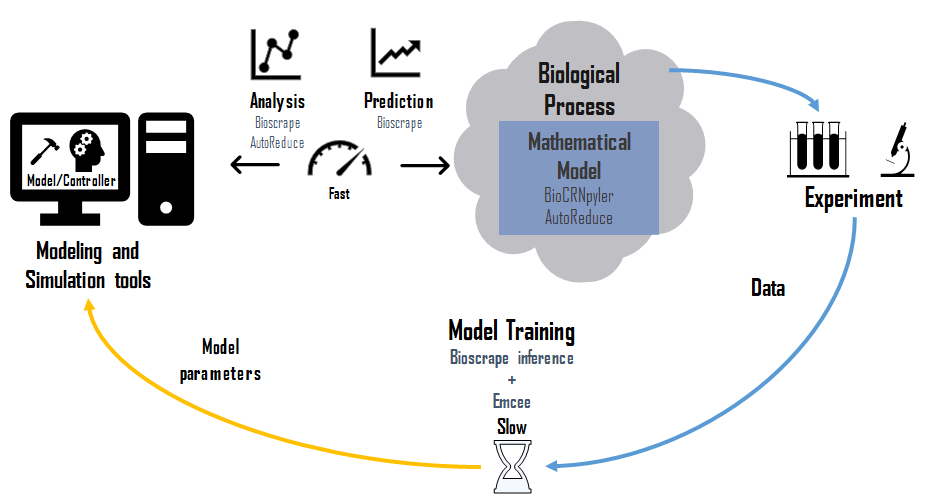

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
from cycler import cycler
import numpy as np
import bioscrape as bs

sns.set_context("talk", font_scale=1.5, rc={"lines.linewidth": 1.5})
sns.set_style("ticks")
sns.set_style({"xtick.direction": "in","ytick.direction": "in"})

#%config InlineBackend.figure_f.ormats=['svg']

mpl.rc('axes', prop_cycle=(cycler('color', ['r', 'k', 'b','g','y','m','c']) ))

mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42

#mpl.rc('text', usetex=False)
#mpl.rc('text.latex', preamble=r'\usepackage{helvet}
#\renewcommand\familydefault{\sfdefault}\usepackage{sansmath}\sansmath')
# mpl.rc('font',**{'family':'sans-serif','sans-serif':['Helvetica Neue'], 
#                  'serif': ['Helvetica Neue']})

mpl.rcParams['font.family'] = 'Helvetica'

tw = 1.5

sns.set_style({"xtick.major.size": 3, "ytick.major.size": 3,
               "xtick.minor.size": 2, "ytick.minor.size": 2,
               'axes.labelsize': 16, 'axes.titlesize': 16,
               'xtick.major.width': tw, 'xtick.minor.width': tw,
               'ytick.major.width': tw, 'ytick.minor.width': tw})

mpl.rc('xtick', labelsize=14) 
mpl.rc('ytick', labelsize=14)
mpl.rc('axes', linewidth=1.5, titlesize=14, labelsize=14)
mpl.rc('legend', fontsize=14)
mpl.rc('figure', figsize=(8.5,15))

C:\Users\apand\AppData\Local\Continuum\anaconda3\lib\site-packages\pandas\compat\_optional.py:138: UserWarning: Pandas requires version '2.7.0' or newer of 'numexpr' (version '2.6.9' currently installed).
  warnings.warn(msg, UserWarning)
C:\Users\apand\AppData\Local\Continuum\anaconda3\lib\site-packages\statsmodels\tools\_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


## Load data and create dataframe

To get started with parameter identification, we load the data file from Github:

## Pre-process the CSV from Echo or Biotek

In [12]:
import pandas as pd
import numpy as np

def time_in_minutes(t):
    ans = t.hour*60+t.minute+t.second/60.0+t.microsecond / 1000000.0 / 60.0
    if type(t).__name__ == 'datetime':
        ans += t.day * 24*60
    return ans
        
csv_data = pd.read_csv('20220425_2D_Dilution_Int_Reporter_Biotek1_tidy.csv')
# csv_data = pd.read_csv('20220609_2D_Int_Rep_Triplicate_Test_Biotek1_tidy.csv')

# cfp = cfp[:, 2:]
# yfp = yfp[:, 2:]

# Data arrays:
num_integrase_conditions = 5
num_reporter_conditions = 5
num_replicates = 2
biotek_gain = 100

# All time points are the same, so just get one set of times for a given condition and measurement
chosen_well = np.array(csv_data.loc[(csv_data['Channel'].eq('YFP'))& (csv_data['Int (nM)'].eq(1))\
                       & (csv_data['Rep (nM)'].eq(1))\
                       & (csv_data['Gain'].eq(biotek_gain))]['Well'])[0]
timepoints = np.array(csv_data.loc[(csv_data['Channel'].eq('YFP'))& (csv_data['Int (nM)'].eq(1))\
                       & (csv_data['Rep (nM)'].eq(1))\
                       & (csv_data['Gain'].eq(biotek_gain)) & (csv_data['Well'].eq(chosen_well))]['Time (hr)']*60)
real_timepoints = timepoints

num_timepoints = np.shape(timepoints)[0]
full_cfp = np.empty( (num_timepoints, num_replicates , num_integrase_conditions , num_reporter_conditions ) )
full_yfp = np.empty( (num_timepoints, num_replicates , num_integrase_conditions , num_reporter_conditions ) )

back_cfp = np.empty( (num_timepoints, num_replicates , num_integrase_conditions , num_reporter_conditions ) )
back_yfp = np.empty( (num_timepoints, num_replicates , num_integrase_conditions , num_reporter_conditions ) )

int_conditions = [0, 0.25, 0.5, 0.75, 1]
rep_conditions = [0, 0.25, 0.5, 0.75, 1]

for int_nm,int_ind in zip(int_conditions,range(num_integrase_conditions)):
    for rep_nm,rep_ind in zip(rep_conditions,range(num_reporter_conditions)):
        for repl in range(num_replicates):
            replicate = repl+1
            full_cfp[:,repl,int_ind,rep_ind] = np.array(csv_data.loc[(csv_data['Channel'].eq('deCFP'))\
                                                                   & (csv_data['Int (nM)'].eq(int_nm))\
                                                                   & (csv_data['Rep (nM)'].eq(rep_nm))\
                                                                   & (csv_data['Gain'].eq(biotek_gain))\
                                                                   & (csv_data['Replicate'].eq(replicate))\
                                                                   & (csv_data['deGFP Positive Control (nM)'].eq(0))]\
                                                      ['Measurement'])# calibration factors / 13809. * 1000.0
            back_cfp[:,repl,int_ind,rep_ind] = np.array(csv_data.loc[(csv_data['Channel'].eq('deCFP'))\
                                                                   & (csv_data['Int (nM)'].eq(0))\
                                                                   & (csv_data['Rep (nM)'].eq(rep_nm))\
                                                                   & (csv_data['Gain'].eq(biotek_gain))\
                                                                   & (csv_data['Replicate'].eq(replicate))\
                                                                   & (csv_data['deGFP Positive Control (nM)'].eq(0))]\
                                                      ['Measurement'])# calibration factors / 13809. * 1000.0
            full_yfp[:,repl,int_ind,rep_ind] = np.array(csv_data.loc[(csv_data['Channel'].eq('YFP'))\
                                                                   & (csv_data['Int (nM)'].eq(int_nm))\
                                                                   & (csv_data['Rep (nM)'].eq(rep_nm))\
                                                                   & (csv_data['Gain'].eq(biotek_gain))\
                                                                   & (csv_data['Replicate'].eq(replicate))\
                                                                   & (csv_data['deGFP Positive Control (nM)'].eq(0))]\
                                                      ['Measurement']) # calibration factors / 50405. * 1000.0
            back_yfp[:,repl,int_ind,rep_ind] = np.array(csv_data.loc[(csv_data['Channel'].eq('YFP'))\
                                                                   & (csv_data['Int (nM)'].eq(int_nm))\
                                                                   & (csv_data['Rep (nM)'].eq(0))\
                                                                   & (csv_data['Gain'].eq(biotek_gain))\
                                                                   & (csv_data['Replicate'].eq(replicate))\
                                                                   & (csv_data['deGFP Positive Control (nM)'].eq(0))]\
                                                      ['Measurement']) # calibration factors / 50405. * 1000.0


# Calibrate to concentration (using: https://biocircuits.cds.caltech.edu/TXTL-calibration#Biotek_Calibration_4/22/2022_Makena)
# Linear fit: RFU measurement = slope*concentration in uM + intercept
# So, concentration (in nM) = 1000*(RFU - intercept)/slope
if biotek_gain == 61:
    cfp_slope = 456.71
#     cfp_intercept = -384.26
    cfp_intercept = 0
    yfp_slope = 993.69
#     yfp_intercept = 468.56
    yfp_intercept = 0

if biotek_gain == 100:
    cfp_slope = 12796.23
    cfp_intercept = -6248.64 
#     cfp_intercept = 0
    yfp_slope = 44451.55
#     yfp_intercept = 294
    yfp_intercept = 0

for int_nm,int_ind in zip(int_conditions,range(num_integrase_conditions)):
    for rep_nm,rep_ind in zip(rep_conditions,range(num_reporter_conditions)):
        for repl in range(num_replicates):
            full_cfp[:,repl,int_ind,rep_ind] = 1000*(1/cfp_slope)*(full_cfp[:,repl,int_ind,rep_ind] - cfp_intercept)
            back_cfp[:,repl,int_ind,rep_ind] = 1000*(1/cfp_slope)*(back_cfp[:,repl,int_ind,rep_ind] - cfp_intercept)
            full_yfp[:,repl,int_ind,rep_ind] = 1000*(1/yfp_slope)*(full_yfp[:,repl,int_ind,rep_ind] - yfp_intercept)
            back_yfp[:,repl,int_ind,rep_ind] = 1000*(1/yfp_slope)*(back_yfp[:,repl,int_ind,rep_ind] - yfp_intercept)
#Process the background.
for rep_ind in range(num_reporter_conditions):
    for int_ind in range(num_integrase_conditions):
        full_cfp[:,:,int_ind,rep_ind] = np.maximum(full_cfp[:,:,int_ind,rep_ind] - back_cfp[:,:,int_ind,rep_ind], 0)
        full_yfp[:,:,int_ind,rep_ind] = np.maximum(full_yfp[:,:,int_ind,rep_ind] - back_yfp[:,:,int_ind,rep_ind], 0)

# cfp_bg = np.empty(num_timepoints)
# for t in range(len(cfp_bg)):
#     cfp_bg[t] = np.median(full_cfp[t,:,0,:])

# for rep_ind in range(num_reporter_conditions):
#     for int_ind in range(num_integrase_conditions):
#         for repl in range(num_replicates):
#             temp = full_cfp[:,repl,int_ind,:] - full_cfp[:,repl,0,:]
#             full_cfp[:,repl,int_ind,:] = np.maximum(temp,0)
###
# for rep_ind in range(num_reporter_conditions):
#     for int_ind in range(num_integrase_conditions):
#         if int_ind == 0:
#             continue
#         else:
#             full_cfp[:,:,int_ind,rep_ind] = np.maximum(full_cfp[:,:,int_ind,rep_ind] - full_cfp[:,:,0,rep_ind], 0)

# Set CFP to zero when 0 DNA was added (this background/noise was subtracted from the data above)
# full_cfp[:,:,0,:] = np.zeros((len(timepoints), num_replicates, num_reporter_conditions))

# #Process the YFP background.
# yfp_bg = np.empty(num_timepoints)
# for t in range(len(yfp_bg)):
#     yfp_bg[t] = np.median(full_yfp[t,:,:,0])

# for int_ind in range(num_integrase_conditions):
#     for rep_ind in range(num_reporter_conditions):
#         for repl in range(num_replicates):
#             temp = full_yfp[:,repl,int_ind,rep_ind] - full_yfp[:,repl,int_ind,0]
#             full_yfp[:,repl,int_ind,rep_ind] = np.maximum(temp,0)
            
# for int_ind in range(num_reporter_conditions):
#     for rep_ind in range(num_integrase_conditions):
#         if rep_ind == 0:
#             continue
#         else:
#             full_yfp[:,:,int_ind,rep_ind] = np.maximum(full_yfp[:,:,int_ind,rep_ind] - full_yfp[:,:,int_ind,0], 0)

# # Set YFP to zero when 0 DNA was added (this background/noise was subtracted from the data above)
# full_yfp[:,:,:,0] = np.zeros((len(timepoints), num_replicates, num_integrase_conditions))

## Plot experimental data

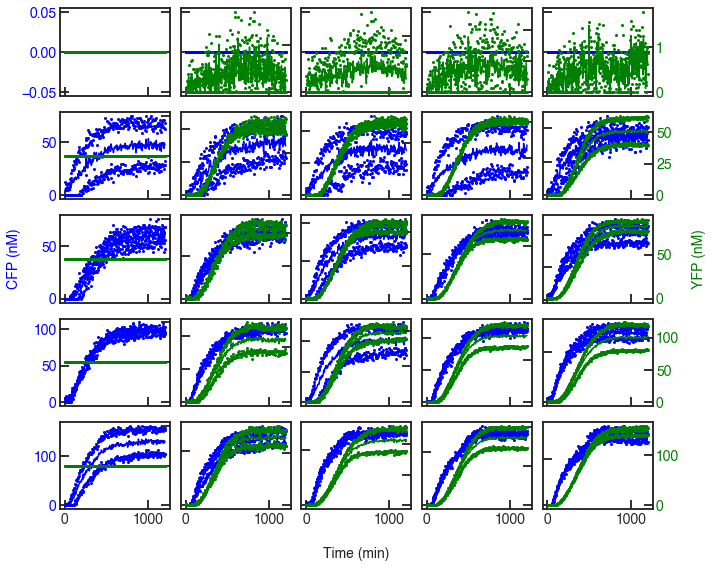

In [13]:
figsize = (10,8)
figc = plt.figure(figsize=figsize)
# figy = plt.figure(figsize=figsize)

current_index = 1


cfp_median = np.empty((num_timepoints,num_integrase_conditions,num_reporter_conditions))
yfp_median = np.empty((num_timepoints,num_integrase_conditions,num_reporter_conditions))

for int_ind in range(num_integrase_conditions):
    for rep_ind in range(num_reporter_conditions):
        cfp_median[:,int_ind,rep_ind] = np.mean(full_cfp[:,:,int_ind, rep_ind],axis=1)
        axc = figc.add_subplot(num_integrase_conditions,num_reporter_conditions,current_index)
        axc.plot(timepoints,cfp_median[:,int_ind,rep_ind], 'b-')
        axc.plot(timepoints,full_cfp[:,:,int_ind, rep_ind], 'b.', markersize=4)
        for tl in axc.get_yticklabels():
            tl.set_color('b')
        
        axy = axc.twinx()
        yfp_median[:,int_ind,rep_ind] = np.mean(full_yfp[:,:,int_ind, rep_ind],axis=1)
        axy.plot(timepoints, yfp_median[:,int_ind,rep_ind], 'g-')
        axy.plot(timepoints, full_yfp[:,:,int_ind,rep_ind], 'g.', markersize=4)
        for tl in axy.get_yticklabels():
            tl.set_color('g')
        
        
#         axy = figy.add_subplot(5,5,current_index)
#         yfp_median[:,int_nm,rep_nm] = np.median(full_yfp[:,:,int_nm, rep_nm],axis=1)
#         axy.plot(timepoints, yfp_median[:,int_nm,rep_nm], 'g-')
#         axy.plot(timepoints, full_yfp[:,:,int_nm,rep_nm], 'g.', markersize=4)
#         axy.set_xlim(time_lim)
#         axy.set_ylim(yfp_lim)
        
        if rep_ind > 0:
            axc.set_yticklabels([])
        if rep_ind < num_reporter_conditions - 1:
            axy.set_yticklabels([])
        if int_ind < num_integrase_conditions - 1:
            axy.set_xticklabels([])
        
        if int_ind == num_integrase_conditions - 1 and rep_ind ==  num_reporter_conditions//2:
            axc.set_xlabel('Time (min)',labelpad=20)
#             axy.set_xlabel('Time (min)')
        if rep_ind == 0 and int_ind ==  num_integrase_conditions//2:
#             axy.set_ylabel('Venus YFP (nm)')
            axc.set_ylabel('CFP (nM)',color='b',labelpad=20)
        if rep_ind ==  num_reporter_conditions - 1 and int_ind ==  num_integrase_conditions//2:
            axy.set_ylabel('YFP (nM)', color='g',labelpad=20)
        current_index += 1

figc.tight_layout()
# figy.tight_layout()


In [14]:
initial_conditions = []
all_data = []
expdata_dict = {}
for int_ind, int_nm in zip(range(num_integrase_conditions), int_conditions):
    for rep_ind, rep_nm in zip(range(num_reporter_conditions),rep_conditions):
        initial_conditions.append({"G_I": int_nm, "G_tot": rep_nm})
        expdata_dict[(int_nm,rep_nm,'CFP')] = cfp_median[:,int_ind,rep_ind]
        expdata_dict[(int_nm,rep_nm,'YFP')] = yfp_median[:,int_ind,rep_ind]
        all_data.append(expdata_dict)

In [18]:
timepoints[:180][-1]

898.2

C:\Users\apand\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:52: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations


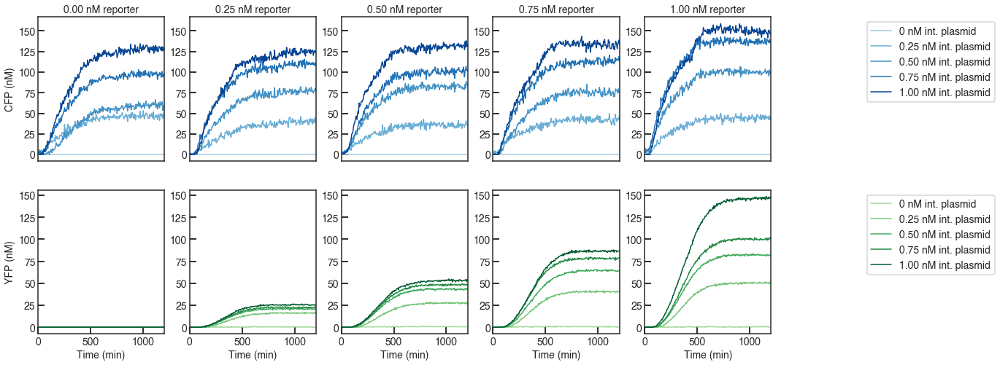

In [16]:
import numpy as np
import matplotlib.pyplot as plt
colorc = ['#9ecae1','#6baed6','#4292c6', '#2171b5','#084594']
colory = ['#a1d99b','#74c476','#41ab5d','#238b45','#005a32']
time_lim = (0,timepoints[-1]+1)
# timepoints = np.linspace(0,time_lim[1],49)
cfp_lim = (0,65)
yfp_lim = (0,200)
figsize = (18,8)
fig = plt.figure(figsize=figsize)
index = 1
for rep_ind in range(num_reporter_conditions):
    if index == 1:
        axc = fig.add_subplot(2,num_integrase_conditions,index)
        axy = fig.add_subplot(2,num_reporter_conditions,index+5)
    else:
        axc = fig.add_subplot(2,num_integrase_conditions,index, sharey = axc)
        axy = fig.add_subplot(2,num_reporter_conditions,index+5, sharey = axy)
    
    for int_ind in range(num_integrase_conditions):
        axc.plot(timepoints, expdata_dict[(int_conditions[int_ind] ,rep_conditions[rep_ind],'CFP')],
                 color=colorc[int_ind] )
        axy.plot(timepoints, expdata_dict[(int_conditions[int_ind] ,rep_conditions[rep_ind],'YFP')]
                 ,color=colory[int_ind])
    
    axc.set_title('%1.2f nM reporter' % (rep_conditions[rep_ind]))
    axc.set_xlim(time_lim)
    axy.set_xlim(time_lim)
#     axc.set_ylim(cfp_lim)
#     axy.set_ylim(yfp_lim)

    axy.set_xlabel('Time (min)')
    
    if index == 1:
        axc.set_ylabel('CFP (nM)')
        axy.set_ylabel('YFP (nM)')
        axc.legend(['0 nM int. plasmid', '0.25 nM int. plasmid',
                    '0.50 nM int. plasmid', '0.75 nM int. plasmid',
                    '1.00 nM int. plasmid'],
                   loc='best',bbox_to_anchor=(7.61, 1), fontsize = 14)
        axy.legend(['0 nM int. plasmid', '0.25 nM int. plasmid',
                    '0.50 nM int. plasmid', '0.75 nM int. plasmid',
                    '1.00 nM int. plasmid'],
                   loc='best',bbox_to_anchor=(7.61, 1), fontsize = 14)
#     else:
#         axc.set_yticks([])
#         axy.set_yticks([])
    axc.set_xticks([])

    index += 1

fig.tight_layout()
# fig.savefig('integrase-raw-data.svg')

## Truncate data to 600 minutes:

We truncate the experimental data to 600 minutes as that is the time-period of interest and our model does not capture the leveling out of the fluorescence reporter amounts.

C:\Users\apand\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:62: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations


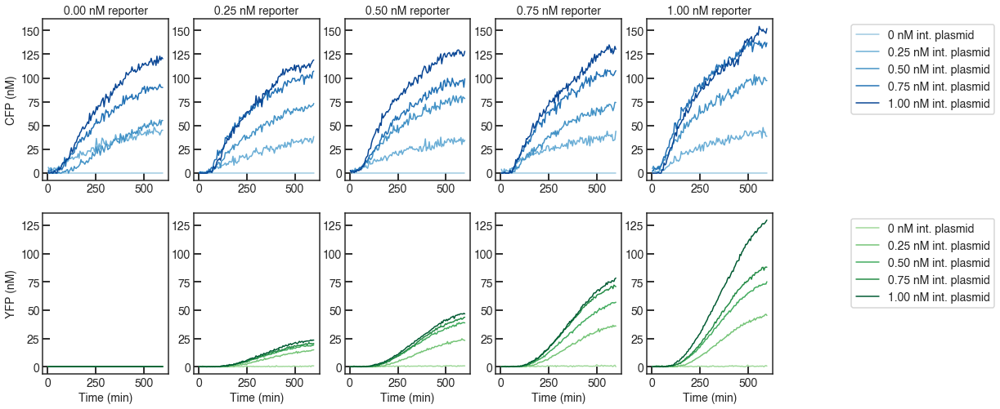

In [11]:
initial_conditions = []
all_data = []
expdata_dict = {}
timepoints = real_timepoints[:120]
for int_ind, int_nm in zip(range(num_integrase_conditions), int_conditions):
    for rep_ind, rep_nm in zip(range(num_reporter_conditions),rep_conditions):
        initial_conditions.append({"G_I": int_nm, "G_tot": rep_nm})
        expdata_dict[(int_nm,rep_nm,'CFP')] = cfp_median[:120,int_ind,rep_ind]
        expdata_dict[(int_nm,rep_nm,'YFP')] = yfp_median[:120,int_ind,rep_ind]
        all_data.append(expdata_dict)

colorc = ['#9ecae1','#6baed6','#4292c6', '#2171b5','#084594']
colory = ['#a1d99b','#74c476','#41ab5d','#238b45','#005a32']
# time_lim = (0,timepoints[-1]+1)
# timepoints = np.linspace(0,time_lim[1],49)
# cfp_lim = (0,65)
# yfp_lim = (0,200)
plt.close()
figsize = (16,8)
fig = plt.figure(figsize=figsize)
index = 1
for rep_ind in range(num_reporter_conditions):
    if index == 1:
        axc = fig.add_subplot(2,num_integrase_conditions,index)
        axy = fig.add_subplot(2,num_reporter_conditions,index+5)
    else:
        axc = fig.add_subplot(2,num_integrase_conditions,index, sharey = axc)
        axy = fig.add_subplot(2,num_reporter_conditions,index+5, sharey = axy)
        
    for int_ind in range(num_integrase_conditions):
        axc.plot(timepoints, expdata_dict[(int_conditions[int_ind] ,rep_conditions[rep_ind],'CFP')],
                 color=colorc[int_ind] )
        axy.plot(timepoints, expdata_dict[(int_conditions[int_ind] ,rep_conditions[rep_ind],'YFP')]
                 ,color=colory[int_ind])
    
    axc.set_title('%1.2f nM reporter' % (rep_conditions[rep_ind]))
#     axc.set_xlim(time_lim)
#     axy.set_xlim(time_lim)
#     axc.set_ylim(cfp_lim)
#     axy.set_ylim(yfp_lim)

    axy.set_xlabel('Time (min)')
    
    if index == 1:
        axc.set_ylabel('CFP (nM)')
        axy.set_ylabel('YFP (nM)')
        axc.legend(['0 nM int. plasmid', '0.25 nM int. plasmid',
                    '0.50 nM int. plasmid', '0.75 nM int. plasmid',
                    '1.00 nM int. plasmid'],
                   loc='best',bbox_to_anchor=(7.61, 1), fontsize = 14)
        axy.legend(['0 nM int. plasmid', '0.25 nM int. plasmid',
                    '0.50 nM int. plasmid', '0.75 nM int. plasmid',
                    '1.00 nM int. plasmid'],
                   loc='best',bbox_to_anchor=(7.61, 1), fontsize = 14)
#     else:
#         axc.set_yticks([])
#         axy.set_yticks([])
#     axc.set_xticks([])

    index += 1

fig.tight_layout()
fig.savefig('integrase-data-processed.svg')

# Run bioscrape inference

To identify parameter distributions, we run bioscrape inference for the example above. The three main ingredients of this black-box parameter inference pipeline are:

1. Experimental data as a `Pandas` dataframe (or a list of Dataframes) consisting of the measurements as columns along with a "time" column.
2. An SBML file that models the system we want to identify.
3. Prior information about parameters. 

We already have the experimental data as a list of Pandas dataframe above corresponding to a list of initial conditions. So, for the second step, we load the SBML file of the reduced model below:

In [81]:
from bioscrape.inference import py_inference
from bioscrape.types import Model
from bioscrape.simulator import *
import numpy as np
import pickle
import time

# time_lim = (0,600)
int_levels = [0,0.25,0.5,0.75,1.]
rep_levels = [0,0.25,0.5,0.75,1.]
m = Model(sbml_filename = 'integrase_sbml_reduced.xml')
csim = ModelCSimInterface(m)
c_ind = m.get_species_index('Int')
y_ind = m.get_species_index('YFP')

# timepoints = np.linspace(0,time_lim[1],601)
csim.py_prep_deterministic_simulation()

propagator = DeterministicSimulator()

simdata = {}
m.set_params({'k_i': 0.24, 'k_int': 0.05, 'K_I': 3335.0, 'k': 0.05})
for int_nm in int_levels:
    for rep_nm in rep_levels:
        m.set_species({"G_I": int_nm, "G_tot": rep_nm})
        deterministic = propagator.py_simulate(csim, timepoints)
        simdata[(int_nm,rep_nm,'cfp')] = deterministic.py_get_result()[:,c_ind]
        simdata[(int_nm,rep_nm,'yfp')] = deterministic.py_get_result()[:,y_ind]

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


C:\Users\apand\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:55: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations


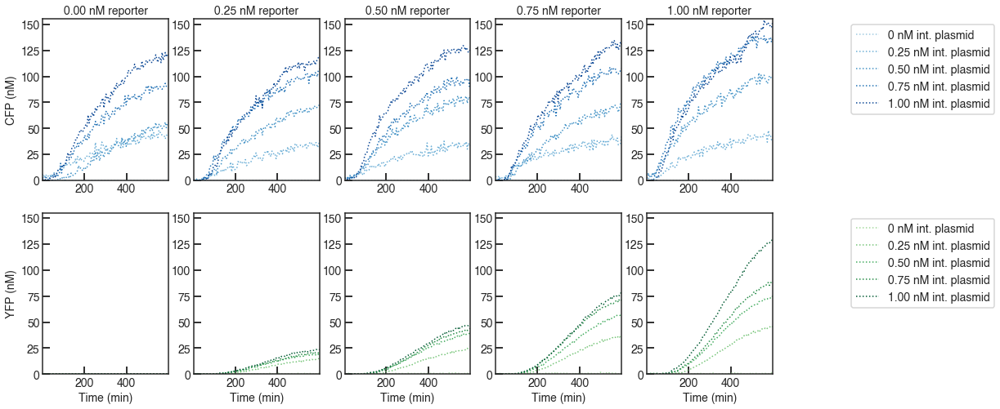

In [84]:
colorc = ['#9ecae1','#6baed6','#4292c6', '#2171b5','#084594']
colory = ['#a1d99b','#74c476','#41ab5d','#238b45','#005a32']
time_lim = [timepoints[0], timepoints[-1]]
cfp_lim = [0, 155]
yfp_lim = [0, 155]
figsize = (16,8)
fig = plt.figure(figsize=figsize)
index = 1
for rep_ind in range(num_reporter_conditions):
    if index == 1:
        axc = fig.add_subplot(2,num_integrase_conditions,index)
        axy = fig.add_subplot(2,num_reporter_conditions,index+5)
    else:
        axc = fig.add_subplot(2,num_integrase_conditions,index, sharey = axc)
        axy = fig.add_subplot(2,num_reporter_conditions,index+5, sharey = axy)
        
    for int_ind in range(num_integrase_conditions):
        # Data
        axc.plot(timepoints, expdata_dict[(int_conditions[int_ind] ,rep_conditions[rep_ind],'CFP')],
                 color=colorc[int_ind], ls = 'dotted')
        axy.plot(timepoints, expdata_dict[(int_conditions[int_ind] ,rep_conditions[rep_ind],'YFP')]
                 ,color=colory[int_ind], ls = 'dotted')
        # Simulations
#         axc.plot(timepoints, simdata[(int_levels[int_ind] ,rep_levels[rep_ind],'cfp')],
#                  color=colorc[int_ind] )
#         axy.plot(timepoints, simdata[(int_levels[int_ind] ,rep_levels[rep_ind],'yfp')]
#                  ,color=colory[int_ind])
    
    axc.set_title('%1.2f nM reporter' % (rep_conditions[rep_ind]))
    axc.set_xlim(time_lim)
    axy.set_xlim(time_lim)
    axc.set_ylim(cfp_lim)
    axy.set_ylim(yfp_lim)

    axy.set_xlabel('Time (min)')
    
    if index == 1:
        axc.set_ylabel('CFP (nM)')
        axy.set_ylabel('YFP (nM)')
        axc.legend(['0 nM int. plasmid', '0.25 nM int. plasmid',
                    '0.50 nM int. plasmid', '0.75 nM int. plasmid',
                    '1.00 nM int. plasmid'],
                   loc='best',bbox_to_anchor=(7.61, 1), fontsize = 14)
        axy.legend(['0 nM int. plasmid', '0.25 nM int. plasmid',
                    '0.50 nM int. plasmid', '0.75 nM int. plasmid',
                    '1.00 nM int. plasmid'],
                   loc='best',bbox_to_anchor=(7.61, 1), fontsize = 14)
#     else:
#         axc.set_yticks([])
#         axy.set_yticks([])
#     axc.set_xticks([])

    index += 1

fig.tight_layout()


In [10]:
m.get_parameter_dictionary()

{'k_i': 0.24, 'k_int': 0.05, 'K_I': 3335.0, 'n': 2.0, 'k': 0.05}

In [11]:
# Create a data frame with all the simulated and real results to use here
# as the source for doing parameter inference on the data (simulated or real)
# Columns are string for real or simulated, time, cfp, yfp, int_nm, rep_nm

import pandas as pd
e_df = {'type':[], 'time':[], 'int_nm':[], 'rep_nm':[], 'Int':[], 'YFP':[]}

# add the simulated data
for int_ind, int_nm in zip(range(num_integrase_conditions), int_conditions):
    for rep_ind, rep_nm in zip(range(num_reporter_conditions),rep_conditions):
#         timepoints = np.linspace(0,time_lim[1],241)
        length = len(timepoints)
        e_df['time'].extend(timepoints)
        e_df['type'].extend(['sim']*length)
        e_df['int_nm'].extend([int_nm]*length)
        e_df['rep_nm'].extend([rep_nm]*length)
        e_df['Int'].extend(simdata[(int_nm,rep_nm,'cfp')])
        e_df['YFP'].extend(simdata[(int_nm,rep_nm,'yfp')])

# add the real data
for int_ind, int_nm in zip(range(num_integrase_conditions), int_conditions):
    for rep_ind, rep_nm in zip(range(num_reporter_conditions),rep_conditions):
#         timepoints = real_timepoints[:49]
        length = len(timepoints)
        e_df['time'].extend(timepoints)
        e_df['type'].extend(['exp']*length)
        e_df['int_nm'].extend([int_nm]*length)
        e_df['rep_nm'].extend([rep_nm]*length)
        e_df['Int'].extend(expdata_dict[(int_nm,rep_nm,'CFP')])
        e_df['YFP'].extend(expdata_dict[(int_nm,rep_nm,'YFP')])

e_df = pd.DataFrame(e_df)

data_file = open('trace_data_frame.b','wb')
pickle.dump(e_df, data_file)
data_file.close()

In [12]:
initial_conditions = []
all_data = []
int_levels = [0.0,0.25,0.5,0.75,1.]
rep_levels = [0.0,0.25,0.5,0.75,1.]
# int_levels = [0.5]
# rep_levels = [0.0]
# int_levels = [1.]
# rep_levels = [1.]
for int_nm in int_levels:
    for rep_nm in rep_levels:
        initial_conditions.append({"G_I": int_nm, "G_tot": rep_nm})
        exp_data = e_df.loc[(e_df['int_nm'].eq(int_nm)) & (e_df['rep_nm'].eq(rep_nm)) & (e_df['type'] == 'exp')]
        all_data.append(exp_data)

In [13]:
# m.set_params({'k_i': 0.24, 'k_int': 0.05, 'K_I': 3335.0, 'n': 1.0, 'k': 0.05})

In [14]:
m.get_parameter_dictionary()

{'k_i': 0.24, 'k_int': 0.05, 'K_I': 3335.0, 'n': 2.0, 'k': 0.05}

In [15]:
initial_conditions

[{'G_I': 0.0, 'G_tot': 0.0},
 {'G_I': 0.0, 'G_tot': 0.25},
 {'G_I': 0.0, 'G_tot': 0.5},
 {'G_I': 0.0, 'G_tot': 0.75},
 {'G_I': 0.0, 'G_tot': 1.0},
 {'G_I': 0.25, 'G_tot': 0.0},
 {'G_I': 0.25, 'G_tot': 0.25},
 {'G_I': 0.25, 'G_tot': 0.5},
 {'G_I': 0.25, 'G_tot': 0.75},
 {'G_I': 0.25, 'G_tot': 1.0},
 {'G_I': 0.5, 'G_tot': 0.0},
 {'G_I': 0.5, 'G_tot': 0.25},
 {'G_I': 0.5, 'G_tot': 0.5},
 {'G_I': 0.5, 'G_tot': 0.75},
 {'G_I': 0.5, 'G_tot': 1.0},
 {'G_I': 0.75, 'G_tot': 0.0},
 {'G_I': 0.75, 'G_tot': 0.25},
 {'G_I': 0.75, 'G_tot': 0.5},
 {'G_I': 0.75, 'G_tot': 0.75},
 {'G_I': 0.75, 'G_tot': 1.0},
 {'G_I': 1.0, 'G_tot': 0.0},
 {'G_I': 1.0, 'G_tot': 0.25},
 {'G_I': 1.0, 'G_tot': 0.5},
 {'G_I': 1.0, 'G_tot': 0.75},
 {'G_I': 1.0, 'G_tot': 1.0}]

In [16]:
len(all_data[0]['Int'])

120

In [17]:
m.get_species_dictionary()

{'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 1.0, 'G_tot': 1.0}

## Run parameter inference (step 1):


creating an ensemble sampler with threads= 1


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [01:14<00:00, 13.43it/s]


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.
Parameter posterior distribution convergence plots:


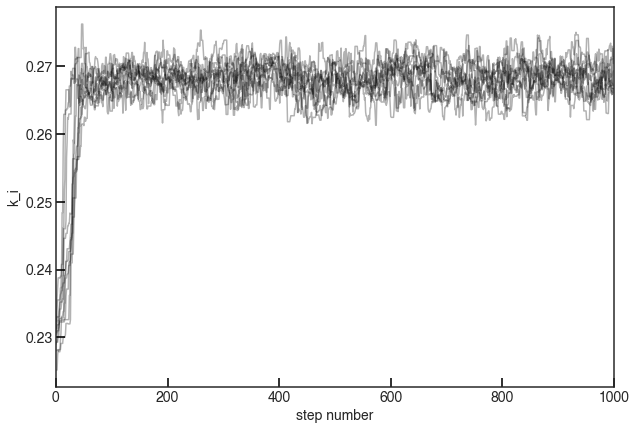

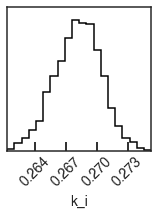

In [19]:
from bioscrape.inference import py_inference

init_values = np.array([0.23])

prior = {'k_i' : ['gaussian', 0.23, 1, 'positive']}

nwalkers = 10
nsteps = 1000
sampler, pid = py_inference(Model = m, exp_data = all_data, measurements = ['Int'], time_column = ['time'],
                            nwalkers = nwalkers, nsteps = nsteps, sim_type = 'deterministic', 
                            initial_conditions = initial_conditions, 
                            init_seed = init_values,
                            params_to_estimate = [p for p in prior],
                            prior = prior, convergence_check = False, debug = False)

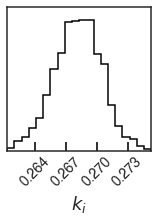

In [29]:
import corner
labels = ['$k_{i}$']
flat_samples = sampler.get_chain(discard=int(.2*nsteps), thin = int(0.5*nwalkers), flat=True)
fig = corner.corner(flat_samples, levels = (0.75,), 
                    labels = labels, use_math_text = False, 
                    label_kwargs = {'fontsize':18})
fig.savefig('mcmc_cfp_corner.svg')

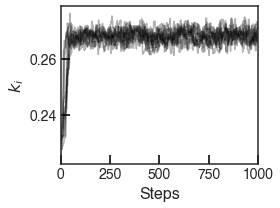

In [43]:
fig, ax = plt.subplots(figsize = (4,3))
samples = sampler.get_chain()[:,:,0]
ax.plot(samples, alpha = 0.3, color = 'k')
# ax.set_xlim(0, len(samples))
ax.set_xlabel('Steps', fontsize = 16)
ax.set_ylabel('$k_i$', fontsize = 16)
ax.set_xlim([0,nsteps])
fig.tight_layout()
fig.savefig('mcmc_cfp_chain.svg')

Parameter posterior distribution convergence plots:


AttributeError: 'InferenceSetup' object has no attribute 'autocorrelation_time'

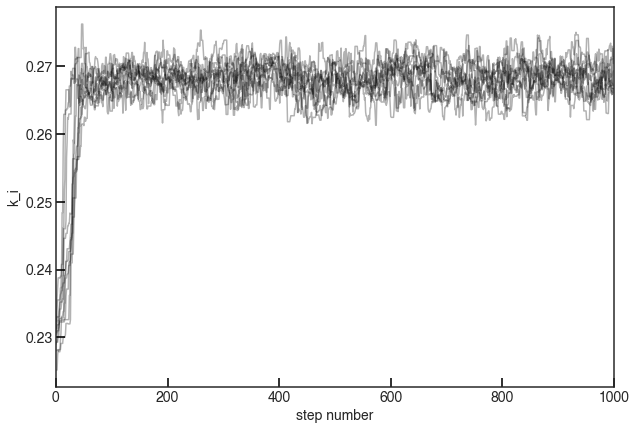

In [45]:
k_i, k_i_error = pid.plot_mcmc_results(sampler)

In [46]:
k_i

NameError: name 'k_i' is not defined

In [47]:
m = Model(sbml_filename = 'integrase_sbml_reduced.xml')

In [48]:
# m.set_parameter('k_i', k_i[0])
m.set_parameter('k_i', 0.2680175639510619)

In [53]:
m.get_parameter_dictionary()

{'k_i': 0.2680175639510619, 'k_int': 0.05, 'K_I': 3335.0, 'n': 2.0, 'k': 0.05}

In [50]:
m.get_species_dictionary()

{'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.0, 'G_tot': 0.0}

In [51]:
initial_conditions = []
all_data = []
int_levels = [0.0,0.25,0.5,0.75,1.]
rep_levels = [0.0,0.25,0.5,0.75,1.]
# int_levels = [0.5]
# rep_levels = [0.0]
# int_levels = [1.]
# rep_levels = [1.]
for int_nm in int_levels:
    for rep_nm in rep_levels:
        initial_conditions.append({"G_I": int_nm, "G_tot": rep_nm})
        exp_data = e_df.loc[(e_df['int_nm'].eq(int_nm)) & (e_df['rep_nm'].eq(rep_nm)) & (e_df['type'] == 'exp')]
        all_data.append(exp_data)

In [52]:
initial_conditions

[{'G_I': 0.0, 'G_tot': 0.0},
 {'G_I': 0.0, 'G_tot': 0.25},
 {'G_I': 0.0, 'G_tot': 0.5},
 {'G_I': 0.0, 'G_tot': 0.75},
 {'G_I': 0.0, 'G_tot': 1.0},
 {'G_I': 0.25, 'G_tot': 0.0},
 {'G_I': 0.25, 'G_tot': 0.25},
 {'G_I': 0.25, 'G_tot': 0.5},
 {'G_I': 0.25, 'G_tot': 0.75},
 {'G_I': 0.25, 'G_tot': 1.0},
 {'G_I': 0.5, 'G_tot': 0.0},
 {'G_I': 0.5, 'G_tot': 0.25},
 {'G_I': 0.5, 'G_tot': 0.5},
 {'G_I': 0.5, 'G_tot': 0.75},
 {'G_I': 0.5, 'G_tot': 1.0},
 {'G_I': 0.75, 'G_tot': 0.0},
 {'G_I': 0.75, 'G_tot': 0.25},
 {'G_I': 0.75, 'G_tot': 0.5},
 {'G_I': 0.75, 'G_tot': 0.75},
 {'G_I': 0.75, 'G_tot': 1.0},
 {'G_I': 1.0, 'G_tot': 0.0},
 {'G_I': 1.0, 'G_tot': 0.25},
 {'G_I': 1.0, 'G_tot': 0.5},
 {'G_I': 1.0, 'G_tot': 0.75},
 {'G_I': 1.0, 'G_tot': 1.0}]

creating an ensemble sampler with threads= 1


C:\Users\apand\AppData\Local\Continuum\anaconda3\lib\site-packages\emcee\ensemble.py:258: RuntimeWarning: Initial state is not linearly independent and it will not allow a full exploration of parameter space
  category=RuntimeWarning,
100%|████████████████████████████████████████████████████████████████████████████| 10000/10000 [43:01<00:00,  3.87it/s]


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.
Parameter posterior distribution convergence plots:


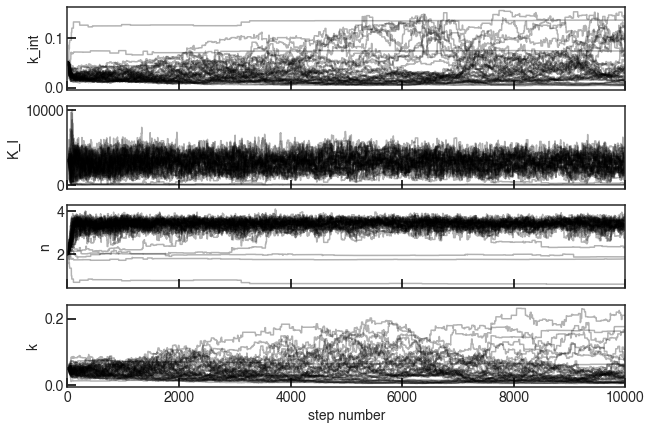

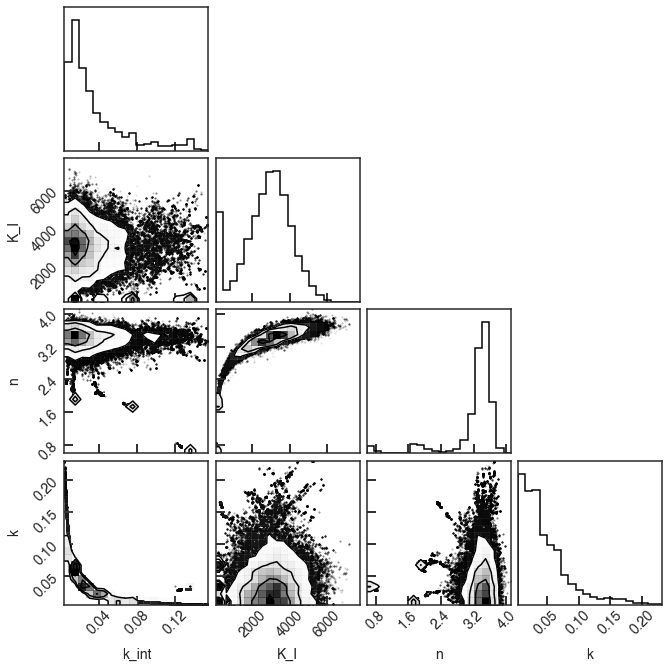

In [61]:
from bioscrape.inference import py_inference

init_values = np.array([0.05,3335,2,0.05])

prior = {'k_int' : ['gaussian', 0.05, 10, 'positive'],
         'K_I' : ['gaussian', 3330, 1000, 'positive'], 'n' : ['gaussian', 2, 2, 'positive'],
         'k' : ['gaussian', 1e-4, 0.1, 'positive']}
nwalkers = 40
nsteps = 10000
sampler, pid = py_inference(Model = m, exp_data = all_data, measurements = ['YFP'], time_column = ['time'],
                            nwalkers = nwalkers, nsteps = nsteps, sim_type = 'deterministic', 
                            initial_conditions = initial_conditions, 
                            init_seed = init_values,
                            params_to_estimate = [p for p in prior],
                            prior = prior, convergence_check = False, debug = False)
# pid = py_inference(Model = m, exp_data = all_data, measurements = ['Int'], time_column = ['time'],
#                     nwalkers = nwalkers, nsteps = nsteps, sim_type = 'deterministic', 
#                     initial_conditions = initial_conditions, 
#                     init_seed = init_values,
#                     params_to_estimate = [p for p in prior],
#                     prior = prior, inference_type = "lmfit")

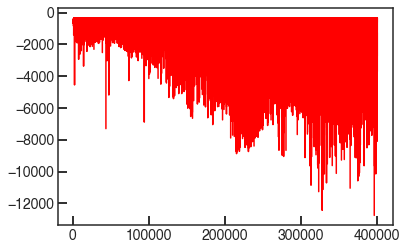

In [62]:
plt.plot(pid.cost_progress)

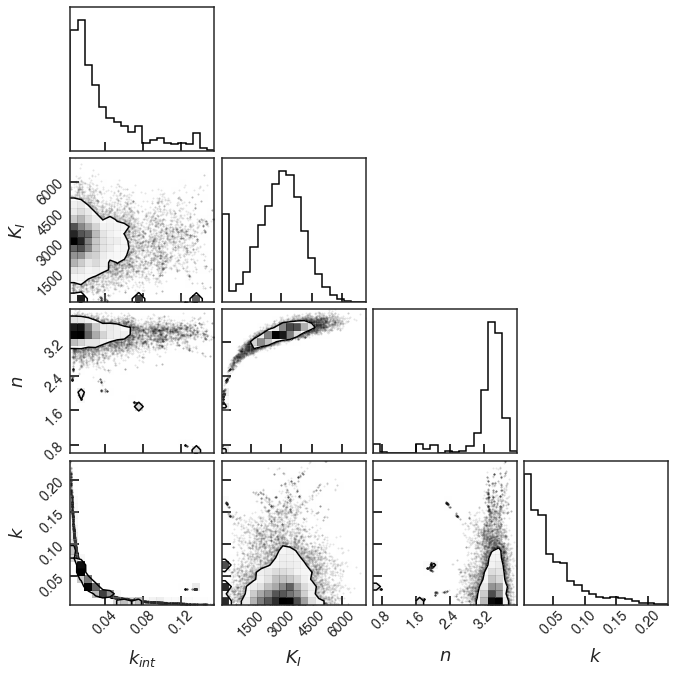

In [68]:
import corner
labels = ['$k_{int}$', '$K_{I}$', '$n$', '$k$']
flat_samples = sampler.get_chain(discard=int(.2*nsteps), thin = int(0.5*nwalkers), flat=True)
fig = corner.corner(flat_samples, levels = (0.75,), 
                    labels = labels, use_math_text = False, 
                    label_kwargs = {'fontsize':18})
fig.savefig('mcmc_yfp_corner.svg')

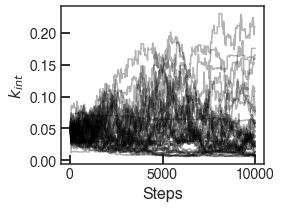

In [80]:
fig, ax = plt.subplots(figsize = (4,3))
samples = sampler.get_chain()[:,:,3]
ax.plot(samples, alpha = 0.3, color = 'k')
# ax.set_xlim(0, len(samples))
ax.set_xlabel('Steps', fontsize = 16)
ax.set_ylabel('$k_{int}$', fontsize = 16)
# ax.set_xlim([0,nsteps])
fig.tight_layout()
fig.savefig('mcmc_yfp_chain_k.svg')

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.0, 'G_tot': 0.0}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.23140604580659874}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23305031772133616}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23208269082236982}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22838589614084065}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2316506753967243}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22763630144655564}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23261972903401168}
current cost: -0.0
current cost total: 0.030459207

  1%|▋                                                                                | 9/1000 [00:00<00:12, 80.39it/s]

current sample: {'k_i': 0.23165478081991814}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23341069954718707}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22690437578905107}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2322155985370522}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23322316439983323}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23354729465459662}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23197793431314961}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22824111065752367}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22969444292147964}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23299270562114063}
current cos

current cost total: 0.030459207484708654
current sample: {'k_i': 0.21424467247070708}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27829400503089957}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10689391216566146}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1552528380346349}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3230924913956489}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2102290295265669}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23481726049104595}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2354189968478556}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07244093993360565}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'

  4%|███                                                                            | 38/1000 [00:00<00:07, 124.79it/s]

current sample: {'k_i': 0.03803480234041151}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23139011139542742}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09135706716519182}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2294848641813734}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2542154554145248}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3353331048236857}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21762567548374906}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.053619918897012855}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17007041913939525}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.324620788236651}
current cost: 

current cost total: 0.030459207484708654
current sample: {'k_i': 0.8823532941400888}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19081842694237455}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2372512873616407}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3178459488560358}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10538809762630719}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8898253602383609}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3395305431742385}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31745225993249326}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8865506965667006}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_

  5%|████                                                                           | 52/1000 [00:00<00:07, 128.15it/s]

current sample: {'k_i': 0.8912256127994883}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24989280907248146}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6499420840470131}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11781765185869741}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8109489017961555}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3815513905168316}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5292946912418606}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4623183031420306}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27169517276782235}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28599701922815707}
current cost: -0

current sample: {'k_i': 0.5495509423760125}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.03634902891911207}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5441744257969047}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0843050619953285}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.744610290877558}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8408958713872962}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41157913316350603}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3768438835151837}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5410452416147074}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6307135292340712}
current cost: -0.0


  8%|██████▍                                                                        | 82/1000 [00:00<00:07, 130.01it/s]

current sample: {'k_i': 0.4221826186289367}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4145677720154542}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7532235561341509}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5153825749374299}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.612402003698441}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8436228361861541}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8222532108595975}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6756402146082484}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5104339664973613}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5762185906806183}
current cost: -0.0
cu

current sample: {'k_i': 0.9167661974100836}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.634922894689046}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6005397146950753}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3743862035495963}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39859872280074615}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3553545184803385}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5872122834594775}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22218806879322844}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

 11%|████████▋                                                                     | 111/1000 [00:00<00:07, 123.68it/s]

 {'k_i': 0.1802640805614118}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6311861562457977}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.988540697315395}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5911901933413054}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6029466094456827}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45790913927715216}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9185024326255449}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6344607603796674}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4075119404784215}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2954123446527092}
current cost: -0.0
current cost tot

current sample: {'k_i': 0.8785554739983598}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6499726771451817}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8689947312408456}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.668981345265527}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6585284431979188}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3248227787010086}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6576719106127962}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9922239954793284}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5799517692228483}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8989441555770381}
current cost: -0.0
cu

 12%|█████████▋                                                                    | 124/1000 [00:01<00:07, 114.50it/s]

current sample: {'k_i': 0.9129051414585371}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.98113490070032}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6610621326552184}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06632020539193684}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5248898918396656}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9102780117838376}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7524555187779082}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8538888930453858}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8041884611597552}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9422832467586082}
current cost: -0.0
cu

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7356834091817739}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.610063211632933}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7668281145874263}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5607758659975182}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33184126287962806}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6939205663988889}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4253037008771656}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42592962281020513}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24526271715099957}
current cost: -0.0
current cost total: 0.030459207484708654
cu

 16%|████████████                                                                  | 155/1000 [00:01<00:06, 130.88it/s]

current sample: {'k_i': 0.6310866352664256}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.316101375036846}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.769081699265939}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2511218953666491}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8034252190805752}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3903556400628645}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3948007904858095}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2922117613848484}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4597035025483035}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3166717172406408}
current cost: -0.0
cur

current sample: {'k_i': 0.2990996122603835}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6901474824822647}


 18%|██████████████▎                                                               | 184/1000 [00:01<00:06, 134.90it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9492496728944304}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7151037324821576}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13901749883023337}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6848136446220175}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7205713789804615}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.29733518967513217}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9370251254232267}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7105900054219139}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09308142871200231}
current cost: -0.0
current cost total: 0.030459207484708654
c

current sample: {'k_i': 0.8365885893718156}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5458638612642097}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1020245722707781}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6952865310588073}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.648860499241918}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8647963520015168}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4607086205743015}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7154944248669975}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6134702542708995}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8788414125522862}
current cost: -0.0
cu

 20%|███████████████▍                                                              | 198/1000 [00:01<00:06, 131.87it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48846659047359353}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5907485228002736}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6558958775964122}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47699000205035413}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7226321420072433}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.718656490547775}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9844183582529065}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6315643296276032}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47808756209034436}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

 21%|████████████████▌                                                             | 212/1000 [00:01<00:06, 129.79it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.43285550890147073}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20988480640052048}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13093388734993888}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7065748507195196}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14889552443071852}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6410792541210864}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6600455330744276}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6727281694659136}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4768592218111945}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k

 23%|█████████████████▉                                                            | 230/1000 [00:01<00:05, 141.89it/s]

0.030459207484708654
current sample: {'k_i': 0.6628102720109016}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15825316436755732}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20056633236627128}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.036637257834722325}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8153229110093445}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6850516715833499}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16449640111169966}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5154958936949963}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7588936270529374}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.262364302865

current cost total: 0.030459207484708654
current sample: {'k_i': 0.25123356469864505}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17788426989484604}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5715006647196397}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2106100412296244}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4217357991692724}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5622341205851533}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20647406917088104}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.30346856512280496}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17883205044787082}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'

 26%|████████████████████▎                                                         | 260/1000 [00:02<00:05, 132.09it/s]

current sample: {'k_i': 0.31147843219702176}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5492516871395988}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6726944698447219}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3592875583546831}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2485769321439521}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.330088553289703}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6966933527644692}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5300193153543618}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6340236131879518}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16430121919937732}
current cost: -0.0


current sample: {'k_i': 0.16543709358412437}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6816616729472069}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28574269557550086}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08210906554479724}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3435602930200038}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4580609414466351}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9717026016026544}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1302909509248611}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.05129092667219073}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.157810041339}
current cost: -0.0
c

 27%|█████████████████████▎                                                        | 274/1000 [00:02<00:05, 123.22it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.040773673173400526}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8028193990583264}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10444516180152752}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14253631393531185}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5705544540636088}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7467092631659468}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13538253106677386}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5946782950999128}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.03074055607943913}
current cost: -0.0
current cost total: 0.030459207484708654
current sam

current cost total: 0.030459207484708654
current sample: {'k_i': 0.70045561430279}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26314891625363895}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7840481465891651}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7500011183311108}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15007126783784397}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13624679593187877}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6243967176483779}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7437905975045418}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6397801109091973}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i'

 31%|████████████████████████                                                      | 308/1000 [00:02<00:05, 134.72it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8827191648385967}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8501280191155896}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4044056024716252}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2529653009389647}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5976793437281624}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7558996754102241}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6123392166342192}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2241359042826942}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5960997079388654}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.645882992764714}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2595815259684845}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.669300668668976}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6057375294206417}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1738357195079347}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.287750800062992}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6515415121100463}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6784511702943115}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4390635258256419}
current cost: -0.0
current cost total: 0.030459207484708654
current

 32%|█████████████████████████                                                     | 322/1000 [00:02<00:05, 129.15it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6118218990160362}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.052280409264439553}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46036890358715526}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6422600321308332}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7000317569990027}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6025350760313478}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4958528420898073}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9737928545104648}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2870337747751208}
current cost: -0.0
current cost total: 0.030459207484708654
c

 34%|██████████████████████████▎                                                   | 337/1000 [00:02<00:04, 132.95it/s]

current sample: {'k_i': 0.055851682966914784}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09674138244576025}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5822315331054319}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04525458871452953}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04796868673118626}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.648134626307406}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9232728728069903}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35443730207842566}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04853955609462376}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.650552952028516}
current cost: -

 36%|███████████████████████████▊                                                  | 356/1000 [00:02<00:04, 146.53it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.047228108276489336}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11587695796571518}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7462965003429077}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4042171680338963}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5655288812154324}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.897288239878395}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7450970979701439}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.289932008909433}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15011954168285568}
current cost: -0.0
current cost total: 0.030459207484708654
cu

current sample: {'k_i': 0.5730491787935476}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3436145958636339}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7572722880125691}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47319430858930456}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31641388755506494}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1448992688403974}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3505052128182758}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5156048558691546}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8507487137350643}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6257248408432525}
current cost: -0.0

 38%|██████████████████████████████                                                | 385/1000 [00:02<00:04, 136.40it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.7402356625477888}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19933853543577118}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4104422018500699}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8562887085155235}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7147083128881907}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11062697354455797}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09189111521694693}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.234106184964403}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3582848982643382}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.822894898666464}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5831617896871927}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6062103149127807}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8252868794509998}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9832507487343313}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.845535839979908}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6033699925799417}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.64750963627855}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9160279637283019}
current cost: -0.0
current cost total: 0.030459207484708654
current 

 40%|███████████████████████████████                                               | 399/1000 [00:03<00:04, 123.12it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4301053521659396}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7325252740030979}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8514116214816493}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7282347786119986}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8638210680676685}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23660603219026266}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.062027382890305516}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.755966998342263}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9419421597477385}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.25329987652296115}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8999744056841976}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.25249333851926214}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5054386241548354}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22291549984529108}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8503832385922914}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23431642884762327}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8012273772371675}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06074277206466516}
current cost: -0.0
current cost total: 0.030459207484708654

 43%|█████████████████████████████████▊                                            | 434/1000 [00:03<00:04, 139.38it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14047485459547493}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9599977709750726}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3261572652251028}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.672477260937524}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9926384282754894}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.903600181756007}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32823882377399816}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.275381670630682}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5392119487181044}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'

current sample: {'k_i': 0.7318422049261576}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8172799431434076}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6828780148989626}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37310631340524897}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8646121908038503}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7529014968176686}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4531884898928412}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.211257487899422}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6125282042116337}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9475010601181797}
current cost: -0.0

 45%|███████████████████████████████████                                           | 449/1000 [00:03<00:04, 130.58it/s]


current cost total: 0.030459207484708654
current sample: {'k_i': 0.7192944253378509}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7047803550731943}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40327044821399494}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5623073894237158}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.758450023792686}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7827824484310891}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3977131417056903}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41333300635891806}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.513089200509335}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i'

current cost total: 0.030459207484708654
current sample: {'k_i': 0.4292445915783313}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.983290600367287}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35416146870756193}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24459153585326027}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31655237302409156}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8596978630900671}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.030614723645541186}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49880078719660575}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5467669583366286}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'

 48%|█████████████████████████████████████▏                                        | 476/1000 [00:03<00:04, 125.14it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3789642549251668}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3096106794309742}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3106464636261165}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38439616946106914}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3846266128149829}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3564791584608748}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.526932845399011}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.566512537907835}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8777297159096564}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'

current cost total: 0.030459207484708654
current sample: {'k_i': 0.28684648817867714}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6920195540328815}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6325762701979143}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7776837180345615}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11271116726224442}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48960029402936}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47724421953712065}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43840062539152697}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9620506705239182}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

 51%|███████████████████████████████████████▍                                      | 506/1000 [00:03<00:03, 131.72it/s]

 0.030459207484708654
current sample: {'k_i': 0.3170460175713157}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31188024861887786}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9005178015210498}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41458006597708535}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7476305088144409}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26130554623250846}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8285797984134124}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14697320349283038}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40328134387332015}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.57386555088

current sample: {'k_i': 0.764927207470687}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7095610727696661}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5763443336114397}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4115271907610941}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37195678804754967}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5081512039658257}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1892351252538872}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7797187481486211}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3231107113249365}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45526970460937854}
current cost: -0.0


 52%|████████████████████████████████████████▌                                     | 520/1000 [00:04<00:03, 124.62it/s]

current sample: {'k_i': 0.1890980442236579}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6084768887194764}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5587042005018279}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5510606907781741}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8726710871634638}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45467472782298274}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.790695288096066}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42538826913206157}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5356764224201125}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8724067765487495}
current cost: -0.0


 54%|█████████████████████████████████████████▋                                    | 535/1000 [00:04<00:03, 130.23it/s]

 0.030459207484708654
current sample: {'k_i': 0.1412169258015117}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9949903641594684}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7936353543998874}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3161821954393884}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8250827712761437}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2646756228850192}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23160214026882753}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9022587980228778}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8376578670419064}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.589700317723487

 55%|██████████████████████████████████████████▊                                   | 549/1000 [00:04<00:03, 119.66it/s]

current sample: {'k_i': 0.4749239464829972}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4143206214422886}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8516227582230659}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44506933729123854}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5436482836536752}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5152773213965685}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9266255106670906}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24885881658396802}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5696111949718919}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9161037710320523}
current cost: -0.0

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7100077146786544}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.798693440912864}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6316890145948659}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8587809981746153}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4573703656641071}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09170266248496062}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5983386841537168}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6294551447727149}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.29542581697944736}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 58%|█████████████████████████████████████████████▎                                | 581/1000 [00:04<00:03, 135.91it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9301797356911929}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08063786767150716}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7405550896356162}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.71902789514764}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5970144665802904}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2968574020192317}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35133423058654445}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11387605435772541}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6877744337299845}
current cost: -0.0
current cost total: 0.030459207484708654
cur

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1186188483884234}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.344448548709993}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24110763621588438}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8405140314743955}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

 60%|██████████████████████████████████████████████▍                               | 595/1000 [00:04<00:03, 132.68it/s]

 {'k_i': 0.7759840465395419}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11473176307174127}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4345981356619394}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5269684302292861}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07888894560329435}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9132206578813342}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7909892803242838}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41380028324191187}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4487242958810357}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33470909777654895}
current cost: -0.0
current cost

 61%|███████████████████████████████████████████████▌                              | 609/1000 [00:04<00:02, 131.86it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6979085385952307}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18853750510111672}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3888136220526338}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8243394625183789}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6567721268657307}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42249341317746114}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48752942803028676}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3443553151944541}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.03356801013398081}
current cost: -0.0
current cost total: 0.030459207484708654


 62%|████████████████████████████████████████████████▋                             | 624/1000 [00:04<00:02, 135.45it/s]

{'k_i': 0.5158479261436881}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18832246915622008}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8140491093346841}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6152904213474125}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18862248163290354}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2611102856080586}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13045946394008462}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9651885876704642}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12622981001691042}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18878673873689716}
current cost: -0.0
current cost

current sample: {'k_i': 0.4077801382737893}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7859805743523697}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12308552472851897}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5354028896440751}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6767132053041371}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08330068596678564}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23540574237851375}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6621547442519604}
current cost: -0.0
current cost total: 0.030459207484708654


 65%|██████████████████████████████████████████████████▊                           | 652/1000 [00:05<00:02, 131.57it/s]

current sample: {'k_i': 0.8327807865877972}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23911728360156598}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7598177735507736}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7111968180383199}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4755530543797277}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3966445224022198}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31088596920546574}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8467168740990743}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33978516754044724}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35150177606459065}
current cost: -0

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2223632860592507}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36336004963126506}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3225150950303526}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3592333046477275}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4048878878022167}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06824156377437682}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7107112890285926}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8826488313133762}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42992789266289266}
current cost: -0.0
current cost total: 0.030459207484708654
c

 67%|████████████████████████████████████████████████████                          | 668/1000 [00:05<00:02, 136.56it/s]

 {'k_i': 0.3837567960430899}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6533657233497301}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17347158574089255}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3659033398886329}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.902902393461204}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4014255387053614}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8647930694605561}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1819175673114292}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2594618291755968}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8728059343434437}
current cost: -0.0
current cost tot

 68%|█████████████████████████████████████████████████████▏                        | 682/1000 [00:05<00:02, 129.38it/s]

0.030459207484708654
current sample: {'k_i': 0.7572312401686006}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5176987072068084}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4438108655675245}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5841662942747514}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8997376532322462}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7308671602800971}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1600179848816219}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3998905353110668}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39528442729179347}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4640209074145108

 70%|██████████████████████████████████████████████████████▎                       | 697/1000 [00:05<00:02, 134.62it/s]

0.030459207484708654
current sample: {'k_i': 0.12446876783268285}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7914744398932853}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16118637142750547}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5684460165794606}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9902443743272279}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1727420667622624}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12289766919669987}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49930375136028116}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7777293200801804}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3998300892419

current sample: {'k_i': 0.7979283256556753}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5703210771775972}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8425200531225098}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1788479189173074}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4813184858764311}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2625704161816942}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19244759954096002}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09796290388171164}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4438919391910411}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.607549287224632}
current cost: -0.0


 73%|████████████████████████████████████████████████████████▉                     | 730/1000 [00:05<00:01, 146.50it/s]

current sample: {'k_i': 0.5002378321611064}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5624562667067929}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8671231332610414}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17878935293548495}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1556393919434898}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27518161530895596}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6419931542830217}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6364630324322331}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45566471791318663}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9018750388371675}
current cost: -0.

current cost total: 0.030459207484708654
current sample: {'k_i': 0.6507038881601039}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19419127473171238}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4331955640194659}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5896160456941073}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5953326480810905}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1982880868746541}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45450343714370206}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9268349875480613}
current cost: -0.0
current cost total: 0.030459207484708654


 74%|██████████████████████████████████████████████████████████                    | 745/1000 [00:05<00:01, 128.60it/s]

current sample: {'k_i': 0.35975630667948455}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3977434825722172}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39422420085319976}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7434970857353433}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6982902545585254}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7693205535360547}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.03069446178313545}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45997837786403956}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5905196165007159}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3908902343945957}
current cost: -0

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08462893021756562}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1386046064296722}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9696690202256675}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4050466817442572}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2057780008700064}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12349410321170655}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0973121313314894}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43527587300332793}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08534769637908567}
current cost: -0.0
current cost total: 0.030459207484708654


 78%|████████████████████████████████████████████████████████████▊                 | 779/1000 [00:05<00:01, 138.11it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9703127187542734}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.531378641241532}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07528384423701376}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21328266570475085}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8976656256148242}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20811423550649683}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3555707331567244}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06050364851605091}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.30325143286716405}
current cost: -0.0
current cost total: 0.030459207484708654


current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9495857472137834}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34798462598126506}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2647370842082508}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.755294809191096}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28843050732592906}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7009322921062353}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38540726521311913}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7260084913543601}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5479143844592638}
current cost: -0.0
current cost total: 0.030459207484708654


 79%|█████████████████████████████████████████████████████████████▉                | 794/1000 [00:06<00:01, 140.91it/s]

current sample: {'k_i': 0.9032188085738351}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2707956302456732}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4130549926804751}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7231228331110768}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6230085846741749}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4781830453562228}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3776298231792543}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43152790610960656}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8156148809784373}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6582055202751096}
current cost: -0.0


current sample: {'k_i': 0.7369074224014192}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13291544204281874}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32673859241369074}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27317768510634155}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.03558177040400845}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22017565165666603}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24797941953315}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3148814619482515}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1750356776880566}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5358489279010115}
current cost: -0.

 83%|████████████████████████████████████████████████████████████████▌             | 827/1000 [00:06<00:01, 136.70it/s]

 0.030459207484708654
current sample: {'k_i': 0.1822283076002073}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9867164499240753}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.505726089703351}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4263243372051464}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5185969972807427}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1064642506524911}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6348715926555987}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32803237146868464}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4373242687249886}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.431125903421341}

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7747730675237035}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4775572391611545}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23188350270632796}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5625808097384716}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06341985519211146}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.579092762054725}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.05545837759226749}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1996227758108378}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6938642923627402}
current cost: -0.0
current cost total: 0.030459207484708654
cu

 86%|███████████████████████████████████████████████████████████████████           | 859/1000 [00:06<00:01, 135.69it/s]

{'k_i': 0.446663644865164}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8356107144762797}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18849169383413417}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06748755795400307}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7980120195931387}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3890444622834771}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6777985004296051}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08760115774663857}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10395954811016139}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.725993477341505}
current cost: -0.0
current cost to

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7940627602084073}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8012240890020208}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8133093164884462}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6140482297513986}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0957164069088523}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45094736069676855}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5827950100701252}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8220175728169209}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7990446920333706}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 87%|████████████████████████████████████████████████████████████████████          | 873/1000 [00:06<00:01, 126.22it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5990963788948019}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7058856006010065}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6856929501566001}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.813145659325986}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7728704158613414}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13431640201736472}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8991261675685048}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5529198572764583}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6952949377455476}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {

current sample: {'k_i': 0.16285063512499276}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34182982710964527}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37099692789744665}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8557698324285259}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22809622726801396}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9535108195047225}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36212613630229423}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32065567685465535}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4528160312753587}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40317106581544065}
current cost:

 90%|██████████████████████████████████████████████████████████████████████▍       | 903/1000 [00:06<00:00, 130.21it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18599450150482988}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38368468680904355}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5812168793343906}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.759265201243297}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3422803938082737}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7994440033207645}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3350892668355093}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7786085562153826}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3674481790072758}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

current cost total: 0.030459207484708654
current sample: {'k_i': 0.5027304051844461}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1849466235013127}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37487776788784766}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39582135313307193}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06357090551734179}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5329780276289114}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40387872301943273}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2603611113628974}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2136805338723512}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k

 92%|███████████████████████████████████████████████████████████████████████▌      | 917/1000 [00:07<00:00, 127.04it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.40252009918084036}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2919731194321791}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5249009502872936}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45076404761180777}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14864933395078764}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3105217801516499}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39320076472426324}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6654729832776624}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.03531989468407204}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'

 93%|████████████████████████████████████████████████████████████████████████▊     | 933/1000 [00:07<00:00, 134.50it/s]

 {'k_i': 0.7519901180645803}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7782110473069224}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5169931336140438}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5170195174881698}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4538425172651855}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1025811810917231}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6070866681202918}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9239405845523454}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7634418640436136}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28249946214811883}
current cost: -0.0
current cost to

 95%|█████████████████████████████████████████████████████████████████████████▊    | 947/1000 [00:07<00:00, 133.13it/s]


current sample: {'k_i': 0.09426524477255505}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5428014812619676}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18403083030401457}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8629452506313252}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5633214215502951}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7857039281911649}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7066825383493661}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.775101237441997}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36092207694770884}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9337948155175155}
current cost: -0.

current sample: {'k_i': 0.5644737351489542}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6389635423414175}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6739654870910864}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6026063405371721}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2844787492616315}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1158649150210539}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6470194183553671}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.522728960694847}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6171121367949279}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44916906871790613}
current cost: -0.0
c

 98%|████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [00:07<00:00, 145.27it/s]

current sample: {'k_i': 0.6810268996755842}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6576786725232955}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6833377186105252}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6292177756404017}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5677963096172556}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5696904408552267}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.370543766535943}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6047620606877968}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3399696523865152}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5351022329972273}
current cost: -0.0
cu

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.795561003132488}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9370840564695492}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35213293813192875}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8094994882566471}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47489339336421654}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3075702144117394}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5854395289908634}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8002327656181564}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.281870277486843}
current cost: -0.0
current cost total: 0.030459207484708654
curr

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:07<00:00, 131.60it/s]


current sample: {'k_i': 0.92200389422551}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5056271932589826}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2288858931598823}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3381679763648523}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42040271097811377}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7521618103794143}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36600354774685107}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.770614711762022}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5156977284498327}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9536264089519987}
current cost: -0.0
cu

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.25, 'G_tot': 0.0}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.23074370755872983}
current cost: -127.47090583730426
current cost total: -127.44044662981955
current sample: {'k_i': 0.2319494233365274}
current cost: -126.43497023267791
current cost total: -126.4045110251932
current sample: {'k_i': 0.23003805000107566}
current cost: -128.07799066811057
current cost total: -128.04753146062586
current sample: {'k_i': 0.2293958150159495}
current cost: -128.63101255698172
current cost total: -128.600553349497
current sample: {'k_i': 0.22747812940781667}
current cost: -130.28508701885326
current cost total: -130.25462781136855
current sample: {'k_i': 0.22934472545401227}
current cost: -128.6750255243942
current cost total: -128.64456631690948
current sample:

  2%|█▏                                                                             | 15/1000 [00:00<00:07, 139.08it/s]

current sample: {'k_i': 0.233363906522097}
current cost: -125.22189271382919
current cost total: -125.19143350634448
current sample: {'k_i': 0.22917611727815174}
current cost: -128.8203002710183
current cost total: -128.7898410635336
current sample: {'k_i': 0.22920894970049674}
current cost: -128.79200894393597
current cost total: -128.76154973645126
current sample: {'k_i': 0.23220359654815337}
current cost: -126.21680919697035
current cost total: -126.18634998948563
current sample: {'k_i': 0.22625155110691988}
current cost: -131.3451820413335
current cost total: -131.31472283384878
current sample: {'k_i': 0.23090317479368422}
current cost: -127.33379497506476
current cost total: -127.30333576758005
current sample: {'k_i': 0.23162114303901726}
current cost: -126.71685333088689
current cost total: -126.68639412340218
current sample: {'k_i': 0.22657721771207506}
current cost: -131.06355937681414
current cost total: -131.03310016932943
current sample: {'k_i': 0.23053543501674817}
current 

  4%|███▍                                                                           | 43/1000 [00:00<00:08, 116.70it/s]

-100.60381364253867
current sample: {'k_i': 0.3556861161751045}
current cost: -52.27650123143575
current cost total: -52.24604202395104
current sample: {'k_i': 0.25559480399472817}
current cost: -106.53524460064756
current cost total: -106.50478539316285
current sample: {'k_i': 0.35788850608193185}
current cost: -52.37806302826191
current cost total: -52.3476038207772
current sample: {'k_i': 0.26568576840993147}
current cost: -98.35567180952077
current cost total: -98.32521260203606
current sample: {'k_i': 0.32526733516006434}
current cost: -58.88941734552793
current cost total: -58.85895813804322
current sample: {'k_i': 0.2967137201008187}
current cost: -75.19717750169204
current cost total: -75.16671829420733
current sample: {'k_i': 0.26735601163268513}
current cost: -97.02526141417134
current cost total: -96.99480220668663
current sample: {'k_i': 0.39313120083741193}
current cost: -63.92526576320116
current cost total: -63.89480655571645
current sample: {'k_i': 0.35199917494389193}


  6%|████▎                                                                          | 55/1000 [00:00<00:08, 115.81it/s]

current sample: {'k_i': 0.34515954394346937}
current cost: -52.92561195381497
current cost total: -52.89515274633026
current sample: {'k_i': 0.30971894985128146}
current cost: -66.92493476386218
current cost total: -66.89447555637747
current sample: {'k_i': 0.3599193452541993}
current cost: -52.544298777018966
current cost total: -52.513839569534255
current sample: {'k_i': 0.36446628962087313}
current cost: -53.16518717266505
current cost total: -53.13472796518034
current sample: {'k_i': 0.3465197554158048}
current cost: -52.73722560767519
current cost total: -52.70676640019048
current sample: {'k_i': 0.29924632998898376}
current cost: -73.49894680299705
current cost total: -73.46848759551234
current sample: {'k_i': 0.34093502860444774}
current cost: -53.70205842263169
current cost total: -53.671599215146976
current sample: {'k_i': 0.36074485607560625}
current cost: -52.63163428433031
current cost total: -52.6011750768456
current sample: {'k_i': 0.33708681558427633}
current cost: -54.6

  8%|██████▏                                                                        | 79/1000 [00:00<00:08, 103.52it/s]

current cost: -52.47036823512629
current cost total: -52.439909027641576
current sample: {'k_i': 0.3363861420318284}
current cost: -54.85006140958593
current cost total: -54.81960220210122
current sample: {'k_i': 0.36436790246905504}
current cost: -53.14816963169124
current cost total: -53.11771042420653
current sample: {'k_i': 0.35130586873045516}
current cost: -52.31940281204808
current cost total: -52.28894360456337
current sample: {'k_i': 0.35195239850766374}
current cost: -52.2925625046179
current cost total: -52.26210329713319
current sample: {'k_i': 0.3521802223052449}
current cost: -52.28479434940957
current cost total: -52.25433514192486
current sample: {'k_i': 0.3620113873071524}
current cost: -52.787657404259114
current cost total: -52.757198196774404
current sample: {'k_i': 0.3465262080890207}
current cost: -52.736404634125776
current cost total: -52.705945426641065
current sample: {'k_i': 0.3412798564529914}
current cost: -53.628017132997186
current cost total: -53.5975579

 10%|████████                                                                      | 103/1000 [00:00<00:08, 107.98it/s]

current sample: {'k_i': 0.3460799085588626}
current cost: -52.79480959771646
current cost total: -52.76435039023175
current sample: {'k_i': 0.35131838924879466}
current cost: -52.31881573519429
current cost total: -52.28835652770958
current sample: {'k_i': 0.3472958478650358}
current cost: -52.64343398956566
current cost total: -52.61297478208095
current sample: {'k_i': 0.35172919328125735}
current cost: -52.301027456202206
current cost total: -52.270568248717495
current sample: {'k_i': 0.3441260988013373}
current cost: -53.089005484589705
current cost total: -53.058546277104995
current sample: {'k_i': 0.3511360472555387}
current cost: -52.32762792630805
current cost total: -52.297168718823336
current sample: {'k_i': 0.3475129802043271}
current cost: -52.61898476519388
current cost total: -52.58852555770917
current sample: {'k_i': 0.3464495029878142}
current cost: -52.74620839688621
current cost total: -52.7157491894015
current sample: {'k_i': 0.34009196615619874}
current cost: -53.890

 12%|█████████▎                                                                    | 119/1000 [00:01<00:07, 120.15it/s]

current sample: {'k_i': 0.37838577060150513}
current cost: -57.06063226960472
current cost total: -57.03017306212001
current sample: {'k_i': 0.35218376278981345}
current cost: -52.284680581914756
current cost total: -52.254221374430045
current sample: {'k_i': 0.3655158180970638}
current cost: -53.35641625976803
current cost total: -53.32595705228332
current sample: {'k_i': 0.3620385411842552}
current cost: -52.791293131545096
current cost total: -52.760833924060385
current sample: {'k_i': 0.36345117412233774}
current cost: -52.99714864808137
current cost total: -52.96668944059666
current sample: {'k_i': 0.34465951298156616}
current cost: -53.002496323054096
current cost total: -52.972037115569385
current sample: {'k_i': 0.35591747750291536}
current cost: -52.2833037114938
current cost total: -52.25284450400909
current sample: {'k_i': 0.35640054686580536}
current cost: -52.30043657505123
current cost total: -52.26997736756652
current sample: {'k_i': 0.3598096004279385}
current cost: -52

 14%|███████████▎                                                                  | 145/1000 [00:01<00:07, 114.83it/s]

-52.29089894873913
current sample: {'k_i': 0.353380099016086}
current cost: -52.25843228148615
current cost total: -52.22797307400144
current sample: {'k_i': 0.36095139397655396}
current cost: -52.65526145060712
current cost total: -52.62480224312241
current sample: {'k_i': 0.3437527455106389}
current cost: -53.1523027338671
current cost total: -53.12184352638239
current sample: {'k_i': 0.3543495407430035}
current cost: -52.2550110765775
current cost total: -52.22455186909279
current sample: {'k_i': 0.33490543617368396}
current cost: -55.29040349460101
current cost total: -55.2599442871163
current sample: {'k_i': 0.3502357529712742}
current cost: -52.37938545922341
current cost total: -52.348926251738696
current sample: {'k_i': 0.35239874855361636}
current cost: -52.278171268663115
current cost total: -52.247712061178404
current sample: {'k_i': 0.34791077685234345}
current cost: -52.576230758096195
current cost total: -52.545771550611484
current sample: {'k_i': 0.35127308547953}
curren

 16%|████████████▏                                                                 | 157/1000 [00:01<00:07, 110.23it/s]

current sample: {'k_i': 0.35058603729754023}
current cost: -52.357618649155164
current cost total: -52.32715944167045
current sample: {'k_i': 0.3485151985263804}
current cost: -52.51632886002249
current cost total: -52.48586965253778
current sample: {'k_i': 0.3676349050348633}
current cost: -53.79594553662403
current cost total: -53.76548632913932
current sample: {'k_i': 0.35462120515314594}
current cost: -52.256919630186275
current cost total: -52.226460422701564
current sample: {'k_i': 0.3445263433948421}
current cost: -53.02366029062534
current cost total: -52.993201083140626
current sample: {'k_i': 0.35239737063455684}
current cost: -52.278210489724955
current cost total: -52.247751282240245
current sample: {'k_i': 0.34214090071109304}
current cost: -53.45131933613239
current cost total: -53.42086012864768
current sample: {'k_i': 0.352564703288206}
current cost: -52.27368339771447
current cost total: -52.24322419022976
current sample: {'k_i': 0.3485708317639234}
current cost: -52.5

 17%|█████████████▏                                                                | 169/1000 [00:01<00:07, 106.02it/s]

 -52.290596447347596
current cost total: -52.260137239862885
current sample: {'k_i': 0.3566586030794689}
current cost: -52.31121140776427
current cost total: -52.28075220027956
current sample: {'k_i': 0.34733451536431426}
current cost: -52.639022580324095
current cost total: -52.608563372839384
current sample: {'k_i': 0.36314525342693266}
current cost: -52.94979493230807
current cost total: -52.91933572482336
current sample: {'k_i': 0.3520468768087961}
current cost: -52.28923412975968
current cost total: -52.25877492227497
current sample: {'k_i': 0.35032068841143515}
current cost: -52.3739171376951
current cost total: -52.34345793021039
current sample: {'k_i': 0.3558863623826539}
current cost: -52.28233595731222
current cost total: -52.25187674982751
current sample: {'k_i': 0.34452680185914836}
current cost: -53.023586933779605
current cost total: -52.993127726294894
current sample: {'k_i': 0.3485666073491276}
current cost: -52.51151610257049
current cost total: -52.48105689508578
curr

 19%|███████████████▏                                                              | 194/1000 [00:01<00:07, 102.28it/s]

 -52.360927345143445
current sample: {'k_i': 0.35891315395218065}
current cost: -52.453268164843244
current cost total: -52.422808957358534
current sample: {'k_i': 0.36524439613372084}
current cost: -53.30526700514354
current cost total: -53.27480779765883
current sample: {'k_i': 0.366792105952546}
current cost: -53.61265305742571
current cost total: -53.582193849941
current sample: {'k_i': 0.35117158660433084}
current cost: -52.32586619451051
current cost total: -52.2954069870258
current sample: {'k_i': 0.33703200179372855}
current cost: -54.66804607251213
current cost total: -54.63758686502742
current sample: {'k_i': 0.3744666868652925}
current cost: -55.679341551317115
current cost total: -55.648882343832405
current sample: {'k_i': 0.3470522977758725}
current cost: -52.67179099410717
current cost total: -52.64133178662246
current sample: {'k_i': 0.3391548410930682}
current cost: -54.113762015126795
current cost total: -54.083302807642085
current sample: {'k_i': 0.3228804889362582}
c

 22%|█████████████████                                                             | 218/1000 [00:02<00:07, 106.02it/s]

current cost total: -52.437328322135954
current sample: {'k_i': 0.3608620138119729}
current cost: -52.64494960091722
current cost total: -52.61449039343251
current sample: {'k_i': 0.3192321266246304}
current cost: -61.719971484162826
current cost total: -61.689512276678116
current sample: {'k_i': 0.3559626733957046}
current cost: -52.284738693336124
current cost total: -52.25427948585141
current sample: {'k_i': 0.3445295233853547}
current cost: -53.02315154485399
current cost total: -52.99269233736928
current sample: {'k_i': 0.3556924673600706}
current cost: -52.27667583238488
current cost total: -52.24621662490017
current sample: {'k_i': 0.3521572650408042}
current cost: -52.28553720660365
current cost total: -52.25507799911894
current sample: {'k_i': 0.3351588798102197}
current cost: -55.21277842946829
current cost total: -55.182319221983576
current sample: {'k_i': 0.35186646957390744}
current cost: -52.295721242387145
current cost total: -52.265262034902435
current sample: {'k_i': 0

 23%|██████████████████                                                             | 229/1000 [00:02<00:08, 95.25it/s]

current cost total: -52.52003965100336
current sample: {'k_i': 0.3584566524606552}
current cost: -52.41757729430162
current cost total: -52.38711808681691
current sample: {'k_i': 0.3518106175388873}
current cost: -52.29784154260992
current cost total: -52.26738233512521
current sample: {'k_i': 0.33221969407089763}
current cost: -56.16888626300917
current cost total: -56.13842705552446
current sample: {'k_i': 0.35463111144770393}
current cost: -52.25701294488243
current cost total: -52.22655373739772
current sample: {'k_i': 0.35923880919882734}
current cost: -52.48087106098123
current cost total: -52.45041185349652
current sample: {'k_i': 0.3613675567273023}
current cost: -52.705021810116435
current cost total: -52.674562602631724
current sample: {'k_i': 0.3512601381807788}
current cost: -52.321569649423324
current cost total: -52.29111044193861
current sample: {'k_i': 0.35337215574468667}
current cost: -52.2585263323632
current cost total: -52.22806712487849
current sample: {'k_i': 0.3

 25%|███████████████████▊                                                          | 254/1000 [00:02<00:07, 105.36it/s]

-52.23115090464662
current sample: {'k_i': 0.35738949880898135}
current cost: -52.34785357772588
current cost total: -52.31739437024117
current sample: {'k_i': 0.3528792442641078}
current cost: -52.26646132192028
current cost total: -52.23600211443557
current sample: {'k_i': 0.3472541848581607}
current cost: -52.64821497934375
current cost total: -52.61775577185904
current sample: {'k_i': 0.34498902798848086}
current cost: -52.951371348792314
current cost total: -52.9209121413076
current sample: {'k_i': 0.35299746792072273}
current cost: -52.264181597396366
current cost total: -52.233722389911655
current sample: {'k_i': 0.3528612513407529}
current cost: -52.26682911214014
current cost total: -52.236369904655426
current sample: {'k_i': 0.3602101732688544}
current cost: -52.57376930135719
current cost total: -52.54331009387248
current sample: {'k_i': 0.34359966362464234}
current cost: -53.17890745718513
current cost total: -53.14844824970042
current sample: {'k_i': 0.347679014765319}
cur

 28%|█████████████████████▌                                                        | 276/1000 [00:02<00:06, 103.70it/s]

current cost total: -52.804073863838944
current sample: {'k_i': 0.36313955120940905}
current cost: -52.94892679287277
current cost total: -52.91846758538806
current sample: {'k_i': 0.3533958564534906}
current cost: -52.258248883708404
current cost total: -52.22778967622369
current sample: {'k_i': 0.35158589299896775}
current cost: -52.30690753471616
current cost total: -52.27644832723145
current sample: {'k_i': 0.35498281493906647}
current cost: -52.26140723828474
current cost total: -52.23094803080003
current sample: {'k_i': 0.375640648736486}
current cost: -56.0711402469109
current cost total: -56.04068103942619
current sample: {'k_i': 0.3658429411112865}
current cost: -53.41962608926146
current cost total: -53.38916688177675
current sample: {'k_i': 0.34020888195487103}
current cost: -53.86405991361977
current cost total: -53.83360070613506
current sample: {'k_i': 0.3381809553106976}
current cost: -54.35960340818517
current cost total: -54.32914420070046
current sample: {'k_i': 0.358

 30%|███████████████████████▋                                                      | 303/1000 [00:02<00:06, 113.77it/s]

-52.25338041548215
current sample: {'k_i': 0.3639260408084332}
current cost: -53.073674535859205
current cost total: -53.043215328374494
current sample: {'k_i': 0.35791335120908274}
current cost: -52.37967709579025
current cost total: -52.34921788830554
current sample: {'k_i': 0.3707917317614512}
current cost: -54.579912527035326
current cost total: -54.549453319550615
current sample: {'k_i': 0.34960541734316086}
current cost: -52.423771999185874
current cost total: -52.39331279170116
current sample: {'k_i': 0.3580538564049129}
current cost: -52.38900117289053
current cost total: -52.35854196540582
current sample: {'k_i': 0.3681026418379576}
current cost: -53.90245417634057
current cost total: -53.87199496885586
current sample: {'k_i': 0.35152001777183056}
current cost: -52.30972745061187
current cost total: -52.279268243127156
current sample: {'k_i': 0.3376308185621547}
current cost: -54.504822455109796
current cost total: -54.474363247625085
current sample: {'k_i': 0.3509364880165395

 32%|████████████████████████▌                                                     | 315/1000 [00:02<00:06, 107.17it/s]

current sample: {'k_i': 0.3599705396303754}
current cost: -52.54938391906283
current cost total: -52.518924711578116
current sample: {'k_i': 0.3495162739025634}
current cost: -52.43058982082857
current cost total: -52.40013061334386
current sample: {'k_i': 0.35155830929104465}
current cost: -52.30807935364567
current cost total: -52.277620146160956
current sample: {'k_i': 0.3664074681327742}
current cost: -53.53271253746399
current cost total: -53.50225332997928
current sample: {'k_i': 0.3536175144945154}
current cost: -52.256116510251054
current cost total: -52.22565730276634
current sample: {'k_i': 0.3534192222311318}
current cost: -52.25798470642595
current cost total: -52.22752549894124
current sample: {'k_i': 0.3577573128599959}
current cost: -52.3697129267552
current cost total: -52.33925371927049
current sample: {'k_i': 0.3565546134155555}
current cost: -52.30673359427216
current cost total: -52.27627438678745
current sample: {'k_i': 0.35620741749059653}
current cost: -52.293111

 34%|██████████████████████████▎                                                   | 338/1000 [00:03<00:06, 107.30it/s]

current cost total: -53.51948525061059
current sample: {'k_i': 0.35835613425727536}
current cost: -52.41018991878895
current cost total: -52.37973071130424
current sample: {'k_i': 0.35468143442210803}
current cost: -52.25751274602163
current cost total: -52.22705353853692
current sample: {'k_i': 0.3525601599011982}
current cost: -52.27380003408522
current cost total: -52.24334082660051
current sample: {'k_i': 0.35927701553378477}
current cost: -52.48422622896066
current cost total: -52.45376702147595
current sample: {'k_i': 0.3477423955249808}
current cost: -52.594005732085314
current cost total: -52.5635465246006
current sample: {'k_i': 0.3521208058879035}
current cost: -52.28673535114709
current cost total: -52.256276143662376
current sample: {'k_i': 0.3574150525174815}
current cost: -52.34929829628922
current cost total: -52.31883908880451
current sample: {'k_i': 0.35279837811198217}
current cost: -52.26815750009314
current cost total: -52.23769829260843
current sample: {'k_i': 0.34

 36%|████████████████████████████▍                                                 | 364/1000 [00:03<00:05, 116.93it/s]

 -52.26877970266272
current cost total: -52.23832049517801
current sample: {'k_i': 0.3492435430767968}
current cost: -52.45227934544815
current cost total: -52.42182013796344
current sample: {'k_i': 0.35091182799958287}
current cost: -52.339235917890065
current cost total: -52.308776710405354
current sample: {'k_i': 0.36527969563317503}
current cost: -53.31185246616851
current cost total: -53.2813932586838
current sample: {'k_i': 0.36640625873893573}
current cost: -53.532464870717284
current cost total: -53.50200566323257
current sample: {'k_i': 0.34795882397871014}
current cost: -52.57124552037577
current cost total: -52.54078631289106
current sample: {'k_i': 0.3509947440817065}
current cost: -52.33484410638426
current cost total: -52.30438489889955
current sample: {'k_i': 0.34623771057640523}
current cost: -52.77378287827301
current cost total: -52.7433236707883
current sample: {'k_i': 0.35948668164948927}
current cost: -52.50307455814898
current cost total: -52.47261535066427
curren

 38%|█████████████████████████████▎                                                | 376/1000 [00:03<00:05, 116.52it/s]


current cost total: -52.429172297595976
current sample: {'k_i': 0.3661879670139403}
current cost: -53.48814112151056
current cost total: -53.45768191402585
current sample: {'k_i': 0.3540235306136318}
current cost: -52.25437771563943
current cost total: -52.22391850815472
current sample: {'k_i': 0.3489394083603693}
current cost: -52.47794147443309
current cost total: -52.44748226694838
current sample: {'k_i': 0.36625244893812076}
current cost: -53.50115550345732
current cost total: -53.47069629597261
current sample: {'k_i': 0.3533336403991041}
current cost: -52.25899758010915
current cost total: -52.22853837262444
current sample: {'k_i': 0.36248657509182947}
current cost: -52.85303594991914
current cost total: -52.82257674243443
current sample: {'k_i': 0.34409792453716315}
current cost: -53.0937033022819
current cost total: -53.06324409479719
current sample: {'k_i': 0.3487872639236163}
current cost: -52.49136204891821
current cost total: -52.4609028414335
current sample: {'k_i': 0.3662

 40%|███████████████████████████████▏                                              | 400/1000 [00:03<00:05, 107.01it/s]

 -53.031208490614404
current cost total: -53.00074928312969
current sample: {'k_i': 0.3569259780380949}
current cost: -52.32356618168894
current cost total: -52.29310697420423
current sample: {'k_i': 0.35438854186459984}
current cost: -52.2552079112158
current cost total: -52.22474870373109
current sample: {'k_i': 0.3517856529552341}
current cost: -52.298806384018825
current cost total: -52.268347176534114
current sample: {'k_i': 0.35175718967058694}
current cost: -52.29991934454868
current cost total: -52.269460137063966
current sample: {'k_i': 0.3605308740294015}
current cost: -52.607904461340965
current cost total: -52.577445253856254
current sample: {'k_i': 0.35165496319234124}
current cost: -52.30402988042639
current cost total: -52.27357067294168
current sample: {'k_i': 0.3663969620855702}
current cost: -53.530561820212625
current cost total: -53.500102612727915
current sample: {'k_i': 0.3591137507245155}
current cost: -52.470060218863104
current cost total: -52.43960101137839
cu

 42%|████████████████████████████████▉                                             | 423/1000 [00:03<00:05, 104.41it/s]

-52.820039810690794
current sample: {'k_i': 0.35709128623547765}
current cost: -52.331810616956375
current cost total: -52.301351409471664
current sample: {'k_i': 0.3546273261732831}
current cost: -52.256977091576275
current cost total: -52.226517884091564
current sample: {'k_i': 0.36073855513432884}
current cost: -52.63092463688678
current cost total: -52.60046542940207
current sample: {'k_i': 0.35275078500275475}
current cost: -52.26920772517811
current cost total: -52.2387485176934
current sample: {'k_i': 0.3506307360296181}
current cost: -52.35499025914146
current cost total: -52.32453105165675
current sample: {'k_i': 0.35264461991185286}
current cost: -52.27168914477787
current cost total: -52.24122993729316
current sample: {'k_i': 0.3391461577903972}
current cost: -54.11589008154929
current cost total: -54.08543087406458
current sample: {'k_i': 0.35839603730562775}
current cost: -52.41310212717347
current cost total: -52.382642919688756
current sample: {'k_i': 0.34518358493645507

 43%|██████████████████████████████████▎                                            | 434/1000 [00:04<00:05, 96.49it/s]

current sample: {'k_i': 0.34882741889278307}
current cost: -52.4877822616614
current cost total: -52.45732305417669
current sample: {'k_i': 0.3513417188287911}
current cost: -52.317728916884114
current cost total: -52.2872697093994
current sample: {'k_i': 0.3690789655555583}
current cost: -54.13567274749241
current cost total: -54.105213540007696
current sample: {'k_i': 0.365840386203568}
current cost: -53.41912579700864
current cost total: -53.38866658952393
current sample: {'k_i': 0.3509804969380022}
current cost: -52.33559045305128
current cost total: -52.30513124556657
current sample: {'k_i': 0.3820875008396689}
current cost: -58.549794902654654
current cost total: -58.51933569516994
current sample: {'k_i': 0.3573640938183915}
current cost: -52.34642821807871
current cost total: -52.315969010593996
current sample: {'k_i': 0.34832883489631306}
current cost: -52.534146873137516
current cost total: -52.503687665652805
current sample: {'k_i': 0.34883605927794414}
current cost: -52.4870

 46%|███████████████████████████████████▌                                          | 456/1000 [00:04<00:05, 102.29it/s]


current sample: {'k_i': 0.35559611895996535}
current cost: -52.27410076226884
current cost total: -52.243641554784126
current sample: {'k_i': 0.33887047000936066}
current cost: -54.184053986066566
current cost total: -54.153594778581855
current sample: {'k_i': 0.34235812243876157}
current cost: -53.40859909288295
current cost total: -53.37813988539824
current sample: {'k_i': 0.35374680409635373}
current cost: -52.25525856187374
current cost total: -52.22479935438903
current sample: {'k_i': 0.35659048205304106}
current cost: -52.30825738926739
current cost total: -52.27779818178268
current sample: {'k_i': 0.33879083960746104}
current cost: -54.20395864613017
current cost total: -54.17349943864546
current sample: {'k_i': 0.32941618228360725}
current cost: -57.19117102247062
current cost total: -57.16071181498591
current sample: {'k_i': 0.34054995981171465}
current cost: -53.78694195408135
current cost total: -53.75648274659664
current sample: {'k_i': 0.3682455900070474}
current cost: -5

 48%|█████████████████████████████████████▌                                        | 481/1000 [00:04<00:04, 107.52it/s]

current sample: {'k_i': 0.35350290247788935}
current cost: -52.25711476813421
current cost total: -52.2266555606495
current sample: {'k_i': 0.3569992446683017}
current cost: -52.32716310720645
current cost total: -52.29670389972174
current sample: {'k_i': 0.34271967290808225}
current cost: -53.33916176752201
current cost total: -53.3087025600373
current sample: {'k_i': 0.3708000248606745}
current cost: -54.58217091621443
current cost total: -54.55171170872972
current sample: {'k_i': 0.3525221812828687}
current cost: -52.27478872736011
current cost total: -52.2443295198754
current sample: {'k_i': 0.3543555072413982}
current cost: -52.25503951272868
current cost total: -52.22458030524397
current sample: {'k_i': 0.3374596852397254}
current cost: -54.55092305272657
current cost total: -54.520463845241856
current sample: {'k_i': 0.36801525481991454}
current cost: -53.88229709197967
current cost total: -53.85183788449496
current sample: {'k_i': 0.3543370238847743}
current cost: -52.254953389

 49%|██████████████████████████████████████▌                                       | 494/1000 [00:04<00:04, 112.58it/s]

current sample: {'k_i': 0.3554187046208279}
current cost: -52.26977167166372
current cost total: -52.23931246417901
current sample: {'k_i': 0.348998258903896}
current cost: -52.47285454136813
current cost total: -52.44239533388342
current sample: {'k_i': 0.3810581165205449}
current cost: -58.11848428403825
current cost total: -58.08802507655354
current sample: {'k_i': 0.35306002654756236}
current cost: -52.26307139397062
current cost total: -52.23261218648591
current sample: {'k_i': 0.3504699478715818}
current cost: -52.36460276974463
current cost total: -52.33414356225992
current sample: {'k_i': 0.3535838695724259}
current cost: -52.25638638961689
current cost total: -52.22592718213218
current sample: {'k_i': 0.3509639972252048}
current cost: -52.336459096460075
current cost total: -52.305999888975364
current sample: {'k_i': 0.35721806039524634}
current cost: -52.33844675893382
current cost total: -52.30798755144911
current sample: {'k_i': 0.35407289038972917}
current cost: -52.254357

 52%|████████████████████████████████████████▍                                     | 518/1000 [00:04<00:04, 104.00it/s]

 {'k_i': 0.36335090390686925}
current cost: -52.98145944323311
current cost total: -52.9510002357484
current sample: {'k_i': 0.3550592890621099}
current cost: -52.26264110914741
current cost total: -52.2321819016627
current sample: {'k_i': 0.3295090701436681}
current cost: -57.1556352391789
current cost total: -57.12517603169419
current sample: {'k_i': 0.34698248688971467}
current cost: -52.6801009334532
current cost total: -52.649641725968486
current sample: {'k_i': 0.36413556081526816}
current cost: -53.108603983279046
current cost total: -53.078144775794335
current sample: {'k_i': 0.3628605926695543}
current cost: -52.90710608689233
current cost total: -52.876646879407616
current sample: {'k_i': 0.34923811912073377}
current cost: -52.45272338866623
current cost total: -52.42226418118152
current sample: {'k_i': 0.3469398230479706}
current cost: -52.685219254294125
current cost total: -52.654760046809415
current sample: {'k_i': 0.3499203881938363}
current cost: -52.400754919761084
cur

 53%|█████████████████████████████████████████▍                                    | 531/1000 [00:04<00:04, 107.58it/s]

current cost total: -52.70019616470878
current sample: {'k_i': 0.37078006564233845}
current cost: -54.576737329793865
current cost total: -54.546278122309154
current sample: {'k_i': 0.3588408706060667}
current cost: -52.447383101881556
current cost total: -52.416923894396845
current sample: {'k_i': 0.37852495670876213}
current cost: -57.11346964018532
current cost total: -57.08301043270061
current sample: {'k_i': 0.35650446931776936}
current cost: -52.30463990977671
current cost total: -52.274180702292
current sample: {'k_i': 0.36324632722616434}
current cost: -52.96527119540057
current cost total: -52.93481198791586
current sample: {'k_i': 0.3650959963143385}
current cost: -53.27780007193296
current cost total: -53.24734086444825
current sample: {'k_i': 0.3563098903145579}
current cost: -52.29691942228825
current cost total: -52.26646021480354
current sample: {'k_i': 0.35837644502703103}
current cost: -52.41166888767504
current cost total: -52.38120968019033
current sample: {'k_i': 0.

 56%|███████████████████████████████████████████▍                                  | 557/1000 [00:05<00:03, 112.10it/s]

current cost: -52.751137374232066
current cost total: -52.720678166747355
current sample: {'k_i': 0.36136242864453644}
current cost: -52.70439116124571
current cost total: -52.673931953761
current sample: {'k_i': 0.36499185308331966}
current cost: -53.258735468836946
current cost total: -53.228276261352235
current sample: {'k_i': 0.3519175919432353}
current cost: -52.29382689172244
current cost total: -52.26336768423773
current sample: {'k_i': 0.35154303080611965}
current cost: -52.308733970758446
current cost total: -52.278274763273735
current sample: {'k_i': 0.3380794273790105}
current cost: -54.38606065204503
current cost total: -54.35560144456032
current sample: {'k_i': 0.36144677324721813}
current cost: -52.714819182377525
current cost total: -52.684359974892814
current sample: {'k_i': 0.35133510759377834}
current cost: -52.31803596750877
current cost total: -52.28757676002406
current sample: {'k_i': 0.3385664133916}
current cost: -54.26057649407167
current cost total: -54.2301172

 58%|█████████████████████████████████████████████▍                                | 582/1000 [00:05<00:03, 112.20it/s]

current cost: -52.50321554829563
current cost total: -52.47275634081092
current sample: {'k_i': 0.36146614496317736}
current cost: -52.7172308673406
current cost total: -52.686771659855886
current sample: {'k_i': 0.36488362933331514}
current cost: -53.239108489243705
current cost total: -53.208649281758994
current sample: {'k_i': 0.3119572673121458}
current cost: -65.62719585565213
current cost total: -65.59673664816742
current sample: {'k_i': 0.35619766680477716}
current cost: -52.29275870535261
current cost total: -52.2622994978679
current sample: {'k_i': 0.3574063465134352}
current cost: -52.348804848180464
current cost total: -52.31834564069575
current sample: {'k_i': 0.37032635640635947}
current cost: -54.45482963856849
current cost total: -54.42437043108378
current sample: {'k_i': 0.35877110691675906}
current cost: -52.44178652934352
current cost total: -52.411327321858806
current sample: {'k_i': 0.35613894057862183}
current cost: -52.29066660088617
current cost total: -52.260207

 60%|██████████████████████████████████████████████▌                               | 597/1000 [00:05<00:03, 113.24it/s]

-52.56760162220629
current sample: {'k_i': 0.35727642282884614}
current cost: -52.341593262982485
current cost total: -52.311134055497774
current sample: {'k_i': 0.3388178014913906}
current cost: -54.197208345633676
current cost total: -54.166749138148965
current sample: {'k_i': 0.359929720178801}
current cost: -52.54532577733631
current cost total: -52.5148665698516
current sample: {'k_i': 0.338010031965128}
current cost: -54.404233941883675
current cost total: -54.373774734398964
current sample: {'k_i': 0.352376723739827}
current cost: -52.278802044528625
current cost total: -52.248342837043914
current sample: {'k_i': 0.3560821158527359}
current cost: -52.28869796148563
current cost total: -52.25823875400092
current sample: {'k_i': 0.3633450982055077}
current cost: -52.98055605282426
current cost total: -52.95009684533955
current sample: {'k_i': 0.34651351877871184}
current cost: -52.73801974965821
current cost total: -52.707560542173496
current sample: {'k_i': 0.3648465211998867}
cu

 62%|████████████████████████████████████████████████▌                             | 623/1000 [00:05<00:03, 115.64it/s]

current sample: {'k_i': 0.34338613858978057}
current cost: -53.21664831250894
current cost total: -53.186189105024226
current sample: {'k_i': 0.36590259126505964}
current cost: -53.431336083454944
current cost total: -53.40087687597023
current sample: {'k_i': 0.3524243850496448}
current cost: -52.27744743370218
current cost total: -52.24698822621747
current sample: {'k_i': 0.34244583969552456}
current cost: -53.39156098974432
current cost total: -53.36110178225961
current sample: {'k_i': 0.3432511430496009}
current cost: -53.24088787079422
current cost total: -53.21042866330951
current sample: {'k_i': 0.3631427988309712}
current cost: -52.949421164893266
current cost total: -52.918961957408555
current sample: {'k_i': 0.36004569728806535}
current cost: -52.55692874008002
current cost total: -52.52646953259531
current sample: {'k_i': 0.3750292217250864}
current cost: -55.864689150797936
current cost total: -55.834229943313225
current sample: {'k_i': 0.362160383553578}
current cost: -52.8

 65%|██████████████████████████████████████████████████▍                           | 647/1000 [00:05<00:03, 114.46it/s]

current cost: -53.00300959341467
current cost total: -52.97255038592996
current sample: {'k_i': 0.3374406843190129}
current cost: -54.556068623831564
current cost total: -54.52560941634685
current sample: {'k_i': 0.357681154338226}
current cost: -52.364999041609934
current cost total: -52.33453983412522
current sample: {'k_i': 0.3369757326634434}
current cost: -54.68365825123803
current cost total: -54.65319904375332
current sample: {'k_i': 0.36728949599111554}
current cost: -53.71948017987985
current cost total: -53.68902097239514
current sample: {'k_i': 0.3705359593354438}
current cost: -54.51076487220162
current cost total: -54.48030566471691
current sample: {'k_i': 0.35045797865943595}
current cost: -52.365335810758744
current cost total: -52.33487660327403
current sample: {'k_i': 0.3704098109345523}
current cost: -54.47702155426624
current cost total: -54.446562346781526
current sample: {'k_i': 0.34169518300178664}
current cost: -53.54132291804443
current cost total: -53.510863710

 66%|███████████████████████████████████████████████████▍                          | 659/1000 [00:06<00:02, 114.78it/s]

 -52.26834281570377
current cost total: -52.23788360821906
current sample: {'k_i': 0.35630057621696104}
current cost: -52.296565967267135
current cost total: -52.266106759782424
current sample: {'k_i': 0.34882677317417093}
current cost: -52.48783961295576
current cost total: -52.45738040547105
current sample: {'k_i': 0.35399236312521704}
current cost: -52.2544118376282
current cost total: -52.223952630143486
current sample: {'k_i': 0.3399021131289566}
current cost: -53.934963898797925
current cost total: -53.904504691313214
current sample: {'k_i': 0.34363620960136776}
current cost: -53.17252159893825
current cost total: -53.14206239145354
current sample: {'k_i': 0.3682957690858617}
current cost: -53.947421331056894
current cost total: -53.91696212357218
current sample: {'k_i': 0.3690892633899473}
current cost: -54.138210678830035
current cost total: -54.107751471345324
current sample: {'k_i': 0.353368715119119}
current cost: -52.2585674034891
current cost total: -52.22810819600439
curr

 69%|█████████████████████████████████████████████████████▌                        | 686/1000 [00:06<00:02, 113.38it/s]

current cost: -52.30740429292468
current cost total: -52.27694508543997
current sample: {'k_i': 0.35113459574215067}
current cost: -52.3277003344396
current cost total: -52.29724112695489
current sample: {'k_i': 0.3569652795935263}
current cost: -52.32548433192999
current cost total: -52.29502512444528
current sample: {'k_i': 0.34698171522571764}
current cost: -52.68019324061327
current cost total: -52.64973403312856
current sample: {'k_i': 0.35624425230220486}
current cost: -52.29445993088578
current cost total: -52.26400072340107
current sample: {'k_i': 0.3635765108333835}
current cost: -53.01699047766876
current cost total: -52.98653127018405
current sample: {'k_i': 0.346084552169002}
current cost: -52.794184981476604
current cost total: -52.763725773991894
current sample: {'k_i': 0.34565262362492993}
current cost: -52.853804254049834
current cost total: -52.82334504656512
current sample: {'k_i': 0.35223912382022643}
current cost: -52.28292933278445
current cost total: -52.252470125

 70%|██████████████████████████████████████████████████████▍                       | 698/1000 [00:06<00:02, 113.99it/s]

 -52.64471407921885
current cost total: -52.61425487173414
current sample: {'k_i': 0.34739217888786605}
current cost: -52.632490209888594
current cost total: -52.60203100240388
current sample: {'k_i': 0.3449726325717894}
current cost: -52.95387321804836
current cost total: -52.92341401056365
current sample: {'k_i': 0.36948706470506165}
current cost: -54.23748922625489
current cost total: -54.207030018770176
current sample: {'k_i': 0.35471775785449705}
current cost: -52.25790026655372
current cost total: -52.22744105906901
current sample: {'k_i': 0.3533879125660612}
current cost: -52.2583408133375
current cost total: -52.22788160585279
current sample: {'k_i': 0.34788198443718765}
current cost: -52.57923665222347
current cost total: -52.54877744473876
current sample: {'k_i': 0.34944644889616255}
current cost: -52.436023592411566
current cost total: -52.405564384926855
current sample: {'k_i': 0.35459858917480613}
current cost: -52.25671284786053
current cost total: -52.226253640375816
cur

 72%|████████████████████████████████████████████████████████▌                     | 725/1000 [00:06<00:02, 111.30it/s]

current cost: -52.64711024525219
current cost total: -52.61665103776748
current sample: {'k_i': 0.35428800994624965}
current cost: -52.2547531415494
current cost total: -52.22429393406469
current sample: {'k_i': 0.33987761557281126}
current cost: -53.94068889810327
current cost total: -53.91022969061856
current sample: {'k_i': 0.3446670945293575}
current cost: -53.001300119045275
current cost total: -52.970840911560565
current sample: {'k_i': 0.32583284999727447}
current cost: -58.64547600575378
current cost total: -58.61501679826907
current sample: {'k_i': 0.34602249492996323}
current cost: -52.80256173285873
current cost total: -52.77210252537402
current sample: {'k_i': 0.3569064538167282}
current cost: -52.32262301189404
current cost total: -52.29216380440933
current sample: {'k_i': 0.3718443668287439}
current cost: -54.874727993982674
current cost total: -54.84426878649796
current sample: {'k_i': 0.3475507325407453}
current cost: -52.6148139440488
current cost total: -52.5843547365

 75%|██████████████████████████████████████████████████████████▌                   | 751/1000 [00:06<00:02, 115.49it/s]

 -54.759113954311744
current cost total: -54.72865474682703
current sample: {'k_i': 0.3008900739925926}
current cost: -72.4175590046917
current cost total: -72.38709979720699
current sample: {'k_i': 0.3560439568858393}
current cost: -52.28740674268075
current cost total: -52.25694753519604
current sample: {'k_i': 0.3624769221900042}
current cost: -52.85167087882442
current cost total: -52.82121167133971
current sample: {'k_i': 0.3475100398479905}
current cost: -52.61931060794637
current cost total: -52.58885140046166
current sample: {'k_i': 0.35633402581511325}
current cost: -52.297842174662115
current cost total: -52.267382967177404
current sample: {'k_i': 0.34237690093431733}
current cost: -53.40494126363443
current cost total: -53.374482056149716
current sample: {'k_i': 0.35377639769151836}
current cost: -52.255102167158576
current cost total: -52.224642959673865
current sample: {'k_i': 0.35840130377142415}
current cost: -52.41348848974546
current cost total: -52.38302928226075
curr

 76%|███████████████████████████████████████████████████████████▌                  | 763/1000 [00:06<00:02, 115.50it/s]

current cost total: -52.90662014024197
current sample: {'k_i': 0.35017426350217046}
current cost: -52.38342030510834
current cost total: -52.35296109762363
current sample: {'k_i': 0.33861384656353566}
current cost: -54.24854628971573
current cost total: -54.21808708223102
current sample: {'k_i': 0.35506985884718173}
current cost: -52.26281946799155
current cost total: -52.23236026050684
current sample: {'k_i': 0.344610646174421}
current cost: -53.01022892336998
current cost total: -52.97976971588527
current sample: {'k_i': 0.34825763686657807}
current cost: -52.54110754128635
current cost total: -52.51064833380164
current sample: {'k_i': 0.39852641966807417}
current cost: -66.98431569413174
current cost total: -66.95385648664703
current sample: {'k_i': 0.3639019843813022}
current cost: -53.069709627440695
current cost total: -53.039250419955984
current sample: {'k_i': 0.35364425348791034}
current cost: -52.25591575590411
current cost total: -52.2254565484194
current sample: {'k_i': 0.3

 79%|█████████████████████████████████████████████████████████████▍                | 787/1000 [00:07<00:01, 110.48it/s]

current sample: {'k_i': 0.3747569294648279}
current cost: -55.77441977528303
current cost total: -55.74396056779832
current sample: {'k_i': 0.35374304842258314}
current cost: -52.255279474777424
current cost total: -52.22482026729271
current sample: {'k_i': 0.3594464575719362}
current cost: -52.49940137148219
current cost total: -52.46894216399748
current sample: {'k_i': 0.35890898950152794}
current cost: -52.45292672406135
current cost total: -52.42246751657664
current sample: {'k_i': 0.3791170772283192}
current cost: -57.341060312125904
current cost total: -57.310601104641194
current sample: {'k_i': 0.38676029049779026}
current cost: -60.66452057666549
current cost total: -60.63406136918078
current sample: {'k_i': 0.35144315051618996}
current cost: -52.313110916452466
current cost total: -52.282651708967755
current sample: {'k_i': 0.35307696110989295}
current cost: -52.26278230547047
current cost total: -52.23232309798576
current sample: {'k_i': 0.330737401635345}
current cost: -56.6

 81%|███████████████████████████████████████████████████████████████▍              | 813/1000 [00:07<00:01, 115.89it/s]

 -53.41757849104683
current sample: {'k_i': 0.35279958409635764}
current cost: -52.268131388025786
current cost total: -52.237672180541075
current sample: {'k_i': 0.35182859129014554}
current cost: -52.297153432710665
current cost total: -52.266694225225955
current sample: {'k_i': 0.3563869754153541}
current cost: -52.299901176786705
current cost total: -52.269441969301994
current sample: {'k_i': 0.35761253172740287}
current cost: -52.36083555490781
current cost total: -52.3303763474231
current sample: {'k_i': 0.36849720578584927}
current cost: -53.994937471887674
current cost total: -53.96447826440296
current sample: {'k_i': 0.3592472813057606}
current cost: -52.48161294193208
current cost total: -52.45115373444737
current sample: {'k_i': 0.3728524742935319}
current cost: -55.17233076131609
current cost total: -55.14187155383138
current sample: {'k_i': 0.37027576818902713}
current cost: -54.441428356811066
current cost total: -54.410969149326355
current sample: {'k_i': 0.3522436933391

 84%|█████████████████████████████████████████████████████████████████▌            | 840/1000 [00:07<00:01, 116.81it/s]


current cost: -52.789922885088444
current cost total: -52.75946367760373
current sample: {'k_i': 0.3431516719719953}
current cost: -53.2589362642546
current cost total: -53.22847705676989
current sample: {'k_i': 0.3602836429114857}
current cost: -52.581437802299284
current cost total: -52.55097859481457
current sample: {'k_i': 0.34962507171136786}
current cost: -52.422286811949775
current cost total: -52.391827604465064
current sample: {'k_i': 0.36907690253215025}
current cost: -54.13516450438013
current cost total: -54.10470529689542
current sample: {'k_i': 0.35700841449776066}
current cost: -52.32761968979467
current cost total: -52.29716048230996
current sample: {'k_i': 0.35029571798059145}
current cost: -52.375512140996904
current cost total: -52.34505293351219
current sample: {'k_i': 0.3600105708406709}
current cost: -52.55339076018806
current cost total: -52.52293155270335
current sample: {'k_i': 0.3481709102760083}
current cost: -52.54970093568345
current cost total: -52.519241

 85%|██████████████████████████████████████████████████████████████████▌           | 853/1000 [00:07<00:01, 119.18it/s]

current cost total: -52.2745194882697
current sample: {'k_i': 0.3502087792758719}
current cost: -52.381147571990276
current cost total: -52.350688364505565
current sample: {'k_i': 0.3667239370795562}
current cost: -53.598315126346975
current cost total: -53.567855918862264
current sample: {'k_i': 0.36145661101495247}
current cost: -52.71604316001348
current cost total: -52.685583952528766
current sample: {'k_i': 0.35359150278047397}
current cost: -52.25632347222308
current cost total: -52.22586426473837
current sample: {'k_i': 0.3516766392920803}
current cost: -52.303143474556784
current cost total: -52.27268426707207
current sample: {'k_i': 0.35347298205178124}
current cost: -52.25741214336421
current cost total: -52.2269529358795
current sample: {'k_i': 0.35435083967971426}
current cost: -52.25501721571182
current cost total: -52.224558008227106
current sample: {'k_i': 0.3608251886535156}
current cost: -52.6407397043019
current cost total: -52.61028049681719
current sample: {'k_i': 0

 88%|████████████████████████████████████████████████████████████████████▍         | 878/1000 [00:07<00:01, 115.28it/s]


current sample: {'k_i': 0.3462014095910312}
current cost: -52.77858349769028
current cost total: -52.74812429020557
current sample: {'k_i': 0.34848179500230714}
current cost: -52.519479744390466
current cost total: -52.489020536905755
current sample: {'k_i': 0.3458218883941758}
current cost: -52.83007460550599
current cost total: -52.79961539802128
current sample: {'k_i': 0.3578669917353877}
current cost: -52.376673767628816
current cost total: -52.346214560144105
current sample: {'k_i': 0.359915953900777}
current cost: -52.54396346184282
current cost total: -52.51350425435811
current sample: {'k_i': 0.35956103119071386}
current cost: -52.50993543312166
current cost total: -52.47947622563695
current sample: {'k_i': 0.3485005070760438}
current cost: -52.51771237081573
current cost total: -52.48725316333102
current sample: {'k_i': 0.32674750719376044}
current cost: -58.25909358123852
current cost total: -58.228634373753806
current sample: {'k_i': 0.3585899022660062}
current cost: -52.42

 90%|██████████████████████████████████████████████████████████████████████▎       | 902/1000 [00:08<00:00, 102.69it/s]

 -52.281160974118855
current cost total: -52.250701766634144
current sample: {'k_i': 0.3605097597622249}
current cost: -52.60560431933728
current cost total: -52.57514511185257
current sample: {'k_i': 0.36826105362441386}
current cost: -53.93929574587588
current cost total: -53.90883653839117
current sample: {'k_i': 0.3572805263641468}
current cost: -52.341816666773965
current cost total: -52.311357459289255
current sample: {'k_i': 0.3552619881199916}
current cost: -52.26639255199233
current cost total: -52.23593334450762
current sample: {'k_i': 0.3507129748496925}
current cost: -52.35024269566514
current cost total: -52.31978348818043
current sample: {'k_i': 0.36354725328815835}
current cost: -53.01233586837336
current cost total: -52.98187666088865
current sample: {'k_i': 0.34705999897485873}
current cost: -52.67087923795857
current cost total: -52.64042003047386
current sample: {'k_i': 0.3554065623589278}
current cost: -52.269494943388466
current cost total: -52.239035735903755
curr

 92%|███████████████████████████████████████████████████████████████████████▌      | 917/1000 [00:08<00:00, 113.93it/s]

-52.97473031614698
current sample: {'k_i': 0.3566196887830896}
current cost: -52.309514282653424
current cost total: -52.27905507516871
current sample: {'k_i': 0.3605162907444655}
current cost: -52.60631499641139
current cost total: -52.57585578892668
current sample: {'k_i': 0.34870585280327393}
current cost: -52.49870281860111
current cost total: -52.4682436111164
current sample: {'k_i': 0.35203577027939653}
current cost: -52.28961754303664
current cost total: -52.25915833555193
current sample: {'k_i': 0.3607207863091818}
current cost: -52.62892697168747
current cost total: -52.59846776420276
current sample: {'k_i': 0.350627300443214}
current cost: -52.35519108105565
current cost total: -52.32473187357094
current sample: {'k_i': 0.35212210777751807}
current cost: -52.286692179059166
current cost total: -52.256232971574455
current sample: {'k_i': 0.3431743361712947}
current cost: -53.25481000169984
current cost total: -53.22435079421513
current sample: {'k_i': 0.35219448711759666}
curr

 94%|█████████████████████████████████████████████████████████████████████████▍    | 941/1000 [00:08<00:00, 108.88it/s]

current cost total: -52.34263941027095
current sample: {'k_i': 0.35212207437666593}
current cost: -52.28669328630841
current cost total: -52.2562340788237
current sample: {'k_i': 0.35219206093609184}
current cost: -52.2844147690002
current cost total: -52.25395556151549
current sample: {'k_i': 0.3615285552076899}
current cost: -52.72504290992023
current cost total: -52.694583702435516
current sample: {'k_i': 0.35860807593948496}
current cost: -52.42902724268502
current cost total: -52.398568035200306
current sample: {'k_i': 0.35210523061200616}
current cost: -52.28725407572659
current cost total: -52.256794868241876
current sample: {'k_i': 0.353780005113788}
current cost: -52.25508412136213
current cost total: -52.22462491387742
current sample: {'k_i': 0.35757944837291894}
current cost: -52.35885675399346
current cost total: -52.32839754650875
current sample: {'k_i': 0.35490569745178707}
current cost: -52.26026367718777
current cost total: -52.22980446970306
current sample: {'k_i': 0.3

 96%|███████████████████████████████████████████████████████████████████████████▎  | 965/1000 [00:08<00:00, 108.61it/s]

current cost: -53.28992402068467
current cost total: -53.25946481319996
current sample: {'k_i': 0.3545282877646754}
current cost: -52.256125613677845
current cost total: -52.225666406193135
current sample: {'k_i': 0.3399910245427773}
current cost: -53.91426359555344
current cost total: -53.88380438806873
current sample: {'k_i': 0.35690870712986256}
current cost: -52.32273153455634
current cost total: -52.29227232707163
current sample: {'k_i': 0.3743405797125314}
current cost: -55.63839985936551
current cost total: -55.607940651880796
current sample: {'k_i': 0.35532780521961066}
current cost: -52.26776085991799
current cost total: -52.23730165243328
current sample: {'k_i': 0.3500580174161582}
current cost: -52.39122259897791
current cost total: -52.3607633914932
current sample: {'k_i': 0.35145735405640854}
current cost: -52.312478174853844
current cost total: -52.28201896736913
current sample: {'k_i': 0.35888558397261344}
current cost: -52.45101314481153
current cost total: -52.42055393

 98%|████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [00:08<00:00, 113.29it/s]

current sample: {'k_i': 0.35506653827817775}
current cost: -52.2627632307472
current cost total: -52.232304023262486
current sample: {'k_i': 0.3620461222647366}
current cost: -52.792310360757895
current cost total: -52.761851153273184
current sample: {'k_i': 0.34111897968663624}
current cost: -53.662328166893914
current cost total: -53.6318689594092
current sample: {'k_i': 0.35941555507537154}
current cost: -52.49659784565155
current cost total: -52.46613863816684
current sample: {'k_i': 0.3360742082795868}
current cost: -54.94017088191704
current cost total: -54.90971167443233
current sample: {'k_i': 0.36023845760801204}
current cost: -52.576710850596776
current cost total: -52.546251643112065
current sample: {'k_i': 0.33583649291220774}
current cost: -55.00979703888261
current cost total: -54.9793378313979
current sample: {'k_i': 0.35253667246696013}
current cost: -52.274408588689006
current cost total: -52.243949381204295
current sample: {'k_i': 0.34919779787800004}
current cost: -5

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:09<00:00, 109.41it/s]

-55.72176237623291
current sample: {'k_i': 0.3183441560820258}
current cost: -62.169512091130414
current cost total: -62.139052883645704
current sample: {'k_i': 0.357109623337326}
current cost: -52.332753661155415
current cost total: -52.302294453670704
current sample: {'k_i': 0.34809255738338907}
current cost: -52.55757277035056
current cost total: -52.52711356286585
current sample: {'k_i': 0.3476596802480473}
current cost: -52.602910733388484
current cost total: -52.57245152590377
current sample: {'k_i': 0.37222969909929643}
current cost: -54.98673245847827
current cost total: -54.95627325099356
current sample: {'k_i': 0.31760433538446314}
current cost: -62.55013981874739
current cost total: -62.51968061126268
current sample: {'k_i': 0.3633431702692374}
current cost: -52.980256179866664
current cost total: -52.949796972381954
current sample: {'k_i': 0.335635180835834}
current cost: -55.06940514490289
current cost total: -55.03894593741818
current sample: {'k_i': 0.36720717848474743}



C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.5, 'G_tot': 0.0}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.23137376868814935}
current cost: -99.53964619409389
current cost total: -99.50918698660918
current sample: {'k_i': 0.23115271831413867}
current cost: -99.17153487903379
current cost total: -99.14107567154907
current sample: {'k_i': 0.23058349014235566}
current cost: -98.22539978679404
current cost total: -98.19494057930933
current sample: {'k_i': 0.22683630630862558}
current cost: -92.0667011725458
current cost total: -92.0362419650611
current sample: {'k_i': 0.22845279603105043}
current cost: -94.70796435161478
current cost total: -94.67750514413007
current sample: {'k_i': 0.2305861430210324}
current cost: -98.22980317144662
current cost total: -98.19934396396191
current sample: {'k_i': 0

  1%|▋                                                                                | 9/1000 [00:00<00:11, 86.65it/s]

current sample: {'k_i': 0.2313332507769442}
current cost: -99.47214367530157
current cost total: -99.44168446781686
current sample: {'k_i': 0.23087305480679274}
current cost: -98.70637081110385
current cost total: -98.67591160361914
current sample: {'k_i': 0.22410952444999088}
current cost: -87.67109482200928
current cost total: -87.64063561452457
current sample: {'k_i': 0.23083807280041552}
current cost: -98.64822926327426
current cost total: -98.61777005578955
current sample: {'k_i': 0.2318674238498469}
current cost: -100.36309595171471
current cost total: -100.33263674423
current sample: {'k_i': 0.23114619152783195}
current cost: -99.16067179270709
current cost total: -99.13021258522238
current sample: {'k_i': 0.23276542000082168}
current cost: -101.86575321759396
current cost total: -101.83529401010925
current sample: {'k_i': 0.23669784234160868}
current cost: -108.51215787389214
current cost total: -108.48169866640742
current sample: {'k_i': 0.2308721457497503}
current cost: -98.7

current cost total: -76.61174891503785
current sample: {'k_i': 0.16645716488598572}
current cost: -57.943430542499854
current cost total: -57.91297133501514
current sample: {'k_i': 0.21914607268920527}
current cost: -79.89876086867773
current cost total: -79.86830166119302
current sample: {'k_i': 0.22470537250856665}
current cost: -88.62475748185418
current cost total: -88.59429827436946
current sample: {'k_i': 0.25346078780240466}
current cost: -137.72668194189063
current cost total: -137.69622273440592
current sample: {'k_i': 0.20858439959265104}
current cost: -64.77167011380686
current cost total: -64.74121090632215
current sample: {'k_i': 0.22892678319238793}
current cost: -95.48702922919959
current cost total: -95.45657002171488
current sample: {'k_i': 0.21921149714019691}
current cost: -79.99900068406568
current cost total: -79.96854147658097
current sample: {'k_i': 0.21998983445880346}
current cost: -81.19641115360527
current cost total: -81.16595194612056
current sample: {'k_i'

  3%|██▋                                                                            | 34/1000 [00:00<00:08, 117.66it/s]

 -86.07874256708031
current cost total: -86.0482833595956
current sample: {'k_i': 0.19495860988271135}
current cost: -50.43507879346137
current cost total: -50.40461958597666
current sample: {'k_i': 0.24131159110758132}
current cost: -116.42844784361878
current cost total: -116.39798863613407
current sample: {'k_i': 0.21857706252562503}
current cost: -79.02971245101703
current cost total: -78.99925324353232
current sample: {'k_i': 0.2147867597066224}
current cost: -73.3785549014284
current cost total: -73.34809569394369
current sample: {'k_i': 0.21722384328264005}
current cost: -76.98359863587233
current cost total: -76.95313942838762
current sample: {'k_i': 0.21956294235507712}
current cost: -80.53856451069973
current cost total: -80.50810530321502
current sample: {'k_i': 0.2000757781510533}
current cost: -54.856108739205276
current cost total: -54.825649531720565
current sample: {'k_i': 0.22711278255114425}
current cost: -92.51667685913341
current cost total: -92.4862176516487
curren

current sample: {'k_i': 0.1860321091856818}
current cost: -46.66208311754695
current cost total: -46.63162391006224
current sample: {'k_i': 0.19076291318161046}
current cost: -47.9680972449406
current cost total: -47.93763803745589
current sample: {'k_i': 0.1766602393598579}
current cost: -49.014211177419796
current cost total: -48.983751969935085
current sample: {'k_i': 0.18806695884036864}
current cost: -47.02133393963788
current cost total: -46.990874732153166
current sample: {'k_i': 0.18681069904112252}
current cost: -46.762702575115185
current cost total: -46.732243367630474
current sample: {'k_i': 0.1843045961321927}
current cost: -46.603476928366504
current cost total: -46.57301772088179
current sample: {'k_i': 0.1783634807725147}
current cost: -48.11505272341278
current cost total: -48.08459351592807
current sample: {'k_i': 0.18751454991363298}
current cost: -46.89304656741607
current cost total: -46.86258735993136
current sample: {'k_i': 0.18989751613513006}
current cost: -47.

  5%|███▋                                                                           | 46/1000 [00:00<00:09, 104.16it/s]

{'k_i': 0.17460075983265327}
current cost: -50.354178908261005
current cost total: -50.323719700776294
current sample: {'k_i': 0.19049390687789083}
current cost: -47.85022194982922
current cost total: -47.81976274234451
current sample: {'k_i': 0.1875953083140416}
current cost: -46.91037989495093
current cost total: -46.87992068746622
current sample: {'k_i': 0.18835910379107096}
current cost: -47.098351196163506
current cost total: -47.067891988678795
current sample: {'k_i': 0.1842239302253934}
current cost: -46.606301887344266
current cost total: -46.575842679859555
current sample: {'k_i': 0.1907207820482406}
current cost: -47.949300683028845
current cost total: -47.918841475544134
current sample: {'k_i': 0.1852458975437545}
current cost: -46.60720302615556
current cost total: -46.57674381867085
current sample: {'k_i': 0.19063857480576207}
current cost: -47.91298238241268
current cost total: -47.88252317492797
current sample: {'k_i': 0.1868985612993698}
current cost: -46.77693671548971

  6%|████▌                                                                          | 58/1000 [00:00<00:08, 107.17it/s]


current sample: {'k_i': 0.19272922165917766}
current cost: -48.98083829982758
current cost total: -48.95037909234287
current sample: {'k_i': 0.1874703600527475}
current cost: -46.883768643652665
current cost total: -46.853309436167955
current sample: {'k_i': 0.17809017443760544}
current cost: -48.246065591347175
current cost total: -48.215606383862465
current sample: {'k_i': 0.19491571571456812}
current cost: -50.40418713934381
current cost total: -50.3737279318591
current sample: {'k_i': 0.18397846399329015}
current cost: -46.617949789849845
current cost total: -46.587490582365135
current sample: {'k_i': 0.18350241617194704}
current cost: -46.653619674896746
current cost total: -46.623160467412035
current sample: {'k_i': 0.18624717670622074}
current cost: -46.68528426429352
current cost total: -46.65482505680881
current sample: {'k_i': 0.18826574733024182}
current cost: -47.07305283975902
current cost total: -47.04259363227431
current sample: {'k_i': 0.18432276152119867}
current cost

  7%|█████▍                                                                         | 69/1000 [00:00<00:08, 105.46it/s]

 -52.60047106329565
current cost total: -52.57001185581094
current sample: {'k_i': 0.18822204737875342}
current cost: -47.06143228784092
current cost total: -47.03097308035621
current sample: {'k_i': 0.18410390642796243}
current cost: -46.61142346768234
current cost total: -46.58096426019763
current sample: {'k_i': 0.18351616353178493}
current cost: -46.652347823323424
current cost total: -46.621888615838714
current sample: {'k_i': 0.1850422577909291}
current cost: -46.600667332952426
current cost total: -46.570208125467715
current sample: {'k_i': 0.18551049266042013}
current cost: -46.62041774538056
current cost total: -46.589958537895846
current sample: {'k_i': 0.19432555483220842}
current cost: -49.9905110497527
current cost total: -49.96005184226799
current sample: {'k_i': 0.18302557469734368}
current cost: -46.706617615773474
current cost total: -46.676158408288764
current sample: {'k_i': 0.1868193264899962}
current cost: -46.76407447400544
current cost total: -46.73361526652073
c

current cost: -46.770050710011304
current cost total: -46.739591502526594
current sample: {'k_i': 0.18778621605837933}
current cost: -46.95329282271053
current cost total: -46.92283361522582
current sample: {'k_i': 0.17929445787857545}
current cost: -47.70786660961742
current cost total: -47.67740740213271
current sample: {'k_i': 0.17948283845721044}
current cost: -47.63291986831721
current cost total: -47.6024606608325
current sample: {'k_i': 0.18448508678367467}
current cost: -46.59895353380876
current cost total: -46.56849432632405
current sample: {'k_i': 0.18666229431169926}
current cost: -46.73998389737526
current cost total: -46.70952468989055
current sample: {'k_i': 0.18544565876031266}
current cost: -46.616686231924746
current cost total: -46.586227024440035
current sample: {'k_i': 0.17862974992633238}
current cost: -47.99239091862633
current cost total: -47.96193171114162
current sample: {'k_i': 0.1816789177988055}
current cost: -46.9490324334416
current cost total: -46.918573

  9%|███████▎                                                                        | 91/1000 [00:00<00:09, 99.56it/s]

{'k_i': 0.1812798972004324}
current cost: -47.046946392738555
current cost total: -47.016487185253844
current sample: {'k_i': 0.1814851782839192}
current cost: -46.99509452986643
current cost total: -46.96463532238172
current sample: {'k_i': 0.1782933270292315}
current cost: -48.14818966355242
current cost total: -48.11773045606771
current sample: {'k_i': 0.18440010900571963}
current cost: -46.60077367471087
current cost total: -46.57031446722616
current sample: {'k_i': 0.1823070148624649}
current cost: -46.81899116219005
current cost total: -46.78853195470534
current sample: {'k_i': 0.1812195866184113}
current cost: -47.06277436351602
current cost total: -47.03231515603131
current sample: {'k_i': 0.17909587607588243}
current cost: -47.78960295078194
current cost total: -47.75914374329723
current sample: {'k_i': 0.18364550840667818}
current cost: -46.641085029499656
current cost total: -46.610625822014946
current sample: {'k_i': 0.18468761700545963}
current cost: -46.59683660591887
cur

current sample: {'k_i': 0.18681980970005346}
current cost: -46.764151478087896
current cost total: -46.733692270603186
current sample: {'k_i': 0.17674769767797965}
current cost: -48.963313187951535
current cost total: -48.932853980466824
current sample: {'k_i': 0.18694420696305317}
current cost: -46.78456138187671
current cost total: -46.754102174392
current sample: {'k_i': 0.17562065375131092}
current cost: -49.6571776459175
current cost total: -49.62671843843279
current sample: {'k_i': 0.176752308931264}
current cost: -48.96064352909353
current cost total: -48.93018432160882
current sample: {'k_i': 0.18285018620319}
current cost: -46.730447406830315
current cost total: -46.699988199345604
current sample: {'k_i': 0.18937720334282643}
current cost: -47.41580590408747
current cost total: -47.38534669660276
current sample: {'k_i': 0.18459585249528573}
current cost: -46.59740803693948
current cost total: -46.566948829454766
current sample: {'k_i': 0.1886544799478168}
current cost: -47.182

 10%|████████                                                                      | 104/1000 [00:00<00:08, 105.88it/s]

 -47.181435462169524
current cost total: -47.150976254684814
current sample: {'k_i': 0.18565860871667922}
current cost: -46.63014382546841
current cost total: -46.5996846179837
current sample: {'k_i': 0.18607109174098596}
current cost: -46.66602788426299
current cost total: -46.63556867677828
current sample: {'k_i': 0.17552328407700213}
current cost: -49.720931243535084
current cost total: -49.69047203605037
current sample: {'k_i': 0.17874659840516213}
current cost: -47.94012334592387
current cost total: -47.90966413843916
current sample: {'k_i': 0.1825439802592733}
current cost: -46.77762620621356
current cost total: -46.74716699872885
current sample: {'k_i': 0.1873358842821986}
current cost: -46.85643483035472
current cost total: -46.82597562287001
current sample: {'k_i': 0.1824360368025007}
current cost: -46.79594445376797
current cost total: -46.76548524628326
current sample: {'k_i': 0.1838123523649597}
current cost: -46.628436877088596
current cost total: -46.597977669603885
curre

 12%|█████████                                                                     | 116/1000 [00:01<00:08, 108.71it/s]

-48.583089551508564
current sample: {'k_i': 0.18191076945797105}
current cost: -46.89758979691598
current cost total: -46.86713058943127
current sample: {'k_i': 0.18527265756596065}
current cost: -46.60829694712722
current cost total: -46.57783773964251
current sample: {'k_i': 0.1863238813615865}
current cost: -46.6944082335146
current cost total: -46.66394902602989
current sample: {'k_i': 0.17891069527181125}
current cost: -47.868336719518
current cost total: -47.83787751203329
current sample: {'k_i': 0.18370873381615718}
current cost: -46.63604271675534
current cost total: -46.60558350927063
current sample: {'k_i': 0.18623144987841725}
current cost: -46.68346869868786
current cost total: -46.65300949120315
current sample: {'k_i': 0.1904494228393395}
current cost: -47.83121984958787
current cost total: -47.80076064210316
current sample: {'k_i': 0.17801225048896344}
current cost: -48.28436189445776
current cost total: -48.25390268697305
current sample: {'k_i': 0.18032997553608887}
curr

 13%|█████████▉                                                                    | 127/1000 [00:01<00:08, 105.49it/s]

-46.6880009645863
current cost total: -46.65754175710159
current sample: {'k_i': 0.18353566033811236}
current cost: -46.65056869330884
current cost total: -46.62010948582413
current sample: {'k_i': 0.17996067891789527}
current cost: -47.454207494024594
current cost total: -47.42374828653988
current sample: {'k_i': 0.1812724696305661}
current cost: -47.04888113911565
current cost total: -47.01842193163094
current sample: {'k_i': 0.1823792732829758}
current cost: -46.80592953878208
current cost total: -46.77547033129737
current sample: {'k_i': 0.1849929674196534}
current cost: -46.59956081371972
current cost total: -46.56910160623501
current sample: {'k_i': 0.19187336670006377}
current cost: -48.50781543427864
current cost total: -48.47735622679393
current sample: {'k_i': 0.187555699953677}
current cost: -46.90181770636875
current cost total: -46.87135849888404
current sample: {'k_i': 0.18398769140046353}
current cost: -46.617428861803496
current cost total: -46.586969654318786
current s

current cost total: -46.66775234698944
current sample: {'k_i': 0.18437475946809165}
current cost: -46.60142330233709
current cost total: -46.57096409485238
current sample: {'k_i': 0.18430632963088292}
current cost: -46.60342166674711
current cost total: -46.5729624592624
current sample: {'k_i': 0.18028471623379771}
current cost: -47.34239072014381
current cost total: -47.3119315126591
current sample: {'k_i': 0.17711773735349318}
current cost: -48.753546457735595
current cost total: -48.723087250250884
current sample: {'k_i': 0.18889037657855717}
current cost: -47.25454583757498
current cost total: -47.22408663009027
current sample: {'k_i': 0.18637371309379488}
current cost: -46.700574738383274
current cost total: -46.67011553089856
current sample: {'k_i': 0.19373235367433117}
current cost: -49.59639054814578
current cost total: -49.565931340661066
current sample: {'k_i': 0.1838860916022386}
current cost: -46.623522113416726
current cost total: -46.593062905932015
current sample: {'k_i'

 15%|███████████▉                                                                  | 153/1000 [00:01<00:07, 114.32it/s]

 -46.87948392151306
current sample: {'k_i': 0.1721468956948332}
current cost: -52.283507798592574
current cost total: -52.25304859110786
current sample: {'k_i': 0.18012526685339603}
current cost: -47.39646125531967
current cost total: -47.36600204783496
current sample: {'k_i': 0.18391558820131443}
current cost: -46.62167210468947
current cost total: -46.59121289720476
current sample: {'k_i': 0.18670421337336154}
current cost: -46.7462324968775
current cost total: -46.715773289392786
current sample: {'k_i': 0.19183328680758527}
current cost: -48.48686701026847
current cost total: -48.45640780278376
current sample: {'k_i': 0.18015803827804977}
current cost: -47.38519751356002
current cost total: -47.35473830607531
current sample: {'k_i': 0.18351549008045492}
current cost: -46.65240979371837
current cost total: -46.62195058623366
current sample: {'k_i': 0.1897199011363737}
current cost: -47.53962610786122
current cost total: -47.509166900376506
current sample: {'k_i': 0.18756488705837251}

current sample: {'k_i': 0.183346339336668}


 16%|████████████▊                                                                 | 165/1000 [00:01<00:07, 113.40it/s]

current cost: -46.669066432917376
current cost total: -46.638607225432665
current sample: {'k_i': 0.18050311435103902}
current cost: -47.27133300570807
current cost total: -47.24087379822336
current sample: {'k_i': 0.19159844486388994}
current cost: -48.36631350225345
current cost total: -48.33585429476874
current sample: {'k_i': 0.18638361631981498}
current cost: -46.70182264770513
current cost total: -46.67136344022042
current sample: {'k_i': 0.17886133139920662}
current cost: -47.88973277723464
current cost total: -47.85927356974993
current sample: {'k_i': 0.182606108466686}
current cost: -46.767481265379175
current cost total: -46.737022057894464
current sample: {'k_i': 0.1834782562241498}
current cost: -46.655889667014556
current cost total: -46.625430459529845
current sample: {'k_i': 0.18311922855996948}
current cost: -46.694847209431686
current cost total: -46.664388001946975
current sample: {'k_i': 0.18523453698589698}
current cost: -46.60675512814109
current cost total: -46.57

 18%|█████████████▊                                                                | 177/1000 [00:01<00:07, 107.97it/s]

 -46.69443504054144
current cost total: -46.66397583305673
current sample: {'k_i': 0.1854480931676619}
current cost: -46.616820557201564
current cost total: -46.58636134971685
current sample: {'k_i': 0.1864773073168943}
current cost: -46.71399636535233
current cost total: -46.68353715786762
current sample: {'k_i': 0.16573997635174811}
current cost: -58.75726485845267
current cost total: -58.72680565096796
current sample: {'k_i': 0.18369872691922465}
current cost: -46.636820518542734
current cost total: -46.60636131105802
current sample: {'k_i': 0.17149234612308986}
current cost: -52.85469993550036
current cost total: -52.82424072801565
current sample: {'k_i': 0.18724647036087788}
current cost: -46.83901128033615
current cost total: -46.80855207285144
current sample: {'k_i': 0.1845169569217829}
current cost: -46.598412944203865
current cost total: -46.567953736719154
current sample: {'k_i': 0.18921107528311787}
current cost: -47.35883848932216
current cost total: -47.32837928183745
curr

 19%|██████████████▊                                                               | 190/1000 [00:01<00:07, 112.49it/s]

current sample: {'k_i': 0.17741716801304144}
current cost: -48.59047723431217
current cost total: -48.56001802682746
current sample: {'k_i': 0.1881811782430618}
current cost: -47.050692477214426
current cost total: -47.020233269729715
current sample: {'k_i': 0.18055716400304272}
current cost: -47.25428492967025
current cost total: -47.22382572218554
current sample: {'k_i': 0.1797933193281229}
current cost: -47.514932587511026
current cost total: -47.484473380026316
current sample: {'k_i': 0.18626456620280285}
current cost: -46.68731361838511
current cost total: -46.6568544109004
current sample: {'k_i': 0.18812708395015873}
current cost: -47.036667649927416
current cost total: -47.006208442442706
current sample: {'k_i': 0.18706358755624455}
current cost: -46.80524508733226
current cost total: -46.77478587984755
current sample: {'k_i': 0.17570513206942948}
current cost: -49.602348909612765
current cost total: -49.571889702128054
current sample: {'k_i': 0.18146878676795786}
current cost: 

current cost: -46.60927090213701
current cost total: -46.5788116946523
current sample: {'k_i': 0.18937165259085506}
current cost: -47.41387017016878
current cost total: -47.38341096268407
current sample: {'k_i': 0.18318100829513792}
current cost: -46.68744672467426
current cost total: -46.65698751718955
current sample: {'k_i': 0.18709644676049642}
current cost: -46.811126580499916
current cost total: -46.780667373015206
current sample: {'k_i': 0.18620773770765006}
current cost: -46.680766751829054
current cost total: -46.650307544344344
current sample: {'k_i': 0.18361801370443095}
current cost: -46.64337265733373
current cost total: -46.61291344984902
current sample: {'k_i': 0.19111241035325108}
current cost: -48.12879578796555
current cost total: -48.09833658048084
current sample: {'k_i': 0.18259493194755524}
current cost: -46.76928480258172
current cost total: -46.73882559509701
current sample: {'k_i': 0.1801493486036566}
current cost: -47.38817661976033
current cost total: -47.35771

 21%|████████████████▋                                                             | 214/1000 [00:02<00:07, 105.97it/s]

 -47.45107317546928
current sample: {'k_i': 0.18284883454299328}
current cost: -46.73064009495129
current cost total: -46.70018088746658
current sample: {'k_i': 0.18023402110917217}
current cost: -47.359381594579695
current cost total: -47.328922387094984
current sample: {'k_i': 0.18678168527877917}
current cost: -46.75813015714039
current cost total: -46.72767094965568
current sample: {'k_i': 0.18870867772010583}
current cost: -47.19879230769598
current cost total: -47.16833310021127
current sample: {'k_i': 0.18589598439435964}
current cost: -46.64921390169516
current cost total: -46.61875469421045
current sample: {'k_i': 0.18090204646058075}
current cost: -47.1505458207667
current cost total: -47.12008661328199
current sample: {'k_i': 0.19161875424448357}
current cost: -48.37659086896856
current cost total: -48.34613166148385
current sample: {'k_i': 0.18837949465373918}
current cost: -47.103962567700286
current cost total: -47.073503360215575
current sample: {'k_i': 0.188049791520965

current cost: -47.094982238967184
current cost total: -47.06452303148247
current sample: {'k_i': 0.1921102121940957}
current cost: -48.6338197783662
current cost total: -48.60336057088149
current sample: {'k_i': 0.18324047639427263}
current cost: -46.68059660514435
current cost total: -46.65013739765964
current sample: {'k_i': 0.1737088770765883}
current cost: -51.015329083508426
current cost total: -50.984869876023716
current sample: {'k_i': 0.19311051668479096}
current cost: -49.207155137410126
current cost total: -49.176695929925415
current sample: {'k_i': 0.19023042052534458}
current cost: -47.73970769925229
current cost total: -47.70924849176758
current sample: {'k_i': 0.18628397811095423}
current cost: -46.689606081726716
current cost total: -46.659146874242005
current sample: {'k_i': 0.182601387812972}
current cost: -46.768241879956456
current cost total: -46.737782672471745
current sample: {'k_i': 0.18304125334241172}
current cost: -46.70460080256725
current cost total: -46.674

 24%|██████████████████▋                                                           | 239/1000 [00:02<00:06, 113.54it/s]

 -46.70913920768678
current cost total: -46.67868000020207
current sample: {'k_i': 0.18430592221249856}
current cost: -46.60343463409884
current cost total: -46.57297542661413
current sample: {'k_i': 0.18385672961919552}
current cost: -46.62542949286924
current cost total: -46.59497028538453
current sample: {'k_i': 0.18567842509894378}
current cost: -46.63157177366594
current cost total: -46.60111256618123
current sample: {'k_i': 0.1903144569946059}
current cost: -47.774421837995476
current cost total: -47.743962630510765
current sample: {'k_i': 0.17991336983386397}
current cost: -47.47116842555215
current cost total: -47.44070921806744
current sample: {'k_i': 0.1870834855864441}
current cost: -46.808796944857555
current cost total: -46.778337737372844
current sample: {'k_i': 0.18456124142093275}
current cost: -46.59779041809613
current cost total: -46.56733121061142
current sample: {'k_i': 0.18989243023045693}
current cost: -47.60516004001403
current cost total: -47.57470083252932
cur

current cost total: -46.97237390324099
current sample: {'k_i': 0.18534856680562667}
current cost: -46.611697107686176
current cost total: -46.581237900201465
current sample: {'k_i': 0.18039568327953218}
current cost: -47.305852018900275
current cost total: -47.275392811415564
current sample: {'k_i': 0.18778961071285744}
current cost: -46.95408050082331
current cost total: -46.9236212933386
current sample: {'k_i': 0.19039852993400452}
current cost: -47.80965130422428
current cost total: -47.77919209673957
current sample: {'k_i': 0.18302875271690935}
current cost: -46.7062073081952
current cost total: -46.675748100710486
current sample: {'k_i': 0.18457852339844252}
current cost: -46.59758806386556
current cost total: -46.56712885638085
current sample: {'k_i': 0.18943812961230933}
current cost: -47.43719952066738
current cost total: -47.40674031318267
current sample: {'k_i': 0.19443303521819116}
current cost: -50.064262552464974
current cost total: -50.033803344980264
current sample: {'k_

 25%|███████████████████▋                                                          | 252/1000 [00:02<00:06, 110.77it/s]

 -46.82539777830955
current cost total: -46.79493857082484
current sample: {'k_i': 0.18459911431497256}
current cost: -46.59737671288737
current cost total: -46.56691750540266
current sample: {'k_i': 0.18474234429745606}
current cost: -46.5968016429405
current cost total: -46.56634243545579
current sample: {'k_i': 0.1867172075777527}
current cost: -46.748196420426076
current cost total: -46.717737212941365
current sample: {'k_i': 0.18999120738492928}
current cost: -47.643639114826975
current cost total: -47.613179907342264
current sample: {'k_i': 0.1812691909497412}
current cost: -47.049736476500286
current cost total: -47.019277269015575
current sample: {'k_i': 0.17725181292343567}
current cost: -48.679787214797
current cost total: -48.64932800731229
current sample: {'k_i': 0.19201923349135985}
current cost: -48.58497125595169
current cost total: -48.55451204846698
current sample: {'k_i': 0.1886680784878243}
current cost: -47.18666558565982
current cost total: -47.156206378175106
curr

current cost total: -46.906267791094265
current sample: {'k_i': 0.18318882568846306}
current cost: -46.686530924482994
current cost total: -46.656071716998284
current sample: {'k_i': 0.18478763346014235}
current cost: -46.596945505687465
current cost total: -46.566486298202754
current sample: {'k_i': 0.18624507860758727}
current cost: -46.685040967033025
current cost total: -46.654581759548314
current sample: {'k_i': 0.19159000128993853}
current cost: -48.36204899348389
current cost total: -48.33158978599918
current sample: {'k_i': 0.18662612113684918}
current cost: -46.73469857155614
current cost total: -46.70423936407143
current sample: {'k_i': 0.18751929324924926}
current cost: -46.89405114802523
current cost total: -46.863591940540516
current sample: {'k_i': 0.18202438148606923}
current cost: -46.87384967565123
current cost total: -46.84339046816652
current sample: {'k_i': 0.18344609649682778}
current cost: -46.658980123841566
current cost total: -46.628520916356855
current sample:

 28%|█████████████████████▌                                                        | 276/1000 [00:02<00:06, 110.17it/s]

-46.566941014833844
current sample: {'k_i': 0.18415911579502686}
current cost: -46.608931207284385
current cost total: -46.578471999799675
current sample: {'k_i': 0.17878214365091266}
current cost: -47.92441318733701
current cost total: -47.8939539798523
current sample: {'k_i': 0.18533446853095473}
current cost: -46.61103239738396
current cost total: -46.58057318989925
current sample: {'k_i': 0.18365219349772077}
current cost: -46.64053750468152
current cost total: -46.61007829719681
current sample: {'k_i': 0.1851349264055583}
current cost: -46.603249351145735
current cost total: -46.572790143661024
current sample: {'k_i': 0.1869412564374709}
current cost: -46.78406377634457
current cost total: -46.753604568859856
current sample: {'k_i': 0.1798984214271042}
current cost: -47.47656121141302
current cost total: -47.44610200392831
current sample: {'k_i': 0.18229022271564668}
current cost: -46.82208280313311
current cost total: -46.791623595648396
current sample: {'k_i': 0.1858935146955890

current cost total: -46.60468567022808
current sample: {'k_i': 0.1814636400186186}
current cost: -47.00038788422617
current cost total: -46.96992867674146
current sample: {'k_i': 0.17983984204575879}
current cost: -47.49784959628286
current cost total: -47.46739038879815
current sample: {'k_i': 0.18950815368751614}
current cost: -47.462119251108724
current cost total: -47.431660043624014
current sample: {'k_i': 0.18474190622869105}
current cost: -46.59680101555928
current cost total: -46.56634180807457
current sample: {'k_i': 0.181254798160952}
current cost: -47.05350067031751
current cost total: -47.0230414628328
current sample: {'k_i': 0.18215651316831055}
current cost: -46.84745666163619
current cost total: -46.816997454151476
current sample: {'k_i': 0.18078089253540755}
current cost: -47.18599327454425
current cost total: -47.15553406705954
current sample: {'k_i': 0.17946044706101585}
current cost: -47.64169572838789
current cost total: -47.61123652090318
current sample: {'k_i': 0.

 30%|███████████████████████▍                                                      | 301/1000 [00:02<00:06, 113.19it/s]

{'k_i': 0.1828046542792179}
current cost: -46.73701435537282
current cost total: -46.70655514788811
current sample: {'k_i': 0.18225473331452685}
current cost: -46.828686597649295
current cost total: -46.798227390164584
current sample: {'k_i': 0.17859420762468717}
current cost: -48.008478627962354
current cost total: -47.978019420477644
current sample: {'k_i': 0.18706639222613086}
current cost: -46.80574392487481
current cost total: -46.7752847173901
current sample: {'k_i': 0.19471008798181316}
current cost: -50.257641317108316
current cost total: -50.227182109623605
current sample: {'k_i': 0.18660901207393416}
current cost: -46.73223320329394
current cost total: -46.701773995809226
current sample: {'k_i': 0.18641879998308136}
current cost: -46.70631625774161
current cost total: -46.6758570502569
current sample: {'k_i': 0.18172482485381833}
current cost: -46.93852790946094
current cost total: -46.90806870197623
current sample: {'k_i': 0.1801766705056012}
current cost: -47.3788282409297


current sample: {'k_i': 0.1800867936792604}
current cost: -47.409784078969444
current cost total: -47.379324871484734
current sample: {'k_i': 0.1885522244806272}
current cost: -47.15272692072555
current cost total: -47.12226771324084
current sample: {'k_i': 0.18384987114365217}
current cost: -46.62588448468783
current cost total: -46.59542527720312
current sample: {'k_i': 0.1831769860562239}
current cost: -46.687919732257264
current cost total: -46.65746052477255
current sample: {'k_i': 0.18672218735799923}
current cost: -46.74895243804491
current cost total: -46.7184932305602
current sample: {'k_i': 0.18811091893226975}
current cost: -47.0325187185762
current cost total: -47.00205951109149
current sample: {'k_i': 0.19077398756039513}
current cost: -47.97305862524275
current cost total: -47.94259941775804
current sample: {'k_i': 0.17653021250269488}
current cost: -49.09080914549495
current cost total: -49.06034993801024
current sample: {'k_i': 0.17574142622428413}
current cost: -49.578

 32%|████████████████████████▌                                                     | 315/1000 [00:02<00:05, 119.41it/s]


current sample: {'k_i': 0.1835508168205642}
current cost: -46.64920559483413
current cost total: -46.61874638734942
current sample: {'k_i': 0.18993690040704217}
current cost: -47.62239729649464
current cost total: -47.59193808900993
current sample: {'k_i': 0.1759414630330505}
current cost: -49.45136610240925
current cost total: -49.42090689492454
current sample: {'k_i': 0.1828000173311404}
current cost: -46.737691925892705
current cost total: -46.707232718407994
current sample: {'k_i': 0.18554840909198522}
current cost: -46.62274842450097
current cost total: -46.59228921701626
current sample: {'k_i': 0.1825201370907695}
current cost: -46.78159687050368
current cost total: -46.751137663018966
current sample: {'k_i': 0.18304620696618773}
current cost: -46.70396746793065
current cost total: -46.67350826044594
current sample: {'k_i': 0.18325486093061766}
current cost: -46.67897995641342
current cost total: -46.64852074892871
current sample: {'k_i': 0.18839470795025812}
current cost: -47.1

current cost: -47.09615634345589
current cost total: -47.06569713597118
current sample: {'k_i': 0.1898860425807259}
current cost: -47.6026957167029
current cost total: -47.572236509218186
current sample: {'k_i': 0.18601525130435106}
current cost: -46.66041297399107
current cost total: -46.62995376650636
current sample: {'k_i': 0.18370244570982502}
current cost: -46.636530579922194
current cost total: -46.60607137243748
current sample: {'k_i': 0.1779097528699331}
current cost: -48.33536899378444
current cost total: -48.30490978629973
current sample: {'k_i': 0.18506442824255803}
current cost: -46.601225461188626
current cost total: -46.570766253703916
current sample: {'k_i': 0.1801954356069421}
current cost: -47.372439013376365
current cost total: -47.341979805891654
current sample: {'k_i': 0.1878967838842071}
current cost: -46.97938998814953
current cost total: -46.94893078066482
current sample: {'k_i': 0.17370130336682613}
current cost: -51.0211441041461
current cost total: -50.9906848

 34%|██████████████████████████▍                                                   | 339/1000 [00:03<00:06, 106.40it/s]

current sample: {'k_i': 0.18683988479218464}
current cost: -46.767366207924915
current cost total: -46.736907000440205
current sample: {'k_i': 0.18364525975144882}
current cost: -46.64110546053742
current cost total: -46.61064625305271
current sample: {'k_i': 0.18883165828927345}
current cost: -47.23626383176025
current cost total: -47.20580462427554
current sample: {'k_i': 0.1791490100533089}
current cost: -47.76745910307564
current cost total: -47.73699989559093
current sample: {'k_i': 0.18464046022158007}
current cost: -46.597050013544106
current cost total: -46.566590806059395
current sample: {'k_i': 0.17723595117627486}
current cost: -48.68845063797937
current cost total: -48.65799143049466
current sample: {'k_i': 0.18369873918683025}
current cost: -46.63681956035844
current cost total: -46.60636035287373
current sample: {'k_i': 0.17243552055219655}
current cost: -52.0389469646845
current cost total: -52.00848775719979
current sample: {'k_i': 0.18075657075627294}
current cost: -47

current cost total: -46.61370567562814
current sample: {'k_i': 0.18504406037965704}
current cost: -46.600711311853836
current cost total: -46.570252104369125
current sample: {'k_i': 0.1788079032791846}
current cost: -47.91308340879314
current cost total: -47.88262420130843
current sample: {'k_i': 0.18698435683268477}
current cost: -46.791397862403144
current cost total: -46.760938654918434
current sample: {'k_i': 0.1893491333598486}
current cost: -47.406039848153775
current cost total: -47.375580640669064
current sample: {'k_i': 0.18565706572729837}
current cost: -46.630033893749605
current cost total: -46.599574686264894
current sample: {'k_i': 0.19518390991108903}
current cost: -50.59914912499377
current cost total: -50.56868991750906
current sample: {'k_i': 0.18655947645106868}
current cost: -46.7252201152679
current cost total: -46.69476090778319
current sample: {'k_i': 0.19267625556271875}
current cost: -48.950152879270256
current cost total: -48.919693671785545
current sample: {'

 35%|███████████████████████████▌                                                  | 353/1000 [00:03<00:05, 114.23it/s]

-47.32602856343519
current sample: {'k_i': 0.1847323246516964}
current cost: -46.59679095561366
current cost total: -46.56633174812895
current sample: {'k_i': 0.18215802303553033}
current cost: -46.84716263939169
current cost total: -46.81670343190698
current sample: {'k_i': 0.18655352655815366}
current cost: -46.72439023792634
current cost total: -46.69393103044163
current sample: {'k_i': 0.18198812999293895}
current cost: -46.88131968099463
current cost total: -46.85086047350992
current sample: {'k_i': 0.18040332939730744}
current cost: -47.30336738279124
current cost total: -47.272908175306526
current sample: {'k_i': 0.18633136960331345}
current cost: -46.695322859277105
current cost total: -46.664863651792395
current sample: {'k_i': 0.1870587946457248}
current cost: -46.80439399271492
current cost total: -46.77393478523021
current sample: {'k_i': 0.18405191375659097}
current cost: -46.613982945148365
current cost total: -46.583523737663654
current sample: {'k_i': 0.1788446173312386

 38%|█████████████████████████████▋                                                | 380/1000 [00:03<00:05, 112.47it/s]

 -46.85840357377237
current sample: {'k_i': 0.18155086839550055}
current cost: -46.97916331770721
current cost total: -46.9487041102225
current sample: {'k_i': 0.18400195659480817}
current cost: -46.616636295759875
current cost total: -46.586177088275164
current sample: {'k_i': 0.18963087238245355}
current cost: -47.50664512605531
current cost total: -47.4761859185706
current sample: {'k_i': 0.1809779682606858}
current cost: -47.12888322114428
current cost total: -47.09842401365957
current sample: {'k_i': 0.18186084216170628}
current cost: -46.90832810716625
current cost total: -46.87786889968154
current sample: {'k_i': 0.1825929453356014}
current cost: -46.769606365607416
current cost total: -46.739147158122705
current sample: {'k_i': 0.17683563160140517}
current cost: -48.91264551052333
current cost total: -48.88218630303862
current sample: {'k_i': 0.18523002727877103}
current cost: -46.606580058230335
current cost total: -46.576120850745625
current sample: {'k_i': 0.1872420205629701

 40%|███████████████████████████████▌                                              | 405/1000 [00:03<00:05, 114.09it/s]

{'k_i': 0.1840526880714115}
current cost: -46.613943316123894
current cost total: -46.58348410863918
current sample: {'k_i': 0.18552377836788841}
current cost: -46.62122193889206
current cost total: -46.59076273140735
current sample: {'k_i': 0.19130940303175695}
current cost: -48.2231053130659
current cost total: -48.19264610558119
current sample: {'k_i': 0.18466206082495365}
current cost: -46.59693120172776
current cost total: -46.56647199424305
current sample: {'k_i': 0.18138394588777015}
current cost: -47.02027373112551
current cost total: -46.9898145236408
current sample: {'k_i': 0.18508447424449645}
current cost: -46.60176238178575
current cost total: -46.571303174301036
current sample: {'k_i': 0.19184673251262188}
current cost: -48.493882513994414
current cost total: -48.4634233065097
current sample: {'k_i': 0.18371524008462753}
current cost: -46.6355410950102
current cost total: -46.605081887525486
current sample: {'k_i': 0.18641713141712252}
current cost: -46.70610103220111
cur

 42%|████████████████████████████████▌                                             | 417/1000 [00:03<00:05, 108.55it/s]

 {'k_i': 0.17374811446631053}
current cost: -50.985256415950005
current cost total: -50.954797208465294
current sample: {'k_i': 0.17953121702084138}
current cost: -47.61408115277401
current cost total: -47.5836219452893
current sample: {'k_i': 0.18463619499472225}
current cost: -46.59707768250634
current cost total: -46.56661847502163
current sample: {'k_i': 0.18663835951419544}
current cost: -46.73647566821222
current cost total: -46.70601646072751
current sample: {'k_i': 0.19689918717797417}
current cost: -51.94527080788815
current cost total: -51.91481160040344
current sample: {'k_i': 0.18907207118865998}
current cost: -47.31271308154922
current cost total: -47.28225387406451
current sample: {'k_i': 0.18621983592026922}
current cost: -46.682139984367375
current cost total: -46.651680776882664
current sample: {'k_i': 0.18487049947191583}
current cost: -46.59761384410121
current cost total: -46.5671546366165
current sample: {'k_i': 0.18688703722067515}
current cost: -46.77503657022193

 44%|██████████████████████████████████▍                                           | 441/1000 [00:04<00:05, 107.91it/s]

current sample: {'k_i': 0.18514445371040408}
current cost: -46.603551938810675
current cost total: -46.573092731325964
current sample: {'k_i': 0.18390282480405423}
current cost: -46.62246448337919
current cost total: -46.59200527589448
current sample: {'k_i': 0.18180344825500158}
current cost: -46.92090264343515
current cost total: -46.89044343595044
current sample: {'k_i': 0.18876038944322604}
current cost: -47.214413465808065
current cost total: -47.183954258323354
current sample: {'k_i': 0.18067625021256556}
current cost: -47.21747782131823
current cost total: -47.187018613833516
current sample: {'k_i': 0.18672596234611838}
current cost: -46.749526795660245
current cost total: -46.719067588175534
current sample: {'k_i': 0.18365199135500204}
current cost: -46.640554010799036
current cost total: -46.610094803314325
current sample: {'k_i': 0.19166400312531734}
current cost: -48.399589730273014
current cost total: -48.3691305227883
current sample: {'k_i': 0.18423699758499418}
current co

 47%|████████████████████████████████████▎                                         | 466/1000 [00:04<00:04, 114.83it/s]

 {'k_i': 0.18440474079594993}
current cost: -46.60066027278467
current cost total: -46.57020106529996
current sample: {'k_i': 0.18125322188233658}
current cost: -47.0539138523146
current cost total: -47.02345464482989
current sample: {'k_i': 0.1723612948062642}
current cost: -52.10140746107938
current cost total: -52.07094825359467
current sample: {'k_i': 0.17857434326851243}
current cost: -48.017508337589774
current cost total: -47.98704913010506
current sample: {'k_i': 0.1945395770802871}
current cost: -50.138071408041945
current cost total: -50.107612200557234
current sample: {'k_i': 0.1742367109261009}
current cost: -50.61834272338752
current cost total: -50.58788351590281
current sample: {'k_i': 0.18546689751627932}
current cost: -46.61787335561263
current cost total: -46.58741414812792
current sample: {'k_i': 0.17266426563020726}
current cost: -51.84836219063098
current cost total: -51.81790298314627
current sample: {'k_i': 0.17458506986404168}
current cost: -50.365399643727415
c

 49%|██████████████████████████████████████▏                                       | 490/1000 [00:04<00:04, 109.75it/s]

 -49.00314297728816
current cost total: -48.972683769803446
current sample: {'k_i': 0.18527599298399186}
current cost: -46.60843712198222
current cost total: -46.57797791449751
current sample: {'k_i': 0.18629109972067762}
current cost: -46.690454279149044
current cost total: -46.65999507166433
current sample: {'k_i': 0.18449972137768011}
current cost: -46.59869567697296
current cost total: -46.56823646948825
current sample: {'k_i': 0.1881100796366148}
current cost: -47.0323038334213
current cost total: -47.00184462593659
current sample: {'k_i': 0.18807871659369169}
current cost: -47.02431141638633
current cost total: -46.99385220890162
current sample: {'k_i': 0.18141416116431824}
current cost: -47.012678663224506
current cost total: -46.982219455739795
current sample: {'k_i': 0.17775932620973192}
current cost: -48.41152727586599
current cost total: -48.38106806838128
current sample: {'k_i': 0.18554694200790955}
current cost: -46.62265620791878
current cost total: -46.59219700043407
cur

 50%|███████████████████████████████████████▏                                      | 502/1000 [00:04<00:04, 107.86it/s]

 -46.60403909923483
current cost total: -46.57357989175012
current sample: {'k_i': 0.1820125985189686}
current cost: -46.876266878925584
current cost total: -46.84580767144087
current sample: {'k_i': 0.18662653961207132}
current cost: -46.734759150021084
current cost total: -46.70429994253637
current sample: {'k_i': 0.17832684913648808}
current cost: -48.13231307867656
current cost total: -48.10185387119185
current sample: {'k_i': 0.18320972990650045}
current cost: -46.684104788156404
current cost total: -46.65364558067169
current sample: {'k_i': 0.1779855492556128}
current cost: -48.297580246149
current cost total: -48.26712103866429
current sample: {'k_i': 0.18448307915549558}
current cost: -46.598990181968794
current cost total: -46.568530974484084
current sample: {'k_i': 0.18090008195560556}
current cost: -47.15111198483313
current cost total: -47.12065277734842
current sample: {'k_i': 0.18182408350015286}
current cost: -46.916353278886966
current cost total: -46.885894071402255
cu

 52%|████████████████████████████████████████▉                                     | 525/1000 [00:04<00:04, 101.85it/s]

 {'k_i': 0.18894416108666098}
current cost: -47.27151303505575
current cost total: -47.24105382757104
current sample: {'k_i': 0.18148910358702122}
current cost: -46.99413354375795
current cost total: -46.963674336273236
current sample: {'k_i': 0.181346024542019}
current cost: -47.0299017604263
current cost total: -46.99944255294159
current sample: {'k_i': 0.19045034648767895}
current cost: -47.8316129829208
current cost total: -47.80115377543609
current sample: {'k_i': 0.18565580856832806}
current cost: -46.62994446028723
current cost total: -46.599485252802516
current sample: {'k_i': 0.17861030143691678}
current cost: -48.001183073435165
current cost total: -47.970723865950454
current sample: {'k_i': 0.1838559758267026}
current cost: -46.62547932430602
current cost total: -46.59502011682131
current sample: {'k_i': 0.17965417265825498}
current cost: -47.56695564302524
current cost total: -47.53649643554053
current sample: {'k_i': 0.1878564449389649}
current cost: -46.96976331205309
cur

 54%|█████████████████████████████████████████▊                                    | 536/1000 [00:04<00:04, 100.27it/s]

current cost total: -47.550071566846036
current sample: {'k_i': 0.1844511880760858}
current cost: -46.59961357017359
current cost total: -46.56915436268888
current sample: {'k_i': 0.18564681929901325}
current cost: -46.62930847583936
current cost total: -46.59884926835465
current sample: {'k_i': 0.18028018854843064}
current cost: -47.34390060965451
current cost total: -47.3134414021698
current sample: {'k_i': 0.1891348218470732}
current cost: -47.33336135882153
current cost total: -47.302902151336816
current sample: {'k_i': 0.18470383101230625}
current cost: -46.59680242594508
current cost total: -46.56634321846037
current sample: {'k_i': 0.18179359541966642}
current cost: -46.92308608013626
current cost total: -46.89262687265155
current sample: {'k_i': 0.19018254341068164}
current cost: -47.720154383672075
current cost total: -47.689695176187364
current sample: {'k_i': 0.17154915969177764}
current cost: -52.80422331548885
current cost total: -52.77376410800414
current sample: {'k_i': 

 56%|███████████████████████████████████████████▊                                  | 562/1000 [00:05<00:04, 107.15it/s]


current sample: {'k_i': 0.17556629740923713}
current cost: -49.69269436027657
current cost total: -49.66223515279186
current sample: {'k_i': 0.18499548415604392}
current cost: -46.599612822192945
current cost total: -46.569153614708235
current sample: {'k_i': 0.18390184845951152}
current cost: -46.62252560781718
current cost total: -46.59206640033247
current sample: {'k_i': 0.18270565293159355}
current cost: -46.751833922244266
current cost total: -46.721374714759556
current sample: {'k_i': 0.18607294842374728}
current cost: -46.66621864774918
current cost total: -46.63575944026447
current sample: {'k_i': 0.1799089264963809}
current cost: -47.472769719774455
current cost total: -47.442310512289744
current sample: {'k_i': 0.18492368214750696}
current cost: -46.598318779979984
current cost total: -46.56785957249527
current sample: {'k_i': 0.18805374244313927}
current cost: -47.01799933641379
current cost total: -46.987540128929076
current sample: {'k_i': 0.1764831441893399}
current cost

 59%|█████████████████████████████████████████████▊                                | 587/1000 [00:05<00:03, 114.64it/s]

 -54.90825824658803
current cost total: -54.877799039103316
current sample: {'k_i': 0.18901631989368847}
current cost: -47.29460871187692
current cost total: -47.26414950439221
current sample: {'k_i': 0.1786192290853692}
current cost: -47.997143837849016
current cost total: -47.966684630364306
current sample: {'k_i': 0.19036833430393568}
current cost: -47.7969407776023
current cost total: -47.76648157011759
current sample: {'k_i': 0.18462419338761524}
current cost: -46.59716298552338
current cost total: -46.56670377803867
current sample: {'k_i': 0.17728071862072028}
current cost: -48.66404270364084
current cost total: -48.63358349615613
current sample: {'k_i': 0.1839854846745747}
current cost: -46.617552851044444
current cost total: -46.58709364355973
current sample: {'k_i': 0.18612866120990054}
current cost: -46.6720646099142
current cost total: -46.64160540242949
current sample: {'k_i': 0.19333892532771366}
current cost: -49.34724610643334
current cost total: -49.31678689894863
curre

 61%|███████████████████████████████████████████████▋                              | 612/1000 [00:05<00:03, 112.76it/s]

-46.89204295504793
current cost total: -46.861583747563216
current sample: {'k_i': 0.18230404172020642}
current cost: -46.819537009276466
current cost total: -46.789077801791755
current sample: {'k_i': 0.18857163056679319}
current cost: -47.15834295828614
current cost total: -47.12788375080143
current sample: {'k_i': 0.18487089308219223}
current cost: -46.59761826880908
current cost total: -46.56715906132437
current sample: {'k_i': 0.18324165621930072}
current cost: -46.680463415873156
current cost total: -46.650004208388445
current sample: {'k_i': 0.19010282556685182}
current cost: -47.687958471414916
current cost total: -47.657499263930205
current sample: {'k_i': 0.18750965711595996}
current cost: -46.892012097270694
current cost total: -46.86155288978598
current sample: {'k_i': 0.19360620032518328}
current cost: -49.51542815072679
current cost total: -49.48496894324208
current sample: {'k_i': 0.18454046261325277}
current cost: -46.59806388408286
current cost total: -46.5676046765981

 62%|████████████████████████████████████████████████▋                             | 624/1000 [00:05<00:03, 111.90it/s]

 -46.97409915149733
current cost total: -46.94363994401262
current sample: {'k_i': 0.19151359824581504}
current cost: -48.32368224423133
current cost total: -48.29322303674662
current sample: {'k_i': 0.1790972580788324}
current cost: -47.78902446387818
current cost total: -47.75856525639347
current sample: {'k_i': 0.18363850343649374}
current cost: -46.64166240107316
current cost total: -46.61120319358845
current sample: {'k_i': 0.18113267208957348}
current cost: -47.086058011352186
current cost total: -47.055598803867476
current sample: {'k_i': 0.18511106087909499}
current cost: -46.602521769880155
current cost total: -46.572062562395445
current sample: {'k_i': 0.19167997345060309}
current cost: -48.40774033510289
current cost total: -48.37728112761818
current sample: {'k_i': 0.1789494183975929}
current cost: -47.85167275390552
current cost total: -47.82121354642081
current sample: {'k_i': 0.17969088517080492}
current cost: -47.553094812709176
current cost total: -47.522635605224465
c

 65%|██████████████████████████████████████████████████▋                           | 650/1000 [00:05<00:03, 113.18it/s]

-47.189178382971285
current sample: {'k_i': 0.17965640216097625}
current cost: -47.56611113514896
current cost total: -47.53565192766425
current sample: {'k_i': 0.187298045661735}
current cost: -46.84898819217023
current cost total: -46.81852898468552
current sample: {'k_i': 0.1838044843530211}
current cost: -46.62898573139976
current cost total: -46.59852652391505
current sample: {'k_i': 0.18402002535687773}
current cost: -46.61565466454151
current cost total: -46.5851954570568
current sample: {'k_i': 0.18326727785956157}
current cost: -46.67759707132621
current cost total: -46.6471378638415
current sample: {'k_i': 0.1899360704433354}
current cost: -47.622074296244215
current cost total: -47.591615088759504
current sample: {'k_i': 0.1843117579922831}
current cost: -46.60325010029411
current cost total: -46.5727908928094
current sample: {'k_i': 0.1834275361010451}
current cost: -46.66079949355323
current cost total: -46.63034028606852
current sample: {'k_i': 0.1834711679633466}
current

 66%|███████████████████████████████████████████████████▋                          | 662/1000 [00:06<00:03, 112.61it/s]

 -47.46192063753247
current cost total: -47.43146143004776
current sample: {'k_i': 0.18240397799351593}
current cost: -46.80155399483845
current cost total: -46.77109478735374
current sample: {'k_i': 0.17896013486025766}
current cost: -47.84707972919853
current cost total: -47.81662052171382
current sample: {'k_i': 0.18089945070800853}
current cost: -47.15129396870565
current cost total: -47.12083476122094
current sample: {'k_i': 0.182927506490639}
current cost: -46.719655004981085
current cost total: -46.689195797496374
current sample: {'k_i': 0.18988496536115787}
current cost: -47.60228041848918
current cost total: -47.57182121100447
current sample: {'k_i': 0.18327747106610376}
current cost: -46.676470590573295
current cost total: -46.646011383088585
current sample: {'k_i': 0.18094295427780488}
current cost: -47.13882090802928
current cost total: -47.10836170054457
current sample: {'k_i': 0.19560269869745675}
current cost: -50.91213733271785
current cost total: -50.88167812523314
cur

 69%|█████████████████████████████████████████████████████▋                        | 688/1000 [00:06<00:02, 112.65it/s]

-46.83503232523186
current cost total: -46.80457311774715
current sample: {'k_i': 0.18023723592329868}
current cost: -47.35829857581389
current cost total: -47.32783936832918
current sample: {'k_i': 0.1796062687881948}
current cost: -47.58518712409443
current cost total: -47.55472791660972
current sample: {'k_i': 0.18346828266441276}
current cost: -46.65683968889139
current cost total: -46.62638048140668
current sample: {'k_i': 0.18466405765216307}
current cost: -46.59692201589379
current cost total: -46.56646280840908
current sample: {'k_i': 0.18855002574694313}
current cost: -47.15209236530295
current cost total: -47.12163315781824
current sample: {'k_i': 0.1851013254786491}
current cost: -46.60223744371228
current cost total: -46.57177823622757
current sample: {'k_i': 0.17710827330242424}
current cost: -48.758798242379285
current cost total: -48.728339034894574
current sample: {'k_i': 0.1836195382489776}
current cost: -46.6432443054947
current cost total: -46.61278509800999
current 

 71%|███████████████████████████████████████████████████████▌                      | 712/1000 [00:06<00:02, 109.80it/s]

 -46.61951991649014
current cost total: -46.58906070900543
current sample: {'k_i': 0.18813907949745093}
current cost: -47.03975896883204
current cost total: -47.00929976134733
current sample: {'k_i': 0.1854311302063609}
current cost: -46.615893967581016
current cost total: -46.585434760096305
current sample: {'k_i': 0.18230364216202374}
current cost: -46.81961041590241
current cost total: -46.7891512084177
current sample: {'k_i': 0.17629772946599642}
current cost: -49.23050941096527
current cost total: -49.20005020348056
current sample: {'k_i': 0.18626386683950222}
current cost: -46.68723155998111
current cost total: -46.6567723524964
current sample: {'k_i': 0.1856953695583775}
current cost: -46.63281648296535
current cost total: -46.60235727548064
current sample: {'k_i': 0.18801233619790186}
current cost: -47.00763620202094
current cost total: -46.97717699453623
current sample: {'k_i': 0.18046060510559397}
current cost: -47.28489104986883
current cost total: -47.25443184238412
current

 74%|█████████████████████████████████████████████████████████▍                    | 737/1000 [00:06<00:02, 114.09it/s]

-54.0945704971827
current cost total: -54.06411128969799
current sample: {'k_i': 0.1852430842527154}
current cost: -46.60709119347491
current cost total: -46.5766319859902
current sample: {'k_i': 0.17142190157491594}
current cost: -52.91752141576478
current cost total: -52.88706220828007
current sample: {'k_i': 0.18727587538292922}
current cost: -46.84467501644275
current cost total: -46.81421580895804
current sample: {'k_i': 0.18300377066733098}
current cost: -46.70945332142643
current cost total: -46.67899411394172
current sample: {'k_i': 0.17785499825489656}
current cost: -48.362911602909215
current cost total: -48.332452395424504
current sample: {'k_i': 0.18608241131445225}
current cost: -46.66719497335068
current cost total: -46.63673576586597
current sample: {'k_i': 0.18530115780282458}
current cost: -46.609522041646585
current cost total: -46.579062834161874
current sample: {'k_i': 0.18558263880478232}
current cost: -46.62494653588213
current cost total: -46.59448732839742
curre

 75%|██████████████████████████████████████████████████████████▍                   | 749/1000 [00:06<00:02, 108.47it/s]

 -46.60895364247521
current cost total: -46.578494434990496
current sample: {'k_i': 0.17353870626806206}
current cost: -51.14678674848518
current cost total: -51.116327541000466
current sample: {'k_i': 0.18433081935295234}
current cost: -46.60266545554288
current cost total: -46.57220624805817
current sample: {'k_i': 0.19767091973032105}
current cost: -52.60456119772703
current cost total: -52.57410199024232
current sample: {'k_i': 0.19453561741428016}
current cost: -50.135315818341674
current cost total: -50.10485661085696
current sample: {'k_i': 0.18194338237122804}
current cost: -46.89067616364105
current cost total: -46.860216956156336
current sample: {'k_i': 0.18083459914441058}
current cost: -47.170146470868175
current cost total: -47.139687263383465
current sample: {'k_i': 0.1817832718443291}
current cost: -46.92538161639864
current cost total: -46.89492240891393
current sample: {'k_i': 0.18691127136888402}
current cost: -46.779044027498536
current cost total: -46.74858482001382

 77%|████████████████████████████████████████████████████████████▎                 | 773/1000 [00:07<00:02, 105.52it/s]

 -47.488854418757306
current cost total: -47.458395211272595
current sample: {'k_i': 0.18661800322762287}
current cost: -46.73352604345292
current cost total: -46.70306683596821
current sample: {'k_i': 0.1713565287908241}
current cost: -52.976051241028486
current cost total: -52.945592033543775
current sample: {'k_i': 0.1841776822156745}
current cost: -46.608145292526764
current cost total: -46.57768608504205
current sample: {'k_i': 0.18649232966478904}
current cost: -46.71601013675069
current cost total: -46.68555092926598
current sample: {'k_i': 0.18977842716098842}
current cost: -47.56161755293858
current cost total: -47.53115834545387
current sample: {'k_i': 0.18873587913113085}
current cost: -47.20698489191561
current cost total: -47.1765256844309
current sample: {'k_i': 0.18573531676367963}
current cost: -46.63583742529201
current cost total: -46.6053782178073
current sample: {'k_i': 0.17873048446163114}
current cost: -47.94727449346459
current cost total: -47.91681528597988
curr

 80%|██████████████████████████████████████████████████████████████▍               | 800/1000 [00:07<00:01, 113.26it/s]

current cost total: -46.80241071225081
current sample: {'k_i': 0.1832758555135091}
current cost: -46.67664860404502
current cost total: -46.64618939656031
current sample: {'k_i': 0.19149398294380415}
current cost: -48.31389655362076
current cost total: -48.28343734613605
current sample: {'k_i': 0.18233417040800745}
current cost: -46.8140363750663
current cost total: -46.78357716758159
current sample: {'k_i': 0.1780674409242607}
current cost: -48.257195069056664
current cost total: -48.22673586157195
current sample: {'k_i': 0.18793070461130407}
current cost: -46.98757875673599
current cost total: -46.95711954925128
current sample: {'k_i': 0.18484876588488253}
current cost: -46.59738787390456
current cost total: -46.56692866641985
current sample: {'k_i': 0.19854863137075238}
current cost: -53.39270696898817
current cost total: -53.36224776150346
current sample: {'k_i': 0.1826763698206932}
current cost: -46.75635924303791
current cost total: -46.7259000355532
current sample: {'k_i': 0.175

 81%|███████████████████████████████████████████████████████████████▎              | 812/1000 [00:07<00:01, 112.68it/s]

current cost: -46.77628769998197
current cost total: -46.74582849249726
current sample: {'k_i': 0.1820837641924118}
current cost: -46.861826082144546
current cost total: -46.831366874659835
current sample: {'k_i': 0.18315038007923415}
current cost: -46.69107944703542
current cost total: -46.66062023955071
current sample: {'k_i': 0.18380419050549418}
current cost: -46.62900632082621
current cost total: -46.598547113341496
current sample: {'k_i': 0.19044157362167072}
current cost: -47.82788140833638
current cost total: -47.79742220085167
current sample: {'k_i': 0.1819305132513777}
current cost: -46.89339478723808
current cost total: -46.86293557975337
current sample: {'k_i': 0.1826248439846378}
current cost: -46.764479090482325
current cost total: -46.734019882997615
current sample: {'k_i': 0.1810440588427939}
current cost: -47.11037177208224
current cost total: -47.07991256459753
current sample: {'k_i': 0.18136081351573508}
current cost: -47.02613422127656
current cost total: -46.995675

 84%|█████████████████████████████████████████████████████████████████▎            | 837/1000 [00:07<00:01, 110.02it/s]

 -47.84780452651216
current sample: {'k_i': 0.18394305726929208}
current cost: -46.62000885912382
current cost total: -46.58954965163911
current sample: {'k_i': 0.18603887299785604}
current cost: -46.662759291309165
current cost total: -46.632300083824454
current sample: {'k_i': 0.18742005018744748}
current cost: -46.87338384782026
current cost total: -46.842924640335546
current sample: {'k_i': 0.18492883735285442}
current cost: -46.598398583914395
current cost total: -46.567939376429685
current sample: {'k_i': 0.1863896269940366}
current cost: -46.70258367950691
current cost total: -46.6721244720222
current sample: {'k_i': 0.1841334253518515}
current cost: -46.61006202019415
current cost total: -46.57960281270944
current sample: {'k_i': 0.1895191138844725}
current cost: -47.46605175340237
current cost total: -47.43559254591766
current sample: {'k_i': 0.1935052013987871}
current cost: -49.451338433276455
current cost total: -49.420879225791744
current sample: {'k_i': 0.1867781964281154

 86%|███████████████████████████████████████████████████████████████████▏          | 862/1000 [00:07<00:01, 111.89it/s]

 -48.863053397417445
current cost total: -48.832594189932735
current sample: {'k_i': 0.18390839622104396}
current cost: -46.62211707195648
current cost total: -46.59165786447177
current sample: {'k_i': 0.18268826560783602}
current cost: -46.754513094246654
current cost total: -46.72405388676194
current sample: {'k_i': 0.18596327098600143}
current cost: -46.65539913512024
current cost total: -46.62493992763553
current sample: {'k_i': 0.179454210218538}
current cost: -47.644146507816124
current cost total: -47.613687300331414
current sample: {'k_i': 0.1844055769586123}
current cost: -46.60063997505977
current cost total: -46.57018076757506
current sample: {'k_i': 0.1809679392327451}
current cost: -47.13172042884455
current cost total: -47.10126122135984
current sample: {'k_i': 0.1914964276726555}
current cost: -48.31511474476586
current cost total: -48.28465553728115
current sample: {'k_i': 0.18392748659418662}
current cost: -46.62094460328303
current cost total: -46.59048539579832
curre

 87%|████████████████████████████████████████████████████████████████████▏         | 874/1000 [00:07<00:01, 107.05it/s]

 -46.90578385389691
current cost total: -46.875324646412196
current sample: {'k_i': 0.1788275305956596}
current cost: -47.904482042808986
current cost total: -47.874022835324276
current sample: {'k_i': 0.18259725873580201}
current cost: -46.76890855555088
current cost total: -46.73844934806617
current sample: {'k_i': 0.18350183665054023}
current cost: -46.65367360551735
current cost total: -46.62321439803264
current sample: {'k_i': 0.18011693268874623}
current cost: -47.39933817986368
current cost total: -47.36887897237897
current sample: {'k_i': 0.18570807322709998}
current cost: -46.6337640062467
current cost total: -46.60330479876199
current sample: {'k_i': 0.183852693909754}
current cost: -46.62569678839093
current cost total: -46.59523758090622
current sample: {'k_i': 0.18560387142535087}
current cost: -46.62635486251286
current cost total: -46.59589565502815
current sample: {'k_i': 0.17639870550188963}
current cost: -49.16940108502822
current cost total: -49.13894187754351
curren

 90%|██████████████████████████████████████████████████████████████████████▍       | 903/1000 [00:08<00:00, 117.17it/s]

 -46.67921978374873
current cost total: -46.64876057626402
current sample: {'k_i': 0.19012080205594128}
current cost: -47.69517922923905
current cost total: -47.66472002175434
current sample: {'k_i': 0.17797732468642305}
current cost: -48.301661632645505
current cost total: -48.271202425160794
current sample: {'k_i': 0.1792953600609045}
current cost: -47.707501657144064
current cost total: -47.67704244965935
current sample: {'k_i': 0.18401147132632398}
current cost: -46.61611628294088
current cost total: -46.58565707545617
current sample: {'k_i': 0.1883513682141119}
current cost: -47.09623047595313
current cost total: -47.06577126846842
current sample: {'k_i': 0.1883046614223689}
current cost: -47.08351970876451
current cost total: -47.0530605012798
current sample: {'k_i': 0.19024526154437468}
current cost: -47.745801892654484
current cost total: -47.71534268516977
current sample: {'k_i': 0.1715308796794447}
current cost: -52.820445945489
current cost total: -52.78998673800429
current 

 93%|████████████████████████████████████████████████████████████████████████▍     | 929/1000 [00:08<00:00, 117.44it/s]


current cost total: -48.321107216512175
current sample: {'k_i': 0.18348160961465085}
current cost: -46.6555719413623
current cost total: -46.625112733877586
current sample: {'k_i': 0.19050978018835327}
current cost: -47.85703625890694
current cost total: -47.82657705142223
current sample: {'k_i': 0.18955380548582523}
current cost: -47.47855619489982
current cost total: -47.448096987415106
current sample: {'k_i': 0.18922231225877362}
current cost: -47.3626286283618
current cost total: -47.33216942087709
current sample: {'k_i': 0.1920190614190212}
current cost: -48.58487939373525
current cost total: -48.55442018625054
current sample: {'k_i': 0.18014950869373184}
current cost: -47.38812168608915
current cost total: -47.35766247860444
current sample: {'k_i': 0.1855571917294876}
current cost: -46.62330390349336
current cost total: -46.59284469600865
current sample: {'k_i': 0.18628027079157838}
current cost: -46.689166055216944
current cost total: -46.65870684773223
current sample: {'k_i': 

 94%|█████████████████████████████████████████████████████████████████████████▍    | 941/1000 [00:08<00:00, 104.32it/s]

-47.15518370234481
current cost total: -47.1247244948601
current sample: {'k_i': 0.18068170919933355}
current cost: -47.21581546877478
current cost total: -47.18535626129007
current sample: {'k_i': 0.18200663196690894}
current cost: -46.87749484865446
current cost total: -46.84703564116975
current sample: {'k_i': 0.18079824930996624}
current cost: -47.18084875414186
current cost total: -47.15038954665715
current sample: {'k_i': 0.1843023587439849}
current cost: -46.603548592084
current cost total: -46.57308938459929
current sample: {'k_i': 0.18172742010482923}
current cost: -46.93793875683912
current cost total: -46.907479549354406
current sample: {'k_i': 0.1886033927635955}
current cost: -47.16759460619637
current cost total: -47.137135398711656
current sample: {'k_i': 0.18498605714770008}
current cost: -46.599420497258684
current cost total: -46.56896128977397
current sample: {'k_i': 0.1844898125369016}
current cost: -46.5988684814593
current cost total: -46.56840927397459
current sa

 97%|███████████████████████████████████████████████████████████████████████████▊  | 972/1000 [00:08<00:00, 119.96it/s]

current cost: -46.652375405197766
current cost total: -46.621916197713055
current sample: {'k_i': 0.1826168927524595}
current cost: -46.76574995826854
current cost total: -46.73529075078383
current sample: {'k_i': 0.1860909778043241}
current cost: -46.668084678814935
current cost total: -46.637625471330225
current sample: {'k_i': 0.17364303792651448}
current cost: -51.065991133050986
current cost total: -51.035531925566275
current sample: {'k_i': 0.18631013737089164}
current cost: -46.692740583231185
current cost total: -46.662281375746474
current sample: {'k_i': 0.1874619978038147}
current cost: -46.88202939539862
current cost total: -46.85157018791391
current sample: {'k_i': 0.19249554093942}
current cost: -48.84684921622275
current cost total: -48.81639000873804
current sample: {'k_i': 0.18525138872885852}
current cost: -46.6074230476983
current cost total: -46.57696384021359
current sample: {'k_i': 0.18997632173097542}
current cost: -47.637795734806076
current cost total: -47.60733

 98%|████████████████████████████████████████████████████████████████████████████▊ | 985/1000 [00:08<00:00, 116.10it/s]

-46.77485119468919
current sample: {'k_i': 0.18564758608586304}
current cost: -46.62936248545581
current cost total: -46.5989032779711
current sample: {'k_i': 0.17952373057991902}
current cost: -47.61698544802178
current cost total: -47.58652624053707
current sample: {'k_i': 0.18737275022952235}
current cost: -46.863793371004476
current cost total: -46.833334163519766
current sample: {'k_i': 0.18718747562226773}
current cost: -46.82784413196441
current cost total: -46.7973849244797
current sample: {'k_i': 0.18156319300509186}
current cost: -46.976210125638744
current cost total: -46.94575091815403
current sample: {'k_i': 0.18570404393931286}
current cost: -46.633462145235605
current cost total: -46.603002937750894
current sample: {'k_i': 0.18375287150167502}
current cost: -46.63270298698697
current cost total: -46.60224377950226
current sample: {'k_i': 0.19596472605795498}
current cost: -51.19097822566606
current cost total: -51.16051901818135
current sample: {'k_i': 0.1790260793032233

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:09<00:00, 110.35it/s]


current cost total: -46.59795639083146
current sample: {'k_i': 0.18571539232288287}
current cost: -46.63431548987156
current cost total: -46.60385628238685
current sample: {'k_i': 0.18605125813989198}
current cost: -46.66400643443181
current cost total: -46.6335472269471
current sample: {'k_i': 0.18622006705297933}
current cost: -46.68216632767958
current cost total: -46.65170712019487
current sample: {'k_i': 0.1768893723972783}
current cost: -48.88193098424439
current cost total: -48.85147177675968
current sample: {'k_i': 0.1813384153052689}
current cost: -47.03184656214848
current cost total: -47.00138735466377
current sample: {'k_i': 0.18357746020532034}
current cost: -46.64685176426153
current cost total: -46.616392556776816
current sample: {'k_i': 0.17585491056988886}
current cost: -49.50624912616363
current cost total: -49.47578991867892
current sample: {'k_i': 0.18604579755272943}
current cost: -46.663455134961545
current cost total: -46.632995927476834
current sample: {'k_i': 0

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.75, 'G_tot': 0.0}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.22963951804724095}
current cost: -73.31171901928785
current cost total: -73.28125981180314
current sample: {'k_i': 0.2319785088660496}
current cost: -71.62582761402504
current cost total: -71.59536840654033
current sample: {'k_i': 0.23408451751511233}
current cost: -70.60545245152127
current cost total: -70.57499324403656
current sample: {'k_i': 0.2319397199052302}
current cost: -71.64912896459236
current cost total: -71.61866975710765
current sample: {'k_i': 0.233473853296249}
current cost: -70.8513067325838
current cost total: -70.82084752509908
current sample: {'k_i': 0.2363655709764968}
current cost: -70.05701430822207
current cost total: -70.02655510073735
current sample: {'k_i': 0.2

  2%|█▏                                                                             | 15/1000 [00:00<00:07, 134.10it/s]

current sample: {'k_i': 0.2334171185784204}
current cost: -70.87624163283283
current cost total: -70.84578242534812
current sample: {'k_i': 0.23491117594941582}
current cost: -70.33886119443271
current cost total: -70.308401986948
current sample: {'k_i': 0.2327836238552397}
current cost: -71.17864259016707
current cost total: -71.14818338268236
current sample: {'k_i': 0.233744735248407}
current cost: -70.7371508698912
current cost total: -70.70669166240648
current sample: {'k_i': 0.239445792023501}
current cost: -70.256019165754
current cost total: -70.22555995826929
current sample: {'k_i': 0.22894921532716714}
current cost: -73.91515058392754
current cost total: -73.88469137644283
current sample: {'k_i': 0.22697749708157286}
current cost: -75.88934583637648
current cost total: -75.85888662889177
current sample: {'k_i': 0.23020399337637318}
current cost: -72.85345785467322
current cost total: -72.82299864718851
current sample: {'k_i': 0.2344393609280071}
current cost: -70.4816418527849

current cost: -73.93073056841052
current cost total: -73.90027136092581
current sample: {'k_i': 0.23308406844569257}
current cost: -71.02975069667137
current cost total: -70.99929148918666
current sample: {'k_i': 0.2349182124350122}
current cost: -70.33692121343475
current cost total: -70.30646200595004
current sample: {'k_i': 0.2356556691339108}
current cost: -70.16460739600753
current cost total: -70.13414818852281
current sample: {'k_i': 0.22900187422337126}
current cost: -73.8674742004356
current cost total: -73.83701499295088
current sample: {'k_i': 0.2376884611197805}
current cost: -70.00986923647301
current cost total: -69.9794100289883
current sample: {'k_i': 0.23570103198103579}
current cost: -70.15601858143513
current cost total: -70.12555937395042
current sample: {'k_i': 0.23422782445919185}
current cost: -70.55375805729243
current cost total: -70.52329884980772
current sample: {'k_i': 0.2360315029980932}
current cost: -70.10050339327098
current cost total: -70.0700441857862

  3%|██▎                                                                             | 29/1000 [00:00<00:10, 94.94it/s]

 -71.81419531941474
current cost total: -71.78373611193003
current sample: {'k_i': 0.2349935293798805}
current cost: -70.31650554215794
current cost total: -70.28604633467323
current sample: {'k_i': 0.23496773371161345}
current cost: -70.3234258207623
current cost total: -70.29296661327758
current sample: {'k_i': 0.22412937818600867}
current cost: -79.34857455825554
current cost total: -79.31811535077082
current sample: {'k_i': 0.22465021110774272}
current cost: -78.66574288042737
current cost total: -78.63528367294266
current sample: {'k_i': 0.2384400419311616}
current cost: -70.07211769958508
current cost total: -70.04165849210037
current sample: {'k_i': 0.2398555915070346}
current cost: -70.36379358267942
current cost total: -70.33333437519471
current sample: {'k_i': 0.23569851933825334}
current cost: -70.15648820442645
current cost total: -70.12602899694174
current sample: {'k_i': 0.23725060062250686}
current cost: -70.00334045977498
current cost total: -69.97288125229026
current s

current cost total: -70.2157044512469
current sample: {'k_i': 0.23483143166426512}
current cost: -70.36123657148353
current cost total: -70.33077736399882
current sample: {'k_i': 0.23406979954340051}
current cost: -70.61089118609418
current cost total: -70.58043197860947
current sample: {'k_i': 0.24511357285747407}
current cost: -73.37502373878203
current cost total: -73.34456453129732
current sample: {'k_i': 0.22875346446778727}
current cost: -74.09473560019336
current cost total: -74.06427639270865
current sample: {'k_i': 0.2364723407701792}
current cost: -70.0457968620635
current cost total: -70.01533765457879
current sample: {'k_i': 0.23700757150147353}
current cost: -70.0091705058047
current cost total: -69.97871129832
current sample: {'k_i': 0.2388514204853557}
current cost: -70.13345412810867
current cost total: -70.10299492062396
current sample: {'k_i': 0.23311400262586385}
current cost: -71.01545603277943
current cost total: -70.98499682529471
current sample: {'k_i': 0.2339746

  6%|████▎                                                                          | 55/1000 [00:00<00:08, 105.11it/s]

 -70.70693942140394
current sample: {'k_i': 0.23607786101525158}
current cost: -70.09370906593303
current cost total: -70.06324985844832
current sample: {'k_i': 0.2381771268570856}
current cost: -70.04301267964017
current cost total: -70.01255347215546
current sample: {'k_i': 0.23901919868864122}
current cost: -70.1639935513881
current cost total: -70.13353434390339
current sample: {'k_i': 0.23418256027070034}
current cost: -70.56983856064228
current cost total: -70.53937935315757
current sample: {'k_i': 0.23407902218702836}
current cost: -70.60748031922571
current cost total: -70.577021111741
current sample: {'k_i': 0.2380606190155475}
current cost: -70.03263585655127
current cost total: -70.00217664906656
current sample: {'k_i': 0.23902181895602448}
current cost: -70.16449584462501
current cost total: -70.1340366371403
current sample: {'k_i': 0.23984842816561544}
current cost: -70.36174714605114
current cost total: -70.33128793856643
current sample: {'k_i': 0.24176500443455615}
curre

current cost total: -70.1069271703098
current sample: {'k_i': 0.23854473680939356}
current cost: -70.08590050880159
current cost total: -70.05544130131688
current sample: {'k_i': 0.241280834518074}
current cost: -70.88506437003201
current cost total: -70.8546051625473
current sample: {'k_i': 0.23458988495804856}
current cost: -70.43337555777396
current cost total: -70.40291635028925
current sample: {'k_i': 0.23350685671745022}
current cost: -70.83696491414359
current cost total: -70.80650570665888
current sample: {'k_i': 0.24243157063873116}
current cost: -71.46923373595158
current cost total: -71.43877452846687
current sample: {'k_i': 0.2431631294670362}
current cost: -71.91476131101898
current cost total: -71.88430210353427
current sample: {'k_i': 0.24033266568316694}
current cost: -70.51305586135511
current cost total: -70.4825966538704
current sample: {'k_i': 0.23281991359004753}
current cost: -71.16013617972865
current cost total: -71.12967697224394
current sample: {'k_i': 0.23043

  8%|██████                                                                         | 77/1000 [00:00<00:08, 103.68it/s]

 -71.50622302525487
current cost total: -71.47576381777016
current sample: {'k_i': 0.2383793183565241}
current cost: -70.06469574757396
current cost total: -70.03423654008925
current sample: {'k_i': 0.23297785108397373}
current cost: -71.0812638826589
current cost total: -71.05080467517419
current sample: {'k_i': 0.23606833279344927}
current cost: -70.09508557260976
current cost total: -70.06462636512505
current sample: {'k_i': 0.23733627251602413}
current cost: -70.00289407877557
current cost total: -69.97243487129086
current sample: {'k_i': 0.24227775928445835}
current cost: -71.3828375133112
current cost total: -71.35237830582649
current sample: {'k_i': 0.2370448957765366}
current cost: -70.00783653526418
current cost total: -69.97737732777946
current sample: {'k_i': 0.23347519122461166}
current cost: -70.85072299334026
current cost total: -70.82026378585554
current sample: {'k_i': 0.24010075482862125}
current cost: -70.43730909735777
current cost total: -70.40684988987306
current s

current sample: {'k_i': 0.24130158163798326}
current cost: -70.89431663614423
current cost total: -70.86385742865951
current sample: {'k_i': 0.23912216231714348}
current cost: -70.18431726635131
current cost total: -70.1538580588666
current sample: {'k_i': 0.23296524264388305}
current cost: -71.08746052440675
current cost total: -71.05700131692204
current sample: {'k_i': 0.23832166240133373}
current cost: -70.05803765537924
current cost total: -70.02757844789453
current sample: {'k_i': 0.23150417497368964}
current cost: -71.92174110582769
current cost total: -71.89128189834298
current sample: {'k_i': 0.23731005432483648}
current cost: -70.00294162726529
current cost total: -69.97248241978058
current sample: {'k_i': 0.22923908669213613}
current cost: -73.65605762742081
current cost total: -73.6255984199361
current sample: {'k_i': 0.23936800055507348}
current cost: -70.2377017626066
current cost total: -70.2072425551219
current sample: {'k_i': 0.2340099267638847}
current cost: -70.633264

  9%|███████▏                                                                       | 91/1000 [00:00<00:07, 114.07it/s]


current sample: {'k_i': 0.24371244635021821}
current cost: -72.28643560805143
current cost total: -72.25597640056672
current sample: {'k_i': 0.237498972592836}
current cost: -70.0043551113319
current cost total: -69.9738959038472
current sample: {'k_i': 0.2311077848790974}
current cost: -72.18722394511131
current cost total: -72.1567647376266
current sample: {'k_i': 0.22858802101194176}
current cost: -74.24939636119045
current cost total: -74.21893715370574
current sample: {'k_i': 0.23445748445172318}
current cost: -70.47569602744106
current cost total: -70.44523681995635
current sample: {'k_i': 0.2376039404524042}
current cost: -70.00690287912707
current cost total: -69.97644367164236
current sample: {'k_i': 0.23226567367512094}
current cost: -71.45832437755027
current cost total: -71.42786517006556
current sample: {'k_i': 0.24403100498505406}
current cost: -72.51635307024536
current cost total: -72.48589386276065
current sample: {'k_i': 0.24075322147495934}
current cost: -70.6657427

current cost: -71.73999953261975
current cost total: -71.70954032513504
current sample: {'k_i': 0.2413793462049383}
current cost: -70.9294173030395
current cost total: -70.89895809555479
current sample: {'k_i': 0.2407482370715997}
current cost: -70.66381778397404
current cost total: -70.63335857648933
current sample: {'k_i': 0.2431471123235116}
current cost: -71.904398763376
current cost total: -71.87393955589128
current sample: {'k_i': 0.2318126552416763}
current cost: -71.72658150138211
current cost total: -71.6961222938974
current sample: {'k_i': 0.23394153808535398}
current cost: -70.6593079763121
current cost total: -70.6288487688274


 12%|████████▉                                                                     | 115/1000 [00:01<00:08, 104.26it/s]

current sample: {'k_i': 0.23191977209385387}
current cost: -71.66117448006383
current cost total: -71.63071527257912
current sample: {'k_i': 0.2338977217099388}
current cost: -70.676267078962
current cost total: -70.64580787147729
current sample: {'k_i': 0.23386593816976955}
current cost: -70.68870228429114
current cost total: -70.65824307680643
current sample: {'k_i': 0.2312533655228201}
current cost: -72.08780894111479
current cost total: -72.05734973363008
current sample: {'k_i': 0.23769864859299322}
current cost: -70.01028188872763
current cost total: -69.97982268124292
current sample: {'k_i': 0.2385084249836992}
current cost: -70.08097874721518
current cost total: -70.05051953973047
current sample: {'k_i': 0.23953331417277887}
current cost: -70.27744554394337
current cost total: -70.24698633645866
current sample: {'k_i': 0.24874319042156623}
current cost: -77.07604857748878
current cost total: -77.04558937000407
current sample: {'k_i': 0.2323928653904521}
current cost: -71.3869606

current cost total: -69.99637756676734
current sample: {'k_i': 0.23366634764889813}
current cost: -70.76935137760964
current cost total: -70.73889217012493
current sample: {'k_i': 0.238764253271904}
current cost: -70.11885006011524
current cost total: -70.08839085263052
current sample: {'k_i': 0.2374459203152071}
current cost: -70.00354636397405
current cost total: -69.97308715648934
current sample: {'k_i': 0.23777131123957854}
current cost: -70.01356897915716
current cost total: -69.98310977167245
current sample: {'k_i': 0.23449780578275708}
current cost: -70.46259967874462
current cost total: -70.43214047125991
current sample: {'k_i': 0.23741536287313542}
current cost: -70.00322650144999
current cost total: -69.97276729396528
current sample: {'k_i': 0.23659980858089316}
current cost: -70.03410762896071
current cost total: -70.003648421476
current sample: {'k_i': 0.23786672462218786}
current cost: -70.0188010580129
current cost total: -69.98834185052819
current sample: {'k_i': 0.24194

 13%|██████████▏                                                                   | 130/1000 [00:01<00:07, 114.35it/s]

-70.02822064600748
current sample: {'k_i': 0.23706693796318104}
current cost: -70.00712349362651
current cost total: -69.9766642861418
current sample: {'k_i': 0.23531991022214951}
current cost: -70.23543321659724
current cost total: -70.20497400911253
current sample: {'k_i': 0.2276916253670598}
current cost: -75.13251635413243
current cost total: -75.10205714664772
current sample: {'k_i': 0.23503473881375878}
current cost: -70.30560583527836
current cost total: -70.27514662779365
current sample: {'k_i': 0.23693948914159632}
current cost: -70.01201366293864
current cost total: -69.98155445545393
current sample: {'k_i': 0.24079550056474716}
current cost: -70.68218158163296
current cost total: -70.65172237414825
current sample: {'k_i': 0.2372325329884153}
current cost: -70.00354168434437
current cost total: -69.97308247685966
current sample: {'k_i': 0.2340172539066682}
current cost: -70.63050510687066
current cost total: -70.60004589938595
current sample: {'k_i': 0.2385169773873282}
curre

current sample: {'k_i': 0.230454890585595}
current cost: -72.66010413357762
current cost total: -72.62964492609291
current sample: {'k_i': 0.23204263453560206}
current cost: -71.58765803733137
current cost total: -71.55719882984666
current sample: {'k_i': 0.23112856831790188}
current cost: -72.17289586966852
current cost total: -72.14243666218381
current sample: {'k_i': 0.2334233574004464}
current cost: -70.87348232278622
current cost total: -70.8430231153015
current sample: {'k_i': 0.23741111018173383}
current cost: -70.00319044377329
current cost total: -69.97273123628858
current sample: {'k_i': 0.23587776590625056}
current cost: -70.12478522167709
current cost total: -70.09432601419238
current sample: {'k_i': 0.23125079126341758}
current cost: -72.08954763379016
current cost total: -72.05908842630545
current sample: {'k_i': 0.23029596960366225}
current cost: -72.78183286182457
current cost total: -72.75137365433986
current sample: {'k_i': 0.2377749386763115}
current cost: -70.013748

 15%|███████████▉                                                                  | 153/1000 [00:01<00:08, 102.96it/s]

 -72.3968827565561
current cost total: -72.36642354907138
current sample: {'k_i': 0.23584338105190739}
current cost: -70.13058384675146
current cost total: -70.10012463926675
current sample: {'k_i': 0.23165009854229973}
current cost: -71.82816804925915
current cost total: -71.79770884177444
current sample: {'k_i': 0.23278425845668702}
current cost: -71.17831773704563
current cost total: -71.14785852956092
current sample: {'k_i': 0.24348242989156116}
current cost: -72.12696437155886
current cost total: -72.09650516407415
current sample: {'k_i': 0.2300663615651119}
current cost: -72.96223735024388
current cost total: -72.93177814275917
current sample: {'k_i': 0.2351381604801969}
current cost: -70.27909508231164
current cost total: -70.24863587482693
current sample: {'k_i': 0.23582560503301928}
current cost: -70.13363426382165
current cost total: -70.10317505633694
current sample: {'k_i': 0.23754159028520064}
current cost: -70.00523772298592
current cost total: -69.97477851550121
current 

current cost: -70.6228810215358
current cost total: -70.5924218140511
current sample: {'k_i': 0.24064819203153393}
current cost: -70.62576503275692
current cost total: -70.5953058252722
current sample: {'k_i': 0.24533056953536103}
current cost: -73.56126887157396
current cost total: -73.53080966408925
current sample: {'k_i': 0.23700789861498728}
current cost: -70.009158123485
current cost total: -69.97869891600028
current sample: {'k_i': 0.2363445433359453}
current cost: -70.05937671234182
current cost total: -70.0289175048571
current sample: {'k_i': 0.228072082680704}
current cost: -74.74846572253202
current cost total: -74.7180065150473
current sample: {'k_i': 0.23557619161466994}
current cost: -70.18021825736815
current cost total: -70.14975904988344
current sample: {'k_i': 0.2331944434908466}
current cost: -70.9775286258525
current cost total: -70.94706941836779
current sample: 

 18%|██████████████                                                                | 181/1000 [00:01<00:07, 114.92it/s]

{'k_i': 0.23645146862014352}
current cost: -70.04788750565913
current cost total: -70.01742829817442
current sample: {'k_i': 0.23243583958511135}
current cost: -71.36324270484376
current cost total: -71.33278349735905
current sample: {'k_i': 0.2454011060156598}
current cost: -73.62280964468331
current cost total: -73.5923504371986
current sample: {'k_i': 0.240417663791396}
current cost: -70.54232482572051
current cost total: -70.5118656182358
current sample: {'k_i': 0.2401503933121297}
current cost: -70.45301525326364
current cost total: -70.42255604577893
current sample: {'k_i': 0.23691261492560145}
current cost: -70.01328169008228
current cost total: -69.98282248259757
current sample: {'k_i': 0.23519504225892157}
current cost: -70.26502896199635
current cost total: -70.23456975451164
current sample: {'k_i': 0.2443096920005744}
current cost: -72.7260513785726
current cost total: -72.6955921710879
current sample: {'k_i': 0.2353671702627896}
current cost: -70.22469186428793
current cost

current cost: -70.26604339462787
current cost total: -70.23558418714316
current sample: {'k_i': 0.23869530617654788}
current cost: -70.10791049725526
current cost total: -70.07745128977055
current sample: {'k_i': 0.23279307831420398}
current cost: -71.17380737539409
current cost total: -71.14334816790938
current sample: {'k_i': 0.2378742995056865}
current cost: -70.01926097770229
current cost total: -69.98880177021758
current sample: {'k_i': 0.23900961036110985}
current cost: -70.16216215521001
current cost total: -70.1317029477253
current sample: {'k_i': 0.23715964483203777}
current cost: -70.00473221918904
current cost total: -69.97427301170433
current sample: {'k_i': 0.23805522943709395}
current cost: -70.03219331380188
current cost total: -70.00173410631717
current sample: {'k_i': 0.23963874320598252}
current cost: -70.30440432579192
current cost total: -70.27394511830721
current sample: {'k_i': 0.23480184080786637}
current cost: -70.36972151543004
current cost total: -70.339262307

 19%|███████████████                                                               | 193/1000 [00:01<00:07, 113.85it/s]

current cost: -70.13948326842545
current cost total: -70.10902406094074
current sample: {'k_i': 0.24150946662656103}
current cost: -70.98963506785336
current cost total: -70.95917586036865
current sample: {'k_i': 0.23826226410179469}
current cost: -70.0515746607359
current cost total: -70.02111545325118
current sample: {'k_i': 0.2367662544397969}
current cost: -70.02163536101143
current cost total: -69.99117615352672
current sample: {'k_i': 0.2387223176023546}
current cost: -70.11213187994231
current cost total: -70.0816726724576
current sample: {'k_i': 0.23205782643532155}
current cost: -71.57867969725841
current cost total: -71.5482204897737
current sample: {'k_i': 0.24308448090687476}
current cost: -71.86413816386523
current cost total: -71.83367895638052
current sample: {'k_i': 0.23599336398060258}
current cost: -70.10627648255218
current cost total: -70.07581727506746
current sample: {'k_i': 0.2383290582924722}
current cost: -70.0588705454149
current cost total: -70.0284113379302


current cost total: -70.33526837584171
current sample: {'k_i': 0.239565392900411}
current cost: -70.28551545122846
current cost total: -70.25505624374375
current sample: {'k_i': 0.23503104702459185}
current cost: -70.30657448631467
current cost total: -70.27611527882996
current sample: {'k_i': 0.22833178967296272}
current cost: -74.49409527852325
current cost total: -74.46363607103854
current sample: {'k_i': 0.24366659850325584}
current cost: -72.25420982906351
current cost total: -72.2237506215788
current sample: {'k_i': 0.24235921845781336}
current cost: -71.42827634102314
current cost total: -71.39781713353842
current sample: {'k_i': 0.23684193705729295}
current cost: -70.0170102743238
current cost total: -69.98655106683908
current sample: {'k_i': 0.24047339371989696}
current cost: -70.56195328523877
current cost total: -70.53149407775406
current sample: {'k_i': 0.24134814001428995}
current cost: -70.91525188010012
current cost total: -70.8847926726154
current sample: {'k_i': 0.2406

 22%|█████████████████                                                             | 219/1000 [00:01<00:06, 113.39it/s]

current cost total: -70.0364638449904
current sample: {'k_i': 0.23852431195109308}
current cost: -70.08311361613139
current cost total: -70.05265440864667
current sample: {'k_i': 0.2390109232659622}
current cost: -70.16241230703375
current cost total: -70.13195309954904
current sample: {'k_i': 0.23563002811267605}
current cost: -70.169565467329
current cost total: -70.13910625984428
current sample: {'k_i': 0.2393381382968862}
current cost: -70.2308519629035
current cost total: -70.20039275541879
current sample: {'k_i': 0.24227973709300119}
current cost: -71.38393229181595
current cost total: -71.35347308433124
current sample: {'k_i': 0.23511848632368434}
current cost: -70.28404529770606
current cost total: -70.25358609022135
current sample: {'k_i': 0.23600009488049803}
current cost: -70.10524560253431
current cost total: -70.0747863950496
current sample: {'k_i': 0.24128027447070843}
current cost: -70.88481527108692
current cost total: -70.85435606360221
current sample: {'k_i': 0.235710

current cost: -73.9582144270946
current cost total: -73.92775521960989
current sample: {'k_i': 0.2361076075636804}
current cost: -70.08947818514936
current cost total: -70.05901897766465
current sample: {'k_i': 0.2388388088270068}
current cost: -70.13128772590115
current cost total: -70.10082851841644
current sample: {'k_i': 0.2400000127523488}
current cost: -70.40628303749573
current cost total: -70.37582383001102
current sample: {'k_i': 0.23516652271851599}
current cost: -70.27203578639545
current cost total: -70.24157657891074
current sample: {'k_i': 0.2357618354470769}
current cost: -70.14487272185136
current cost total: -70.11441351436665
current sample: {'k_i': 0.2346163364109196}
current cost: -70.42515620161923
current cost total: -70.39469699413452
current sample: {'k_i': 0.2492231428569679}
current cost: -77.65387632211704
current cost total: -77.62341711463233
current sample: {'k_i': 0.2394695601339168}
current cost: -70.26175224884732
current cost total: -70.2312930413626
c

 23%|██████████████████                                                            | 231/1000 [00:02<00:07, 102.76it/s]


current cost total: -72.2114384021237
current sample: {'k_i': 0.24006452575425782}
current cost: -70.42602028243465
current cost total: -70.39556107494994
current sample: {'k_i': 0.24110896687166714}
current cost: -70.8102425994125
current cost total: -70.7797833919278
current sample: {'k_i': 0.23410669493104533}
current cost: -70.5973027915472
current cost total: -70.56684358406248
current sample: {'k_i': 0.23248500478905146}
current cost: -71.33635220829123
current cost total: -71.30589300080652
current sample: {'k_i': 0.23511244551361438}
current cost: -70.28557399562882
current cost total: -70.25511478814411
current sample: {'k_i': 0.2356991938896031}
current cost: -70.15636205770433
current cost total: -70.12590285021962
current sample: {'k_i': 0.24741665392236006}
current cost: -75.58289490699772
current cost total: -75.55243569951301
current sample: {'k_i': 0.23591518979051698}
current cost: -70.11862683820888
current cost total: -70.08816763072417
current sample: {'k_i': 0.238

current cost: -70.14187693575049
current cost total: -70.11141772826578
current sample: {'k_i': 0.24156827609356774}
current cost: -71.01746018398637
current cost total: -70.98700097650166
current sample: {'k_i': 0.23464802127142592}
current cost: -70.41541401266485
current cost total: -70.38495480518014
current sample: {'k_i': 0.23594747577240968}
current cost: -70.1134418859875
current cost total: -70.08298267850279
current sample: {'k_i': 0.23682669675172213}
current cost: -70.0178890406833
current cost total: -69.98742983319859
current sample: {'k_i': 0.23996487149307053}
current cost: -70.3957284819324
current cost total: -70.36526927444768
current sample: {'k_i': 0.23665593717631433}
current cost: -70.02954836688718
current cost total: -69.99908915940247
current sample: {'k_i': 0.23007471080614852}
current cost: -72.95558384107493
current cost total: -72.92512463359022
current sample: {'k_i': 0.23866371180740334}
current cost: -70.10307820151772
current cost total: -70.0726189940

 25%|███████████████████▊                                                          | 254/1000 [00:02<00:07, 100.04it/s]

current cost: -70.12091710174526
current cost total: -70.09045789426055
current sample: {'k_i': 0.23150777525649105}
current cost: -71.91940540462717
current cost total: -71.88894619714246
current sample: {'k_i': 0.2341198068467843}
current cost: -70.59251025495307
current cost total: -70.56205104746836
current sample: {'k_i': 0.2386280351324208}
current cost: -70.09775806033667
current cost total: -70.06729885285196
current sample: {'k_i': 0.2368113916548822}
current cost: -70.01879823575698
current cost total: -69.98833902827226
current sample: {'k_i': 0.23644939316843214}
current cost: -70.04809810767102
current cost total: -70.01763890018631
current sample: {'k_i': 0.23457176196977378}
current cost: -70.43905229415921
current cost total: -70.4085930866745
current sample: {'k_i': 0.2392027378189143}
current cost: -70.20106029950612
current cost total: -70.17060109202141
current sample: {'k_i': 0.235715800734675}
current cost: -70.15327272937203
current cost total: -70.12281352188732

current sample: {'k_i': 0.23518276199281565}
current cost: -70.26803477457351
current cost total: -70.2375755670888
current sample: {'k_i': 0.23724107459578722}
current cost: -70.00344190523158
current cost total: -69.97298269774687
current sample: {'k_i': 0.24102615072824973}
current cost: -70.77535265546672
current cost total: -70.74489344798201
current sample: {'k_i': 0.23389108906899927}
current cost: -70.67885281881827
current cost total: -70.64839361133356
current sample: {'k_i': 0.23909856743474658}
current cost: -70.17955373109972
current cost total: -70.149094523615
current sample: {'k_i': 0.23798350832185705}
current cost: -70.02661983629532
current cost total: -69.99616062881061
current sample: {'k_i': 0.2414515618607497}
current cost: -70.9626082474363
current cost total: -70.93214903995158
current sample: {'k_i': 0.23766144801870173}
current cost: -70.00883244494179
current cost total: -69.97837323745708
current sample: {'k_i': 0.23534759336961408}
current cost: -70.229110

 28%|█████████████████████▊                                                        | 280/1000 [00:02<00:06, 111.55it/s]

 -70.18827031085213
current cost total: -70.15781110336742
current sample: {'k_i': 0.23644214272277791}
current cost: -70.04883768678616
current cost total: -70.01837847930145
current sample: {'k_i': 0.2343749138990485}
current cost: -70.50308294897066
current cost total: -70.47262374148595
current sample: {'k_i': 0.24030635091229144}
current cost: -70.50415811284357
current cost total: -70.47369890535886
current sample: {'k_i': 0.23810206542181234}
current cost: -70.03614981601793
current cost total: -70.00569060853321
current sample: {'k_i': 0.23808611455777326}
current cost: -70.03477424712378
current cost total: -70.00431503963907
current sample: {'k_i': 0.23688856129753152}
current cost: -70.01448658878658
current cost total: -69.98402738130187
current sample: {'k_i': 0.2347437281901713}
current cost: -70.38667147630929
current cost total: -70.35621226882458
current sample: {'k_i': 0.23355455246413842}
current cost: -70.81645071438915
current cost total: -70.78599150690444
current

current cost: -70.09286816883306
current cost total: -70.06240896134835
current sample: {'k_i': 0.23429030795862482}
current cost: -70.53193598287348
current cost total: -70.50147677538877
current sample: {'k_i': 0.24620286009365183}
current cost: -74.35635955963366
current cost total: -74.32590035214895
current sample: {'k_i': 0.24523317945292217}
current cost: -73.47710470373531
current cost total: -73.4466454962506
current sample: {'k_i': 0.23944792023521036}
current cost: -70.2565299069801
current cost total: -70.2260706994954
current sample: {'k_i': 0.2351664909816861}
current cost: -70.27204363484164
current cost total: -70.24158442735693
current sample: {'k_i': 0.22969521402962148}
current cost: -73.2650836035252
current cost total: -73.23462439604049
current sample: {'k_i': 0.24641965144623498}
current cost: -74.56531390193554
current cost total: -74.53485469445083
current sample: {'k_i': 0.23731530367810608}
current cost: -70.00292581835436
current cost total: -69.972466610869

 29%|██████████████████████▊                                                       | 292/1000 [00:02<00:06, 109.12it/s]

 -70.28353692571416
current cost total: -70.25307771822945
current sample: {'k_i': 0.21842360275507125}
current cost: -88.1045233819966
current cost total: -88.07406417451189
current sample: {'k_i': 0.24248561580696582}
current cost: -71.50019463696393
current cost total: -71.46973542947921
current sample: {'k_i': 0.2360561075783805}
current cost: -70.09686683801779
current cost total: -70.06640763053308
current sample: {'k_i': 0.23614611431278743}
current cost: -70.08415093835418
current cost total: -70.05369173086947
current sample: {'k_i': 0.23934074724196866}
current cost: -70.23144637980332
current cost total: -70.2009871723186
current sample: {'k_i': 0.24937465992665214}
current cost: -77.8403171889178
current cost total: -77.80985798143308
current sample: {'k_i': 0.24347385361528645}
current cost: -72.1211250648518
current cost total: -72.09066585736709
current sample: {'k_i': 0.22817632214643754}
current cost: -74.64560403517498
current cost total: -74.61514482769027
current sa

current cost total: -70.27899628762306
current sample: {'k_i': 0.23970665921671522}
current cost: -70.32243492378012
current cost total: -70.29197571629541
current sample: {'k_i': 0.23541082423965773}
current cost: -70.21499470990508
current cost total: -70.18453550242037
current sample: {'k_i': 0.23695739733977128}
current cost: -70.01121448778932
current cost total: -69.9807552803046
current sample: {'k_i': 0.23002705331537726}
current cost: -72.9936565855396
current cost total: -72.96319737805489
current sample: {'k_i': 0.23802477518075607}
current cost: -70.02975498001378
current cost total: -69.99929577252907
current sample: {'k_i': 0.23696574778714746}
current cost: -70.01085436212804
current cost total: -69.98039515464333
current sample: {'k_i': 0.23823255528225798}
current cost: -70.04849303711086
current cost total: -70.01803382962615
current sample: {'k_i': 0.23809283919545515}
current cost: -70.03535062590059
current cost total: -70.00489141841588
current sample: {'k_i': 0.2

 32%|████████████████████████▋                                                     | 317/1000 [00:02<00:06, 106.77it/s]

 -70.02947820031613
current cost total: -69.99901899283142
current sample: {'k_i': 0.23726579509497095}
current cost: -70.00320010920329
current cost total: -69.97274090171858
current sample: {'k_i': 0.2519393668132596}
current cost: -81.27457281374804
current cost total: -81.24411360626333
current sample: {'k_i': 0.2370086629551004}
current cost: -70.00912923835692
current cost total: -69.97867003087221
current sample: {'k_i': 0.23540222771360017}
current cost: -70.21688725452165
current cost total: -70.18642804703694
current sample: {'k_i': 0.2364759871415862}
current cost: -70.04543672439135
current cost total: -70.01497751690664
current sample: {'k_i': 0.22731193195986352}
current cost: -75.52913369848989
current cost total: -75.49867449100518
current sample: {'k_i': 0.23921231822657227}
current cost: -70.20309998377066
current cost total: -70.17264077628595
current sample: {'k_i': 0.23869068673932956}
current cost: -70.10719687557061
current cost total: -70.0767376680859
current s

current sample: {'k_i': 0.23784940585260997}
current cost: -70.0177741398663
current cost total: -69.9873149323816
current sample: {'k_i': 0.24507131818433825}
current cost: -73.33929954674369
current cost total: -73.30884033925898
current sample: {'k_i': 0.2391587342251228}
current cost: -70.19182545413486
current cost total: -70.16136624665015
current sample: {'k_i': 0.24490254792328697}
current cost: -73.19838491430293
current cost total: -73.16792570681822
current sample: {'k_i': 0.24137532860197336}
current cost: -70.92758759209647
current cost total: -70.89712838461176
current sample: {'k_i': 0.23851457963651246}
current cost: -70.0818023903552
current cost total: -70.05134318287048
current sample: {'k_i': 0.2362477156641229}
current cost: -70.07090539613398
current cost total: -70.04044618864927
current sample: {'k_i': 0.2382771552478475}
current cost: -70.05315714985205
current cost total: -70.02269794236734
current sample: {'k_i': 0.23460319087453352}
current cost: -70.4292311

 34%|██████████████████████████▊                                                   | 344/1000 [00:03<00:05, 117.78it/s]

 -70.98619159655883
current cost total: -70.95573238907411
current sample: {'k_i': 0.23755186476310283}
current cost: -70.00548155307415
current cost total: -69.97502234558944
current sample: {'k_i': 0.24265778927895457}
current cost: -71.60091419069484
current cost total: -71.57045498321013
current sample: {'k_i': 0.23979904135435423}
current cost: -70.34779539271113
current cost total: -70.31733618522642
current sample: {'k_i': 0.23740291119882528}
current cost: -70.00312675907517
current cost total: -69.97266755159046
current sample: {'k_i': 0.24136589206579928}
current cost: -70.92329694536488
current cost total: -70.89283773788017
current sample: {'k_i': 0.22776623423566228}
current cost: -75.0561417739749
current cost total: -75.02568256649019
current sample: {'k_i': 0.2419745807138348}
current cost: -71.22001540436713
current cost total: -71.18955619688242
current sample: {'k_i': 0.23814155701726514}
current cost: -70.0396804007357
current cost total: -70.009221193251
current sa

 36%|███████████████████████████▊                                                  | 356/1000 [00:03<00:05, 112.24it/s]

 {'k_i': 0.2393058071128014}
current cost: -70.22354961070029
current cost total: -70.19309040321558
current sample: {'k_i': 0.24111008375651158}
current cost: -70.81071831360701
current cost total: -70.7802591061223
current sample: {'k_i': 0.23981975948360526}
current cost: -70.35361482639927
current cost total: -70.32315561891456
current sample: {'k_i': 0.23754738168211645}
current cost: -70.00537367904427
current cost total: -69.97491447155956
current sample: {'k_i': 0.23513106597578726}
current cost: -70.28087509227959
current cost total: -70.25041588479488
current sample: {'k_i': 0.23491692337937753}
current cost: -70.33727619281555
current cost total: -70.30681698533084
current sample: {'k_i': 0.23780267443308178}
current cost: -70.01517410052737
current cost total: -69.98471489304266
current sample: {'k_i': 0.2372584294791077}
current cost: -70.0032648505056
current cost total: -69.97280564302089
current sample: {'k_i': 0.23934655773680893}
current cost: -70.23277299929052
curre

 38%|█████████████████████████████▋                                                | 381/1000 [00:03<00:05, 112.08it/s]


current cost: -70.007539344812
current cost total: -69.97708013732729
current sample: {'k_i': 0.23184705037745218}
current cost: -71.70544634856441
current cost total: -71.6749871410797
current sample: {'k_i': 0.23563401673562673}
current cost: -70.16878930842505
current cost total: -70.13833010094034
current sample: {'k_i': 0.24029751571924327}
current cost: -70.50118805682803
current cost total: -70.47072884934332
current sample: {'k_i': 0.23396919534597396}
current cost: -70.6487130611628
current cost total: -70.61825385367808
current sample: {'k_i': 0.2393826627279963}
current cost: -70.241101896574
current cost total: -70.21064268908928
current sample: {'k_i': 0.24280615010460432}
current cost: -71.69024318057052
current cost total: -71.65978397308581
current sample: {'k_i': 0.23526811139074225}
current cost: -70.24749640716514
current cost total: -70.21703719968043
current sample: {'k_i': 0.23908216116315417}
current cost: -70.17627870547996
current cost total: -70.1458194979952

 40%|███████████████████████████████▌                                              | 405/1000 [00:03<00:05, 109.52it/s]

 -74.09092747892906
current cost total: -74.06046827144435
current sample: {'k_i': 0.2366545518910907}
current cost: -70.02965656453135
current cost total: -69.99919735704664
current sample: {'k_i': 0.2345060352886438}
current cost: -70.45994911974043
current cost total: -70.42948991225572
current sample: {'k_i': 0.2392502614216143}
current cost: -70.21128028663412
current cost total: -70.18082107914941
current sample: {'k_i': 0.23404940561082851}
current cost: -70.61846722214125
current cost total: -70.58800801465654
current sample: {'k_i': 0.23588564307264093}
current cost: -70.12347574459976
current cost total: -70.09301653711505
current sample: {'k_i': 0.23398557043885304}
current cost: -70.64248018066573
current cost total: -70.61202097318102
current sample: {'k_i': 0.2372777183278435}
current cost: -70.00310844769555
current cost total: -69.97264924021084
current sample: {'k_i': 0.23676510799146705}
current cost: -70.02171045097107
current cost total: -69.99125124348636
current s

 42%|████████████████████████████████▌                                             | 417/1000 [00:03<00:05, 109.66it/s]

 -71.05879475201552
current cost total: -71.0283355445308
current sample: {'k_i': 0.24176928325538563}
current cost: -71.11541971081215
current cost total: -71.08496050332744
current sample: {'k_i': 0.2374868434579586}
current cost: -70.00414185296573
current cost total: -69.97368264548102
current sample: {'k_i': 0.23549666044065704}
current cost: -70.19655671232506
current cost total: -70.16609750484035
current sample: {'k_i': 0.23804474239170176}
current cost: -70.03134171461853
current cost total: -70.00088250713382
current sample: {'k_i': 0.2390966739330131}
current cost: -70.17917419134555
current cost total: -70.14871498386084
current sample: {'k_i': 0.2400747123360335}
current cost: -70.42917949299475
current cost total: -70.39872028551004
current sample: {'k_i': 0.23818268620120245}
current cost: -70.04354653580945
current cost total: -70.01308732832474
current sample: {'k_i': 0.23367712826865136}
current cost: -70.76488252866675
current cost total: -70.73442332118204
current s

 45%|██████████████████████████████████▊                                           | 447/1000 [00:04<00:04, 113.92it/s]


current sample: {'k_i': 0.23660607492957336}
current cost: -70.03358079148954
current cost total: -70.00312158400483
current sample: {'k_i': 0.23741140918967193}
current cost: -70.0031929114563
current cost total: -69.97273370397158
current sample: {'k_i': 0.24596487866029815}
current cost: -74.13214219597207
current cost total: -74.10168298848735
current sample: {'k_i': 0.23563459504595763}
current cost: -70.16867692299314
current cost total: -70.13821771550843
current sample: {'k_i': 0.22267409117142692}
current cost: -81.36756930807532
current cost total: -81.3371101005906
current sample: {'k_i': 0.23667574107541708}
current cost: -70.0280255321802
current cost total: -69.99756632469548
current sample: {'k_i': 0.23546976692937646}
current cost: -70.2022437695131
current cost total: -70.17178456202839
current sample: {'k_i': 0.24711997032785618}
current cost: -75.27048592092487
current cost total: -75.24002671344016
current sample: {'k_i': 0.23064873546843268}
current cost: -72.5151

 46%|████████████████████████████████████▎                                          | 459/1000 [00:04<00:06, 89.47it/s]

current sample: {'k_i': 0.24249033798445208}
current cost: -71.5029147204178
current cost total: -71.4724555129331
current sample: {'k_i': 0.23636725595192268}
current cost: -70.05682718672625
current cost total: -70.02636797924154
current sample: {'k_i': 0.2391623325419717}
current cost: -70.19257237880306
current cost total: -70.16211317131835
current sample: {'k_i': 0.23787228881231717}
current cost: -70.01913825687014
current cost total: -69.98867904938542
current sample: {'k_i': 0.23658899568860542}
current cost: -70.03502724992396
current cost total: -70.00456804243925
current sample: {'k_i': 0.2401701858976896}
current cost: -70.45935487174805
current cost total: -70.42889566426334
current sample: {'k_i': 0.24123755443837117}
current cost: -70.8659159416346
current cost total: -70.83545673414989
current sample: {'k_i': 0.237616830316776}
current cost: -70.00730252424414
current cost total: -69.97684331675943
current sample: {'k_i': 0.23582552264036521}
current cost: -70.13364848

 47%|████████████████████████████████████▉                                         | 474/1000 [00:04<00:05, 102.80it/s]

current cost: -70.0736982224188
current cost total: -70.04323901493409
current sample: {'k_i': 0.23333470844802154}
current cost: -70.91309199707452
current cost total: -70.8826327895898
current sample: {'k_i': 0.235355060065156}
current cost: -70.2274202073151
current cost total: -70.1969609998304
current sample: {'k_i': 0.24712728841738069}
current cost: -75.2780949856686
current cost total: -75.24763577818389
current sample: {'k_i': 0.23738460976226874}
current cost: -70.00301231396969
current cost total: -69.97255310648498
current sample: {'k_i': 0.23342134712605142}
current cost: -70.87437096021851
current cost total: -70.8439117527338
current sample: {'k_i': 0.2396556671806391}
current cost: -70.30884870778439
current cost total: -70.27838950029968
current sample: {'k_i': 0.2379390798743416}
current cost: -70.02346180372697
current cost total: -69.99300259624226
current sample: {'k_i': 0.24141047326293916}
current cost: -70.94365337116814
current cost total: -70.91319416368343
cu

 49%|██████████████████████████████████████▍                                        | 486/1000 [00:04<00:05, 89.67it/s]


current sample: {'k_i': 0.22924111103403877}
current cost: -73.65427711094206
current cost total: -73.62381790345735
current sample: {'k_i': 0.23966970198599488}
current cost: -70.3125588711085
current cost total: -70.28209966362378
current sample: {'k_i': 0.23549449173476605}
current cost: -70.197012281396
current cost total: -70.16655307391129
current sample: {'k_i': 0.23703480902615945}
current cost: -70.00818134290184
current cost total: -69.97772213541712
current sample: {'k_i': 0.24282612109715945}
current cost: -71.70244685930433
current cost total: -71.67198765181962
current sample: {'k_i': 0.23828036447630216}
current cost: -70.0535015077827
current cost total: -70.02304230029799
current sample: {'k_i': 0.23748284104710346}
current cost: -70.00407516991527
current cost total: -69.97361596243056
current sample: {'k_i': 0.23959325995925146}
current cost: -70.29262014419658
current cost total: -70.26216093671187
current sample: {'k_i': 0.23722332549961492}
current cost: -70.0036

 52%|████████████████████████████████████████▏                                     | 515/1000 [00:04<00:04, 103.61it/s]

 -70.1207370198907
current cost total: -70.09027781240599
current sample: {'k_i': 0.23529267257604936}
current cost: -70.2417386326988
current cost total: -70.21127942521409
current sample: {'k_i': 0.23702891192168413}
current cost: -70.00838831489924
current cost total: -69.97792910741452
current sample: {'k_i': 0.23899420266561047}
current cost: -70.15924109895307
current cost total: -70.12878189146836
current sample: {'k_i': 0.2404155562947437}
current cost: -70.54158935485827
current cost total: -70.51113014737356
current sample: {'k_i': 0.2296352146434637}
current cost: -73.3153352005488
current cost total: -73.28487599306409
current sample: {'k_i': 0.23868563841620125}
current cost: -70.10641977460462
current cost total: -70.0759605671199
current sample: {'k_i': 0.23792319744426219}
current cost: -70.02238753720216
current cost total: -69.99192832971745
current sample: {'k_i': 0.2362843575904871}
current cost: -70.06641700365967
current cost total: -70.03595779617496
current samp

 53%|█████████████████████████████████████████▋                                     | 527/1000 [00:04<00:04, 99.13it/s]

current cost: -70.38640504361729
current cost total: -70.35594583613258
current sample: {'k_i': 0.2310457854383908}
current cost: -72.2302335880998
current cost total: -72.19977438061508
current sample: {'k_i': 0.2333758673810064}
current cost: -70.89459405328401
current cost total: -70.8641348457993
current sample: {'k_i': 0.2317717969039484}
current cost: -71.75185146653114
current cost total: -71.72139225904643
current sample: {'k_i': 0.23246809927868947}
current cost: -71.34556910659029
current cost total: -71.31510989910558
current sample: {'k_i': 0.23624124707393504}
current cost: -70.0717136424537
current cost total: -70.04125443496899
current sample: {'k_i': 0.23141276663281388}
current cost: -71.98149987111782
current cost total: -71.95104066363311
current sample: {'k_i': 0.23622199161518706}
current cost: -70.07414781597647
current cost total: -70.04368860849176
current sample: {'k_i': 0.232364533247011}
current cost: -71.40270629340257
current cost total: -71.37224708591786


 55%|██████████████████████████████████████████▉                                   | 550/1000 [00:05<00:04, 100.13it/s]

current cost: -70.12282320614473
current cost total: -70.09236399866002
current sample: {'k_i': 0.23349461786364642}
current cost: -70.84226936660367
current cost total: -70.81181015911896
current sample: {'k_i': 0.23734190606869884}
current cost: -70.00289411389893
current cost total: -69.97243490641422
current sample: {'k_i': 0.23738072632064444}
current cost: -70.00299295172604
current cost total: -69.97253374424133
current sample: {'k_i': 0.24350293197412537}
current cost: -72.14095470685767
current cost total: -72.11049549937296
current sample: {'k_i': 0.23728475618192008}
current cost: -70.00306196735076
current cost total: -69.97260275986605
current sample: {'k_i': 0.2386072950340734}
current cost: -70.09473185452109
current cost total: -70.06427264703638
current sample: {'k_i': 0.24307499583385062}
current cost: -71.85807709396175
current cost total: -71.82761788647704
current sample: {'k_i': 0.23663299666057164}
current cost: -70.03136835375628
current cost total: -70.00090914

 57%|████████████████████████████████████████████▌                                 | 572/1000 [00:05<00:04, 101.74it/s]

 -70.41730054812932
current cost total: -70.38684134064461
current sample: {'k_i': 0.23509734611433192}
current cost: -70.28941309346479
current cost total: -70.25895388598008
current sample: {'k_i': 0.2395101870688398}
current cost: -70.27169964950356
current cost total: -70.24124044201885
current sample: {'k_i': 0.24315945834538288}
current cost: -71.91238383119797
current cost total: -71.88192462371326
current sample: {'k_i': 0.23669930467281602}
current cost: -70.0262719146975
current cost total: -69.99581270721279
current sample: {'k_i': 0.23864553008432499}
current cost: -70.10034882712027
current cost total: -70.06988961963556
current sample: {'k_i': 0.2415234910800132}
current cost: -70.99623620648103
current cost total: -70.96577699899632
current sample: {'k_i': 0.23575930818937266}
current cost: -70.14532763026018
current cost total: -70.11486842277547
current sample: {'k_i': 0.24551183579113134}
current cost: -73.72040306883545
current cost total: -73.68994386135074
current 

 59%|█████████████████████████████████████████████▊                                | 588/1000 [00:05<00:03, 110.43it/s]

-70.62057874457294
current sample: {'k_i': 0.24206015360540797}
current cost: -71.26496497918004
current cost total: -71.23450577169532
current sample: {'k_i': 0.23593883930687046}
current cost: -70.11481724190895
current cost total: -70.08435803442424
current sample: {'k_i': 0.23579813991884427}
current cost: -70.13841795161962
current cost total: -70.1079587441349
current sample: {'k_i': 0.23640785466884218}
current cost: -70.05241643809764
current cost total: -70.02195723061293
current sample: {'k_i': 0.2393586958521423}
current cost: -70.23555663065967
current cost total: -70.20509742317496
current sample: {'k_i': 0.23953321962379687}
current cost: -70.277421930411
current cost total: -70.24696272292628
current sample: {'k_i': 0.23568931375928312}
current cost: -70.15821488664885
current cost total: -70.12775567916414
current sample: {'k_i': 0.23918440432883906}
current cost: -70.19718606234534
current cost total: -70.16672685486063
current sample: {'k_i': 0.2364326143866594}
curre

 61%|███████████████████████████████████████████████▉                              | 614/1000 [00:05<00:03, 112.15it/s]

 -70.01348576027806
current cost total: -69.98302655279335
current sample: {'k_i': 0.2471941415702114}
current cost: -75.34783392479238
current cost total: -75.31737471730767
current sample: {'k_i': 0.23732152568933704}
current cost: -70.0029111580939
current cost total: -69.97245195060918
current sample: {'k_i': 0.23676319240757696}
current cost: -70.0218362525491
current cost total: -69.99137704506438
current sample: {'k_i': 0.2368662639197342}
current cost: -70.01566253170839
current cost total: -69.98520332422368
current sample: {'k_i': 0.2376092648799713}
current cost: -70.00706565986586
current cost total: -69.97660645238115
current sample: {'k_i': 0.23703249471576732}
current cost: -70.00826209514793
current cost total: -69.97780288766322
current sample: {'k_i': 0.23724552220319}
current cost: -70.00339325091639
current cost total: -69.97293404343168
current sample: {'k_i': 0.24633293766818604}
current cost: -74.48119948375184
current cost total: -74.45074027626713
current sampl

 64%|█████████████████████████████████████████████████▊                            | 638/1000 [00:05<00:03, 107.14it/s]

current cost: -70.04576955065544
current cost total: -70.01531034317073
current sample: {'k_i': 0.24020865273243971}
current cost: -70.47180145895791
current cost total: -70.4413422514732
current sample: {'k_i': 0.23793338405783676}
current cost: -70.02307323414423
current cost total: -69.99261402665952
current sample: {'k_i': 0.24060001637782957}
current cost: -70.60783828428997
current cost total: -70.57737907680526
current sample: {'k_i': 0.23939755963429327}
current cost: -70.24458136785157
current cost total: -70.21412216036686
current sample: {'k_i': 0.23734402425238224}
current cost: -70.00289506521679
current cost total: -69.97243585773208
current sample: {'k_i': 0.23987243081858345}
current cost: -70.36862700666246
current cost total: -70.33816779917775
current sample: {'k_i': 0.24120378519183436}
current cost: -70.85111867810696
current cost total: -70.82065947062225
current sample: {'k_i': 0.24157968655125542}
current cost: -71.02290278650565
current cost total: -70.99244357

 65%|██████████████████████████████████████████████████▊                           | 651/1000 [00:06<00:03, 111.44it/s]

 {'k_i': 0.23539973122870084}
current cost: -70.21743842914573
current cost total: -70.18697922166102
current sample: {'k_i': 0.24732607221687436}
current cost: -75.48665999127518
current cost total: -75.45620078379046
current sample: {'k_i': 0.23817737918345366}
current cost: -70.04303683381877
current cost total: -70.01257762633406
current sample: {'k_i': 0.23106902367602003}
current cost: -72.2140661005992
current cost total: -72.18360689311449
current sample: {'k_i': 0.24439640675342056}
current cost: -72.79291770112066
current cost total: -72.76245849363595
current sample: {'k_i': 0.23546431585737645}
current cost: -70.20340647312254
current cost total: -70.17294726563783
current sample: {'k_i': 0.23601600069216036}
current cost: -70.10283000826088
current cost total: -70.07237080077617
current sample: {'k_i': 0.24223681925795215}
current cost: -71.36027064153437
current cost total: -71.32981143404966
current sample: {'k_i': 0.23727877128314184}
current cost: -70.00310113358259
cu

 68%|████████████████████████████████████████████████████▋                         | 675/1000 [00:06<00:03, 106.52it/s]

current sample: {'k_i': 0.25083611350600415}
current cost: -79.73454536292734
current cost total: -79.70408615544262
current sample: {'k_i': 0.24640483643813854}
current cost: -74.55089257041158
current cost total: -74.52043336292687
current sample: {'k_i': 0.23844136682863878}
current cost: -70.07228431887984
current cost total: -70.04182511139513
current sample: {'k_i': 0.23823398415358557}
current cost: -70.04863894639425
current cost total: -70.01817973890954
current sample: {'k_i': 0.23709899744814775}
current cost: -70.0061854819073
current cost total: -69.97572627442258
current sample: {'k_i': 0.23928677184850256}
current cost: -70.21930562407739
current cost total: -70.18884641659268
current sample: {'k_i': 0.2365233424620237}
current cost: -70.0408973729878
current cost total: -70.01043816550309
current sample: {'k_i': 0.23517641072788853}
current cost: -70.26959604385371
current cost total: -70.239136836369
current sample: {'k_i': 0.23874594784565886}
current cost: -70.115892

 70%|██████████████████████████████████████████████████████▊                       | 703/1000 [00:06<00:02, 118.91it/s]

{'k_i': 0.23456051131633385}
current cost: -70.44259491459502
current cost total: -70.41213570711031
current sample: {'k_i': 0.24361625607819118}
current cost: -72.21907649051926
current cost total: -72.18861728303455
current sample: {'k_i': 0.24475845892115208}
current cost: -73.0803300040223
current cost total: -73.04987079653759
current sample: {'k_i': 0.23726191291394147}
current cost: -70.00323345965236
current cost total: -69.97277425216765
current sample: {'k_i': 0.23895403204418164}
current cost: -70.15175209699282
current cost total: -70.12129288950811
current sample: {'k_i': 0.2406865639415881}
current cost: -70.64022846242993
current cost total: -70.60976925494522
current sample: {'k_i': 0.23802202154955074}
current cost: -70.02953972753888
current cost total: -69.99908052005416
current sample: {'k_i': 0.23712401359040122}
current cost: -70.00553511191691
current cost total: -69.9750759044322
current sample: {'k_i': 0.23879995341742258}
current cost: -70.12472686642165
curre

 72%|███████████████████████████████████████████████████████▊                      | 715/1000 [00:06<00:02, 115.35it/s]

current sample: {'k_i': 0.23035749894932167}
current cost: -72.73439787713195
current cost total: -72.70393866964724
current sample: {'k_i': 0.23196877749560837}
current cost: -71.63165837837136
current cost total: -71.60119917088664
current sample: {'k_i': 0.23511709966272737}
current cost: -70.28439584423612
current cost total: -70.2539366367514
current sample: {'k_i': 0.23417853961904317}
current cost: -70.57127798576235
current cost total: -70.54081877827764
current sample: {'k_i': 0.237018215792742}
current cost: -70.00877385718232
current cost total: -69.97831464969761
current sample: {'k_i': 0.24008160819803978}
current cost: -70.4313247466451
current cost total: -70.40086553916039
current sample: {'k_i': 0.23433029400053723}
current cost: -70.5181998844442
current cost total: -70.48774067695949
current sample: {'k_i': 0.2471879398189947}
current cost: -75.3413472171763
current cost total: -75.3108880096916
current sample: {'k_i': 0.24120462744895205}
current cost: -70.851486216

 74%|█████████████████████████████████████████████████████████▋                    | 739/1000 [00:06<00:02, 111.42it/s]

current cost: -70.01749698921972
current cost total: -69.98703778173501
current sample: {'k_i': 0.24097472450582938}
current cost: -70.75406867744903
current cost total: -70.72360946996432
current sample: {'k_i': 0.2293580813303196}
current cost: -73.55207917231542
current cost total: -73.5216199648307
current sample: {'k_i': 0.2339862344659442}
current cost: -70.64222805984366
current cost total: -70.61176885235895
current sample: {'k_i': 0.2396965523685097}
current cost: -70.31971878157174
current cost total: -70.28925957408703
current sample: {'k_i': 0.2377899595225733}
current cost: -70.01450983008196
current cost total: -69.98405062259725
current sample: {'k_i': 0.23090721678760998}
current cost: -72.32780446813706
current cost total: -72.29734526065235
current sample: {'k_i': 0.23336967503942435}
current cost: -70.89736515365212
current cost total: -70.8669059461674
current sample: {'k_i': 0.24483369289983264}
current cost: -73.14171116778515
current cost total: -73.1112519603004

 76%|███████████████████████████████████████████████████████████▌                  | 764/1000 [00:07<00:02, 110.05it/s]

current cost total: -71.7552984011934
current sample: {'k_i': 0.23683667675191927}
current cost: -70.01731058957547
current cost total: -69.98685138209076
current sample: {'k_i': 0.23171630552826253}
current cost: -71.78645527289368
current cost total: -71.75599606540897
current sample: {'k_i': 0.2395195478018738}
current cost: -70.27401803222492
current cost total: -70.2435588247402
current sample: {'k_i': 0.24503788766977294}
current cost: -73.31116143614479
current cost total: -73.28070222866008
current sample: {'k_i': 0.23820902595351698}
current cost: -70.04612382552634
current cost total: -70.01566461804163
current sample: {'k_i': 0.22710905846855778}
current cost: -75.7464391956594
current cost total: -75.7159799881747
current sample: {'k_i': 0.23690898189880286}
current cost: -70.01345943962913
current cost total: -69.98300023214442
current sample: {'k_i': 0.23604156352001368}
current cost: -70.09900812326148
current cost total: -70.06854891577677
current sample: {'k_i': 0.2486

 78%|████████████████████████████████████████████████████████████▌                 | 776/1000 [00:07<00:02, 103.40it/s]

current sample: {'k_i': 0.2368093306485551}
current cost: -70.01892271280643
current cost total: -69.98846350532172
current sample: {'k_i': 0.23911961607583374}
current cost: -70.18380017091621
current cost total: -70.1533409634315
current sample: {'k_i': 0.23528043969403326}
current cost: -70.24459780761825
current cost total: -70.21413860013354
current sample: {'k_i': 0.23452581367183592}
current cost: -70.45360993759519
current cost total: -70.42315073011048
current sample: {'k_i': 0.23671807860617486}
current cost: -70.02492011343507
current cost total: -69.99446090595036
current sample: {'k_i': 0.23699228661465302}
current cost: -70.00976271876198
current cost total: -69.97930351127727
current sample: {'k_i': 0.23819727232797464}
current cost: -70.04496398045836
current cost total: -70.01450477297365
current sample: {'k_i': 0.23707805156116876}
current cost: -70.00678502904233
current cost total: -69.97632582155762
current sample: {'k_i': 0.23406443399581783}
current cost: -70.612

 80%|██████████████████████████████████████████████████████████████▊               | 805/1000 [00:07<00:01, 111.59it/s]

 -69.9727448632361
current sample: {'k_i': 0.24266550016827015}
current cost: -71.60549913469558
current cost total: -71.57503992721087
current sample: {'k_i': 0.23779978109433483}
current cost: -70.01502131987021
current cost total: -69.9845621123855
current sample: {'k_i': 0.23666280329089653}
current cost: -70.02901532252886
current cost total: -69.99855611504415
current sample: {'k_i': 0.23617960585438927}
current cost: -70.0796548124944
current cost total: -70.04919560500969
current sample: {'k_i': 0.23554575124519564}
current cost: -70.18638705793056
current cost total: -70.15592785044585
current sample: {'k_i': 0.24105297034085896}
current cost: -70.78656862648583
current cost total: -70.75610941900112
current sample: {'k_i': 0.23403407235916715}
current cost: -70.6241937801437
current cost total: -70.59373457265899
current sample: {'k_i': 0.23986736390402516}
current cost: -70.36716928378796
current cost total: -70.33671007630325
current sample: {'k_i': 0.23574336731368703}
cur

 83%|████████████████████████████████████████████████████████████████▋             | 830/1000 [00:07<00:01, 112.32it/s]

current sample: {'k_i': 0.23789800872475164}
current cost: -70.02074286313203
current cost total: -69.99028365564732
current sample: {'k_i': 0.23309663812638118}
current cost: -71.02373627455194
current cost total: -70.99327706706723
current sample: {'k_i': 0.22984158592071166}
current cost: -73.14399888176878
current cost total: -73.11353967428407
current sample: {'k_i': 0.23745695309277282}
current cost: -70.00368806588727
current cost total: -69.97322885840256
current sample: {'k_i': 0.23846294673840912}
current cost: -70.07502636675228
current cost total: -70.04456715926757
current sample: {'k_i': 0.2388574400170716}
current cost: -70.13449452165703
current cost total: -70.10403531417232
current sample: {'k_i': 0.24215018838289862}
current cost: -71.3131144345663
current cost total: -71.28265522708159
current sample: {'k_i': 0.23889265282170072}
current cost: -70.1406630528037
current cost total: -70.11020384531899
current sample: {'k_i': 0.23538575954374005}
current cost: -70.2205

 84%|█████████████████████████████████████████████████████████████████▋            | 842/1000 [00:07<00:01, 108.78it/s]

current cost: -70.00966137732684
current cost total: -69.97920216984213
current sample: {'k_i': 0.2340977743319417}
current cost: -70.60057430810657
current cost total: -70.57011510062186
current sample: {'k_i': 0.2395248003895355}
current cost: -70.27532328115133
current cost total: -70.24486407366662
current sample: {'k_i': 0.23062977295097808}
current cost: -72.52913249038566
current cost total: -72.49867328290095
current sample: {'k_i': 0.2314616820007451}
current cost: -71.94941177929073
current cost total: -71.91895257180602
current sample: {'k_i': 0.23717730581675484}
current cost: -70.00438802649413
current cost total: -69.97392881900942
current sample: {'k_i': 0.23653897580479033}
current cost: -70.03945497036558
current cost total: -70.00899576288087
current sample: {'k_i': 0.23661940383568703}
current cost: -70.03247507888408
current cost total: -70.00201587139937
current sample: {'k_i': 0.23389091524628258}
current cost: -70.67892064940615
current cost total: -70.6484614419

 87%|███████████████████████████████████████████████████████████████████▌          | 866/1000 [00:08<00:01, 104.85it/s]

current cost: -70.25240074869677
current cost total: -70.22194154121206
current sample: {'k_i': 0.23494087370089145}
current cost: -70.33071133919807
current cost total: -70.30025213171336
current sample: {'k_i': 0.23562791439798708}
current cost: -70.16997751354309
current cost total: -70.13951830605838
current sample: {'k_i': 0.23729084502292022}
current cost: -70.00302632105252
current cost total: -69.9725671135678
current sample: {'k_i': 0.23732368979599636}
current cost: -70.00290709592558
current cost total: -69.97244788844087
current sample: {'k_i': 0.23292402803712917}
current cost: -71.10783717696569
current cost total: -71.07737796948098
current sample: {'k_i': 0.23671829276115278}
current cost: -70.02490492549026
current cost total: -69.99444571800555
current sample: {'k_i': 0.24273385286448282}
current cost: -71.6464194884488
current cost total: -71.61596028096409
current sample: {'k_i': 0.23364889467598823}
current cost: -70.77661333873152
current cost total: -70.746154131

 89%|█████████████████████████████████████████████████████████████████████▋        | 894/1000 [00:08<00:00, 119.43it/s]

-70.04505123516884
current sample: {'k_i': 0.24547564867107272}
current cost: -73.68837679246249
current cost total: -73.65791758497778
current sample: {'k_i': 0.23850394605126554}
current cost: -70.0803820684775
current cost total: -70.0499228609928
current sample: {'k_i': 0.24102463307949717}
current cost: -70.77472035140394
current cost total: -70.74426114391923
current sample: {'k_i': 0.23551929837664934}
current cost: -70.19183309736364
current cost total: -70.16137388987893
current sample: {'k_i': 0.24286361703788445}
current cost: -71.72547405649725
current cost total: -71.69501484901254
current sample: {'k_i': 0.23909553595995842}
current cost: -70.17894628787394
current cost total: -70.14848708038923
current sample: {'k_i': 0.2389706636849851}
current cost: -70.15483050898385
current cost total: -70.12437130149914
current sample: {'k_i': 0.2307299317594575}
current cost: -72.45553629447264
current cost total: -72.42507708698793
current sample: {'k_i': 0.2330732668557427}
curre

 91%|██████████████████████████████████████████████████████████████████████▋       | 907/1000 [00:08<00:00, 102.90it/s]

-70.08067577852141
current cost total: -70.0502165710367
current sample: {'k_i': 0.23168462488071223}
current cost: -71.80635731664573
current cost total: -71.77589810916102
current sample: {'k_i': 0.24072600846227796}
current cost: -70.6552668511865
current cost total: -70.62480764370179
current sample: {'k_i': 0.24012031270003983}
current cost: -70.4434644364086
current cost total: -70.4130052289239
current sample: {'k_i': 0.241833143531189}
current cost: -71.14746421275795
current cost total: -71.11700500527324
current sample: {'k_i': 0.23658071287890173}
current cost: -70.03574071518263
current cost total: -70.00528150769792
current sample: {'k_i': 0.23223018252980018}
current cost: -71.47854783111116
current cost total: -71.44808862362645
current sample: {'k_i': 0.22624157589481894}
current cost: -76.71710731071505
current cost total: -76.68664810323034
current sample: {'k_i': 0.24059039041123764}
current cost: -70.60428731724687
current cost total: -70.57382810976216
current samp

 94%|████████████████████████████████████████████████████████████████████████▉     | 935/1000 [00:08<00:00, 116.16it/s]

current cost total: -70.73478071303782
current sample: {'k_i': 0.2343971512680594}
current cost: -70.4956322091276
current cost total: -70.4651730016429
current sample: {'k_i': 0.23612070369252952}
current cost: -70.08764744627781
current cost total: -70.0571882387931
current sample: {'k_i': 0.2389585808118095}
current cost: -70.15259092517486
current cost total: -70.12213171769015
current sample: {'k_i': 0.24178832132426475}
current cost: -71.12492636543632
current cost total: -71.09446715795161
current sample: {'k_i': 0.2440833047859754}
current cost: -72.5550996374736
current cost total: -72.52464042998889
current sample: {'k_i': 0.23176371917432437}
current cost: -71.75686833989937
current cost total: -71.72640913241466
current sample: {'k_i': 0.23779026377350906}
current cost: -70.014525509567
current cost total: -69.98406630208228
current sample: {'k_i': 0.23404025395282016}
current cost: -70.62188197285177
current cost total: -70.59142276536706
current sample: {'k_i': 0.23657712

 95%|█████████████████████████████████████████████████████████████████████████▊    | 947/1000 [00:08<00:00, 113.54it/s]

current sample: {'k_i': 0.2398848583492299}
current cost: -70.37221456599183
current cost total: -70.34175535850711
current sample: {'k_i': 0.23631738008436284}
current cost: -70.06250304495772
current cost total: -70.03204383747301
current sample: {'k_i': 0.233189781037533}
current cost: -70.9797075909074
current cost total: -70.94924838342268
current sample: {'k_i': 0.24024484973885546}
current cost: -70.48366495463172
current cost total: -70.45320574714701
current sample: {'k_i': 0.23927091492437075}
current cost: -70.21580158016224
current cost total: -70.18534237267752
current sample: {'k_i': 0.2367688428165982}
current cost: -70.02146637963654
current cost total: -69.99100717215182
current sample: {'k_i': 0.23608449717992996}
current cost: -70.0927564688308
current cost total: -70.06229726134609
current sample: {'k_i': 0.23472016186613273}
current cost: -70.39365337021631
current cost total: -70.3631941627316
current sample: {'k_i': 0.24008400605985702}
current cost: -70.43207195

 97%|███████████████████████████████████████████████████████████████████████████▊  | 972/1000 [00:08<00:00, 107.60it/s]


current sample: {'k_i': 0.23441455475160977}
current cost: -70.48983968056822
current cost total: -70.45938047308351
current sample: {'k_i': 0.23673311533988675}
current cost: -70.02386642539426
current cost total: -69.99340721790955
current sample: {'k_i': 0.222678350225614}
current cost: -81.36142980914718
current cost total: -81.33097060166247
current sample: {'k_i': 0.24212938678774348}
current cost: -71.30191211156242
current cost total: -71.2714529040777
current sample: {'k_i': 0.23893457584839525}
current cost: -70.1481907384348
current cost total: -70.1177315309501
current sample: {'k_i': 0.23216224828916412}
current cost: -71.51763488495352
current cost total: -71.48717567746881
current sample: {'k_i': 0.24240491959783123}
current cost: -71.45408157113997
current cost total: -71.42362236365526
current sample: {'k_i': 0.2379170382035918}
current cost: -70.02197868422769
current cost total: -69.99151947674298
current sample: {'k_i': 0.2416274345411395}
current cost: -71.0458322

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:09<00:00, 108.70it/s]

 -70.00548092366964
current cost total: -69.97502171618493
current sample: {'k_i': 0.23826764282186613}
current cost: -70.05214334281386
current cost total: -70.02168413532915
current sample: {'k_i': 0.23586915819916962}
current cost: -70.12622420656366
current cost total: -70.09576499907895
current sample: {'k_i': 0.22921077193303288}
current cost: -73.68100408598754
current cost total: -73.65054487850283
current sample: {'k_i': 0.2319149548269122}
current cost: -71.66408974837933
current cost total: -71.63363054089461
current sample: {'k_i': 0.2355603225623439}
current cost: -70.18342104240712
current cost total: -70.15296183492241
current sample: {'k_i': 0.23886207475491808}
current cost: -70.13529837796482
current cost total: -70.1048391704801
current sample: {'k_i': 0.23827000231656906}
current cost: -70.05239384877198
current cost total: -70.02193464128727
current sample: {'k_i': 0.23325627791178058}
current cost: -70.94885620110875
current cost total: -70.91839699362404
current 


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get q

results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 1.0, 'G_tot': 0.0}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.23164483770614788}
current cost: -86.97286326382437
current cost total: -86.94240405633965
current sample: {'k_i': 0.23084068524712165}
current cost: -87.21289255156084
current cost total: -87.18243334407613
current sample: {'k_i': 0.2319404141950429}
current cost: -86.91106772449095
current cost total: -86.88060851700624
current sample: {'k_i': 0.22762744895978168}
current cost: -89.200458661145
current cost total: -89.1699994536603
current sample: {'k_i': 0.2304541048314973}
current cost: -87.36551780909882
current cost total: -87.33505860161411
current sample: {'k_i': 0.2285259261068303}
current cost: -88.48222104103539
current cost total: -88.45176183355068
current sample: {'k_i': 0.23

  1%|▋                                                                                | 9/1000 [00:00<00:11, 85.75it/s]

current sample: {'k_i': 0.23139293317597737}
current cost: -87.03676094879468
current cost total: -87.00630174130997
current sample: {'k_i': 0.23337571794152778}
current cost: -86.81407641625518
current cost total: -86.78361720877047
current sample: {'k_i': 0.22841641810935065}
current cost: -88.56313661947978
current cost total: -88.53267741199507
current sample: {'k_i': 0.23116658662884812}
current cost: -87.10297262974653
current cost total: -87.07251342226182
current sample: {'k_i': 0.23214517273642904}
current cost: -86.87661857729023
current cost total: -86.84615936980552
current sample: {'k_i': 0.23058324388516116}
current cost: -87.31185495246652
current cost total: -87.28139574498181
current sample: {'k_i': 0.2303202579087822}
current cost: -87.42396510046663
current cost total: -87.39350589298192
current sample: {'k_i': 0.22859670691829356}
current cost: -88.43090767651836
current cost total: -88.40044846903365
current sample: {'k_i': 0.2323122420741851}
current cost: -86.853

current sample: {'k_i': 0.23219419455809967}
current cost: -86.86938726473666
current cost total: -86.83892805725195
current sample: {'k_i': 0.22963459669196992}
current cost: -87.76829653022327
current cost total: -87.73783732273856
current sample: {'k_i': 0.23375550989599334}
current cost: -86.84485189709818
current cost total: -86.81439268961347
current sample: {'k_i': 0.23413845069780329}
current cost: -86.89977326520433
current cost total: -86.86931405771962
current sample: {'k_i': 0.23447797659112693}
current cost: -86.96849594875368
current cost total: -86.93803674126897
current sample: {'k_i': 0.2321722113086701}
current cost: -86.8725814853572
current cost total: -86.84212227787249
current sample: {'k_i': 0.22740617308008956}
current cost: -89.39616884344808
current cost total: -89.36570963596337
current sample: {'k_i': 0.23387427033809083}
current cost: -86.85932000133171
current cost total: -86.828860793847
current sample: {'k_i': 0.22964821959309453}
current cost: -87.76072

  4%|███▏                                                                           | 40/1000 [00:00<00:08, 113.98it/s]

current cost total: -90.21900357276525
current sample: {'k_i': 0.23091390047932647}
current cost: -87.18670187106562
current cost total: -87.15624266358091
current sample: {'k_i': 0.23421265665162647}
current cost: -86.91318710830353
current cost total: -86.88272790081882
current sample: {'k_i': 0.23423287153674577}
current cost: -86.91699703625639
current cost total: -86.88653782877168
current sample: {'k_i': 0.2329372397865166}
current cost: -86.80792485705493
current cost total: -86.77746564957022
current sample: {'k_i': 0.233343681596547}
current cost: -86.81256053106063
current cost total: -86.78210132357592
current sample: {'k_i': 0.23123319628540223}
current cost: -87.08262422077611
current cost total: -87.0521650132914
current sample: {'k_i': 0.22896011329732882}
current cost: -88.17970555825416
current cost total: -88.14924635076945
current sample: {'k_i': 0.2342413596886227}
current cost: -86.91861669071355
current cost total: -86.88815748322884
current sample: {'k_i': 0.2330

current cost: -90.03547167534398
current cost total: -90.00501246785927
current sample: {'k_i': 0.2316343847641051}
current cost: -86.97530934586979
current cost total: -86.94485013838508
current sample: {'k_i': 0.23120746672915146}
current cost: -87.09039896546645
current cost total: -87.05993975798174
current sample: {'k_i': 0.2422339790225269}
current cost: -93.43104872694167
current cost total: -93.40058951945696
current sample: {'k_i': 0.23381869350436355}
current cost: -86.85226212476809
current cost total: -86.82180291728338
current sample: {'k_i': 0.23323652157568947}
current cost: -86.80871153452793
current cost total: -86.77825232704322
current sample: {'k_i': 0.23342300770058239}
current cost: -86.81662124076104
current cost total: -86.78616203327633
current sample: {'k_i': 0.23570267775141973}
current cost: -87.37197314391311
current cost total: -87.3415139364284
current sample: {'k_i': 0.22494775152866897}
current cost: -92.05267158228726
current cost total: -92.0222123748

  5%|████                                                                           | 52/1000 [00:00<00:09, 101.86it/s]

current cost total: -87.22589322155869
current sample: {'k_i': 0.2314417500941934}
current cost: -87.02357176796198
current cost total: -86.99311256047727
current sample: {'k_i': 0.2372284905577675}
current cost: -88.21099147927544
current cost total: -88.18053227179072
current sample: {'k_i': 0.22568413361307985}
current cost: -91.16622292600084
current cost total: -91.13576371851613
current sample: {'k_i': 0.23693188161755632}
current cost: -88.0190701631353
current cost total: -87.98861095565059
current sample: {'k_i': 0.22843370741242755}
current cost: -88.55023842594942
current cost total: -88.5197792184647
current sample: {'k_i': 0.23489630369042544}
current cost: -87.0789843075612
current cost total: -87.04852510007649
current sample: {'k_i': 0.22440486517895838}
current cost: -92.75401754395837
current cost total: -92.72355833647366
current sample: {'k_i': 0.23941180274188112}
current cost: -90.03964732140477
current cost total: -90.00918811392006
current sample: {'k_i': 0.2319

current sample: {'k_i': 0.236013706315195}
current cost: -87.51296218768356
current cost total: -87.48250298019884
current sample: {'k_i': 0.2352087796603547}
current cost: -87.1800504277211
current cost total: -87.14959122023639
current sample: {'k_i': 0.23332557785657657}
current cost: -86.81177823893628
current cost total: -86.78131903145157
current sample: {'k_i': 0.22950767594304564}
current cost: -87.84023521755239
current cost total: -87.80977601006768
current sample: {'k_i': 0.23422025599359989}
current cost: -86.91461154375841
current cost total: -86.8841523362737
current sample: {'k_i': 0.2280809132689363}
current cost: -88.82253517571422
current cost total: -88.79207596822951
current sample: {'k_i': 0.23621719909380082}
current cost: -87.61357995706659
current cost total: -87.58312074958188
current sample: {'k_i': 0.23786664025879029}
current cost: -88.67034429395984
current cost total: -88.63988508647513
current sample: {'k_i': 0.23244998530527888}
current cost: -86.8380294

  8%|██████▎                                                                        | 80/1000 [00:00<00:08, 108.81it/s]

 {'k_i': 0.2355063567905827}
current cost: -87.29097726473385
current cost total: -87.26051805724914
current sample: {'k_i': 0.23684083029779898}
current cost: -87.9629244328458
current cost total: -87.93246522536109
current sample: {'k_i': 0.2373154868632931}
current cost: -88.26989165542331
current cost total: -88.2394324479386
current sample: {'k_i': 0.23294536668343366}
current cost: -86.80775240976598
current cost total: -86.77729320228127
current sample: {'k_i': 0.23254709843168356}
current cost: -86.82892776112219
current cost total: -86.79846855363748
current sample: {'k_i': 0.22191181729850576}
current cost: -96.46839324734957
current cost total: -96.43793403986486
current sample: {'k_i': 0.23352267482345523}
current cost: -86.82318390977748
current cost total: -86.79272470229277
current sample: {'k_i': 0.23322743681192537}
current cost: -86.80847171699607
current cost total: -86.77801250951136
current sample: {'k_i': 0.2299489392886438}
current cost: -87.60113186574287
curren

current cost total: -90.5406456387985
current sample: {'k_i': 0.2367498570424845}
current cost: -87.90813040331673
current cost total: -87.87767119583202
current sample: {'k_i': 0.2425100201898268}
current cost: -93.82101714645182
current cost total: -93.79055793896711
current sample: {'k_i': 0.2306482107377574}
current cost: -87.28587318948011
current cost total: -87.2554139819954
current sample: {'k_i': 0.23197492632514455}
current cost: -86.904781547197
current cost total: -86.8743223397123
current sample: {'k_i': 0.22679184240032427}
current cost: -89.97786302674098
current cost total: -89.94740381925627
current sample: {'k_i': 0.23636609109147103}
current cost: -87.69138131087585
current cost total: -87.66092210339114
current sample: {'k_i': 0.236709846359292}
current cost: -87.88444478568924
current cost total: -87.85398557820453
current sample: {'k_i': 0.22619771799142235}
current cost: -90.59323742651122
current cost total: -90.56277821902651
current sample: {'k_i': 0.224755442

  9%|███████▏                                                                       | 91/1000 [00:00<00:08, 105.25it/s]

{'k_i': 0.2292087954218066}
current cost: -88.01968942766217
current cost total: -87.98923022017746
current sample: {'k_i': 0.23638847149059417}
current cost: -87.70338065658697
current cost total: -87.67292144910226
current sample: {'k_i': 0.2342533869311827}
current cost: -86.9209317839409
current cost total: -86.89047257645619
current sample: {'k_i': 0.24036499474896683}
current cost: -91.06020224738748
current cost total: -91.02974303990277
current sample: {'k_i': 0.23201400778900685}
current cost: -86.8978978794258
current cost total: -86.86743867194109
current sample: {'k_i': 0.2395185597035043}
current cost: -90.14739642522667
current cost total: -90.11693721774196
current sample: {'k_i': 0.23862745858875314}
current cost: -89.29969280923702
current cost total: -89.2692336017523
current sample: {'k_i': 0.22674267533108902}
current cost: -90.02683215143051
current cost total: -89.9963729439458
current sample: {'k_i': 0.230613210509321}
current cost: -87.29978613569487
current cos

current cost: -88.87008711259116
current cost total: -88.83962790510645
current sample: {'k_i': 0.23209636915908094}
current cost: -86.88420780270089
current cost total: -86.85374859521617
current sample: {'k_i': 0.2285606729818913}
current cost: -88.45693397111954
current cost total: -88.42647476363483
current sample: {'k_i': 0.24217413347241035}
current cost: -93.3478200536631
current cost total: -93.31736084617839
current sample: {'k_i': 0.23159754043717543}
current cost: -86.98407314641331
current cost total: -86.9536139389286
current sample: {'k_i': 0.23258119679371955}
current cost: -86.82609812255338
current cost total: -86.79563891506866
current sample: {'k_i': 0.23391482836452485}
current cost: -86.86478938396617
current cost total: -86.83433017648146
current sample: {'k_i': 0.23205473720037992}
current cost: -86.89098936743073
current cost total: -86.86053015994602
current sample: {'k_i': 0.23537180066831673}
current cost: -87.23904890561063
current cost total: -87.2085896981

 11%|████████▉                                                                     | 114/1000 [00:01<00:08, 106.63it/s]

 -88.00302800785522
current cost total: -87.97256880037051
current sample: {'k_i': 0.23337091722937633}
current cost: -86.81383855067237
current cost total: -86.78337934318766
current sample: {'k_i': 0.234135960591704}
current cost: -86.89933873155385
current cost total: -86.86887952406914
current sample: {'k_i': 0.23233983410407996}
current cost: -86.8502211355304
current cost total: -86.8197619280457
current sample: {'k_i': 0.23416764538923523}
current cost: -86.90494337811849
current cost total: -86.87448417063378
current sample: {'k_i': 0.23542669984245534}
current cost: -87.25988317949013
current cost total: -87.22942397200542
current sample: {'k_i': 0.2280496681295952}
current cost: -88.84757113635607
current cost total: -88.81711192887136
current sample: {'k_i': 0.23173916849768633}
current cost: -86.95159417178974
current cost total: -86.92113496430503
current sample: {'k_i': 0.2344342049869906}
current cost: -86.95858077894638
current cost total: -86.92812157146167
current sam

current sample: {'k_i': 0.233514759897378}
current cost: -86.82260329029724
current cost total: -86.79214408281253
current sample: {'k_i': 0.2316311232726763}
current cost: -86.97607620660547
current cost total: -86.94561699912076
current sample: {'k_i': 0.23565571373149194}
current cost: -87.35203314037464
current cost total: -87.32157393288993
current sample: {'k_i': 0.23105457538168395}
current cost: -87.13881250522586
current cost total: -87.10835329774115
current sample: {'k_i': 0.23420637357315896}
current cost: -86.91201651401278
current cost total: -86.88155730652807
current sample: {'k_i': 0.23675301732967752}
current cost: -87.91001200037964
current cost total: -87.87955279289493
current sample: {'k_i': 0.22992722661877768}
current cost: -87.61217308433386
current cost total: -87.58171387684915
current sample: {'k_i': 0.22725330115262923}
current cost: -89.53567067680484
current cost total: -89.50521146932013
current sample: {'k_i': 0.2346719761456489}
current cost: -87.01619

 14%|██████████▉                                                                   | 141/1000 [00:01<00:07, 112.01it/s]


current cost total: -91.60188755772376
current sample: {'k_i': 0.23160197423913204}
current cost: -86.98300682132317
current cost total: -86.95254761383846
current sample: {'k_i': 0.2391285582964241}
current cost: -89.76189435384033
current cost total: -89.73143514635562
current sample: {'k_i': 0.23028333054647826}
current cost: -87.44059618879746
current cost total: -87.41013698131275
current sample: {'k_i': 0.2331416552248344}
current cost: -86.80687380061657
current cost total: -86.77641459313186
current sample: {'k_i': 0.23206757604184225}
current cost: -86.88886781268249
current cost total: -86.85840860519778
current sample: {'k_i': 0.2302956489149624}
current cost: -87.43502402771307
current cost total: -87.40456482022836
current sample: {'k_i': 0.22833903349252357}
current cost: -88.62143201410365
current cost total: -88.59097280661894
current sample: {'k_i': 0.23003126516398378}
current cost: -87.55995079801703
current cost total: -87.52949159053232
current sample: {'k_i': 0.2

current cost: -86.84487574948965
current cost total: -86.81441654200493
current sample: {'k_i': 0.24133953058307642}
current cost: -92.23685005228317
current cost total: -92.20639084479846
current sample: {'k_i': 0.22789784791171494}
current cost: -88.9713417942824
current cost total: -88.94088258679768
current sample: {'k_i': 0.2324335905942863}
current cost: -86.8397183282076
current cost total: -86.80925912072288
current sample: {'k_i': 0.23527484176760735}
current cost: -87.20344132683742
current cost total: -87.17298211935271
current sample: {'k_i': 0.23250843868102863}
current cost: -86.83236613981374
current cost total: -86.80190693232903
current sample: {'k_i': 0.2366921019184253}
current cost: -87.87402127010199
current cost total: -87.84356206261728
current sample: {'k_i': 0.23240431017785995}
current cost: -86.8428439505875
current cost total: -86.81238474310278
current sample: {'k_i': 0.23301598898513615}
current cost: -86.8067093715082
current cost total: -86.7762501640235

 15%|███████████▉                                                                  | 153/1000 [00:01<00:07, 112.68it/s]

current cost: -86.89097182714141
current cost total: -86.8605126196567
current sample: {'k_i': 0.23103824375985577}
current cost: -87.14420787041911
current cost total: -87.1137486629344
current sample: {'k_i': 0.23234142543483605}
current cost: -86.85003087456029
current cost total: -86.81957166707558
current sample: {'k_i': 0.24104037277478177}
current cost: -91.86161462874189
current cost total: -91.83115542125718
current sample: {'k_i': 0.22748118488467456}
current cost: -89.32899847870063
current cost total: -89.29853927121592
current sample: {'k_i': 0.23343077462686979}
current cost: -86.81707422048136
current cost total: -86.78661501299665
current sample: {'k_i': 0.23239791021911768}
current cost: -86.84354581386067
current cost total: -86.81308660637596
current sample: {'k_i': 0.23642493133291273}
current cost: -87.72309912473179
current cost total: -87.69263991724708
current sample: {'k_i': 0.24014521174728462}
current cost: -90.81328460585972
current cost total: -90.782825398

current cost total: -86.97218330017738
current sample: {'k_i': 0.2321000708132055}
current cost: -86.88361853556414
current cost total: -86.85315932807943
current sample: {'k_i': 0.2361539280117183}
current cost: -87.58158745324805
current cost total: -87.55112824576334
current sample: {'k_i': 0.23124924241100303}
current cost: -87.07782991944885
current cost total: -87.04737071196413
current sample: {'k_i': 0.2351762601318525}
current cost: -87.16879528654871
current cost total: -87.138336079064
current sample: {'k_i': 0.23235898374288808}
current cost: -86.84795908703431
current cost total: -86.8174998795496
current sample: {'k_i': 0.23286004682120978}
current cost: -86.81010226363895
current cost total: -86.77964305615424
current sample: {'k_i': 0.23448183804940986}
current cost: -86.96938563191516
current cost total: -86.93892642443045
current sample: {'k_i': 0.23910995406476215}
current cost: -89.74406565017394
current cost total: -89.71360644268923
current sample: {'k_i': 0.22891

 18%|█████████████▉                                                                | 178/1000 [00:01<00:07, 111.71it/s]

current sample: {'k_i': 0.2361415865244794}
current cost: -87.57542148349343
current cost total: -87.54496227600872
current sample: {'k_i': 0.23492128885586208}
current cost: -87.08648327450967
current cost total: -87.05602406702496
current sample: {'k_i': 0.2327632091674016}
current cost: -86.81421399767031
current cost total: -86.7837547901856
current sample: {'k_i': 0.23376389330943279}
current cost: -86.84579753429864
current cost total: -86.81533832681393
current sample: {'k_i': 0.23459145121251213}
current cost: -86.99565340262154
current cost total: -86.96519419513683
current sample: {'k_i': 0.23305975283021518}
current cost: -86.80647304281727
current cost total: -86.77601383533256
current sample: {'k_i': 0.23337518882010436}
current cost: -86.81405001427574
current cost total: -86.78359080679103
current sample: {'k_i': 0.23534316842013095}
current cost: -87.22837592786958
current cost total: -87.19791672038487
current sample: {'k_i': 0.23134495586524703}
current cost: -87.0501

current cost total: -87.56056056505486
current sample: {'k_i': 0.23772407404374798}
current cost: -88.56225671811917
current cost total: -88.53179751063446
current sample: {'k_i': 0.23202456925894857}
current cost: -86.89608042761243
current cost total: -86.86562122012772
current sample: {'k_i': 0.23745690652948223}
current cost: -88.36815411688082
current cost total: -88.3376949093961
current sample: {'k_i': 0.23583567229784258}
current cost: -87.43036175829887
current cost total: -87.39990255081416
current sample: {'k_i': 0.2390601637492628}
current cost: -89.69660338448783
current cost total: -89.66614417700312
current sample: {'k_i': 0.23867937644764406}
current cost: -89.34583568427375
current cost total: -89.31537647678904
current sample: {'k_i': 0.2278927265793237}
current cost: -88.97557816206385
current cost total: -88.94511895457914
current sample: {'k_i': 0.2330624933834727}
current cost: -86.80646868271045
current cost total: -86.77600947522573
current sample: {'k_i': 0.231

 20%|███████████████▉                                                              | 205/1000 [00:01<00:06, 119.31it/s]

current sample: {'k_i': 0.23137188766640288}
current cost: -87.04256643675467
current cost total: -87.01210722926996
current sample: {'k_i': 0.23285125129075573}
current cost: -86.81041230483777
current cost total: -86.77995309735306
current sample: {'k_i': 0.23619844228288073}
current cost: -87.60402918073599
current cost total: -87.57356997325128
current sample: {'k_i': 0.23577180499117958}
current cost: -87.4019677916653
current cost total: -87.37150858418059
current sample: {'k_i': 0.2366735812751242}
current cost: -87.86319482835448
current cost total: -87.83273562086977
current sample: {'k_i': 0.2312665230237421}
current cost: -87.07271350758097
current cost total: -87.04225430009626
current sample: {'k_i': 0.23306722737731672}
current cost: -86.80646404943617
current cost total: -86.77600484195146
current sample: {'k_i': 0.2365592496685099}
current cost: -87.79756159673965
current cost total: -87.76710238925494
current sample: {'k_i': 0.23473008391820713}
current cost: -87.03167

current sample: {'k_i': 0.23528627389860382}
current cost: -87.20756074628503
current cost total: -87.17710153880031
current sample: {'k_i': 0.23341839711353213}
current cost: -86.81635701656909
current cost total: -86.78589780908437
current sample: {'k_i': 0.23094433495934247}
current cost: -87.17606977015505
current cost total: -87.14561056267034
current sample: {'k_i': 0.22846848560388786}
current cost:

 23%|█████████████████▉                                                            | 230/1000 [00:02<00:06, 115.07it/s]

 -88.52443289566982
current cost total: -88.49397368818511
current sample: {'k_i': 0.23564443688034578}
current cost: -87.3472979951371
current cost total: -87.31683878765239
current sample: {'k_i': 0.23628966384796377}
current cost: -87.65100472519666
current cost total: -87.62054551771195
current sample: {'k_i': 0.23193328329924665}
current cost: -86.9123908111444
current cost total: -86.8819316036597
current sample: {'k_i': 0.23189370737770537}
current cost: -86.91988468285946
current cost total: -86.88942547537475
current sample: {'k_i': 0.23694212557200778}
current cost: -88.02546855379212
current cost total: -87.99500934630741
current sample: {'k_i': 0.23611791106296928}
current cost: -87.56366093685223
current cost total: -87.53320172936752
current sample: {'k_i': 0.2337550936746806}
current cost: -86.84480524752107
current cost total: -86.81434604003636
current sample: {'k_i': 0.23452170867915115}
current cost: -86.97871386201214
current cost total: -86.94825465452743
current s

 24%|██████████████████▉                                                           | 243/1000 [00:02<00:06, 113.25it/s]

 {'k_i': 0.23255678289886456}
current cost: -86.82810474754258
current cost total: -86.79764554005787
current sample: {'k_i': 0.23503440756874996}
current cost: -87.12170125951847
current cost total: -87.09124205203376
current sample: {'k_i': 0.23471956116154272}
current cost: -87.02883188923012
current cost total: -86.99837268174541
current sample: {'k_i': 0.23146658624378302}
current cost: -87.01701032915108
current cost total: -86.98655112166637
current sample: {'k_i': 0.2341315440354043}
current cost: -86.89857051504052
current cost total: -86.86811130755581
current sample: {'k_i': 0.2358712495573554}
current cost: -87.44646228010585
current cost total: -87.41600307262114
current sample: {'k_i': 0.2236225297907968}
current cost: -93.83407007185703
current cost total: -93.80361086437232
current sample: {'k_i': 0.23473494566965758}
current cost: -87.03299573883329
current cost total: -87.00253653134858
current sample: {'k_i': 0.23099224732805335}
current cost: -87.15963547097634
curr

 27%|████████████████████▉                                                         | 268/1000 [00:02<00:06, 111.61it/s]

current cost total: -86.79017969633566
current sample: {'k_i': 0.23347490293886988}
current cost: -86.81983535771616
current cost total: -86.78937615023145
current sample: {'k_i': 0.23320041508064077}
current cost: -86.80783831387492
current cost total: -86.77737910639021
current sample: {'k_i': 0.23863038921957713}
current cost: -89.30228666134398
current cost total: -89.27182745385927
current sample: {'k_i': 0.22678543976092233}
current cost: -89.98421976340424
current cost total: -89.95376055591953
current sample: {'k_i': 0.23091063954330598}
current cost: -87.18784994307661
current cost total: -87.1573907355919
current sample: {'k_i': 0.23054121937200245}
current cost: -87.32902350245806
current cost total: -87.29856429497335
current sample: {'k_i': 0.23251654267559024}
current cost: -86.83162510912683
current cost total: -86.80116590164212
current sample: {'k_i': 0.22584865677720878}
current cost: -90.97857574445602
current cost total: -90.94811653697131
current sample: {'k_i': 0.

 29%|██████████████████████▉                                                       | 294/1000 [00:02<00:06, 116.86it/s]

current cost: -88.57228231886165
current cost total: -88.54182311137694
current sample: {'k_i': 0.23674419971537153}
current cost: -87.90476603299126
current cost total: -87.87430682550655
current sample: {'k_i': 0.23325982755848798}
current cost: -86.80938858860472
current cost total: -86.77892938112001
current sample: {'k_i': 0.23723756377465124}
current cost: -88.21707928262516
current cost total: -88.18662007514045
current sample: {'k_i': 0.2327079422036455}
current cost: -86.81724902544204
current cost total: -86.78678981795733
current sample: {'k_i': 0.23073013013138116}
current cost: -87.25408122998789
current cost total: -87.22362202250318
current sample: {'k_i': 0.23357545432395135}
current cost: -86.82731791179185
current cost total: -86.79685870430714
current sample: {'k_i': 0.23628535085599828}
current cost: -87.64875386229308
current cost total: -87.61829465480837
current sample: {'k_i': 0.23785357689042377}
current cost: -88.66031002169335
current cost total: -88.62985081

 31%|███████████████████████▊                                                      | 306/1000 [00:02<00:06, 113.93it/s]

{'k_i': 0.23584295580952566}
current cost: -87.43364140103306
current cost total: -87.40318219354835
current sample: {'k_i': 0.23454548624445193}
current cost: -86.98440015104586
current cost total: -86.95394094356115
current sample: {'k_i': 0.2378492018111309}
current cost: -88.65695528806378
current cost total: -88.62649608057907
current sample: {'k_i': 0.23090461422788014}
current cost: -87.1899757883879
current cost total: -87.15951658090319
current sample: {'k_i': 0.23865710047696828}
current cost: -89.32598789887163
current cost total: -89.29552869138692
current sample: {'k_i': 0.23969686247823668}
current cost: -90.33107048921693
current cost total: -90.30061128173222
current sample: {'k_i': 0.23398725931415706}
current cost: -86.8752258868691
current cost total: -86.84476667938439
current sample: {'k_i': 0.2339891546305324}
current cost: -86.87551049380089
current cost total: -86.84505128631618
current sample: {'k_i': 0.2329020338654104}
current cost: -86.80879685420445
current

 33%|█████████████████████████▋                                                    | 330/1000 [00:02<00:06, 108.77it/s]

current sample: {'k_i': 0.23350043172030255}
current cost: -86.82157830083062
current cost total: -86.79111909334591
current sample: {'k_i': 0.2302402220759703}
current cost: -87.46028757357523
current cost total: -87.42982836609052
current sample: {'k_i': 0.23180482539093417}
current cost: -86.93764631668785
current cost total: -86.90718710920314
current sample: {'k_i': 0.23067229420588917}
current cost: -87.2764144026454
current cost total: -87.24595519516069
current sample: {'k_i': 0.23677626982349595}
current cost: -87.92390468432883
current cost total: -87.89344547684412
current sample: {'k_i': 0.23351059727687853}
current cost: -86.82230204632653
current cost total: -86.79184283884182
current sample: {'k_i': 0.2281329641297145}
current cost: -88.78115965554925
current cost total: -88.75070044806453
current sample: {'k_i': 0.22710859238580586}
current cost: -89.67093794659272
current cost total: -89.640478739108
current sample: {'k_i': 0.2301917402848034}
current cost: -87.4827890

 34%|██████████████████████████▋                                                   | 342/1000 [00:03<00:05, 110.35it/s]

current cost: -87.15408984596014
current cost total: -87.12363063847543
current sample: {'k_i': 0.2323592425542651}
current cost: -86.84792892581648
current cost total: -86.81746971833176
current sample: {'k_i': 0.233095541077832}
current cost: -86.80651298078544
current cost total: -86.77605377330073
current sample: {'k_i': 0.23366613589520988}
current cost: -86.83548539819006
current cost total: -86.80502619070535
current sample: {'k_i': 0.2307093597406421}
current cost: -87.26203958322996
current cost total: -87.23158037574525
current sample: {'k_i': 0.23701477607082594}
current cost: -88.07131903607501
current cost total: -88.0408598285903
current sample: {'k_i': 0.23029526307864195}
current cost: -87.43519819010429
current cost total: -87.40473898261958
current sample: {'k_i': 0.23485578521305353}
current cost: -87.06703859502893
current cost total: -87.03657938754422
current sample: {'k_i': 0.2309022811027092}
current cost: -87.19080053547589
current cost total: -87.1603413279911

 36%|████████████████████████████▍                                                 | 365/1000 [00:03<00:06, 104.65it/s]

current cost: -87.17845793136084
current cost total: -87.14799872387613
current sample: {'k_i': 0.23606631525790422}
current cost: -87.53834121792582
current cost total: -87.50788201044111
current sample: {'k_i': 0.23167147149089026}
current cost: -86.96671116630682
current cost total: -86.93625195882211
current sample: {'k_i': 0.23844168107340516}
current cost: -89.13790668610247
current cost total: -89.10744747861776
current sample: {'k_i': 0.23087855516305372}
current cost: -87.19923749779572
current cost total: -87.16877829031101
current sample: {'k_i': 0.23263645411160985}
current cost: -86.82191678117606
current cost total: -86.79145757369135
current sample: {'k_i': 0.23102593830542767}
current cost: -87.1483016687757
current cost total: -87.11784246129099
current sample: {'k_i': 0.23076020332339245}
current cost: -87.24268175762325
current cost total: -87.21222255013853
current sample: {'k_i': 0.22855129997580348}
current cost: -88.46373678127182
current cost total: -88.43327757

 39%|██████████████████████████████▍                                               | 390/1000 [00:03<00:05, 113.01it/s]

current sample: {'k_i': 0.23195922428918875}
current cost: -86.90761747086731
current cost total: -86.8771582633826
current sample: {'k_i': 0.23277886432502456}
current cost: -86.81344519967507
current cost total: -86.78298599219036
current sample: {'k_i': 0.23310642433836767}
current cost: -86.80656673076109
current cost total: -86.77610752327638
current sample: {'k_i': 0.23524831060086454}
current cost: -87.1939625498981
current cost total: -87.16350334241339
current sample: {'k_i': 0.2345274646428198}
current cost: -86.98008192719367
current cost total: -86.94962271970896
current sample: {'k_i': 0.23006132965269496}
current cost: -87.54518153682716
current cost total: -87.51472232934245
current sample: {'k_i': 0.23275814690010752}
current cost: -86.81447118510847
current cost total: -86.78401197762376
current sample: {'k_i': 0.23476537092739724}
current cost: -87.04134366753532
current cost total: -87.0108844600506
current sample: {'k_i': 0.2354145885219374}
current cost: -87.255245

 41%|████████████████████████████████▎                                             | 414/1000 [00:03<00:05, 105.38it/s]

 -86.86114857262443
current cost total: -86.83068936513972
current sample: {'k_i': 0.23389590775258098}
current cost: -86.86220440881489
current cost total: -86.83174520133018
current sample: {'k_i': 0.23338294613545296}
current cost: -86.81444167855223
current cost total: -86.78398247106752
current sample: {'k_i': 0.23333042232245774}
current cost: -86.81198231586639
current cost total: -86.78152310838168
current sample: {'k_i': 0.2270664718737905}
current cost: -89.71089569605132
current cost total: -89.68043648856661
current sample: {'k_i': 0.2284118732018742}
current cost: -88.5665348735178
current cost total: -88.53607566603308
current sample: {'k_i': 0.22858839307770792}
current cost: -88.43689467968237
current cost total: -88.40643547219766
current sample: {'k_i': 0.23241211589057123}
current cost: -86.84199699385665
current cost total: -86.81153778637194
current sample: {'k_i': 0.23329295537497097}
current cost: -86.81050408893938
current cost total: -86.78004488145467
current 

 43%|█████████████████████████████████▍                                            | 429/1000 [00:03<00:04, 115.58it/s]

 {'k_i': 0.23140649747584735}
current cost: -87.03305733003307
current cost total: -87.00259812254836
current sample: {'k_i': 0.23550718712350774}
current cost: -87.29130677050574
current cost total: -87.26084756302103
current sample: {'k_i': 0.22798243213570543}
current cost: -88.90195135010968
current cost total: -88.87149214262497
current sample: {'k_i': 0.23923866670928964}
current cost: -89.86846172068593
current cost total: -89.83800251320122
current sample: {'k_i': 0.23286540667386557}
current cost: -86.80991954332126
current cost total: -86.77946033583655
current sample: {'k_i': 0.2341412058372534}
current cost: -86.90025522814548
current cost total: -86.86979602066077
current sample: {'k_i': 0.23463661439084113}
current cost: -87.00704527264556
current cost total: -86.97658606516084
current sample: {'k_i': 0.23646520738944463}
current cost: -87.7451267959303
current cost total: -87.7146675884456
current sample: {'k_i': 0.22623024091829702}
current cost: -90.55822536935034
curr

 45%|███████████████████████████████████▎                                          | 453/1000 [00:04<00:05, 109.01it/s]

 {'k_i': 0.2339625405591773}
current cost: -86.87156779703774
current cost total: -86.84110858955303
current sample: {'k_i': 0.23296062045938296}
current cost: -86.8074579460367
current cost total: -86.776998738552
current sample: {'k_i': 0.2306418433679462}
current cost: -87.28838959774525
current cost total: -87.25793039026054
current sample: {'k_i': 0.23097815531783017}
current cost: -87.16443057970467
current cost total: -87.13397137221996
current sample: {'k_i': 0.22904509042881682}
current cost: -88.12393673781402
current cost total: -88.09347753032931
current sample: {'k_i': 0.2324779350780523}
current cost: -86.83525176810686
current cost total: -86.80479256062215
current sample: {'k_i': 0.23365094100534753}
current cost: -86.83402296103024
current cost total: -86.80356375354553
current sample: {'k_i': 0.23631849335186023}
current cost: -87.66612626881518
current cost total: -87.63566706133047
current sample: {'k_i': 0.23398448448184417}
current cost: -86.87481026786999
current

 46%|████████████████████████████████████▏                                         | 464/1000 [00:04<00:05, 103.93it/s]

current cost total: -88.25903377308472
current sample: {'k_i': 0.23390866451669962}
current cost: -86.86394083779776
current cost total: -86.83348163031305
current sample: {'k_i': 0.2345451510585793}
current cost: -86.9843193532685
current cost total: -86.95386014578379
current sample: {'k_i': 0.23171727535383208}
current cost: -86.95640128399309
current cost total: -86.92594207650838
current sample: {'k_i': 0.23524651951558107}
current cost: -87.1933267492275
current cost total: -87.16286754174278
current sample: {'k_i': 0.23178022260439377}
current cost: -86.942790481873
current cost total: -86.9123312743883
current sample: {'k_i': 0.23772882604807097}
current cost: -88.56580903245688
current cost total: -88.53534982497217
current sample: {'k_i': 0.23314947864904964}
current cost: -86.80696957837024
current cost total: -86.77651037088553
current sample: {'k_i': 0.2344396848238585}
current cost: -86.95980497984151
current cost total: -86.9293457723568
current sample: {'k_i': 0.2352783

 49%|█████████████████████████████████████▉                                        | 486/1000 [00:04<00:05, 102.12it/s]

-86.9670508601298
current cost total: -86.93659165264509
current sample: {'k_i': 0.23584687610538776}
current cost: -87.43541016511458
current cost total: -87.40495095762986
current sample: {'k_i': 0.23391305806479576}
current cost: -86.86454503983045
current cost total: -86.83408583234574
current sample: {'k_i': 0.23347419785445053}
current cost: -86.81978873338258
current cost total: -86.78932952589787
current sample: {'k_i': 0.2340807316023273}
current cost: -86.88996134652243
current cost total: -86.85950213903772
current sample: {'k_i': 0.23464756629012432}
current cost: -87.0098577542045
current cost total: -86.97939854671979
current sample: {'k_i': 0.23619357887094658}
current cost: -87.60156193502145
current cost total: -87.57110272753674
current sample: {'k_i': 0.23356973478693988}
current cost: -86.8268478917957
current cost total: -86.79638868431098
current sample: {'k_i': 0.2334880189771126}
current cost: -86.82071750878096
current cost total: -86.79025830129625
current sam

 51%|███████████████████████████████████████▊                                      | 510/1000 [00:04<00:04, 108.13it/s]

current cost: -86.96951329524923
current cost total: -86.93905408776452
current sample: {'k_i': 0.23414378248077516}
current cost: -86.90070708801689
current cost total: -86.87024788053218
current sample: {'k_i': 0.24137712554296054}
current cost: -92.28487315030974
current cost total: -92.25441394282502
current sample: {'k_i': 0.23174348046401239}
current cost: -86.9506565952314
current cost total: -86.92019738774668
current sample: {'k_i': 0.2279914069685348}
current cost: -88.89465264070172
current cost total: -88.86419343321701
current sample: {'k_i': 0.23298897626582377}
current cost: -86.80701184102696
current cost total: -86.77655263354225
current sample: {'k_i': 0.23233198338230376}
current cost: -86.8511658375045
current cost total: -86.82070663001979
current sample: {'k_i': 0.2368941333796442}
current cost: -87.99563491951561
current cost total: -87.9651757120309
current sample: {'k_i': 0.23419490306993676}
current cost: -86.90989607530287
current cost total: -86.879436867818

 52%|████████████████████████████████████████▋                                     | 522/1000 [00:04<00:04, 107.85it/s]

current cost: -90.01790845124795
current cost total: -89.98744924376324
current sample: {'k_i': 0.23207469535588873}
current cost: -86.88770298655632
current cost total: -86.85724377907161
current sample: {'k_i': 0.23499923319647015}
current cost: -87.11052793692552
current cost total: -87.08006872944081
current sample: {'k_i': 0.2334977692799691}
current cost: -86.82139154214438
current cost total: -86.79093233465967
current sample: {'k_i': 0.2306028094181975}
current cost: -87.30395870672471
current cost total: -87.27349949924
current sample: {'k_i': 0.23689911743097514}
current cost: -87.99871633196987
current cost total: -87.96825712448516
current sample: {'k_i': 0.23131257542300535}
current cost: -87.05931513589519
current cost total: -87.02885592841048
current sample: {'k_i': 0.23230420809844657}
current cost: -86.85458904818101
current cost total: -86.8241298406963
current sample: {'k_i': 0.23491487988931}
current cost: -87.08455004904106
current cost total: -87.05409084155635
c

 54%|██████████████████████████████████████████▍                                   | 544/1000 [00:04<00:04, 100.13it/s]


current cost total: -90.21161243294128
current sample: {'k_i': 0.23486991943831342}
current cost: -87.07117539985636
current cost total: -87.04071619237165
current sample: {'k_i': 0.23289862030650296}
current cost: -86.80889220018472
current cost total: -86.7784329927
current sample: {'k_i': 0.22973548793004445}
current cost: -87.71293246305187
current cost total: -87.68247325556716
current sample: {'k_i': 0.23390782660070086}
current cost: -86.86382596567839
current cost total: -86.83336675819368
current sample: {'k_i': 0.23144048702034495}
current cost: -87.0239081384358
current cost total: -86.99344893095109
current sample: {'k_i': 0.22836437407149332}
current cost: -88.60224083316855
current cost total: -88.57178162568384
current sample: {'k_i': 0.23292337229107496}
current cost: -86.80824409758267
current cost total: -86.77778489009796
current sample: {'k_i': 0.23175259435602755}
current cost: -86.94868488022802
current cost total: -86.9182256727433
current sample: {'k_i': 0.2251

 57%|████████████████████████████████████████████▍                                 | 570/1000 [00:05<00:03, 109.44it/s]

current cost: -88.40432843314535
current cost total: -88.37386922566064
current sample: {'k_i': 0.23331609437574455}
current cost: -86.81138986756461
current cost total: -86.7809306600799
current sample: {'k_i': 0.23527835082124732}
current cost: -87.20470352241054
current cost total: -87.17424431492583
current sample: {'k_i': 0.23293876352773182}
current cost: -86.80789170020003
current cost total: -86.77743249271532
current sample: {'k_i': 0.2366438813126675}
current cost: -87.84594652788982
current cost total: -87.81548732040511
current sample: {'k_i': 0.2319837560721793}
current cost: -86.90320450032839
current cost total: -86.87274529284367
current sample: {'k_i': 0.23259923740011992}
current cost: -86.82467802214866
current cost total: -86.79421881466395
current sample: {'k_i': 0.23188067139054883}
current cost: -86.92240906426255
current cost total: -86.89194985677784
current sample: {'k_i': 0.2315816134320546}
current cost: -86.9879299746211
current cost total: -86.957470767136

 59%|██████████████████████████████████████████████▎                               | 593/1000 [00:05<00:03, 107.38it/s]

 -86.85366617670155
current cost total: -86.82320696921684
current sample: {'k_i': 0.2344332877523259}
current cost: -86.95837634591723
current cost total: -86.92791713843252
current sample: {'k_i': 0.23730319036957204}
current cost: -88.26149479762154
current cost total: -88.23103559013683
current sample: {'k_i': 0.22942182948616066}
current cost: -87.8903372709203
current cost total: -87.85987806343559
current sample: {'k_i': 0.23041072723542536}
current cost: -87.384144586679
current cost total: -87.35368537919429
current sample: {'k_i': 0.23596863620804737}
current cost: -87.49157187961632
current cost total: -87.4611126721316
current sample: {'k_i': 0.229391510729252}
current cost: -87.9083100697264
current cost total: -87.87785086224169
current sample: {'k_i': 0.23455964786122466}
current cost: -86.98783057261976
current cost total: -86.95737136513505
current sample: {'k_i': 0.23235715565338486}
current cost: -86.84817243996609
current cost total: -86.81771323248138
current sampl

 61%|███████████████████████████████████████████████▎                              | 606/1000 [00:05<00:03, 111.49it/s]

 -87.6257550872913
current cost total: -87.59529587980659
current sample: {'k_i': 0.2351611120323545}
current cost: -87.1636108736861
current cost total: -87.13315166620139
current sample: {'k_i': 0.23420317647538702}
current cost: -86.91142333934981
current cost total: -86.8809641318651
current sample: {'k_i': 0.23415926456182623}
current cost: -86.90344496960229
current cost total: -86.87298576211758
current sample: {'k_i': 0.2326100506985503}
current cost: -86.82385237285293
current cost total: -86.79339316536822
current sample: {'k_i': 0.23211098064700314}
current cost: -86.88189481919021
current cost total: -86.8514356117055
current sample: {'k_i': 0.24168731364470838}
current cost: -92.68842783656953
current cost total: -92.65796862908482
current sample: {'k_i': 0.23480360189987712}
current cost: -87.05204654252931
current cost total: -87.0215873350446
current sample: {'k_i': 0.23422388613687095}
current cost: -86.91529531146087
current cost total: -86.88483610397616
current samp

 63%|█████████████████████████████████████████████████▏                            | 630/1000 [00:05<00:03, 107.23it/s]


current sample: {'k_i': 0.2338844788373171}
current cost: -86.860671321773
current cost total: -86.83021211428829
current sample: {'k_i': 0.2346829453332136}
current cost: -87.01907651372517
current cost total: -86.98861730624046
current sample: {'k_i': 0.22752433227293822}
current cost: -89.29074463418611
current cost total: -89.2602854267014
current sample: {'k_i': 0.22746508559684356}
current cost: -89.34334358544581
current cost total: -89.3128843779611
current sample: {'k_i': 0.23237581377633748}
current cost: -86.84602056962083
current cost total: -86.81556136213612
current sample: {'k_i': 0.22504077382979273}
current cost: -91.9365356341896
current cost total: -91.90607642670489
current sample: {'k_i': 0.23442025650487064}
current cost: -86.95548675568146
current cost total: -86.92502754819675
current sample: {'k_i': 0.24198966060308913}
current cost: -93.0942432911457
current cost total: -93.06378408366099
current sample: {'k_i': 0.2263808600209664}
current cost: -90.398071559

 66%|███████████████████████████████████████████████████▏                          | 656/1000 [00:05<00:03, 113.91it/s]

 -92.05684314184963
current cost total: -92.02638393436492
current sample: {'k_i': 0.2343104223592687}
current cost: -86.93223172431773
current cost total: -86.90177251683302
current sample: {'k_i': 0.22842263420531195}
current cost: -88.5584939674749
current cost total: -88.52803475999019
current sample: {'k_i': 0.23804957673210628}
current cost: -88.81361345539814
current cost total: -88.78315424791343
current sample: {'k_i': 0.22954757473255905}
current cost: -87.81734581197229
current cost total: -87.78688660448758
current sample: {'k_i': 0.23410092436537314}
current cost: -86.89333212216327
current cost total: -86.86287291467856
current sample: {'k_i': 0.23251460442922028}
current cost: -86.83180136470081
current cost total: -86.8013421572161
current sample: {'k_i': 0.2334097814778317}
current cost: -86.81587260104813
current cost total: -86.78541339356342
current sample: {'k_i': 0.23398451228959308}
current cost: -86.87481442671918
current cost total: -86.84435521923447
current s

 67%|████████████████████████████████████████████████████                          | 668/1000 [00:06<00:03, 109.77it/s]

current sample: {'k_i': 0.23362356552828914}
current cost: -86.8314835653509
current cost total: -86.80102435786618
current sample: {'k_i': 0.23568430708160898}
current cost: -87.3641311085086
current cost total: -87.33367190102389
current sample: {'k_i': 0.23307460660367924}
current cost: -86.80646414876195
current cost total: -86.77600494127724
current sample: {'k_i': 0.2312528085581573}
current cost: -87.07677009224702
current cost total: -87.0463108847623
current sample: {'k_i': 0.22980572489092022}
current cost: -87.6753440480875
current cost total: -87.64488484060278
current sample: {'k_i': 0.23010560144587236}
current cost: -87.52369571654275
current cost total: -87.49323650905804
current sample: {'k_i': 0.23599268693584552}
current cost: -87.502945946392
current cost total: -87.47248673890729
current sample: {'k_i': 0.23327925728587973}
current cost: -86.81002104089082
current cost total: -86.7795618334061
current sample: {'k_i': 0.23208203889770931}
current cost: -86.886510148

 69%|█████████████████████████████████████████████████████▉                        | 692/1000 [00:06<00:02, 109.89it/s]

 -87.0922203691163
current cost total: -87.0617611616316
current sample: {'k_i': 0.2387070317622318}
current cost: -89.370580167385
current cost total: -89.34012095990029
current sample: {'k_i': 0.2339017531823143}
current cost: -86.86299677609674
current cost total: -86.83253756861203
current sample: {'k_i': 0.2311323695944025}
current cost: -87.1137052435827
current cost total: -87.08324603609799
current sample: {'k_i': 0.23136905117007234}
current cost: -87.04335439952823
current cost total: -87.01289519204352
current sample: {'k_i': 0.2379565752560057}
current cost: -88.74013683743874
current cost total: -88.70967762995403
current sample: {'k_i': 0.2292855052781025}
current cost: -87.97228867840401
current cost total: -87.9418294709193
current sample: {'k_i': 0.2421346261439541}
current cost: -93.29313470955745
current cost total: -93.26267550207274
current sample: {'k_i': 0.2299463600085755}
current cost: -87.60243953569557
current cost total: -87.57198032821086
current sample: {'

 72%|███████████████████████████████████████████████████████▉                      | 717/1000 [00:06<00:02, 112.51it/s]


current sample: {'k_i': 0.23610713450731993}
current cost: -87.55833741804585
current cost total: -87.52787821056114
current sample: {'k_i': 0.22859804037408293}
current cost: -88.42994841851038
current cost total: -88.39948921102567
current sample: {'k_i': 0.2383360179976992}
current cost: -89.04821673950187
current cost total: -89.01775753201716
current sample: {'k_i': 0.23634346073972898}
current cost: -87.67932888515084
current cost total: -87.64886967766613
current sample: {'k_i': 0.2329441747969938}
current cost: -86.80777702378623
current cost total: -86.77731781630152
current sample: {'k_i': 0.2349202101905243}
current cost: -87.08615743529306
current cost total: -87.05569822780835
current sample: {'k_i': 0.2274081163525678}
current cost: -89.39441805611774
current cost total: -89.36395884863303
current sample: {'k_i': 0.2287354593470819}
current cost: -88.33257126705585
current cost total: -88.30211205957114
current sample: {'k_i': 0.23084497997098744}
current cost: -87.21133

 73%|████████████████████████████████████████████████████████▊                     | 729/1000 [00:06<00:02, 106.81it/s]

-86.7837699422278
current sample: {'k_i': 0.2251681972031992}
current cost: -91.77938848585063
current cost total: -91.74892927836592
current sample: {'k_i': 0.23004497034578036}
current cost: -87.55320019147271
current cost total: -87.522740983988
current sample: {'k_i': 0.230894471487001}
current cost: -87.19356759479258
current cost total: -87.16310838730787
current sample: {'k_i': 0.2344403701199317}
current cost: -86.95995841988993
current cost total: -86.92949921240522
current sample: {'k_i': 0.22603487185750262}
current cost: -90.77083599327597
current cost total: -90.74037678579126
current sample: {'k_i': 0.22895567218419954}
current cost: -88.18265122355454
current cost total: -88.15219201606983
current sample: {'k_i': 0.2304618187663236}
current cost: -87.36223702813301
current cost total: -87.3317778206483
current sample: {'k_i': 0.2340442064853957}
current cost: -86.88403341473817
current cost total: -86.85357420725346
current sample: {'k_i': 0.2298748907570979}
current cos

 76%|███████████████████████████████████████████████████████████                   | 757/1000 [00:06<00:02, 114.12it/s]

current cost: -87.49549807452395
current cost total: -87.46503886703924
current sample: {'k_i': 0.23490714783605096}
current cost: -87.08222659297876
current cost total: -87.05176738549405
current sample: {'k_i': 0.2332571576780258}
current cost: -86.80930651437869
current cost total: -86.77884730689398
current sample: {'k_i': 0.23316552722745673}
current cost: -86.80719743182216
current cost total: -86.77673822433745
current sample: {'k_i': 0.23412172405010043}
current cost: -86.89687384009065
current cost total: -86.86641463260594
current sample: {'k_i': 0.23121945297360066}
current cost: -87.08676369799238
current cost total: -87.05630449050767
current sample: {'k_i': 0.2377488490963698}
current cost: -88.58081532053265
current cost total: -88.55035611304794
current sample: {'k_i': 0.22972848758133443}
current cost: -87.71672175490811
current cost total: -87.6862625474234
current sample: {'k_i': 0.23432990569149043}
current cost: -86.93621338474638
current cost total: -86.9057541772

 78%|████████████████████████████████████████████████████████████▉                 | 781/1000 [00:07<00:02, 101.05it/s]

-86.8293862895267
current sample: {'k_i': 0.23669025908744895}
current cost: -87.87294159626371
current cost total: -87.842482388779
current sample: {'k_i': 0.23377215424051712}
current cost: -86.84674060270378
current cost total: -86.81628139521906
current sample: {'k_i': 0.23555847700162078}
current cost: -87.31187571164615
current cost total: -87.28141650416144
current sample: {'k_i': 0.2327488840049175}
current cost: -86.81495265027843
current cost total: -86.78449344279372
current sample: {'k_i': 0.22329101330034745}
current cost: -94.31585468515634
current cost total: -94.28539547767163
current sample: {'k_i': 0.23177690193224565}
current cost: -86.94349235668847
current cost total: -86.91303314920376
current sample: {'k_i': 0.23443394090829334}
current cost: -86.95852190709947
current cost total: -86.92806269961476
current sample: {'k_i': 0.23325866181095495}
current cost: -86.80935260899972
current cost total: -86.778893401515
current sample: {'k_i': 0.22999997393318192}
curren

 80%|██████████████████████████████████████████████████████████████▏               | 798/1000 [00:07<00:01, 117.25it/s]

current sample: {'k_i': 0.2342286384010618}
current cost: -86.91619369061743
current cost total: -86.88573448313272
current sample: {'k_i': 0.23368805075387195}
current cost: -86.83766114674758
current cost total: -86.80720193926287
current sample: {'k_i': 0.2314179474619383}
current cost: -87.02995428395579
current cost total: -86.99949507647108
current sample: {'k_i': 0.23158621893926146}
current cost: -86.98681047658326
current cost total: -86.95635126909855
current sample: {'k_i': 0.23153220370323715}
current cost: -87.00015761168054
current cost total: -86.96969840419582
current sample: {'k_i': 0.2325171038955209}
current cost: -86.83157418906053
current cost total: -86.80111498157582
current sample: {'k_i': 0.2350564510966223}
current cost: -87.12880569930154
current cost total: -87.09834649181683
current sample: {'k_i': 0.2376283344212762}
current cost: -88.49143017099321
current cost total: -88.4609709635085
current sample: {'k_i': 0.2343858469218111}
current cost: -86.94798969

 82%|████████████████████████████████████████████████████████████████▎             | 824/1000 [00:07<00:01, 107.81it/s]

current cost: -86.84762925953012
current cost total: -86.81717005204541
current sample: {'k_i': 0.23394417559744365}
current cost: -86.86891465791156
current cost total: -86.83845545042685
current sample: {'k_i': 0.22821270581330325}
current cost: -88.71857738483924
current cost total: -88.68811817735453
current sample: {'k_i': 0.2328176639277716}
current cost: -86.81171283765315
current cost total: -86.78125363016844
current sample: {'k_i': 0.23585766008022682}
current cost: -87.44028840228142
current cost total: -87.40982919479671
current sample: {'k_i': 0.23855636343758713}
current cost: -89.23716392198412
current cost total: -89.20670471449941
current sample: {'k_i': 0.23202703319104412}
current cost: -86.89565904683502
current cost total: -86.86519983935031
current sample: {'k_i': 0.2340725615504197}
current cost: -86.88861644605288
current cost total: -86.85815723856817
current sample: {'k_i': 0.23314492091150293}
current cost: -86.80691256144
current cost total: -86.776453353955

 84%|█████████████████████████████████████████████████████████████████▎            | 837/1000 [00:07<00:01, 111.75it/s]

 -86.81719485312972
current cost total: -86.78673564564501
current sample: {'k_i': 0.23254434161369034}
current cost: -86.82916485055131
current cost total: -86.7987056430666
current sample: {'k_i': 0.23273358341932818}
current cost: -86.81577871673896
current cost total: -86.78531950925425
current sample: {'k_i': 0.23293532963779076}
current cost: -86.80796695943337
current cost total: -86.77750775194866
current sample: {'k_i': 0.23650206517986377}
current cost: -87.76551043587884
current cost total: -87.73505122839413
current sample: {'k_i': 0.23472745577440499}
current cost: -87.0309637769702
current cost total: -87.00050456948549
current sample: {'k_i': 0.24030933720536002}
current cost: -90.99702275020624
current cost total: -90.96656354272153
current sample: {'k_i': 0.23270260231475423}
current cost: -86.81756876913332
current cost total: -86.7871095616486
current sample: {'k_i': 0.2335771458900456}
current cost: -86.82745794738386
current cost total: -86.79699873989915
current s

 86%|███████████████████████████████████████████████████████████████████           | 860/1000 [00:07<00:01, 107.15it/s]

-86.7760885846584
current sample: {'k_i': 0.2316046730822248}
current cost: -86.98235931931937
current cost total: -86.95190011183466
current sample: {'k_i': 0.2339220222141341}
current cost: -86.86578758040719
current cost total: -86.83532837292248
current sample: {'k_i': 0.22735181709642227}
current cost: -89.4453701331204
current cost total: -89.4149109256357
current sample: {'k_i': 0.2327873091818208}
current cost: -86.81304715338334
current cost total: -86.78258794589863
current sample: {'k_i': 0.23119545859848298}
current cost: -87.09406424096638
current cost total: -87.06360503348166
current sample: {'k_i': 0.23531535129368827}
current cost: -87.21813355642212
current cost total: -87.1876743489374
current sample: {'k_i': 0.23375016988388386}
current cost: -86.84425554586527
current cost total: -86.81379633838056
current sample: {'k_i': 0.23430263709377394}
current cost: -86.93065802175819
current cost total: -86.90019881427348
current sample: {'k_i': 0.23402079822358401}
current

 88%|████████████████████████████████████████████████████████████████████▊         | 882/1000 [00:08<00:01, 102.11it/s]

current sample: {'k_i': 0.2309241197863526}
current cost: -87.18311511464458
current cost total: -87.15265590715987
current sample: {'k_i': 0.23312889681705506}
current cost: -86.80673911501793
current cost total: -86.77627990753322
current sample: {'k_i': 0.23604837718771157}
current cost: -87.52963803645382
current cost total: -87.49917882896911
current sample: {'k_i': 0.23310108882465502}
current cost: -86.8065379553458
current cost total: -86.77607874786109
current sample: {'k_i': 0.22592769793853643}
current cost: -90.88979349217975
current cost total: -90.85933428469504
current sample: {'k_i': 0.2371736311359059}
current cost: -88.17445664391073
current cost total: -88.14399743642602
current sample: {'k_i': 0.2331052841359661}
current cost: -86.80656018962613
current cost total: -86.77610098214141
current sample: {'k_i': 0.2313854631075087}
current cost: -87.0388133571808
current cost total: -87.00835414969609
current sample: {'k_i': 0.23273789426657931}
current cost: -86.8155420

 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [00:08<00:01, 94.00it/s]

current cost total: -86.77734635124101
current sample: {'k_i': 0.23663544187512384}
current cost: -87.84107074718807
current cost total: -87.81061153970336
current sample: {'k_i': 0.2322363265657035}
current cost: -86.8634861681174
current cost total: -86.8330269606327
current sample: {'k_i': 0.2274565693330438}
current cost: -89.3509476662074
current cost total: -89.32048845872269
current sample: {'k_i': 0.23113578164595644}
current cost: -87.11262648992148
current cost total: -87.08216728243677
current sample: {'k_i': 0.2427033765578847}
current cost: -94.1000708893151
current cost total: -94.0696116818304
current sample: {'k_i': 0.23333013266566519}
current cost: -86.81197000580147
current cost total: -86.78151079831676
current sample: {'k_i': 0.2333798190184327}
current cost: -86.81428260579379
current cost total: -86.78382339830908
current sample: {'k_i': 0.2318589547461776}
current cost: -86.92667599945946
current cost total: -86.89621679197475
current sample: {'k_i': 0.230221807

 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [00:08<00:00, 90.44it/s]

-86.87618528275887
current cost total: -86.84572607527416
current sample: {'k_i': 0.2369804903147121}
current cost: -88.0495776960771
current cost total: -88.01911848859238
current sample: {'k_i': 0.23770228885328895}
current cost: -88.54601601078635
current cost total: -88.51555680330164
current sample: {'k_i': 0.2293564997543501}
current cost: -87.92924477549788
current cost total: -87.89878556801317
current sample: {'k_i': 0.22803775615844546}
current cost: -88.85715518480357
current cost total: -88.82669597731886
current sample: {'k_i': 0.23341080636433764}
current cost: -86.81592958844458
current cost total: -86.78547038095986
current sample: {'k_i': 0.23219960601989392}
current cost: -86.86861308189357
current cost total: -86.83815387440886
current sample: {'k_i': 0.24249575272821564}
current cost: -93.80061786695569
current cost total: -93.77015865947098
current sample: {'k_i': 0.23484511163387714}
current cost: -87.06393614622844
current cost total: -87.03347693874373
current s

 94%|█████████████████████████████████████████████████████████████████████████▏    | 938/1000 [00:08<00:00, 100.62it/s]

 -88.84324908199274
current cost total: -88.81278987450803
current sample: {'k_i': 0.23422235428971405}
current cost: -86.91500651300484
current cost total: -86.88454730552013
current sample: {'k_i': 0.23206605757352658}
current cost: -86.88911732807702
current cost total: -86.85865812059231
current sample: {'k_i': 0.235993328473816}
current cost: -87.503250609388
current cost total: -87.4727914019033
current sample: {'k_i': 0.23189627102993526}
current cost: -86.91939150181663
current cost total: -86.88893229433192
current sample: {'k_i': 0.22955917167250092}
current cost: -87.8107400385983
current cost total: -87.78028083111359
current sample: {'k_i': 0.23358903178378299}
current cost: -86.82845512494761
current cost total: -86.7979959174629
current sample: {'k_i': 0.2363711428825391}
current cost: -87.69408289571835
current cost total: -87.66362368823364
current sample: {'k_i': 0.2328521089119551}
current cost: -86.81038151627027
current cost total: -86.77992230878556
current sample

 95%|██████████████████████████████████████████████████████████████████████████▉    | 949/1000 [00:08<00:00, 93.02it/s]

current sample: {'k_i': 0.2319374833672699}
current cost: -86.91161051397937
current cost total: -86.88115130649466
current sample: {'k_i': 0.23129010430425964}
current cost: -87.06580981123703
current cost total: -87.03535060375232
current sample: {'k_i': 0.23071781576037817}
current cost: -87.25879118934694
current cost total: -87.22833198186223
current sample: {'k_i': 0.24565304487202272}
current cost: -98.92743779901231
current cost total: -98.8969785915276
current sample: {'k_i': 0.23527271364439353}
current cost: -87.20267681686938
current cost total: -87.17221760938467
current sample: {'k_i': 0.23295013501532555}
current cost: -86.80765626523403
current cost total: -86.77719705774932
current sample: {'k_i': 0.23324420865878867}
current cost: -86.80892501586297
current cost total: -86.77846580837826
current sample: {'k_i': 0.23383473105438027}
current cost: -86.8542469313232
current cost total: -86.82378772383849
current sample: {'k_i': 0.24251002456517998}
current cost: -93.8210

 96%|███████████████████████████████████████████████████████████████████████████▊   | 959/1000 [00:08<00:00, 88.34it/s]

current cost: -86.90105624085345
current cost total: -86.87059703336874
current sample: {'k_i': 0.23491905776428157}
current cost: -87.08580952323773
current cost total: -87.05535031575302
current sample: {'k_i': 0.2302555872300241}
current cost: -87.45323482289976
current cost total: -87.42277561541505
current sample: {'k_i': 0.23319357621958753}
current cost: -86.80769697403986
current cost total: -86.77723776655515
current sample: {'k_i': 0.23783414576119558}
current cost: -88.64543307026197
current cost total: -88.61497386277726
current sample: {'k_i': 0.22964603656404708}
current cost: -87.76193774984615
current cost total: -87.73147854236144
current sample: {'k_i': 0.23144468926494483}
current cost: -87.02279003855035
current cost total: -86.99233083106564
current sample: {'k_i': 0.23619101286655328}
current cost: -87.60026170091166
current cost total: -87.56980249342695
current sample: {'k_i': 0.2304513759207904}
current cost: -87.36668072030575
current cost total: -87.336221512

 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [00:09<00:00, 86.02it/s]

current sample: {'k_i': 0.2219367458557288}
current cost: -96.42742382967485
current cost total: -96.39696462219014
current sample: {'k_i': 0.2358654913086756}
current cost: -87.4438426186674
current cost total: -87.41338341118269
current sample: {'k_i': 0.2315263553794258}
current cost: -87.00163121864013
current cost total: -86.97117201115542
current sample: {'k_i': 0.234899741707578}
current cost: -87.08001017252363
current cost total: -87.04955096503892
current sample: {'k_i': 0.23622774932687765}
current cost: -87.6189766615637
current cost total: -87.588517454079
current sample: {'k_i': 0.23342755142149116}
current cost: -86.81688503876536
current cost total: -86.78642583128065
current sample: {'k_i': 0.23110828777890294}
current cost: -87.12137260287516
current cost total: -87.09091339539044
current sample: {'k_i': 0.23425638444313066}
current cost: -86.92151244182097
current cost total: -86.89105323433625
current sample: {'k_i': 0.23194785717662691}
current cost: -86.9096955854

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:09<00:00, 106.43it/s]

{'k_i': 0.2318608735781891}
current cost: -86.92629588412665
current cost total: -86.89583667664193
current sample: {'k_i': 0.235334223329454}
current cost: -87.22506868184621
current cost total: -87.1946094743615
current sample: {'k_i': 0.23139996351750725}
current cost: -87.03483763974037
current cost total: -87.00437843225566
current sample: {'k_i': 0.23173558778232636}
current cost: -86.95237505139522
current cost total: -86.92191584391051
current sample: {'k_i': 0.22336302673627487}
current cost: -94.20999843602699
current cost total: -94.17953922854228
current sample: {'k_i': 0.23970861159942886}
current cost: -90.34333617183349
current cost total: -90.31287696434877
current sample: {'k_i': 0.23085922543187096}
current cost: -87.20617841850678
current cost total: -87.17571921102207
current sample: {'k_i': 0.23815366256817014}
current cost: -88.8974161255788
current cost total: -88.86695691809409
current sample: {'k_i': 0.23549498973812524}
current cost: -87.28647758123523
current


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.0, 'G_tot': 0.25}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.23260917083518573}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23301889931942749}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23090143825826037}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23170487201408377}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2263593157846593}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22701315844022538}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23172431174532881}
current cost: -0.0
current cost total: 0.03045920

  1%|█                                                                              | 13/1000 [00:00<00:08, 114.93it/s]

current sample: {'k_i': 0.2309433550384403}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23295534614117336}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23287276423633552}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2312658198687959}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2293560215350789}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23284710866429595}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23310315083646946}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22926373458127114}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22775805285580727}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23700003770496272}
current cost:

  4%|███▏                                                                           | 41/1000 [00:00<00:07, 129.01it/s]

current sample: {'k_i': 0.5393636070129058}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4395222101078161}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28286487054209125}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07560805480069976}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39778506610433206}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28464364289095784}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21958505584108373}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7572813904736055}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3859989288498639}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38420132832540344}
current cost: 

  7%|█████▎                                                                         | 67/1000 [00:00<00:07, 117.99it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5984958018337673}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3777890239247338}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5805123588970607}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5018187584107741}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5706027567340832}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8796355639416835}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2715706282472144}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27919600510903086}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3979689104051585}
current cost: -0.0
current cost total: 0.030459207484708654
cur

  8%|██████▍                                                                        | 82/1000 [00:00<00:07, 126.49it/s]

0.030459207484708654
current sample: {'k_i': 0.7513581839064947}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4721978504490024}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21585958985765485}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5557170528590685}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5876676252738524}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12222663764865382}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48733979436949937}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5933671637994535}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1635409869492349}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46939596978896

 11%|████████▌                                                                     | 110/1000 [00:00<00:06, 130.87it/s]

current sample: {'k_i': 0.3073533709878933}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5178291635193686}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.515012034809017}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7113986821416851}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5791761987108194}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4726261042976879}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5902424046711631}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9261967863319891}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42322558352308093}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8671707570621462}
current cost: -0.0
c

 14%|██████████▊                                                                   | 139/1000 [00:01<00:06, 132.79it/s]

current sample: {'k_i': 0.2460261772978954}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9431635611319569}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3683837238965603}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.430050563953447}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.092952553662634}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3041706091169508}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.961437718599837}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.685148027924126}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10708804984970699}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9624885877437578}
current cost: -0.0
curr

 17%|█████████████                                                                 | 167/1000 [00:01<00:06, 133.80it/s]

 0.030459207484708654
current sample: {'k_i': 0.2258362628133797}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7744201447256811}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5390104817556984}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7545473246797307}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12359448861871347}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1338597973854332}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45077672924312384}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3895027240390174}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35074508957945905}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5441235502537

 20%|███████████████▌                                                              | 200/1000 [00:01<00:05, 148.59it/s]

current sample: {'k_i': 0.3351440621489645}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33752087915028284}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6267051837934638}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8649679611863635}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7000844379249143}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7474394894107731}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4491723440258366}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09364110274337803}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5037754211324432}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7825918969629597}
current cost: -0.0

 22%|████████████████▊                                                             | 215/1000 [00:01<00:06, 125.46it/s]

 {'k_i': 0.03372932089173408}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.452732258516035}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3617474491362911}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4585623300580126}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6179855120084756}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7077745642967125}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.63141911852539}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5785216593817969}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2891034783028904}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2062112399574545}
current cost: -0.0
current cost total

 23%|█████████████████▊                                                            | 229/1000 [00:01<00:06, 124.12it/s]

current sample: {'k_i': 0.6768052412873612}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6634738295521385}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6005923786226275}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34375164361121857}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7923365209654968}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43383373832518485}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09539325763028816}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3757067315807644}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6992977021586376}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5942512743953233}
current cost: -0.

 26%|███████████████████▉                                                          | 255/1000 [00:02<00:06, 113.88it/s]

0.030459207484708654
current sample: {'k_i': 0.8093021737927872}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7645046756124755}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17862086256404452}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2785061518496102}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19627309066548132}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.29343850458463117}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.837405312465525}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3146382487235999}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04377036294756609}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.78286086439201

 27%|████████████████████▊                                                         | 267/1000 [00:02<00:06, 109.81it/s]


current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4331299146010409}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44799447319828084}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8590077002256878}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4988424069742544}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12973315337680852}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04155569432839523}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.909848449947023}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5535861363421327}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34030168828901103}
current cost: -0.0
current cost total: 0.030459207484708654


 29%|██████████████████████▊                                                       | 292/1000 [00:02<00:06, 115.16it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3296868660632609}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5009592768530238}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7842190999849012}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5215823638135995}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17141925412639808}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10059220450141729}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13475387229330626}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4628409136067965}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40760662251804214}
current cost: -0.0
current cost total: 0.030459207484708654
current sampl

 32%|████████████████████████▉                                                     | 320/1000 [00:02<00:05, 120.59it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.23969775163854065}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9161944045099817}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4211248813534008}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38832549350236556}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16618908599572346}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20054377280233707}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.372315154912282}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3538106051598597}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6440913439154612}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_

 35%|██████████████████████████▉                                                   | 346/1000 [00:02<00:05, 117.99it/s]

 {'k_i': 0.33534922280513624}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7557633712807752}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4204250570291471}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48489365318564837}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8387645784777145}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4066017914342907}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.664399786503778}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08609408781900363}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3409406561185907}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8808850179862977}
current cost: -0.0
current cost t

 36%|████████████████████████████▏                                                 | 362/1000 [00:02<00:05, 124.17it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.9171195338750266}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5475445368374497}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7007278440283458}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5222592595086629}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47076197953219556}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46599716259694013}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8581142892018212}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5378901714993339}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3357928117569414}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

 39%|██████████████████████████████▋                                               | 393/1000 [00:03<00:04, 134.97it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6060571255430924}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5605311865371063}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6306459105160394}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7573619661607158}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40648328085083363}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8779671428257073}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5294758497947794}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9582240410269525}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15619007997582735}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

 42%|████████████████████████████████▊                                             | 421/1000 [00:03<00:04, 127.56it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5205832198087741}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46585874286340306}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8161486376002143}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19792360496060205}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7288239122224754}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5301742333720586}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4507958619488613}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5040366449312681}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11274384903374818}
current cost: -0.0
current cost total: 0.030459207484708654
current sample

 43%|█████████████████████████████████▊                                            | 434/1000 [00:03<00:04, 126.46it/s]

current sample: {'k_i': 0.4200386399176381}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13167302002181627}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3514704472352838}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7285167892639477}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7488244678500333}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.430927856106858}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7197326551643237}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5590783985791937}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26822299044654574}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5567853115531787}
current cost: -0.0


 46%|███████████████████████████████████▉                                          | 460/1000 [00:03<00:04, 121.72it/s]

{'k_i': 0.3397732584071399}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12792024850862904}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3739739206470001}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15777905467665765}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5236270792023014}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3116164014992271}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2082770150688501}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21239645585603553}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22837439034090312}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4848949089972622}
current cost: -0.0
current cost 

 49%|██████████████████████████████████████▏                                       | 489/1000 [00:03<00:03, 128.97it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22358421115751226}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5733116626638515}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.03808865090540814}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13628421856645306}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7243962070687767}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.98506646140069}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6968266695617913}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08916945551252525}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31768065625815645}
current cost: -0.0
current cost total: 0.030459207484708654
current sample

 52%|████████████████████████████████████████▍                                     | 519/1000 [00:04<00:03, 130.29it/s]

current sample: {'k_i': 0.8472331441157385}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8109608947770472}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5074892663642234}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40302856879876137}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8591156533228074}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5520752052784571}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8906430151236964}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7077575102540214}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4595534662944514}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8195456877393297}
current cost: -0.0


 53%|█████████████████████████████████████████▌                                    | 533/1000 [00:04<00:03, 131.56it/s]


current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38167486598028433}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5766137325830377}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8240810085293926}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41730445696124685}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6585456710357176}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.53467755416494}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9717793614335204}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6135360306159883}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3923444851494128}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 56%|███████████████████████████████████████████▊                                  | 561/1000 [00:04<00:03, 132.11it/s]

current sample: {'k_i': 0.8227980121874845}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8606394396094872}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6766828076788594}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7075345205560797}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.692552074244598}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35203358860606054}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6607727058335486}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.30152735843219985}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18525375354908158}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6918868772960071}
current cost: -0.0

 59%|██████████████████████████████████████████████                                | 590/1000 [00:04<00:03, 130.41it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6986736100654796}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3630462126633077}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4667874190781677}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4151284194847148}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6301492306218557}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.965182663676424}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42389020666037375}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8166334746459921}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12866408156258627}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 60%|███████████████████████████████████████████████                               | 604/1000 [00:04<00:03, 123.46it/s]

current sample: {'k_i': 0.6045746969588184}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9696330815853293}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8294337467898787}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4603644711041092}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6967221699189557}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8661981253771861}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7227363136960774}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8198857657671235}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7058628667114801}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8989811737125238}
current cost: -0.0
c

 63%|█████████████████████████████████████████████████▏                            | 631/1000 [00:05<00:03, 121.19it/s]

 {'k_i': 0.7561020828505383}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5660759253942196}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2649710177328911}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6479349781738691}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9249716333479865}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7796659868146085}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48403153369211144}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7381133349832782}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5854492529045114}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8346435392607217}
current cost: -0.0
current cost to

 66%|███████████████████████████████████████████████████▍                          | 659/1000 [00:05<00:02, 129.11it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8236169600406547}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47685830243159055}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6275475607646236}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18420097145914271}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5174285168040184}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6869926230062272}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.576086477025278}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1585278774594372}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7652222395241337}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

 68%|████████████████████████████████████████████████████▊                         | 677/1000 [00:05<00:02, 141.95it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.26947816842411265}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8951502878171512}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.25144283364236986}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7780519307529395}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26901719585431727}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22986985833446522}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9004426522433197}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3072966388367002}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36375207568295603}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'

 71%|███████████████████████████████████████████████████████▏                      | 707/1000 [00:05<00:02, 142.33it/s]

 {'k_i': 0.5250694773338505}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08508017962033332}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6235728111042418}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06774620022139216}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08528174170359826}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10955514326467326}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0903949238020182}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04005719096209892}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.29890951876655597}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08491556486186393}
current cost: -0.0
current c

 74%|█████████████████████████████████████████████████████████▍                    | 737/1000 [00:05<00:01, 137.44it/s]


current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.571833405839659}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04230459868509434}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9310972920406511}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45242594210394077}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5429213329657857}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18084944243206258}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26901882219737083}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6841539858687669}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.042472681193194736}
current cost: -0.0
current cost total: 0.03045920748470865

 75%|██████████████████████████████████████████████████████████▌                   | 751/1000 [00:05<00:02, 120.59it/s]

{'k_i': 0.7460311792208135}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.038473998904552456}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.160884725470547}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33424386901043757}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3104072295355559}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7548571700218745}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9054427615379734}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4551107168849734}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7474692448199018}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2110644369007583}
current cost: -0.0
current cost to

 78%|████████████████████████████████████████████████████████████▌                 | 777/1000 [00:06<00:01, 119.68it/s]

0.030459207484708654
current sample: {'k_i': 0.9376320035446817}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7622666481470333}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2880900974212997}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9699295635632177}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40446873761397906}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34885324372486726}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3696349408949052}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6673421269624886}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1121976179808023}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.284292783783118

 79%|█████████████████████████████████████████████████████████████▌                | 790/1000 [00:06<00:01, 115.07it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6202758446777105}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6400930552093832}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3099596740021803}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2816286507296959}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32148994314470053}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6615892493680046}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34242685984426996}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6844243369076988}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41047898939199745}
current cost: -0.0
current cost total: 0.030459207484708654
c

 82%|████████████████████████████████████████████████████████████████              | 821/1000 [00:06<00:01, 126.97it/s]


current sample: {'k_i': 0.049393268439368865}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5828119251782008}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0799467784283251}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7609979621525527}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39210198883189273}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17487963028738077}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5406441679113408}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5748997097545023}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8064283315699735}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7166436708710799}
current cost: -

 83%|█████████████████████████████████████████████████████████████████             | 834/1000 [00:06<00:01, 116.39it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6688255353505758}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3383683701729729}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7276530291331526}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7194894291558656}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6606069200731672}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5303567788717917}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35247129726410875}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7539470313838698}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11764333117467385}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

 86%|███████████████████████████████████████████████████████████████████           | 860/1000 [00:06<00:01, 115.30it/s]

 {'k_i': 0.31317469438646584}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4669667222042633}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08662417813601858}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2721288965521548}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7943160361874196}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4849887484451672}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4725521152208417}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9385430398281664}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3072568266202498}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33783423699499304}
current cost: -0.0
current cost 

 89%|█████████████████████████████████████████████████████████████████████▏        | 887/1000 [00:07<00:00, 113.58it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.20140473843386214}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.148487786300948}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.460676256756367}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7800137441014938}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.716230068199472}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7642601263685864}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.559944518636529}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6455424088175714}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7723497917485329}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.

 91%|███████████████████████████████████████████████████████████████████████▏      | 912/1000 [00:07<00:00, 116.52it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7195174221352659}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4649051070304062}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7287834429820534}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15207845675957163}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8053391494974785}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6335289273742182}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7678411998480676}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6889925235942105}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8415039145676881}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

 92%|████████████████████████████████████████████████████████████████████████      | 924/1000 [00:07<00:00, 114.59it/s]

 0.030459207484708654
current sample: {'k_i': 0.4667699099119108}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6896527985798208}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1964701336799945}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5746056598968493}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3569764597143421}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2174716139047822}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2799112610873358}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8480067516664136}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15103205067051906}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.504323253549533

 95%|██████████████████████████████████████████████████████████████████████████▎   | 952/1000 [00:07<00:00, 121.72it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.87651607667404}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12269094840838624}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6622818747385546}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43957704137371484}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28208947835293197}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6677573620660988}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3321234818018416}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6489034925435432}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.772130401447596}
current cost: -0.0
current cost total: 0.030459207484708654
curr

 98%|████████████████████████████████████████████████████████████████████████████▋ | 983/1000 [00:07<00:00, 126.97it/s]

{'k_i': 0.148273434867173}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5481911580596484}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8344447274086235}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7323650438883705}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04722175476806184}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2560274787936252}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7085514221161306}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8475503697425792}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7378946695649891}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28536395087146493}
current cost: -0.0
current cost tot

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:08<00:00, 124.76it/s]


 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5183507877159568}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7103983107726765}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.29887185227312907}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.875710069243392}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22356746826133123}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7190187358739348}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8534270772631338}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33686261592082223}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5031460270111002}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.25, 'G_tot': 0.25}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.2337135189794155}
current cost: -38.69749152721379
current cost total: -38.66703231972908
current sample: {'k_i': 0.22672303561265533}
current cost: -43.73838999601689
current cost total: -43.70793078853218
current sample: {'k_i': 0.22889426399699817}
current cost: -42.1269229843776
current cost total: -42.09646377689289
current sample: {'k_i': 0.22958068100511828}
current cost: -41.625433251552884
current cost total: -41.594974044068174
current sample: {'k_i': 0.22745727325357806}
current cost: -43.18931757170969
current cost total: -43.158858364224976
current sample: {'k_i': 0.22734281783904384}
current cost: -43.27463870379622
current cost total: -43.24417949631151
current sample: {'k

  1%|▊                                                                              | 11/1000 [00:00<00:09, 106.60it/s]

current sample: {'k_i': 0.2276394700723501}
current cost: -43.05370748008068
current cost total: -43.02324827259597
current sample: {'k_i': 0.2305552156987092}
current cost: -40.92046966584191
current cost total: -40.890010458357196
current sample: {'k_i': 0.22803412601461492}
current cost: -42.76085411763519
current cost total: -42.73039491015048
current sample: {'k_i': 0.2340905221496078}
current cost: -38.43895755330307
current cost total: -38.40849834581836
current sample: {'k_i': 0.2313446611570109}
current cost: -40.3557034460281
current cost total: -40.32524423854339
current sample: {'k_i': 0.23389333153180614}
current cost: -38.573990788736715
current cost total: -38.543531581252005
current sample: {'k_i': 0.22567037372296977}
current cost: -44.53254479045829
current cost total: -44.50208558297358
current sample: {'k_i': 0.2269879699031067}
current cost: -43.539798152121676
current cost total: -43.509338944636966
current sample: {'k_i': 0.23060710449034114}
current cost: -40.88

current sample: {'k_i': 0.2669951278177115}
current cost: -26.65171998746353
current cost total: -26.621260779978822
current sample: {'k_i': 0.2645632690492516}
current cost: -26.479322416042834
current cost total: -26.448863208558127
current sample: {'k_i': 0.24489453043567563}
current cost: -31.834207550427287
current cost total: -31.80374834294258
current sample: {'k_i': 0.24932825446782786}
current cost: -29.715171177834563
current cost total: -29.684711970349856
current sample: {'k_i': 0.2723614089356066}
current cost: -27.70774732338809
current cost total: -27.677288115903384
current sample: {'k_i': 0.28181310315354935}
current cost: -31.516753403780683
current cost total: -31.486294196295976
current sample: {'k_i': 0.2668905328755106}
current cost: -26.640267855640754
current cost total: -26.609808648156047
current sample: {'k_i': 0.2436543583741058}
current cost: -32.49849997349778
current cost total: -32.46804076601307
current sample: {'k_i': 0.2578807220267872}
current cost: 

  2%|█▋                                                                             | 22/1000 [00:00<00:09, 101.58it/s]

 -29.616364224196424
current cost total: -29.585905016711717
current sample: {'k_i': 0.24400742144856086}
current cost: -32.30646601567702
current cost total: -32.27600680819231
current sample: {'k_i': 0.24677832837743868}
current cost: -30.882558462283267
current cost total: -30.85209925479856
current sample: {'k_i': 0.27154834357008795}
current cost: -27.490567092458058
current cost total: -27.46010788497335
current sample: {'k_i': 0.2605882697838373}
current cost: -26.623624688998184
current cost total: -26.593165481513477
current sample: {'k_i': 0.28043159782163274}
current cost: -30.828945874190758
current cost total: -30.79848666670605
current sample: {'k_i': 0.2466340913492679}
current cost: -30.952855673389582
current cost total: -30.922396465904875
current sample: {'k_i': 0.2550200952952194}
current cost: -27.690786337719175
current cost total: -27.660327130234467
current sample: {'k_i': 0.2518123599298002}
current cost: -28.726132136521755
current cost total: -28.695672929037

  3%|██▋                                                                             | 33/1000 [00:00<00:10, 89.67it/s]

 -26.836869741360307
current cost total: -26.8064105338756
current sample: {'k_i': 0.2628319899080772}
current cost: -26.477151357234195
current cost total: -26.446692149749488
current sample: {'k_i': 0.2648962235470952}
current cost: -26.491271813600765
current cost total: -26.460812606116058
current sample: {'k_i': 0.2639495088230418}
current cost: -26.46703896822685
current cost total: -26.43657976074214
current sample: {'k_i': 0.2614430941619962}
current cost: -26.54804945478163
current cost total: -26.517590247296923
current sample: {'k_i': 0.27949181607721957}
current cost: -30.384075018589545
current cost total: -30.353615811104838
current sample: {'k_i': 0.2592973931856723}
current cost: -26.783343291005064
current cost total: -26.752884083520357
current sample: {'k_i': 0.2549120240665518}
current cost: -27.720927745679674
current cost total: -27.690468538194967
current sample: {'k_i': 0.27585988704982545}
current cost: -28.856674961830734
current cost total: -28.82621575434602

  4%|███▌                                                                            | 44/1000 [00:00<00:10, 94.69it/s]

current sample: {'k_i': 0.2571352875581902}
current cost: -27.171124615969013
current cost total: -27.140665408484306
current sample: {'k_i': 0.26882170425168284}
current cost: -26.909241659199154
current cost total: -26.878782451714446
current sample: {'k_i': 0.2744679617634123}
current cost: -28.359212881173477
current cost total: -28.32875367368877
current sample: {'k_i': 0.2648526215861706}
current cost: -26.48949563819335
current cost total: -26.459036430708643
current sample: {'k_i': 0.2679140742041507}
current cost: -26.767744757467387
current cost total: -26.73728554998268
current sample: {'k_i': 0.23894501259001302}
current cost: -35.260976358309655
current cost total: -35.230517150824944
current sample: {'k_i': 0.2668378325472473}
current cost: -26.634634123538767
current cost total: -26.60417491605406
current sample: {'k_i': 0.26362561435210535}
current cost: -26.46565443463561
current cost total: -26.435195227150903
current sample: {'k_i': 0.2670373129822053}
current cost: 

current sample: {'k_i': 0.2672573088259442}
current cost: -26.68200628895027
current cost total: -26.651547081465562
current sample: {'k_i': 0.26619911007906927}
current cost: -26.573645245423894
current cost total: -26.543186037939186
current sample: {'k_i': 0.26483328653993565}
current cost: -26.48872838027989
current cost total: -26.458269172795184
current sample: {'k_i': 0.2561478703721904}
current cost: -27.396882851472817
current cost total: -27.36642364398811
current sample: {'k_i': 0.26515541976364987}
current cost: -26.503144021770282
current cost total: -26.472684814285575
current sample: {'k_i': 0.2688456234701597}
current cost: -26.9133284552134
current cost total: -26.882869247728692
current sample: {'k_i': 0.26480668489414094}
current cost: -26.487693232772838
current cost total: -26.45723402528813
current sample: {'k_i': 0.2571060364263037}
current cost: -27.177381119252544
current cost total: -27.146921911767837
current sample: {'k_i': 0.267783626935578}
current cost: -

  6%|█████                                                                           | 64/1000 [00:00<00:09, 94.75it/s]

 -28.407994767361988
current cost total: -28.37753555987728
current sample: {'k_i': 0.2663012061004275}
current cost: -26.582487464858353
current cost total: -26.552028257373646
current sample: {'k_i': 0.2672187096683922}
current cost: -26.677405838765413
current cost total: -26.646946631280706
current sample: {'k_i': 0.2597929788628211}
current cost: -26.715582684534144
current cost total: -26.685123477049437
current sample: {'k_i': 0.26491070484561746}
current cost: -26.49187580887482
current cost total: -26.461416601390113
current sample: {'k_i': 0.26687403938997106}
current cost: -26.63849484689042
current cost total: -26.608035639405713
current sample: {'k_i': 0.2670831439279498}
current cost: -26.66163565510318
current cost total: -26.631176447618472
current sample: {'k_i': 0.2676304816751278}
current cost: -26.728997028053026
current cost total: -26.69853782056832
current sample: {'k_i': 0.26378828361911105}
current cost: -26.46590943180715
current cost total: -26.43545022432244

current cost: -26.60449323178367
current cost total: -26.574034024298964
current sample: {'k_i': 0.2683130052582161}
current cost: -26.826667397248467
current cost total: -26.79620818976376
current sample: {'k_i': 0.27011017026448186}
current cost: -27.155186863031375
current cost total: -27.124727655546668
current sample: {'k_i': 0.26383951679543627}
current cost: -26.466173753783067
current cost total: -26.43571454629836
current sample: {'k_i': 0.27376795705364915}
current cost: -28.128854053195443
current cost total: -28.098394845710736
current sample: {'k_i': 0.2606200141893162}
current cost: -26.620385823710933
current cost total: -26.589926616226226
current sample: {'k_i': 0.25688131131667474}
current cost: -27.22633105253071
current cost total: -27.195871845046003
current sample: {'k_i': 0.25189633295476593}
current cost: -28.695442654915997
current cost total: -28.66498344743129
current sample: {'k_i': 0.2545928202005905}
current cost: -27.81194331611778
current cost total: -27

  9%|██████▉                                                                         | 86/1000 [00:00<00:09, 95.71it/s]

-26.736920670211635
current sample: {'k_i': 0.26735772442110106}
current cost: -26.694203019450665
current cost total: -26.663743811965958
current sample: {'k_i': 0.26354013105009344}
current cost: -26.465876621586336
current cost total: -26.43541741410163
current sample: {'k_i': 0.27563237016475095}
current cost: -28.7718588332693
current cost total: -28.74139962578459
current sample: {'k_i': 0.27666223964453834}
current cost: -29.166407780691337
current cost total: -29.13594857320663
current sample: {'k_i': 0.2677673334301749}
current cost: -26.747368680710892
current cost total: -26.716909473226185
current sample: {'k_i': 0.260803473815221}
current cost: -26.602319348605832
current cost total: -26.571860141121125
current sample: {'k_i': 0.25608535491995976}
current cost: -27.412177583208457
current cost total: -27.38171837572375
current sample: {'k_i': 0.2410785034411717}
current cost: -33.965445984476915
current cost total: -33.934986776992204
current sample: {'k_i': 0.255254366369

current sample: {'k_i': 0.2581403977922178}
current cost: -26.972394504544255
current cost total: -26.941935297059548
current sample: {'k_i': 0.26923230567156387}
current cost: -26.981925500286035
current cost total: -26.951466292801328
current sample: {'k_i': 0.25627892655600554}
current cost: -27.36520349984402
current cost total: -27.334744292359314
current sample: {'k_i': 0.2556515153482261}
current cost: -27.521561792012907
current cost total: -27.4911025845282
current sample: {'k_i': 0.27118976113524895}
current cost: -27.401052545086365
current cost total: -27.370593337601658
current sample: {'k_i': 0.2599457786176097}
current cost: -26.696305173666957
current cost total: -26.66584596618225
current sample: {'k_i': 0.2518961838634222}
current cost: -28.69549697862623
current cost total: -28.665037771141524
current sample: {'k_i': 0.26070691908004007}
current cost: -26.61168913396631
current cost total: -26.5812299264816
current sample: {'k_i': 0.25358263190631153}
current cost: -

 10%|███████▋                                                                        | 96/1000 [00:01<00:09, 91.55it/s]

 -26.897786072184356
current cost total: -26.86732686469965
current sample: {'k_i': 0.2623534598730996}
current cost: -26.49429403130114
current cost total: -26.463834823816434
current sample: {'k_i': 0.251364737878103}
current cost: -28.892833860987533
current cost total: -28.862374653502826
current sample: {'k_i': 0.2644198136885352}
current cost: -26.475319464316854
current cost total: -26.444860256832147
current sample: {'k_i': 0.26307571462492674}
current cost: -26.471371297680495
current cost total: -26.440912090195788
current sample: {'k_i': 0.26066760713223275}
current cost: -26.61559224674791
current cost total: -26.5851330392632
current sample: {'k_i': 0.261843565530512}
current cost: -26.520994417287227
current cost total: -26.49053520980252
current sample: {'k_i': 0.2617747440251399}
current cost: -26.525263433370153
current cost total: -26.494804225885446
current sample: {'k_i': 0.23776041875868412}
current cost: -36.00869766289432
current cost total: -35.97823845540961
cu

current cost total: -26.55891454886059
current sample: {'k_i': 0.27781267323243525}
current cost: -29.63856016888469
current cost total: -29.608100961399984
current sample: {'k_i': 0.2632849780310816}
current cost: -26.46799911001246
current cost total: -26.437539902527753
current sample: {'k_i': 0.26464161823160737}
current cost: -26.48180002654005
current cost total: -26.451340819055343
current sample: {'k_i': 0.26039907033773624}
current cost: -26.643617679083405
current cost total: -26.613158471598698
current sample: {'k_i': 0.2614218023924848}
current cost: -26.549637421894865
current cost total: -26.519178214410157
current sample: {'k_i': 0.26572151803149385}
current cost: -26.536879998267167
current cost total: -26.50642079078246
current sample: {'k_i': 0.26655695012106023}
current cost: -26.606152345244293
current cost total: -26.575693137759586
current sample: {'k_i': 0.26497542603629015}
current cost: -26.494661052495555
current cost total: -26.464201845010848
current sample:

 12%|█████████▍                                                                     | 120/1000 [00:01<00:09, 95.61it/s]

current sample: {'k_i': 0.26891361065216884}
current cost: -26.925044368689246
current cost total: -26.89458516120454
current sample: {'k_i': 0.26319697442685525}
current cost: -26.469238142426352
current cost total: -26.438778934941645
current sample: {'k_i': 0.2632492039642035}
current cost: -26.468471421742713
current cost total: -26.438012214258006
current sample: {'k_i': 0.2637160971946796}
current cost: -26.465686600354925
current cost total: -26.435227392870217
current sample: {'k_i': 0.2629515557530586}
current cost: -26.47406676019098
current cost total: -26.443607552706272
current sample: {'k_i': 0.26713929199926817}
current cost: -26.668094111429387
current cost total: -26.63763490394468
current sample: {'k_i': 0.26665779477655077}
current cost: -26.61607847386683
current cost total: -26.58561926638212
current sample: {'k_i': 0.2633426223757152}
current cost: -26.467328451266752
current cost total: -26.436869243782045
current sample: {'k_i': 0.28290749436849816}
current cost

current cost: -26.534484573427832
current cost total: -26.504025365943125
current sample: {'k_i': 0.2580441543409198}
current cost: -26.990046883654813
current cost total: -26.959587676170106
current sample: {'k_i': 0.26490753286052243}
current cost: -26.4917429091088
current cost total: -26.461283701624094
current sample: {'k_i': 0.26447164115883603}
current cost: -26.476686012739723
current cost total: -26.446226805255016
current sample: {'k_i': 0.2668127288706179}
current cost: -26.63198268077478
current cost total: -26.601523473290072
current sample: {'k_i': 0.2641849313983026}
current cost: -26.470255976776738
current cost total: -26.43979676929203
current sample: {'k_i': 0.26468571374080563}
current cost: -26.483284942408336
current cost total: -26.45282573492363
current sample: {'k_i': 0.2853567929345158}
current cost: -33.4486753474258
current cost total: -33.41821613994109
current sample: {'k_i': 0.26738231450922134}
current cost: -26.697240110867966
current cost total: -26.66

 13%|██████████▎                                                                    | 130/1000 [00:01<00:09, 92.81it/s]

current sample: {'k_i': 0.26452657996046025}
current cost: -26.478232965600647
current cost total: -26.44777375811594
current sample: {'k_i': 0.2853236639444628}
current cost: -33.42958532018238
current cost total: -33.39912611269767
current sample: {'k_i': 0.266732958237363}
current cost: -26.62369521782839
current cost total: -26.593236010343684
current sample: {'k_i': 0.2527713369765966}
current cost: -28.386820577458355
current cost total: -28.356361369973648
current sample: {'k_i': 0.26706680951012096}
current cost: -26.65977622316826
current cost total: -26.629317015683554
current sample: {'k_i': 0.264747548596953}
current cost: -26.485476993969296
current cost total: -26.45501778648459
current sample: {'k_i': 0.26909052142670054}
current cost: -26.9562209624773
current cost total: -26.925761754992593
current sample: {'k_i': 0.26864967674884904}
current cost: -26.880388310657523
current cost total: -26.849929103172816
current sample: {'k_i': 0.26192496825141687}
current cost: -26

current cost: -26.698025445675004
current cost total: -26.667566238190297
current sample: {'k_i': 0.26650093302941147}
current cost: -26.60078378306187
current cost total: -26.570324575577164
current sample: {'k_i': 0.2597470027316881}
current cost: -26.72153238484768
current cost total: -26.691073177362973
current sample: {'k_i': 0.25939640706347344}
current cost: -26.76916715620723
current cost total: -26.738707948722524
current sample: {'k_i': 0.2604522320925463}
current cost: -26.637880863542694
current cost total: -26.607421656057987
current sample: {'k_i': 0.25192506744901255}
current cost: -28.684983739796813
current cost total: -28.654524532312106
current sample: {'k_i': 0.2650869253236309}
current cost: -26.499788179859113
current cost total: -26.469328972374406
current sample: {'k_i': 0.2591786924830599}
current cost: -26.800756679731954
current cost total: -26.770297472247247
current sample: {'k_i': 0.2747927936220847}
current cost: -28.47067251203706
current cost total: -28

 15%|███████████▊                                                                   | 150/1000 [00:01<00:10, 84.10it/s]

 -26.466081019809895
current cost total: -26.435621812325188
current sample: {'k_i': 0.2691026141031783}
current cost: -26.958388387449872
current cost total: -26.927929179965165
current sample: {'k_i': 0.26085579435332923}
current cost: -26.59737086632716
current cost total: -26.566911658842454
current sample: {'k_i': 0.2662756847820221}
current cost: -26.58024474506865
current cost total: -26.549785537583944
current sample: {'k_i': 0.259388041715131}
current cost: -26.77035255234959
current cost total: -26.739893344864882
current sample: {'k_i': 0.2557386691391901}
current cost: -27.499134307577922
current cost total: -27.468675100093215
current sample: {'k_i': 0.27199761416686896}
current cost: -27.608153532654818
current cost total: -27.57769432517011
current sample: {'k_i': 0.27470314836303256}
current cost: -28.439626713450526
current cost total: -28.40916750596582
current sample: {'k_i': 0.2603377886454434}
current cost: -26.650346150568037
current cost total: -26.61988694308333

current cost total: -26.46771386835363
current sample: {'k_i': 0.26763739684768284}
current cost: -26.729910719410345
current cost total: -26.699451511925638
current sample: {'k_i': 0.269514747716314}
current cost: -27.035027132448672
current cost total: -27.004567924963965
current sample: {'k_i': 0.2677864648009539}
current cost: -26.74998554009362
current cost total: -26.71952633260891
current sample: {'k_i': 0.2614390589972754}
current cost: -26.548349244182397
current cost total: -26.51789003669769
current sample: {'k_i': 0.2671153189924129}
current cost: -26.665323942610897
current cost total: -26.63486473512619
current sample: {'k_i': 0.2703075450319886}
current cost: -27.197457954499715
current cost total: -27.166998747015008
current sample: {'k_i': 0.2612927349869596}
current cost: -26.559586107978696
current cost total: -26.52912690049399
current sample: {'k_i': 0.26201479137010275}
current cost: -26.511059235424266
current cost total: -26.48060002793956
current sample: {'k_i'

 16%|████████████▌                                                                  | 159/1000 [00:01<00:10, 79.84it/s]


current cost: -26.48946475223799
current cost total: -26.459005544753282
current sample: {'k_i': 0.2648319342022984}
current cost: -26.488675185012383
current cost total: -26.458215977527676
current sample: {'k_i': 0.2617408786346745}
current cost: -26.52742211634731
current cost total: -26.496962908862603
current sample: {'k_i': 0.26468206613987383}
current cost: -26.48315963693656
current cost total: -26.452700429451852
current sample: {'k_i': 0.2609294436974666}
current cost: -26.59055859356002
current cost total: -26.56009938607531
current sample: {'k_i': 0.2675326715650292}
current cost: -26.716240561413215
current cost total: -26.68578135392851
current sample: {'k_i': 0.27470656613001276}
current cost: -28.440806365476696
current cost total: -28.41034715799199
current sample: {'k_i': 0.2639948099597036}
current cost: -26.46751342328452
current cost total: -26.43705421579981
current sample: {'k_i': 0.26439921180537657}
current cost: -26.474801276395674
current cost total: -26.444

 17%|█████████████▎                                                                 | 168/1000 [00:01<00:10, 80.81it/s]

 -26.540687669147072
current cost total: -26.510228461662365
current sample: {'k_i': 0.2566550418556578}
current cost: -27.27719117713284
current cost total: -27.24673196964813
current sample: {'k_i': 0.2627141998253403}
current cost: -26.480658981267485
current cost total: -26.450199773782778
current sample: {'k_i': 0.26693163949716275}
current cost: -26.644725692151823
current cost total: -26.614266484667116
current sample: {'k_i': 0.27912646111940953}
current cost: -30.216369631753913
current cost total: -30.185910424269206
current sample: {'k_i': 0.26793671378648415}
current cost: -26.77095071044439
current cost total: -26.74049150295968
current sample: {'k_i': 0.2674801144876762}
current cost: -26.709514999659998
current cost total: -26.67905579217529
current sample: {'k_i': 0.2670564547851754}
current cost: -26.65860203049422
current cost total: -26.62814282300951
current sample: {'k_i': 0.26613738437874523}
current cost: -26.568467083226363
current cost total: -26.53800787574165

 18%|██████████████                                                                 | 178/1000 [00:01<00:09, 84.98it/s]

current sample: {'k_i': 0.2620708905086713}
current cost: -26.50801713038334
current cost total: -26.477557922898633
current sample: {'k_i': 0.2532072588833307}
current cost: -28.240801621466705
current cost total: -28.210342413981998
current sample: {'k_i': 0.25212918679413393}
current cost: -28.61131562736884
current cost total: -28.58085641988413
current sample: {'k_i': 0.2674651974851308}
current cost: -26.70762255723675
current cost total: -26.677163349752043
current sample: {'k_i': 0.2517256605164486}
current cost: -28.758012322041537
current cost total: -28.72755311455683
current sample: {'k_i': 0.26389414582650744}
current cost: -26.466552695752494
current cost total: -26.436093488267787
current sample: {'k_i': 0.25177606738877073}
current cost: -28.73945325938247
current cost total: -28.70899405189776
current sample: {'k_i': 0.2730489628311395}
current cost: -27.906516919031016
current cost total: -27.87605771154631
current sample: {'k_i': 0.26735465252557183}
current cost: -2

current cost total: -29.555635406757514
current sample: {'k_i': 0.2567724531309946}
current cost: -27.250603266383752
current cost total: -27.220144058899045
current sample: {'k_i': 0.2777076213650995}
current cost: -29.59410905174193
current cost total: -29.563649844257224
current sample: {'k_i': 0.2635946947364466}
current cost: -26.465706472466184
current cost total: -26.435247264981477
current sample: {'k_i': 0.2618746754748365}
current cost: -26.519116530114957
current cost total: -26.48865732263025
current sample: {'k_i': 0.275260833565744}
current cost: -28.63626755144311
current cost total: -28.605808343958405
current sample: {'k_i': 0.258997185104188}
current cost: -26.82826455164684
current cost total: -26.797805344162132
current sample: {'k_i': 0.2670804754446314}
current cost: -26.661331288761534
current cost total: -26.630872081276827
current sample: {'k_i': 0.25544300035596135}
current cost: -27.576138938633463
current cost total: -27.545679731148756
current sample: {'k_i

 20%|███████████████▍                                                               | 196/1000 [00:02<00:09, 84.44it/s]

 {'k_i': 0.2667181469281655}
current cost: -26.622179554115906
current cost total: -26.5917203466312
current sample: {'k_i': 0.28483326713361967}
current cost: -33.149158339112866
current cost total: -33.118699131628155
current sample: {'k_i': 0.26561034814814594}
current cost: -26.529411191279518
current cost total: -26.49895198379481
current sample: {'k_i': 0.26694704537332764}
current cost: -26.646410720792044
current cost total: -26.615951513307337
current sample: {'k_i': 0.2868698320955718}
current cost: -34.33950824479681
current cost total: -34.3090490373121
current sample: {'k_i': 0.2660220662980489}
current cost: -26.55913196822801
current cost total: -26.5286727607433
current sample: {'k_i': 0.264574861773475}
current cost: -26.47967603591185
current cost total: -26.449216828427144
current sample: {'k_i': 0.2747323193060608}
current cost: -28.449705309400926
current cost total: -28.41924610191622
current sample: {'k_i': 0.24964141636955528}
current cost: -29.582096474359872
c

current sample: {'k_i': 0.2698801429602641}
current cost: -27.107451283629267
current cost total: -27.07699207614456
current sample: {'k_i': 0.2648397618349098}
current cost: -26.488983939968744
current cost total: -26.458524732484037
current sample: {'k_i': 0.2812509687811716}
current cost: -31.232159048212775
current cost total: -31.201699840728068
current sample: {'k_i': 0.24759815291983064}
current cost: -30.491439843717117
current cost total: -30.46098063623241
current sample: {'k_i': 0.2541919521667053}
current cost: -27.930416904193272
current cost total: -27.899957696708565
current sample: {'k_i': 0.2625369736890445}
current cost: -26.486812887822527
current cost total: -26.45635368033782
current sample: {'k_i': 0.256840021440944}
current cost: -27.235494520557893
current cost total: -27.205035313073186
current sample: {'k_i': 0.26452515880773736}
current cost: -26.478191673800012
current cost total: -26.447732466315305
current sample: {'k_i': 0.26456852454403385}
current cost:

 20%|████████████████▏                                                              | 205/1000 [00:02<00:09, 82.36it/s]

 -28.38511526873911
current cost total: -28.354656061254403
current sample: {'k_i': 0.2635314486028446}
current cost: -26.465912916960903
current cost total: -26.435453709476196
current sample: {'k_i': 0.25925672069255684}
current cost: -26.789258574106146
current cost total: -26.75879936662144
current sample: {'k_i': 0.26542774573320776}
current cost: -26.518037691415326
current cost total: -26.48757848393062
current sample: {'k_i': 0.2712641444789416}
current cost: -27.41930260313763
current cost total: -27.388843395652923
current sample: {'k_i': 0.2887970070020019}
current cost: -35.524796298138
current cost total: -35.49433709065329
current sample: {'k_i': 0.2701049534360227}
current cost: -27.15408599625405
current cost total: -27.123626788769343
current sample: {'k_i': 0.2630724317041234}
current cost: -26.471435910980986
current cost total: -26.44097670349628
current sample: {'k_i': 0.25961657782628367}
current cost: -26.738785639840334
current cost total: -26.708326432355626
cu

 21%|████████████████▉                                                              | 214/1000 [00:02<00:09, 81.54it/s]

-28.328423745156524
current sample: {'k_i': 0.24010459743597742}
current cost: -34.54833714292712
current cost total: -34.51787793544241
current sample: {'k_i': 0.28278574285742103}
current cost: -32.02392068103882
current cost total: -31.99346147355411
current sample: {'k_i': 0.2675238375996732}
current cost: -26.71510380036488
current cost total: -26.684644592880172
current sample: {'k_i': 0.26890294126411624}
current cost: -26.9231960060621
current cost total: -26.892736798577392
current sample: {'k_i': 0.2662095699903114}
current cost: -26.574535252601613
current cost total: -26.544076045116906
current sample: {'k_i': 0.24810305059992283}
current cost: -30.25787383429334
current cost total: -30.22741462680863
current sample: {'k_i': 0.2848669744395245}
current cost: -33.1683030549115
current cost total: -33.13784384742679
current sample: {'k_i': 0.25319999524294373}
current cost: -28.24319188676259
current cost total: -28.212732679277885
current sample: {'k_i': 0.2610329843999932}


 22%|█████████████████▋                                                             | 224/1000 [00:02<00:09, 85.46it/s]

-26.732303888473083
current sample: {'k_i': 0.26371498563394885}
current cost: -26.46568453714192
current cost total: -26.435225329657214
current sample: {'k_i': 0.259283905081926}
current cost: -26.785299021074078
current cost total: -26.75483981358937
current sample: {'k_i': 0.2742551695290961}
current cost: -28.287756613443182
current cost total: -28.257297405958475
current sample: {'k_i': 0.25784427020327294}
current cost: -27.02764480274963
current cost total: -26.997185595264924
current sample: {'k_i': 0.2596079212498689}
current cost: -26.739950389605188
current cost total: -26.70949118212048
current sample: {'k_i': 0.27337090919248114}
current cost: -28.004263375451206
current cost total: -27.9738041679665
current sample: {'k_i': 0.2724243108639038}
current cost: -27.725361512688703
current cost total: -27.694902305203996
current sample: {'k_i': 0.2297671740358828}
current cost: -41.48987970836618
current cost total: -41.45942050088147
current sample: {'k_i': 0.2654772049476995

current cost: -26.486774286861817
current cost total: -26.45631507937711
current sample: {'k_i': 0.2698921398735687}
current cost: -27.10990010009402
current cost total: -27.079440892609313
current sample: {'k_i': 0.2617506897211273}
current cost: -26.52679279235905
current cost total: -26.496333584874343
current sample: {'k_i': 0.2606113418578177}
current cost: -26.62126735624015
current cost total: -26.590808148755443
current sample: {'k_i': 0.2533558166198378}
current cost: -28.1922357659665
current cost total: -28.161776558481794
current sample: {'k_i': 0.2583401444882684}
current cost: -26.936696685504643
current cost total: -26.906237478019936
current sample: {'k_i': 0.2656201141395078}
current cost: -26.530050803072555
current cost total: -26.499591595587848
current sample: {'k_i': 0.2614092628182574}
current cost: -26.550579695336467
current cost total: -26.52012048785176
current sample: {'k_i': 0.2812870112269396}
current cost: -31.250214543133666
current cost total: -31.21975

 24%|███████████████████                                                            | 242/1000 [00:02<00:09, 84.16it/s]

current sample: {'k_i': 0.25913498791202316}
current cost: -26.80728295264461
current cost total: -26.776823745159902
current sample: {'k_i': 0.2634486149691096}
current cost: -26.46638646970361
current cost total: -26.435927262218904
current sample: {'k_i': 0.25929910770909326}
current cost: -26.78309511307581
current cost total: -26.752635905591102
current sample: {'k_i': 0.2662296696756286}
current cost: -26.576255670800567
current cost total: -26.54579646331586
current sample: {'k_i': 0.2567272168150385}
current cost: -27.26079692700554
current cost total: -27.230337719520833
current sample: {'k_i': 0.24821002620115448}
current cost: -30.209117898167058
current cost total: -30.17865869068235
current sample: {'k_i': 0.2596263212893306}
current cost: -26.737477567581326
current cost total: -26.70701836009662
current sample: {'k_i': 0.27335600777709085}
current cost: -27.999674055896957
current cost total: -27.96921484841225
current sample: {'k_i': 0.2806206004118459}
current cost: -3

current cost: -27.444831504984815
current cost total: -27.41437229750011
current sample: {'k_i': 0.26627239695557936}
current cost: -26.57995739280488
current cost total: -26.54949818532017
current sample: {'k_i': 0.2615536874702679}
current cost: -26.540043962233025
current cost total: -26.509584754748317
current sample: {'k_i': 0.27519319968264827}
current cost: -28.61197695136409
current cost total: -28.58151774387938
current sample: {'k_i': 0.2683770636846526}
current cost: -26.836607976995676
current cost total: -26.80614876951097
current sample: {'k_i': 0.25790795533893773}
current cost: -27.015528720361427
current cost total: -26.98506951287672
current sample: {'k_i': 0.26121351968821493}
current cost: -26.565966279417044
current cost total: -26.535507071932336
current sample: {'k_i': 0.2640735463466678}
current cost: -26.4685020078719
current cost total: -26.438042800387194
current sample: {'k_i': 0.2628320522641154}
current cost: -26.47714962357733
current cost total: -26.4466

 26%|████████████████████▌                                                          | 260/1000 [00:02<00:09, 81.63it/s]

 {'k_i': 0.2541019205087848}
current cost: -27.95765857308941
current cost total: -27.927199365604704
current sample: {'k_i': 0.2612782188875725}
current cost: -26.560739667181398
current cost total: -26.53028045969669
current sample: {'k_i': 0.283501413760605}
current cost: -32.40859733990851
current cost total: -32.3781381324238
current sample: {'k_i': 0.2671450252761895}
current cost: -26.668759407963247
current cost total: -26.63830020047854
current sample: {'k_i': 0.2577701238615124}
current cost: -27.041912232690724
current cost total: -27.011453025206016
current sample: {'k_i': 0.2690602211998402}
current cost: -26.950810530834467
current cost total: -26.92035132334976
current sample: {'k_i': 0.2658304059458709}
current cost: -26.54459460841015
current cost total: -26.514135400925444
current sample: {'k_i': 0.26230484009330307}
current cost: -26.49646500719467
current cost total: -26.46600579970996
current sample: {'k_i': 0.27373502733535987}
current cost: -28.11835244774091
cur

current cost: -27.402076304108668
current cost total: -27.37161709662396
current sample: {'k_i': 0.26334618535837667}
current cost: -26.46729065907213
current cost total: -26.436831451587423
current sample: {'k_i': 0.2509379004342326}
current cost: -29.056613151873957
current cost total: -29.02615394438925
current sample: {'k_i': 0.26203920565716093}
current cost: -26.509722389889895
current cost total: -26.479263182405187
current sample: {'k_i': 0.24894575194771515}
current cost: -29.880864927771547
current cost total: -29.85040572028684
current sample: {'k_i': 0.25640755787782765}
current cost: -27.334617659247776
current cost total: -27.30415845176307
current sample: {'k_i': 0.26305144772723676}
current cost: -26.47185745491492
current cost total: -26.441398247430214
current sample: {'k_i': 0.2707225321781561}
current cost: -27.290259177447883
current cost total: -27.259799969963176
current sample: {'k_i': 0.26111441653622797}
current cost: -26.574241626828027
current cost total: -2

 27%|█████████████████████▍                                                         | 271/1000 [00:03<00:08, 88.56it/s]

 {'k_i': 0.2617561874471069}
current cost: -26.52644154873914
current cost total: -26.495982341254432
current sample: {'k_i': 0.2591269309054221}
current cost: -26.808492821021527
current cost total: -26.77803361353682
current sample: {'k_i': 0.2661680966081908}
current cost: -26.57102772482065
current cost total: -26.54056851733594
current sample: {'k_i': 0.2736573996889176}
current cost: -28.09371646284464
current cost total: -28.063257255359932
current sample: {'k_i': 0.25888986524217056}
current cost: -26.84502899502853
current cost total: -26.814569787543824
current sample: {'k_i': 0.2674414291500387}
current cost: -26.704622216405824
current cost total: -26.674163008921116
current sample: {'k_i': 0.2712074131699716}
current cost: -27.40536835795541
current cost total: -27.374909150470703
current sample: {'k_i': 0.2566213855873495}
current cost: -27.284890707303823
current cost total: -27.254431499819116
current sample: {'k_i': 0.2639841109812071}
current cost: -26.467395153981126

current cost: -26.59110430738443
current cost total: -26.560645099899723
current sample: {'k_i': 0.2743204133117724}
current cost: -28.309533728931836
current cost total: -28.27907452144713
current sample: {'k_i': 0.24510877418240853}
current cost: -31.72240498653942
current cost total: -31.691945779054713
current sample: {'k_i': 0.2614359480262937}
current cost: -26.54858074114909
current cost total: -26.518121533664385
current sample: {'k_i': 0.26144321124768355}
current cost: -26.54804076407981
current cost total: -26.517581556595104
current sample: {'k_i': 0.2634143250697463}
current cost: -26.466649933299635
current cost total: -26.436190725814928
current sample: {'k_i': 0.2683306788232762}
current cost: -26.82939676850209
current cost total: -26.798937561017382
current sample: {'k_i': 0.254137038119854}
current cost:

 29%|██████████████████████▉                                                        | 290/1000 [00:03<00:08, 86.56it/s]

 -27.94700522344745
current cost total: -27.916546015962744
current sample: {'k_i': 0.2660715026300518}
current cost: -26.56307980336887
current cost total: -26.53262059588416
current sample: {'k_i': 0.26077540791013976}
current cost: -26.605011130298287
current cost total: -26.57455192281358
current sample: {'k_i': 0.27269796451637107}
current cost: -27.80333392931284
current cost total: -27.77287472182813
current sample: {'k_i': 0.27019584297171223}
current cost: -27.17338667251024
current cost total: -27.142927465025533
current sample: {'k_i': 0.2660600040176384}
current cost: -26.56215431327312
current cost total: -26.531695105788412
current sample: {'k_i': 0.2605476073342094}
current cost: -26.627822018549733
current cost total: -26.597362811065025
current sample: {'k_i': 0.2607634672086228}
current cost: -26.606164251128025
current cost total: -26.575705043643318
current sample: {'k_i': 0.2742536131397103}
current cost: -28.287238549281703
current cost total: -28.256779341796996


current sample: {'k_i': 0.26338735852660683}
current cost: -26.46688486236672
current cost total: -26.43642565488201
current sample: {'k_i': 0.26559916696988506}
current cost: -26.528682797993152
current cost total: -26.498223590508445
current sample: {'k_i': 0.2686070953483214}
current cost: -26.873392669574116
current cost total: -26.84293346208941
current sample: {'k_i': 0.2535651783308871}
current cost: -28.12483379685179
current cost total: -28.09437458936708
current sample: {'k_i': 0.27059610423765085}
current cost: -27.26142558545123
current cost total: -27.230966377966524
current sample: {'k_i': 0.26405986027895967}
current cost: -26.46831522595067
current cost total: -26.43785601846596
current sample: {'k_i': 0.26985293062150284}
current cost: -27.101913361314445
current cost total: -27.071454153829738
current sample: {'k_i': 0.26098651872254175}
current cost: -26.585402896053616
current cost total: -26.55494368856891
current sample: {'k_i': 0.2672302787920371}
current cost: -

 30%|███████████████████████▌                                                       | 299/1000 [00:03<00:08, 82.67it/s]

 -26.877980726103768
current cost total: -26.84752151861906
current sample: {'k_i': 0.26132891670050823}
current cost: -26.5567413119557
current cost total: -26.526282104470994
current sample: {'k_i': 0.2658031260467066}
current cost: -26.542624789596367
current cost total: -26.51216558211166
current sample: {'k_i': 0.27216753050093984}
current cost: -27.654185714740112
current cost total: -27.623726507255405
current sample: {'k_i': 0.2703582494864275}
current cost: -27.208512001071643
current cost total: -27.178052793586936
current sample: {'k_i': 0.25653454243692825}
current cost: -27.304918061304114
current cost total: -27.274458853819407
current sample: {'k_i': 0.26204854633104224}
current cost: -26.509216193153485
current cost total: -26.478756985668777
current sample: {'k_i': 0.2655468948990325}
current cost: -26.52533285839925
current cost total: -26.494873650914542
current sample: {'k_i': 0.2592412760565962}
current cost: -26.79151882871724
current cost total: -26.7610596212325

 31%|████████████████████████▎                                                      | 308/1000 [00:03<00:08, 78.68it/s]

 -27.608150086359885
current cost total: -27.577690878875178
current sample: {'k_i': 0.2674373243062403}
current cost: -26.704105920815717
current cost total: -26.67364671333101
current sample: {'k_i': 0.26157609638699847}
current cost: -26.53847146674568
current cost total: -26.508012259260973
current sample: {'k_i': 0.27132568955029074}
current cost: -27.434529105050718
current cost total: -27.40406989756601
current sample: {'k_i': 0.26105495696961206}
current cost: -26.579363036528697
current cost total: -26.54890382904399
current sample: {'k_i': 0.2627100143043007}
current cost: -26.48079217923291
current cost total: -26.450332971748203
current sample: {'k_i': 0.2682338324176811}
current cost: -26.814564208246356
current cost total: -26.78410500076165
current sample: {'k_i': 0.2595829252415375}
current cost: -26.74332731699294
current cost total: -26.712868109508232
current sample: {'k_i': 0.26351359864820895}
current cost: -26.46599548751524
current cost total: -26.435536280030533

 32%|█████████████████████████                                                      | 318/1000 [00:03<00:08, 81.78it/s]

 {'k_i': 0.260792210369446}
current cost: -26.603396489332976
current cost total: -26.57293728184827
current sample: {'k_i': 0.2589506856401461}
current cost: -26.83548268904671
current cost total: -26.805023481562003
current sample: {'k_i': 0.26796112905983394}
current cost: -26.774426754053504
current cost total: -26.743967546568797
current sample: {'k_i': 0.2672020318202624}
current cost: -26.67543319794741
current cost total: -26.644973990462702
current sample: {'k_i': 0.2638578490719158}
current cost: -26.466289746162907
current cost total: -26.4358305386782
current sample: {'k_i': 0.25858261337985344}
current cost: -26.895071805717418
current cost total: -26.86461259823271
current sample: {'k_i': 0.2754991203514606}
current cost: -28.722812039008183
current cost total: -28.692352831523475
current sample: {'k_i': 0.26986175376827914}
current cost: -27.10370640393185
current cost total: -27.07324719644714
current sample: {'k_i': 0.26880437879255553}
current cost: -26.90629287599577

current sample: {'k_i': 0.2581249292475151}
current cost: -26.975211844719656
current cost total: -26.94475263723495
current sample: {'k_i': 0.2662577146232634}
current cost: -26.578678547291485
current cost total: -26.548219339806778
current sample: {'k_i': 0.26212486816171615}
current cost: -26.505189357728202
current cost total: -26.474730150243495
current sample: {'k_i': 0.2624983258564624}
current cost: -26.48829465562466
current cost total: -26.457835448139953
current sample: {'k_i': 0.27018033141468556}
current cost: -27.17007459151317
current cost total: -27.139615384028463
current sample: {'k_i': 0.26428102594705905}
current cost: -26.472103772497896
current cost total: -26.44164456501319
current sample: {'k_i': 0.2599720286120748}
current cost: -26.69307026999044
current cost total: -26.662611062505732
current sample: {'k_i': 0.2643058189141146}
current cost: -26.4726308066514
current cost total: -26.44217159916669
current sample: {'k_i': 0.2628195233906409}
current cost: -26

 34%|██████████████████████████▋                                                    | 338/1000 [00:03<00:07, 83.06it/s]

 -26.466008021262844
current cost total: -26.435548813778137
current sample: {'k_i': 0.2652522417161694}
current cost: -26.50815536257569
current cost total: -26.47769615509098
current sample: {'k_i': 0.2639455260710517}
current cost: -26.46700055073521
current cost total: -26.436541343250504
current sample: {'k_i': 0.2638120844294863}
current cost: -26.466021262126908
current cost total: -26.4355620546422
current sample: {'k_i': 0.265230270037765}
current cost: -26.50699065716928
current cost total: -26.476531449684572
current sample: {'k_i': 0.24728762927803496}
current cost: -30.63787679490827
current cost total: -30.607417587423562
current sample: {'k_i': 0.25717231467182405}
current cost: -27.163242995983207
current cost total: -27.1327837884985
current sample: {'k_i': 0.26353700852976214}
current cost: -26.465889383204757
current cost total: -26.43543017572005
current sample: {'k_i': 0.2682816187401822}
current cost: -26.821845129220513
current cost total: -26.791385921735806
cur

current cost: -26.828999264170843
current cost total: -26.798540056686136
current sample: {'k_i': 0.2724606425128856}
current cost: -27.735587996463423
current cost total: -27.705128788978715
current sample: {'k_i': 0.26586394327188206}
current cost: -26.54705020451293
current cost total: -26.516590997028224
current sample: {'k_i': 0.26444073143601643}
current cost: -26.47586016413404
current cost total: -26.445400956649333
current sample: {'k_i': 0.254684315194553}
current cost: -27.785552338157107
current cost total: -27.7550931306724
current sample: {'k_i': 0.26436305270027516}
current cost: -26.473926213639416
current cost total: -26.44346700615471
current sample: {'k_i': 0.2661489012237386}
current cost: -26.56942363510471
current cost total: -26.53896442762
current sample: {'k_i': 0.2645386778296415}
current cost: -26.47858721324096
current cost total: -26.448128005756253
current sample: {'k_i': 0.25188623273651267}
current cost: -28.699124147682294
current cost total: -28.668664

 35%|███████████████████████████▍                                                   | 348/1000 [00:03<00:07, 85.81it/s]

current sample: {'k_i': 0.26029307632864984}
current cost: -26.6553333142127
current cost total: -26.624874106727994
current sample: {'k_i': 0.2660244912234732}
current cost: -26.559323721650358
current cost total: -26.52886451416565
current sample: {'k_i': 0.27405300024813994}
current cost: -28.221021020339315
current cost total: -28.190561812854607
current sample: {'k_i': 0.2768404939054483}
current cost: -29.237430849638777
current cost total: -29.20697164215407
current sample: {'k_i': 0.26610730713784264}
current cost: -26.565989729572973
current cost total: -26.535530522088266
current sample: {'k_i': 0.2611203172628402}
current cost: -26.57373977739049
current cost total: -26.543280569905782
current sample: {'k_i': 0.25026895897072254}
current cost: -29.32255896781122
current cost total: -29.29209976032651
current sample: {'k_i': 0.262834424777026}
current cost: -26.47708375854407
current cost total: -26.44662455105936
current sample: {'k_i': 0.26515323586909034}
current cost: -26

 36%|████████████████████████████▏                                                  | 357/1000 [00:04<00:07, 85.13it/s]

current sample: {'k_i': 0.26674864815440125}
current cost: -26.625308684155247
current cost total: -26.59484947667054
current sample: {'k_i': 0.2560996520331233}
current cost: -27.40866929527537
current cost total: -27.378210087790663
current sample: {'k_i': 0.2623476726090374}
current cost: -26.494548296476314
current cost total: -26.464089088991607
current sample: {'k_i': 0.25901611750333675}
current cost: -26.825345630284666
current cost total: -26.79488642279996
current sample: {'k_i': 0.26331718036499235}
current cost: -26.46761070060757
current cost total: -26.43715149312286
current sample: {'k_i': 0.2652324235772169}
current cost: -26.507104101743455
current cost total: -26.476644894258747
current sample: {'k_i': 0.2822940706428686}
current cost: -31.765249992106707
current cost total: -31.734790784622
current sample: {'k_i': 0.2654363529178534}
current cost: -26.51854880805465
current cost total: -26.488089600569943
current sample: {'k_i': 0.26996621848300345}
current cost: -27

 37%|████████████████████████████▉                                                  | 366/1000 [00:04<00:07, 83.73it/s]

{'k_i': 0.2561213493115953}
current cost: -27.40335692939139
current cost total: -27.372897721906682
current sample: {'k_i': 0.2648903292004584}
current cost: -26.491027979185173
current cost total: -26.460568771700466
current sample: {'k_i': 0.2668141795731504}
current cost: -26.632135338163284
current cost total: -26.601676130678577
current sample: {'k_i': 0.2688511694142381}
current cost: -26.914278635090664
current cost total: -26.883819427605957
current sample: {'k_i': 0.2570464355282104}
current cost: -27.190211208031783
current cost total: -27.159752000547076
current sample: {'k_i': 0.27064742780248363}
current cost: -27.273071482568493
current cost total: -27.242612275083786
current sample: {'k_i': 0.25608428409882456}
current cost: -27.41244059466909
current cost total: -27.381981387184382
current sample: {'k_i': 0.2526619949835748}
current cost: -28.424260865951904
current cost total: -28.393801658467197
current sample: {'k_i': 0.26374659958293584}
current cost: -26.465759408

current sample: {'k_i': 0.266624748472949}
current cost: -26.61278872511793
current cost total: -26.582329517633223
current sample: {'k_i': 0.2522231872624075}
current cost: -28.57776210388977
current cost total: -28.547302896405064
current sample: {'k_i': 0.2650126870109889}
current cost: -26.496328158936464
current cost total: -26.465868951451757
current sample: {'k_i': 0.2586373968332615}
current cost: -26.885927313532274
current cost total: -26.855468106047567
current sample: {'k_i': 0.26168184340815476}
current cost: -26.531276643560563
current cost total: -26.500817436075856
current sample: {'k_i': 0.27185832661503395}
current cost: -27.57105587992306
current cost total: -27.54059667243835
current sample: {'k_i': 0.27294186393321734}
current cost: -27.87465710655599
current cost total: -27.844197899071283
current sample: {'k_i': 0.27065912875534337}
current cost: -27.275737879892155
current cost total: -27.245278672407448
current sample: {'k_i': 0.24917046639392068}
current cost:

 38%|██████████████████████████████▎                                                | 384/1000 [00:04<00:07, 82.60it/s]

current sample: {'k_i': 0.2627943406043392}
current cost: -26.478221912281033
current cost total: -26.447762704796325
current sample: {'k_i': 0.2642328007597121}
current cost: -26.471137715059925
current cost total: -26.440678507575218
current sample: {'k_i': 0.25503634854219265}
current cost: -27.686282850783627
current cost total: -27.65582364329892
current sample: {'k_i': 0.2849241671670103}
current cost: -33.20083109897399
current cost total: -33.17037189148928
current sample: {'k_i': 0.2577885495973433}
current cost: -27.03835053387229
current cost total: -27.007891326387583
current sample: {'k_i': 0.26235445680072067}
current cost: -26.49425034418425
current cost total: -26.46379113669954
current sample: {'k_i': 0.25016433813704636}
current cost: -29.36515921437329
current cost total: -29.334700006888582
current sample: {'k_i': 0.26419796580213406}
current cost: -26.470488446515688
current cost total: -26.44002923903098
current sample: {'k_i': 0.2545576490885231}
current cost: -2

current cost: -26.630706643964857
current cost total: -26.60024743648015
current sample: {'k_i': 0.26275935536279776}
current cost: -26.479259323031563
current cost total: -26.448800115546856
current sample: {'k_i': 0.2674761708418326}
current cost: -26.709013982869617
current cost total: -26.67855477538491
current sample: {'k_i': 0.26442501672801294}
current cost: -26.475452585547238
current cost total: -26.44499337806253
current sample: {'k_i': 0.26630918325267544}
current cost: -26.583192896057003
current cost total: -26.552733688572296
current sample: {'k_i': 0.2658639735272172}
current cost: -26.547052436700557
current cost total: -26.51659322921585
current sample: {'k_i': 0.2661791105441165}
current cost: -26.571953640869385
current cost total: -26.541494433384678
current sample: {'k_i': 0.2672099990994517}
current cost: -26.676374422635817
current cost total: -26.64591521515111
current sample: {'k_i': 0.2613984547041081}
current cost: -26.551396056642858
current cost total: -26.

 40%|███████████████████████████████▉                                               | 404/1000 [00:04<00:06, 85.28it/s]

current sample: {'k_i': 0.2636905771786578}
current cost: -26.465649690901596
current cost total: -26.43519048341689
current sample: {'k_i': 0.27085810830869433}
current cost: -27.32172309191462
current cost total: -27.291263884429913
current sample: {'k_i': 0.26800873528069913}
current cost: -26.781260127598525
current cost total: -26.750800920113818
current sample: {'k_i': 0.26574541761985665}
current cost: -26.538539442155148
current cost total: -26.50808023467044
current sample: {'k_i': 0.2655333432605668}
current cost: -26.524479255703064
current cost total: -26.494020048218356
current sample: {'k_i': 0.25886404000079705}
current cost: -26.849118507453028
current cost total: -26.81865929996832
current sample: {'k_i': 0.26757448276357976}
current cost: -26.721655415958804
current cost total: -26.691196208474096
current sample: {'k_i': 0.26839547766611965}
current cost: -26.839489920132827
current cost total: -26.80903071264812
current sample: {'k_i': 0.26232072415391794}
current co

 41%|████████████████████████████████▋                                              | 413/1000 [00:04<00:07, 79.56it/s]

-26.486059152206483
current cost total: -26.455599944721776
current sample: {'k_i': 0.26171354006868186}
current cost: -26.529192659820144
current cost total: -26.498733452335436
current sample: {'k_i': 0.2680975597535063}
current cost: -26.79420627757762
current cost total: -26.76374707009291
current sample: {'k_i': 0.26939984515488014}
current cost: -27.013120327360514
current cost total: -26.982661119875807
current sample: {'k_i': 0.2692209217868969}
current cost: -26.979838131242847
current cost total: -26.94937892375814
current sample: {'k_i': 0.267358923279596}
current cost: -26.69435063015706
current cost total: -26.663891422672354
current sample: {'k_i': 0.2722338335479586}
current cost: -27.672378679499353
current cost total: -27.641919472014646
current sample: {'k_i': 0.259042804747838}
current cost: -26.821250730145092
current cost total: -26.790791522660385
current sample: {'k_i': 0.2588138038904987}
current cost: -26.85713500249888
current cost total: -26.82667579501417
cu

 44%|██████████████████████████████████▎                                            | 435/1000 [00:05<00:06, 91.56it/s]

 -26.841905050774937
current cost total: -26.81144584329023
current sample: {'k_i': 0.26736898819894195}
current cost: -26.695591738898543
current cost total: -26.665132531413835
current sample: {'k_i': 0.25683182786851566}
current cost: -27.237319169737237
current cost total: -27.20685996225253
current sample: {'k_i': 0.2728208375795962}
current cost: -27.839050992322896
current cost total: -27.80859178483819
current sample: {'k_i': 0.2682673590661051}
current cost: -26.819664751869695
current cost total: -26.789205544384988
current sample: {'k_i': 0.26041138483804577}
current cost: -26.642280510823735
current cost total: -26.611821303339028
current sample: {'k_i': 0.26660795862882913}
current cost: -26.611131118907384
current cost total: -26.580671911422677
current sample: {'k_i': 0.2619577726923819}
current cost: -26.51425894910518
current cost total: -26.483799741620473
current sample: {'k_i': 0.2642554939375895}
current cost: -26.471582587431506
current cost total: -26.44112337994

 46%|███████████████████████████████████▉                                           | 455/1000 [00:05<00:05, 92.84it/s]

 -27.67381288340098
current cost total: -27.643353675916273
current sample: {'k_i': 0.26408493937381805}
current cost: -26.468662291454123
current cost total: -26.438203083969416
current sample: {'k_i': 0.27263736672669114}
current cost: -27.78588011470065
current cost total: -27.755420907215942
current sample: {'k_i': 0.2742654233060859}
current cost: -28.29117137963447
current cost total: -28.260712172149763
current sample: {'k_i': 0.2601394032355175}
current cost: -26.67297466698482
current cost total: -26.642515459500114
current sample: {'k_i': 0.2613037330840944}
current cost: -26.558716777753794
current cost total: -26.528257570269087
current sample: {'k_i': 0.2661336081275076}
current cost: -26.568154398481862
current cost total: -26.537695190997155
current sample: {'k_i': 0.2639937782558078}
current cost: -26.46750185112316
current cost total: -26.437042643638453
current sample: {'k_i': 0.2735892237269489}
current cost: -28.07221959960907
current cost total: -28.041760392124363

 48%|█████████████████████████████████████▌                                         | 475/1000 [00:05<00:05, 95.31it/s]


current sample: {'k_i': 0.2640236939535824}
current cost: -26.46785190791531
current cost total: -26.437392700430603
current sample: {'k_i': 0.26259838840949173}
current cost: -26.484561175016474
current cost total: -26.454101967531766
current sample: {'k_i': 0.2690938991704124}
current cost: -26.956825902991124
current cost total: -26.926366695506417
current sample: {'k_i': 0.26389713898430445}
current cost: -26.466576353976226
current cost total: -26.43611714649152
current sample: {'k_i': 0.2739583469638534}
current cost: -28.190164797012752
current cost total: -28.159705589528045
current sample: {'k_i': 0.27287315356598935}
current cost: -27.854390660878195
current cost total: -27.823931453393488
current sample: {'k_i': 0.2723242072329237}
current cost: -27.697384349743018
current cost total: -27.66692514225831
current sample: {'k_i': 0.2786549079867536}
current cost: -30.004376837760784
current cost total: -29.973917630276077
current sample: {'k_i': 0.26881753400379305}
current co

 49%|██████████████████████████████████████▍                                        | 486/1000 [00:05<00:05, 99.30it/s]

 -28.103484029963266
current cost total: -28.07302482247856
current sample: {'k_i': 0.2684748584204247}
current cost: -26.852038610954104
current cost total: -26.821579403469396
current sample: {'k_i': 0.2627958689902838}
current cost: -26.478177527038056
current cost total: -26.44771831955335
current sample: {'k_i': 0.277326283624328}
current cost: -29.434987945477946
current cost total: -29.40452873799324
current sample: {'k_i': 0.2599306378575417}
current cost: -26.698181289894805
current cost total: -26.667722082410098
current sample: {'k_i': 0.2658368966250669}
current cost: -26.54506693343284
current cost total: -26.51460772594813
current sample: {'k_i': 0.26782504173826205}
current cost: -26.755298433456844
current cost total: -26.724839225972136
current sample: {'k_i': 0.2581630765792049}
current cost: -26.968277661564024
current cost total: -26.937818454079316
current sample: {'k_i': 0.2720341278675285}
current cost: -27.617973585546242
current cost total: -27.587514378061535


 51%|███████████████████████████████████████▉                                       | 506/1000 [00:05<00:05, 92.44it/s]

 {'k_i': 0.2613346394287427}
current cost: -26.556295346066296
current cost total: -26.52583613858159
current sample: {'k_i': 0.27014934405263435}
current cost: -27.163480426775035
current cost total: -27.133021219290328
current sample: {'k_i': 0.2606606080969062}
current cost: -26.616292502356853
current cost total: -26.585833294872145
current sample: {'k_i': 0.25791538680091014}
current cost: -27.01412322637016
current cost total: -26.983664018885452
current sample: {'k_i': 0.25728417096934214}
current cost: -27.13969196628852
current cost total: -27.109232758803813
current sample: {'k_i': 0.26674747848802505}
current cost: -26.62518812188462
current cost total: -26.594728914399912
current sample: {'k_i': 0.26079661872567395}
current cost: -26.602974411802162
current cost total: -26.572515204317455
current sample: {'k_i': 0.2631465096830371}
current cost: -26.470065940286844
current cost total: -26.439606732802137
current sample: {'k_i': 0.2583843530601524}
current cost: -26.92896751

 53%|█████████████████████████████████████████▋                                     | 527/1000 [00:05<00:05, 92.18it/s]

 -26.91832607531188
current cost total: -26.887866867827174
current sample: {'k_i': 0.26846880619472}
current cost: -26.851074722830568
current cost total: -26.82061551534586
current sample: {'k_i': 0.26696612120490254}
current cost: -26.64850797469896
current cost total: -26.61804876721425
current sample: {'k_i': 0.25274461985488716}
current cost: -28.395938918988403
current cost total: -28.365479711503696
current sample: {'k_i': 0.28054661408062687}
current cost: -30.884697431563044
current cost total: -30.854238224078337
current sample: {'k_i': 0.2646667178492626}
current cost: -26.48263726539881
current cost total: -26.452178057914104
current sample: {'k_i': 0.2618439344762368}
current cost: -26.520971957379196
current cost total: -26.49051274989449
current sample: {'k_i': 0.2627610889362431}
current cost: -26.47920695124191
current cost total: -26.448747743757202
current sample: {'k_i': 0.2599581629589594}
current cost: -26.694776186405832
current cost total: -26.664316978921125
c

 54%|██████████████████████████████████████████▍                                    | 537/1000 [00:06<00:05, 86.21it/s]

 -27.436913717457806
current cost total: -27.4064545099731
current sample: {'k_i': 0.26335374246737164}
current cost: -26.467211912386833
current cost total: -26.436752704902126
current sample: {'k_i': 0.260580071861508}
current cost: -26.62446652015328
current cost total: -26.594007312668573
current sample: {'k_i': 0.2638787082047997}
current cost: -26.4664354523066
current cost total: -26.435976244821894
current sample: {'k_i': 0.2656841376402231}
current cost: -26.534322683911444
current cost total: -26.503863476426737
current sample: {'k_i': 0.27421547460360873}
current cost: -28.274564476385773
current cost total: -28.244105268901066
current sample: {'k_i': 0.2827400138684003}
current cost: -31.999667476053773
current cost total: -31.969208268569066
current sample: {'k_i': 0.26578874531635127}
current cost: -26.541596362277353
current cost total: -26.511137154792646
current sample: {'k_i': 0.2689459306653308}
current cost: -26.93066563422595
current cost total: -26.900206426741242

 56%|███████████████████████████████████████████▊                                   | 555/1000 [00:06<00:05, 85.78it/s]

 -26.701658465026085
current cost total: -26.671199257541378
current sample: {'k_i': 0.25916060925370693}
current cost: -26.80344950541858
current cost total: -26.772990297933873
current sample: {'k_i': 0.2677829917849761}
current cost: -26.74950960374518
current cost total: -26.719050396260474
current sample: {'k_i': 0.266737953656947}
current cost: -26.624208038704346
current cost total: -26.59374883121964
current sample: {'k_i': 0.262688932136402}
current cost: -26.481472016903734
current cost total: -26.451012809419026
current sample: {'k_i': 0.25953310881399744}
current cost: -26.750118092079173
current cost total: -26.719658884594466
current sample: {'k_i': 0.261862929436186}
current cost: -26.519821759617823
current cost total: -26.489362552133116
current sample: {'k_i': 0.28693812447324407}
current cost: -34.38056823976238
current cost total: -34.35010903227767
current sample: {'k_i': 0.2726217720223527}
current cost: -27.781405647257582
current cost total: -27.750946439772875


 56%|████████████████████████████████████████████▌                                  | 564/1000 [00:06<00:05, 83.91it/s]

 {'k_i': 0.2600280105469333}
current cost: -26.68624671661886
current cost total: -26.655787509134154
current sample: {'k_i': 0.26453539780419794}
current cost: -26.47849068317832
current cost total: -26.448031475693615
current sample: {'k_i': 0.2601738256150812}
current cost: -26.66895566269014
current cost total: -26.638496455205434
current sample: {'k_i': 0.2617244145317418}
current cost: -26.5284854056378
current cost total: -26.49802619815309
current sample: {'k_i': 0.26936758734785626}
current cost: -27.007045115829964
current cost total: -26.976585908345257
current sample: {'k_i': 0.2661477074539884}
current cost: -26.569324279934946
current cost total: -26.53886507245024
current sample: {'k_i': 0.2637380031112977}
current cost: -26.465735727209744
current cost total: -26.435276519725036
current sample: {'k_i': 0.261599197481653}
current cost: -26.53686790744509
current cost total: -26.50640869996038
current sample: {'k_i': 0.2619604880023152}
current cost: -26.51410411162968
cu

 58%|██████████████████████████████████████████████                                 | 583/1000 [00:06<00:04, 83.77it/s]

current sample: {'k_i': 0.2595920052231735}
current cost: -26.742098271365563
current cost total: -26.711639063880856
current sample: {'k_i': 0.25800694460224194}
current cost: -26.996950310425188
current cost total: -26.96649110294048
current sample: {'k_i': 0.28653816496476553}
current cost: -34.141121654155974
current cost total: -34.11066244667126
current sample: {'k_i': 0.2564131953322526}
current cost: -27.333288713923945
current cost total: -27.302829506439238
current sample: {'k_i': 0.27138226350802774}
current cost: -27.44862647100471
current cost total: -27.418167263520004
current sample: {'k_i': 0.2513099337897442}
current cost: -28.91360095777849
current cost total: -28.88314175029378
current sample: {'k_i': 0.25849258746903014}
current cost: -26.910307528622283
current cost total: -26.879848321137576
current sample: {'k_i': 0.26195985768091046}
current cost: -26.51414003304798
current cost total: -26.483680825563273
current sample: {'k_i': 0.26319287385658613}
current cost

 60%|███████████████████████████████████████████████▍                               | 601/1000 [00:06<00:04, 80.89it/s]

-26.454024923103653
current sample: {'k_i': 0.25596669618007367}
current cost: -27.441532758313738
current cost total: -27.41107355082903
current sample: {'k_i': 0.26193597877831726}
current cost: -26.515510641833096
current cost total: -26.48505143434839
current sample: {'k_i': 0.26323105880625863}
current cost: -26.468727408480092
current cost total: -26.438268200995385
current sample: {'k_i': 0.259224876556676}
current cost: -26.793927276169914
current cost total: -26.763468068685206
current sample: {'k_i': 0.25525410826958006}
current cost: -27.626694386641425
current cost total: -27.596235179156718
current sample: {'k_i': 0.25084307099755065}
current cost: -29.093630054980597
current cost total: -29.06317084749589
current sample: {'k_i': 0.2654322614109668}
current cost: -26.51830553552168
current cost total: -26.487846328036973
current sample: {'k_i': 0.26163145928880266}
current cost: -26.534658209324952
current cost total: -26.504199001840245
current sample: {'k_i': 0.265853921

 62%|█████████████████████████████████████████████████                              | 621/1000 [00:07<00:04, 87.55it/s]

 {'k_i': 0.2653482145081726}
current cost: -26.513431948209423
current cost total: -26.482972740724716
current sample: {'k_i': 0.2744857197952679}
current cost: -28.365232084923573
current cost total: -28.334772877438866
current sample: {'k_i': 0.2516849956358933}
current cost: -28.77303300200499
current cost total: -28.742573794520283
current sample: {'k_i': 0.2751029322739229}
current cost: -28.57974702047646
current cost total: -28.549287812991754
current sample: {'k_i': 0.2633824539614936}
current cost: -26.466930214660238
current cost total: -26.43647100717553
current sample: {'k_i': 0.27576438405091297}
current cost: -28.82090835151975
current cost total: -28.790449144035044
current sample: {'k_i': 0.26144780600439926}
current cost: -26.547700077761593
current cost total: -26.517240870276886
current sample: {'k_i': 0.2585651166533168}
current cost: -26.898012610451413
current cost total: -26.867553402966706
current sample: {'k_i': 0.25162664534079426}
current cost: -28.7946617486

 63%|█████████████████████████████████████████████████▊                             | 630/1000 [00:07<00:04, 86.33it/s]


current cost total: -26.47479625332733
current sample: {'k_i': 0.26486280947687835}
current cost: -26.489904953341565
current cost total: -26.459445745856858
current sample: {'k_i': 0.2563122992961963}
current cost: -27.35721980431572
current cost total: -27.32676059683101
current sample: {'k_i': 0.2571141837790651}
current cost: -27.175635820978854
current cost total: -27.145176613494147
current sample: {'k_i': 0.2652552055829238}
current cost: -26.508313710414352
current cost total: -26.477854502929645
current sample: {'k_i': 0.2646707194532495}
current cost: -26.482772697107855
current cost total: -26.452313489623148
current sample: {'k_i': 0.2617488834044308}
current cost: -26.526908415937772
current cost total: -26.496449208453065
current sample: {'k_i': 0.25782621465171784}
current cost: -27.03110314249362
current cost total: -27.000643935008913
current sample: {'k_i': 0.2646444114870923}
current cost: -26.481892155885706
current cost total: -26.451432948401
current sample: {'k_

 65%|███████████████████████████████████████████████████▎                           | 649/1000 [00:07<00:03, 88.50it/s]

-27.2233566635408
current sample: {'k_i': 0.26222571859581884}
current cost: -26.50016705875082
current cost total: -26.46970785126611
current sample: {'k_i': 0.2641646554821306}
current cost: -26.469905688894894
current cost total: -26.439446481410187
current sample: {'k_i': 0.2635147369852553}
current cost: -26.465989902365568
current cost total: -26.43553069488086
current sample: {'k_i': 0.27585830156322744}
current cost: -28.85607925356783
current cost total: -28.825620046083124
current sample: {'k_i': 0.2707826872982583}
current cost: -27.304150347394682
current cost total: -27.273691139909975
current sample: {'k_i': 0.2656572493769692}
current cost: -26.53251196114474
current cost total: -26.50205275366003
current sample: {'k_i': 0.2695797879354892}
current cost: -27.047611832324538
current cost total: -27.01715262483983
current sample: {'k_i': 0.25627351449179736}
current cost: -27.366501406477774
current cost total: -27.336042198993066
current sample: {'k_i': 0.2663799718802820

 67%|████████████████████████████████████████████████████▋                          | 667/1000 [00:07<00:03, 85.72it/s]

current sample: {'k_i': 0.2647217970838677}
current cost: -26.48454853113696
current cost total: -26.45408932365225
current sample: {'k_i': 0.2620725208104477}
current cost: -26.507930296101936
current cost total: -26.47747108861723
current sample: {'k_i': 0.25446588094054856}
current cost: -27.848958943912375
current cost total: -27.81849973642767
current sample: {'k_i': 0.2636616586550171}
current cost: -26.465634300295793
current cost total: -26.435175092811086
current sample: {'k_i': 0.2502118579574497}
current cost: -29.34577633501143
current cost total: -29.315317127526722
current sample: {'k_i': 0.2741439540278266}
current cost: -28.250905034537233
current cost total: -28.220445827052526
current sample: {'k_i': 0.26019625669213203}
current cost: -26.666357636123
current cost total: -26.635898428638292
current sample: {'k_i': 0.27078578467449954}
current cost: -27.30486859848546
current cost total: -27.274409391000752
current sample: {'k_i': 0.2571900553020148}
current cost: -27.

 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [00:07<00:04, 78.87it/s]

current sample: {'k_i': 0.251342894755308}
current cost: -28.901101666764465
current cost total: -28.870642459279757
current sample: {'k_i': 0.26862029147856936}
current cost: -26.875554426945378
current cost total: -26.84509521946067
current sample: {'k_i': 0.2666190296857687}
current cost: -26.61222308237374
current cost total: -26.58176387488903
current sample: {'k_i': 0.2658830462503404}
current cost: -26.548465651490424
current cost total: -26.518006444005717
current sample: {'k_i': 0.26073524574245255}
current cost: -26.608908346015628
current cost total: -26.57844913853092
current sample: {'k_i': 0.2719220481473614}
current cost: -27.587956011217685
current cost total: -27.557496803732977
current sample: {'k_i': 0.24164475404113314}
current cost: -33.633419634593615
current cost total: -33.602960427108904
current sample: {'k_i': 0.2610903143274722}
current cost: -26.576303483009752
current cost total: -26.545844275525045
current sample: {'k_i': 0.28804076200190376}
current cost:

 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [00:07<00:03, 81.50it/s]

current cost: -29.978134532452483
current cost total: -29.947675324967776
current sample: {'k_i': 0.26628293884990006}
current cost: -26.580880009786814
current cost total: -26.550420802302106
current sample: {'k_i': 0.2652912567063035}
current cost: -26.510263283276416
current cost total: -26.47980407579171
current sample: {'k_i': 0.2542093969977527}
current cost: -27.925165231688204
current cost total: -27.894706024203497
current sample: {'k_i': 0.26588198200947877}
current cost: -26.548386476545854
current cost total: -26.517927269061147
current sample: {'k_i': 0.2502726334499718}
current cost: -29.32106767345555
current cost total: -29.29060846597084
current sample: {'k_i': 0.259294917862778}
current cost: -26.783701762973774
current cost total: -26.753242555489066
current sample: {'k_i': 0.270779079381978}
current cost: -27.303314077020083
current cost total: -27.272854869535376
current sample: {'k_i': 0.2614352566260983}
current cost: -26.548632234106076
current cost total: -26.5

 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [00:08<00:03, 86.65it/s]

current cost: -30.109162106493482
current cost total: -30.078702899008775
current sample: {'k_i': 0.26826678225826417}
current cost: -26.819576693060036
current cost total: -26.78911748557533
current sample: {'k_i': 0.2587967058036708}
current cost: -26.859881954791387
current cost total: -26.82942274730668
current sample: {'k_i': 0.2753391918116423}
current cost: -28.664561401867868
current cost total: -28.63410219438316
current sample: {'k_i': 0.25153483329794235}
current cost: -28.82887345216773
current cost total: -28.798414244683023
current sample: {'k_i': 0.262673586055571}
current cost: -26.481976252752652
current cost total: -26.451517045267945
current sample: {'k_i': 0.2427132302028122}
current cost: -33.02132472654164
current cost total: -32.99086551905693
current sample: {'k_i': 0.26849483320973994}
current cost: -26.855228188420583
current cost total: -26.824768980935875
current sample: {'k_i': 0.27780816539027187}
current cost: -29.636647316242453
current cost total: -29.6

 73%|█████████████████████████████████████████████████████████▊                     | 732/1000 [00:08<00:03, 85.29it/s]

 -26.491236759432965
current cost total: -26.460777551948258
current sample: {'k_i': 0.2710388550391799}
current cost: -27.36454224085124
current cost total: -27.334083033366532
current sample: {'k_i': 0.25287654486369865}
current cost: -28.351103005110584
current cost total: -28.320643797625877
current sample: {'k_i': 0.26136395397944745}
current cost: -26.554027966969983
current cost total: -26.523568759485276
current sample: {'k_i': 0.25756312315215385}
current cost: -27.082659020923153
current cost total: -27.052199813438445
current sample: {'k_i': 0.2567285660777378}
current cost: -27.26049197073939
current cost total: -27.230032763254684
current sample: {'k_i': 0.2617616285253449}
current cost: -26.526094916818753
current cost total: -26.495635709334046
current sample: {'k_i': 0.2657421132735077}
current cost: -26.538308874792165
current cost total: -26.507849667307458
current sample: {'k_i': 0.26677990693650533}
current cost: -26.6285473684512
current cost total: -26.59808816096

 74%|██████████████████████████████████████████████████████████▌                    | 741/1000 [00:08<00:03, 84.75it/s]

current cost: -26.510199512266844
current cost total: -26.479740304782137
current sample: {'k_i': 0.2592136322225805}
current cost: -26.79558366062032
current cost total: -26.765124453135613
current sample: {'k_i': 0.2611316231542575}
current cost: -26.572781452282644
current cost total: -26.542322244797937
current sample: {'k_i': 0.26026773105527057}
current cost: -26.658189484026497
current cost total: -26.62773027654179
current sample: {'k_i': 0.2542248141317806}
current cost: -27.92053122798137
current cost total: -27.890072020496664
current sample: {'k_i': 0.26949689268801547}
current cost: -27.031595651746397
current cost total: -27.00113644426169
current sample: {'k_i': 0.26730437221054776}
current cost: -26.687681609053445
current cost total: -26.65722240156874
current sample: {'k_i': 0.25830040655687647}
current cost: -26.943697364994808
current cost total: -26.9132381575101
current sample: {'k_i': 0.2583081410727269}
current cost: -26.94233082573411
current cost total: -26.91

 76%|████████████████████████████████████████████████████████████                   | 760/1000 [00:08<00:02, 86.57it/s]

-26.88605553913624
current sample: {'k_i': 0.26037459552242787}
current cost: -26.646290090725277
current cost total: -26.61583088324057
current sample: {'k_i': 0.26593257742262705}
current cost: -26.552192239084132
current cost total: -26.521733031599425
current sample: {'k_i': 0.2706570883867041}
current cost: -27.275272621057738
current cost total: -27.24481341357303
current sample: {'k_i': 0.26840301703435576}
current cost: -26.84067304511786
current cost total: -26.810213837633153
current sample: {'k_i': 0.25472054697938384}
current cost: -27.775168689317635
current cost total: -27.744709481832928
current sample: {'k_i': 0.2574465821157149}
current cost: -27.10619061470517
current cost total: -27.075731407220463
current sample: {'k_i': 0.2649753588192767}
current cost: -26.49465808710517
current cost total: -26.46419887962046
current sample: {'k_i': 0.2595869360503157}
current cost: -26.742784092166477
current cost total: -26.71232488468177
current sample: {'k_i': 0.27073247517198

 78%|█████████████████████████████████████████████████████████████▋                 | 781/1000 [00:08<00:02, 91.87it/s]

current sample: {'k_i': 0.2602172508920931}
current cost: -26.663940997483227
current cost total: -26.63348178999852
current sample: {'k_i': 0.274637279927537}
current cost: -28.416953838147247
current cost total: -28.38649463066254
current sample: {'k_i': 0.2628086359195302}
current cost: -26.47780982797512
current cost total: -26.44735062049041
current sample: {'k_i': 0.25580747102389}
current cost: -27.481589944047403
current cost total: -27.451130736562696
current sample: {'k_i': 0.26406056493718966}
current cost: -26.468324689292153
current cost total: -26.437865481807446
current sample: {'k_i': 0.2643317232829853}
current cost: -26.47320350045196
current cost total: -26.44274429296725
current sample: {'k_i': 0.25232704228653585}
current cost: -28.540965068304672
current cost total: -28.510505860819965
current sample: {'k_i': 0.2674947993453482}
current cost: -26.711385092091593
current cost total: -26.680925884606886
current sample: {'k_i': 0.2684608593990967}
current cost: -26.8

 79%|██████████████████████████████████████████████████████████████▍                | 791/1000 [00:09<00:02, 90.14it/s]

current sample: {'k_i': 0.2714500896156733}
current cost: -27.4656546822676
current cost total: -27.435195474782894
current sample: {'k_i': 0.2576165056474338}
current cost: -27.07202226862138
current cost total: -27.041563061136674
current sample: {'k_i': 0.26197272499838553}
current cost: -26.513409366337424
current cost total: -26.482950158852717
current sample: {'k_i': 0.2625363094045188}
current cost: -26.4868379340264
current cost total: -26.456378726541693
current sample: {'k_i': 0.265056799899788}
current cost: -26.498361893742093
current cost total: -26.467902686257386
current sample: {'k_i': 0.2598213633825772}
current cost: -26.71194394025482
current cost total: -26.681484732770112
current sample: {'k_i': 0.26515968951173846}
current cost: -26.503358410671826
current cost total: -26.47289920318712
current sample: {'k_i': 0.2676992790733071}
current cost: -26.738156492436524
current cost total: -26.707697284951816
current sample: {'k_i': 0.26542650480270147}
current cost: -26

 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [00:09<00:01, 97.65it/s]

current cost total: -26.547460757360273
current sample: {'k_i': 0.2641552381121208}
current cost: -26.46974768694596
current cost total: -26.439288479461254
current sample: {'k_i': 0.26153146365703817}
current cost: -26.541619984188937
current cost total: -26.51116077670423
current sample: {'k_i': 0.26139452168649846}
current cost: -26.551694090481764
current cost total: -26.521234882997057
current sample: {'k_i': 0.2596790359728545}
current cost: -26.730454181367495
current cost total: -26.699994973882788
current sample: {'k_i': 0.2590069090371829}
current cost: -26.826763911041606
current cost total: -26.7963047035569
current sample: {'k_i': 0.2589647293424936}
current cost: -26.833295333493943
current cost total: -26.802836126009236
current sample: {'k_i': 0.2632611069385692}
current cost: -26.468309501596817
current cost total: -26.43785029411211
current sample: {'k_i': 0.2699811354037688}
current cost: -27.128206245934837
current cost total: -27.09774703845013
current sample: {'k_

 84%|█████████████████████████████████████████████████████████████████▏            | 836/1000 [00:09<00:01, 102.00it/s]

current cost total: -26.64224106345005
current sample: {'k_i': 0.26477831437028276}
current cost: -26.486615375183693
current cost total: -26.456156167698985
current sample: {'k_i': 0.2596429292670173}
current cost: -26.73525505249333
current cost total: -26.704795845008622
current sample: {'k_i': 0.2538896844459879}
current cost: -28.02278925586694
current cost total: -27.992330048382232
current sample: {'k_i': 0.26109623395802817}
current cost: -26.5757952951756
current cost total: -26.54533608769089
current sample: {'k_i': 0.2742132653424753}
current cost: -28.273831528936952
current cost total: -28.243372321452245
current sample: {'k_i': 0.2601326069865011}
current cost: -26.67377276234001
current cost total: -26.643313554855304
current sample: {'k_i': 0.26499571091136664}
current cost: -26.49556286260627
current cost total: -26.465103655121563
current sample: {'k_i': 0.25622648092637706}
current cost: -27.377818317351252
current cost total: -27.347359109866545
current sample: {'k_

 86%|██████████████████████████████████████████████████████████████████▉           | 858/1000 [00:09<00:01, 102.33it/s]

 -26.465660763364884
current cost total: -26.435201555880177
current sample: {'k_i': 0.2589777243498166}
current cost: -26.8312769765069
current cost total: -26.800817769022192
current sample: {'k_i': 0.255119228616072}
current cost: -27.66343883513209
current cost total: -27.632979627647384
current sample: {'k_i': 0.2637361542475171}
current cost: -26.465730958233717
current cost total: -26.43527175074901
current sample: {'k_i': 0.2582805374423921}
current cost: -26.94721658004799
current cost total: -26.916757372563282
current sample: {'k_i': 0.24549287525751054}
current cost: -31.524209995082103
current cost total: -31.493750787597396
current sample: {'k_i': 0.25898570209932936}
current cost: -26.830040585421155
current cost total: -26.79958137793645
current sample: {'k_i': 0.2676302388219598}
current cost: -26.728964968562902
current cost total: -26.698505761078195
current sample: {'k_i': 0.26686268262155843}
current cost: -26.63727923053216
current cost total: -26.606820023047455


 87%|███████████████████████████████████████████████████████████████████▊          | 869/1000 [00:09<00:01, 102.23it/s]

-26.44905291941341
current sample: {'k_i': 0.2569694312217728}
current cost: -27.206950530763496
current cost total: -27.17649132327879
current sample: {'k_i': 0.2581913728650238}
current cost: -26.963163974699434
current cost total: -26.932704767214727
current sample: {'k_i': 0.26600447183340253}
current cost: -26.557746520602993
current cost total: -26.527287313118286
current sample: {'k_i': 0.27194842900461524}
current cost: -27.59498795291453
current cost total: -27.564528745429822
current sample: {'k_i': 0.26928888757397146}
current cost: -26.992361374948505
current cost total: -26.961902167463798
current sample: {'k_i': 0.2691474972539808}
current cost: -26.96647361586737
current cost total: -26.93601440838266
current sample: {'k_i': 0.24685903555599137}
current cost: -30.843415639915257
current cost total: -30.81295643243055
current sample: {'k_i': 0.2625847544522031}
current cost: -26.48505013726007
current cost total: -26.454590929775364
current sample: {'k_i': 0.2647580477407

 89%|██████████████████████████████████████████████████████████████████████▍        | 891/1000 [00:10<00:01, 97.59it/s]

current cost total: -26.828342528950678
current sample: {'k_i': 0.2591035613989144}
current cost: -26.812013931818992
current cost total: -26.781554724334285
current sample: {'k_i': 0.2668702312856249}
current cost: -26.638086758093834
current cost total: -26.607627550609127
current sample: {'k_i': 0.26771593831684404}
current cost: -26.7403976378152
current cost total: -26.709938430330492
current sample: {'k_i': 0.2560229015065966}
current cost: -27.42757507563951
current cost total: -27.397115868154803
current sample: {'k_i': 0.2835777583432894}
current cost: -32.45019182026505
current cost total: -32.41973261278034
current sample: {'k_i': 0.25625368093422546}
current cost: -27.3712654400556
current cost total: -27.34080623257089
current sample: {'k_i': 0.2645645141825375}
current cost: -26.47936018109363
current cost total: -26.44890097360892
current sample: {'k_i': 0.2724256143519481}
current cost: -27.725727746578833
current cost total: -27.695268539094126
current sample: {'k_i': 

 90%|███████████████████████████████████████████████████████████████████████▏       | 901/1000 [00:10<00:01, 94.85it/s]

 -26.510012722828172
current cost total: -26.479553515343465
current sample: {'k_i': 0.2633576287067709}
current cost: -26.467172163542912
current cost total: -26.436712956058205
current sample: {'k_i': 0.25327271731693823}
current cost: -28.21932687219648
current cost total: -28.188867664711772
current sample: {'k_i': 0.2523081810397251}
current cost: -28.547626396134216
current cost total: -28.51716718864951
current sample: {'k_i': 0.275112665307003}
current cost: -28.583211756222045
current cost total: -28.552752548737338
current sample: {'k_i': 0.26693332770646067}
current cost: -26.644909960200923
current cost total: -26.614450752716216
current sample: {'k_i': 0.2641327201427364}
current cost: -26.46938195623997
current cost total: -26.438922748755264
current sample: {'k_i': 0.26016607365310274}
current cost: -26.669857355239294
current cost total: -26.639398147754587
current sample: {'k_i': 0.2531657513416643}
current cost: -28.254480249531287
current cost total: -28.224021042046

 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [00:10<00:00, 87.05it/s]

current sample: {'k_i': 0.262421603855242}
current cost: -26.491384433170676
current cost total: -26.46092522568597
current sample: {'k_i': 0.27019171024018884}
current cost: -27.17250350783857
current cost total: -27.142044300353863
current sample: {'k_i': 0.26478926519468166}
current cost: -26.48702822538621
current cost total: -26.456569017901504
current sample: {'k_i': 0.26597896997069975}
current cost: -26.555756680974664
current cost total: -26.525297473489957
current sample: {'k_i': 0.2759012416508612}
current cost: -28.87223594421748
current cost total: -28.841776736732772
current sample: {'k_i': 0.2670541202242475}
current cost: -26.658337785437034
current cost total: -26.627878577952327
current sample: {'k_i': 0.25982997774515115}
current cost: -26.710844829401424
current cost total: -26.680385621916717
current sample: {'k_i': 0.2673278965336097}
current cost: -26.69054557548083
current cost total: -26.660086367996122
current sample: {'k_i': 0.26523617003178035}
current cost:

 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [00:10<00:00, 89.10it/s]

current sample: {'k_i': 0.26788994280043493}
current cost: -26.764345867282564
current cost total: -26.733886659797857
current sample: {'k_i': 0.257599278464721}
current cost: -27.07544511213501
current cost total: -27.044985904650304
current sample: {'k_i': 0.26881275460920767}
current cost: -26.907717237533898
current cost total: -26.87725803004919
current sample: {'k_i': 0.27657246149893855}
current cost: -29.130938377706865
current cost total: -29.100479170222158
current sample: {'k_i': 0.2615062711557741}
current cost: -26.543426419146687
current cost total: -26.51296721166198
current sample: {'k_i': 0.2508589553741777}
current cost: -29.087413675949236
current cost total: -29.05695446846453
current sample: {'k_i': 0.2564052705607787}
current cost: -27.33515713619307
current cost total: -27.304697928708364
current sample: {'k_i': 0.256038210172778}
current cost: -27.423789925842303
current cost total: -27.393330718357596
current sample: {'k_i': 0.2652764724228164}
current cost: -2

 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [00:10<00:00, 87.56it/s]

 -26.519869303341988
current cost total: -26.48941009585728
current sample: {'k_i': 0.274044968486417}
current cost: -28.2183930830531
current cost total: -28.187933875568394
current sample: {'k_i': 0.263096516396018}
current cost: -26.470970291606314
current cost total: -26.440511084121606
current sample: {'k_i': 0.2619450918101242}
current cost: -26.51498532226419
current cost total: -26.484526114779484
current sample: {'k_i': 0.24878961022074594}
current cost: -29.94948742076853
current cost total: -29.919028213283823
current sample: {'k_i': 0.270705371254148}
current cost: -27.286316646497127
current cost total: -27.25585743901242
current sample: {'k_i': 0.26209543407590813}
current cost: -26.50671927183213
current cost total: -26.47626006434742
current sample: {'k_i': 0.2936211679169974}
current cost: -38.707222575685684
current cost total: -38.67676336820097
current sample: {'k_i': 0.2746088591604907}
current cost: -28.407207328725065
current cost total: -28.376748121240357
curre

 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [00:11<00:00, 83.25it/s]

 -29.6161925734813
current cost total: -29.585733365996592
current sample: {'k_i': 0.2646994570704961}
current cost: -26.483761070080533
current cost total: -26.453301862595826
current sample: {'k_i': 0.2582193334678062}
current cost: -26.958135929136954
current cost total: -26.927676721652247
current sample: {'k_i': 0.2633678796923001}
current cost: -26.467069748416314
current cost total: -26.436610540931607
current sample: {'k_i': 0.26633601174993793}
current cost: -26.585580850467696
current cost total: -26.55512164298299
current sample: {'k_i': 0.2641433221505981}
current cost: -26.469552030809666
current cost total: -26.43909282332496
current sample: {'k_i': 0.2559667385825721}
current cost: -27.441522192450456
current cost total: -27.41106298496575
current sample: {'k_i': 0.26174717016993243}
current cost: -26.527018181808973
current cost total: -26.496558974324266
current sample: {'k_i': 0.26351900187964616}
current cost: -26.465969363965026
current cost total: -26.4355101564803

 99%|██████████████████████████████████████████████████████████████████████████████▏| 989/1000 [00:11<00:00, 86.12it/s]

 -27.061124761211918
current cost total: -27.03066555372721
current sample: {'k_i': 0.25752491950240936}
current cost: -27.090326138341947
current cost total: -27.05986693085724
current sample: {'k_i': 0.2567974275146343}
current cost: -27.245002445115727
current cost total: -27.21454323763102
current sample: {'k_i': 0.2470166904914314}
current cost: -30.767352434849528
current cost total: -30.73689322736482
current sample: {'k_i': 0.26441203818674275}
current cost: -26.475122218540694
current cost total: -26.444663011055987
current sample: {'k_i': 0.2624657612821959}
current cost: -26.489582029124552
current cost total: -26.459122821639845
current sample: {'k_i': 0.26056866530646317}
current cost: -26.625641528524326
current cost total: -26.59518232103962
current sample: {'k_i': 0.2566152391863719}
current cost: -27.286300566535996
current cost total: -27.25584135905129
current sample: {'k_i': 0.2672616111251618}
current cost: -26.68252208446826
current cost total: -26.652062876983553

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:11<00:00, 87.77it/s]



current cost: -26.4897755368685
current cost total: -26.459316329383793
current sample: {'k_i': 0.26256731301820796}
current cost: -26.485684729962127
current cost total: -26.45522552247742
current sample: {'k_i': 0.2570534998707776}
current cost: -27.18868474047619
current cost total: -27.158225532991484
current sample: {'k_i': 0.26621227087229127}
current cost: -26.574765653326615
current cost total: -26.544306445841908
current sample: {'k_i': 0.26562549111477207}
current cost: -26.530404318842958
current cost total: -26.49994511135825
current sample: {'k_i': 0.2678616168289462}
current cost: -26.760380299979087
current cost total: -26.72992109249438
current sample: {'k_i': 0.2637358624986205}
current cost: -26.465730216180432
current cost total: -26.435271008695725
current sample: {'k_i': 0.25970865088259176}
current cost: -26.72654820033375
current cost total: -26.69608899284904
current sample: {'k_i': 0.2641777333993595}
current cost: -26.47013004389666
current cost total: -26.43

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.5, 'G_tot': 0.25}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.22428604234743985}
current cost: -102.1717298003388
current cost total: -102.14127059285408
current sample: {'k_i': 0.23114763677027692}
current cost: -91.20899667981176
current cost total: -91.17853747232705
current sample: {'k_i': 0.22772544991073462}
current cost: -96.61556069423702
current cost total: -96.58510148675231
current sample: {'k_i': 0.23327522312452406}
current cost: -87.91886897773308
current cost total: -87.88840977024837
current sample: {'k_i': 0.22606320067718108}
current cost: -99.28676641713696
current cost total: -99.25630720965225
current sample: {'k_i': 0.22938940708005895}
current cost: -93.97026071453773
current cost total: -93.93980150705302
current sample: {'k_

  1%|▊                                                                               | 10/1000 [00:00<00:10, 98.11it/s]

current sample: {'k_i': 0.2206446204698343}
current cost: -108.16698815252118
current cost total: -108.13652894503647
current sample: {'k_i': 0.2370429704128082}
current cost: -82.24966216677196
current cost total: -82.21920295928724
current sample: {'k_i': 0.2289069939225458}
current cost: -94.73409212541468
current cost total: -94.70363291792997
current sample: {'k_i': 0.23483075749950494}
current cost: -85.55234494881022
current cost total: -85.5218857413255
current sample: {'k_i': 0.2277748784814073}
current cost: -96.53655609517796
current cost total: -96.50609688769325
current sample: {'k_i': 0.2329379911154414}
current cost: -88.43639665119748
current cost total: -88.40593744371277
current sample: {'k_i': 0.2309587906015757}
current cost: -91.50381264360372
current cost total: -91.47335343611901
current sample: {'k_i': 0.22549192906670867}
current cost: -100.2109828953062
current cost total: -100.18052368782149
current sample: {'k_i': 0.22969343967554023}
current cost: -93.49020

current cost: -80.73993329907802
current cost total: -80.70947409159331
current sample: {'k_i': 0.25144022763290547}
current cost: -63.311848044461605
current cost total: -63.281388836976895
current sample: {'k_i': 0.26246351921499017}
current cost: -53.795825420483936
current cost total: -53.765366212999226
current sample: {'k_i': 0.2512156569215388}
current cost: -63.56156940221759
current cost total: -63.53111019473288
current sample: {'k_i': 0.29211974764305976}
current cost: -64.6900480803208
current cost total: -64.6595888728361
current sample: {'k_i': 0.24705808262884307}
current cost: -68.49383418366669
current cost total: -68.46337497618198
current sample: {'k_i': 0.25953937984152164}
current cost: -55.72620923669757
current cost total: -55.69575002921286
current sample: {'k_i': 0.2744442232585167}
current cost: -51.60047363979703
current cost total: -51.57001443231232
current sample:

  3%|██▍                                                                             | 30/1000 [00:00<00:10, 90.10it/s]

 {'k_i': 0.25824776914768394}
current cost: -56.72877384146044
current cost total: -56.69831463397573
current sample: {'k_i': 0.2575561527420392}
current cost: -57.300965086166435
current cost total: -57.270505878681725
current sample: {'k_i': 0.23680012118911353}
current cost: -82.6083803333917
current cost total: -82.57792112590698
current sample: {'k_i': 0.26294429508627537}
current cost: -53.52615973444179
current cost total: -53.49570052695708
current sample: {'k_i': 0.2823469227888976}
current cost: -55.395043676596096
current cost total: -55.364584469111385
current sample: {'k_i': 0.2541666733530552}
current cost: -60.43459309896068
current cost total: -60.40413389147597
current sample: {'k_i': 0.27542647326952924}
current cost: -51.85465952127238
current cost total: -51.82420031378767
current sample: {'k_i': 0.2515184270235232}
current cost: -63.22532489709099
current cost total: -63.19486568960628
current sample: {'k_i': 0.2650685230187329}
current cost: -52.50572602177272
cur

current cost: -51.30509640793968
current cost total: -51.27463720045497
current sample: {'k_i': 0.26740521472779305}
current cost: -51.71932623380152
current cost total: -51.68886702631681
current sample: {'k_i': 0.27066693173803674}
current cost: -51.23863534262437
current cost total: -51.20817613513966
current sample: {'k_i': 0.2690754227548722}
current cost: -51.381865557317525
current cost total: -51.351406349832814
current sample: {'k_i': 0.2757866262969301}
current cost: -51.9640889709472
current cost total: -51.93362976346249
current sample: {'k_i': 0.27521619101927025}
current cost: -51.7947769793791
current cost total: -51.76431777189439
current sample: {'k_i': 0.26975777236274895}
current cost: -51.299013689339
current cost total: -51.26855448185429
current sample: {'k_i': 0.25667470125587444}
current cost: -58.064497418756616
current cost total: -58.034038211271906
current sample: {'k_i': 0.26717392592978867}
current cost: -51.78098374313985
current cost total: -51.750524535

  4%|███▏                                                                            | 40/1000 [00:00<00:11, 83.57it/s]


current sample: {'k_i': 0.2715037579521828}
current cost: -51.23371552475025
current cost total: -51.20325631726554
current sample: {'k_i': 0.26500492569300027}
current cost: -52.5321303811705
current cost total: -52.501671173685786
current sample: {'k_i': 0.27138371575682685}
current cost: -51.23143593009761
current cost total: -51.2009767226129
current sample: {'k_i': 0.2684202984449089}
current cost: -51.4915431609357
current cost total: -51.46108395345099
current sample: {'k_i': 0.28881726442401884}
current cost: -61.087204567744664
current cost total: -61.05674536025995
current sample: {'k_i': 0.2684981101656696}
current cost: -51.476977367560146
current cost total: -51.446518160075435
current sample: {'k_i': 0.26584329100371273}
current cost: -52.205106004769185
current cost total: -52.174646797284474
current sample: {'k_i': 0.26567147662589236}
current cost: -52.26839838433778
current cost total: -52.23793917685307
current sample: {'k_i': 0.2754103150364038}
current cost: -51.8

  5%|███▉                                                                            | 49/1000 [00:00<00:11, 83.97it/s]

current cost: -51.28770449309384
current cost total: -51.25724528560913
current sample: {'k_i': 0.26600919399481965}
current cost: -52.14582828119908
current cost total: -52.11536907371437
current sample: {'k_i': 0.2692043466268775}
current cost: -51.3637525087468
current cost total: -51.33329330126209
current sample: {'k_i': 0.26958565010448426}
current cost: -51.316883682425264
current cost total: -51.28642447494055
current sample: {'k_i': 0.26930683517904647}
current cost: -51.35016991939439
current cost total: -51.31971071190968
current sample: {'k_i': 0.2871595388921288}
current cost: -59.44250651756417
current cost total: -59.41204731007946
current sample: {'k_i': 0.2655052443189567}
current cost: -52.331470405392174
current cost total: -52.301011197907464
current sample: {'k_i': 0.2698350417723427}
current cost: -51.29165727460851
current cost total: -51.2611980671238
current sample: {'k_i': 0.2731209857763902}
current cost: -51.36174415478316
current cost total: -51.33128494729

  6%|████▋                                                                           | 58/1000 [00:00<00:11, 84.54it/s]

current sample: {'k_i': 0.2783856726190519}
current cost: -53.00561133468366
current cost total: -52.975152127198946
current sample: {'k_i': 0.2667569480427119}
current cost: -51.90121634760029
current cost total: -51.87075714011558
current sample: {'k_i': 0.2706099547155029}
current cost: -51.24073698447251
current cost total: -51.2102777769878
current sample: {'k_i': 0.2701027672612334}
current cost: -51.26936282576716
current cost total: -51.23890361828245
current sample: {'k_i': 0.2643918925732517}
current cost: -52.799938814216745
current cost total: -52.769479606732034
current sample: {'k_i': 0.2620322024316373}
current cost: -54.04954404444646
current cost total: -54.01908483696175
current sample: {'k_i': 0.2705275157086946}
current cost: -51.24417634167326
current cost total: -51.21371713418855
current sample: {'k_i': 0.27540377758620915}
current cost: -51.8480537897817
current cost total: -51.81759458229699
current sample: {'k_i': 0.26620825545682564}
current cost: -52.0770937

current cost: -51.302855207870046
current cost total: -51.272396000385335
current sample: {'k_i': 0.2671432130475874}
current cost: -51.78944192514126
current cost total: -51.75898271765655
current sample: {'k_i': 0.2738768213566348}
current cost: -51.48343722902556
current cost total: -51.45297802154085
current sample: {'k_i': 0.2729750996903805}
current cost: -51.34277720841504
current cost total: -51.31231800093033
current sample: {'k_i': 0.2728919890116226}
current cost: -51.3326277397223
current cost total: -51.30216853223759
current sample: {'k_i': 0.26863259066246925}
current cost: -51.45278017633337
current cost total: -51.42232096884866
current sample: {'k_i': 0.26891358301415863}
current cost: -51.40622125932585
current cost total: -51.375762051841136
current sample: {'k_i': 0.27305298712328196}
current cost: -51.352721055611056
current cost total: -51.322261848126345
current sample: {'k_i': 0.27333112924696323}
current cost: -51.39164091646364
current cost total: -51.3611817

  8%|██████                                                                          | 76/1000 [00:00<00:11, 83.96it/s]

 -51.812369692526374
current cost total: -51.781910485041664
current sample: {'k_i': 0.26613742246943023}
current cost: -52.10125237659123
current cost total: -52.07079316910652
current sample: {'k_i': 0.27322548601558094}
current cost: -51.376231442583695
current cost total: -51.345772235098984
current sample: {'k_i': 0.27449583067553224}
current cost: -51.61220562813749
current cost total: -51.58174642065278
current sample: {'k_i': 0.2673831430897325}
current cost: -51.72505462293646
current cost total: -51.69459541545175
current sample: {'k_i': 0.265127348911624}
current cost: -52.481534762977866
current cost total: -52.451075555493155
current sample: {'k_i': 0.2675182917974603}
current cost: -51.69049421954867
current cost total: -51.66003501206396
current sample: {'k_i': 0.27288130598017923}
current cost: -51.33135768180171
current cost total: -51.300898474317
current sample: {'k_i': 0.2731305064870992}
current cost: -51.363032923432
current cost total: -51.33257371594729
current 

current cost total: -54.3422342728159
current sample: {'k_i': 0.26714910399801134}
current cost: -51.78781467341211
current cost total: -51.7573554659274
current sample: {'k_i': 0.27431169278028994}
current cost: -51.571174231114114
current cost total: -51.5407150236294
current sample: {'k_i': 0.2718900927954222}
current cost: -51.24783734678539
current cost total: -51.21737813930068
current sample: {'k_i': 0.2703543813715249}
current cost: -51.252933416043916
current cost total: -51.222474208559206
current sample: {'k_i': 0.26897649775703764}
current cost: -51.39653916743465
current cost total: -51.36607995994994
current sample: {'k_i': 0.2603243055744683}
current cost: -55.16058030557456
current cost total: -55.13012109808985
current sample: {'k_i': 0.2756943371752968}
current cost: -51.9352235692469
current cost total: -51.90476436176219
current sample: {'k_i': 0.2727701043688037}
current cost: -51.318605026750916
current cost total: -51.288145819266205
current sample: {'k_i': 0.289

  8%|██████▊                                                                         | 85/1000 [00:01<00:11, 76.51it/s]

current cost: -54.82433913530719
current cost total: -54.79387992782248
current sample: {'k_i': 0.2706354478739224}
current cost: -51.2397688162776
current cost total: -51.20930960879289
current sample: {'k_i': 0.26682906269042256}
current cost: -51.87959042104741
current cost total: -51.8491312135627
current sample: {'k_i': 0.27535285151853794}
current cost: -51.833356927695505
current cost total: -51.802897720210794
current sample: {'k_i': 0.27318689984636707}
current cost: -51.370794555609194
current cost total: -51.34033534812448
current sample: {'k_i': 0.28527078514878657}
current cost: -57.71796434836846
current cost total: -57.68750514088375
current sample: {'k_i': 0.26724126778962176}
current cost: -51.76266003519724
current cost total: -51.73220082771253
current sample: {'k_i': 0.2635579469163971}
current cost: -53.20242152327339
current cost total: -53.171962315788676
current sample: {'k_i': 0.2597353030754558}
current cost: -55.58187267586124
current cost total: -55.55141346

current sample: {'k_i': 0.27549726124546964}
current cost: -51.87548419116677
current cost total: -51.84502498368206
current sample: {'k_i': 0.2736840653533836}
current cost: -51.4486801115374
current cost total: -51.41822090405269
current sample: {'k_i': 0.27238749256740724}
current cost: -51.28125229482934
current cost total: -51.25079308734463
current sample: {'k_i': 0.2791062610505087}
current cost: -53.37050122739913
current cost total: -53.34004201991442
current sample: {'k_i': 0.2751867963129501}
current cost: -51.78664249383751
current cost total: -51.7561832863528
current sample: {'k_i': 0.27117060035746005}
current cost: -51.2298522678295
current cost total: -51.19939306034479
current sample: {'k_i': 0.27318664000112763}
current cost: -51.37075829009654
current cost total: -51.34029908261183
current sample: {'k_i': 0.2731162539851805}
current cost: -51.36110595904163
current cost total: -51.33064675155692
current sample: {'k_i': 0.27232772119232657}
current cost: -51.27633126

 11%|████████▎                                                                      | 106/1000 [00:01<00:10, 87.59it/s]


current sample: {'k_i': 0.2792577696430816}
current cost: -53.4512991090191
current cost total: -53.420839901534386
current sample: {'k_i': 0.27289355849715574}
current cost: -51.33281499210952
current cost total: -51.30235578462481
current sample: {'k_i': 0.2691181637323281}
current cost: -51.375733960390406
current cost total: -51.345274752905695
current sample: {'k_i': 0.2724025794246422}
current cost: -51.28253348039501
current cost total: -51.2520742729103
current sample: {'k_i': 0.27632759922076333}
current cost: -52.144647895420086
current cost total: -52.114188687935375
current sample: {'k_i': 0.2721078548139984}
current cost: -51.26035751546081
current cost total: -51.2298983079761
current sample: {'k_i': 0.2745276361813993}
current cost: -51.619526049560044
current cost total: -51.58906684207533
current sample: {'k_i': 0.2733839882086218}
current cost: -51.3996391144331
current cost total: -51.36917990694839
current sample: {'k_i': 0.2708094873355172}
current cost: -51.23436

current sample: {'k_i': 0.2715679897722889}
current cost: -51.23534589128625
current cost total: -51.20488668380154
current sample: {'k_i': 0.27377020543334546}
current cost: -51.46389829263826
current cost total: -51.43343908515355
current sample: {'k_i': 0.26835560060040264}
current cost: -51.50396920873872
current cost total: -51.473510001254006
current sample: {'k_i': 0.2819936106938048}
current cost: -55.14505300111813
current cost total: -55.11459379363342
current sample: {'k_i': 0.2680320312594473}
current cost: -51.57040042607735
current cost total: -51.53994121859264
current sample: {'k_i': 0.2708172012544219}
current cost: -51.23417262876982
current cost total: -51.20371342128511
current sample: {'k_i': 0.2715976185283065}
current cost: -51.236194408515736
current cost total: -51.205735201031025
current sample: {'k_i': 0.27042423895135587}
current cost: -51.24914998608871
current cost total: -51.218690778604
current sample: {'k_i': 0.2708131157111528}
current cost: -51.234273

 13%|█████████▉                                                                     | 126/1000 [00:01<00:10, 86.35it/s]

{'k_i': 0.2731758164118323}
current cost: -51.36925181544238
current cost total: -51.33879260795767
current sample: {'k_i': 0.2677086857353739}
current cost: -51.64390060822332
current cost total: -51.61344140073861
current sample: {'k_i': 0.25593444142230937}
current cost: -58.73439735655659
current cost total: -58.70393814907188
current sample: {'k_i': 0.27007163698437947}
current cost: -51.271700302652064
current cost total: -51.241241095167354
current sample: {'k_i': 0.2699686282160669}
current cost: -51.27991312590732
current cost total: -51.24945391842261
current sample: {'k_i': 0.27406514705550283}
current cost: -51.51984905699013
current cost total: -51.48938984950542
current sample: {'k_i': 0.2736861820680225}
current cost: -51.44904797603905
current cost total: -51.418588768554336
current sample: {'k_i': 0.26455181644295606}
current cost: -52.72776310013876
current cost total: -52.69730389265405
current sample: {'k_i': 0.26968513366190566}
current cost: -51.30630554384099
cur

current cost: -51.23766643796118
current cost total: -51.20720723047647
current sample: {'k_i': 0.26982506350669594}
current cost: -51.292584042916985
current cost total: -51.262124835432274
current sample: {'k_i': 0.2728533847131222}
current cost: -51.32807542712048
current cost total: -51.29761621963577
current sample: {'k_i': 0.28032390812655156}
current cost: -54.0591451726611
current cost total: -54.028685965176386
current sample: {'k_i': 0.2680303675334543}
current cost: -51.570760431213515
current cost total: -51.540301223728804
current sample: {'k_i': 0.2710044105854}
current cost: -51.230804514246714
current cost total: -51.200345306762
current sample: {'k_i': 0.2730546827575339}
current cost: -51.352942185947306
current cost total: -51.322482978462595
current sample: {'k_i': 0.2700334450297391}
current cost: -51.2746596576579
current cost total: -51.24420045017319
current sample: {'k_i': 0.27008188160898866}
current cost: -51.27092365882906
current cost total: -51.24046445134

 14%|██████████▋                                                                    | 136/1000 [00:01<00:09, 88.88it/s]

current cost: -51.23058402584195
current cost total: -51.20012481835724
current sample: {'k_i': 0.2699209896172395}
current cost: -51.28395962720159
current cost total: -51.25350041971688
current sample: {'k_i': 0.2700651949107666}
current cost: -51.27219239631845
current cost total: -51.24173318883374
current sample: {'k_i': 0.2749290155676634}
current cost: -51.71779568764505
current cost total: -51.68733648016034
current sample: {'k_i': 0.27134818530040966}
current cost: -51.230952979831265
current cost total: -51.200493772346555
current sample: {'k_i': 0.27380778602570316}
current cost: -51.470696737252084
current cost total: -51.44023752976737
current sample: {'k_i': 0.2757797153207015}
current cost: -51.961907785504096
current cost total: -51.931448578019385
current sample: {'k_i': 0.2701462201583672}
current cost: -51.26621227382641
current cost total: -51.2357530663417
current sample: {'k_i': 0.27166966457485386}
current cost: -51.2385117544935
current cost total: -51.208052547

 15%|███████████▌                                                                   | 146/1000 [00:01<00:09, 88.76it/s]

current sample: {'k_i': 0.2659111173225625}
current cost: -52.1806529499082
current cost total: -52.15019374242349
current sample: {'k_i': 0.27391534703935483}
current cost: -51.49068883990831
current cost total: -51.4602296324236
current sample: {'k_i': 0.2698176302802653}
current cost: -51.29327890557478
current cost total: -51.26281969809007
current sample: {'k_i': 0.27226406009408904}
current cost: -51.271361906181035
current cost total: -51.240902698696324
current sample: {'k_i': 0.26477421534724627}
current cost: -52.63009892527854
current cost total: -52.59963971779383
current sample: {'k_i': 0.2664695028530287}
current cost: -51.99086053468485
current cost total: -51.96040132720014
current sample: {'k_i': 0.26760846999716836}
current cost: -51.66811994271915
current cost total: -51.63766073523444
current sample: {'k_i': 0.27179386578828224}
current cost: -51.243351927586666
current cost total: -51.212892720101955
current sample: {'k_i': 0.27090732047525856}
current cost: -51.23

 16%|████████████▎                                                                  | 156/1000 [00:01<00:09, 87.29it/s]

 {'k_i': 0.2699865554940083}
current cost: -51.27843101637808
current cost total: -51.24797180889337
current sample: {'k_i': 0.26690623778258804}
current cost: -51.85683190195869
current cost total: -51.82637269447398
current sample: {'k_i': 0.27596059882275625}
current cost: -52.02004193960694
current cost total: -51.98958273212223
current sample: {'k_i': 0.2729938664534919}
current cost: -51.345134916331375
current cost total: -51.314675708846664
current sample: {'k_i': 0.27399600360550075}
current cost: -51.50619911050048
current cost total: -51.47573990301577
current sample: {'k_i': 0.2710726840935428}
current cost: -51.230181362100495
current cost total: -51.199722154615785
current sample: {'k_i': 0.27385299932342183}
current cost: -51.47900403054353
current cost total: -51.44854482305882
current sample: {'k_i': 0.2750973972156979}
current cost: -51.76225966012845
current cost total: -51.73180045264374
current sample: {'k_i': 0.2662106089782179}
current cost: -52.076296702396746
c

current sample: {'k_i': 0.2764802950890065}
current cost: -52.1991067930398
current cost total: -52.16864758555509
current sample: {'k_i': 0.27484089278971907}
current cost: -51.69528740744794
current cost total: -51.66482819996323
current sample: {'k_i': 0.27008027151062963}
current cost: -51.27104523898483
current cost total: -51.24058603150012
current sample: {'k_i': 0.27051747863392406}
current cost: -51.24462726973355
current cost total: -51.21416806224884
current sample: {'k_i': 0.27266813879409324}
current cost: -51.30766182209368
current cost total: -51.27720261460897
current sample: {'k_i': 0.27223287293772075}
current cost: -51.26902983216887
current cost total: -51.23857062468416
current sample: {'k_i': 0.2719353623994044}
current cost: -51.25016952710738
current cost total: -51.21971031962267
current sample: {'k_i': 0.26957921059172085}
current cost: -51.31759195069709
current cost total: -51.28713274321238
current sample: {'k_i': 0.27281608466172275}
current cost: -51.3237

 18%|██████████████▏                                                                | 179/1000 [00:02<00:08, 93.32it/s]

current cost: -51.351417663159985
current cost total: -51.320958455675274
current sample: {'k_i': 0.27874545814229484}
current cost: -53.18377307926722
current cost total: -53.15331387178251
current sample: {'k_i': 0.27293482800146385}
current cost: -51.337799749261684
current cost total: -51.30734054177697
current sample: {'k_i': 0.2802640341198378}
current cost: -54.023207598569954
current cost total: -53.99274839108524
current sample: {'k_i': 0.272084370938266}
current cost: -51.258849247938656
current cost total: -51.228390040453945
current sample: {'k_i': 0.27437192575539776}
current cost: -51.58434234539176
current cost total: -51.55388313790705
current sample: {'k_i': 0.26816537052375083}
current cost: -51.542160470801285
current cost total: -51.511701263316574
current sample: {'k_i': 0.2695750278062297}
current cost: -51.318053540113766
current cost total: -51.287594332629055
current sample: {'k_i': 0.27758029816238594}
current cost: -52.63631148406597
current cost total: -52.6

current cost: -51.35833123812047
current cost total: -51.32787203063576
current sample: {'k_i': 0.27719785500666977}
current cost: -52.47542437191454
current cost total: -52.44496516442983
current sample: {'k_i': 0.26743821119588124}
current cost: -51.71082373364291
current cost total: -51.6803645261582
current sample: {'k_i': 0.26405878786228687}
current cost: -52.95547043253432
current cost total: -52.92501122504961
current sample: {'k_i': 0.2732278735420271}
current cost: -51.37657121672743
current cost total: -51.34611200924272
current sample: {'k_i': 0.26904146242205673}
current cost: -51.38682707106749
current cost total: -51.35636786358278
current sample: {'k_i': 0.27623275241526035}
current cost: -52.11159305796799
current cost total: -52.081133850483276
current sample: {'k_i': 0.2716431597969848}
current cost: -51.23761737006997
current cost total: -51.20715816258526
current sample: {'k_i': 0.27323777486653894}
current cost: -51.37798448174041
current cost total: -51.347525274

 19%|██████████████▉                                                                | 189/1000 [00:02<00:09, 88.83it/s]

current sample: {'k_i': 0.2667705035366163}
current cost: -51.8971247899915
current cost total: -51.86666558250679
current sample: {'k_i': 0.28231822400136086}
current cost: -55.3744805306595
current cost total: -55.344021323174786
current sample: {'k_i': 0.2710508450480599}
current cost: -51.23034550810716
current cost total: -51.19988630062245
current sample: {'k_i': 0.2822637987205125}
current cost: -55.33560827658439
current cost total: -55.30514906909968
current sample: {'k_i': 0.2680629732206134}
current cost: -51.56373937508756
current cost total: -51.53328016760285
current sample: {'k_i': 0.2694018594813695}
current cost: -51.33822319619148
current cost total: -51.30776398870677
current sample: {'k_i': 0.2774982861554239}
current cost: -52.60101929676562
current cost total: -52.57056008928091
current sample: {'k_i': 0.269560543323271}
current cost: -51.319661302022624
current cost total: -51.28920209453791
current sample: {'k_i': 0.2801814422025233}
current cost: -53.9739825280

current cost: -51.53908581636289
current cost total: -51.50862660887818
current sample: {'k_i': 0.2795471381770317}
current cost: -53.609508055309405
current cost total: -53.579048847824694
current sample: {'k_i': 0.277527440473088}
current cost: -52.61351590805966
current cost total: -52.58305670057495
current sample: {'k_i': 0.2680296174089311}
current cost: -51.570922808402095
current cost total: -51.540463600917384
current sample: {'k_i': 0.2737316541889451}
current cost: -51.45702470850259
current cost total: -51.426565501017876
current sample: {'k_i': 0.2829909460220626}
current cost: -55.86829203005779
current cost total: -55.83783282257308
current sample: {'k_i': 0.2661870029763689}
current cost: -52.084307412994995
current cost total: -52.053848205510285
current sample: {'k_i': 0.28070593160813606}
current cost: -54.29341043155195
current cost total: -54.26295122406724
current sample: {'k_i': 0.26753595572090294}
current cost: -51.686068302602244
current cost total: -51.655609

 21%|████████████████▌                                                              | 210/1000 [00:02<00:09, 87.23it/s]


current cost total: -51.31233750264913
current sample: {'k_i': 0.28233610183410934}
current cost: -55.38728497525162
current cost total: -55.35682576776691
current sample: {'k_i': 0.27832613289540326}
current cost: -52.97690787285358
current cost total: -52.94644866536887
current sample: {'k_i': 0.2654033243479368}
current cost: -52.37103105223812
current cost total: -52.34057184475341
current sample: {'k_i': 0.27873052171708523}
current cost: -53.17621642552704
current cost total: -53.14575721804233
current sample: {'k_i': 0.2811494491311403}
current cost: -54.57605021956619
current cost total: -54.54559101208148
current sample: {'k_i': 0.2769796040967782}
current cost: -52.38783718059136
current cost total: -52.35737797310665
current sample: {'k_i': 0.2688311872633617}
current cost: -51.41931247665105
current cost total: -51.38885326916634
current sample: {'k_i': 0.2710730586923291}
current cost: -51.23017883527327
current cost total: -51.19971962778856
current sample: {'k_i': 0.271

current sample: {'k_i': 0.26945101093806106}
current cost: -51.33228803943997
current cost total: -51.30182883195526
current sample: {'k_i': 0.27214968239983367}
current cost: -51.26313853671625
current cost total: -51.23267932923154
current sample: {'k_i': 0.25987588967770264}
current cost: -55.47958697461361
current cost total: -55.4491277671289
current sample: {'k_i': 0.2716608966545058}
current cost: -51.23821049397782
current cost total: -51.20775128649311
current sample: {'k_i': 0.274593011894797}
current cost: -51.63478851754555
current cost total: -51.60432931006084
current sample: {'k_i': 0.27571226749142536}
current cost: -51.94078728710788
current cost total: -51.91032807962317
current sample: {'k_i': 0.27659044302652086}
current cost: -52.239340903157455
current cost total: -52.208881695672744
current sample: {'k_i': 0.2710647905279}
current cost: -51.230236872064765
current cost total: -51.199777664580054
current sample: {'k_i': 0.2727040077682455}
current cost: -51.311429

 22%|█████████████████▎                                                             | 219/1000 [00:02<00:09, 83.77it/s]

current cost: -51.23603331175624
current cost total: -51.20557410427153
current sample: {'k_i': 0.27024852354301127}
current cost: -51.25931109963576
current cost total: -51.22885189215105
current sample: {'k_i': 0.2732704925825631}
current cost: -51.382702405319016
current cost total: -51.352243197834305
current sample: {'k_i': 0.2788251231482838}
current cost: -53.22431086978508
current cost total: -53.19385166230037
current sample: {'k_i': 0.27332453653526007}
current cost: -51.39065682958281
current cost total: -51.3601976220981
current sample: {'k_i': 0.2758807940911544}
current cost: -51.99412573002502
current cost total: -51.96366652254031
current sample: {'k_i': 0.26964644048357017}
current cost: -51.31033858172859
current cost total: -51.279879374243876
current sample: {'k_i': 0.2641927258257095}
current cost: -52.892091249385004
current cost total: -52.86163204190029
current sample: {'k_i': 0.27304140289224593}
current cost: -51.35121563749118
current cost total: -51.32075643

 23%|██████████████████                                                             | 228/1000 [00:02<00:09, 82.49it/s]

current cost: -51.48413864327832
current cost total: -51.45367943579361
current sample: {'k_i': 0.2681263445084246}
current cost: -51.55030048433344
current cost total: -51.51984127684873
current sample: {'k_i': 0.27159409718212213}
current cost: -51.23609037438872
current cost total: -51.20563116690401
current sample: {'k_i': 0.27457027048787863}
current cost: -51.62944648991232
current cost total: -51.59898728242761
current sample: {'k_i': 0.27095885914238893}
current cost: -51.23140017040273
current cost total: -51.20094096291802
current sample: {'k_i': 0.26904630277822633}
current cost: -51.38611506144031
current cost total: -51.3556558539556
current sample: {'k_i': 0.26962345124993065}
current cost: -51.31278375095319
current cost total: -51.28232454346848
current sample: {'k_i': 0.27317617999248933}
current cost: -51.36930228931192
current cost total: -51.33884308182721
current sample: {'k_i': 0.2742734587830189}
current cost: -51.56294356774915
current cost total: -51.5324843602

 24%|██████████████████▋                                                            | 237/1000 [00:02<00:09, 81.88it/s]

 -51.48274803310969
current cost total: -51.452288825624976
current sample: {'k_i': 0.269059054376605}
current cost: -51.384247032121095
current cost total: -51.353787824636385
current sample: {'k_i': 0.26777807818426863}
current cost: -51.62752897377837
current cost total: -51.59706976629366
current sample: {'k_i': 0.2719071956000339}
current cost: -51.24870174545929
current cost total: -51.21824253797458
current sample: {'k_i': 0.2768418128283355}
current cost: -52.33413046063426
current cost total: -52.30367125314955
current sample: {'k_i': 0.26988914419972904}
current cost: -51.28675218126666
current cost total: -51.256292973781946
current sample: {'k_i': 0.2690121244575315}
current cost: -51.39117711659122
current cost total: -51.36071790910651
current sample: {'k_i': 0.2704099898447704}
current cost: -51.24989424607501
current cost total: -51.2194350385903
current sample: {'k_i': 0.27375429614897057}
current cost: -51.46104937830307
current cost total: -51.43059017081836
current 

current cost: -51.44573087242215
current cost total: -51.41527166493744
current sample: {'k_i': 0.271920740688823}
current cost: -51.24940072060647
current cost total: -51.218941513121756
current sample: {'k_i': 0.2723497232448229}
current cost: -51.278113962927954
current cost total: -51.24765475544324
current sample: {'k_i': 0.2678166391733177}
current cost: -51.618572457339354
current cost total: -51.58811324985464
current sample: {'k_i': 0.2663838332402179}
current cost: -52.018640327701284
current cost total: -51.988181120216574
current sample: {'k_i': 0.2738283606997056}
current cost: -51.47445969815115
current cost total: -51.44400049066644
current sample: {'k_i': 0.2753701251695435}
current cost: -51.838322501242246
current cost total: -51.807863293757535
current sample: {'k_i': 0.26857173115091215}
current cost: -51.46357733137112
current cost total: -51.43311812388641
current sample: {'k_i': 0.26497461374445686}
current cost: -52.54480693529177
current cost total: -52.5143477

 26%|████████████████████▏                                                          | 256/1000 [00:02<00:09, 82.52it/s]

current cost: -52.184024665319775
current cost total: -52.153565457835064
current sample: {'k_i': 0.2747599433853636}
current cost: -51.67507350233767
current cost total: -51.64461429485296
current sample: {'k_i': 0.2707783774446}
current cost: -51.23517554531074
current cost total: -51.20471633782603
current sample: {'k_i': 0.2681198153121443}
current cost: -51.551672469154596
current cost total: -51.521213261669885
current sample: {'k_i': 0.27729210467986215}
current cost: -52.51419991202094
current cost total: -52.48374070453623
current sample: {'k_i': 0.2735068370404009}
current cost: -51.418969037249596
current cost total: -51.388509829764885
current sample: {'k_i': 0.27348798001060204}
current cost: -51.41593461281613
current cost total: -51.38547540533142
current sample: {'k_i': 0.2734620357407989}
current cost: -51.411799623154124
current cost total: -51.38134041566941
current sample: {'k_i': 0.27244023029752085}
current cost: -51.28579949855742
current cost total: -51.25534029

current cost: -51.65975620432271
current cost total: -51.629296996838
current sample: {'k_i': 0.2663837708809357}
current cost: -52.018660726017345
current cost total: -51.988201518532634
current sample: {'k_i': 0.25938735907889127}
current cost: -55.83962964848625
current cost total: -55.80917044100154
current sample: {'k_i': 0.2753026873515864}
current cost: -51.819049824735515
current cost total: -51.788590617250804
current sample: {'k_i': 0.2725621624131013}
current cost: -51.297049330365795
current cost total: -51.266590122881084
current sample: {'k_i': 0.27386665612986916}
current cost: -51.481540768612
current cost total: -51.45108156112729
current sample: {'k_i': 0.2654218942072642}
current cost: -52.36377277108667
current cost total: -52.33331356360196
current sample: {'k_i': 0.2703411219660193}
current cost: -51.25368972520308
current cost total: -51.22323051771837
current sample: {'k_i': 0.26975196897204007}
current cost: -51.29958286230644
current cost total: -51.2691236548

 26%|████████████████████▉                                                          | 265/1000 [00:03<00:09, 79.36it/s]

 -51.302542747942816
current cost total: -51.272083540458105
current sample: {'k_i': 0.26710804900995094}
current cost: -51.79920373231857
current cost total: -51.768744524833856
current sample: {'k_i': 0.266075378722262}
current cost: -52.122685286844785
current cost total: -52.092226079360074
current sample: {'k_i': 0.27191718203303694}
current cost: -51.2492158494978
current cost total: -51.21875664201309
current sample: {'k_i': 0.27363507345793664}
current cost: -51.4402515843426
current cost total: -51.40979237685789
current sample: {'k_i': 0.26771055318304526}
current cost: -51.64345575231344
current cost total: -51.61299654482873
current sample: {'k_i': 0.2705255237193773}
current cost: -51.244265278684466
current cost total: -51.213806071199755
current sample: {'k_i': 0.26983742397359883}
current cost: -51.29143703683865
current cost total: -51.26097782935394
current sample: {'k_i': 0.27751220510698155}
current cost: -52.60697867550264
current cost total: -52.57651946801793
cur

current cost total: -51.58077797172398
current sample: {'k_i': 0.2766950403610026}
current cost: -52.27828261136485
current cost total: -52.24782340388014
current sample: {'k_i': 0.2712030015048147}
current cost: -51.229889877070846
current cost total: -51.199430669586135
current sample: {'k_i': 0.2726130045533768}
current cost: -51.302043818490645
current cost total: -51.271584611005935
current sample: {'k_i': 0.27443174577873786}
current cost: -51.59766426313163
current cost total: -51.567205055646916
current sample: {'k_i': 0.26975244374197743}
current cost: -51.29953621137673
current cost total: -51.26907700389202
current sample: {'k_i': 0.2720091851887804}
current cost: -51.25427737993744
current cost total: -51.22381817245273
current sample: {'k_i': 0.2776489804976956}
current cost: -52.66619865419767
current cost total: -52.63573944671296
current sample: {'k_i': 0.2714397583280721}
current cost: -51.23237574365721
current cost total: -51.2019165361725
current sample: {'k_i': 0.2

 28%|██████████████████████▎                                                        | 283/1000 [00:03<00:08, 80.91it/s]

current sample: {'k_i': 0.28146212871075305}
current cost: -54.78210731332567
current cost total: -54.75164810584096
current sample: {'k_i': 0.26950682218789473}
current cost: -51.32575074823109
current cost total: -51.295291540746376
current sample: {'k_i': 0.2760945793485326}
current cost: -52.064500400391125
current cost total: -52.034041192906415
current sample: {'k_i': 0.26925090941990365}
current cost: -51.357491955855316
current cost total: -51.327032748370605
current sample: {'k_i': 0.2732681042544889}
current cost: -51.38235551502906
current cost total: -51.35189630754435
current sample: {'k_i': 0.2778145854620779}
current cost: -52.73949985042798
current cost total: -52.70904064294327
current sample: {'k_i': 0.2798018746967199}
current cost: -53.75298060637548
current cost total: -53.72252139889077
current sample: {'k_i': 0.2695770480730948}
current cost: -51.31783044365805
current cost total: -51.28737123617334
current sample: {'k_i': 0.27702814449223895}
current cost: -52.4

current sample: {'k_i': 0.2656159299092702}
current cost: -52.28927342917401
current cost total: -52.2588142216893
current sample: {'k_i': 0.26986843475940236}
current cost: -51.288605850808395
current cost total: -51.258146643323684
current sample: {'k_i': 0.27314290297840016}
current cost: -51.364720325458805
current cost total: -51.334261117974094
current sample: {'k_i': 0.26650617628438433}
current cost: -51.979117464166166
current cost total: -51.948658256681455
current sample: {'k_i': 0.2754440273897776}
current cost: -51.85979240705
current cost total: -51.82933319956529
current sample: {'k_i': 0.2761178328068698}
current cost: -52.072337489089165
current cost total: -52.041878281604454
current sample: {'k_i': 0.2719065854266466}
current cost: -51.24867055768098
current cost total: -51.21821135019627
current sample: {'k_i': 0.2707012005677017}
current cost: -51.23747974871595
current cost total: -51.20702054123124
current sample: {'k_i': 0.279533295359592}
current cost: -53.6018

 30%|████████████████████████                                                       | 304/1000 [00:03<00:07, 88.19it/s]

{'k_i': 0.2750193091760232}
current cost: -51.741401737065395
current cost total: -51.710942529580684
current sample: {'k_i': 0.2732722214219234}
current cost: -51.38295375361853
current cost total: -51.35249454613382
current sample: {'k_i': 0.27222292012045907}
current cost: -51.26829976722653
current cost total: -51.23784055974182
current sample: {'k_i': 0.27295042956759324}
current cost: -51.339714786651015
current cost total: -51.309255579166305
current sample: {'k_i': 0.2820225461998725}
current cost: -55.16526685459279
current cost total: -55.134807647108076
current sample: {'k_i': 0.2651226055523808}
current cost: -52.48347712252492
current cost total: -52.453017915040206
current sample: {'k_i': 0.2711143260623632}
current cost: -51.229960095074595
current cost total: -51.199500887589885
current sample: {'k_i': 0.27245886266678243}
current cost: -51.28745202950613
current cost total: -51.25699282202142
current sample: {'k_i': 0.267506760742301}
current cost: -51.693394841440025


current cost total: -51.56453357306868
current sample: {'k_i': 0.27555878644690374}
current cost: -51.893855962675495
current cost total: -51.863396755190784
current sample: {'k_i': 0.26452299893007797}
current cost: -52.74064877425463
current cost total: -52.71018956676992
current sample: {'k_i': 0.27406666093231685}
current cost: -51.5201515689424
current cost total: -51.48969236145769
current sample: {'k_i': 0.2683470808956513}
current cost: -51.50562683184431
current cost total: -51.4751676243596
current sample: {'k_i': 0.270851003915713}
current cost: -51.23338458127646
current cost total: -51.20292537379175
current sample: {'k_i': 0.27092013593501263}
current cost: -51.23201975884659
current cost total: -51.20156055136188
current sample: {'k_i': 0.27263167928403076}
current cost: -51.30392319236806
current cost total: -51.27346398488335
current sample: {'k_i': 0.2611502830805709}
current cost: -54.6023706109668
current cost total: -54.57191140348209
current sample: {'k_i': 0.2698

 31%|████████████████████████▊                                                      | 314/1000 [00:03<00:07, 91.16it/s]

current cost: -53.04358595788545
current cost total: -53.01312675040074
current sample: {'k_i': 0.26719302708406995}
current cost: -51.77575534605537
current cost total: -51.74529613857066
current sample: {'k_i': 0.27193692425709015}
current cost: -51.25025252526499
current cost total: -51.21979331778028
current sample: {'k_i': 0.2764462975851006}
current cost: -52.18684906661581
current cost total: -52.156389859131096
current sample: {'k_i': 0.26086359245942115}
current cost: -54.791749753463144
current cost total: -54.76129054597843
current sample: {'k_i': 0.27087239397634133}
current cost: -51.2329268656231
current cost total: -51.20246765813839
current sample: {'k_i': 0.27348573626504524}
current cost: -51.41557517999074
current cost total: -51.38511597250603
current sample: {'k_i': 0.2734004216562297}
current cost: -51.402164817908194
current cost total: -51.37170561042348
current sample: {'k_i': 0.2720030731331041}
current cost: -51.25392293545307
current cost total: -51.22346372

 32%|█████████████████████████▌                                                     | 324/1000 [00:03<00:07, 90.06it/s]

current cost: -52.125611568936016
current cost total: -52.095152361451305
current sample: {'k_i': 0.2696328422935418}
current cost: -51.31178049573228
current cost total: -51.28132128824757
current sample: {'k_i': 0.27484434444999123}
current cost: -51.696159164203834
current cost total: -51.66569995671912
current sample: {'k_i': 0.26090168812301606}
current cost: -54.76631525766615
current cost total: -54.73585605018144
current sample: {'k_i': 0.26911653326745066}
current cost: -51.37596556025098
current cost total: -51.34550635276627
current sample: {'k_i': 0.27044370956166286}
current cost: -51.24815575128067
current cost total: -51.21769654379596
current sample: {'k_i': 0.2792314743114426}
current cost: -53.437175332538445
current cost total: -53.406716125053734
current sample: {'k_i': 0.28117944095093506}
current cost: -54.59557262683077
current cost total: -54.56511341934606
current sample: {'k_i': 0.27221557432402665}
current cost: -51.26776533321082
current cost total: -51.2373

 33%|██████████████████████████▍                                                    | 334/1000 [00:03<00:07, 88.16it/s]


current cost: -51.29833655254642
current cost total: -51.267877345061706
current sample: {'k_i': 0.27513909343423215}
current cost: -51.77356508337503
current cost total: -51.74310587589032
current sample: {'k_i': 0.2747895406232125}
current cost: -51.68241288147155
current cost total: -51.65195367398684
current sample: {'k_i': 0.2714202402211911}
current cost: -51.23202369945702
current cost total: -51.201564491972306
current sample: {'k_i': 0.27067144177815233}
current cost: -51.2384786029943
current cost total: -51.20801939550959
current sample: {'k_i': 0.2692958035605846}
current cost: -51.35159716459798
current cost total: -51.32113795711327
current sample: {'k_i': 0.26895472564337264}
current cost: -51.39985895539993
current cost total: -51.36939974791522
current sample: {'k_i': 0.274453852053463}
current cost: -51.60264884635989
current cost total: -51.57218963887518
current sample: {'k_i': 0.2761757853280269}
current cost: -52.092024624236174
current cost total: -52.0615654167

current cost: -51.23934630081571
current cost total: -51.208887093331
current sample: {'k_i': 0.2747581381460996}
current cost: -51.67462776420495
current cost total: -51.64416855672024
current sample: {'k_i': 0.2649435092867255}
current cost: -52.55787635005568
current cost total: -52.52741714257097
current sample: {'k_i': 0.269747300399827}
current cost: -51.300042426329085
current cost total: -51.269583218844375
current sample: {'k_i': 0.2768285838315914}
current cost: -52.32903917687416
current cost total: -52.29857996938945
current sample: {'k_i': 0.27649771950373536}
current cost: -52.20541852065142
current cost total: -52.17495931316671
current sample: {'k_i': 0.26749808911047823}
current cost: -51.695582095851435
current cost total: -51.665122888366724
current sample: {'k_i': 0.27821032962627923}
current cost: -52.921717802018144
current cost total: -52.89125859453343
current sample: {'k_i': 0.2706302526253747}
current cost: -51.23996246242181
current cost total: -51.2095032549

 34%|███████████████████████████                                                    | 343/1000 [00:04<00:08, 79.87it/s]

 {'k_i': 0.27681255843606895}
current cost: -52.322886940391626
current cost total: -52.292427732906916
current sample: {'k_i': 0.26607745361797824}
current cost: -52.121964416461026
current cost total: -52.091505208976315
current sample: {'k_i': 0.26656463959930926}
current cost: -51.96058191968024
current cost total: -51.930122712195526
current sample: {'k_i': 0.2750561506170614}
current cost: -51.75119122512345
current cost total: -51.72073201763874
current sample: {'k_i': 0.2659068727897214}
current cost: -52.18217435125121
current cost total: -52.1517151437665
current sample: {'k_i': 0.2748181785632865}
current cost: -51.68957073871655
current cost total: -51.65911153123184
current sample: {'k_i': 0.2670398532149232}
current cost: -51.81837196506644
current cost total: -51.78791275758173
current sample: {'k_i': 0.2637828699889993}
current cost: -53.0895822680362
current cost total: -53.05912306055149
current sample: {'k_i': 0.2754790330202399}
current cost: -51.87008971075847
curr

 35%|███████████████████████████▊                                                   | 352/1000 [00:04<00:07, 82.32it/s]

-52.95883344327799
current sample: {'k_i': 0.2736146850104683}
current cost: -51.43679244945272
current cost total: -51.40633324196801
current sample: {'k_i': 0.2714939498491629}
current cost: -51.233491761092054
current cost total: -51.20303255360734
current sample: {'k_i': 0.27358277139364845}
current cost: -51.43143515855284
current cost total: -51.400975951068126
current sample: {'k_i': 0.2666931387177294}
current cost: -51.92064107959912
current cost total: -51.89018187211441
current sample: {'k_i': 0.2646086829699822}
current cost: -52.70249048432485
current cost total: -52.67203127684014
current sample: {'k_i': 0.2767677744106765}
current cost: -52.30578282130862
current cost total: -52.27532361382391
current sample: {'k_i': 0.27399481532222253}
current cost: -51.50596737835848
current cost total: -51.475508170873766
current sample: {'k_i': 0.2709747528985362}
current cost: -51.23117598039937
current cost total: -51.20071677291466
current sample: {'k_i': 0.2706232847550773}
curr

 36%|████████████████████████████▋                                                  | 363/1000 [00:04<00:07, 88.65it/s]


current cost: -54.85992252521948
current cost total: -54.82946331773477
current sample: {'k_i': 0.2691939187394884}
current cost: -51.36517504144937
current cost total: -51.33471583396466
current sample: {'k_i': 0.27103904314832244}
current cost: -51.23044798879052
current cost total: -51.19998878130581
current sample: {'k_i': 0.26837029241815913}
current cost: -51.50112236303147
current cost total: -51.47066315554676
current sample: {'k_i': 0.2702488844942893}
current cost: -51.25928803401775
current cost total: -51.22882882653304
current sample: {'k_i': 0.2676693941784477}
current cost: -51.65331525063424
current cost total: -51.62285604314953
current sample: {'k_i': 0.2731679431913381}
current cost: -51.36816105221255
current cost total: -51.33770184472784
current sample: {'k_i': 0.2682544434884078}
current cost: -51.52397053801426
current cost total: -51.49351133052955
current sample: {'k_i': 0.2821816907125922}
current cost: -55.27727291519004
current cost total: -55.246813707705

 37%|█████████████████████████████▍                                                 | 373/1000 [00:04<00:06, 90.54it/s]

 -51.95474693082209
current cost total: -51.92428772333738
current sample: {'k_i': 0.27601653993058}
current cost: -52.038460248929916
current cost total: -52.008001041445205
current sample: {'k_i': 0.2601134860797181}
current cost: -55.30917835196322
current cost total: -55.27871914447851
current sample: {'k_i': 0.2754070411671656}
current cost: -51.849001554612464
current cost total: -51.81854234712775
current sample: {'k_i': 0.2678617584393576}
current cost: -51.608220728423895
current cost total: -51.577761520939184
current sample: {'k_i': 0.26540580445565826}
current cost: -52.37006037228641
current cost total: -52.3396011648017
current sample: {'k_i': 0.267149290166333}
current cost: -51.78776328630993
current cost total: -51.75730407882522
current sample: {'k_i': 0.2719462922349537}
current cost: -51.25075389430048
current cost total: -51.22029468681577
current sample: {'k_i': 0.26999585992815206}
current cost: -51.27767055339864
current cost total: -51.24721134591393
current sa

 38%|██████████████████████████████▎                                                | 383/1000 [00:04<00:07, 79.59it/s]

 -51.34414878627157
current cost total: -51.31368957878686
current sample: {'k_i': 0.27149033933729355}
current cost: -51.233411070964586
current cost total: -51.202951863479875
current sample: {'k_i': 0.2693257399002836}
current cost: -51.34774356989522
current cost total: -51.31728436241051
current sample: {'k_i': 0.27681819273346997}
current cost: -52.3250480713394
current cost total: -52.29458886385469
current sample: {'k_i': 0.26755206414462707}
current cost: -51.68205051624541
current cost total: -51.6515913087607
current sample: {'k_i': 0.27895948546889093}
current cost: -53.29357088235434
current cost total: -53.26311167486963
current sample: {'k_i': 0.27257346169262114}
current cost: -51.29814387691112
current cost total: -51.26768466942641
current sample: {'k_i': 0.2672261291824}
current cost: -51.76675267592339
current cost total: -51.73629346843868
current sample: {'k_i': 0.2651268791589957}
current cost: -52.48172705732892
current cost total: -52.45126784984421
current sam

current sample: {'k_i': 0.27437426819634625}
current cost: -51.584859432171626
current cost total: -51.554400224686916
current sample: {'k_i': 0.2694603920051888}
current cost: -51.331174189871824
current cost total: -51.30071498238711
current sample: {'k_i': 0.26891199633118795}
current cost: -51.40646895286324
current cost total: -51.37600974537853
current sample: {'k_i': 0.26991160040685586}
current cost: -51.2847756834805
current cost total: -51.254316475995786
current sample: {'k_i': 0.2812826469705666}
current cost: -54.66314569332184
current cost total: -54.63268648583713
current sample: {'k_i': 0.26942130549189397}
current cost: -51.335855123762
current cost total: -51.30539591627729
current sample: {'k_i': 0.268048553979348}
current cost: -51.56683538121195
current cost total: -51.53637617372724
current sample: {'k_i': 0.2679519373930301}
current cost: -51.58794512747464
current cost total: -51.55748591998993
current sample: {'k_i': 0.27270496941932865}
current cost: -51.31153

 39%|██████████████████████████████▉                                                | 392/1000 [00:04<00:08, 75.87it/s]

current cost: -51.32530603735198
current cost total: -51.29484682986727
current sample: {'k_i': 0.2682377483082741}
current cost: -51.52733872862256
current cost total: -51.49687952113785
current sample: {'k_i': 0.2598262107557691}
current cost: -55.51560847897471
current cost total: -55.48514927149
current sample: {'k_i': 0.2700510496491194}
current cost: -51.27328299631116
current cost total: -51.24282378882645
current sample: {'k_i': 0.27390309004690794}
current cost: -51.48837072620211
current cost total: -51.4579115187174
current sample: {'k_i': 0.2736490995459906}
current cost: -51.44264781603216
current cost total: -51.412188608547446
current sample: {'k_i': 0.26640243978509365}
current cost: -52.01256546342479
current cost total: -51.98210625594008
current sample: {'k_i': 0.2706608691091699}
current cost: -51.23884826304954
current cost total: -51.20838905556483
current sample: {'k_i': 0.2724888964047546}
current cost: -51.290166307290626
current cost total: -51.259707099805915

current cost: -51.239477981134996
current cost total: -51.209018773650286
current sample: {'k_i': 0.2681932419612409}
current cost: -51.536410592979614
current cost total: -51.5059513854949
current sample: {'k_i': 0.26444533056452135}
current cost: -52.77564087673499
current cost total: -52.74518166925028
current sample: {'k_i': 0.26945843470297814}
current cost: -51.33140608657813
current cost total: -51.300946879093416
current sample: {'k_i': 0.26857365831855234}
current cost: -51.46323154225895
current cost total: -51.43277233477424
current sample: {'k_i': 0.27352674815384803}
current cost: -51.42219957137016
current cost total: -51.39174036388545
current sample: {'k_i': 0.27392016768644534}
current cost: -51.491603362116756
current cost total: -51.461144154632045
current sample: {'k_i': 0.2748867400764731}
current cost: -51.70693229220901
current cost total: -51.6764730847243
current sample: {'k_i': 0.2700982011736662}
current cost: -51.26970148055227
current cost total: -51.239242

 41%|████████████████████████████████▍                                              | 411/1000 [00:04<00:07, 80.72it/s]

current cost: -51.707295309989654
current cost total: -51.67683610250494
current sample: {'k_i': 0.26266099822890177}
current cost: -53.68337155894962
current cost total: -53.652912351464906
current sample: {'k_i': 0.2677856360667384}
current cost: -51.6257655676084
current cost total: -51.595306360123686
current sample: {'k_i': 0.26861186376992674}
current cost: -51.45642887690298
current cost total: -51.42596966941827
current sample: {'k_i': 0.27185964107638505}
current cost: -51.246348470293995
current cost total: -51.215889262809284
current sample: {'k_i': 0.27135369409406196}
current cost: -51.23102212050277
current cost total: -51.20056291301806
current sample: {'k_i': 0.26880348542545496}
current cost: -51.42381848265162
current cost total: -51.39335927516691
current sample: {'k_i': 0.26855697268886597}
current cost: -51.46623385069095
current cost total: -51.43577464320624
current sample: {'k_i': 0.2712931363072055}
current cost: -51.23037772582281
current cost total: -51.19991

current sample: {'k_i': 0.2699242038292635}
current cost: -51.28368166749055
current cost total: -51.25322246000584
current sample: {'k_i': 0.27430721796473634}
current cost: -51.57020579477731
current cost total: -51.5397465872926
current sample: {'k_i': 0.2748892464583863}
current cost: -51.7075729860561
current cost total: -51.67711377857139
current sample: {'k_i': 0.2682250794893529}
current cost: -51.52990730155413
current cost total: -51.49944809406942
current sample: {'k_i': 0.2715280905677011}
current cost: -51.23429947088159
current cost total: -51.20384026339688
current sample: {'k_i': 0.27381199764715236}
current cost: -51.4714646551491
current cost total: -51.44100544766439
current sample: {'k_i': 0.2746242745003074}
current cost: -51.64218941219624
current cost total: -51.61173020471153
current sample: {'k_i': 0.271902688792644}
current cost: -51.24847199778772
current cost total: -51.21801279030301
current sample: {'k_i': 0.26826405850818397}
current cost: -51.52203937137

 42%|█████████████████████████████████▎                                             | 421/1000 [00:04<00:06, 84.68it/s]


current cost: -51.26264883577075
current cost total: -51.23218962828604
current sample: {'k_i': 0.26201492781704766}
current cost: -54.05993570245438
current cost total: -54.02947649496967
current sample: {'k_i': 0.26437042210656564}
current cost: -52.80975229540374
current cost total: -52.77929308791903
current sample: {'k_i': 0.26847672959605323}
current cost: -51.4809384070043
current cost total: -51.45047919951959
current sample: {'k_i': 0.2701417061548711}
current cost: -51.26653347614722
current cost total: -51.236074268662506
current sample: {'k_i': 0.2695882829216396}
current cost: -51.31659492905042
current cost total: -51.28613572156571
current sample: {'k_i': 0.2735730633598498}
current cost: -51.42981934043752
current cost total: -51.39936013295281
current sample: {'k_i': 0.26776491753582937}
current cost: -51.63060886190679
current cost total: -51.60014965442208
current sample: {'k_i': 0.2716468622742214}
current cost: -51.23773937949624
current cost total: -51.2072801720

 43%|█████████████████████████████████▉                                             | 430/1000 [00:05<00:06, 83.15it/s]

 -51.46060348884543
current cost total: -51.43014428136072
current sample: {'k_i': 0.2727890230951821}
current cost: -51.32071438852505
current cost total: -51.29025518104034
current sample: {'k_i': 0.27427339461628125}
current cost: -51.562929838137194
current cost total: -51.53247063065248
current sample: {'k_i': 0.2691192081783986}
current cost: -51.37558569785768
current cost total: -51.34512649037297
current sample: {'k_i': 0.2714658180874603}
current cost: -51.23288698437857
current cost total: -51.202427776893856
current sample: {'k_i': 0.2678555559261609}
current cost: -51.60963558250556
current cost total: -51.57917637502085
current sample: {'k_i': 0.2752380648192711}
current cost: -51.800867835395
current cost total: -51.77040862791029
current sample: {'k_i': 0.28421009134896114}
current cost: -56.82445305774394
current cost total: -56.79399385025923
current sample: {'k_i': 0.2697791749115117}
current cost: -51.29693473706009
current cost total: -51.26647552957538
current sam

 44%|██████████████████████████████████▋                                            | 439/1000 [00:05<00:06, 82.34it/s]

 -51.38443840206382
current cost total: -51.35397919457911
current sample: {'k_i': 0.2681629280198686}
current cost: -51.542666882305944
current cost total: -51.512207674821234
current sample: {'k_i': 0.26761804291011215}
current cost: -51.665777074697935
current cost total: -51.635317867213224
current sample: {'k_i': 0.26973964335541634}
current cost: -51.300799430267844
current cost total: -51.27034022278313
current sample: {'k_i': 0.274670735996748}
current cost: -51.65331070175697
current cost total: -51.62285149427226
current sample: {'k_i': 0.27646402423840594}
current cost: -52.193230909189786
current cost total: -52.162771701705076
current sample: {'k_i': 0.27668279921223193}
current cost: -52.27368827233061
current cost total: -52.2432290648459
current sample: {'k_i': 0.2788970993348727}
current cost: -53.26127391713728
current cost total: -53.23081470965257
current sample: {'k_i': 0.26321144249851336}
current cost: -53.38238242540487
current cost total: -53.35192321792016
cur

current sample: {'k_i': 0.27579502869870787}
current cost: -51.9667451457587
current cost total: -51.93628593827399
current sample: {'k_i': 0.272286348005272}
current cost: -51.27306977825659
current cost total: -51.24261057077188
current sample: {'k_i': 0.2529405768615665}
current cost: -61.69211985380248
current cost total: -61.66166064631777
current sample: {'k_i': 0.26797804438877926}
current cost: -51.582178429772085
current cost total: -51.551719222287375
current sample: {'k_i': 0.26967435261645223}
current cost: -51.30741887187706
current cost total: -51.27695966439235
current sample: {'k_i': 0.26984755044238357}
current cost: -51.29050521029531
current cost total: -51.2600460028106
current sample: {'k_i': 0.2676137492299682}
current cost: -51.666827140258995
current cost total: -51.636367932774284
current sample: {'k_i': 0.2730515770869418}
current cost: -51.352537321405975
current cost total: -51.322078113921265
current sample: {'k_i': 0.28181812611266865}
current cost: -55.02

 46%|████████████████████████████████████                                           | 456/1000 [00:05<00:06, 78.12it/s]

 {'k_i': 0.2707199272896402}
current cost: -51.23688267639154
current cost total: -51.20642346890683
current sample: {'k_i': 0.25288235032199335}
current cost: -61.753354669172246
current cost total: -61.722895461687536
current sample: {'k_i': 0.2725613639810432}
current cost: -51.296972321119235
current cost total: -51.266513113634524
current sample: {'k_i': 0.2713809724091106}
current cost: -51.23139552026146
current cost total: -51.20093631277675
current sample: {'k_i': 0.26392873063614486}
current cost: -53.018091913611684
current cost total: -52.98763270612697
current sample: {'k_i': 0.26942996150490184}
current cost: -51.334809410318584
current cost total: -51.304350202833874
current sample: {'k_i': 0.27222350536404816}
current cost: -51.26834250656728
current cost total: -51.23788329908257
current sample: {'k_i': 0.27151261370699403}
current cost: -51.23392329502507
current cost total: -51.20346408754036
current sample: {'k_i': 0.274229688267474}
current cost: -51.55364320185971

current cost total: -51.54085188701485
current sample: {'k_i': 0.26484064791796746}
current cost: -52.60153899463723
current cost total: -52.57107978715252
current sample: {'k_i': 0.2724819022387462}
current cost: -51.289528642539864
current cost total: -51.25906943505515
current sample: {'k_i': 0.26703902565751414}
current cost: -51.81860648787664
current cost total: -51.78814728039193
current sample: {'k_i': 0.27066925409971976}
current cost: -51.238554456257816
current cost total: -51.208095248773105
current sample: {'k_i': 0.26041374222945535}
current cost: -55.09828534713533
current cost total: -55.06782613965062
current sample: {'k_i': 0.28156584549654573}
current cost: -54.851685694821086
current cost total: -54.821226487336375
current sample: {'k_i': 0.2736953258908378}
current cost: -51.450640610958374
current cost total: -51.42018140347366
current sample: {'k_i': 0.26593996673835635}
current cost: -52.170343581155784
current cost total: -52.13988437367107
current sample: {'k_

 46%|████████████████████████████████████▋                                          | 465/1000 [00:05<00:06, 80.28it/s]

 {'k_i': 0.27360343411466126}
current cost: -51.434895807982784
current cost total: -51.40443660049807
current sample: {'k_i': 0.2762825092156426}
current cost: -52.12885979417402
current cost total: -52.09840058668931
current sample: {'k_i': 0.272968294861665}
current cost: -51.341928301319086
current cost total: -51.311469093834376
current sample: {'k_i': 0.27083280742263577}
current cost: -51.23379894825116
current cost total: -51.20333974076645
current sample: {'k_i': 0.2634240255421604}
current cost: -53.27109718027287
current cost total: -53.24063797278816
current sample: {'k_i': 0.26584241979466505}
current cost: -52.205422060388955
current cost total: -52.174962852904244
current sample: {'k_i': 0.2594898017872488}
current cost: -55.763062128687324
current cost total: -55.73260292120261
current sample: {'k_i': 0.273635401881058}
current cost: -51.44030753831733
current cost total: -51.40984833083262
current sample: {'k_i': 0.2700938319471871}
current cost: -51.270026886125606
cu

 48%|█████████████████████████████████████▋                                         | 477/1000 [00:05<00:05, 88.10it/s]

 -52.2273472772054
current cost total: -52.19688806972069
current sample: {'k_i': 0.2714974343594831}
current cost: -51.23357049289225
current cost total: -51.20311128540754
current sample: {'k_i': 0.27189492945626603}
current cost: -51.2480797417978
current cost total: -51.21762053431309
current sample: {'k_i': 0.2746911266684701}
current cost: -51.65823768006076
current cost total: -51.62777847257605
current sample: {'k_i': 0.2746938860946137}
current cost: -51.658906599553774
current cost total: -51.62844739206906
current sample: {'k_i': 0.26554864818793}
current cost: -52.31482825795572
current cost total: -52.28436905047101
current sample: {'k_i': 0.2677291703829889}
current cost: -51.63903375564006
current cost total: -51.608574548155346
current sample: {'k_i': 0.27004534030463867}
current cost: -51.27372711019266
current cost total: -51.24326790270795
current sample: {'k_i': 0.2646256368058637}
current cost: -52.694995735138626
current cost total: -52.664536527653915
current sam

 49%|██████████████████████████████████████▍                                        | 487/1000 [00:05<00:05, 89.99it/s]

current sample: {'k_i': 0.26835156605401966}
current cost: -51.50475356610579
current cost total: -51.47429435862108
current sample: {'k_i': 0.27161585811775646}
current cost: -51.2367470429125
current cost total: -51.20628783542779
current sample: {'k_i': 0.2721354974826923}
current cost: -51.26218183394378
current cost total: -51.23172262645907
current sample: {'k_i': 0.27171844400084066}
current cost: -51.240285135490375
current cost total: -51.209825928005664
current sample: {'k_i': 0.2698650641819925}
current cost: -51.28891035252339
current cost total: -51.25845114503868
current sample: {'k_i': 0.27601555153130747}
current cost: -52.03813302500511
current cost total: -52.0076738175204
current sample: {'k_i': 0.2666394410736566}
current cost: -51.93719795710017
current cost total: -51.90673874961546
current sample: {'k_i': 0.27307147607959703}
current cost: -51.355142925210444
current cost total: -51.32468371772573
current sample: {'k_i': 0.2743014307302031}
current cost: -51.5689

current cost: -51.40475843137033
current cost total: -51.37429922388562
current sample: {'k_i': 0.2777775812165351}
current cost: -52.72296917877425
current cost total: -52.69250997128954
current sample: {'k_i': 0.2688221702449767}
current cost: -51.42077341213557
current cost total: -51.390314204650856
current sample: {'k_i': 0.2800433118908507}
current cost: -53.8925615235291
current cost total: -53.86210231604439
current sample: {'k_i': 0.27293908663806493}
current cost: -51.33832081647014
current cost total: -51.30786160898543
current sample: {'k_i': 0.2729385059342623}
current cost: -51.33824969058137
current cost total: -51.30779048309666
current sample: {'k_i': 0.2730377896949194}
current cost: -51.35074797953218
current cost total: -51.32028877204747
current sample: {'k_i': 0.27019574174682837}
current cost: -51.262781130102155
current cost total: -51.232321922617444
current sample: {'k_i': 0.26683183131634003}
current cost: -51.87876708236871
current cost total: -51.8483078748

 51%|███████████████████████████████████████▉                                       | 506/1000 [00:05<00:06, 81.69it/s]

current cost: -54.255876565351045
current cost total: -54.225417357866334
current sample: {'k_i': 0.27283685321309603}
current cost: -51.326157435948524
current cost total: -51.29569822846381
current sample: {'k_i': 0.26989322141198285}
current cost: -51.28639073120327
current cost total: -51.25593152371856
current sample: {'k_i': 0.27090632239145773}
current cost: -51.23226595949177
current cost total: -51.20180675200706
current sample: {'k_i': 0.27273459009803114}
current cost: -51.31471205955802
current cost total: -51.28425285207331
current sample: {'k_i': 0.2621298410733829}
current cost: -53.99114067578961
current cost total: -53.9606814683049
current sample: {'k_i': 0.27677710100997316}
current cost: -52.30933410203151
current cost total: -52.278874894546796
current sample: {'k_i': 0.27148375734379976}
current cost: -51.233266299472525
current cost total: -51.202807091987815
current sample: {'k_i': 0.27049729934218103}
current cost: -51.24555498781021
current cost total: -51.215

current sample: {'k_i': 0.280497845143024}
current cost: -54.16474505061621
current cost total: -54.1342858431315
current sample: {'k_i': 0.28605107089975157}
current cost: -58.41026494987663
current cost total: -58.379805742391916
current sample: {'k_i': 0.2650961042238847}
current cost: -52.49435587530367
current cost total: -52.46389666781896
current sample: {'k_i': 0.27039747032530914}
current cost: -51.25055978085127
current cost total: -51.22010057336656
current sample: {'k_i': 0.2637433944635472}
current cost: -53.10915864793645
current cost total: -53.078699440451736
current sample: {'k_i': 0.27207363830924797}
current cost: -51.25817265806847
current cost total: -51.22771345058376
current sample: {'k_i': 0.27649608972169876}
current cost: -52.20482731289522
current cost total: -52.17436810541051
current sample: {'k_i': 0.2612108439312251}
current cost: -54.56296697428227
current cost total: -54.53250776679756
current sample: {'k_i': 0.2742140643482312}
current cost: -51.550355

 52%|████████████████████████████████████████▋                                      | 515/1000 [00:06<00:06, 78.27it/s]

 {'k_i': 0.2635657217659039}
current cost: -53.1984686233834
current cost total: -53.16800941589869
current sample: {'k_i': 0.2783586438383894}
current cost: -52.992553500688416
current cost total: -52.962094293203705
current sample: {'k_i': 0.2590769128742757}
current cost: -56.07508760092668
current cost total: -56.04462839344197
current sample: {'k_i': 0.2713490656112542}
current cost: -51.23096388721438
current cost total: -51.20050467972967
current sample: {'k_i': 0.2817942338865409}
current cost: -55.00704082892698
current cost total: -54.97658162144227
current sample: {'k_i': 0.2666091385503731}
current cost: -51.94662606623016
current cost total: -51.91616685874545
current sample: {'k_i': 0.2740319767312903}
current cost: -51.513260017505615
current cost total: -51.482800810020905
current sample: {'k_i': 0.2705505860792165}
current cost: -51.24316635688508
current cost total: -51.212707149400366
current sample: {'k_i': 0.268925518257018}
current cost: -51.40436361771943
current

current sample: {'k_i': 0.27556981235771866}
current cost: -51.89717507384152
current cost total: -51.866715866356806
current sample: {'k_i': 0.2685313596014024}
current cost: -51.47087958520125
current cost total: -51.44042037771654
current sample: {'k_i': 0.27724625852480983}
current cost: -52.49526664344987
current cost total: -52.464807435965156
current sample: {'k_i': 0.27071014659907167}
current cost: -51.23719148376006
current cost total: -51.206732276275346
current sample: {'k_i': 0.27416146008241266}
current cost: -51.53940626987215
current cost total: -51.50894706238744
current sample: {'k_i': 0.2664230930456072}
current cost: -52.00584924915068
current cost total: -51.97539004166597
current sample: {'k_i': 0.2735354901905682}
current cost: -51.42362654197059
current cost total: -51.39316733448588
current sample: {'k_i': 0.26129514137393295}
current cost: -54.50847003210697
current cost total: -54.47801082462226
current sample: {'k_i': 0.26960733814823284}
current cost: -51.3

 53%|██████████████████████████████████████████                                     | 533/1000 [00:06<00:05, 81.11it/s]

 -51.23538029362754
current cost total: -51.20492108614283
current sample: {'k_i': 0.2662421979824486}
current cost: -52.065634553456796
current cost total: -52.035175345972085
current sample: {'k_i': 0.27000309430957486}
current cost: -51.27708341831094
current cost total: -51.246624210826226
current sample: {'k_i': 0.2707774391919117}
current cost: -51.23520107682266
current cost total: -51.20474186933795
current sample: {'k_i': 0.27082057091453576}
current cost: -51.23409051389995
current cost total: -51.20363130641524
current sample: {'k_i': 0.2699629300707911}
current cost: -51.280388868592325
current cost total: -51.249929661107615
current sample: {'k_i': 0.2736548235069403}
current cost: -51.44362957772691
current cost total: -51.4131703702422
current sample: {'k_i': 0.2665013255698111}
current cost: -51.98066556797863
current cost total: -51.95020636049392
current sample: {'k_i': 0.27760172791391186}
current cost: -52.6456042872365
current cost total: -52.61514507975179
current

current cost: -57.55889435747106
current cost total: -57.52843514998635
current sample: {'k_i': 0.26795912420219814}
current cost: -51.58635303313229
current cost total: -51.55589382564758
current sample: {'k_i': 0.2731899921202047}
current cost: -51.37122648803435
current cost total: -51.34076728054964
current sample: {'k_i': 0.2685325299165634}
current cost: -51.470666333172844
current cost total: -51.44020712568813
current sample: {'k_i': 0.26368983875393104}
current cost: -53.135872703441876
current cost total: -53.105413495957166
current sample: {'k_i': 0.29159632860247064}
current cost: -64.09219268338505
current cost total: -64.06173347590034
current sample: {'k_i': 0.2678947534521883}
current cost: -51.60073814326943
current cost total: -51.57027893578472
current sample: {'k_i': 0.2720538766627586}
current cost: -51.256947749852706
current cost total: -51.226488542367996
current sample: {'k_i': 0.2686207002540557}
current cost: -51.45486973040261
current cost total: -51.4244105

 54%|██████████████████████████████████████████▊                                    | 542/1000 [00:06<00:05, 79.43it/s]

-51.53352993466526
current sample: {'k_i': 0.27480961411107924}
current cost: -51.68742430397915
current cost total: -51.65696509649444
current sample: {'k_i': 0.27124971305794365}
current cost: -51.23007232138245
current cost total: -51.19961311389774
current sample: {'k_i': 0.27248334713886874}
current cost: -51.28966009821728
current cost total: -51.25920089073257
current sample: {'k_i': 0.26800612091289616}
current cost: -51.57602840010874
current cost total: -51.54556919262403
current sample: {'k_i': 0.2699243099987831}
current cost: -51.28367249832076
current cost total: -51.25321329083605
current sample: {'k_i': 0.26570762147727617}
current cost: -52.25492302628567
current cost total: -52.224463818800956
current sample: {'k_i': 0.27151027985689036}
current cost: -51.23386801112464
current cost total: -51.20340880363993
current sample: {'k_i': 0.2738779152385516}
current cost: -51.483641728551596
current cost total: -51.453182521066886
current sample: {'k_i': 0.2774486245494127}


 55%|███████████████████████████████████████████▌                                   | 551/1000 [00:06<00:05, 81.19it/s]

 -51.95311443999411
current cost total: -51.9226552325094
current sample: {'k_i': 0.273617847869168}
current cost: -51.43732719731278
current cost total: -51.40686798982807
current sample: {'k_i': 0.2820926758105651}
current cost: -55.2144511712485
current cost total: -55.18399196376379
current sample: {'k_i': 0.2682681098928129}
current cost: -51.52122754362611
current cost total: -51.4907683361414
current sample: {'k_i': 0.27377643880441144}
current cost: -51.465019241812826
current cost total: -51.434560034328115
current sample: {'k_i': 0.2733034606868536}
current cost: -51.38753090580155
current cost total: -51.35707169831684
current sample: {'k_i': 0.2667902980207491}
current cost: -51.89117210477572
current cost total: -51.86071289729101
current sample: {'k_i': 0.2730396283478694}
current cost: -51.350985844902375
current cost total: -51.320526637417665
current sample: {'k_i': 0.2712500475600182}
current cost: -51.23007417390314
current cost total: -51.19961496641843
current samp

 56%|████████████████████████████████████████████▏                                  | 560/1000 [00:06<00:05, 79.44it/s]

current sample: {'k_i': 0.2733543548068177}
current cost: -51.39513157285988
current cost total: -51.36467236537517
current sample: {'k_i': 0.26805951288210644}
current cost: -51.56448106626541
current cost total: -51.5340218587807
current sample: {'k_i': 0.26386514919502313}
current cost: -53.04909149487956
current cost total: -53.01863228739485
current sample: {'k_i': 0.27385010405355087}
current cost: -51.47846787579827
current cost total: -51.44800866831356
current sample: {'k_i': 0.27267690243645754}
current cost: -51.308574152888
current cost total: -51.27811494540329
current sample: {'k_i': 0.26727617597880504}
current cost: -51.753281566605274
current cost total: -51.72282235912056
current sample: {'k_i': 0.28331519176249953}
current cost: -56.114993252404176
current cost total: -56.084534044919465
current sample: {'k_i': 0.2737514521360383}
current cost: -51.460541919654716
current cost total: -51.430082712170005
current sample: {'k_i': 0.283202089231776}
current cost: -56.028

current cost: -51.25885261729576
current cost total: -51.22839340981105
current sample: {'k_i': 0.28358722351831}
current cost: -56.326253246290584
current cost total: -56.29579403880587
current sample: {'k_i': 0.2594813875782694}
current cost: -55.76932980461107
current cost total: -55.73887059712636
current sample: {'k_i': 0.2692479864529445}
current cost: -51.3578805679106
current cost total: -51.32742136042589
current sample: {'k_i': 0.27064716776036696}
current cost: -51.23933884737615
current cost total: -51.20887963989144
current sample: {'k_i': 0.268321429094314}
current cost: -51.5106476615163
current cost total: -51.48018845403159
current sample: {'k_i': 0.2724392008395217}
current cost: -51.285708894486255
current cost total: -51.255249687001545
current sample: {'k_i': 0.2648052681278307}
current cost: -52.61671388309283
current cost total: -52.58625467560812
current sample: {'k_i': 0.27067548908694145}
current cost: -51.238339146016195
current cost total: -51.20787993853148

 58%|█████████████████████████████████████████████▊                                 | 580/1000 [00:06<00:05, 83.34it/s]

current cost: -51.27404986019356
current cost total: -51.243590652708846
current sample: {'k_i': 0.2693078915412235}
current cost: -51.350033689654104
current cost total: -51.31957448216939
current sample: {'k_i': 0.2707556208681168}
current cost: -51.23581201413962
current cost total: -51.20535280665491
current sample: {'k_i': 0.2702581060313299}
current cost: -51.25870181739062
current cost total: -51.22824260990591
current sample: {'k_i': 0.2701855834378639}
current cost: -51.26347111025466
current cost total: -51.23301190276995
current sample: {'k_i': 0.2639249976920319}
current cost: -53.01990494758688
current cost total: -52.98944574010217
current sample: {'k_i': 0.2696987603644897}
current cost: -51.30490984178729
current cost total: -51.27445063430258
current sample: {'k_i': 0.2714703969112742}
current cost: -51.23298167868993
current cost total: -51.20252247120522
current sample: {'k_i': 0.27194692930764125}
current cost: -51.25078821097447
current cost total: -51.220329003489

current cost: -51.33316828869646
current cost total: -51.30270908121175
current sample: {'k_i': 0.2701584447737265}
current cost: -51.26534949351631
current cost total: -51.2348902860316
current sample: {'k_i': 0.27548919383025283}
current cost: -51.873093971946254
current cost total: -51.84263476446154
current sample: {'k_i': 0.2658980245094386}
current cost: -52.18534971354911
current cost total: -52.1548905060644
current sample: {'k_i': 0.2614920036491861}
current cost: -54.382798239702055
current cost total: -54.352339032217344
current sample: {'k_i': 0.2623159682000142}
current cost: -53.881374275055535
current cost total: -53.850915067570824
current sample: {'k_i': 0.2686335317322687}
current cost: -51.45261521152377
current cost total: -51.42215600403906
current sample: {'k_i': 0.2703703937018664}
current cost: -51.25203632281612
current cost total: -51.22157711533141
current sample: {'k_i': 0.27237665764189656}
current cost: -51.28034190192356
current cost total: -51.2498826944

 59%|██████████████████████████████████████████████▌                                | 589/1000 [00:07<00:05, 78.15it/s]


current sample: {'k_i': 0.26398842860669935}
current cost: -52.989216119705986
current cost total: -52.958756912221276
current sample: {'k_i': 0.26778069977346985}
current cost: -51.62691686548252
current cost total: -51.59645765799781
current sample: {'k_i': 0.268615018763865}
current cost: -51.45587158267054
current cost total: -51.42541237518583
current sample: {'k_i': 0.273479164255362}
current cost: -51.414524377211876
current cost total: -51.384065169727165
current sample: {'k_i': 0.2638477383128501}
current cost: -53.05762437817912
current cost total: -53.02716517069441
current sample: {'k_i': 0.2749466030051293}
current cost: -51.722350585403575
current cost total: -51.691891377918864
current sample: {'k_i': 0.2678944615670755}
current cost: -51.60080401269238
current cost total: -51.57034480520767
current sample: {'k_i': 0.2671164435722958}
current cost: -51.79686579258795
current cost total: -51.76640658510324
current sample: {'k_i': 0.2793724387313952}
current cost: -53.513

 60%|███████████████████████████████████████████████▏                               | 598/1000 [00:07<00:05, 79.98it/s]

current sample: {'k_i': 0.2609637262093923}
current cost: -54.72507212992703
current cost total: -54.69461292244232
current sample: {'k_i': 0.27219545700112396}
current cost: -51.26632085096955
current cost total: -51.23586164348484
current sample: {'k_i': 0.26530418593277416}
current cost: -52.4101594226577
current cost total: -52.37970021517299
current sample: {'k_i': 0.27249460603115866}
current cost: -51.29068936725143
current cost total: -51.26023015976672
current sample: {'k_i': 0.2859933863539578}
current cost: -58.3580964186819
current cost total: -58.32763721119719
current sample: {'k_i': 0.26595757936408315}
current cost: -52.16407657472212
current cost total: -52.133617367237406
current sample: {'k_i': 0.26858378167573516}
current cost: -51.46141929745526
current cost total: -51.43096008997055
current sample: {'k_i': 0.27547472302501813}
current cost: -51.86881745317631
current cost total: -51.8383582456916
current sample: {'k_i': 0.27455593944706086}
current cost: -51.62609

 61%|███████████████████████████████████████████████▉                               | 607/1000 [00:07<00:04, 81.59it/s]

 -51.242278523296136
current cost total: -51.211819315811425
current sample: {'k_i': 0.2690710903235635}
current cost: -51.38249409999307
current cost total: -51.35203489250836
current sample: {'k_i': 0.26949407595608216}
current cost: -51.32722480496316
current cost total: -51.29676559747845
current sample: {'k_i': 0.2584741895403528}
current cost: -56.546727115947654
current cost total: -56.51626790846294
current sample: {'k_i': 0.2653290062677359}
current cost: -52.40030339547328
current cost total: -52.36984418798857
current sample: {'k_i': 0.2746273817199884}
current cost: -51.64292861200696
current cost total: -51.61246940452225
current sample: {'k_i': 0.26881052663110644}
current cost: -51.422668162440154
current cost total: -51.39220895495544
current sample: {'k_i': 0.2705403495362055}
current cost: -51.243609942042966
current cost total: -51.213150734558255
current sample: {'k_i': 0.2655637655081718}
current cost: -52.30906071288445
current cost total: -52.27860150539974
curre

current sample: {'k_i': 0.2723159537192039}
current cost: -51.275391569542165
current cost total: -51.244932362057455
current sample: {'k_i': 0.269592097416571}
current cost: -51.31617742455898
current cost total: -51.28571821707427
current sample: {'k_i': 0.2672044411349052}
current cost: -51.772642781235376
current cost total: -51.742183573750665
current sample: {'k_i': 0.27192894249613847}
current cost: -51.24983014505589
current cost total: -51.21937093757118
current sample: {'k_i': 0.27721562579894465}
current cost: -52.48269166664074
current cost total: -52.45223245915603
current sample: {'k_i': 0.26380824573469086}
current cost: -53.07704943636078
current cost total: -53.04659022887607
current sample: {'k_i': 0.2654731123196527}
current cost: -52.343869646187514
current cost total: -52.3134104387028
current sample: {'k_i': 0.2716807276861612}
current cost: -51.23889948497991
current cost total: -51.2084402774952
current sample: {'k_i': 0.2719166757394009}
current cost: -51.24918

 63%|█████████████████████████████████████████████████▍                             | 626/1000 [00:07<00:04, 83.95it/s]

 -51.23082813808805
current cost total: -51.20036893060334
current sample: {'k_i': 0.2642706946261978}
current cost: -52.855717217172796
current cost total: -52.825258009688085
current sample: {'k_i': 0.26983185004887733}
current cost: -51.291952968875336
current cost total: -51.261493761390625
current sample: {'k_i': 0.2601983098898395}
current cost: -55.249093715448744
current cost total: -55.21863450796403
current sample: {'k_i': 0.2699990150601504}
current cost: -51.27741404073393
current cost total: -51.24695483324922
current sample: {'k_i': 0.2735908717697825}
current cost: -51.43278834270324
current cost total: -51.40232913521853
current sample: {'k_i': 0.28249446147017887}
current cost: -55.50147004397422
current cost total: -55.47101083648951
current sample: {'k_i': 0.2659302855193447}
current cost: -52.173797079518685
current cost total: -52.143337872033975
current sample: {'k_i': 0.2802191639373908}
current cost: -53.99641466112399
current cost total: -53.96595545363928
curr

current cost total: -55.21915666336289
current sample: {'k_i': 0.274935782638231}
current cost: -51.719545794177954
current cost total: -51.68908658669324
current sample: {'k_i': 0.2569066121606664}
current cost: -57.859960235114464
current cost total: -57.82950102762975
current sample: {'k_i': 0.2626306929777187}
current cost: -53.70047639442618
current cost total: -53.67001718694147
current sample: {'k_i': 0.27134663128434827}
current cost: -51.230933856240185
current cost total: -51.200474648755474
current sample: {'k_i': 0.26896467307268784}
current cost: -51.39833814095762
current cost total: -51.36787893347291
current sample: {'k_i': 0.27561555003698895}
current cost: -51.91103004513643
current cost total: -51.88057083765172
current sample: {'k_i': 0.2663830306150548}
current cost: -52.01890289374186
current cost total: -51.98844368625715
current sample: {'k_i': 0.2688172019643451}
current cost: -51.42158075613127
current cost total: -51.39112154864656
current sample: {'k_i': 0.2

 64%|██████████████████████████████████████████████████▏                            | 635/1000 [00:07<00:04, 84.47it/s]


current sample: {'k_i': 0.26778172807088013}
current cost: -51.62667689814012
current cost total: -51.59621769065541
current sample: {'k_i': 0.27499747545917874}
current cost: -51.73564323594267
current cost total: -51.70518402845796
current sample: {'k_i': 0.2716505360230526}
current cost: -51.23786138204203
current cost total: -51.207402174557316
current sample: {'k_i': 0.272310556885721}
current cost: -51.27496380810337
current cost total: -51.24450460061866
current sample: {'k_i': 0.268613811458438}
current cost: -51.45608475909136
current cost total: -51.42562555160665
current sample: {'k_i': 0.269924550128669}
current cost: -51.283651762741776
current cost total: -51.253192555257066
current sample: {'k_i': 0.28109940731174166}
current cost: -54.5435917455903
current cost total: -54.51313253810559
current sample: {'k_i': 0.26585066095761223}
current cost: -52.202434338028276
current cost total: -52.171975130543565
current sample: {'k_i': 0.2784496473342805}
current cost: -53.0367

 64%|██████████████████████████████████████████████████▉                            | 644/1000 [00:07<00:04, 82.25it/s]

 -51.41594064032984
current cost total: -51.38548143284513
current sample: {'k_i': 0.2666161035179027}
current cost: -51.944453625417964
current cost total: -51.91399441793325
current sample: {'k_i': 0.275437231484684}
current cost: -51.85780281494997
current cost total: -51.82734360746526
current sample: {'k_i': 0.26835249563410557}
current cost: -51.50457274760838
current cost total: -51.47411354012367
current sample: {'k_i': 0.27504624571016156}
current cost: -51.7485503158517
current cost total: -51.71809110836699
current sample: {'k_i': 0.2701936715938058}
current cost: -51.262921160720865
current cost total: -51.232461953236154
current sample: {'k_i': 0.2761389999125598}
current cost: -52.07950248367783
current cost total: -52.04904327619312
current sample: {'k_i': 0.2729834789325528}
current cost: -51.34382691023384
current cost total: -51.313367702749126
current sample: {'k_i': 0.2763185346453384}
current cost: -52.14146321859352
current cost total: -52.11100401110881
current s

 65%|███████████████████████████████████████████████████▋                           | 654/1000 [00:07<00:04, 84.38it/s]

current cost: -51.25155115001342
current cost total: -51.22109194252871
current sample: {'k_i': 0.27462601930111463}
current cost: -51.64260441543572
current cost total: -51.61214520795101
current sample: {'k_i': 0.2726033454245178}
current cost: -51.30108120605438
current cost total: -51.270621998569666
current sample: {'k_i': 0.2634111596636669}
current cost: -53.27775322621066
current cost total: -53.24729401872595
current sample: {'k_i': 0.2727919179325753}
current cost: -51.32103933074291
current cost total: -51.2905801232582
current sample: {'k_i': 0.280196635367599}
current cost: -53.98300735800827
current cost total: -53.95254815052356
current sample: {'k_i': 0.27518345116440035}
current cost: -51.78572045913339
current cost total: -51.755261251648676
current sample: {'k_i': 0.27340017902690733}
current cost: -51.40212739256865
current cost total: -51.37166818508394
current sample: {'k_i': 0.2722972819307962}
current cost: -51.27392019233707
current cost total: -51.243460984852

current cost: -54.074414968313256
current cost total: -54.043955760828545
current sample: {'k_i': 0.2718137147181795}
current cost: -51.244224587907475
current cost total: -51.213765380422764
current sample: {'k_i': 0.2724386373342916}
current cost: -51.28565933062863
current cost total: -51.25520012314392
current sample: {'k_i': 0.2716732234812222}
current cost: -51.238635557821
current cost total: -51.20817635033629
current sample: {'k_i': 0.2739962262153809}
current cost: -51.50624253331726
current cost total: -51.47578332583255
current sample: {'k_i': 0.283566284796795}
current cost: -56.309854412447685
current cost total: -56.279395204962974
current sample: {'k_i': 0.2702034792237941}
current cost: -51.26226037475901
current cost total: -51.2318011672743
current sample: {'k_i': 0.2885801793086002}
current cost: -60.84486763367436
current cost total: -60.81440842618965
current sample: {'k_i': 0.2631117520646557}
current cost: -53.43552520136737
current cost total: -53.4050659938826

 67%|█████████████████████████████████████████████████████                          | 672/1000 [00:08<00:04, 77.33it/s]

 -51.2311218151081
current cost total: -51.200662607623386
current sample: {'k_i': 0.2764540668369489}
current cost: -52.18964356685683
current cost total: -52.15918435937212
current sample: {'k_i': 0.2886026773706612}
current cost: -60.86776450945113
current cost total: -60.83730530196642
current sample: {'k_i': 0.2807102366384922}
current cost: -54.29609906113438
current cost total: -54.26563985364967
current sample: {'k_i': 0.25959182978897927}
current cost: -55.68736584738609
current cost total: -55.65690663990138
current sample: {'k_i': 0.2722538210994603}
current cost: -51.27058884284623
current cost total: -51.24012963536152
current sample: {'k_i': 0.27955430289082867}
current cost: -53.613489798709836
current cost total: -53.583030591225125
current sample: {'k_i': 0.26840594835172304}
current cost: -51.494274598250705
current cost total: -51.463815390765994
current sample: {'k_i': 0.2677787716743672}
current cost: -51.62736700718068
current cost total: -51.59690779969597
curren

current sample: {'k_i': 0.28217071722963943}
current cost: -55.26950476000749
current cost total: -55.23904555252278
current sample: {'k_i': 0.27242160409337485}
current cost: -51.28417151545015
current cost total: -51.253712307965436
current sample: {'k_i': 0.25494575597746166}
current cost: -59.66831678273432
current cost total: -59.63785757524961
current sample: {'k_i': 0.26231742345492565}
current cost: -53.880524179486514
current cost total: -53.8500649720018
current sample: {'k_i': 0.2753843229170635}
current cost: -51.84241882403987
current cost total: -51.81195961655516
current sample: {'k_i': 0.2710416697243669}
current cost: -51.23042434498625
current cost total: -51.199965137501536
current sample: {'k_i': 0.2778424699317984}
current cost: -52.75201405025902
current cost total: -52.72155484277431
current sample: {'k_i': 0.26405262065031576}
current cost: -52.95841592086936
current cost total: -52.92795671338465
current sample: {'k_i': 0.2716242635263114}
current cost: -51.237

 68%|█████████████████████████████████████████████████████▋                         | 680/1000 [00:08<00:04, 77.03it/s]

 -54.40863050762982
current cost total: -54.37817130014511
current sample: {'k_i': 0.2861547464238418}
current cost: -58.50441797871277
current cost total: -58.47395877122806
current sample: {'k_i': 0.2696757083944176}
current cost: -51.30727842313464
current cost total: -51.27681921564993
current sample: {'k_i': 0.26978021428088583}
current cost: -51.296834583292465
current cost total: -51.266375375807755
current sample: {'k_i': 0.2708786475711762}
current cost: -51.23279904511136
current cost total: -51.20233983762665
current sample: {'k_i': 0.2673505536034753}
current cost: -51.73357282282239
current cost total: -51.70311361533768
current sample: {'k_i': 0.2723098029715789}
current cost: -51.2749042121655
current cost total: -51.24444500468079
current sample: {'k_i': 0.2696707352787061}
current cost: -51.30779422313798
current cost total: -51.27733501565327
current sample: {'k_i': 0.2622575865359292}
current cost: -53.9155823811938
current cost total: -53.88512317370909
current samp

 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [00:08<00:03, 84.85it/s]

 -51.32012691666877
current cost total: -51.28966770918406
current sample: {'k_i': 0.2745581436475089}
current cost: -51.6266121901167
current cost total: -51.59615298263199
current sample: {'k_i': 0.27144137024045134}
current cost: -51.23240599902973
current cost total: -51.20194679154502
current sample: {'k_i': 0.27429675494140676}
current cost: -51.567946711412816
current cost total: -51.537487503928105
current sample: {'k_i': 0.2699552244397603}
current cost: -51.28103579101016
current cost total: -51.25057658352545
current sample: {'k_i': 0.2705497093985304}
current cost: -51.24320406202897
current cost total: -51.21274485454426
current sample: {'k_i': 0.2714551718526445}
current cost: -51.2326724335583
current cost total: -51.20221322607359
current sample: {'k_i': 0.2741350091926663}
current cost: -51.53397218161796
current cost total: -51.50351297413325
current sample: {'k_i': 0.2738156182514151}
current cost: -51.47212578121387
current cost total: -51.44166657372916
current sam

 70%|███████████████████████████████████████████████████████▎                       | 700/1000 [00:08<00:03, 81.96it/s]

current cost: -51.25997397958553
current cost total: -51.22951477210082
current sample: {'k_i': 0.2671336799528789}
current cost: -51.7920801812096
current cost total: -51.76162097372489
current sample: {'k_i': 0.2716996793376848}
current cost: -51.239583412849996
current cost total: -51.209124205365285
current sample: {'k_i': 0.2722959814763213}
current cost: -51.27381861257898
current cost total: -51.24335940509427
current sample: {'k_i': 0.2749439549917491}
current cost: -51.72166345342583
current cost total: -51.69120424594112
current sample: {'k_i': 0.26924762807219704}
current cost: -51.35792825557177
current cost total: -51.32746904808706
current sample: {'k_i': 0.272398057428726}
current cost: -51.282147816998034
current cost total: -51.25168860951332
current sample: {'k_i': 0.2735565020426275}
current cost: -51.42707777305325
current cost total: -51.39661856556854
current sample: {'k_i': 0.26783981472666224}
current cost: -51.61323802664691
current cost total: -51.582778819162

current cost: -51.42433693036481
current cost total: -51.3938777228801
current sample: {'k_i': 0.26893240469170065}
current cost: -51.40329624132193
current cost total: -51.37283703383722
current sample: {'k_i': 0.274083020766725}
current cost: -51.52343066415493
current cost total: -51.49297145667022
current sample: {'k_i': 0.2913076142390638}
current cost: -63.76655745878925
current cost total: -63.73609825130454
current sample: {'k_i': 0.26854126932958}
current cost: -51.469076821351095
current cost total: -51.438617613866384
current sample: {'k_i': 0.27773242542189425}
current cost: -52.7029151242784
current cost total: -52.67245591679369
current sample: {'k_i': 0.2716609999211815}
current cost: -51.23821401112788
current cost total: -51.20775480364317
current sample: {'k_i': 0.2777040799392009}
current cost: -52.69039305282019
current cost total: -52.65993384533548
current sample: {'k_i': 0.2658404840826294}
current cost: -52.206124472602006
current cost total: -52.175665265117296

 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [00:08<00:03, 81.51it/s]

current cost: -51.671469414035336
current cost total: -51.641010206550625
current sample: {'k_i': 0.2774288988551734}
current cost: -52.571496596640394
current cost total: -52.54103738915568
current sample: {'k_i': 0.274068019878662}
current cost: -51.52042325494308
current cost total: -51.48996404745837
current sample: {'k_i': 0.27095776024961765}
current cost: -51.231416318737125
current cost total: -51.200957111252414
current sample: {'k_i': 0.27435292691306523}
current cost: -51.58016218968802
current cost total: -51.54970298220331
current sample: {'k_i': 0.2696153899358596}
current cost: -51.31364980772449
current cost total: -51.28319060023978
current sample: {'k_i': 0.27034471972494484}
current cost: -51.253483306577785
current cost total: -51.223024099093074
current sample: {'k_i': 0.276205236400697}
current cost: -52.10211446150719
current cost total: -52.07165525402248
current sample: {'k_i': 0.2672170697606447}
current cost: -51.76920921414409
current cost total: -51.7387500

current cost: -53.15222696608084
current cost total: -53.12176775859613
current sample: {'k_i': 0.2705602963979874}
current cost: -51.24275229024885
current cost total: -51.21229308276414
current sample: {'k_i': 0.2547822248440617}
current cost: -59.82698289241218
current cost total: -59.79652368492747
current sample: {'k_i': 0.2827728289762801}
current cost: -55.70549877103085
current cost total: -55.675039563546136
current sample: {'k_i': 0.2689163322298735}
current cost: -51.40579249476292
current cost total: -51.37533328727821
current sample: {'k_i': 0.26940010190841496}
current cost: -51.338438512715406
current cost total: -51.307979305230695
current sample: {'k_i': 0.27442563752947313}
current cost: -51.596292810879206
current cost total: -51.565833603394495
current sample: {'k_i': 0.26952798572129616}
current cost: -51.32332802230347
current cost total: -51.29286881481876
current sample: {'k_i': 0.267668547115909}
current cost: -51.65351936627707
current cost total: -51.62306015

 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [00:08<00:03, 79.15it/s]

current sample: {'k_i': 0.2679970626501982}
current cost: -51.57800671266769
current cost total: -51.547547505182976
current sample: {'k_i': 0.26953319012399163}
current cost: -51.32273697623662
current cost total: -51.29227776875191
current sample: {'k_i': 0.2695638732374643}
current cost: -51.319290403054715
current cost total: -51.288831195570005
current sample: {'k_i': 0.2673544793236232}
current cost: -51.732542930753176
current cost total: -51.702083723268466
current sample: {'k_i': 0.2744237341766425}
current cost: -51.59586597923836
current cost total: -51.56540677175365
current sample: {'k_i': 0.27442564850021217}
current cost: -51.596295271808536
current cost total: -51.565836064323825
current sample: {'k_i': 0.27250565776998686}
current cost: -51.29170822373617
current cost total: -51.26124901625146
current sample: {'k_i': 0.27417336775934953}
current cost: -51.54186815654226
current cost total: -51.51140894905755
current sample: {'k_i': 0.2779299779118695}
current cost: -52

 74%|██████████████████████████████████████████████████████████▏                    | 737/1000 [00:08<00:03, 80.99it/s]

 -51.71429710866798
current cost total: -51.68383790118327
current sample: {'k_i': 0.267576894676247}
current cost: -51.67589160434223
current cost total: -51.64543239685752
current sample: {'k_i': 0.2801525181715976}
current cost: -53.95683934864953
current cost total: -53.92638014116482
current sample: {'k_i': 0.2730873406692858}
current cost: -51.35723980137348
current cost total: -51.32678059388877
current sample: {'k_i': 0.2683438732037639}
current cost: -51.50625221585633
current cost total: -51.47579300837162
current sample: {'k_i': 0.2784250153585757}
current cost: -53.02469993753472
current cost total: -52.99424073005001
current sample: {'k_i': 0.2710639361307591}
current cost: -51.23024313978011
current cost total: -51.1997839322954
current sample: {'k_i': 0.26919207720278054}
current cost: -51.365427034697746
current cost total: -51.334967827213035
current sample: {'k_i': 0.27311778108866114}
current cost: -51.361311757133905
current cost total: -51.330852549649194
current s

 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [00:08<00:03, 80.81it/s]

current cost total: -57.96388795372759
current sample: {'k_i': 0.27004993629175544}
current cost: -51.27336942416031
current cost total: -51.2429102166756
current sample: {'k_i': 0.2695989997536344}
current cost: -51.31542450297426
current cost total: -51.28496529548955
current sample: {'k_i': 0.2560709507992103}
current cost: -58.60893904298515
current cost total: -58.57847983550044
current sample: {'k_i': 0.26890099710201243}
current cost: -51.40819077190937
current cost total: -51.37773156442466
current sample: {'k_i': 0.2724424009931224}
current cost: -51.28599078482474
current cost total: -51.25553157734003
current sample: {'k_i': 0.2756042925612397}
current cost: -51.90760695330431
current cost total: -51.8771477458196
current sample: {'k_i': 0.2651605777079757}
current cost: -52.46796862480772
current cost total: -52.43750941732301
current sample: {'k_i': 0.26572322118049374}
current cost: -52.24913360435783
current cost total: -52.21867439687312
current sample: {'k_i': 0.270276

current cost: -51.236848844103385
current cost total: -51.206389636618674
current sample: {'k_i': 0.2680040558846261}
current cost: -51.576478908510815
current cost total: -51.546019701026104
current sample: {'k_i': 0.27352681953133}
current cost: -51.42221120114779
current cost total: -51.39175199366308
current sample: {'k_i': 0.26970946129962314}
current cost: -51.30382280186455
current cost total: -51.27336359437984
current sample: {'k_i': 0.2701178941488719}
current cost: -51.268251216552585
current cost total: -51.237792009067874
current sample: {'k_i': 0.2767765553509213}
current cost: -52.30912617575024
current cost total: -52.278666968265526
current sample: {'k_i': 0.27072367128545305}
current cost: -51.236766222829516
current cost total: -51.206307015344805
current sample: {'k_i': 0.2699427026835601}
current cost: -51.28209581079989
current cost total: -51.25163660331518
current sample: {'k_i': 0.27265224278574957}
current cost: -51.30602052260282
current cost total: -51.27556

 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [00:09<00:03, 77.61it/s]

current cost total: -51.77434884625702
current sample: {'k_i': 0.2713892510789635}
current cost: -51.231519055927
current cost total: -51.20105984844229
current sample: {'k_i': 0.27483636966515457}
current cost: -51.69414625806802
current cost total: -51.663687050583306
current sample: {'k_i': 0.27048194500549466}
current cost: -51.24627979815524
current cost total: -51.21582059067053
current sample: {'k_i': 0.2756834153865491}
current cost: -51.931845068208844
current cost total: -51.90138586072413
current sample: {'k_i': 0.2750469167631546}
current cost: -51.74872902767918
current cost total: -51.71826982019447
current sample: {'k_i': 0.2696567109312678}
current cost: -51.30925799805339
current cost total: -51.27879879056868
current sample: {'k_i': 0.2708152227342332}
current cost: -51.234221210168116
current cost total: -51.203762002683405
current sample: {'k_i': 0.2691940364704824}
current cost: -51.36515893924934
current cost total: -51.33469973176463
current sample: {'k_i': 0.271

current cost: -51.432477766168994
current cost total: -51.40201855868428
current sample: {'k_i': 0.2764424422907004}
current cost: -52.18546383765835
current cost total: -52.155004630173636
current sample: {'k_i': 0.2741919647060948}
current cost: -51.545732363368984
current cost total: -51.51527315588427
current sample: {'k_i': 0.27242940639729357}
current cost: -51.28485053811428
current cost total: -51.254391330629566
current sample: {'k_i': 0.2718373218748208}
current cost: -51.245298044584665
current cost total: -51.214838837099954
current sample: {'k_i': 0.2710753445966632}
current cost: -51.23016362689453
current cost total: -51.19970441940982
current sample: {'k_i': 0.2738454206548703}
current cost: -51.47760180381604
current cost total: -51.44714259633133
current sample: {'k_i': 0.27859737740848844}
current cost: -53.10946828834653
current cost total: -53.079009080861816
current sample: {'k_i': 0.2713131275718068}
current cost: -51.23056231484704
current cost total: -51.200103

 77%|█████████████████████████████████████████████████████████████                  | 773/1000 [00:09<00:02, 81.11it/s]

-51.23674998914467
current sample: {'k_i': 0.2693996641239217}
current cost: -51.338492177899305
current cost total: -51.308032970414594
current sample: {'k_i': 0.2764439840306844}
current cost: -52.186017676419944
current cost total: -52.15555846893523
current sample: {'k_i': 0.2713794908235562}
current cost: -51.2313739135059
current cost total: -51.20091470602119
current sample: {'k_i': 0.2768244867416651}
current cost: -52.32746469043863
current cost total: -52.29700548295392
current sample: {'k_i': 0.27070310849902207}
current cost: -51.23741780436306
current cost total: -51.20695859687835
current sample: {'k_i': 0.27257725365754853}
current cost: -51.29851317733874
current cost total: -51.26805396985403
current sample: {'k_i': 0.27405430070681597}
current cost: -51.51768624824203
current cost total: -51.48722704075732
current sample: {'k_i': 0.27089934379216013}
current cost: -51.23239537395633
current cost total: -51.20193616647162
current sample: {'k_i': 0.2735265774913618}
cur

current sample: {'k_i': 0.27427406279659294}
current cost: -51.56307282090112
current cost total: -51.53261361341641
current sample: {'k_i': 0.26450144076894394}
current cost: -52.75032298632214
current cost total: -52.71986377883743
current sample: {'k_i': 0.27118515446373603}
current cost: -51.22986014866722
current cost total: -51.19940094118251
current sample: {'k_i': 0.267362235956884}
current cost: -51.73051107219882
current cost total: -51.70005186471411
current sample: {'k_i': 0.26812809606755533}
current cost: -51.549932921852054
current cost total: -51.519473714367344
current sample: {'k_i': 0.26731772240828394}
current cost: -51.74222656965562
current cost total: -51.71176736217091
current sample: {'k_i': 0.26724069639208664}
current cost: -51.76281422947295
current cost total: -51.73235502198824
current sample: {'k_i': 0.2789807776474481}
current cost: -53.30464866392841
current cost total: -53.2741894564437
current sample: {'k_i': 0.2698050030876808}
current cost: -51.2944

 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [00:09<00:02, 84.99it/s]

current cost: -53.55171932094617
current cost total: -53.52126011346146
current sample: {'k_i': 0.2721102718434778}
current cost: -51.26051491916097
current cost total: -51.23005571167626
current sample: {'k_i': 0.27535562642125505}
current cost: -51.83415326802346
current cost total: -51.803694060538746
current sample: {'k_i': 0.2673922381760425}
current cost: -51.72269013951019
current cost total: -51.69223093202548
current sample: {'k_i': 0.2679942301050543}
current cost: -51.57862648195863
current cost total: -51.54816727447392
current sample: {'k_i': 0.2682209002044721}
current cost: -51.53075704245728
current cost total: -51.50029783497257
current sample: {'k_i': 0.27353241655041777}
current cost: -51.42312423115472
current cost total: -51.39266502367001
current sample: {'k_i': 0.27326139224617224}
current cost: -51.38138273678855
current cost total: -51.35092352930384
current sample: {'k_i': 0.2679721348602804}
current cost: -51.58347971158408
current cost total: -51.55302050409

current cost total: -53.114717616501025
current sample: {'k_i': 0.2690348824165371}
current cost: -51.38779756424983
current cost total: -51.35733835676512
current sample: {'k_i': 0.2712135053965917}
current cost: -51.22991770656115
current cost total: -51.19945849907644
current sample: {'k_i': 0.26043974867880326}
current cost: -55.08025484598625
current cost total: -55.04979563850154
current sample: {'k_i': 0.2504261825497253}
current cost: -64.4538613236145
current cost total: -64.4234021161298
current sample: {'k_i': 0.2691193458960008}
current cost: -51.375566153995045
current cost total: -51.345106946510334
current sample: {'k_i': 0.2761678170892035}
current cost: -52.08930457180552


 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [00:09<00:02, 80.94it/s]

current cost total: -52.05884536432081
current sample: {'k_i': 0.2690581118739016}
current cost: -51.38438472016139
current cost total: -51.35392551267668
current sample: {'k_i': 0.2654031684173847}
current cost: -52.37109209465533
current cost total: -52.34063288717062
current sample: {'k_i': 0.2716019144152168}
current cost: -51.236322490344136
current cost total: -51.205863282859426
current sample: {'k_i': 0.27548530550573547}
current cost: -51.87194349025813
current cost total: -51.84148428277342
current sample: {'k_i': 0.27515897186997457}
current cost: -51.778996030834186
current cost total: -51.748536823349475
current sample: {'k_i': 0.2697729058863096}
current cost: -51.29754040462863
current cost total: -51.267081197143916
current sample: {'k_i': 0.27161983925047267}
current cost: -51.236870734020854
current cost total: -51.206411526536144
current sample: {'k_i': 0.2667564353359238}
current cost: -51.90137134248351
current cost total: -51.8709121349988
current sample: {'k_i': 

current cost: -52.280033622208926
current cost total: -52.249574414724215
current sample: {'k_i': 0.26945753355603747}
current cost: -51.33151294126307
current cost total: -51.30105373377836
current sample: {'k_i': 0.2726917082812576}
current cost: -51.31012755407411
current cost total: -51.279668346589396
current sample: {'k_i': 0.2741666511204893}
current cost: -51.540478317827265
current cost total: -51.510019110342554
current sample: {'k_i': 0.2746469817423616}
current cost: -51.64760648236006
current cost total: -51.61714727487535
current sample: {'k_i': 0.2697217967655677}
current cost: -51.3025795376878
current cost total: -51.27212033020309
current sample: {'k_i': 0.26723351457525435}
current cost: -51.76475414897969
current cost total: -51.73429494149498
current sample: {'k_i': 0.26328099733886007}
current cost: -53.34566517404927
current cost total: -53.31520596656456
current sample: {'k_i': 0.2711710579296624}
current cost: -51.229852291790735
current cost total: -51.1993930

 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [00:09<00:02, 83.43it/s]

current sample: {'k_i': 0.27113400231488854}
current cost: -51.22989740713306
current cost total: -51.19943819964835
current sample: {'k_i': 0.265460773915389}
current cost: -52.348648696454966
current cost total: -52.318189488970255
current sample: {'k_i': 0.2679059679500745}
current cost: -51.59821176038708
current cost total: -51.56775255290237
current sample: {'k_i': 0.2687389159389878}
current cost: -51.4345257854301
current cost total: -51.404066577945386
current sample: {'k_i': 0.27843678143743716}
current cost: -53.03042751349627
current cost total: -52.99996830601156
current sample: {'k_i': 0.27050520307694353}
current cost: -51.24518825987581
current cost total: -51.2147290523911
current sample: {'k_i': 0.2704762379361005}
current cost: -51.246553370330716
current cost total: -51.216094162846005
current sample: {'k_i': 0.26739915775938594}
current cost: -51.72089496580448
current cost total: -51.69043575831977
current sample: {'k_i': 0.27863647058107754}
current cost: -53.128

current sample: {'k_i': 0.27056611436998124}
current cost: -51.2425073330836
current cost total: -51.21204812559889
current sample: {'k_i': 0.2700685178292356}
current cost: -51.271938208256394
current cost total: -51.24147900077168
current sample: {'k_i': 0.27847421970967573}
current cost: -53.048709595170294
current cost total: -53.01825038768558
current sample: {'k_i': 0.27525939344763933}
current cost: -51.806837812574564
current cost total: -51.77637860508985
current sample: {'k_i': 0.2714983736563255}
current cost: -51.23359186026017
current cost total: -51.20313265277546
current sample: {'k_i': 0.2648965567915253}
current cost: -52.57772251769101
current cost total: -52.5472633102063
current sample: {'k_i': 0.27031186735704343}
current cost: -51.255401485665764
current cost total: -51.224942278181054
current sample: {'k_i': 0.2690267924848621}
current cost: -51.388994838334995
current cost total: -51.358535630850284
current sample: {'k_i': 0.2812575673468367}
current cost: -54.6

 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [00:10<00:01, 94.72it/s]

 -51.236467526635955
current cost total: -51.206008319151245
current sample: {'k_i': 0.2699211286350621}
current cost: -51.283947590384614
current cost total: -51.2534883828999
current sample: {'k_i': 0.2723603199959734}
current cost: -51.278984507157894
current cost total: -51.24852529967318
current sample: {'k_i': 0.2724855601223128}
current cost: -51.28986171329683
current cost total: -51.25940250581212
current sample: {'k_i': 0.2709601944742855}
current cost: -51.2313806603471
current cost total: -51.20092145286239
current sample: {'k_i': 0.2596742605589397}
current cost: -55.6266197345869
current cost total: -55.59616052710219
current sample: {'k_i': 0.27055338319450134}
current cost: -51.243046412082535
current cost total: -51.212587204597824
current sample: {'k_i': 0.2690734568491511}
current cost: -51.38215060799307
current cost total: -51.35169140050836
current sample: {'k_i': 0.2722705296122565}
current cost: -51.27185410857085
current cost total: -51.24139490108614
current s

current sample: {'k_i': 0.2719827874786202}
current cost: -51.252765103804656
current cost total: -51.222305896319945
current sample: {'k_i': 0.2718496421843509}
current cost: -51.2458736143636
current cost total: -51.21541440687889
current sample: {'k_i': 0.270045135716219}
current cost: -51.27374306642557
current cost total: -51.243283858940856
current sample: {'k_i': 0.27678638729143296}
current cost: -52.312875664607674
current cost total: -52.28241645712296
current sample: {'k_i': 0.2716123319967566}
current cost: -51.236638406841905
current cost total: -51.206179199357194
current sample: {'k_i': 0.2611748154077465}
current cost: -54.58638341108197
current cost total: -54.55592420359726
current sample: {'k_i': 0.27032879733856036}
current cost: -51.25440364057847
current cost total: -51.223944433093756
current sample: {'k_i': 0.2737753111699192}
current cost: -51.464816261882525
current cost total: -51.434357054397815
current sample: {'k_i': 0.27270811522740285}
current cost: -51.

 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [00:10<00:01, 93.18it/s]


current sample: {'k_i': 0.25652461172608476}
current cost: -58.19823908801563
current cost total: -58.16777988053092
current sample: {'k_i': 0.26941673419983997}
current cost: -51.336409456345024
current cost total: -51.30595024886031
current sample: {'k_i': 0.2700910866576804}
current cost: -51.27023202233667
current cost total: -51.23977281485196
current sample: {'k_i': 0.26961268669196486}
current cost: -51.313941231961095
current cost total: -51.283482024476385
current sample: {'k_i': 0.27181237893596655}
current cost: -51.2441650027461
current cost total: -51.21370579526139
current sample: {'k_i': 0.2716166372356226}
current cost: -51.23677116305217
current cost total: -51.20631195556746
current sample: {'k_i': 0.2695366601732971}
current cost: -51.322343933468936
current cost total: -51.291884725984225
current sample: {'k_i': 0.2702631982429859}
current cost: -51.258380628347474
current cost total: -51.227921420862764
current sample: {'k_i': 0.27034709482988645}
current cost: -5

current cost total: -51.36992621520822
current sample: {'k_i': 0.27053159547951405}
current cost: -51.243995049579304
current cost total: -51.21353584209459
current sample: {'k_i': 0.27507136086248163}
current cost: -51.75525953539615
current cost total: -51.72480032791144
current sample: {'k_i': 0.27647910957833066}
current cost: -52.198678083512455
current cost total: -52.168218876027744
current sample: {'k_i': 0.2693944966591226}
current cost: -51.339126622796336
current cost total: -51.308667415311625
current sample: {'k_i': 0.270118603538019}
current cost: -51.26819947554256
current cost total: -51.23774026805785
current sample: {'k_i': 0.26407633870510994}
current cost: -52.94710114917835
current cost total: -52.91664194169364
current sample: {'k_i': 0.26784909192931394}
current cost: -51.61111286223786
current cost total: -51.58065365475315
current sample: {'k_i': 0.27923478298750687}
current cost: -53.43895016757852
current cost total: -53.40849096009381
current sample: {'k_i':

 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [00:10<00:01, 90.27it/s]

current sample: {'k_i': 0.27506115946476145}
current cost: -51.752529230419306
current cost total: -51.722070022934595
current sample: {'k_i': 0.26859793422596806}
current cost: -51.458897522815015
current cost total: -51.428438315330304
current sample: {'k_i': 0.2821714291525943}
current cost: -55.27000853015767
current cost total: -55.23954932267296
current sample: {'k_i': 0.27431124779153515}
current cost: -51.57107786597488
current cost total: -51.54061865849017
current sample: {'k_i': 0.26916091360434735}
current cost: -51.369726821002196
current cost total: -51.339267613517485
current sample: {'k_i': 0.2706426892939842}
current cost: -51.23950202479069
current cost total: -51.20904281730598
current sample: {'k_i': 0.2637782986741856}
current cost: -53.091844264509774
current cost total: -53.06138505702506
current sample: {'k_i': 0.2693183029584768}
current cost: -51.348695134580694
current cost total: -51.318235927095984
current sample: {'k_i': 0.2765700947611916}
current cost: -

current cost: -51.52024890500848
current cost total: -51.48978969752377
current sample: {'k_i': 0.27308537038479}
current cost: -51.35697843937676
current cost total: -51.32651923189205
current sample: {'k_i': 0.26926159164018687}
current cost: -51.35607674686839
current cost total: -51.32561753938368
current sample: {'k_i': 0.27364619444074517}
current cost: -51.44215039757388
current cost total: -51.41169119008917
current sample: {'k_i': 0.27535879690297677}
current cost: -51.83506376286804
current cost total: -51.80460455538333
current sample: {'k_i': 0.269010259145144}
current cost: -51.39145569391314
current cost total: -51.36099648642843
current sample: {'k_i': 0.2688030029037513}
current cost: -51.42389743666359
current cost total: -51.39343822917888
current sample: {'k_i': 0.26630394211512964}
current cost: -52.044984744558626
current cost total: -52.014525537073915
current sample: {'k_i': 0.27200243217596076}
current cost: -51.25388591565352
current cost total: -51.22342670816

 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [00:10<00:01, 86.25it/s]

current sample: {'k_i': 0.2640327216454601}
current cost: -52.9679360656232
current cost total: -52.93747685813849
current sample: {'k_i': 0.27203513820270253}
current cost: -51.25581125535354
current cost total: -51.22535204786883
current sample: {'k_i': 0.2704910295865734}
current cost: -51.24584898078536
current cost total: -51.21538977330065
current sample: {'k_i': 0.27145015238814646}
current cost: -51.23257400553545
current cost total: -51.20211479805074
current sample: {'k_i': 0.2709146081071837}
current cost: -51.2321166930496
current cost total: -51.20165748556489
current sample: {'k_i': 0.2674024358036153}
current cost: -51.720045657522014
current cost total: -51.689586450037304
current sample: {'k_i': 0.2694263962386981}
current cost: -51.33523949621437
current cost total: -51.30478028872966
current sample: {'k_i': 0.2691457887340696}
current cost: -51.371837764859976
current cost total: -51.341378557375265
current sample: {'k_i': 0.2762522899760959}
current cost: -52.118353

current cost: -51.36790182403403
current cost total: -51.33744261654932
current sample: {'k_i': 0.27145668117131616}
current cost: -51.232702372047896
current cost total: -51.202243164563185
current sample: {'k_i': 0.27608321877878844}
current cost: -52.06068455712345
current cost total: -52.03022534963874
current sample: {'k_i': 0.274003030352866}
current cost: -51.50757139700451
current cost total: -51.4771121895198
current sample: {'k_i': 0.2776089790841213}
current cost: -52.64875533685129
current cost total: -52.61829612936658
current sample: {'k_i': 0.2715968338054575}
current cost: -51.23617115029501
current cost total: -51.2057119428103
current sample: {'k_i': 0.2686285745887955}
current cost: -51.45348485570574
current cost total: -51.42302564822103
current sample: {'k_i': 0.2696896890115981}
current cost: -51.30583753900625
current cost total: -51.27537833152154
current sample: {'k_i': 0.2776992162653274}
current cost: -52.68824959698081
current cost total: -52.6577903894961


 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [00:10<00:01, 81.82it/s]

current sample: {'k_i': 0.2711385821056285}
current cost: -51.22988667053974
current cost total: -51.19942746305503
current sample: {'k_i': 0.2726314879678846}
current cost: -51.303903816662064
current cost total: -51.27344460917735
current sample: {'k_i': 0.26521895267132645}
current cost: -52.44430894703722
current cost total: -52.41384973955251
current sample: {'k_i': 0.270750655827017}
current cost: -51.2359556533714
current cost total: -51.20549644588669
current sample: {'k_i': 0.27270890099541995}
current cost: -51.31195038023617
current cost total: -51.28149117275146
current sample: {'k_i': 0.27702826493901483}
current cost: -52.4070982413099
current cost total: -52.37663903382519
current sample: {'k_i': 0.2581219638793963}
current cost: -56.831057880686174
current cost total: -56.80059867320146
current sample: {'k_i': 0.2787436020028518}
current cost: -53.18283326596369
current cost total: -53.152374058478976
current sample: {'k_i': 0.2693346455456673}
current cost: -51.3466090

current cost: -51.30228551486758
current cost total: -51.27182630738287
current sample: {'k_i': 0.2691528808060658}
current cost: -51.37084597997059
current cost total: -51.34038677248588
current sample: {'k_i': 0.26808437711405675}
current cost: -51.55916976163595
current cost total: -51.52871055415124
current sample: {'k_i': 0.25673312971842105}
current cost: -58.01272296026159
current cost total: -57.98226375277688
current sample: {'k_i': 0.2648330530605522}
current cost: -52.60478977390625
current cost total: -52.57433056642154
current sample: {'k_i': 0.26985060003427586}
current cost: -51.29022597945116
current cost total: -51.25976677196645
current sample: {'k_i': 0.2765887991268898}
current cost: -52.23873458865505
current cost total: -52.20827538117034
current sample: {'k_i': 0.26986889887195376}
current cost: -51.28856398390425
current cost total: -51.258104776419536
current sample: {'k_i': 0.26874754202831824}
current cost: -51.433078806083806
current cost total: -51.40261959

 92%|████████████████████████████████████████████████████████████████████████▌      | 919/1000 [00:10<00:01, 77.17it/s]

 -51.63025376671563
current cost total: -51.59979455923092
current sample: {'k_i': 0.2751299185073301}
current cost: -51.77106738031985
current cost total: -51.74060817283514
current sample: {'k_i': 0.2692115747367351}
current cost: -51.36277087104967
current cost total: -51.33231166356496
current sample: {'k_i': 0.2728597804164406}
current cost: -51.328822518042095
current cost total: -51.298363310557384
current sample: {'k_i': 0.2612801984561415}
current cost: -54.51810057029412
current cost total: -54.48764136280941
current sample: {'k_i': 0.266537632742795}
current cost: -51.969116092024414
current cost total: -51.938656884539704
current sample: {'k_i': 0.2703731445406954}
current cost: -51.25188399521141
current cost total: -51.2214247877267
current sample: {'k_i': 0.27416373377799697}
current cost: -51.539875605167786
current cost total: -51.509416397683076
current sample: {'k_i': 0.27253674019208035}
current cost: -51.29461897837047
current cost total: -51.26415977088576
current

current cost: -54.924104277104675
current cost total: -54.893645069619964
current sample: {'k_i': 0.265442718361587}
current cost: -52.35566002346345
current cost total: -52.32520081597874
current sample: {'k_i': 0.26751562048472444}
current cost: -51.69116538540177
current cost total: -51.660706177917056
current sample: {'k_i': 0.2690677386585137}
current cost: -51.38298124024866
current cost total: -51.35252203276395
current sample: {'k_i': 0.26676133070654645}
current cost: -51.89989215330459
current cost total: -51.86943294581988
current sample: {'k_i': 0.27336817213309983}
current cost: -51.39722581978168
current cost total: -51.36676661229697
current sample: {'k_i': 0.270092860843568}
current cost: -51.270099390240404
current cost total: -51.23964018275569
current sample: {'k_i': 0.26922678416066564}
current cost: -51.36071705382375
current cost total: -51.33025784633904
current sample: {'k_i': 0.268432533398843}
current cost: -51.48922543995743
current cost total: -51.4587662324

 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [00:11<00:00, 81.98it/s]

current cost total: -51.57117436384492
current sample: {'k_i': 0.2677179995282752}
current cost: -51.64168426287954
current cost total: -51.611225055394826
current sample: {'k_i': 0.2691697434559475}
current cost: -51.368501737877885
current cost total: -51.338042530393174
current sample: {'k_i': 0.2689202175129041}
current cost: -51.40518743568362
current cost total: -51.37472822819891
current sample: {'k_i': 0.2665852732650107}
current cost: -51.954094364731155
current cost total: -51.923635157246444
current sample: {'k_i': 0.26823459634651986}
current cost: -51.52797675854395
current cost total: -51.49751755105924
current sample: {'k_i': 0.27232520937402177}
current cost: -51.276129880280415
current cost total: -51.245670672795704
current sample: {'k_i': 0.28696268150379006}
current cost: -59.25511636226006
current cost total: -59.22465715477535
current sample: {'k_i': 0.26371590339187156}
current cost: -53.122849135964536
current cost total: -53.092389928479825
current sample: {'k_

current sample: {'k_i': 0.27238644382844157}
current cost: -51.28116382062552
current cost total: -51.25070461314081
current sample: {'k_i': 0.2638722659060405}
current cost: -53.04560912668349
current cost total: -53.01514991919878
current sample: {'k_i': 0.26912087320368877}
current cost: -51.37534949728238
current cost total: -51.34489028979767
current sample: {'k_i': 0.2733040786594642}
current cost: -51.38762212753818
current cost total: -51.35716292005347
current sample: {'k_i': 0.27154571380612247}
current cost: -51.234748050940375
current cost total: -51.204288843455664
current sample: {'k_i': 0.26633573659350135}
current cost: -52.03444974678447
current cost total: -52.00399053929976
current sample: {'k_i': 0.258734742091242}
current cost: -56.3405127687461
current cost total: -56.31005356126139
current sample: {'k_i': 0.272049405068177}
current cost: -51.256674335876
current cost total: -51.22621512839129
current sample: {'k_i': 0.26555633528003997}
current cost: -52.31189362

 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [00:11<00:00, 82.42it/s]

 -51.947052649622705
current cost total: -51.916593442137994
current sample: {'k_i': 0.27032701030397}
current cost: -51.25450802996306
current cost total: -51.22404882247835
current sample: {'k_i': 0.26878261247473456}
current cost: -51.42724847990543
current cost total: -51.39678927242072
current sample: {'k_i': 0.27155861529565845}
current cost: -51.23509010470431
current cost total: -51.2046308972196
current sample: {'k_i': 0.2632748740913498}
current cost: -53.348885643335386
current cost total: -53.318426435850675
current sample: {'k_i': 0.2609327064437662}
current cost: -54.74566681643773
current cost total: -54.71520760895302
current sample: {'k_i': 0.27139102082135175}
current cost: -51.231546081287604
current cost total: -51.20108687380289
current sample: {'k_i': 0.2659157553123322}
current cost: -52.17899187142509
current cost total: -52.14853266394038
current sample: {'k_i': 0.2763219530947168}
current cost: -52.14266359465053
current cost total: -52.11220438716582
current 

current cost: -51.30732620283801
current cost total: -51.2768669953533
current sample: {'k_i': 0.27727195102000773}
current cost: -52.50586028627435
current cost total: -52.47540107878964
current sample: {'k_i': 0.26119685191202296}
current cost: -54.57205211989652
current cost total: -54.54159291241181
current sample: {'k_i': 0.272337013081721}
current cost: -51.277080047421094
current cost total: -51.246620839936384
current sample: {'k_i': 0.2696904539438071}
current cost: -51.30575909243173
current cost total: -51.27529988494702
current sample: {'k_i': 0.2707419402659354}
current cost: -51.23621193126745
current cost total: -51.20575272378274
current sample: {'k_i': 0.27036997470303914}
current cost: -51.25205957088588
current cost total: -51.22160036340117
current sample: {'k_i': 0.27484572186613365}
current cost: -51.69650727120568
current cost total: -51.66604806372097
current sample: {'k_i': 0.2682801746358847}
current cost: -51.51881660967928
current cost total: -51.48835740219

 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [00:11<00:00, 78.88it/s]

 {'k_i': 0.27738966233390056}
current cost: -52.55493917317905
current cost total: -52.52447996569434
current sample: {'k_i': 0.2656697242163286}
current cost: -52.26905387987006
current cost total: -52.23859467238535
current sample: {'k_i': 0.2734908020427316}
current cost: -51.41638717389522
current cost total: -51.385927966410506
current sample: {'k_i': 0.2766393645155147}
current cost: -52.257465392736705
current cost total: -52.227006185251994
current sample: {'k_i': 0.27604219658897056}
current cost: -52.04697688607218
current cost total: -52.01651767858747
current sample: {'k_i': 0.2756718784395273}
current cost: -51.92828490738208
current cost total: -51.89782569989737
current sample: {'k_i': 0.2733537612774474}
current cost: -51.39504190746953
current cost total: -51.36458269998482
current sample: {'k_i': 0.27902925766349607}
current cost: -53.32997575025932
current cost total: -53.29951654277461
current sample: {'k_i': 0.27265242633162}
current cost: -51.3060393745184
current

current cost: -51.87368142296882
current cost total: -51.84322221548411
current sample: {'k_i': 0.2695803239334426}
current cost: -51.3174692919136
current cost total: -51.28701008442889
current sample: {'k_i': 0.27264409133479217}
current cost: -51.30518563767386
current cost total: -51.27472643018915
current sample: {'k_i': 0.27714048377803757}
current cost: -52.45210186034587
current cost total: -52.42164265286116
current sample: {'k_i': 0.26951571912931044}
current cost: -51.32472849225001
current cost total: -51.2942692847653
current sample: {'k_i': 0.27288221891246806}
current cost: -51.33146590860202
current cost total: -51.30100670111731
current sample: {'k_i': 0.2663318676692013}
current cost: -52.035728125586246
current cost total: -52.005268918101535
current sample: {'k_i': 0.27061785890682727}
current cost: -51.24043198153646
current cost total: -51.20997277405175
current sample: {'k_i': 0.2725546191814137}
current cost: -51.296323539624915
current cost total: -51.265864332

 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [00:11<00:00, 75.16it/s]

 -51.247859856764116
current cost total: -51.217400649279405
current sample: {'k_i': 0.2711631856510284}
current cost: -51.22985390487505
current cost total: -51.19939469739034
current sample: {'k_i': 0.27167645162889237}
current cost: -51.238748614902526
current cost total: -51.208289407417816
current sample: {'k_i': 0.26958847943759107}
current cost: -51.316573395421194
current cost total: -51.286114187936484
current sample: {'k_i': 0.2714858291523008}
current cost: -51.23331154491392
current cost total: -51.202852337429206
current sample: {'k_i': 0.27225750659881137}
current cost: -51.27086626893362
current cost total: -51.240407061448906
current sample: {'k_i': 0.2775573727782283}
current cost: -52.6264026441001
current cost total: -52.595943436615386
current sample: {'k_i': 0.2720655161454009}
current cost: -51.25766593798212
current cost total: -51.22720673049741
current sample: {'k_i': 0.2701978626431843}
current cost: -51.26263797489806
current cost total: -51.23217876741335
cu

current cost: -51.27011126188083
current cost total: -51.23965205439612
current sample: {'k_i': 0.27144484702167937}
current cost: -51.23247187152358
current cost total: -51.20201266403887
current sample: {'k_i': 0.2696182488825788}
current cost: -51.313342146952124
current cost total: -51.28288293946741
current sample: {'k_i': 0.27041452263455307}
current cost: -51.24965596279385
current cost total: -51.21919675530914
current sample: {'k_i': 0.27661553938411715}
current cost: -52.24861907387917
current cost total: -52.21815986639446
current sample: {'k_i': 0.27238583725443793}
current cost: -51.281112683281755
current cost total: -51.250653475797044
current sample: {'k_i': 0.27678755406613}
current cost: -52.31332104165272
current cost total: -52.28286183416801
current sample: {'k_i': 0.27382598317593587}
current cost: -51.47402338604517
current cost total: -51.44356417856046
current sample: {'k_i': 0.27057658195616985}
current cost: -51.2420725213316
current cost total: -51.211613313

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:11<00:00, 83.55it/s]

current cost: -55.08168166535654
current cost total: -55.05122245787183
current sample: {'k_i': 0.27161261090561994}
current cost: -51.236646968317594
current cost total: -51.20618776083288
current sample: {'k_i': 0.27185283967491325}
current cost: -51.246024712053
current cost total: -51.21556550456829
current sample: {'k_i': 0.2717054994339198}
current cost: -51.239798448403036
current cost total: -51.209339240918325
current sample: {'k_i': 0.27427204839701524}
current cost: -51.56264185525971
current cost total: -51.532182647775
current sample: {'k_i': 0.27494459759200013}
current cost: -51.72183015806887
current cost total: -51.69137095058416
current sample: {'k_i': 0.2789260359068362}
current cost: -53.276224364470536
current cost total: -53.245765156985826
current sample: {'k_i': 0.2748715104785768}
current cost: -51.70304834224035
current cost total: -51.67258913475564
current sample: {'k_i': 0.2698345828464224}
current cost: -51.291699748017024
current cost total: -51.261240540


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.75, 'G_tot': 0.25}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.2314953629785145}
current cost: -156.37315586406928
current cost total: -156.34269665658456
current sample: {'k_i': 0.22801636123777796}
current cost: -164.1123054809875
current cost total: -164.08184627350278
current sample: {'k_i': 0.23180440804014393}
current cost: -155.69714397617287
current cost total: -155.66668476868816
current sample: {'k_i': 0.22858393877509312}
current cost: -162.83423365184782
current cost total: -162.8037744443631
current sample: {'k_i': 0.23172174790474506}
current cost: -155.87776362168992
current cost total: -155.8473044142052
current sample: {'k_i': 0.22947981791454433}
current cost: -160.82882857798933
current cost total: -160.79836937050462
current samp

  1%|▋                                                                                | 9/1000 [00:00<00:11, 86.44it/s]

current sample: {'k_i': 0.23359698031306947}
current cost: -151.8159179319045
current cost total: -151.78545872441978
current sample: {'k_i': 0.22792982309613238}
current cost: -164.30767661871528
current cost total: -164.27721741123057
current sample: {'k_i': 0.23350656148513338}
current cost: -152.0100140035142
current cost total: -151.97955479602948
current sample: {'k_i': 0.22987939220394146}
current cost: -159.93922630548442
current cost total: -159.90876709799971
current sample: {'k_i': 0.2316037827172656}
current cost: -156.13577227897704
current cost total: -156.10531307149233
current sample: {'k_i': 0.23062429446814517}
current cost: -158.28898728827596
current cost total: -158.25852808079125
current sample: {'k_i': 0.2329862706677115}
current cost: -153.1304058351147
current cost total: -153.09994662762998
current sample: {'k_i': 0.2294863581387745}
current cost: -160.81424327056433
current cost total: -160.78378406307962
current sample: {'k_i': 0.23027813529088675}
current c

current cost total: -113.81333017827562
current sample: {'k_i': 0.3089555840250876}
current cost: -139.20966401458514
current cost total: -139.17920480710043
current sample: {'k_i': 0.23775289384463086}
current cost: -143.1039349382892
current cost total: -143.0734757308045
current sample: {'k_i': 0.24821321020541445}
current cost: -123.42918439817632
current cost total: -123.39872519069161
current sample: {'k_i': 0.24885586441136573}
current cost: -122.35057739213816
current cost total: -122.32011818465345
current sample: {'k_i': 0.2605825957283284}
current cost: -106.26653581898114
current cost total: -106.23607661149643
current sample: {'k_i': 0.26592288707555534}
current cost: -101.72072212236377
current cost total: -101.69026291487906
current sample: {'k_i': 0.23825316047379663}
current cost: -142.08478308494736
current cost total: -142.05432387746265
current sample: {'k_i': 0.23719670989701422}
current cost: -144.24484172482815
current cost total: -144.21438251734344
current samp

  3%|██▎                                                                             | 29/1000 [00:00<00:10, 92.84it/s]


current cost: -131.71289875219298
current cost total: -131.68243954470827
current sample: {'k_i': 0.26418872994812426}
current cost: -102.97624099064846
current cost total: -102.94578178316375
current sample: {'k_i': 0.25900911573737306}
current cost: -107.97301581608676
current cost total: -107.94255660860205
current sample: {'k_i': 0.23303511761540202}
current cost: -153.02496607867903
current cost total: -152.99450687119432
current sample: {'k_i': 0.2531925157667489}
current cost: -115.55729803711075
current cost total: -115.52683882962604
current sample: {'k_i': 0.25802470642251646}
current cost: -109.11938271565934
current cost total: -109.08892350817463
current sample: {'k_i': 0.2504394898188835}
current cost: -119.76897565366855
current cost total: -119.73851644618384
current sample: {'k_i': 0.22211764500163508}
current cost: -177.70959272768928
current cost total: -177.67913352020457
current sample: {'k_i': 0.23503199876120487}
current cost: -148.76041106257813
current cost to

current sample: {'k_i': 0.25385434879549756}
current cost: -114.6006134183404
current cost total: -114.57015421085569
current sample: {'k_i': 0.27363884400022975}
current cost: -98.92860313975713
current cost total: -98.89814393227242
current sample: {'k_i': 0.2723140780162235}
current cost: -99.07234773433493
current cost total: -99.04188852685022
current sample: {'k_i': 0.281833506147424}
current cost: -101.1672130051897
current cost total: -101.13675379770498
current sample: {'k_i': 0.2714768313377503}
current cost: -99.23606717741413
current cost total: -99.20560796992942
current sample: {'k_i': 0.2632466468298614}
current cost: -103.74916754147216
current cost total: -103.71870833398745
current sample: {'k_i': 0.276725463549477}
current cost: -99.14369298964922
current cost total: -99.11323378216451
current sample: {'k_i': 0.29384459725432227}
current cost: -113.28135354159882
current cost total: -113.25089433411411
current sample: {'k_i': 0.2772020630492947}
current cost: -99.245

  4%|███▏                                                                            | 40/1000 [00:00<00:10, 95.05it/s]

 -99.48455175004702
current cost total: -99.45409254256231
current sample: {'k_i': 0.28871924111598873}
current cost: -106.96639308690321
current cost total: -106.9359338794185
current sample: {'k_i': 0.2630539215031585}
current cost: -103.91499747567113
current cost total: -103.88453826818642
current sample: {'k_i': 0.27609806528549385}
current cost: -99.0377218273051
current cost total: -99.0072626198204
current sample: {'k_i': 0.2776909479130856}
current cost: -99.36846681445049
current cost total: -99.33800760696577
current sample: {'k_i': 0.268173359881803}
current cost: -100.42567651145521
current cost total: -100.3952173039705
current sample: {'k_i': 0.2718614021976368}
current cost: -99.15387805460045
current cost total: -99.12341884711574
current sample: {'k_i': 0.2699114861496757}
current cost: -99.69243594301923
current cost total: -99.66197673553452
current sample: {'k_i': 0.2833224470191459}
current cost: -102.1348421253902
current cost total: -102.10438291790548
current s

current cost: -99.08585969772287
current cost total: -99.05540049023816
current sample: {'k_i': 0.2679394419374594}
current cost: -100.54229987161963
current cost total: -100.51184066413492
current sample: {'k_i': 0.27467065110774674}
current cost: -98.91486653518778
current cost total: -98.88440732770307
current sample: {'k_i': 0.2745708188280946}
current cost: -98.91243366071456
current cost total: -98.88197445322984
current sample: {'k_i': 0.2813308212631838}
current cost: -100.87813368496472
current cost total: -100.84767447748001
current sample: {'k_i': 0.2774741260568203}
current cost: -99.3114958794604
current cost total: -99.28103667197568
current sample: {'k_i': 0.2781945386208029}
current cost: -99.51524342759153
current cost total: -99.48478422010682
current sample: {'k_i': 0.27447385545471553}
current cost: -98.91084223633584
current cost total: -98.88038302885113
current sample: {'k_i': 0.28009009669392015}
current cost: -100.24739532142672
current cost total: -100.2169361

  6%|████▋                                                                           | 59/1000 [00:00<00:12, 77.76it/s]

current cost: -99.83659658303624
current cost total: -99.80613737555153
current sample: {'k_i': 0.2694209350348512}
current cost: -99.87541889565529
current cost total: -99.84495968817058
current sample: {'k_i': 0.27722456511426247}
current cost: -99.25057245042512
current cost total: -99.22011324294041
current sample: {'k_i': 0.27949018250652835}
current cost: -99.98517349459476
current cost total: -99.95471428711005
current sample: {'k_i': 0.27560960362486897}
current cost: -98.97716656279319
current cost total: -98.94670735530848
current sample: {'k_i': 0.2729155397249503}
current cost: -98.9895360712457
current cost total: -98.95907686376098
current sample: {'k_i': 0.27221885607474955}
current cost: -99.08812964217873
current cost total: -99.05767043469402
current sample: {'k_i': 0.27039467242964454}
current cost: -99.53077934588693
current cost total: -99.50032013840222
current sample: {'k_i': 0.2748073017260981}
current cost: -98.91950315253938
current cost total: -98.88904394505

current cost total: -98.87978151798565
current sample: {'k_i': 0.27523817431785}
current cost: -98.94400632773173
current cost total: -98.91354712024702
current sample: {'k_i': 0.27467183451227584}
current cost: -98.9149002075108
current cost total: -98.88444100002609
current sample: {'k_i': 0.2785512812884106}
current cost: -99.63141022453748
current cost total: -99.60095101705276
current sample: {'k_i': 0.2649545855071517}
current cost: -102.39470212927081
current cost total: -102.3642429217861
current sample: {'k_i': 0.27295463502690454}
current cost: -98.98516273844524
current cost total: -98.95470353096053
current sample: {'k_i': 0.27460850450857965}
current cost: -98.91325735414277
current cost total: -98.88279814665806
current sample: {'k_i': 0.27644581086750736}
current cost: -99.09254705875297
current cost total: -99.06208785126826
current sample: {'k_i': 0.2757296929513497}
current cost: -98.99027031567184
current cost total: -98.95981110818713
current sample: {'k_i': 0.27492

  7%|█████▌                                                                          | 69/1000 [00:00<00:11, 81.24it/s]

current cost: -98.9243570403983
current cost total: -98.8938978329136
current sample: {'k_i': 0.2807937848841612}
current cost: -100.59058512795261
current cost total: -100.5601259204679
current sample: {'k_i': 0.2735459654264318}
current cost: -98.93406251817541
current cost total: -98.9036033106907
current sample: {'k_i': 0.2707309844855166}
current cost: -99.4291932355968
current cost total: -99.39873402811209
current sample: {'k_i': 0.2764151449651224}
current cost: -99.08732104633428
current cost total: -99.05686183884957
current sample: {'k_i': 0.2758622940659344}
current cost: -99.00609088057054
current cost total: -98.97563167308583
current sample: {'k_i': 0.25650764505657697}
current cost: -110.9996480142102
current cost total: -110.96918880672548
current sample: {'k_i': 0.2746519943876861}
current cost: -98.91435064635702
current cost total: -98.88389143887231
current sample: {'k_i': 0.2759187940194263}
current cost: -99.01326266619958
current cost total: -98.98280345871487
c

current cost: -98.93023847253946
current cost total: -98.89977926505475
current sample: {'k_i': 0.2720081512705028}
current cost: -99.1256434055871
current cost total: -99.09518419810239
current sample: {'k_i': 0.2718723742405946}
current cost: -99.15170720952557
current cost total: -99.12124800204086
current sample: {'k_i': 0.26997323609476}
current cost: -99.67074701088556
current cost total: -99.64028780340085
current sample: {'k_i': 0.2794099197819172}
current cost: -99.9522230864143
current cost total: -99.9217638789296
current sample: {'k_i': 0.2731574456072166}
current cost:

  9%|██████▉                                                                         | 87/1000 [00:01<00:11, 81.87it/s]

 -98.96445531594257
current cost total: -98.93399610845786
current sample: {'k_i': 0.2798872321318828}
current cost: -100.15558382330234
current cost total: -100.12512461581763
current sample: {'k_i': 0.2705687881650193}
current cost: -99.47706362642985
current cost total: -99.44660441894514
current sample: {'k_i': 0.270241986037364}
current cost: -99.5798642698284
current cost total: -99.5494050623437
current sample: {'k_i': 0.2754512194011162}
current cost: -98.96166408690912
current cost total: -98.93120487942441
current sample: {'k_i': 0.2776168497861006}
current cost: -99.34857512337875
current cost total: -99.31811591589404
current sample: {'k_i': 0.27251668016287195}
current cost: -99.0411971552221
current cost total: -99.01073794773738
current sample: {'k_i': 0.27809316507112514}
current cost: -99.48407527436862
current cost total: -99.45361606688391
current sample: {'k_i': 0.28230004900527905}
current cost: -101.45259886416133
current cost total: -101.42213965667662
current sa

current sample: {'k_i': 0.2713087683238171}
current cost: -99.27570545800285
current cost total: -99.24524625051814
current sample: {'k_i': 0.27280383170683686}
current cost: -99.00271158894004
current cost total: -98.97225238145533
current sample: {'k_i': 0.27584496419193116}
current cost: -99.00394270704592
current cost total: -98.97348349956121
current sample: {'k_i': 0.2677757531564488}
current cost: -100.62641588800075
current cost total: -100.59595668051604
current sample: {'k_i': 0.28705755144721296}
current cost: -105.26677172011699
current cost total: -105.23631251263228
current sample: {'k_i': 0.2737715463951753}
current cost: -98.92201271946502
current cost total: -98.8915535119803
current sample: {'k_i': 0.27220276855233466}
current cost: -99.09086798626156
current cost total: -99.06040877877685
current sample: {'k_i': 0.274737054226748}
current cost: -98.91693104414189
current cost total: -98.88647183665718
current sample: {'k_i': 0.2719235718925799}
current cost: -99.1417

 11%|████████▎                                                                      | 106/1000 [00:01<00:10, 81.92it/s]

 {'k_i': 0.28566394572782905}
current cost: -103.98380251964483
current cost total: -103.95334331216011
current sample: {'k_i': 0.27209201214868245}
current cost: -99.11028530716396
current cost total: -99.07982609967925
current sample: {'k_i': 0.2742522887097026}
current cost: -98.9100594774847
current cost total: -98.87960026999998
current sample: {'k_i': 0.27581263731433053}
current cost: -99.00000026363195
current cost total: -98.96954105614724
current sample: {'k_i': 0.27183788040518475}
current cost: -99.15856446334573
current cost total: -99.12810525586102
current sample: {'k_i': 0.28509970799034656}
current cost: -103.50253015226347
current cost total: -103.47207094477876
current sample: {'k_i': 0.2698509987598561}
current cost: -99.71397340933605
current cost total: -99.68351420185134
current sample: {'k_i': 0.2724781443108258}
current cost: -99.04686759212126
current cost total: -99.01640838463655
current sample: {'k_i': 0.2742551340521021}
current cost: -98.9100443648926
cur

current cost: -98.93342177236123
current cost total: -98.90296256487652
current sample: {'k_i': 0.27757749259955083}
current cost: -99.33818782060771
current cost total: -99.307728613123
current sample: {'k_i': 0.2767031757771159}
current cost: -99.13938631945712
current cost total: -99.1089271119724
current sample: {'k_i': 0.26706113956534605}
current cost: -101.01767231993311
current cost total: -100.9872131124484
current sample: {'k_i': 0.2767038900273476}
current cost: -99.13952371542612
current cost total: -99.10906450794141
current sample: {'k_i': 0.275162622826625}
current cost: -98.93862506594336
current cost total: -98.90816585845864
current sample: {'k_i': 0.2790895089961492}
current cost: -99.8257195417745
current cost total: -99.7952603342898
current sample: {'k_i': 0.27728513062649635}
current cost: -99.26490008986372
current cost total: -99.234440882379
current sample: {'k_i': 0.2756507247496229}
current cost: -98.98152254918186
current cost total: -98.95106334169715
curr

 12%|█████████                                                                      | 115/1000 [00:01<00:11, 74.87it/s]

current cost: -99.74362888701884
current cost total: -99.71316967953413
current sample: {'k_i': 0.27390048123498745}
current cost: -98.91697297171007
current cost total: -98.88651376422536
current sample: {'k_i': 0.2773378898300365}
current cost: -99.27762021818839
current cost total: -99.24716101070368
current sample: {'k_i': 0.2762252632216055}
current cost: -99.05664657930011
current cost total: -99.0261873718154
current sample: {'k_i': 0.27555563868556304}
current cost: -98.97165709251017
current cost total: -98.94119788502546
current sample: {'k_i': 0.2750180491232389}
current cost: -98.92961338178705
current cost total: -98.89915417430234
current sample: {'k_i': 0.27630921760075844}
current cost: -99.06985115163297
current cost total: -99.03939194414826
current sample: {'k_i': 0.272619123736924}
current cost: -99.02670461319684
current cost total: -98.99624540571213
current sample: {'k_i': 0.27001718605191477}
current cost: -99.65549367709879
current cost total: -99.6250344696140

current cost: -98.92902308035306
current cost total: -98.89856387286835
current sample: {'k_i': 0.2771488719573888}
current cost: -99.23307893459162
current cost total: -99.2026197271069
current sample: {'k_i': 0.2744642583175151}
current cost: -98.91072607317152
current cost total: -98.8802668656868
current sample: {'k_i': 0.26336274654908687}
current cost: -103.6505253390492
current cost total: -103.62006613156449
current sample: {'k_i': 0.282035337153515}
current cost: -101.28866278842295
current cost total: -101.25820358093824
current sample: {'k_i': 0.2699429909280717}
current cost: -99.68133262289918
current cost total: -99.65087341541447
current sample: {'k_i': 0.2739935199971463}
current cost: -98.914171211104
current cost total: -98.8837120036193
current sample: {'k_i': 0.2763298905031621}
current cost: -99.07318968853006
current cost total: -99.04273048104535
current sample: {'k_i': 0.2721864330172944}
current cost: -99.09366984558748
current cost total: -99.06321063810277
cu

 13%|██████████▌                                                                    | 134/1000 [00:01<00:10, 82.03it/s]

current cost: -99.37961222522458
current cost total: -99.34915301773987
current sample: {'k_i': 0.273789563458839}
current cost: -98.92122769349088
current cost total: -98.89076848600617
current sample: {'k_i': 0.2727383638838387}
current cost: -99.01090099616277
current cost total: -98.98044178867806
current sample: {'k_i': 0.2738155770754436}
current cost: -98.92014054716309
current cost total: -98.88968133967838
current sample: {'k_i': 0.27905637986786336}
current cost: -99.81309978150937
current cost total: -99.78264057402465
current sample: {'k_i': 0.2766932645282147}
current cost: -99.13748398178558
current cost total: -99.10702477430087
current sample: {'k_i': 0.27410104336747676}
current cost: -98.9118051564856
current cost total: -98.88134594900089
current sample: {'k_i': 0.2664652025922821}
current cost: -101.37361518751064
current cost total: -101.34315598002593
current sample: {'k_i': 0.27466499790986953}
current cost: -98.91470724294052
current cost total: -98.884248035455

current sample: {'k_i': 0.2685675869060379}
current cost: -100.23870252236965
current cost total: -100.20824331488494
current sample: {'k_i': 0.2749356812732998}
current cost: -98.9252345380262
current cost total: -98.89477533054149
current sample: {'k_i': 0.2695913627613649}
current cost: -99.80969862663787
current cost total: -99.77923941915316
current sample: {'k_i': 0.27768079777135374}
current cost: -99.36571611177342
current cost total: -99.33525690428871
current sample: {'k_i': 0.27430967685005847}
current cost: -98.90988123794007
current cost total: -98.87942203045536
current sample: {'k_i': 0.26991041338456706}
current cost: -99.69281540101548
current cost total: -99.66235619353077
current sample: {'k_i': 0.2736849020285411}
current cost: -98.92615446244042
current cost total: -98.89569525495571
current sample: {'k_i': 0.27542391979502145}
current cost: -98.95919665751514
current cost total: -98.92873745003043
current sample: {'k_i': 0.2743853548451734}
current cost: -98.91005

 14%|███████████▎                                                                   | 143/1000 [00:01<00:10, 81.54it/s]

-99.46531979803457
current cost total: -99.43486059054986
current sample: {'k_i': 0.2779891205319188}
current cost: -99.45293525282345
current cost total: -99.42247604533874
current sample: {'k_i': 0.27486838859677865}
current cost: -98.92206416104308
current cost total: -98.89160495355837
current sample: {'k_i': 0.2736789151761292}
current cost: -98.9264630582
current cost total: -98.89600385071529
current sample: {'k_i': 0.26872289168171354}
current cost: -100.16835644907441
current cost total: -100.1378972415897
current sample: {'k_i': 0.27544593563183944}
current cost: -98.96118182569292
current cost total: -98.93072261820821
current sample: {'k_i': 0.2740479903810782}
current cost: -98.91285574702117
current cost total: -98.88239653953646
current sample: {'k_i': 0.2725433140919269}
current cost: -99.03734795691173
current cost total: -99.00688874942702
current sample: {'k_i': 0.27254979428433185}
current cost: -99.03642006747663
current cost total: -99.00596085999192
current sampl

 15%|████████████                                                                   | 152/1000 [00:01<00:10, 81.20it/s]

-99.79797682793988
current sample: {'k_i': 0.24969679531063974}
current cost: -120.96591625420784
current cost total: -120.93545704672313
current sample: {'k_i': 0.27728602713139444}
current cost: -99.26511437549391
current cost total: -99.2346551680092
current sample: {'k_i': 0.2711292917799218}
current cost: -99.32052999813602
current cost total: -99.29007079065131
current sample: {'k_i': 0.2747020561108912}
current cost: -98.91579849799001
current cost total: -98.8853392905053
current sample: {'k_i': 0.27677090039850016}
current cost: -99.1525963053696
current cost total: -99.12213709788489
current sample: {'k_i': 0.2741984227925369}
current cost: -98.91046910073376
current cost total: -98.88000989324905
current sample: {'k_i': 0.28652648277675413}
current cost: -104.76223029703782
current cost total: -104.7317710895531
current sample: {'k_i': 0.28114286348760775}
current cost: -100.77498372104442
current cost total: -100.74452451355971
current sample: {'k_i': 0.27576753765133194}
c

 16%|████████████▋                                                                  | 161/1000 [00:01<00:10, 78.04it/s]

current cost: -99.3428967988977
current cost total: -99.31243759141299
current sample: {'k_i': 0.27357291888050855}
current cost: -98.93240639752456
current cost total: -98.90194719003985
current sample: {'k_i': 0.27239171479539703}
current cost: -99.06002033534557
current cost total: -99.02956112786086
current sample: {'k_i': 0.27259035350693167}
current cost: -99.03068930615244
current cost total: -99.00023009866773
current sample: {'k_i': 0.2633126561042339}
current cost: -103.69296783300364
current cost total: -103.66250862551892
current sample: {'k_i': 0.2748238771080589}
current cost: -98.92016823575865
current cost total: -98.88970902827394
current sample: {'k_i': 0.28056654140783566}
current cost: -100.47557663734919
current cost total: -100.44511742986448
current sample: {'k_i': 0.2685434073911886}
current cost: -100.24982345370861
current cost total: -100.2193642462239
current sample: {'k_i': 0.2645932752039134}
current cost: -102.66377303702852
current cost total: -102.63331

current cost: -99.36360916300883
current cost total: -99.33314995552412
current sample: {'k_i': 0.2781847476330949}
current cost: -99.51219749290497
current cost total: -99.48173828542026
current sample: {'k_i': 0.27738665607591495}
current cost: -99.2895756375507
current cost total: -99.25911643006599
current sample: {'k_i': 0.27467381841449223}
current cost: -98.91495691106118
current cost total: -98.88449770357647
current sample: {'k_i': 0.27465291510750073}
current cost: -98.91437544554613
current cost total: -98.88391623806142
current sample: {'k_i': 0.27868336227340246}
current cost: -99.6769763273055
current cost total: -99.64651711982079
current sample: {'k_i': 0.2788424107595415}
current cost: -99.73367510090611
current cost total: -99.7032158934214
current sample: {'k_i': 0.27615276554546353}
current cost: -99.04570054516023
current cost total: -99.01524133767552
current sample: {'k_i': 0.27715493079575826}
current cost: -99.23446230764971
current cost total: -99.204003100165

 18%|█████████████▉                                                                 | 177/1000 [00:02<00:10, 77.09it/s]

 {'k_i': 0.27690530555508763}
current cost: -99.17990296309347
current cost total: -99.14944375560876
current sample: {'k_i': 0.2774570916231803}
current cost: -99.30717905607956
current cost total: -99.27671984859485
current sample: {'k_i': 0.2727141886615462}
current cost: -99.01401245551047
current cost total: -98.98355324802576
current sample: {'k_i': 0.27110673587205253}
current cost: -99.32634543482378
current cost total: -99.29588622733907
current sample: {'k_i': 0.27856479792719274}
current cost: -99.63600990404002
current cost total: -99.60555069655531
current sample: {'k_i': 0.2781111393711248}
current cost: -99.48954207467156
current cost total: -99.45908286718685
current sample: {'k_i': 0.2835797185076333}
current cost: -102.31867191033562
current cost total: -102.28821270285091
current sample: {'k_i': 0.2746939655183951}
current cost: -98.91555077862424
current cost total: -98.88509157113953
current sample: {'k_i': 0.2755423136442282}
current cost: -98.97033287943029
curre

current cost: -98.94891197264188
current cost total: -98.91845276515717
current sample: {'k_i': 0.27940007890559787}
current cost: -99.94821782726812
current cost total: -99.91775861978341
current sample: {'k_i': 0.2765483672743278}
current cost: -99.11057383473033
current cost total: -99.08011462724562
current sample: {'k_i': 0.27246597950260787}
current cost: -99.04868244482574
current cost total: -99.01822323734103
current sample: {'k_i': 0.26849432330913114}
current cost: -100.2725384327641
current cost total: -100.24207922527938
current sample: {'k_i': 0.2748458637122925}
current cost: -98.92108471570731
current cost total: -98.8906255082226
current sample: {'k_i': 0.27893326669163515}
current cost: -99.76695985768484
current cost total: -99.73650065020013
current sample: {'k_i': 0.27872521426825847}
current cost: -99.6917023814102
current cost total: -99.66124317392548
current sample: {'k_i': 0.2789798342503253}
current cost: -99.78427191997946
current cost total: -99.75381271249

 18%|██████████████▌                                                                | 185/1000 [00:02<00:11, 73.98it/s]

current sample: {'k_i': 0.2767874872020039}
current cost: -99.15588777387542
current cost total: -99.12542856639071
current sample: {'k_i': 0.27151270962251445}
current cost: -99.2278980255605
current cost total: -99.1974388180758
current sample: {'k_i': 0.2864464319383756}
current cost: -104.68783614927543
current cost total: -104.65737694179072
current sample: {'k_i': 0.28343998579957136}
current cost: -102.21822622905431
current cost total: -102.1877670215696
current sample: {'k_i': 0.2773927583295568}
current cost: -99.29108503736741
current cost total: -99.2606258298827
current sample: {'k_i': 0.27190679822274333}
current cost: -99.14495907334562
current cost total: -99.1144998658609
current sample: {'k_i': 0.27235576494290226}
current cost: -99.06566824709834
current cost total: -99.03520903961363
current sample: {'k_i': 0.27930122222585796}
current cost: -99.90840418664237
current cost total: -99.87794497915766
current sample: {'k_i': 0.26798949954497936}
current cost: -100.5169

 20%|███████████████▍                                                               | 195/1000 [00:02<00:10, 80.04it/s]

 {'k_i': 0.2756291145866094}
current cost: -98.97921635776538
current cost total: -98.94875715028067
current sample: {'k_i': 0.2730151463046458}
current cost: -98.97863691260463
current cost total: -98.94817770511992
current sample: {'k_i': 0.275094162850223}
current cost: -98.93414721653808
current cost total: -98.90368800905337
current sample: {'k_i': 0.2765080848672287}
current cost: -99.10339237831221
current cost total: -99.0729331708275
current sample: {'k_i': 0.2837008469955167}
current cost: -102.40689844523064
current cost total: -102.37643923774593
current sample: {'k_i': 0.2765736964080546}
current cost: -99.11515624963421
current cost total: -99.0846970421495
current sample: {'k_i': 0.2715386971336576}
current cost: -99.22204529679634
current cost total: -99.19158608931163
current sample: {'k_i': 0.2723333376886276}
current cost: -99.0692443792901
current cost total: -99.03878517180539
current sample: {'k_i': 0.27217130210257945}
current cost: -99.09628423462131
current cos

 20%|████████████████                                                               | 204/1000 [00:02<00:09, 80.34it/s]

-99.02913802848198
current sample: {'k_i': 0.2748196234744836}
current cost: -98.91999544104004
current cost total: -98.88953623355533
current sample: {'k_i': 0.2656465039521289}
current cost: -101.90604621949612
current cost total: -101.87558701201141
current sample: {'k_i': 0.27921612746185054}
current cost: -99.87474716669205
current cost total: -99.84428795920734
current sample: {'k_i': 0.27705095121687473}
current cost: -99.2111291474879
current cost total: -99.18066994000318
current sample: {'k_i': 0.2766460657622006}
current cost: -99.12853303610797
current cost total: -99.09807382862326
current sample: {'k_i': 0.27942888268157784}
current cost: -99.9599624315534
current cost total: -99.92950322406868
current sample: {'k_i': 0.2667417483112418}
current cost: -101.20510437380268
current cost total: -101.17464516631797
current sample: {'k_i': 0.2759366671387418}
current cost: -99.01558496436128
current cost total: -98.98512575687657
current sample: {'k_i': 0.2932293708817352}
curr

current sample: {'k_i': 0.275128470581003}
current cost: -98.93634388602013
current cost total: -98.90588467853541
current sample: {'k_i': 0.27935056190907714}
current cost: -99.9281794996433
current cost total: -99.8977202921586
current sample: {'k_i': 0.2696091665589519}
current cost: -99.80296493491917
current cost total: -99.77250572743446
current sample: {'k_i': 0.27410460351461313}
current cost: -98.91174280544199
current cost total: -98.88128359795728
current sample: {'k_i': 0.27787302748306686}
current cost: -99.41920576833724
current cost total: -99.38874656085252
current sample: {'k_i': 0.27658866458953746}
current cost: -99.11788845433045
current cost total: -99.08742924684574
current sample: {'k_i': 0.27658568510669373}
current cost: -99.1173431615305
current cost total: -99.08688395404579
current sample: {'k_i': 0.27364974596481395}
current cost: -98.92800804670061
current cost total: -98.8975488392159
current sample: {'k_i': 0.26630422447507246}
current cost: -101.4743530

 22%|█████████████████▌                                                             | 222/1000 [00:02<00:09, 79.96it/s]

-100.4335981734519
current cost total: -100.40313896596719
current sample: {'k_i': 0.2757676032641623}
current cost: -98.99464860111007
current cost total: -98.96418939362536
current sample: {'k_i': 0.28618859567540905}
current cost: -104.45119529508341
current cost total: -104.4207360875987
current sample: {'k_i': 0.27867194506123877}
current cost: -99.67298309055789
current cost total: -99.64252388307318
current sample: {'k_i': 0.2765273893242131}
current cost: -99.10681765544655
current cost total: -99.07635844796184
current sample: {'k_i': 0.2792656641792829}
current cost: -99.8942709825292
current cost total: -99.8638117750445
current sample: {'k_i': 0.2753801501879289}
current cost: -98.95536621137376
current cost total: -98.92490700388905
current sample: {'k_i': 0.2722058636721773}
current cost: -99.09033953198414
current cost total: -99.05988032449943
current sample: {'k_i': 0.25952706916807}
current cost: -107.3939166359837
current cost total: -107.36345742849899
current sampl

current cost: -100.0609245759167
current cost total: -100.03046536843199
current sample: {'k_i': 0.2779946520648627}
current cost: -99.45456914497395
current cost total: -99.42410993748923
current sample: {'k_i': 0.2756707919019923}
current cost: -98.98369781881232
current cost total: -98.9532386113276
current sample: {'k_i': 0.27782630620461446}
current cost: -99.40593427229472
current cost total: -99.37547506481
current sample: {'k_i': 0.28604137527062246}
current cost: -104.31812268155966
current cost total: -104.28766347407495
current sample: {'k_i': 0.265657348366437}
current cost: -101.8986680066726
current cost total: -101.86820879918788
current sample: {'k_i': 0.26627337702623655}
current cost: -101.49387869851834
current cost total: -101.46341949103363
current sample: {'k_i': 0.28128911391204675}
current cost: -100.85501218779856
current cost total: -100.82455298031385
current sample: {'k_i': 0.2724202084221138}
current cost: -99.05561774772443
current cost total: -99.02515854

 23%|██████████████████▏                                                            | 231/1000 [00:02<00:09, 78.36it/s]

current cost: -101.38189323172791
current cost total: -101.3514340242432
current sample: {'k_i': 0.2775416065429728}
current cost: -99.32882440931873
current cost total: -99.29836520183402
current sample: {'k_i': 0.2738043420041782}
current cost: -98.92060336518422
current cost total: -98.89014415769951
current sample: {'k_i': 0.2702064025283956}
current cost: -99.59156905669755
current cost total: -99.56110984921284
current sample: {'k_i': 0.2780580007069786}
current cost: -99.4734544566996
current cost total: -99.44299524921489
current sample: {'k_i': 0.27065891386344904}
current cost: -99.45020567988793
current cost total: -99.41974647240322
current sample: {'k_i': 0.2819992620382589}
current cost: -101.26672947448313
current cost total: -101.23627026699842
current sample: {'k_i': 0.28627799957502625}
current cost: -104.5327342761345
current cost total: -104.5022750686498
current sample: {'k_i': 0.2761395321576037}
current cost: -99.04374818965178
current cost total: -99.01328898216

 24%|██████████████████▉                                                            | 239/1000 [00:02<00:09, 77.76it/s]

 -98.90987816740054
current cost total: -98.87941895991582
current sample: {'k_i': 0.2828077903096663}
current cost: -101.7817169690879
current cost total: -101.75125776160318
current sample: {'k_i': 0.2842592129729358}
current cost: -102.82737565118174
current cost total: -102.79691644369703
current sample: {'k_i': 0.2760867253436207}
current cost: -99.0360979179226
current cost total: -99.00563871043789
current sample: {'k_i': 0.27126088594061804}
current cost: -99.28741231585622
current cost total: -99.2569531083715
current sample: {'k_i': 0.27528771141757086}
current cost: -98.94778498563679
current cost total: -98.91732577815208
current sample: {'k_i': 0.28156109889041714}
current cost: -101.00817847941101
current cost total: -100.9777192719263
current sample: {'k_i': 0.2803081391346928}
current cost: -100.34964014450581
current cost total: -100.3191809370211
current sample: {'k_i': 0.27517385749574386}
current cost: -98.93939608024219
current cost total: -98.90893687275748
curren

 25%|███████████████████▌                                                           | 248/1000 [00:03<00:09, 80.05it/s]

-99.5908399178746
current sample: {'k_i': 0.27457982324565305}
current cost: -98.91262002767516
current cost total: -98.88216082019045
current sample: {'k_i': 0.2731868291678419}
current cost: -98.96173056592882
current cost total: -98.9312713584441
current sample: {'k_i': 0.27464702472399954}
current cost: -98.91421797415957
current cost total: -98.88375876667486
current sample: {'k_i': 0.27561425359441094}
current cost: -98.97765229375263
current cost total: -98.94719308626792
current sample: {'k_i': 0.27040887908911604}
current cost: -99.526306302497
current cost total: -99.4958470950123
current sample: {'k_i': 0.27082369596415273}
current cost: -99.4027710312485
current cost total: -99.3723118237638
current sample: {'k_i': 0.2846350833899003}
current cost: -103.12307897786555
current cost total: -103.09261977038084
current sample: {'k_i': 0.2819589455530334}
current cost: -101.24233349424435
current cost total: -101.21187428675964
current sample: {'k_i': 0.27488708981783383}
curren

current cost: -99.15456153686974
current cost total: -99.12410232938502
current sample: {'k_i': 0.27004244911818553}
current cost: -99.64679496584145
current cost total: -99.61633575835674
current sample: {'k_i': 0.27557625559038723}
current cost: -98.97373419784793
current cost total: -98.94327499036322
current sample: {'k_i': 0.2753043578670758}
current cost: -98.94909926513937
current cost total: -98.91864005765466
current sample: {'k_i': 0.27866299157335156}
current cost: -99.66985876269479
current cost total: -99.63939955521008
current sample: {'k_i': 0.2842642320430037}
current cost: -102.83125744170636
current cost total: -102.80079823422165
current sample: {'k_i': 0.2732638405252014}
current cost: -98.9549200806609
current cost total: -98.92446087317619
current sample: {'k_i': 0.26663681920120763}
current cost: -101.26836386569767
current cost total: -101.23790465821295
current sample: {'k_i': 0.283456381513978}
current cost: -102.2299381471859
current cost total: -102.19947893

 27%|█████████████████████                                                          | 267/1000 [00:03<00:09, 75.77it/s]

 -98.92132289903269
current cost total: -98.89086369154798
current sample: {'k_i': 0.27834239646448944}
current cost: -99.56216642128393
current cost total: -99.53170721379922
current sample: {'k_i': 0.2802342384613257}
current cost: -100.31457349430774
current cost total: -100.28411428682303
current sample: {'k_i': 0.2713380885943821}
current cost: -99.26862740616448
current cost total: -99.23816819867977
current sample: {'k_i': 0.2724516691267412}
current cost: -99.0508326477113
current cost total: -99.02037344022659
current sample: {'k_i': 0.27289108662781736}
current cost: -98.9923341625866
current cost total: -98.96187495510189
current sample: {'k_i': 0.26880818728156963}
current cost: -100.13052007638878
current cost total: -100.10006086890407
current sample: {'k_i': 0.27458782483334265}
current cost: -98.91279114065294
current cost total: -98.88233193316823
current sample: {'k_i': 0.2778104298360977}
current cost: -99.40146406623451
current cost total: -99.3710048587498
current 

current cost: -99.4013373756375
current cost total: -99.37087816815279
current sample: {'k_i': 0.2813914366993268}
current cost: -100.9119737219613
current cost total: -100.88151451447659
current sample: {'k_i': 0.27798164915693013}
current cost: -99.45073223871469
current cost total: -99.42027303122998
current sample: {'k_i': 0.27641394719919116}
current cost: -99.08711846071837
current cost total: -99.05665925323366
current sample: {'k_i': 0.27093986301873885}
current cost: -99.37063084056776
current cost total: -99.34017163308305
current sample: {'k_i': 0.2727410637739722}
current cost: -99.0105564331882
current cost total: -98.98009722570349
current sample: {'k_i': 0.279533483561329}
current cost: -100.00315943518422
current cost total: -99.9727002276995
current sample: {'k_i': 0.27616819330686176}
current cost: -99.04799444855186
current cost total: -99.01753524106715
current sample: {'k_i': 0.28014152892461375}
current cost: -100.27118060767741
current cost total: -100.2407214001

 28%|█████████████████████▊                                                         | 276/1000 [00:03<00:09, 78.49it/s]

 {'k_i': 0.27209747774185444}
current cost: -99.10930396974354
current cost total: -99.07884476225883
current sample: {'k_i': 0.275575238080426}
current cost: -98.97363088122425
current cost total: -98.94317167373954
current sample: {'k_i': 0.2802628952669012}
current cost: -100.32812122025777
current cost total: -100.29766201277306
current sample: {'k_i': 0.2754771229205333}
current cost: -98.96406097270368
current cost total: -98.93360176521897
current sample: {'k_i': 0.2736148213578978}
current cost: -98.92994834172929
current cost total: -98.89948913424458
current sample: {'k_i': 0.27325226603042085}
current cost: -98.955913087028
current cost total: -98.92545387954328
current sample: {'k_i': 0.27838930757643154}
current cost: -99.57741611990997
current cost total: -99.54695691242526
current sample: {'k_i': 0.28012262628970425}
current cost: -100.26241504570413
current cost total: -100.23195583821942
current sample: {'k_i': 0.27805354192227916}
current cost: -99.47211477661155
curr

current cost: -99.20221762364783
current cost total: -99.17175841616312
current sample: {'k_i': 0.2766676028046718}
current cost: -99.13259520160086
current cost total: -99.10213599411615
current sample: {'k_i': 0.27276740971862573}
current cost: -99.00722498434811
current cost total: -98.9767657768634
current sample: {'k_i': 0.2688717161184531}
current cost: -100.10270770706491
current cost total: -100.0722484995802
current sample: {'k_i': 0.26865117942885225}
current cost: -100.20060573412236
current cost total: -100.17014652663765
current sample: {'k_i': 0.27617635788099043}
current cost: -99.04921616875653

 29%|███████████████████████▏                                                       | 294/1000 [00:03<00:08, 79.44it/s]


current cost total: -99.01875696127182
current sample: {'k_i': 0.27758767450600463}
current cost: -99.34086321358102
current cost total: -99.3104040060963
current sample: {'k_i': 0.2757197712001289}
current cost: -98.98914358916957
current cost total: -98.95868438168486
current sample: {'k_i': 0.2670796017444634}
current cost: -101.00707429620643
current cost total: -100.97661508872172
current sample: {'k_i': 0.26233489826090567}
current cost: -104.55643725325275
current cost total: -104.52597804576804
current sample: {'k_i': 0.28011768830626826}
current cost: -100.26012976558553
current cost total: -100.22967055810082
current sample: {'k_i': 0.2716492777804163}
current cost: -99.1977461074955
current cost total: -99.1672869000108
current sample: {'k_i': 0.27456947904312157}
current cost: -98.91240649116655
current cost total: -98.88194728368184
current sample: {'k_i': 0.2708593146986315}
current cost: -99.39280197539581
current cost total: -99.3623427679111
current sample: {'k_i': 0.

current cost: -100.77840498546296
current cost total: -100.74794577797825
current sample: {'k_i': 0.27584559838142075}
current cost: -99.00402089288124
current cost total: -98.97356168539653
current sample: {'k_i': 0.27710120329242116}
current cost: -99.22229763732004
current cost total: -99.19183842983533
current sample: {'k_i': 0.27678455900877286}
current cost: -99.1553051008802
current cost total: -99.12484589339549
current sample: {'k_i': 0.2724849554910291}
current cost: -99.04585664517023
current cost total: -99.01539743768552
current sample: {'k_i': 0.2769186663564876}
current cost: -99.18269663476985
current cost total: -99.15223742728514
current sample: {'k_i': 0.27363097163750705}
current cost: -98.92903883239008
current cost total: -98.89857962490537
current sample: {'k_i': 0.27050669626381807}
current cost: -99.49594306060862
current cost total: -99.46548385312391
current sample: {'k_i': 0.2755999097463045}
current cost: -98.97615956146157
current cost total: -98.945700353

 31%|████████████████████████▌                                                      | 311/1000 [00:03<00:08, 77.69it/s]

 -98.94625302844999
current cost total: -98.91579382096528
current sample: {'k_i': 0.278565740833515}
current cost: -99.63633131214377
current cost total: -99.60587210465906
current sample: {'k_i': 0.2656809943388001}
current cost: -101.88261016230716
current cost total: -101.85215095482245
current sample: {'k_i': 0.2683239865719575}
current cost: -100.35281604863837
current cost total: -100.32235684115366
current sample: {'k_i': 0.2774626680765883}
current cost: -99.30858967427456
current cost total: -99.27813046678985
current sample: {'k_i': 0.2753779530992754}
current cost: -98.95517801368864
current cost total: -98.92471880620393
current sample: {'k_i': 0.273796222026604}
current cost: -98.92094421285809
current cost total: -98.89048500537338
current sample: {'k_i': 0.2750197513078653}
current cost: -98.92970965670352
current cost total: -98.89925044921881
current sample: {'k_i': 0.27206247502379455}
current cost: -99.11563019579768
current cost total: -99.08517098831297
current sa

current cost total: -98.88334405272796
current sample: {'k_i': 0.2746787659198693}
current cost: -98.91509970626304
current cost total: -98.88464049877832
current sample: {'k_i': 0.27909734305215805}
current cost: -99.82871636424916
current cost total: -99.79825715676445
current sample: {'k_i': 0.27096679683241015}
current cost: -99.36333265862152
current cost total: -99.3328734511368
current sample: {'k_i': 0.27239989209529}
current cost: -99.05875016239854
current cost total: -99.02829095491383
current sample: {'k_i': 0.2716006019670739}
current cost: -99.20832147340305
current cost total: -99.17786226591834
current sample: {'k_i': 0.2725237338288224}
current cost: -99.04017217995917
current cost total: -99.00971297247446
current sample: {'k_i': 0.27368957613213984}
current cost: -98.92591554702109
current cost total: -98.89545633953638
current sample: {'k_i': 0.2718396700151268}
current cost: -99.1582063461105
current cost total: -99.1277471386258
current sample: {'k_i': 0.281226725

 32%|█████████████████████████▏                                                     | 319/1000 [00:04<00:08, 75.83it/s]

current sample: {'k_i': 0.27720862320315953}
current cost: -99.246849970406
current cost total: -99.21639076292129
current sample: {'k_i': 0.2709116224323408}
current cost: -99.37834524814875
current cost total: -99.34788604066404
current sample: {'k_i': 0.27445245761380255}
current cost: -98.91059344837909
current cost total: -98.88013424089438
current sample: {'k_i': 0.273547973117903}
current cost: -98.93393713440996
current cost total: -98.90347792692525
current sample: {'k_i': 0.2721282832978682}
current cost: -99.10381779868393
current cost total: -99.07335859119922
current sample: {'k_i': 0.2690089002371756}
current cost: -100.0437241005847
current cost total: -100.01326489309999
current sample: {'k_i': 0.2719123801151674}
current cost: -99.14387381959827
current cost total: -99.11341461211356
current sample: {'k_i': 0.2774362924667891}
current cost: -99.301939625367
current cost total: -99.27148041788229
current sample: {'k_i': 0.2729027748510987}
current cost: -98.990990697611

 33%|█████████████████████████▉                                                     | 328/1000 [00:04<00:08, 78.67it/s]

-99.05546635557279
current sample: {'k_i': 0.27279693886277084}
current cost: -99.00355754013579
current cost total: -98.97309833265108
current sample: {'k_i': 0.2788647754468852}
current cost: -99.74180793483767
current cost total: -99.71134872735296
current sample: {'k_i': 0.2770756903937319}
current cost: -99.21660212695616
current cost total: -99.18614291947145
current sample: {'k_i': 0.28015293214633824}
current cost: -100.27648194207735
current cost total: -100.24602273459264
current sample: {'k_i': 0.27213433335660997}
current cost: -99.10274930496627
current cost total: -99.07229009748156
current sample: {'k_i': 0.28858277047410774}
current cost: -106.82003331350973
current cost total: -106.78957410602501
current sample: {'k_i': 0.278023030204653}
current cost: -99.4629896909055
current cost total: -99.43253048342079
current sample: {'k_i': 0.2672373348198811}
current cost: -100.91758531265292
current cost total: -100.8871261051682
current sample: {'k_i': 0.27564651249063526}
c

 34%|██████████████████████████▋                                                    | 338/1000 [00:04<00:07, 83.23it/s]

 -98.88326071777043
current sample: {'k_i': 0.27674490991330014}
current cost: -99.14748319941187
current cost total: -99.11702399192716
current sample: {'k_i': 0.27888515049283297}
current cost: -99.74925158227448
current cost total: -99.71879237478977
current sample: {'k_i': 0.27607623137723014}
current cost: -99.03460438391672
current cost total: -99.004145176432
current sample: {'k_i': 0.27576882629763716}
current cost: -98.99479178043987
current cost total: -98.96433257295516
current sample: {'k_i': 0.27158276859796787}
current cost: -99.21224350476817
current cost total: -99.18178429728346
current sample: {'k_i': 0.2707746630968702}
current cost: -99.41665981368085
current cost total: -99.38620060619614
current sample: {'k_i': 0.2770353914163735}
current cost: -99.20771202032978
current cost total: -99.17725281284507
current sample: {'k_i': 0.2762253519578351}
current cost: -99.05666023642914
current cost total: -99.02620102894443
current sample: {'k_i': 0.2730151256256074}
curre

current cost total: -99.43555677276618
current sample: {'k_i': 0.27877950534050594}
current cost: -99.71101138048627
current cost total: -99.68055217300156
current sample: {'k_i': 0.2728989282818174}
current cost: -98.99143161239067
current cost total: -98.96097240490596
current sample: {'k_i': 0.2739904778789258}
current cost: -98.91425175233857
current cost total: -98.88379254485386
current sample: {'k_i': 0.2728857715425446}
current cost: -98.99294873311436
current cost total: -98.96248952562965
current sample: {'k_i': 0.2736598720071615}
current cost: -98.92746391333286
current cost total: -98.89700470584815
current sample: {'k_i': 0.28141817016154447}
current cost: -100.92698725638743
current cost total: -100.89652804890272
current sample: {'k_i': 0.27146399580833497}
current cost: -99.23901474424
current cost total: -99.20855553675528
current sample: {'k_i': 0.2729213024398868}
current cost: -98.98888368559881
current cost total: -98.9584244781141
current sample: {'k_i': 0.273162

 36%|████████████████████████████                                                   | 355/1000 [00:04<00:08, 78.45it/s]

 -98.9715726700735
current cost total: -98.94111346258879
current sample: {'k_i': 0.2729138680186555}
current cost: -98.98972582316942
current cost total: -98.95926661568471
current sample: {'k_i': 0.27368876797954367}
current cost: -98.92595672922937
current cost total: -98.89549752174466
current sample: {'k_i': 0.2828230430989026}
current cost: -101.7919007995417
current cost total: -101.76144159205698
current sample: {'k_i': 0.28032612826216574}
current cost: -100.3582401979119
current cost total: -100.32778099042719
current sample: {'k_i': 0.27376475890888896}
current cost: -98.92231526407039
current cost total: -98.89185605658568
current sample: {'k_i': 0.27281193923231994}
current cost: -99.00172146506512
current cost total: -98.9712622575804
current sample: {'k_i': 0.2747893508191785}
current cost: -98.91880793073224
current cost total: -98.88834872324753
current sample: {'k_i': 0.28251200167011803}
current cost: -101.58764809996651
current cost total: -101.5571888924818
current

current cost: -99.17880250371695
current cost total: -99.14834329623224
current sample: {'k_i': 0.280792584370428}
current cost: -100.58996710072086
current cost total: -100.55950789323614
current sample: {'k_i': 0.27610471065557746}
current cost: -99.03867827591803
current cost total: -99.00821906843332
current sample: {'k_i': 0.2746530604348431}
current cost: -98.9143793661378
current cost total: -98.88392015865308
current sample: {'k_i': 0.2672724125096309}
current cost: -100.89794148678143
current cost total: -100.86748227929672
current sample: {'k_i': 0.26911634731559736}
current cost: -99.99855320851502
current cost total: -99.96809400103031
current sample: {'k_i': 0.2790087721585861}
current cost: -99.7951159977285
current cost total: -99.76465679024379
current sample: {'k_i': 0.2782303914150776}
current cost: -99.52646204572517
current cost total: -99.49600283824046
current sample: {'k_i': 0.27649320962576546}
current cost: -99.10077343547022
current cost total: -99.07031422798

 36%|████████████████████████████▋                                                  | 363/1000 [00:04<00:08, 74.93it/s]

-99.23260686373081
current sample: {'k_i': 0.2734094016224962}
current cost: -98.94335573643481
current cost total: -98.9128965289501
current sample: {'k_i': 0.2688209729353878}
current cost: -100.12489733401965
current cost total: -100.09443812653494
current sample: {'k_i': 0.26964807487328785}
current cost: -99.78833602259253
current cost total: -99.75787681510782
current sample: {'k_i': 0.278074618870335}
current cost: -99.47846144957295
current cost total: -99.44800224208824
current sample: {'k_i': 0.2757926093848541}
current cost: -98.9976000288219
current cost total: -98.9671408213372
current sample: {'k_i': 0.27640297639693456}
current cost: -99.08526826989447
current cost total: -99.05480906240976
current sample: {'k_i': 0.2698830811889906}
current cost: -99.7025139896235
current cost total: -99.67205478213879
current sample: {'k_i': 0.2722507425013036}
current cost: -99.0827636053253
current cost total: -99.05230439784059
current sample: {'k_i': 0.27452123981873877}
current co

current cost total: -99.062074783847
current sample: {'k_i': 0.2757096552337407}
current cost: -98.98800298407792
current cost total: -98.95754377659321
current sample: {'k_i': 0.27411602582777966}
current cost: -98.91154967905304
current cost total: -98.88109047156833
current sample: {'k_i': 0.27067437546882384}
current cost: -99.44566296679373
current cost total: -99.41520375930902
current sample: {'k_i': 0.2771742695924873}
current cost: -99.23889746828418
current cost total: -99.20843826079947
current sample: {'k_i': 0.2770845275590887}
current cost: -99.2185690361689
current cost total: -99.18810982868419
current sample: {'k_i': 0.27439815456295835}
current cost: -98.9101282994502
current cost total: -98.87966909196548
current sample: {'k_i': 0.27298681311587775}
current cost: -98.98165571382648
current cost total: -98.95119650634177
current sample: {'k_i': 0.27361092076121074}
current cost: -98.93017116597301
current cost total: -98.8997119584883
current sample: {'k_i': 0.2771628

 38%|█████████████████████████████▉                                                 | 379/1000 [00:04<00:09, 68.35it/s]

-99.23628558219775
current cost total: -99.20582637471304
current sample: {'k_i': 0.2733725549033031}
current cost: -98.946121295671
current cost total: -98.9156620881863
current sample: {'k_i': 0.27718702476675966}
current cost: -99.24183912979346
current cost total: -99.21137992230875
current sample: {'k_i': 0.2752217898188183}
current cost: -98.9428001570378
current cost total: -98.91234094955308
current sample: {'k_i': 0.2681689561503925}
current cost: -100.4278330581029
current cost total: -100.3973738506182
current sample: {'k_i': 0.2758732708832101}
current cost: -99.0074640706469
current cost total: -98.9770048631622
current sample: {'k_i': 0.27359269036648204}
current cost: -98.9312288936789
current cost total: -98.9007696861942
current sample: {'k_i': 0.27041487728451086}
current cost: -99.5244225482352
current cost total: -99.49396334075048
current sample: {'k_i': 0.27625933447230583}
current cost: -99.06193699152541
current cost total: -99.0314777840407
current sample: {'k_

current sample: {'k_i': 0.2726691239799899}
current cost: -99.01993825191734
current cost total: -98.98947904443263
current sample: {'k_i': 0.274465486385862}
current cost: -98.91074052205461
current cost total: -98.8802813145699
current sample: {'k_i': 0.2795874830132068}
current cost: -100.02579472052321
current cost total: -99.9953355130385
current sample: {'k_i': 0.2726758234378839}
current cost: -99.0190469451071
current cost total: -98.9885877376224
current sample: {'k_i': 0.2767180746236743}
current cost: -99.14226080592265
current cost total: -99.11180159843794
current sample: {'k_i': 0.2698885497982743}
current cost: -99.70056878101643
current cost total: -99.67010957353172
current sample: {'k_i': 0.27187728422038715}
current cost: -99.15073888837858
current cost total: -99.12027968089387
current sample: {'k_i': 0.27105426956608103}
current cost: -99.34002962206262
current cost total: -99.3095704145779
current sample: {'k_i': 0.2689496861674257}
current cost: -100.069003486186

 39%|██████████████████████████████▊                                                | 390/1000 [00:04<00:07, 76.64it/s]

current cost: -99.22507178618368
current cost total: -99.19461257869897
current sample: {'k_i': 0.27301896207422693}
current cost: -98.97823530576837
current cost total: -98.94777609828365
current sample: {'k_i': 0.26616886407466356}
current cost: -101.56056200082874
current cost total: -101.53010279334403
current sample: {'k_i': 0.2772064881116142}
current cost: -99.24635296544258
current cost total: -99.21589375795787
current sample: {'k_i': 0.2756505021264242}
current cost: -98.98149859918358
current cost total: -98.95103939169887
current sample: {'k_i': 0.2731942253924134}
current cost: -98.96105569324426
current cost total: -98.93059648575955
current sample: {'k_i': 0.271774968517181}
current cost: -99.1713170433312
current cost total: -99.14085783584649
current sample: {'k_i': 0.27699886343338026}
current cost: -99.19976626618356
current cost total: -99.16930705869885
current sample: {'k_i': 0.2695100419103077}
current cost: -99.84077265909438
current cost total: -99.810313451609

 40%|███████████████████████████████▌                                               | 399/1000 [00:05<00:07, 79.14it/s]

current sample: {'k_i': 0.2785215252496333}
current cost: -99.62133526255447
current cost total: -99.59087605506976
current sample: {'k_i': 0.2754047048431826}
current cost: -98.95749603249105
current cost total: -98.92703682500634
current sample: {'k_i': 0.27297858302777783}
current cost: -98.98254474241413
current cost total: -98.95208553492942
current sample: {'k_i': 0.27193818906056483}
current cost: -99.13888847133617
current cost total: -99.10842926385146
current sample: {'k_i': 0.27951302507474474}
current cost: -99.99464331382535
current cost total: -99.96418410634064
current sample: {'k_i': 0.27525978660714484}
current cost: -98.94563052186567
current cost total: -98.91517131438096
current sample: {'k_i': 0.27102421698353857}
current cost: -99.34796688005457
current cost total: -99.31750767256986
current sample: {'k_i': 0.2758330283843825}
current cost: -99.00247725462752
current cost total: -98.97201804714281
current sample: {'k_i': 0.27212093970273504}
current cost: -99.1051

 41%|████████████████████████████████▏                                              | 407/1000 [00:05<00:07, 79.14it/s]

current cost: -98.97115943777663
current cost total: -98.94070023029192
current sample: {'k_i': 0.2783267759823438}
current cost: -99.5571272917139
current cost total: -99.52666808422919
current sample: {'k_i': 0.2755092077897997}
current cost: -98.96710493586623
current cost total: -98.93664572838152
current sample: {'k_i': 0.2702685680413453}
current cost: -99.57118590286557
current cost total: -99.54072669538085
current sample: {'k_i': 0.26861032693174364}
current cost: -100.2191561423916
current cost total: -100.18869693490689
current sample: {'k_i': 0.2758666892756833}
current cost: -99.00663955111635
current cost total: -98.97618034363164
current sample: {'k_i': 0.273639411915651}
current cost: -98.92857190242891
current cost total: -98.8981126949442
current sample: {'k_i': 0.2730597172225015}
current cost: -98.97401915998695
current cost total: -98.94355995250224
current sample: {'k_i': 0.27858564150075316}
current cost: -99.64313125227595
current cost total: -99.61267204479124


current sample: {'k_i': 0.27881868560925793}
current cost: -99.72509066958054
current cost total: -99.69463146209583
current sample: {'k_i': 0.26931607938014585}
current cost: -99.91698723681824
current cost total: -99.88652802933353
current sample: {'k_i': 0.27474551559595783}
current cost: -98.91721972210591
current cost total: -98.8867605146212
current sample: {'k_i': 0.27238515012289993}
current cost: -99.06104391575109
current cost total: -99.03058470826637
current sample: {'k_i': 0.27818228265406814}
current cost: -99.51143184792365
current cost total: -99.48097264043894
current sample: {'k_i': 0.27490215632714454}
current cost: -98.92360931179296
current cost total: -98.89315010430825
current sample: {'k_i': 0.2778521231434432}
current cost: -99.41324625567165
current cost total: -99.38278704818694
current sample: {'k_i': 0.2765945697916764}
current cost: -99.11897130851439
current cost total: -99.08851210102968
current sample: {'k_i': 0.28069854121809507}
current cost: -100.541

 42%|█████████████████████████████████▌                                             | 425/1000 [00:05<00:07, 81.16it/s]

current cost: -99.04851178661691
current cost total: -99.0180525791322
current sample: {'k_i': 0.2758108222493}
current cost: -98.9997814051867
current cost total: -98.96932219770198
current sample: {'k_i': 0.273133147947779}
current cost: -98.96676110297189
current cost total: -98.93630189548718
current sample: {'k_i': 0.2793709858060947}
current cost: -99.9364212622808
current cost total: -99.90596205479609
current sample: {'k_i': 0.2800330818999972}
current cost: -100.22126848036687
current cost total: -100.19080927288216
current sample: {'k_i': 0.2797223903518891}
current cost: -100.08334072513729
current cost total: -100.05288151765258
current sample: {'k_i': 0.277010953096154}
current cost: -99.20238423045814
current cost total: -99.17192502297343
current sample: {'k_i': 0.2705589484139499}
current cost: -99.48003503279595
current cost total: -99.44957582531124
current sample: {'k_i': 0.27674290979659066}
current cost: -99.14709196406285
current cost total: -99.11663275657814
cur

current sample: {'k_i': 0.27570789649487437}
current cost: -98.98780552355538
current cost total: -98.95734631607067
current sample: {'k_i': 0.2704894846378944}
current cost: -99.5012305946747
current cost total: -99.47077138718998
current sample: {'k_i': 0.27888822312223105}
current cost: -99.75037695128668
current cost total: -99.71991774380197
current sample: {'k_i': 0.27034006897761304}
current cost: -99.54812062139392
current cost total: -99.51766141390921
current sample: {'k_i': 0.26963042983724933}
current cost: -99.79495550682532
current cost total: -99.7644962993406
current sample: {'k_i': 0.27512807205821493}
current cost: -98.93631782323034
current cost total: -98.90585861574563
current sample: {'k_i': 0.2685398165846127}
current cost: -100.25147885338897
current cost total: -100.22101964590426
current sample: {'k_i': 0.27437889063099485}
current cost: -98.91002059333022
current cost total: -98.8795613858455
current sample: {'k_i': 0.28194540124813366}
current cost: -101.234

 44%|██████████████████████████████████▉                                            | 443/1000 [00:05<00:06, 80.16it/s]

current sample: {'k_i': 0.2696081493635666}
current cost: -99.80334898305858
current cost total: -99.77288977557387
current sample: {'k_i': 0.27289274237837063}
current cost: -98.99214317767525
current cost total: -98.96168397019053
current sample: {'k_i': 0.2693994641601698}
current cost: -99.88386039943066
current cost total: -99.85340119194595
current sample: {'k_i': 0.2784706401530782}
current cost: -99.60426871703385
current cost total: -99.57380950954914
current sample: {'k_i': 0.2788367476270538}
current cost: -99.73162198429843
current cost total: -99.70116277681372
current sample: {'k_i': 0.2747672601288565}
current cost: -98.91798813684511
current cost total: -98.8875289293604
current sample: {'k_i': 0.276241933959895}
current cost: -99.05922345093512
current cost total: -99.02876424345041
current sample: {'k_i': 0.27409541094218604}
current cost: -98.91190589411838
current cost total: -98.88144668663367
current sample: {'k_i': 0.2673638557503531}
current cost: -100.847173286

current cost: -99.12722517351668
current cost total: -99.09676596603197
current sample: {'k_i': 0.2707685354635788}
current cost: -99.41840895484036
current cost total: -99.38794974735565
current sample: {'k_i': 0.27342559522710147}
current cost: -98.94217500804436
current cost total: -98.91171580055965
current sample: {'k_i': 0.26980395532735657}
current cost: -99.73092359863263
current cost total: -99.70046439114792
current sample: {'k_i': 0.27547620519704163}
current cost: -98.96397512887502
current cost total: -98.93351592139031
current sample: {'k_i': 0.275544844998399}
current cost: -98.97058333702186
current cost total: -98.94012412953715
current sample: {'k_i': 0.2744475271503014}
current cost: -98.91054137186958
current cost total: -98.88008216438487
current sample: {'k_i': 0.27475769818506546}
current cost: -98.91764552479637
current cost total: -98.88718631731166
current sample: {'k_i': 0.27676088147805344}
current cost: -99.15061886046443
current cost total: -99.12015965297

 45%|███████████████████████████████████▊                                           | 454/1000 [00:05<00:06, 86.95it/s]

 -99.19957162076534
current cost total: -99.16911241328063
current sample: {'k_i': 0.27531822659960437}
current cost: -98.95021132929715
current cost total: -98.91975212181244
current sample: {'k_i': 0.2744175658692794}
current cost: -98.91026718608403
current cost total: -98.87980797859932
current sample: {'k_i': 0.27320325502040194}
current cost: -98.96023776788616
current cost total: -98.92977856040145
current sample: {'k_i': 0.2721676658794237}
current cost: -99.0969152619046
current cost total: -99.06645605441989
current sample: {'k_i': 0.25930189856340996}
current cost: -107.6436025340311
current cost total: -107.61314332654639
current sample: {'k_i': 0.27355716647846945}
current cost: -98.93336715420234
current cost total: -98.90290794671763
current sample: {'k_i': 0.27726427244905355}
current cost: -99.25993265083736
current cost total: -99.22947344335265
current sample: {'k_i': 0.2748833632112338}
current cost: -98.92273799751553
current cost total: -98.89227879003082
current 

 46%|████████████████████████████████████▋                                          | 465/1000 [00:05<00:05, 93.05it/s]

current sample: {'k_i': 0.27862687802091113}
current cost: -99.65732122813019
current cost total: -99.62686202064548
current sample: {'k_i': 0.27391353998536755}
current cost: -98.91653749646723
current cost total: -98.88607828898252
current sample: {'k_i': 0.27934100500852294}
current cost: -99.92433418803873
current cost total: -99.89387498055402
current sample: {'k_i': 0.2756730123186015}
current cost: -98.9839405075484
current cost total: -98.95348130006369
current sample: {'k_i': 0.27484430900458307}
current cost: -98.9210186259036
current cost total: -98.89055941841889
current sample: {'k_i': 0.2746789159117803}
current cost: -98.91510406625068
current cost total: -98.88464485876597
current sample: {'k_i': 0.26189736073529385}
current cost: -104.9641289155877
current cost total: -104.93366970810298
current sample: {'k_i': 0.27651447686161723}
current cost: -99.10452322101945
current cost total: -99.07406401353474
current sample: {'k_i': 0.2703770551092814}
current cost: -99.53634

 48%|█████████████████████████████████████▌                                         | 475/1000 [00:05<00:05, 91.89it/s]

 -98.94187355656125
current cost total: -98.91141434907654
current sample: {'k_i': 0.2640531162869632}
current cost: -103.08361822516966
current cost total: -103.05315901768495
current sample: {'k_i': 0.2747912369704082}
current cost: -98.91887975471117
current cost total: -98.88842054722646
current sample: {'k_i': 0.28057684263293536}
current cost: -100.48070400908306
current cost total: -100.45024480159834
current sample: {'k_i': 0.27339734234673674}
current cost: -98.9442487804276
current cost total: -98.91378957294289
current sample: {'k_i': 0.27930530785455326}
current cost: -99.91003445119514
current cost total: -99.87957524371043
current sample: {'k_i': 0.275299021297717}
current cost: -98.94867549173131
current cost total: -98.9182162842466
current sample: {'k_i': 0.2737914340730967}
current cost: -98.92114769226696
current cost total: -98.89068848478225
current sample: {'k_i': 0.2750167990952646}
current cost: -98.92954282981287
current cost total: -98.89908362232816
current s

current cost: -98.92034629201426
current cost total: -98.88988708452955
current sample: {'k_i': 0.277729520492103}
current cost: -99.37899497821829
current cost total: -99.34853577073358
current sample: {'k_i': 0.27467697984370787}
current cost: -98.91504792813542
current cost total: -98.88458872065071
current sample: {'k_i': 0.28058450415903224}
current cost: -100.48452279481637
current cost total: -100.45406358733166
current sample: {'k_i': 0.2772198417668684}
current cost: -99.24946741505747
current cost total: -99.21900820757276
current sample: {'k_i': 0.2729126813458889}
current cost: -98.98986065676591
current cost total: -98.9594014492812
current sample: {'k_i': 0.2754493380949283}
current cost: -98.96149211753577
current cost total: -98.93103291005106
current sample: {'k_i': 0.2755398400154881}
current cost: -98.97008863301612
current cost total: -98.93962942553141
current sample: {'k_i': 0.2778319733859293}
current cost: -99.4075348072372
current cost total: -99.37707559975249

 50%|███████████████████████████████████████                                        | 495/1000 [00:06<00:05, 85.22it/s]

current sample: {'k_i': 0.282932936463437}
current cost: -101.8657831840974
current cost total: -101.83532397661268
current sample: {'k_i': 0.27631221441662884}
current cost: -99.07033298602666
current cost total: -99.03987377854195
current sample: {'k_i': 0.280539053120894}
current cost: -100.46193458464623
current cost total: -100.43147537716152
current sample: {'k_i': 0.2821009788107397}
current cost: -101.32882362955515
current cost total: -101.29836442207043
current sample: {'k_i': 0.2774846522281}
current cost: -99.31417498457415
current cost total: -99.28371577708944
current sample: {'k_i': 0.27287525602410917}
current cost: -98.99417133150314
current cost total: -98.96371212401843
current sample: {'k_i': 0.2839854384617381}
current cost: -102.61838855318378
current cost total: -102.58792934569907
current sample: {'k_i': 0.275374223192057}
current cost: -98.95485941090143
current cost total: -98.92440020341672
current sample: {'k_i': 0.2620264475059596}
current cost: -104.842493

current cost: -99.31163254097643
current cost total: -99.28117333349172
current sample: {'k_i': 0.27480333323720946}
current cost: -98.91934721356374
current cost total: -98.88888800607903
current sample: {'k_i': 0.284192969665771}
current cost: -102.77631249276851
current cost total: -102.7458532852838
current sample: {'k_i': 0.2756645706921851}
current cost: -98.98301996726512
current cost total: -98.95256075978041
current sample: {'k_i': 0.2712867090985051}
current cost: -99.28107598501587
current cost total: -99.25061677753116
current sample: {'k_i': 0.26218222489447235}
current cost: -104.69721521498916
current cost total: -104.66675600750445
current sample: {'k_i': 0.27069458757197473}
current cost: -99.43975321639745
current cost total: -99.40929400891274
current sample: {'k_i': 0.27149142963076456}
current cost: -99.23273084235016
current cost total: -99.20227163486545
current sample: {'k_i': 0.2742559461342203}
current cost: -98.91004017174319
current cost total: -98.879580964

 51%|████████████████████████████████████████                                       | 507/1000 [00:06<00:05, 93.01it/s]

current sample: {'k_i': 0.271227752378231}
current cost: -99.29562052008946
current cost total: -99.26516131260475
current sample: {'k_i': 0.2722170035220833}
current cost: -99.08844391461402
current cost total: -99.05798470712931
current sample: {'k_i': 0.27296862731335003}
current cost: -98.98362748110202
current cost total: -98.95316827361731
current sample: {'k_i': 0.28165210502410926}
current cost: -101.06068342450358
current cost total: -101.03022421701887
current sample: {'k_i': 0.27361532022819535}
current cost: -98.92991993211724
current cost total: -98.89946072463253
current sample: {'k_i': 0.2726401394911143}
current cost: -99.02383607719699
current cost total: -98.99337686971228
current sample: {'k_i': 0.2703930419386378}
current cost: -99.531293739549
current cost total: -99.50083453206429
current sample: {'k_i': 0.28377635777602067}
current cost: -102.46243949568591
current cost total: -102.4319802882012
current sample: {'k_i': 0.2740644623636159}
current cost: -98.912505

 53%|█████████████████████████████████████████▋                                     | 527/1000 [00:06<00:05, 87.41it/s]

{'k_i': 0.28790951707779433}
current cost: -106.11558748897792
current cost total: -106.08512828149321
current sample: {'k_i': 0.27690052317421315}
current cost: -99.17890647287727
current cost total: -99.14844726539256
current sample: {'k_i': 0.27577217342337446}
current cost: -98.99518424211544
current cost total: -98.96472503463073
current sample: {'k_i': 0.2750862563409594}
current cost: -98.93365446135515
current cost total: -98.90319525387044
current sample: {'k_i': 0.2737272074953481}
current cost: -98.92405637536115
current cost total: -98.89359716787644
current sample: {'k_i': 0.28193233668839607}
current cost: -101.22629929679283
current cost total: -101.19584008930812
current sample: {'k_i': 0.27277510646546993}
current cost: -99.00626229297637
current cost total: -98.97580308549166
current sample: {'k_i': 0.277026566388911}
current cost: -99.20578255714314
current cost total: -99.17532334965843
current sample: {'k_i': 0.27573733549415286}
current cost: -98.99114362716809
cu

 55%|███████████████████████████████████████████▏                                   | 547/1000 [00:06<00:05, 86.53it/s]

current cost: -98.91411284746736
current cost total: -98.88365363998265
current sample: {'k_i': 0.2676043017195083}
current cost: -100.71672743498769
current cost total: -100.68626822750298
current sample: {'k_i': 0.2783888141141412}
current cost: -99.57725479909377
current cost total: -99.54679559160905
current sample: {'k_i': 0.2760523704110116}
current cost: -99.03124143942759
current cost total: -99.00078223194288
current sample: {'k_i': 0.2716968825181745}
current cost: -99.18758717001036
current cost total: -99.15712796252565
current sample: {'k_i': 0.2722706666774081}
current cost: -99.0794521692914
current cost total: -99.04899296180669
current sample: {'k_i': 0.26984129211062213}
current cost: -99.7174565059577
current cost total: -99.68699729847299
current sample: {'k_i': 0.27730159190150555}
current cost: -99.26884496859985
current cost total: -99.23838576111514
current sample: {'k_i': 0.2680547542421525}
current cost: -100.48428171500662
current cost total: -100.45382250752

 56%|███████████████████████████████████████████▉                                   | 556/1000 [00:06<00:05, 84.77it/s]

 {'k_i': 0.27403285349340184}
current cost: -98.91319723159071
current cost total: -98.882738024106
current sample: {'k_i': 0.27419852088235025}
current cost: -98.91046814155108
current cost total: -98.88000893406637
current sample: {'k_i': 0.27188537339018765}
current cost: -99.1491478046613
current cost total: -99.11868859717659
current sample: {'k_i': 0.27342259138039593}
current cost: -98.94239242779742
current cost total: -98.9119332203127
current sample: {'k_i': 0.2704861243023056}
current cost: -99.50226565955967
current cost total: -99.47180645207496
current sample: {'k_i': 0.2681460494726535}
current cost: -100.43907482738106
current cost total: -100.40861561989635
current sample: {'k_i': 0.2764460435098667}
current cost: -99.09258699420512
current cost total: -99.06212778672041
current sample: {'k_i': 0.27211509875995843}
current cost: -99.1061564986424
current cost total: -99.0756972911577
current sample: {'k_i': 0.28115424694729807}
current cost: -100.78115412240213
current

 57%|█████████████████████████████████████████████▎                                 | 574/1000 [00:07<00:05, 79.19it/s]

current cost: -99.07243790813727
current cost total: -99.04197870065256
current sample: {'k_i': 0.26361139190181493}
current cost: -103.4424580719276
current cost total: -103.4119988644429
current sample: {'k_i': 0.2845573531187432}
current cost: -103.06109756901093
current cost total: -103.03063836152621
current sample: {'k_i': 0.27106052333305164}
current cost: -99.3383869867353
current cost total: -99.30792777925059
current sample: {'k_i': 0.27387628015745175}
current cost: -98.9178164687297
current cost total: -98.88735726124499
current sample: {'k_i': 0.2736133133626307}
current cost: -98.93003434118135
current cost total: -98.89957513369664
current sample: {'k_i': 0.2664195589942292}
current cost: -101.40198084078118
current cost total: -101.37152163329647
current sample: {'k_i': 0.2708521115988237}
current cost: -99.39480984062494
current cost total: -99.36435063314023
current sample: {'k_i': 0.27160527404715595}
current cost: -99.20729817229666
current cost total: -99.176838964

 58%|█████████████████████████████████████████████▉                                 | 582/1000 [00:07<00:05, 78.02it/s]

current sample: {'k_i': 0.26847643447087716}
current cost: -100.28086347717489
current cost total: -100.25040426969018
current sample: {'k_i': 0.2735351046196823}
current cost: -98.93474644138317
current cost total: -98.90428723389846
current sample: {'k_i': 0.27935833934776527}
current cost: -99.93131411403122
current cost total: -99.90085490654651
current sample: {'k_i': 0.27462899352274794}
current cost: -98.91375337373809
current cost total: -98.88329416625338
current sample: {'k_i': 0.27728733464366107}
current cost: -99.2654270167773
current cost total: -99.23496780929258
current sample: {'k_i': 0.2720926161458426}
current cost: -99.1101767425429
current cost total: -99.0797175350582
current sample: {'k_i': 0.27635984053201945}
current cost: -99.07808742364067
current cost total: -99.04762821615596
current sample: {'k_i': 0.2769455846060484}
current cost: -99.18836857620343
current cost total: -99.15790936871872
current sample: {'k_i': 0.271892978411359}
current cost: -99.1476567

 60%|███████████████████████████████████████████████▎                               | 599/1000 [00:07<00:05, 74.02it/s]

-100.37577137744212
current sample: {'k_i': 0.2731124736157292}
current cost: -98.96876057661918
current cost total: -98.93830136913446
current sample: {'k_i': 0.27544426865756444}
current cost: -98.96103014508236
current cost total: -98.93057093759765
current sample: {'k_i': 0.2679155008976461}
current cost: -100.55447395744753
current cost total: -100.52401474996282
current sample: {'k_i': 0.27450145041625884}
current cost: -98.91121774276644
current cost total: -98.88075853528173
current sample: {'k_i': 0.28184233681269966}
current cost: -101.17246244463469
current cost total: -101.14200323714998
current sample: {'k_i': 0.2749716934123066}
current cost: -98.9270815502642
current cost total: -98.8966223427795
current sample: {'k_i': 0.27448372349207467}
current cost: -98.91096944529376
current cost total: -98.88051023780905
current sample: {'k_i': 0.27347803275507815}
current cost: -98.93849700144293
current cost total: -98.90803779395821
current sample: {'k_i': 0.2819032765250895}
c

 62%|████████████████████████████████████████████████▊                              | 618/1000 [00:07<00:04, 79.40it/s]

 {'k_i': 0.2716807258126803}
current cost: -99.19101466980136
current cost total: -99.16055546231665
current sample: {'k_i': 0.2791191120092512}
current cost: -99.8370691567209
current cost total: -99.80660994923619
current sample: {'k_i': 0.27464426230243405}
current cost: -98.91414509098077
current cost total: -98.88368588349606
current sample: {'k_i': 0.2705381565278121}
current cost: -99.48633907518078
current cost total: -99.45587986769607
current sample: {'k_i': 0.2755653445147313}
current cost: -98.97263065822008
current cost total: -98.94217145073537
current sample: {'k_i': 0.27698032064957673}
current cost: -99.19577367402425
current cost total: -99.16531446653954
current sample: {'k_i': 0.2746740869685438}
current cost: -98.91496461128197
current cost total: -98.88450540379726
current sample: {'k_i': 0.2723986368095824}
current cost: -99.05894479508103
current cost total: -99.02848558759632
current sample: {'k_i': 0.27184123944356725}
current cost: -99.15789250076985
current 

 64%|██████████████████████████████████████████████████▏                            | 636/1000 [00:07<00:04, 82.46it/s]


current sample: {'k_i': 0.27312280931862476}
current cost: -98.96775666801145
current cost total: -98.93729746052674
current sample: {'k_i': 0.263320385986743}
current cost: -103.68640667398532
current cost total: -103.6559474665006
current sample: {'k_i': 0.2739398690303273}
current cost: -98.91570141707435
current cost total: -98.88524220958963
current sample: {'k_i': 0.2637611851323186}
current cost: -103.31921872525233
current cost total: -103.28875951776762
current sample: {'k_i': 0.27652784257409213}
current cost: -99.10689843759117
current cost total: -99.07643923010646
current sample: {'k_i': 0.27530739306287555}
current cost: -98.9493413142675
current cost total: -98.91888210678279
current sample: {'k_i': 0.2709583794631996}
current cost: -99.36560727432271
current cost total: -99.335148066838
current sample: {'k_i': 0.2760324633803377}
current cost: -99.02847086119218
current cost total: -98.99801165370747
current sample: {'k_i': 0.27630637089971316}
current cost: -99.069394

 64%|██████████████████████████████████████████████████▉                            | 645/1000 [00:07<00:04, 82.75it/s]

current cost: -99.09300818391947
current cost total: -99.06254897643475
current sample: {'k_i': 0.2752526648924921}
current cost: -98.94509114646013
current cost total: -98.91463193897542
current sample: {'k_i': 0.27193060069393243}
current cost: -99.14034871555475
current cost total: -99.10988950807004
current sample: {'k_i': 0.29016019125553394}
current cost: -108.58346684558347
current cost total: -108.55300763809876
current sample: {'k_i': 0.27175116877309774}
current cost: -99.1762241768887
current cost total: -99.14576496940398
current sample: {'k_i': 0.2758988479862166}
current cost: -99.01070143643518
current cost total: -98.98024222895047
current sample: {'k_i': 0.2754725860348934}
current cost: -98.96363725541323
current cost total: -98.93317804792852
current sample: {'k_i': 0.27636198642578497}
current cost: -99.07844111311273
current cost total: -99.04798190562802
current sample: {'k_i': 0.273195170493129}
current cost: -98.96096977527216
current cost total: -98.93051056778

 66%|████████████████████████████████████████████████████▍                          | 663/1000 [00:08<00:04, 81.87it/s]

current sample: {'k_i': 0.27198640256205014}
current cost: -99.12971869837618
current cost total: -99.09925949089147
current sample: {'k_i': 0.2720591134944005}
current cost: -99.11624292537017
current cost total: -99.08578371788546
current sample: {'k_i': 0.2787332764360603}
current cost: -99.69455503207666
current cost total: -99.66409582459195
current sample: {'k_i': 0.2862642699593004}
current cost: -104.52017684073606
current cost total: -104.48971763325135
current sample: {'k_i': 0.27477662193813807}
current cost: -98.91833073981023
current cost total: -98.88787153232552
current sample: {'k_i': 0.25748722007270936}
current cost: -109.77005177416737
current cost total: -109.73959256668266
current sample: {'k_i': 0.26815718177696474}
current cost: -100.433606432295
current cost total: -100.40314722481028
current sample: {'k_i': 0.27663501895207065}
current cost: -99.1264639229048
current cost total: -99.0960047154201
current sample: {'k_i': 0.2750624148907594}
current cost: -98.932

 67%|█████████████████████████████████████████████████████                          | 672/1000 [00:08<00:04, 80.57it/s]

current sample: {'k_i': 0.28011329518070227}
current cost: -100.25809823513985
current cost total: -100.22763902765514
current sample: {'k_i': 0.2709725904503846}
current cost: -99.36177033992445
current cost total: -99.33131113243974
current sample: {'k_i': 0.26500199391381285}
current cost: -102.36010129515726
current cost total: -102.32964208767255
current sample: {'k_i': 0.2738241531292484}
current cost: -98.91979413279958
current cost total: -98.88933492531487
current sample: {'k_i': 0.28018280231248727}
current cost: -100.29041635764048
current cost total: -100.25995715015577
current sample: {'k_i': 0.26833878901972485}
current cost: -100.34575062144216
current cost total: -100.31529141395745
current sample: {'k_i': 0.27117641376294205}
current cost: -99.30851199107099
current cost total: -99.27805278358628
current sample: {'k_i': 0.27428575095139}
current cost: -98.90992317489474
current cost total: -98.87946396741003
current sample: {'k_i': 0.2719620393042756}
current cost: -99

 69%|██████████████████████████████████████████████████████▌                        | 690/1000 [00:08<00:03, 77.52it/s]

 -99.10785934420555
current cost total: -99.07740013672084
current sample: {'k_i': 0.28807776574021143}
current cost: -106.28887171033416
current cost total: -106.25841250284945
current sample: {'k_i': 0.27329200887865834}
current cost: -98.95254865001817
current cost total: -98.92208944253346
current sample: {'k_i': 0.2773847651079882}
current cost: -99.28910850854209
current cost total: -99.25864930105737
current sample: {'k_i': 0.272928085613351}
current cost: -98.98811920875573
current cost total: -98.95766000127102
current sample: {'k_i': 0.27549434162299286}
current cost: -98.9656842162773
current cost total: -98.93522500879259
current sample: {'k_i': 0.27970976368274353}
current cost: -100.07789439891879
current cost total: -100.04743519143408
current sample: {'k_i': 0.280494957801092}
current cost: -100.44017251500564
current cost total: -100.40971330752093
current sample: {'k_i': 0.27392703478420943}
current cost: -98.91610196683301
current cost total: -98.8856427593483
curren

 71%|████████████████████████████████████████████████████████                       | 709/1000 [00:08<00:03, 81.96it/s]

 -99.21332265116891
current cost total: -99.1828634436842
current sample: {'k_i': 0.281821668379498}
current cost: -101.16018522235555
current cost total: -101.12972601487084
current sample: {'k_i': 0.276490461313549}
current cost: -99.10029151335215
current cost total: -99.06983230586744
current sample: {'k_i': 0.27473383323719563}
current cost: -98.91682267432387
current cost total: -98.88636346683916
current sample: {'k_i': 0.2674619573474338}
current cost: -100.79341785890131
current cost total: -100.7629586514166
current sample: {'k_i': 0.2708192388746843}
current cost: -99.40402560846408
current cost total: -99.37356640097937
current sample: {'k_i': 0.27681113355669795}
current cost: -99.16061831586707
current cost total: -99.13015910838236
current sample: {'k_i': 0.2763773938410876}
current cost: -99.08099146671016
current cost total: -99.05053225922545
current sample: {'k_i': 0.2754213431426194}
current cost: -98.95896687915013
current cost total: -98.92850767166541
current sam

 72%|████████████████████████████████████████████████████████▋                      | 718/1000 [00:08<00:03, 82.40it/s]

 -99.70269820617314
current cost total: -99.67223899868843
current sample: {'k_i': 0.27660269918117625}
current cost: -99.12046660272966
current cost total: -99.09000739524495
current sample: {'k_i': 0.27689801881438525}
current cost: -99.17838537891532
current cost total: -99.14792617143061
current sample: {'k_i': 0.27890683966876423}
current cost: -99.75721129048496
current cost total: -99.72675208300025
current sample: {'k_i': 0.26985913124726096}
current cost: -99.71106090438151
current cost total: -99.6806016968968
current sample: {'k_i': 0.2734040715645924}
current cost: -98.94374900253489
current cost total: -98.91328979505018
current sample: {'k_i': 0.27674453661707527}
current cost: -99.14741015595352
current cost total: -99.11695094846881
current sample: {'k_i': 0.27685342822742665}
current cost: -99.16919143989368
current cost total: -99.13873223240897
current sample: {'k_i': 0.27688747781195494}
current cost: -99.17619757826549
current cost total: -99.14573837078078
current

 74%|██████████████████████████████████████████████████████████▏                    | 736/1000 [00:09<00:03, 79.86it/s]

-99.09198756788068
current sample: {'k_i': 0.2724155587674624}
current cost: -99.05633170896655
current cost total: -99.02587250148184
current sample: {'k_i': 0.2696665602936518}
current cost: -99.78142757035188
current cost total: -99.75096836286717
current sample: {'k_i': 0.27545497867056173}
current cost: -98.96200857615487
current cost total: -98.93154936867016
current sample: {'k_i': 0.2743613976041142}
current cost: -98.90994878829402
current cost total: -98.8794895808093
current sample: {'k_i': 0.27330854437350616}
current cost: -98.95118641503267
current cost total: -98.92072720754796
current sample: {'k_i': 0.2747670072571013}
current cost: -98.91797898108607
current cost total: -98.88751977360135
current sample: {'k_i': 0.2738120392059466}
current cost: -98.92028518552509
current cost total: -98.88982597804038
current sample: {'k_i': 0.2722943061370604}
current cost: -99.07556467465173
current cost total: -99.04510546716702
current sample: {'k_i': 0.27278756761027256}
current

 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [00:09<00:03, 80.23it/s]


current cost total: -100.05001109153501
current sample: {'k_i': 0.2779622630571554}
current cost: -99.44503675426691
current cost total: -99.4145775467822
current sample: {'k_i': 0.26953865797311116}
current cost: -99.82977867091961
current cost total: -99.7993194634349
current sample: {'k_i': 0.27931900006835625}
current cost: -99.91550752511822
current cost total: -99.8850483176335
current sample: {'k_i': 0.2727424145200921}
current cost: -99.01038427003533
current cost total: -98.97992506255062
current sample: {'k_i': 0.2674886257231429}
current cost: -100.77893183871524
current cost total: -100.74847263123053
current sample: {'k_i': 0.2793153996423461}
current cost: -99.9140669315783
current cost total: -99.8836077240936
current sample: {'k_i': 0.27474292141596107}
current cost: -98.91713060070616
current cost total: -98.88667139322145
current sample: {'k_i': 0.27357364204810414}
current cost: -98.93236277216542
current cost total: -98.90190356468071
current sample: {'k_i': 0.2702

 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [00:09<00:02, 79.45it/s]

 -98.98582462677797
current cost total: -98.95536541929326
current sample: {'k_i': 0.2721967051363559}
current cost: -99.09190547440154
current cost total: -99.06144626691683
current sample: {'k_i': 0.2741114779491679}
current cost: -98.9116253096292
current cost total: -98.88116610214449
current sample: {'k_i': 0.2771105476432423}
current cost: -99.22439672136508
current cost total: -99.19393751388037
current sample: {'k_i': 0.2758560453456847}
current cost: -99.00531351095073
current cost total: -98.97485430346602
current sample: {'k_i': 0.2743799716145106}
current cost: -98.91002584240739
current cost total: -98.87956663492268
current sample: {'k_i': 0.2697342948363906}
current cost: -99.75634357736067
current cost total: -99.72588436987596
current sample: {'k_i': 0.2783216648856543}
current cost: -99.55548266581505
current cost total: -99.52502345833034
current sample: {'k_i': 0.27585645919768875}
current cost: -99.00536489868749
current cost total: -98.97490569120278
current sampl

 78%|█████████████████████████████████████████████████████████████▌                 | 780/1000 [00:09<00:02, 77.31it/s]

current cost total: -100.00609096822865
current sample: {'k_i': 0.27582377756467}
current cost: -99.00134936210733
current cost total: -98.97089015462262
current sample: {'k_i': 0.2725411602982477}
current cost: -99.03765710457813
current cost total: -99.00719789709342
current sample: {'k_i': 0.26758475033624274}
current cost: -100.72716920461468
current cost total: -100.69670999712997
current sample: {'k_i': 0.2776515134841702}
current cost: -99.35782608728356
current cost total: -99.32736687979884
current sample: {'k_i': 0.2767646760896092}
current cost: -99.1513668588674
current cost total: -99.1209076513827
current sample: {'k_i': 0.2723196859930119}
current cost: -99.07144102758275
current cost total: -99.04098182009804
current sample: {'k_i': 0.27411469673115463}
current cost: -98.91157160876251
current cost total: -98.8811124012778
current sample: {'k_i': 0.2808045961739265}
current cost: -100.59615579684458
current cost total: -100.56569658935987
current sample: {'k_i': 0.27705

 80%|███████████████████████████████████████████████████████████████                | 798/1000 [00:09<00:02, 79.34it/s]

current sample: {'k_i': 0.2876722845083663}
current cost: -105.87440669368978
current cost total: -105.84394748620507
current sample: {'k_i': 0.27173746165161405}
current cost: -99.17907099209698
current cost total: -99.14861178461227
current sample: {'k_i': 0.2711469280282282}
current cost: -99.31601127204992
current cost total: -99.28555206456521
current sample: {'k_i': 0.2747255754028405}
current cost: -98.91654867258036
current cost total: -98.88608946509565
current sample: {'k_i': 0.2720476260862022}
current cost: -99.11834367024616
current cost total: -99.08788446276145
current sample: {'k_i': 0.2782117027406511}
current cost: -99.52060148072789
current cost total: -99.49014227324318
current sample: {'k_i': 0.27372859560514384}
current cost: -98.92398998517679
current cost total: -98.89353077769208
current sample: {'k_i': 0.27354942427040474}
current cost: -98.93384671026554
current cost total: -98.90338750278083
current sample: {'k_i': 0.26343457642742274}
current cost: -103.589

 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [00:10<00:02, 82.36it/s]

-98.9205357324546
current cost total: -98.89007652496988
current sample: {'k_i': 0.2786152256097351}
current cost: -99.65329786465475
current cost total: -99.62283865717004
current sample: {'k_i': 0.2706913002287303}
current cost: -99.44071217805183
current cost total: -99.41025297056711
current sample: {'k_i': 0.27381218292861065}
current cost: -98.92027929000754
current cost total: -98.88982008252283
current sample: {'k_i': 0.27706891364371794}
current cost: -99.21509804837274
current cost total: -99.18463884088803
current sample: {'k_i': 0.2734684647440133}
current cost: -98.93915153799036
current cost total: -98.90869233050564
current sample: {'k_i': 0.2708626845660832}
current cost: -99.39186404410188
current cost total: -99.36140483661717
current sample: {'k_i': 0.2718687028832386}
current cost: -99.15243252052444
current cost total: -99.12197331303973
current sample: {'k_i': 0.27171623052313254}
current cost: -99.18351020954731
current cost total: -99.1530510020626
current sampl

 83%|█████████████████████████████████████████████████████████████████▎             | 826/1000 [00:10<00:02, 80.83it/s]

 -99.13507796720985
current cost total: -99.10461875972514
current sample: {'k_i': 0.2695373492428086}
current cost: -99.83028006588299
current cost total: -99.79982085839828
current sample: {'k_i': 0.27811169635454747}
current cost: -99.48971188873924
current cost total: -99.45925268125453
current sample: {'k_i': 0.2747447225574053}
current cost: -98.91719242002625
current cost total: -98.88673321254154
current sample: {'k_i': 0.27339426820410156}
current cost: -98.94447831384045
current cost total: -98.91401910635574
current sample: {'k_i': 0.2731184987817759}
current cost: -98.96817430286558
current cost total: -98.93771509538087
current sample: {'k_i': 0.2698313056388334}
current cost: -99.72104777369941
current cost total: -99.6905885662147
current sample: {'k_i': 0.2711787999134822}
current cost: -99.30790814542273
current cost total: -99.27744893793802
current sample: {'k_i': 0.27507129113200895}
current cost: -98.93273561929716
current cost total: -98.90227641181245
current sam

 84%|██████████████████████████████████████████████████████████████████▋            | 844/1000 [00:10<00:01, 81.86it/s]

 -99.13977132018003
current cost total: -99.10931211269532
current sample: {'k_i': 0.27294199418834597}
current cost: -98.98656329499347
current cost total: -98.95610408750876
current sample: {'k_i': 0.28107848229907456}
current cost: -100.74027245697332
current cost total: -100.7098132494886
current sample: {'k_i': 0.26071733055676005}
current cost: -106.12781088208216
current cost total: -106.09735167459745
current sample: {'k_i': 0.27112228394421395}
current cost: -99.32233242979166
current cost total: -99.29187322230695
current sample: {'k_i': 0.2684802416991181}
current cost: -100.27908960237798
current cost total: -100.24863039489327
current sample: {'k_i': 0.2691587743112107}
current cost: -99.98096559018265
current cost total: -99.95050638269794
current sample: {'k_i': 0.2744772498660534}
current cost: -98.91088510520483
current cost total: -98.88042589772012
current sample: {'k_i': 0.2699563074694978}
current cost: -99.67666301297454
current cost total: -99.64620380548983
curr

 85%|███████████████████████████████████████████████████████████████████▍           | 853/1000 [00:10<00:01, 82.33it/s]

current cost total: -99.15451089627926
current sample: {'k_i': 0.26933227278109306}
current cost: -99.91051127796621
current cost total: -99.8800520704815
current sample: {'k_i': 0.27420983608348914}
current cost: -98.91036271642801
current cost total: -98.8799035089433
current sample: {'k_i': 0.2679478653313057}
current cost: -100.53802704673609
current cost total: -100.50756783925138
current sample: {'k_i': 0.27492101394926405}
current cost: -98.92451231451383
current cost total: -98.89405310702912
current sample: {'k_i': 0.2780997878310573}
current cost: -99.48608656884755
current cost total: -99.45562736136284
current sample: {'k_i': 0.27253356918149}
current cost: -99.03874968536157
current cost total: -99.00829047787686
current sample: {'k_i': 0.2818561773373691}
current cost: -101.18070187896674
current cost total: -101.15024267148203
current sample: {'k_i': 0.2615928903619874}
current cost: -105.25548339633005
current cost total: -105.22502418884534
current sample: {'k_i': 0.26

 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [00:10<00:01, 78.47it/s]

 -99.10236191349246
current cost total: -99.07190270600775
current sample: {'k_i': 0.2709417737152464}
current cost: -99.37011119766365
current cost total: -99.33965199017894
current sample: {'k_i': 0.27676006152186183}
current cost: -99.15045738159651
current cost total: -99.1199981741118
current sample: {'k_i': 0.27501278746701513}
current cost: -98.92931726525397
current cost total: -98.89885805776926
current sample: {'k_i': 0.2793700684394093}
current cost: -99.93605037089729
current cost total: -99.90559116341258
current sample: {'k_i': 0.2757329556193724}
current cost: -98.99064256353009
current cost total: -98.96018335604538
current sample: {'k_i': 0.27813074448593916}
current cost: -99.4955341530632
current cost total: -99.4650749455785
current sample: {'k_i': 0.2733513825815316}
current cost: -98.94776001825883
current cost total: -98.91730081077412
current sample: {'k_i': 0.2853131017786354}
current cost: -103.6819212631147
current cost total: -103.65146205562999
current samp

 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [00:11<00:01, 77.08it/s]

current cost: -99.34316092506484
current cost total: -99.31270171758013
current sample: {'k_i': 0.284891986543075}
current cost: -103.33099423683367
current cost total: -103.30053502934896
current sample: {'k_i': 0.2674084573494366}
current cost: -100.82264243749864
current cost total: -100.79218323001393
current sample: {'k_i': 0.26944317431673354}
current cost: -99.86671346256395
current cost total: -99.83625425507924
current sample: {'k_i': 0.2768960573305736}
current cost: -99.17797759506256
current cost total: -99.14751838757785
current sample: {'k_i': 0.27614882621783554}
current cost: -99.0451178916825
current cost total: -99.01465868419778
current sample: {'k_i': 0.26729311405545697}
current cost: -100.88639241505575
current cost total: -100.85593320757104
current sample: {'k_i': 0.2704663182803033}
current cost: -99.50838461787342
current cost total: -99.4779254103887
current sample: {'k_i': 0.2775510153380328}
current cost: -99.33126941247284
current cost total: -99.300810204

 90%|██████████████████████████████████████████████████████████████████████▊        | 896/1000 [00:11<00:01, 76.23it/s]

 -98.91948769076589
current cost total: -98.88902848328118
current sample: {'k_i': 0.27373711269830064}
current cost: -98.92358604154946
current cost total: -98.89312683406474
current sample: {'k_i': 0.27580540558163036}
current cost: -98.99912984930039
current cost total: -98.96867064181568
current sample: {'k_i': 0.2772704412487532}
current cost: -99.2613981441602
current cost total: -99.23093893667549
current sample: {'k_i': 0.27953422480805457}
current cost: -100.00346860400317
current cost total: -99.97300939651846
current sample: {'k_i': 0.2713694959187855}
current cost: -99.26112182005677
current cost total: -99.23066261257206
current sample: {'k_i': 0.2775422805627367}
current cost: -99.32899932744836
current cost total: -99.29854011996365
current sample: {'k_i': 0.27573149878472075}
current cost: -98.99047624265205
current cost total: -98.96001703516734
current sample: {'k_i': 0.282073950380511}
current cost: -101.31224783838952
current cost total: -101.28178863090481
current 

 92%|████████████████████████████████████████████████████████████████████████▎      | 916/1000 [00:11<00:01, 82.94it/s]

 -110.47414793337683
current cost total: -110.44368872589212
current sample: {'k_i': 0.2782247237383038}
current cost: -99.52468179471387
current cost total: -99.49422258722916
current sample: {'k_i': 0.2721824062978627}
current cost: -99.09436380276024
current cost total: -99.06390459527553
current sample: {'k_i': 0.27773942255080547}
current cost: -99.38171682538461
current cost total: -99.3512576178999
current sample: {'k_i': 0.27474201461422687}
current cost: -98.91709957645296
current cost total: -98.88664036896824
current sample: {'k_i': 0.271920485901944}
current cost: -99.1423023149408
current cost total: -99.1118431074561
current sample: {'k_i': 0.28173441940370814}
current cost: -101.10871462426724
current cost total: -101.07825541678253
current sample: {'k_i': 0.2743041577423604}
current cost: -98.90988680389931
current cost total: -98.8794275964146
current sample: {'k_i': 0.27762060279417267}
current cost: -99.34957208854345
current cost total: -99.31911288105874
current sa

 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [00:11<00:00, 81.33it/s]

-99.57372474300867
current sample: {'k_i': 0.2773237088385719}
current cost: -99.27417933198167
current cost total: -99.24372012449696
current sample: {'k_i': 0.27745276164012944}
current cost: -99.30608545844863
current cost total: -99.27562625096392
current sample: {'k_i': 0.27447975598738866}
current cost: -98.91091735356362
current cost total: -98.88045814607891
current sample: {'k_i': 0.2730073365080234}
current cost: -98.97946255139013
current cost total: -98.94900334390542
current sample: {'k_i': 0.2718462780649051}
current cost: -99.15688624230401
current cost total: -99.1264270348193
current sample: {'k_i': 0.27125066350415544}
current cost: -99.28993536654211
current cost total: -99.2594761590574
current sample: {'k_i': 0.2732485812480922}
current cost: -98.9562314846421
current cost total: -98.92577227715739
current sample: {'k_i': 0.271875926407}
current cost: -99.15100647579345
current cost total: -99.12054726830874
current sample: {'k_i': 0.2740358777285763}
current cost:

 94%|██████████████████████████████████████████████████████████████████████████▍    | 943/1000 [00:11<00:00, 76.96it/s]

current cost: -98.92210625226011
current cost total: -98.8916470447754
current sample: {'k_i': 0.2764580310410717}
current cost: -99.09465066775053
current cost total: -99.06419146026582
current sample: {'k_i': 0.2746177371262972}
current cost: -98.9134766651726
current cost total: -98.88301745768788
current sample: {'k_i': 0.27183235802791783}
current cost: -99.15967116180698
current cost total: -99.12921195432227
current sample: {'k_i': 0.27967225742113294}
current cost: -100.06179003833483
current cost total: -100.03133083085012
current sample: {'k_i': 0.2785164925999481}
current cost: -99.61963820888232
current cost total: -99.58917900139761
current sample: {'k_i': 0.2788231650873192}
current cost: -99.72670807074694
current cost total: -99.69624886326223
current sample: {'k_i': 0.27436855185141756}
current cost: -98.90997516402491
current cost total: -98.8795159565402
current sample: {'k_i': 0.2723790875271248}
current cost: -99.06199229246569
current cost total: -99.0315330849809

 96%|███████████████████████████████████████████████████████████████████████████▉   | 962/1000 [00:11<00:00, 83.40it/s]

current cost: -98.95022220159501
current cost total: -98.9197629941103
current sample: {'k_i': 0.27553282041991844}
current cost: -98.96939820695341
current cost total: -98.9389389994687
current sample: {'k_i': 0.28135638905147786}
current cost: -100.89237338450977
current cost total: -100.86191417702506
current sample: {'k_i': 0.2732003834356308}
current cost: -98.96049716897745
current cost total: -98.93003796149274
current sample: {'k_i': 0.2727746740793279}
current cost: -99.00631624820217
current cost total: -98.97585704071746
current sample: {'k_i': 0.27446625142562303}
current cost: -98.91074958481475
current cost total: -98.88029037733004
current sample: {'k_i': 0.27437397404505737}
current cost: -98.90999791154886
current cost total: -98.87953870406415
current sample: {'k_i': 0.2736779558072274}
current cost: -98.92651277875322
current cost total: -98.89605357126851
current sample: {'k_i': 0.2714433767422185}
current cost: -99.24377734776306
current cost total: -99.21331814027

 98%|█████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [00:12<00:00, 88.42it/s]

 -98.96776074785896
current cost total: -98.93730154037425
current sample: {'k_i': 0.27343734656977087}
current cost: -98.9413314451696
current cost total: -98.91087223768488
current sample: {'k_i': 0.2729919910471708}
current cost: -98.98109918577087
current cost total: -98.95063997828616
current sample: {'k_i': 0.28555690454251387}
current cost: -103.8907880001133
current cost total: -103.8603287926286
current sample: {'k_i': 0.2734922623250247}
current cost: -98.93753725402027
current cost total: -98.90707804653556
current sample: {'k_i': 0.27328768948239984}
current cost: -98.95290813039078
current cost total: -98.92244892290607
current sample: {'k_i': 0.2698990170959828}
current cost: -99.69685210260509
current cost total: -99.66639289512038
current sample: {'k_i': 0.27315576528290897}
current cost: -98.96461324034344
current cost total: -98.93415403285873
current sample: {'k_i': 0.27596887280365545}
current cost: -99.01983453132787
current cost total: -98.98937532384316
current s

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:12<00:00, 80.90it/s]

current cost: -99.18381408101673
current cost total: -99.15335487353202
current sample: {'k_i': 0.27166416769909496}
current cost: -99.19454904295503
current cost total: -99.16408983547032
current sample: {'k_i': 0.2746083485166957}
current cost: -98.91325370793618
current cost total: -98.88279450045147
current sample: {'k_i': 0.2718389177367069}
current cost: -99.15835685254969
current cost total: -99.12789764506498
current sample: {'k_i': 0.2745991017868547}
current cost: -98.91304108705282
current cost total: -98.88258187956811
current sample: {'k_i': 0.2666561539028601}
current cost: -101.25664499409184
current cost total: -101.22618578660713
current sample: {'k_i': 0.27181483513637855}
current cost: -99.16319899922988
current cost total: -99.13273979174517
current sample: {'k_i': 0.26932433013213847}
current cost: -99.91368507930662
current cost total: -99.8832258718219
current sample: {'k_i': 0.27359367554116704}
current cost: -98.93117104728033
current cost total: -98.9007118397


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 1.0, 'G_tot': 0.25}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.23493954088607338}
current cost: -95.28133064663041
current cost total: -95.2508714391457
current sample: {'k_i': 0.22834526092415267}
current cost: -88.15660025670536
current cost total: -88.12614104922065
current sample: {'k_i': 0.2343756578829677}
current cost: -94.43737547803676
current cost total: -94.40691627055205
current sample: {'k_i': 0.2274055898118037}
current cost: -87.66996205104897
current cost total: -87.63950284356426
current sample: {'k_i': 0.22577291467116928}
current cost: -87.16122176428489
current cost total: -87.13076255680018
current sample: {'k_i': 0.23371084689469038}
current cost: -93.49471320333973
current cost total: -93.46425399585502
current sample: {'k_i': 

  1%|█                                                                              | 13/1000 [00:00<00:07, 125.17it/s]

current sample: {'k_i': 0.23980412376184873}
current cost: -104.09298679588953
current cost total: -104.06252758840482
current sample: {'k_i': 0.2321024429648405}
current cost: -91.45847831491818
current cost total: -91.42801910743347
current sample: {'k_i': 0.22705698714248057}
current cost: -87.52522944943638
current cost total: -87.49477024195167
current sample: {'k_i': 0.22635086359012968}
current cost: -87.29201080387504
current cost total: -87.26155159639033
current sample: {'k_i': 0.2250273470681395}
current cost: -87.07282611648145
current cost total: -87.04236690899674
current sample: {'k_i': 0.22780634340029307}
current cost: -87.86035820228543
current cost total: -87.82989899480071
current sample: {'k_i': 0.23403755689701908}
current cost: -93.9507909344231
current cost total: -93.92033172693839
current sample: {'k_i': 0.22880558199447204}
current cost: -88.44583715278988
current cost total: -88.41537794530517
current sample: {'k_i': 0.2273902993549237}
current cost: -87.663

current cost total: -91.51680554391827
current sample: {'k_i': 0.2223263323713384}
current cost: -87.51150447859072
current cost total: -87.48104527110601
current sample: {'k_i': 0.23096524855288442}
current cost: -90.23734979833095
current cost total: -90.20689059084624
current sample: {'k_i': 0.2302078796415214}
current cost: -89.52885849218382
current cost total: -89.4983992846991
current sample: {'k_i': 0.22665699986045765}
current cost: -87.3832349170581
current cost total: -87.3527757095734
current sample: {'k_i': 0.23026272273073514}
current cost: -89.5772922294639
current cost total: -89.54683302197918
current sample: {'k_i': 0.2219112297130244}
current cost: -87.68368064891098
current cost total: -87.65322144142627
current sample: {'k_i': 0.22801165603931492}
current cost: -87.9677998499488
current cost total: -87.9373406424641
current sample: {'k_i': 0.22655986030359188}
current cost: -87.35264657845863
current cost total: -87.32218737097392
current sample: {'k_i': 0.21772528

  3%|██                                                                             | 26/1000 [00:00<00:09, 100.22it/s]

 {'k_i': 0.23064551445982256}
current cost: -89.92786802976963
current cost total: -89.89740882228492
current sample: {'k_i': 0.22648554031050724}
current cost: -87.33027417735963
current cost total: -87.29981496987492
current sample: {'k_i': 0.22784277883595627}
current cost: -87.87893688226364
current cost total: -87.84847767477893
current sample: {'k_i': 0.21946564108143574}
current cost: -89.25037883026549
current cost total: -89.21991962278078
current sample: {'k_i': 0.22365985911115063}
current cost: -87.14654019011054
current cost total: -87.11608098262583
current sample: {'k_i': 0.22654873236958153}
current cost: -87.34923988276422
current cost total: -87.31878067527951
current sample: {'k_i': 0.22187782827803856}
current cost: -87.69873477281955
current cost total: -87.66827556533484
current sample: {'k_i': 0.23319669817070166}
current cost: -92.8055642915815
current cost total: -92.7751050840968
current sample: {'k_i': 0.22646619132112678}
current cost: -87.32459622041478
cur

  4%|██▉                                                                             | 37/1000 [00:00<00:09, 99.44it/s]

 -87.87801445465752
current cost total: -87.8475552471728
current sample: {'k_i': 0.2265013828835874}
current cost: -87.33496829239819
current cost total: -87.30450908491348
current sample: {'k_i': 0.21930993841034715}
current cost: -89.38142082469183
current cost total: -89.35096161720712
current sample: {'k_i': 0.22861130976581406}
current cost: -88.31972326739404
current cost total: -88.28926405990933
current sample: {'k_i': 0.22681469395516424}
current cost: -87.43613646791066
current cost total: -87.40567726042595
current sample: {'k_i': 0.2270747236957765}
current cost: -87.53212238500844
current cost total: -87.50166317752372
current sample: {'k_i': 0.22004241754478698}
current cost: -88.79710381452328
current cost total: -88.76664460703857
current sample: {'k_i': 0.22297395095227862}
current cost: -87.29828027186649
current cost total: -87.26782106438178
current sample: {'k_i': 0.22908354159198685}
current cost: -88.63649567754702
current cost total: -88.6060364700623
current s

  5%|███▊                                                                            | 48/1000 [00:00<00:10, 90.53it/s]

 {'k_i': 0.22618282607057738}
current cost: -87.24839116981808
current cost total: -87.21793196233337
current sample: {'k_i': 0.22650073277550847}
current cost: -87.33477486785083
current cost total: -87.30431566036611
current sample: {'k_i': 0.22694976111332638}
current cost: -87.48463577958785
current cost total: -87.45417657210314
current sample: {'k_i': 0.22656156349560483}
current cost: -87.35316975923462
current cost total: -87.3227105517499
current sample: {'k_i': 0.21997641296556802}
current cost: -88.84639444409368
current cost total: -88.81593523660896
current sample: {'k_i': 0.22816063907225326}
current cost: -88.04994424827862
current cost total: -88.01948504079391
current sample: {'k_i': 0.2265521774022121}
current cost: -87.35029240168606
current cost total: -87.31983319420135
current sample: {'k_i': 0.22708885514588728}
current cost: -87.53765046411355
current cost total: -87.50719125662884
current sample: {'k_i': 0.22702922716963}
current cost: -87.51454264739186
curren

current cost: -87.73198918375934
current cost total: -87.70152997627463
current sample: {'k_i': 0.22790786737524388}
current cost: -87.91265065666937
current cost total: -87.88219144918466
current sample: {'k_i': 0.22588438365014166}
current cost: -87.18222165172581
current cost total: -87.1517624442411
current sample: {'k_i': 0.22591383999768824}
current cost: -87.18810868267963
current cost total: -87.15764947519492
current sample: {'k_i': 0.22419776062061095}
current cost: -87.08112427010886
current cost total: -87.05066506262415
current sample: {'k_i': 0.22713052004951026}
current cost: -87.55413611024645
current cost total: -87.52367690276174
current sample: {'k_i': 0.2278324754583141}
current cost: -87.87366173117175
current cost total: -87.84320252368704
current sample: {'k_i': 0.22492717286073066}
current cost: -87.06786138253818
current cost total: -87.03740217505347
current sample: {'k_i': 0.22428061912699224}
current cost: -87.07524333216293
current cost total: -87.044784124

  6%|████▋                                                                           | 58/1000 [00:00<00:11, 85.16it/s]

 {'k_i': 0.22809595295260826}
current cost: -88.01384733340494
current cost total: -87.98338812592023
current sample: {'k_i': 0.22745232054848172}
current cost: -87.69084348736823
current cost total: -87.66038427988352
current sample: {'k_i': 0.22992464585509562}
current cost: -89.28593288361112
current cost total: -89.25547367612641
current sample: {'k_i': 0.2244865307641384}
current cost: -87.06548295679575
current cost total: -87.03502374931104
current sample: {'k_i': 0.22421067275864673}
current cost: -87.0801341042138
current cost total: -87.04967489672909
current sample: {'k_i': 0.22673521432065394}
current cost: -87.40897180679139
current cost total: -87.37851259930667
current sample: {'k_i': 0.2248467018096087}
current cost: -87.0650601141733
current cost total: -87.0346009066886
current sample: {'k_i': 0.22542725098985578}
current cost: -87.10896804890713
current cost total: -87.07850884142242
current sample: {'k_i': 0.22434301802870088}
current cost: -87.07155442622782
curren

current sample: {'k_i': 0.22540287958805377}
current cost: -87.1060188022909
current cost total: -87.0755595948062
current sample: {'k_i': 0.22281934722803748}
current cost: -87.34302513337818
current cost total: -87.31256592589347
current sample: {'k_i': 0.2277839120345738}
current cost: -87.84902521465825
current cost total: -87.81856600717354
current sample: {'k_i': 0.22635565004952413}


  8%|██████▌                                                                         | 82/1000 [00:00<00:09, 96.36it/s]

current cost: -87.29332034535267
current cost total: -87.26286113786796
current sample: {'k_i': 0.222089165334538}
current cost: -87.60649301999513
current cost total: -87.57603381251042
current sample: {'k_i': 0.22541810912884386}
current cost: -87.10785041580702
current cost total: -87.07739120832231
current sample: {'k_i': 0.21962996808879812}
current cost: -89.11606546857264
current cost total: -89.08560626108793
current sample: {'k_i': 0.21613042712219716}
current cost: -92.83234245192175
current cost total: -92.80188324443704
current sample: {'k_i': 0.226171526429723}
current cost: -87.24562234514897
current cost total: -87.21516313766426
current sample: {'k_i': 0.2251497354639482}
current cost: -87.08111554699252
current cost total: -87.05065633950781
current sample: {'k_i': 0.22187732343094785}
current cost: -87.69896367685895
current cost total: -87.66850446937424
current sample: {'k_i': 0.22846308449867386}
current cost: -88.2274713993313
current cost total: -88.1970121918465

current sample: {'k_i': 0.22730908747716927}
current cost: -87.62794620335782
current cost total: -87.59748699587311
current sample: {'k_i': 0.2241059224830136}
current cost: -87.08895196296213
current cost total: -87.05849275547742
current sample: {'k_i': 0.2239339431035816}
current cost: -87.10731204931294
current cost total: -87.07685284182823
current sample: {'k_i': 0.22295789422428147}
current cost: -87.30274724014663
current cost total: -87.27228803266192
current sample: {'k_i': 0.22150844195000133}
current cost: -87.87708543664428
current cost total: -87.84662622915957
current sample: {'k_i': 0.2229430302452007}
current cost: -87.30691961304984
current cost total: -87.27646040556513
current sample: {'k_i': 0.22536124458620885}
current cost: -87.10120455117861
current cost total: -87.0707453436939
current sample: {'k_i': 0.2283191129166344}
current cost: -88.14116812961872
current cost total: -88.11070892213401
current sample: {'k_i': 0.21911666299496252}
current cost: -89.549173

 10%|████████▏                                                                      | 103/1000 [00:01<00:09, 95.89it/s]


current cost total: -88.65762484877537
current sample: {'k_i': 0.22452564563179114}
current cost: -87.06441146765603
current cost total: -87.03395226017132
current sample: {'k_i': 0.22481369383335692}
current cost: -87.06421695197564
current cost total: -87.03375774449093
current sample: {'k_i': 0.22587177846187254}
current cost: -87.1797455482174
current cost total: -87.14928634073269
current sample: {'k_i': 0.22123854740647522}
current cost: -88.02110856920932
current cost total: -87.9906493617246
current sample: {'k_i': 0.22417322636011885}
current cost: -87.08308065879064
current cost total: -87.05262145130592
current sample: {'k_i': 0.22332449994500192}
current cost: -87.21117900684126
current cost total: -87.18071979935655
current sample: {'k_i': 0.22922453640773766}
current cost: -88.73778371168667
current cost total: -88.70732450420196
current sample: {'k_i': 0.22034852729801765}
current cost: -88.5772938598116
current cost total: -88.5468346523269
current sample: {'k_i': 0.22

current cost: -87.40858921224134
current cost total: -87.37813000475663
current sample: {'k_i': 0.2224836546434902}
current cost: -87.45348388443777
current cost total: -87.42302467695306
current sample: {'k_i': 0.22373358914825964}
current cost: -87.13478394591193
current cost total: -87.10432473842722
current sample: {'k_i': 0.22549104857123778}
current cost: -87.11714698196833
current cost total: -87.08668777448362
current sample: {'k_i': 0.22597004047273309}
current cost: -87.19973211811859
current cost total: -87.16927291063388
current sample: {'k_i': 0.22713418383156683}
current cost: -87.55559910529536
current cost total: -87.52513989781065
current sample: {'k_i': 0.2250504119934402}
current cost: -87.07420130865098
current cost total: -87.04374210116627
current sample: {'k_i': 0.22375077872710025}
current cost: -87.13217037696236
current cost total: -87.10171116947765
current sample: {'k_i': 0.22552916912988216}
current cost: -87.12235079930687
current cost total: -87.091891591

 11%|████████▉                                                                      | 113/1000 [00:01<00:09, 91.92it/s]


current cost: -88.1337092028326
current cost total: -88.1032499953479
current sample: {'k_i': 0.22831526686239415}
current cost: -88.13890732936684
current cost total: -88.10844812188213
current sample: {'k_i': 0.2234625192863404}
current cost: -87.18236097529855
current cost total: -87.15190176781384
current sample: {'k_i': 0.22339825185886325}
current cost: -87.19539450507268
current cost total: -87.16493529758797
current sample: {'k_i': 0.2258565235518358}
current cost: -87.17678351567103
current cost total: -87.14632430818632
current sample: {'k_i': 0.22702367918357322}
current cost: -87.5124216877483
current cost total: -87.48196248026359
current sample: {'k_i': 0.2265029023307489}
current cost: -87.33542063529063
current cost total: -87.30496142780592
current sample: {'k_i': 0.22106286633470665}
current cost: -88.12104668663021
current cost total: -88.0905874791455
current sample: {'k_i': 0.22444445612415767}
current cost: -87.06691447636967
current cost total: -87.0364552688849

current sample: {'k_i': 0.2231146193960006}
current cost: -87.26093305939811
current cost total: -87.2304738519134
current sample: {'k_i': 0.2233624954736831}
current cost: -87.20293672579892
current cost total: -87.17247751831421
current sample: {'k_i': 0.2305568584212964}
current cost: -89.84473136000857
current cost total: -89.81427215252386
current sample: {'k_i': 0.21858664401969993}
current cost: -90.03787620044523
current cost total: -90.00741699296051
current sample: {'k_i': 0.22491516783147722}
current cost: -87.06737636017296
current cost total: -87.03691715268825
current sample: {'k_i': 0.2246349201685036}
current cost: -87.06274227041908
current cost total: -87.03228306293437
current sample: {'k_i': 0.22369263783024831}
current cost: -87.14120429678461
current cost total: -87.1107450892999
current sample: {'k_i': 0.23061555288614793}
current cost: -89.89964125657598
current cost total: -89.86918204909126
current sample: {'k_i': 0.22616555276478953}
current cost: -87.2441669

 13%|██████████▌                                                                    | 133/1000 [00:01<00:09, 88.36it/s]

 {'k_i': 0.22818970405043393}
current cost: -88.06637861369266
current cost total: -88.03591940620795
current sample: {'k_i': 0.22347777488746037}
current cost: -87.1793657755116
current cost total: -87.14890656802689
current sample: {'k_i': 0.22107133425387346}
current cost: -88.1161179620124
current cost total: -88.08565875452769
current sample: {'k_i': 0.22314252274510166}
current cost: -87.25390617463557
current cost total: -87.22344696715086
current sample: {'k_i': 0.22204379683299055}
current cost: -87.62569209338314
current cost total: -87.59523288589843
current sample: {'k_i': 0.22853594370172953}
current cost: -88.27238697370146
current cost total: -88.24192776621675
current sample: {'k_i': 0.2213616169512635}
current cost: -87.95400378324808
current cost total: -87.92354457576337
current sample: {'k_i': 0.21980661463642337}
current cost: -88.97626990509728
current cost total: -88.94581069761257
current sample: {'k_i': 0.22432007264468024}
current cost: -87.07283700883595
curr

current sample: {'k_i': 0.23017200998454046}
current cost: -89.49742514556702
current cost total: -89.46696593808231
current sample: {'k_i': 0.22573978563087196}
current cost: -87.15537034324406
current cost total: -87.12491113575935
current sample: {'k_i': 0.22289003438018667}
current cost: -87.32208695276807
current cost total: -87.29162774528336
current sample: {'k_i': 0.2230375704129789}
current cost: -87.28099208168457
current cost total: -87.25053287419986
current sample: {'k_i': 0.22493086371952203}
current cost: -87.06801522944221
current cost total: -87.0375560219575


 15%|████████████                                                                   | 153/1000 [00:01<00:09, 90.04it/s]

current sample: {'k_i': 0.22627430636828919}
current cost: -87.27156998644674
current cost total: -87.24111077896202
current sample: {'k_i': 0.2244747222141249}
current cost: -87.06585553840195
current cost total: -87.03539633091724
current sample: {'k_i': 0.2260129215673479}
current cost: -87.20894618914274
current cost total: -87.17848698165803
current sample: {'k_i': 0.22189263668388962}
current cost: -87.69203857555293
current cost total: -87.66157936806822
current sample: {'k_i': 0.2263707509536832}
current cost: -87.29747617769075
current cost total: -87.26701697020604
current sample: {'k_i': 0.22649700816683668}
current cost: -87.33366801544496
current cost total: -87.30320880796025
current sample: {'k_i': 0.22294998134262878}
current cost: -87.30496396003574
current cost total: -87.27450475255102
current sample: {'k_i': 0.2218006983396286}
current cost: -87.73417850865117
current cost total: -87.70371930116646
current sample: {'k_i': 0.22526935953891633}
current cost: -87.09158

current cost: -87.74821636038502
current cost total: -87.7177571529003
current sample: {'k_i': 0.22590838492900395}
current cost: -87.18700780642502
current cost total: -87.1565485989403
current sample: {'k_i': 0.22237770465437384}
current cost: -87.49212023734766
current cost total: -87.46166102986295
current sample: {'k_i': 0.2242745552560712}
current cost: -87.07563570795377
current cost total: -87.04517650046905
current sample: {'k_i': 0.2217519983796225}
current cost: -87.75704686122292
current cost total: -87.7265876537382
current sample: {'k_i': 0.21689705624176905}
current cost: -91.86906041123154
current cost total: -91.83860120374683
current sample: {'k_i': 0.22747223850691214}
current cost: -87.69984986084773
current cost total: -87.66939065336302
current sample: {'k_i': 0.22290165455528088}
current cost: -87.31872235069
current cost total: -87.28826314320528
current sample: {'k_i': 0.2288456466731941}
current cost: -88.47257774226048
current cost total: -88.44211853477577
c

 16%|████████████▉                                                                  | 163/1000 [00:01<00:09, 90.82it/s]

 -87.12424398068835
current cost total: -87.09378477320364
current sample: {'k_i': 0.21744157184281723}
current cost: -91.23434365870963
current cost total: -91.20388445122492
current sample: {'k_i': 0.22138291980650404}
current cost: -87.94263167057753
current cost total: -87.91217246309282
current sample: {'k_i': 0.2258567474281323}
current cost: -87.17682671180121
current cost total: -87.1463675043165
current sample: {'k_i': 0.22159917063463402}
current cost: -87.83126582860129
current cost total: -87.80080662111658
current sample: {'k_i': 0.2302742952956896}
current cost: -89.58756999794355
current cost total: -89.55711079045884
current sample: {'k_i': 0.22734974224637033}
current cost: -87.64546501867117
current cost total: -87.61500581118646
current sample: {'k_i': 0.22706500060612186}
current cost: -87.52833745011154
current cost total: -87.49787824262683
current sample: {'k_i': 0.2203414199228104}
current cost: -88.58223310037322
current cost total: -88.5517738928885
current sa

current cost total: -87.1708297072121
current sample: {'k_i': 0.2180350996945277}
current cost: -90.59045816741327
current cost total: -90.55999895992856
current sample: {'k_i': 0.22268644145296365}
current cost: -87.38458117407153
current cost total: -87.35412196658682
current sample: {'k_i': 0.2294383960182456}
current cost: -88.8972661791435
current cost total: -88.86680697165879
current sample: {'k_i': 0.22547035995089215}
current cost: -87.11442196432782
current cost total: -87.0839627568431
current sample: {'k_i': 0.22545661195874322}
current cost: -87.11264973210085
current cost total: -87.08219052461614
current sample: {'k_i': 0.2237663144299259}
current cost: -87.12984969110397
current cost total: -87.09939048361926
current sample: {'k_i': 0.22454379194893093}
current cost: -87.06399923237846
current cost total: -87.03354002489375
current sample: {'k_i': 0.22762324686563903}
current cost: -87.7701927729097
current cost total: -87.73973356542498
current sample: {'k_i': 0.221433

 18%|██████████████▌                                                                | 184/1000 [00:02<00:09, 87.61it/s]

current sample: {'k_i': 0.22495265123375485}
current cost: -87.0689687293916
current cost total: -87.03850952190689
current sample: {'k_i': 0.22548044683261814}
current cost: -87.1157418482589
current cost total: -87.0852826407742
current sample: {'k_i': 0.22420455366515904}
current cost: -87.08059995360902
current cost total: -87.05014074612431
current sample: {'k_i': 0.2244991793978538}
current cost: -87.06510913057095
current cost total: -87.03464992308623
current sample: {'k_i': 0.2274175687247653}
current cost: -87.67528149275118
current cost total: -87.64482228526647
current sample: {'k_i': 0.2247257603084652}
current cost: -87.062839249424
current cost total: -87.03238004193929
current sample: {'k_i': 0.22638899498907955}
current cost: -87.30254629512339
current cost total: -87.27208708763868
current sample: {'k_i': 0.22453699033557975}
current cost: -87.06414744528152
current cost total: -87.03368823779681
current sample: {'k_i': 0.22324563050121782}
current cost: -87.229036793

current cost: -87.26696984372415
current cost total: -87.23651063623944
current sample: {'k_i': 0.22234856853859847}
current cost: -87.5030620151436
current cost total: -87.47260280765889
current sample: {'k_i': 0.2247758290151205}
current cost: -87.06346887741336
current cost total: -87.03300966992865
current sample: {'k_i': 0.22365446247332985}
current cost: -87.14743546084554
current cost total: -87.11697625336083
current sample: {'k_i': 0.22544493424609025}
current cost: -87.11116858299108
current cost total: -87.08070937550637
current sample: {'k_i': 0.22427084637636105}
current cost: -87.07587865780104
current cost total: -87.04541945031633
current sample: {'k_i': 0.22719213860942591}
current cost: -87.57902786409315
current cost total: -87.54856865660844
current sample: {'k_i': 0.2245603964362085}
current cost: -87.06366914518705
current cost total: -87.03320993770234
current sample: {'k_i': 0.22293266050443009}
current cost: -87.30985162824726
current cost total: -87.2793924207

 21%|████████████████▎                                                              | 206/1000 [00:02<00:08, 95.37it/s]

 -87.29099789331573
current cost total: -87.26053868583102
current sample: {'k_i': 0.22455903914382208}
current cost: -87.06369443729234
current cost total: -87.03323522980763
current sample: {'k_i': 0.22327239670573484}
current cost: -87.22286305704723
current cost total: -87.19240384956252
current sample: {'k_i': 0.22056933521446043}
current cost: -88.42775352998251
current cost total: -88.3972943224978
current sample: {'k_i': 0.22459655012383178}
current cost: -87.06310620081418
current cost total: -87.03264699332946
current sample: {'k_i': 0.22315125616211867}
current cost: -87.25173280111521
current cost total: -87.2212735936305
current sample: {'k_i': 0.222945608521684}
current cost: -87.30619331607194
current cost total: -87.27573410858723
current sample: {'k_i': 0.2249097327764062}
current cost: -87.06716451512416
current cost total: -87.03670530763945
current sample: {'k_i': 0.22361570332847094}
current cost: -87.15400473053421
current cost total: -87.1235455230495
current sam

current cost: -88.23413710625059
current cost total: -88.20367789876587
current sample: {'k_i': 0.22178000189622613}
current cost: -87.74385083334208
current cost total: -87.71339162585737
current sample: {'k_i': 0.2330959187182679}
current cost: -92.67463672496235
current cost total: -92.64417751747764
current sample: {'k_i': 0.22132533543511723}
current cost: -87.97353743587675
current cost total: -87.94307822839204
current sample: {'k_i': 0.21848528464355127}
current cost: -90.1360809121176
current cost total: -90.1056217046329
current sample: {'k_i': 0.22734761358372058}
current cost: -87.64454117638594
current cost total: -87.61408196890123
current sample: {'k_i': 0.22690086547491875}
current cost: -87.46673914636503
current cost total: -87.43627993888032
current sample: {'k_i': 0.2278683868775203}
current cost: -87.8921207802214
current cost total: -87.8616615727367
current sample: {'k_i': 0.22111203573058816}
current cost: -88.09258548180615
current cost total: -88.0621262743214

 22%|█████████████████                                                              | 216/1000 [00:02<00:08, 89.71it/s]

current cost: -90.51689608596301
current cost total: -90.4864368784783
current sample: {'k_i': 0.22095588213657053}
current cost: -88.18428866735788
current cost total: -88.15382945987317
current sample: {'k_i': 0.22902129982945155}
current cost: -88.59276076684085
current cost total: -88.56230155935614
current sample: {'k_i': 0.2258469851639447}
current cost: -87.17495069277189
current cost total: -87.14449148528718
current sample: {'k_i': 0.22776303528345637}
current cost: -87.83854953717876
current cost total: -87.80809032969405
current sample: {'k_i': 0.2252032884063336}
current cost: -87.08551176140008
current cost total: -87.05505255391537
current sample: {'k_i': 0.2268485938053595}
current cost: -87.44803275201677
current cost total: -87.41757354453206
current sample: {'k_i': 0.22098397108970452}
current cost: -88.1675100124538
current cost total: -88.13705080496909
current sample: {'k_i': 0.2235279418029983}
current cost: -87.16978326671612
current cost total: -87.1393240592314

current sample: {'k_i': 0.2247593035154485}
current cost: -87.06321579526771
current cost total: -87.032756587783
current sample: {'k_i': 0.22792821143681263}
current cost: -87.92332612962176
current cost total: -87.89286692213705
current sample: {'k_i': 0.22338158065619784}
current cost: -87.19888515794655
current cost total: -87.16842595046184
current sample: {'k_i': 0.23239642707755384}
current cost: -91.80411013008653
current cost total: -91.77365092260182
current sample: {'k_i': 0.22208607369978037}
current cost: -87.60779086569714
current cost total: -87.57733165821243
current sample: {'k_i': 0.22146004502537217}
current cost: -87.90206162390966
current cost total: -87.87160241642495
current sample: {'k_i': 0.2244455557958365}
current cost: -87.06687338246185
current cost total: -87.03641417497714
current sample: {'k_i': 0.22627286837391097}
current cost: -87.27119513314916
current cost total: -87.24073592566445
current sample: {'k_i': 0.22651087881810733}
current cost: -87.33780

 24%|██████████████████▋                                                            | 236/1000 [00:02<00:08, 93.57it/s]

 -89.15941433819462
current cost total: -89.12895513070991
current sample: {'k_i': 0.2217734443499487}
current cost: -87.74692971193043
current cost total: -87.71647050444572
current sample: {'k_i': 0.22423860643049803}
current cost: -87.07808513989359
current cost total: -87.04762593240888
current sample: {'k_i': 0.22655449939947164}
current cost: -87.35100289612659
current cost total: -87.32054368864188
current sample: {'k_i': 0.22133002217789377}
current cost: -87.97100241002177
current cost total: -87.94054320253706
current sample: {'k_i': 0.22579194333880406}
current cost: -87.16466348775313
current cost total: -87.13420428026842
current sample: {'k_i': 0.22353661416370194}
current cost: -87.16816825331925
current cost total: -87.13770904583454
current sample: {'k_i': 0.22967114691403365}
current cost: -89.07880959218525
current cost total: -89.04835038470054
current sample: {'k_i': 0.22861547328536486}
current cost: -88.32236422858297
current cost total: -88.29190502109826
curren

current cost: -87.11583537091148
current cost total: -87.08537616342677
current sample: {'k_i': 0.2296267158498014}
current cost: -89.04351424834603
current cost total: -89.01305504086132
current sample: {'k_i': 0.22343281751462804}
current cost: -87.18830105617728
current cost total: -87.15784184869257
current sample: {'k_i': 0.23028503104015421}
current cost: -89.59712252537466
current cost total: -89.56666331788995
current sample: {'k_i': 0.22767927276143377}
current cost: -87.79721586710903
current cost total: -87.76675665962432
current sample: {'k_i': 0.22693972259648254}
current cost: -87.48093010696462
current cost total: -87.45047089947991
current sample: {'k_i': 0.22484869913054453}
current cost: -87.0651168436863
current cost total: -87.03465763620159
current sample: {'k_i': 0.22313573211513657}
current cost: -87.25560462450564
current cost total: -87.22514541702093
current sample: {'k_i': 0.22341981766773214}
current cost: -87.19094604705174
current cost total: -87.160486839

 26%|████████████████████▎                                                          | 257/1000 [00:02<00:07, 95.91it/s]

current sample: {'k_i': 0.22260265571816126}
current cost: -87.41224537612155
current cost total: -87.38178616863684
current sample: {'k_i': 0.22540619430021877}
current cost: -87.106414232765
current cost total: -87.0759550252803
current sample: {'k_i': 0.2236733220658809}
current cost: -87.14432744096165
current cost total: -87.11386823347694
current sample: {'k_i': 0.2255224349484342}
current cost: -87.12141429248348
current cost total: -87.09095508499877
current sample: {'k_i': 0.22559699606452538}
current cost: -87.13219545880607
current cost total: -87.10173625132136
current sample: {'k_i': 0.22346256341010762}
current cost: -87.18235225769315
current cost total: -87.15189305020844
current sample: {'k_i': 0.2252558237830115}
current cost: -87.09027925269937
current cost total: -87.05982004521466
current sample: {'k_i': 0.22371146408301162}
current cost: -87.13821878622038
current cost total: -87.10775957873567
current sample: {'k_i': 0.22200342292262645}
current cost: -87.6430548

current cost: -92.2395391278314
current cost total: -92.2090799203467
current sample: {'k_i': 0.22333721754760077}
current cost: -87.20839408345748
current cost total: -87.17793487597277
current sample: {'k_i': 0.2231928139859528}
current cost: -87.24156043273237
current cost total: -87.21110122524766
current sample: {'k_i': 0.22665409945839018}
current cost: -87.38229952180727
current cost total: -87.35184031432256
current sample: {'k_i': 0.22351667126638997}
current cost: -87.17190041494216
current cost total: -87.14144120745745
current sample: {'k_i': 0.223919060123083}
current cost: -87.10912774097676
current cost total: -87.07866853349205
current sample: {'k_i': 0.22291219365043669}
current cost: -87.31568967877568
current cost total: -87.28523047129097
current sample: {'k_i': 0.22598029948933127}
current cost: -87.20190932362927
current cost total: -87.17145011614456
current sample: {'k_i': 0.22674419451555344}
current cost: -87.41198999606021
current cost total: -87.381530788575

 27%|█████████████████████▏                                                         | 268/1000 [00:02<00:07, 98.81it/s]

current cost total: -87.14747194840102
current sample: {'k_i': 0.2253184494052221}
current cost: -87.09655084092334
current cost total: -87.06609163343863
current sample: {'k_i': 0.22307789270512224}
current cost: -87.27037444924717
current cost total: -87.23991524176246
current sample: {'k_i': 0.22353440274128117}
current cost: -87.16857891362693
current cost total: -87.13811970614222
current sample: {'k_i': 0.2212454978576506}
current cost: -88.01725493784285
current cost total: -87.98679573035814
current sample: {'k_i': 0.2235614242954372}
current cost: -87.16361557625453
current cost total: -87.13315636876982
current sample: {'k_i': 0.22368752406088704}
current cost: -87.14202522147572
current cost total: -87.11156601399101
current sample: {'k_i': 0.22187688318330845}
current cost: -87.69916332393808
current cost total: -87.66870411645337
current sample: {'k_i': 0.22313876887115927}
current cost: -87.25484415630294
current cost total: -87.22438494881823
current sample: {'k_i': 0.22

 28%|█████████████████████▊                                                        | 279/1000 [00:02<00:07, 101.99it/s]

current sample: {'k_i': 0.22764432808587273}
current cost: -87.78030222953515
current cost total: -87.74984302205044
current sample: {'k_i': 0.2272291768268706}
current cost: -87.59428322193811
current cost total: -87.5638240144534
current sample: {'k_i': 0.22467595586099018}
current cost: -87.06261916916529
current cost total: -87.03215996168058
current sample: {'k_i': 0.2265745625824515}
current cost: -87.3571782271509
current cost total: -87.32671901966619
current sample: {'k_i': 0.22851733391495452}
current cost: -88.2608354258311
current cost total: -88.2303762183464
current sample: {'k_i': 0.22538946704577464}
current cost: -87.10443704098576
current cost total: -87.07397783350105
current sample: {'k_i': 0.22485360319960468}
current cost: -87.06525889680498
current cost total: -87.03479968932027
current sample: {'k_i': 0.2217447471307694}
current cost: -87.76048423761047
current cost total: -87.73002503012576
current sample: {'k_i': 0.22448984204751368}
current cost: -87.06538256

 29%|██████████████████████▉                                                        | 290/1000 [00:03<00:07, 95.50it/s]

current cost: -87.53383452428939
current cost total: -87.50337531680468
current sample: {'k_i': 0.2249169094840744}
current cost: -87.0674452661306
current cost total: -87.0369860586459
current sample: {'k_i': 0.2209847494887034}
current cost: -88.16704681026026
current cost total: -88.13658760277555
current sample: {'k_i': 0.22744317824127766}
current cost: -87.68673081136083
current cost total: -87.65627160387612
current sample: {'k_i': 0.22352633147070086}
current cost: -87.17008449875657
current cost total: -87.13962529127186
current sample: {'k_i': 0.22651916876055897}
current cost: -87.34028659437564
current cost total: -87.30982738689093
current sample: {'k_i': 0.22651376071285192}
current cost: -87.33866407404402
current cost total: -87.30820486655931
current sample: {'k_i': 0.22562340145364604}
current cost: -87.13623077553383
current cost total: -87.10577156804912
current sample: {'k_i': 0.22629213937180317}
current cost: -87.27624651924478
current cost total: -87.24578731176

current sample: {'k_i': 0.22088463838926858}
current cost: -88.22740142024439
current cost total: -88.19694221275968
current sample: {'k_i': 0.2235747898364351}
current cost: -87.16120451443952
current cost total: -87.13074530695481
current sample: {'k_i': 0.22303958565288787}
current cost: -87.28045517217015
current cost total: -87.24999596468544
current sample: {'k_i': 0.22699994357470166}
current cost: -87.50340361430739
current cost total: -87.47294440682268
current sample: {'k_i': 0.21864833518303933}
current cost: -89.9788474768151
current cost total: -89.9483882693304
current sample: {'k_i': 0.22341078231867784}
current cost: -87.19280059663386
current cost total: -87.16234138914915
current sample: {'k_i': 0.23545514776587714}
current cost: -96.0877365330232
current cost total: -96.0572773255385
current sample: {'k_i': 0.22247359707714878}
current cost: -87.45707386042235
current cost total: 

 31%|████████████████████████▍                                                      | 310/1000 [00:03<00:07, 91.73it/s]

-87.42661465293764
current sample: {'k_i': 0.22902449930727978}
current cost: -88.59499428350547
current cost total: -88.56453507602076
current sample: {'k_i': 0.22566421364704448}
current cost: -87.14269123176064
current cost total: -87.11223202427593
current sample: {'k_i': 0.2225078813915108}
current cost: -87.44490325274367
current cost total: -87.41444404525896
current sample: {'k_i': 0.22259167720357695}
current cost: -87.41595421266138
current cost total: -87.38549500517667
current sample: {'k_i': 0.22634840973724768}
current cost: -87.29134088661384
current cost total: -87.26088167912913
current sample: {'k_i': 0.21878824338027372}
current cost: -89.84706579010007
current cost total: -89.81660658261536
current sample: {'k_i': 0.22674751434227355}
current cost: -87.41310906485054
current cost total: -87.38264985736583
current sample: {'k_i': 0.22392773374477842}
current cost: -87.10806518619364
current cost total: -87.07760597870893
current sample: {'k_i': 0.23100533922254884}
c

current cost total: -90.19608418091013
current sample: {'k_i': 0.22283267561308537}
current cost: -87.3390152901648
current cost total: -87.30855608268008
current sample: {'k_i': 0.22194006112293205}
current cost: -87.67082968758919
current cost total: -87.64037048010448
current sample: {'k_i': 0.22419493721197514}
current cost: -87.0813444089581
current cost total: -87.05088520147339
current sample: {'k_i': 0.22527581976464697}
current cost: -87.09221218981631
current cost total: -87.0617529823316
current sample: {'k_i': 0.22438374164361177}
current cost: -87.06948977938764
current cost total: -87.03903057190293
current sample: {'k_i': 0.2258357068041377}
current cost: -87.17280263033022
current cost total: -87.14234342284551
current sample: {'k_i': 0.22393127337763155}
current cost: -87.10763509143065
current cost total: -87.07717588394594
current sample: {'k_i': 0.22477775260720706}
current cost: -87.06350123474915
current cost total: -87.03304202726444
current sample: {'k_i': 0.225

 33%|█████████████████████████▉                                                    | 333/1000 [00:03<00:06, 102.24it/s]

 -87.15842396761799
current cost total: -87.12796476013328
current sample: {'k_i': 0.21439156853267938}
current cost: -95.30662613708316
current cost total: -95.27616692959845
current sample: {'k_i': 0.2230516690184854}
current cost: -87.27724967555802
current cost total: -87.24679046807331
current sample: {'k_i': 0.22417660642447595}
current cost: -87.0828052932521
current cost total: -87.05234608576738
current sample: {'k_i': 0.22371297399708853}
current cost: -87.13798184165907
current cost total: -87.10752263417436
current sample: {'k_i': 0.2261208211753899}
current cost: -87.2334528844259
current cost total: -87.20299367694119
current sample: {'k_i': 0.22520423951091048}
current cost: -87.08559406900352
current cost total: -87.05513486151881
current sample: {'k_i': 0.22372228865480268}
current cost: -87.13652834415446
current cost total: -87.10606913666975
current sample: {'k_i': 0.2226266968791122}
current cost: -87.40419156671655
current cost total: -87.37373235923184
current sa

current cost: -87.55267608030432
current cost total: -87.52221687281961
current sample: {'k_i': 0.2232755652817258}
current cost: -87.22213991497259
current cost total: -87.19168070748788
current sample: {'k_i': 0.2273261351902576}
current cost: -87.63526012014648
current cost total: -87.60480091266177
current sample: {'k_i': 0.22665599533393305}
current cost: -87.3829107980272
current cost total: -87.35245159054249
current sample: {'k_i': 0.22467517332775}
current cost: -87.06261894415356
current cost total: -87.03215973666885
current sample: {'k_i': 0.22232987507841842}
current cost: -87.51015408347048
current cost total: -87.47969487598577
current sample: {'k_i': 0.22292234270368744}
current cost: -87.31278624196086
current cost total: -87.28232703447615
current sample: {'k_i': 0.22475281605777586}
current cost: -87.06312863459654
current cost total: -87.03266942711183
current sample: {'k_i': 0.22777376062876134}
current cost: -87.84392271684699
current cost total: -87.8134635093622

 34%|███████████████████████████▏                                                   | 344/1000 [00:03<00:06, 94.82it/s]

current cost total: -87.7582176046984
current sample: {'k_i': 0.22350092963154047}
current cost: -87.1748920460553
current cost total: -87.1444328385706
current sample: {'k_i': 0.2262204599972837}
current cost: -87.25776228355639
current cost total: -87.22730307607168
current sample: {'k_i': 0.2244158983165372}
current cost: -87.06805081832576
current cost total: -87.03759161084105
current sample: {'k_i': 0.22980166514106426}
current cost: -89.18423092287361
current cost total: -89.1537717153889
current sample: {'k_i': 0.2221768857442667}
current cost: -87.57030742238094
current cost total: -87.53984821489622
current sample: {'k_i': 0.22268537733422566}
current cost: -87.38492541514158
current cost total: -87.35446620765687
current sample: {'k_i': 0.22446927167056904}
current cost: -87.06603519494686
current cost total: -87.03557598746215
current sample: {'k_i': 0.22482478282900742}
current cost: -87.06448036254804
current cost total: -87.03402115506333
current sample: {'k_i': 0.222561

current sample: {'k_i': 0.22150040630225587}
current cost: -87.88120664191047
current cost total: -87.85074743442576
current sample: {'k_i': 0.2261451845306425}
current cost: -87.23924809084438
current cost total: -87.20878888335967
current sample: {'k_i': 0.22237450300846154}
current cost: -87.49331590269492
current cost total: -87.4628566952102
current sample: {'k_i': 0.22462537731203897}
current cost: -87.06281031583242
current cost total: -87.03235110834771
current sample: {'k_i': 0.22116825223700823}
current cost: -88.06051221390481
current cost total: -88.0300530064201
current sample: {'k_i': 0.22274455374463442}
current cost: -87.3660597333856
current cost total: -87.33560052590089
current sample: {'k_i': 0.22898499541822676}
current cost: -88.56752828774637
current cost total: -88.53706908026166
current sample: {'k_i': 0.22142641252767145}
current cost: -87.91963727369212
current cost total: -87.8891780662074
current sample: {'k_i': 0.2247167495326717}
current cost: -87.0627694

 37%|████████████████████████████▉                                                  | 367/1000 [00:03<00:06, 96.78it/s]

 -87.51180809758053
current cost total: -87.48134889009582
current sample: {'k_i': 0.22467304601160182}
current cost: -87.06261883799554
current cost total: -87.03215963051083
current sample: {'k_i': 0.2191755884771138}
current cost: -89.49743374798707
current cost total: -89.46697454050236
current sample: {'k_i': 0.21687690963907824}
current cost: -91.89334049781941
current cost total: -91.8628812903347
current sample: {'k_i': 0.22080594587438993}
current cost: -88.27594763269559
current cost total: -88.24548842521088
current sample: {'k_i': 0.22217993868261804}
current cost: -87.56907028519014
current cost total: -87.53861107770543
current sample: {'k_i': 0.22658669833632783}
current cost: -87.36094513330353
current cost total: -87.33048592581882
current sample: {'k_i': 0.22425007073275968}
current cost: -87.07728108817508
current cost total: -87.04682188069037
current sample: {'k_i': 0.22244317668664587}
current cost: -87.46803139981293
current cost total: -87.43757219232822
current

current cost: -87.26017191580883
current cost total: -87.22971270832412
current sample: {'k_i': 0.2234668085409915}
current cost: -87.18151502109427
current cost total: -87.15105581360956
current sample: {'k_i': 0.22018449967198445}
current cost: -88.69327754702779
current cost total: -88.66281833954308
current sample: {'k_i': 0.22565350821817654}
current cost: -87.14097034013604
current cost total: -87.11051113265133
current sample: {'k_i': 0.22403041276886482}
current cost: -87.0964189959862
current cost total: -87.06595978850149
current sample: {'k_i': 0.2243778665364017}
current cost: -87.06977092523833
current cost total: -87.03931171775362
current sample: {'k_i': 0.22245603670985234}
current cost: -87.4633809800908
current cost total: -87.4329217726061
current sample: {'k_i': 0.21820895526658204}
current cost: -90.41147617179885
current cost total: -90.38101696431414
current sample: {'k_i': 0.22392896232159257}
current cost: -87.10791567239615
current cost total: -87.077456464911

 38%|█████████████████████████████▊                                                 | 377/1000 [00:04<00:06, 92.66it/s]

current cost: -93.56625328021745
current cost total: -93.53579407273274
current sample: {'k_i': 0.22419294766593353}
current cost: -87.08150031374453
current cost total: -87.05104110625982
current sample: {'k_i': 0.22491634444817152}
current cost: -87.06742285701839
current cost total: -87.03696364953367
current sample: {'k_i': 0.22414822619839364}
current cost: -87.08517526296585
current cost total: -87.05471605548114
current sample: {'k_i': 0.2292861232401669}
current cost: -88.7829894611324
current cost total: -88.75253025364769
current sample: {'k_i': 0.22439258971510395}
current cost: -87.0690770026396
current cost total: -87.03861779515489
current sample: {'k_i': 0.22392146880336106}
current cost: -87.1088314371708
current cost total: -87.0783722296861
current sample: {'k_i': 0.22298710489669404}
current cost: -87.29465198165057
current cost total: -87.26419277416586
current sample: {'k_i': 0.22249882664861026}
current cost: -87.44809919088539
current cost total: -87.417639983400

current cost: -88.56370577661326
current cost total: -88.53324656912855
current sample: {'k_i': 0.22478020402981203}
current cost: -87.06354334675218
current cost total: -87.03308413926747
current sample: {'k_i': 0.22204968525348667}
current cost: -87.62318160076438
current cost total: -87.59272239327967
current sample: {'k_i': 0.22975293647404316}
current cost: -89.144568819554
current cost total: -89.11410961206929
current sample: {'k_i': 0.2189016458126862}
current cost: -89.74238427415371
current cost total: -89.711925066669
current sample: {'k_i': 0.22529230987761623}
current cost: -87.09385531426685
current cost total: -87.06339610678214
current sample: {'k_i': 0.2239035302438064}
current cost: -87.11106086367388
current cost total: -87.08060165618917
current sample: {'k_i': 0.2221791985332853}
current cost: -87.56937007730056
current cost total: -87.53891086981585
current sample: {'k_i': 0.2263880950553445}
current cost: -87.30229493428695
current cost total: -87.27183572680224


 40%|███████████████████████████████▌                                               | 400/1000 [00:04<00:06, 96.67it/s]

 {'k_i': 0.2251118569633597}
current cost: -87.07828871911863
current cost total: -87.04782951163392
current sample: {'k_i': 0.22652718415926043}
current cost: -87.34270007453699
current cost total: -87.31224086705228
current sample: {'k_i': 0.22637316061053567}
current cost: -87.29814274373595
current cost total: -87.26768353625124
current sample: {'k_i': 0.2225710870517956}
current cost: -87.42296255949692
current cost total: -87.39250335201221
current sample: {'k_i': 0.22054784092680274}
current cost: -88.44197704871686
current cost total: -88.41151784123215
current sample: {'k_i': 0.22424365076243474}
current cost: -87.07772871099839
current cost total: -87.04726950351368
current sample: {'k_i': 0.2286567541628869}
current cost: -88.34869579962883
current cost total: -88.31823659214412
current sample: {'k_i': 0.2213393670567921}
current cost: -87.9659582120758
current cost total: -87.9354990045911
current sample: {'k_i': 0.22727051618224828}
current cost: -87.61156995598176
current

current cost total: -87.1828300556749
current sample: {'k_i': 0.22674310558158756}
current cost: -87.41162331850468
current cost total: -87.38116411101997
current sample: {'k_i': 0.22388346241521923}
current cost: -87.11361710314553
current cost total: -87.08315789566082
current sample: {'k_i': 0.2265070194523686}
current cost: -87.33664818931283
current cost total: -87.30618898182811
current sample: {'k_i': 0.2258015869538088}
current cost: -87.16643023548312
current cost total: -87.13597102799841
current sample: {'k_i': 0.22256890826106795}
current cost: -87.42370816448603
current cost total: 

 41%|████████████████████████████████▍                                              | 410/1000 [00:04<00:06, 92.64it/s]

-87.39324895700132
current sample: {'k_i': 0.22159086532326816}
current cost: -87.83540573894902
current cost total: -87.80494653146431
current sample: {'k_i': 0.22297100420135504}
current cost: -87.2990969261821
current cost total: -87.26863771869739
current sample: {'k_i': 0.22472011592791835}
current cost: -87.06279395129671
current cost total: -87.032334743812
current sample: {'k_i': 0.22267035405328423}
current cost: -87.3898049469922
current cost total: -87.35934573950749
current sample: {'k_i': 0.2347782664002052}
current cost: -95.0358610078816
current cost total: -95.0054018003969
current sample: {'k_i': 0.22292868884734818}
current cost: -87.31097921561937
current cost total: -87.28052000813466
current sample: {'k_i': 0.22333183355378966}
current cost: -87.20956987175272
current cost total: -87.17911066426801
current sample: {'k_i': 0.22817214705612868}
current cost: -88.05643532121167
current cost total: -88.02597611372695
current sample: {'k_i': 0.22508230191622333}
current

current cost: -87.56650215591858
current cost total: -87.53604294843387
current sample: {'k_i': 0.22140869351546108}
current cost: -87.92896902875098
current cost total: -87.89850982126627
current sample: {'k_i': 0.23139382503440892}
current cost: -90.67567815418673
current cost total: -90.64521894670202
current sample: {'k_i': 0.2271140304759558}
current cost: -87.5475782996042
current cost total: -87.51711909211949
current sample: {'k_i': 0.22880440425568344}
current cost: -88.44505487062264
current cost total: -88.41459566313793
current sample: {'k_i': 0.22643438948219483}
current cost: -87.31539563962043
current cost total: -87.28493643213572
current sample: {'k_i': 0.22032643509021424}
current cost: -88.59267241372704
current cost total: -88.56221320624233
current sample: {'k_i': 0.22517848831359588}
current cost: -87.08341770315495
current cost total: -87.05295849567024
current sample: 

 43%|██████████████████████████████████▏                                            | 432/1000 [00:04<00:05, 96.27it/s]

{'k_i': 0.2274353267883486}
current cost: -87.68320949298646
current cost total: -87.65275028550175
current sample: {'k_i': 0.22422222993546742}
current cost: -87.07927092487454
current cost total: -87.04881171738982
current sample: {'k_i': 0.22508274873763212}
current cost: -87.07627556134095
current cost total: -87.04581635385624
current sample: {'k_i': 0.22561691200677272}
current cost: -87.1352285181962
current cost total: -87.10476931071149
current sample: {'k_i': 0.2210605500766968}
current cost: -88.12239682445687
current cost total: -88.09193761697216
current sample: {'k_i': 0.2281707405042209}
current cost: -88.0556408346615
current cost total: -88.02518162717679
current sample: {'k_i': 0.2287751107988385}
current cost: -88.42566700571425
current cost total: -88.39520779822954
current sample: {'k_i': 0.22540760698166554}
current cost: -87.10658330398506
current cost total: -87.07612409650035
current sample: {'k_i': 0.22270906166616591}
current cost: -87.3773068385593
current c

current cost: -87.16175143400477
current cost total: -87.13129222652006
current sample: {'k_i': 0.2231355361036172}
current cost: -87.25565376136078
current cost total: -87.22519455387607
current sample: {'k_i': 0.23076869033147196}
current cost: -90.04530842898916
current cost total: -90.01484922150445
current sample: {'k_i': 0.22497294321882222}
current cost: -87.06992649898069
current cost total: -87.03946729149598
current sample: {'k_i': 0.22026995359157195}
current cost: -88.63233350521692
current cost total: -88.60187429773221
current sample: {'k_i': 0.22680007157209467}
current cost: -87.43106231775238
current cost total: -87.40060311026767
current sample: {'k_i': 0.21601357747989708}
current cost: -92.9861836568682
current cost total: -92.9557244493835
current sample: {'k_i': 0.2226747356305826}
current cost: -87.38837805373451
current cost total: -87.3579188462498
current sample: {'k_i': 0.22674845393152288}
current cost: -87.4134261106408
current cost total: -87.3829669031560

 45%|███████████████████████████████████▊                                           | 453/1000 [00:04<00:06, 89.35it/s]

-89.19356246988264
current sample: {'k_i': 0.2266988774659648}
current cost: -87.39689211234106
current cost total: -87.36643290485635
current sample: {'k_i': 0.22434707388769098}
current cost: -87.07133665597897
current cost total: -87.04087744849426
current sample: {'k_i': 0.22752830302457114}
current cost: -87.72554105901925
current cost total: -87.69508185153454
current sample: {'k_i': 0.22424418685846378}
current cost: -87.07769107502979
current cost total: -87.04723186754508
current sample: {'k_i': 0.2212872100150612}
current cost: -87.99428838135331
current cost total: -87.9638291738686
current sample: {'k_i': 0.228342158847251}
current cost: -88.15476383665673
current cost total: -88.12430462917202
current sample: {'k_i': 0.22779985358799346}
current cost: -87.85707113516703
current cost total: -87.82661192768232
current sample: {'k_i': 0.22249835513643162}
current cost: -87.44826597659397
current cost total: -87.41780676910926
current sample: {'k_i': 0.22287682689577162}
curre

current cost: -91.25172617385871
current cost total: -91.221266966374
current sample: {'k_i': 0.22640083473509334}
current cost: -87.3058654757953
current cost total: -87.27540626831059
current sample: {'k_i': 0.22394627316695345}
current cost: -87.10583516864082
current cost total: -87.07537596115611
current sample: {'k_i': 0.22503939457792643}
current cost: -87.07353358509316
current cost total: -87.04307437760845
current sample: {'k_i': 0.22549392016298783}
current cost: -87.11753073096796
current cost total: -87.08707152348325
current sample: {'k_i': 0.2229222547764358}
current cost: -87.3128113245259
current cost total: -87.28235211704119
current sample: {'k_i': 0.2291419810154686}
current cost: -88.67810467390527
current cost total: -88.64764546642056
current sample: {'k_i': 0.22274915987314653}
current cost: -87.3646150203003
current cost total: -87.3341558128156
current sample: {'k_i': 0.22452369497458335}
current cost: -87.0644589827151
current cost total: -87.03399977523038
c

 46%|████████████████████████████████████▌                                          | 463/1000 [00:04<00:06, 87.33it/s]

 -87.24854452877187
current cost total: -87.21808532128716
current sample: {'k_i': 0.22488734849892647}
current cost: -87.06634287966001
current cost total: -87.0358836721753
current sample: {'k_i': 0.22503717638790502}
current cost: -87.07340154583942
current cost total: -87.0429423383547
current sample: {'k_i': 0.2234034433010458}
current cost: -87.19431673625637
current cost total: -87.16385752877166
current sample: {'k_i': 0.22531801968510823}
current cost: -87.09650562663354
current cost total: -87.06604641914883
current sample: {'k_i': 0.22486060616777448}
current cost: -87.06546855667963
current cost total: -87.03500934919492
current sample: {'k_i': 0.22369615447049077}
current cost: -87.14064223468668
current cost total: -87.11018302720197
current sample: {'k_i': 0.22536826003768043}
current cost: -87.10199593983387
current cost total: -87.07153673234916
current sample: {'k_i': 0.23175031758223605}
current cost: -91.06053025768225
current cost total: -91.03007105019753
current 

current sample: {'k_i': 0.2257529663081143}
current cost: -87.15767697928251
current cost total: -87.1272177717978
current sample: {'k_i': 0.21786358130715636}
current cost: -90.77132853117784
current cost total: -90.74086932369313
current sample: {'k_i': 0.2242895553126328}
current cost: -87.07467603942
current cost total: -87.04421683193529
current sample: {'k_i': 0.21461016995495488}
current cost: -94.97423533121004
current cost total: -94.94377612372533
current sample: {'k_i': 0.22482720032346543}
current cost: -87.06454045472711
current cost total: -87.0340812472424
current sample: {'k_i': 0.22991978058966586}
current cost: -89.28186586712178
current cost total: -89.25140665963707
current sample: {'k_i': 0.22515899104181586}
current cost: -87.0818418860784
current cost total: -87.05138267859368
current sample: {'k_i': 0.22665411149483822}
current cost: -87.38230340081877
current cost total: -87.35184419333406
current sample: {'k_i': 0.22407109174978418}
current cost: -87.092280722

 48%|█████████████████████████████████████▉                                         | 481/1000 [00:05<00:06, 80.13it/s]

current sample: {'k_i': 0.2213470191057551}
current cost: -87.96183807123923
current cost total: -87.93137886375452
current sample: {'k_i': 0.22379808216545852}
current cost: -87.12522674750998
current cost total: -87.09476754002527
current sample: {'k_i': 0.2298217481238116}
current cost: -89.20068224525693
current cost total: -89.17022303777222
current sample: {'k_i': 0.22366034412429014}
current cost: -87.14645996155845
current cost total: -87.11600075407374
current sample: {'k_i': 0.2249645600662926}
current cost: -87.06952266787658
current cost total: -87.03906346039187
current sample: {'k_i': 0.22280616652550767}
current cost: -87.3470188079486
current cost total: -87.31655960046389
current sample: {'k_i': 0.22392157754925263}
current cost: -87.10881808211676
current cost total: -87.07835887463204
current sample: {'k_i': 0.22979339084557565}
current cost: -89.17747071585707
current cost total: -89.14701150837236
current sample: {'k_i': 0.22357443547861422}
current cost: -87.16126

current cost: -88.62338393811635
current cost total: -88.59292473063164
current sample: {'k_i': 0.22891215240992402}
current cost: -88.51751751375903
current cost total: -88.48705830627432
current sample: {'k_i': 0.23033107439645964}
current cost: -89.63828713734944
current cost total: -89.60782792986473
current sample: {'k_i': 0.2260390771977997}
current cost: -87.2147131109189
current cost total: -87.18425390343418
current sample: {'k_i': 0.2230381116989193}
current cost: -87.28084780511668
current cost total: -87.25038859763197
current sample: {'k_i': 0.22641420507657234}
current cost: -87.30964104511737
current cost total: -87.27918183763266
current sample: {'k_i': 0.22774992432111563}
current cost: -87.83200606456461
current cost total: -87.8015468570799
current sample: {'k_i': 0.2261109714325889}
current cost: -87.23113732745506
current cost total: -87.20067811997035
current sample: {'k_i': 0.22386060473198793}
current cost: -87.1166087042808
current cost total: -87.0861494967960

 49%|██████████████████████████████████████▊                                        | 491/1000 [00:05<00:06, 84.47it/s]

-87.29113369351684
current sample: {'k_i': 0.2258459892820031}
current cost: -87.17476018524391
current cost total: -87.1443009777592
current sample: {'k_i': 0.2155912672827649}
current cost: -93.55738263834603
current cost total: -93.52692343086132
current sample: {'k_i': 0.2274792902836845}
current cost: -87.70305368453958
current cost total: -87.67259447705487
current sample: {'k_i': 0.22990016765326213}
current cost: -89.2655072061085
current cost total: -89.23504799862378
current sample: {'k_i': 0.2312603875968446}
current cost: -90.53633911601503
current cost total: -90.50587990853032
current sample: {'k_i': 0.2261691224583191}
current cost: -87.24503595780455
current cost total: -87.21457675031984
current sample: {'k_i': 0.22187674099777058}
current cost: -87.69922781000919
current cost total: -87.66876860252448
current sample: {'k_i': 0.22623159766505643}
current cost: -87.26057971026007
current cost total: -87.23012050277536
current sample: {'k_i': 0.22666025399548098}
current

current sample: {'k_i': 0.22396903889845976}
current cost: -87.10317347099982
current cost total: -87.07271426351511
current sample: {'k_i': 0.22123487755818613}
current cost: -88.02314637237247
current cost total: -87.99268716488776
current sample: {'k_i': 0.22026158991201483}
current cost: -88.63824844537622
current cost total: -88.60778923789151
current sample: {'k_i': 0.22622470941199663}
current cost: -87.25883485722125
current cost total: -87.22837564973653
current sample: {'k_i': 0.2257170059719902}
current cost: -87.1514505602551
current cost total: -87.12099135277039
current sample: {'k_i': 0.22238335654759372}
current cost: -87.49001354574075
current cost total: -87.45955433825604
current sample: {'k_i': 0.22045696902074008}
current cost: -88.50290523430728
current cost total: -88.47244602682257
current sample: {'k_i': 0.22241025814620138}
current cost: -87.48005670395438
current cost total: -87.44959749646966
current sample: {'k_i': 0.22284202963209088}
current cost: -87.336

 51%|████████████████████████████████████████▎                                      | 510/1000 [00:05<00:05, 83.43it/s]

current sample: {'k_i': 0.22582976983136865}
current cost: -87.1716801972017
current cost total: -87.14122098971698
current sample: {'k_i': 0.22111642356762254}
current cost: -88.09006414825924
current cost total: -88.05960494077453
current sample: {'k_i': 0.22240324679648704}
current cost: -87.482640525098
current cost total: -87.4521813176133
current sample: {'k_i': 0.22187528027148448}
current cost: -87.69989048710629
current cost total: -87.66943127962158
current sample: {'k_i': 0.2250886414207277}
current cost: -87.0766719391597
current cost total: -87.04621273167498
current sample: {'k_i': 0.22484194898575713}
current cost: -87.0649277405359
current cost total: -87.03446853305118
current sample: {'k_i': 0.2231855039715055}
current cost: -87.24332943319116
current cost total: -87.21287022570645
current sample: {'k_i': 0.2245766385764377}
current cost: -87.06338982961309
current cost total: -87.03293062212838
current sample: {'k_i': 0.22239758471708534}
current cost: -87.4847328897

current cost: -87.09986814462879
current cost total: -87.06940893714408
current sample: {'k_i': 0.22374540068212992}
current cost: -87.13298290018415
current cost total: -87.10252369269944
current sample: {'k_i': 0.2214035359504808}
current cost: -87.93169462570455
current cost total: -87.90123541821984
current sample: {'k_i': 0.2247554034816427}
current cost: -87.06316257320411
current cost total: -87.0327033657194
current sample: {'k_i': 0.2233193321426159}
current cost: -87.21231817154249
current cost total: -87.18185896405778
current sample: {'k_i': 0.22961574415438635}
current cost: -89.03484489401896
current cost total: -89.00438568653425
current sample: {'k_i': 0.22039142927027625}
current cost: -88.54764574411905
current cost total: -88.51718653663434
current sample: {'k_i': 0.2209106111510037}
current cost: -88.21159181450054
current cost total: -88.18113260701583
current sample: {'k_i': 0.22537178960252838}
current cost: -87.10239713328612
current cost total: -87.071937925801

 53%|█████████████████████████████████████████▊                                     | 530/1000 [00:05<00:05, 89.79it/s]


current cost total: -87.06565050834415
current sample: {'k_i': 0.22431189935583842}
current cost: -87.07331463729835
current cost total: -87.04285542981364
current sample: {'k_i': 0.22535401062389923}
current cost: -87.10039692023295
current cost total: -87.06993771274824
current sample: {'k_i': 0.22620647886806328}
current cost: -87.25425405328484
current cost total: -87.22379484580013
current sample: {'k_i': 0.22957135586732144}
current cost: -88.9999589076524
current cost total: -88.96949970016769
current sample: {'k_i': 0.2252635829090941}
current cost: -87.09102155198192
current cost total: -87.06056234449721
current sample: {'k_i': 0.22359403847855217}
current cost: -87.15778327359705
current cost total: -87.12732406611234
current sample: {'k_i': 0.22031784079828348}
current cost: -88.59867540937198
current cost total: -88.56821620188727
current sample: {'k_i': 0.22107926892128946}
current cost: -88.11150986714124
current cost total: -88.08105065965653
current sample: {'k_i': 0.

current cost total: -88.05927983592763
current sample: {'k_i': 0.22551361571024353}
current cost: -87.1201990014542
current cost total: -87.08973979396949
current sample: {'k_i': 0.2226175730867559}
current cost: -87.40723706083965
current cost total: -87.37677785335494
current sample: {'k_i': 0.22513314050467256}
current cost: -87.07984825656139
current cost total: -87.04938904907668
current sample: {'k_i': 0.22671060706811594}
current cost: -87.4007681609848
current cost total: -87.37030895350009
current sample: {'k_i': 0.22496115871456962}
current cost: -87.06936209156089
current cost total: -87.03890288407618
current sample: {'k_i': 0.22039328113699833}
current cost: -88.54637241266225
current cost total: -88.51591320517754
current sample: {'k_i': 0.2249622736393724}
current cost: -87.06941451853034
current cost total: -87.03895531104563
current sample: {'k_i': 0.22730978935058638}
current cost: -87.62824640663344
current cost total: -87.59778719914873
current sample: {'k_i': 0.222

 54%|██████████████████████████████████████████▋                                    | 540/1000 [00:05<00:05, 88.46it/s]

{'k_i': 0.22510702062785834}
current cost: -87.07794465081389
current cost total: -87.04748544332918
current sample: {'k_i': 0.224631682680488}
current cost: -87.06276368822317
current cost total: -87.03230448073846
current sample: {'k_i': 0.22168339308399257}
current cost: -87.78990398704885
current cost total: -87.75944477956413
current sample: {'k_i': 0.22481489683480413}
current cost: -87.06424455713727
current cost total: -87.03378534965256
current sample: {'k_i': 0.2274005772041637}
current cost: -87.66774292870537
current cost total: -87.63728372122065
current sample: {'k_i': 0.21937568580599418}
current cost: -89.3256393822007
current cost total: -89.295180174716
current sample: {'k_i': 0.22116046782632476}
current cost: -88.06492371969223
current cost total: -88.03446451220752
current sample: {'k_i': 0.22388062428194136}
current cost: -87.11398392456792
current cost total: -87.08352471708321
current sample: {'k_i': 0.22735921481486424}
current cost: -87.64958492201481
current 

 55%|███████████████████████████████████████████▎                                   | 549/1000 [00:05<00:05, 87.66it/s]

 -88.07411508004787
current cost total: -88.04365587256316
current sample: {'k_i': 0.23006737117939646}
current cost: -89.40683404531912
current cost total: -89.3763748378344
current sample: {'k_i': 0.2250278333330101}
current cost: -87.07285421256184
current cost total: -87.04239500507713
current sample: {'k_i': 0.22695248689445446}
current cost: -87.48564478985597
current cost total: -87.45518558237126
current sample: {'k_i': 0.22383851266175012}
current cost: -87.119581051048
current cost total: -87.08912184356329
current sample: {'k_i': 0.2229635866843663}
current cost: -87.30115882355956
current cost total: -87.27069961607485
current sample: {'k_i': 0.22762358903858612}
current cost: -87.77035629567959
current cost total: -87.73989708819488
current sample: {'k_i': 0.2253304081347973}
current cost: -87.09782119936686
current cost total: -87.06736199188215
current sample: {'k_i': 0.22870848350535497}
current cost: -88.38206806174637
current cost total: -88.35160885426166
current sam

 56%|████████████████████████████████████████████                                   | 558/1000 [00:06<00:05, 86.41it/s]

 -87.0763843167875
current cost total: -87.04592510930279
current sample: {'k_i': 0.22742233591955852}
current cost: -87.67740483158508
current cost total: -87.64694562410037
current sample: {'k_i': 0.22355952236163287}
current cost: -87.16396103675731
current cost total: -87.1335018292726
current sample: {'k_i': 0.22224502553190129}
current cost: -87.54305130064097
current cost total: -87.51259209315626
current sample: {'k_i': 0.22713462860092437}
current cost: -87.55577685412254
current cost total: -87.52531764663783
current sample: {'k_i': 0.22597196663419267}
current cost: -87.20013959045403
current cost total: -87.16968038296932
current sample: {'k_i': 0.22617249839211354}
current cost: -87.24585969681053
current cost total: -87.21540048932582
current sample: {'k_i': 0.22459792279141136}
current cost: -87.06308903392085
current cost total: -87.03262982643614
current sample: {'k_i': 0.22005081848747926}
current cost: -88.79087828521064
current cost total: -88.76041907772593
current

current cost: -87.13832018787988
current cost total: -87.10786098039517
current sample: {'k_i': 0.2259067900530129}
current cost: -87.18668686209026
current cost total: -87.15622765460554
current sample: {'k_i': 0.2234365801176503}
current cost: -87.18754063330121
current cost total: -87.1570814258165
current sample: {'k_i': 0.22831885870322716}
current cost: -88.14101862519033
current cost total: -88.11055941770562
current sample: {'k_i': 0.22885750301670152}
current cost: -88.4805390061227
current cost total: -88.45007979863799
current sample: {'k_i': 0.22889992057176745}
current cost: -88.50920050283536
current cost total: -88.47874129535064
current sample: {'k_i': 0.2144872891044832}
current cost: -95.16034382566956
current cost total: -95.12988461818485
current sample: {'k_i': 0.22735520702182338}
current cost: -87.64784005986202
current cost total: -87.61738085237731
current sample: {'k_i': 0.22251270941504625}
current cost: -87.44320456865827
current cost total: -87.412745361173

 58%|█████████████████████████████████████████████▋                                 | 578/1000 [00:06<00:04, 88.38it/s]

 -87.11402044115488
current sample: {'k_i': 0.21720809161052035}
current cost: -91.50139705105275
current cost total: -91.47093784356804
current sample: {'k_i': 0.21811907715207798}
current cost: -90.50345571410367
current cost total: -90.47299650661895
current sample: {'k_i': 0.22245492813280898}
current cost: -87.46378081253103
current cost total: -87.43332160504632
current sample: {'k_i': 0.22656036612294883}
current cost: -87.35280190537071
current cost total: -87.322342697886
current sample: {'k_i': 0.2258038322985638}
current cost: -87.16684376373642
current cost total: -87.13638455625171
current sample: {'k_i': 0.2258363646798738}
current cost: -87.17292736009146
current cost total: -87.14246815260675
current sample: {'k_i': 0.22402126990804436}
current cost: -87.09738625848132
current cost total: -87.06692705099661
current sample: {'k_i': 0.2274042017074127}
current cost: -87.66934712347641
current cost total: -87.6388879159917
current sample: {'k_i': 0.22359872964374386}
curre

current cost total: -87.94382642043453
current sample: {'k_i': 0.2249954883583455}
current cost: -87.07106946878251
current cost total: -87.0406102612978
current sample: {'k_i': 0.22035944895045703}
current cost: -88.56971917385194
current cost total: -88.53925996636723
current sample: {'k_i': 0.22316075950681327}
current cost: -87.24938188770076
current cost total: -87.21892268021605
current sample: {'k_i': 0.22395149634200814}
current cost: -87.10521701922545
current cost total: -87.07475781174074
current sample: {'k_i': 0.2315189585151613}
current cost: -90.80868518183182
current cost total: -90.77822597434711
current sample: {'k_i': 0.2240941858367968}
current cost: -87.09005151495207
current cost total: -87.05959230746735
current sample: {'k_i': 0.21951243828448122}
current cost: -89.21171117686097
current cost total: -89.18125196937626
current sample: {'k_i': 0.22843406129219251}
current cost: -88.2098114178811
current cost total: -88.17935221039639
current sample: {'k_i': 0.2279

 59%|██████████████████████████████████████████████▍                                | 588/1000 [00:06<00:04, 88.70it/s]

 {'k_i': 0.22833227679841725}
current cost: -88.1489237885664
current cost total: -88.1184645810817
current sample: {'k_i': 0.22718871325416362}
current cost: -87.5776281420928
current cost total: -87.5471689346081
current sample: {'k_i': 0.22051134476342293}
current cost: -88.46629269578429
current cost total: -88.43583348829958
current sample: {'k_i': 0.2244985122715538}
current cost: -87.06512819454021
current cost total: -87.0346689870555
current sample: {'k_i': 0.21740068808783167}
current cost: -91.28054935288107
current cost total: -91.25009014539636
current sample: {'k_i': 0.22153049995549087}
current cost: -87.8658253727534
current cost total: -87.8353661652687
current sample: {'k_i': 0.23279251698592585}
current cost: -92.2887993733824
current cost total: -92.25834016589769
current sample: {'k_i': 0.22090236131931837}
current cost: -88.21660200493821
current cost total: -88.1861427974535
current sample: {'k_i': 0.2258877998971195}
current cost: -87.18289717479121
current cost

 60%|███████████████████████████████████████████████▏                               | 597/1000 [00:06<00:04, 86.64it/s]

 -88.13610792943076
current cost total: -88.10564872194605
current sample: {'k_i': 0.22466295196812935}
current cost: -87.06262840911761
current cost total: -87.0321692016329
current sample: {'k_i': 0.2266787503848171}
current cost: -87.39029288289531
current cost total: -87.3598336754106
current sample: {'k_i': 0.22778933167002838}
current cost: -87.85175604633503
current cost total: -87.82129683885032
current sample: {'k_i': 0.22553629895601104}
current cost: -87.12335038364833
current cost total: -87.09289117616362
current sample: {'k_i': 0.23095463697622684}
current cost: -90.22683701527507
current cost total: -90.19637780779036
current sample: {'k_i': 0.2252876596094015}
current cost: -87.09338745575694
current cost total: -87.06292824827223
current sample: {'k_i': 0.22352906922973864}
current cost: -87.16957261912314
current cost total: -87.13911341163843
current sample: {'k_i': 0.22595754307979796}
current cost: -87.19710299314146
current cost total: -87.16664378565675
current s

 61%|███████████████████████████████████████████████▊                               | 606/1000 [00:06<00:04, 79.55it/s]

current sample: {'k_i': 0.2240745643151012}
current cost: -87.09193996652563
current cost total: -87.06148075904092
current sample: {'k_i': 0.22557338753760747}
current cost: -87.12868376219124
current cost total: -87.09822455470653
current sample: {'k_i': 0.22791989296772644}
current cost: -87.91895310954678
current cost total: -87.88849390206207
current sample: {'k_i': 0.22782112258375614}
current cost: -87.86786878409428
current cost total: -87.83740957660957
current sample: {'k_i': 0.22594342834511416}
current cost: -87.1941641565865
current cost total: -87.16370494910178
current sample: {'k_i': 0.22161596543486992}
current cost: -87.82292773478014
current cost total: -87.79246852729543
current sample: {'k_i': 0.22245564115385666}
current cost: -87.46352362325167
current cost total: -87.43306441576696
current sample: {'k_i': 0.22318169770601162}
current cost: -87.24425397155608
current cost total: -87.21379476407137
current sample: {'k_i': 0.22546681180717457}
current cost: -87.113

current cost: -93.29823756264891
current cost total: -93.2677783551642
current sample: {'k_i': 0.23339382637861325}
current cost: -93.06561754935926
current cost total: -93.03515834187455
current sample: {'k_i': 0.22457089851606843}
current cost: -87.06348361823018
current cost total: -87.03302441074547
current sample: {'k_i': 0.225586768547397}
current cost: -87.13066299616219
current cost total: -87.10020378867748
current sample: {'k_i': 0.22549600077913035}
current cost: -87.11780961677663
current cost total: -87.08735040929191
current sample: {'k_i': 0.22888191810516378}
current cost: -88.49700207518882
current cost total: -88.4665428677041
current sample: {'k_i': 0.2258647624767951}
current cost: -87.17837855853146
current cost total: -87.14791935104675
current sample: {'k_i': 0.22120963237413832}
current cost: -88.03722226235277
current cost total: -88.00676305486806
current sample: {'k_i': 0.22690417015320669}
current cost: -87.46793658266579
current cost total: -87.437477375181

 63%|█████████████████████████████████████████████████▍                             | 626/1000 [00:06<00:04, 86.46it/s]

 -88.76536562963202
current cost total: -88.7349064221473
current sample: {'k_i': 0.22585994843552737}
current cost: -87.17744522655411
current cost total: -87.1469860190694
current sample: {'k_i': 0.2235911582666824}
current cost: -87.15829136309729
current cost total: -87.12783215561258
current sample: {'k_i': 0.22691701926318864}
current cost: -87.47260911969843
current cost total: -87.44214991221372
current sample: {'k_i': 0.2238358407553291}
current cost: -87.11994593228331
current cost total: -87.0894867247986
current sample: {'k_i': 0.21955007629520967}
current cost: -89.18085280311828
current cost total: -89.15039359563357
current sample: {'k_i': 0.2350557897333843}
current cost: -95.4602800386125
current cost total: -95.42982083112778
current sample: {'k_i': 0.22455386716519313}
current cost: -87.06379357093111
current cost total: -87.0333343634464
current sample: {'k_i': 0.22441559521580615}
current cost: -87.06806359327777
current cost total: -87.03760438579306
current sampl

current sample: {'k_i': 0.22271520582968052}
current cost: -87.37534524109071
current cost total: -87.344886033606
current sample: {'k_i': 0.2206041407642406}
current cost: -88.40487423549075
current cost total: -88.37441502800604
current sample: {'k_i': 0.22433168950637364}
current cost: -87.07217691470018
current cost total: -87.04171770721547
current sample: {'k_i': 0.22550716830470094}
current cost: -87.11931857162973
current cost total: -87.08885936414502
current sample: {'k_i': 0.2203748447270737}
current cost: -88.55907290036188
current cost total: -88.52861369287717
current sample: {'k_i': 0.2212268277857501}
current cost: -88.0276237264351
current cost total: -87.99716451895038
current sample: {'k_i': 0.22193840290648745}
current cost: -87.67156519750286
current cost total: -87.64110599001815
current sample: {'k_i': 0.22744144718636722}
current cost: -87.68595359912692
current cost total: -87.65549439164221
current sample: {'k_i': 0.22822314607302965}
current cost: -88.0854528

 64%|██████████████████████████████████████████████████▏                            | 636/1000 [00:07<00:04, 85.46it/s]

current cost total: -87.0476142660842
current sample: {'k_i': 0.22614905210794128}
current cost: -87.24017691822154
current cost total: -87.20971771073683
current sample: {'k_i': 0.21890046620330939}
current cost: -89.74346330902154
current cost total: -89.71300410153682
current sample: {'k_i': 0.2334995563139558}
current cost: -93.20724120297348
current cost total: -93.17678199548877
current sample: {'k_i': 0.22404909703959064}
current cost: -87.09448471957961
current cost total: -87.0640255120949
current sample: {'k_i': 0.22278084228842213}
current cost: -87.35477075802423
current cost total: -87.32431155053952
current sample: {'k_i': 0.2219823914936896}
current cost: -87.65220280524682
current cost total: -87.6217435977621
current sample: {'k_i': 0.22851404631906144}
current cost: -88.25880037744858
current cost total: -88.22834116996387
current sample: {'k_i': 0.23471834495159039}
current cost: -94.94548778579708
current cost total: -94.91502857831237
current sample: {'k_i': 0.2238

current cost: -87.2685574691843
current cost total: -87.23809826169959
current sample: {'k_i': 0.23019677384513104}
current cost: -89.51910558096667
current cost total: -89.48864637348196
current sample: {'k_i': 0.22293292185814284}
current cost: -87.3097775172803
current cost total: -87.27931830979558
current sample: {'k_i': 0.23196549368411584}
current cost: -91.3016188463791
current cost total: -91.27115963889439
current sample: {'k_i': 0.21788744645733865}
current cost: -90.74590763435634
current cost total: -90.71544842687163
current sample: {'k_i': 0.22569085659707494}
current cost: -87.14705511033965
current cost total: -87.11659590285494
current sample: {'k_i': 0.22858910485421893}
current cost: -88.3056842851761
current cost total: -88.27522507769139
current sample: {'k_i': 0.2305482021674994}
current cost: -89.83667655686756
current cost total: -89.80621734938285
current sample: {'k_i': 0.22168000163464288}
current cost: -87.79154771012757
current cost total: -87.761088502642

 66%|███████████████████████████████████████████████████▊                           | 656/1000 [00:07<00:03, 86.61it/s]

current cost: -90.00480843980446
current cost total: -89.97434923231975
current sample: {'k_i': 0.2257781859095787}
current cost: -87.16216927338976
current cost total: -87.13171006590505
current sample: {'k_i': 0.22661811467087986}
current cost: -87.37080727491828
current cost total: -87.34034806743357
current sample: {'k_i': 0.22384904799724661}
current cost: -87.11815366458117
current cost total: -87.08769445709646
current sample: {'k_i': 0.23458138403757534}
current cost: -94.74062407229677
current cost total: -94.71016486481206
current sample: {'k_i': 0.21930884257069733}
current cost: -89.38235608953764
current cost total: -89.35189688205293
current sample: {'k_i': 0.2267944514474125}
current cost: -87.42912123778959
current cost total: -87.39866203030488
current sample: {'k_i': 0.22327864384486704}
current cost: -87.22143887796352
current cost total: -87.19097967047881
current sample: {'k_i': 0.22862147072468988}
current cost: -88.32617322987477
current cost total: -88.295714022

current cost: -87.11025483895136
current cost total: -87.07979563146665
current sample: {'k_i': 0.222639210644583}
current cost: -87.40003636501237
current cost total: -87.36957715752766
current sample: {'k_i': 0.22729490220458776}
current cost: -87.62189583543737
current cost total: -87.59143662795266
current sample: {'k_i': 0.21702706203970365}
current cost: -91.71374009923223
current cost total: -91.68328089174751
current sample: {'k_i': 0.22342007873797878}
current cost: -87.19089265843964
current cost total: -87.16043345095493
current sample: {'k_i': 0.23461722152992853}
current cost: -94.7940001001165
current cost total: -94.7635408926318
current sample: {'k_i': 0.22452347891430313}
current cost: -87.06446428384604
current cost total: -87.03400507636132
current sample: {'k_i': 0.22271663527736035}
current cost: -87.37488974754604
current cost total: -87.34443054006132
current sample: {'k_i': 0.22539115929246947}
current cost: -87.10463499277421
current cost total: -87.07417578528

 68%|█████████████████████████████████████████████████████▍                         | 677/1000 [00:07<00:03, 87.95it/s]

 -89.79719168557342
current sample: {'k_i': 0.22510145839895693}
current cost: -87.07755366187668
current cost total: -87.04709445439197
current sample: {'k_i': 0.22170811696438636}
current cost: -87.77797651827491
current cost total: -87.7475173107902
current sample: {'k_i': 0.2224415376756073}
current cost: -87.4686260101942
current cost total: -87.43816680270949
current sample: {'k_i': 0.230824881558378}
current cost: -90.09962774420698
current cost total: -90.06916853672227
current sample: {'k_i': 0.2208809871172733}
current cost: -88.22963243721182
current cost total: -88.19917322972711
current sample: {'k_i': 0.22758637751312819}
current cost: -87.75268247005252
current cost total: -87.72222326256781
current sample: {'k_i': 0.2217060275579046}
current cost: -87.77898073639926
current cost total: -87.74852152891455
current sample: {'k_i': 0.22699127652883763}
current cost: -87.50013325823102
current cost total: -87.4696740507463
current sample: {'k_i': 0.22418986798068558}
current

current cost: -87.67541094025937
current cost total: -87.64495173277466
current sample: {'k_i': 0.232831863238428}
current cost: -92.33812714301473
current cost total: -92.30766793553002
current sample: {'k_i': 0.2240027294260227}
current cost: -87.09938960224423
current cost total: -87.06893039475952
current sample: {'k_i': 0.21773492010747744}
current cost: -90.90978943369967
current cost total: -90.87933022621496
current sample: {'k_i': 0.22573659719257053}
current cost: -87.15481661104555
current cost total: -87.12435740356084
current sample: {'k_i': 0.2250857112099088}
current cost: -87.07647412670504
current cost total: -87.04601491922033
current sample: {'k_i': 0.22531570180744503}
current cost: -87.09626226369141
current cost total: -87.0658030562067
current sample: {'k_i': 0.225533055283645}
current cost: -87.1228946013176
current cost total: -87.09243539383289
current sample: {'k_i': 0.2258513023132614}
current cost: -87.17577840910921
current cost total: -87.1453192016245
cu

 69%|██████████████████████████████████████████████████████▎                        | 688/1000 [00:07<00:03, 92.68it/s]

 -87.07638463069149
current cost total: -87.04592542320678
current sample: {'k_i': 0.22791376772683009}
current cost: -87.91574008588135
current cost total: -87.88528087839664
current sample: {'k_i': 0.22429809695802777}
current cost: -87.07414598027312
current cost total: -87.0436867727884
current sample: {'k_i': 0.22435107056299813}
current cost: -87.07112469103312
current cost total: -87.04066548354841
current sample: {'k_i': 0.22344649247556184}
current cost: -87.18554836650596
current cost total: -87.15508915902124
current sample: {'k_i': 0.22587840595133749}
current cost: -87.18104419857255
current cost total: -87.15058499108784
current sample: {'k_i': 0.22483731834774692}
current cost: -87.06480231828459
current cost total: -87.03434311079988
current sample: {'k_i': 0.22630770101931832}
current cost: -87.28036954128376
current cost total: -87.24991033379905
current sample: {'k_i': 0.2243330648801539}
current cost: -87.0721002219677
current cost total: -87.04164101448299
current 

 70%|███████████████████████████████████████████████████████▏                       | 699/1000 [00:07<00:03, 96.16it/s]

-87.70234949028467
current sample: {'k_i': 0.22429391998545387}
current cost: -87.07440369759843
current cost total: -87.04394449011372
current sample: {'k_i': 0.23185422220277305}
current cost: -91.17612552470288
current cost total: -91.14566631721817
current sample: {'k_i': 0.22325684760930692}
current cost: -87.22643535667387
current cost total: -87.19597614918916
current sample: {'k_i': 0.2237534586962853}
current cost: -87.13176724255366
current cost total: -87.10130803506895
current sample: {'k_i': 0.22004295992383316}
current cost: -88.79670155571998
current cost total: -88.76624234823527
current sample: {'k_i': 0.22429712340766753}
current cost: -87.07420579329532
current cost total: -87.04374658581061
current sample: {'k_i': 0.22295707691327638}
current cost: -87.30297573248393
current cost total: -87.27251652499922
current sample: {'k_i': 0.2239869455238557}
current cost: -87.1011392806624
current cost total: -87.07068007317768
current sample: {'k_i': 0.22298939109779464}
cur

 71%|████████████████████████████████████████████████████████                       | 709/1000 [00:07<00:03, 94.08it/s]

-90.04590850283972
current cost total: -90.01544929535501
current sample: {'k_i': 0.22294469480759435}
current cost: -87.30645058491415
current cost total: -87.27599137742943
current sample: {'k_i': 0.22355047731497665}
current cost: -87.16561200507972
current cost total: -87.13515279759501
current sample: {'k_i': 0.22384369884312094}
current cost: -87.11887613681833
current cost total: -87.08841692933362
current sample: {'k_i': 0.22137298768923777}
current cost: -87.94792478971905
current cost total: -87.91746558223434
current sample: {'k_i': 0.2212002623595181}
current cost: -88.04247229767125
current cost total: -88.01201309018654
current sample: {'k_i': 0.22329856998981962}
current cost: -87.21693861671906
current cost total: -87.18647940923435
current sample: {'k_i': 0.2236871735629259}
current cost: -87.14208164367436
current cost total: -87.11162243618965
current sample: {'k_i': 0.22200315312540755}
current cost: -87.6431717632656
current cost total: -87.61271255578089
current s

current cost: -89.84266889956126
current cost total: -89.81220969207655
current sample: {'k_i': 0.22621316795109594}
current cost: -87.25592856170712
current cost total: -87.22546935422241
current sample: {'k_i': 0.22419601788582805}
current cost: -87.08125999599727
current cost total: -87.05080078851256
current sample: {'k_i': 0.22560621572600978}
current cost: -87.13359151496572
current cost total: -87.103132307481
current sample: {'k_i': 0.22095355293037947}
current cost: -88.18568556453752
current cost total: -88.15522635705281
current sample: {'k_i': 0.22514108679568795}
current cost: -87.08044947372687
current cost total: -87.04999026624216
current sample: {'k_i': 0.2196308660423828}
current cost: -89.11534280391706
current cost total: -89.08488359643235
current sample: {'k_i': 0.2206726812448039}
current cost: -88.36037208714042
current cost total: -88.32991287965571
current sample: {'k_i': 0.22100600732351974}
current cost: -88.15443374448847
current cost total: -88.12397453700

 73%|█████████████████████████████████████████████████████████▌                     | 729/1000 [00:08<00:02, 94.10it/s]

current sample: {'k_i': 0.22178774854748912}
current cost: -87.74022249043911
current cost total: -87.7097632829544
current sample: {'k_i': 0.21502586896639359}
current cost: -94.35879112940535
current cost total: -94.32833192192064
current sample: {'k_i': 0.22090725598179042}
current cost: -88.21362814691936
current cost total: -88.18316893943465
current sample: {'k_i': 0.22179393210087586}
current cost: -87.73733313750074
current cost total: -87.70687393001603
current sample: {'k_i': 0.22032710953620746}
current cost: -88.59220180690546
current cost total: -88.56174259942075
current sample: {'k_i': 0.22714601835919104}
current cost: -87.56033951062952
current cost total: -87.52988030314481
current sample: {'k_i': 0.22698911623788282}
current cost: -87.4993199924164
current cost total: -87.46886078493169
current sample: {'k_i': 0.22217995007412622}
current cost: -87.5690656718293
current cost total: -87.5386064643446
current sample: {'k_i': 0.2329562899914548}
current cost: -92.495512

current sample: {'k_i': 0.2300050933290714}
current cost: -89.3537005589555
current cost total: -89.32324135147078
current sample: {'k_i': 0.22429991998654383}
current cost: -87.07403439318057
current cost total: -87.04357518569586
current sample: {'k_i': 0.22447062672612333}
current cost: -87.06599007749226
current cost total: -87.03553087000755
current sample: {'k_i': 0.22434772135594544}
current cost: -87.07130214024801
current cost total: -87.0408429327633
current sample: {'k_i': 0.2253445496436009}
current cost: -87.09935353813314
current cost total: -87.06889433064843
current sample: {'k_i': 0.22678008827838086}
current cost: -87.42418363108315
current cost total: -87.39372442359844
current sample: {'k_i': 0.222886720040277}
current cost: -87.3230506208938
current cost total: -87.29259141340908
current sample: {'k_i': 0.22208085211406886}
current cost: -87.60998632852457
current cost total: -87.57952712103986
current sample: {'k_i': 0.22900127925428024}
current cost: -88.57882068

 74%|██████████████████████████████████████████████████████████▍                    | 739/1000 [00:08<00:02, 89.22it/s]

current cost: -87.14435155963675
current cost total: -87.11389235215204
current sample: {'k_i': 0.22474290125717897}
current cost: -87.06300870776775
current cost total: -87.03254950028304
current sample: {'k_i': 0.22635050174236498}
current cost: -87.29191195582487
current cost total: -87.26145274834016
current sample: {'k_i': 0.2233135785660023}
current cost: -87.21359156680285
current cost total: -87.18313235931814
current sample: {'k_i': 0.2187226361286416}
current cost: -89.90850081811625
current cost total: -89.87804161063154
current sample: {'k_i': 0.22296395167433078}
current cost: -87.30105715632057
current cost total: -87.27059794883586
current sample: {'k_i': 0.23047189391631007}
current cost: -89.76615260804853
current cost total: -89.73569340056382
current sample: {'k_i': 0.22391594287710825}
current cost: -87.10951261352922
current cost total: -87.07905340604451
current sample: {'k_i': 0.22428224224975815}
current cost: -87.07513932304114
current cost total: -87.044680115

 75%|███████████████████████████████████████████████████████████▎                   | 751/1000 [00:08<00:02, 96.33it/s]

current cost: -87.37319651100931
current cost total: -87.3427373035246
current sample: {'k_i': 0.2263888643094947}
current cost: -87.30250978681646
current cost total: -87.27205057933175
current sample: {'k_i': 0.22392992994708275}
current cost: -87.10779808880717
current cost total: -87.07733888132246
current sample: {'k_i': 0.22162481608602025}
current cost: -87.81855172176131
current cost total: -87.7880925142766
current sample: {'k_i': 0.2242265651913115}
current cost: -87.07895275793862
current cost total: -87.04849355045391
current sample: {'k_i': 0.22178948508893753}
current cost: -87.73941045063769
current cost total: -87.70895124315298
current sample: {'k_i': 0.22829939971315194}
current cost: -88.12960487224552
current cost total: -88.09914566476081
current sample: {'k_i': 0.22537609391893854}
current cost: -87.10288914011046
current cost total: -87.07242993262575
current sample: {'k_i': 0.2266003263333853}
current cost: -87.3652036093106
current cost total: -87.3347444018258

 76%|████████████████████████████████████████████████████████████                   | 761/1000 [00:08<00:02, 94.22it/s]

current cost total: -87.17049665665135
current sample: {'k_i': 0.2270554070185949}
current cost: -87.52461782101955
current cost total: -87.49415861353484
current sample: {'k_i': 0.2246665889409786}
current cost: -87.06262304264519
current cost total: -87.03216383516047
current sample: {'k_i': 0.22279377138810008}
current cost: -87.35080009909102
current cost total: -87.3203408916063
current sample: {'k_i': 0.21902722755641016}
current cost: -89.62869828668948
current cost total: -89.59823907920477
current sample: {'k_i': 0.22818250726541145}
current cost: -88.06229687580347
current cost total: -88.03183766831876
current sample: {'k_i': 0.22505783906145493}
current cost: -87.07466261809977
current cost total: -87.04420341061505
current sample: {'k_i': 0.22360034864636183}
current cost: -87.15667483661038
current cost total: -87.12621562912567
current sample: {'k_i': 0.21953191775783565}
current cost: -89.19571362647731
current cost total: -89.1652544189926
current sample: {'k_i': 0.226

current cost total: -90.40957031421934
current sample: {'k_i': 0.21794460356725234}
current cost: -90.68535863283893
current cost total: -90.65489942535422
current sample: {'k_i': 0.2183621488867157}
current cost: -90.25741819163491
current cost total: -90.2269589841502
current sample: {'k_i': 0.22632940482510744}
current cost: -87.28618547281714
current cost total: -87.25572626533243
current sample: {'k_i': 0.223604540172156}
current cost: -87.15594214114039
current cost total: -87.12548293365568
current sample: {'k_i': 0.2244230889083921}
current cost: -87.06775215232148
current cost total: -87.03729294483676
current sample: {'k_i': 0.2248949219725147}
current cost: -87.0666117115893
current cost total: -87.03615250410459
current sample: {'k_i': 0.2188115351931972}
current cost: -89.82540899170115
current cost total: -89.79494978421644
current sample: {'k_i': 0.22365304807816527}
current cost: -87.1476708852136
current cost total: -87.11721167772889
current sample: {'k_i': 0.22381474

 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [00:08<00:02, 97.08it/s]

 {'k_i': 0.2225056282174456}
current cost: -87.44569729193474
current cost total: -87.41523808445002
current sample: {'k_i': 0.23045851492076425}
current cost: -89.75387711225876
current cost total: -89.72341790477405
current sample: {'k_i': 0.22441337279855364}
current cost: -87.06815772101268
current cost total: -87.03769851352797
current sample: {'k_i': 0.22617180074672463}
current cost: -87.24568931739098
current cost total: -87.21523010990627
current sample: {'k_i': 0.22914381842987042}
current cost: -88.67942148051618
current cost total: -88.64896227303147
current sample: {'k_i': 0.22496929132943813}
current cost: -87.0697491703667
current cost total: -87.039289962882
current sample: {'k_i': 0.22456884923354425}
current cost: -87.06351840568676
current cost total: -87.03305919820205
current sample: {'k_i': 0.22754269371877764}
current cost: -87.73221645846941
current cost total: -87.7017572509847
current sample: {'k_i': 0.2227902650970797}
current cost: -87.35187424550138
current

current cost: -88.98385641096982
current cost total: -88.95339720348511
current sample: {'k_i': 0.2233408285190583}
current cost: -87.20760813757003
current cost total: -87.17714893008532
current sample: {'k_i': 0.2229151894778385}
current cost: -87.31483089871571
current cost total: -87.284371691231
current sample: {'k_i': 0.2266797633284386}
current cost: -87.39062344156169
current cost total: -87.36016423407698
current sample: {'k_i': 0.22472951872336577}
current cost: -87.06287229811896
current cost total: -87.03241309063425
current sample: {'k_i': 0.21931537197620896}
current cost: -89.37678612410728
current cost total: -89.34632691662257
current sample: {'k_i': 0.21413441202244193}
current cost: -95.70525311834244
current cost total: -95.67479391085773
current sample: {'k_i': 0.22229953971910982}
current cost: -87.52178255036954
current cost total: -87.49132334288483
current sample: {'k_i': 0.22328223917774984}
current cost: -87.22062211333245
current cost total: -87.190162905847

 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [00:08<00:02, 95.59it/s]

current cost: -88.26218750092876
current cost total: -88.23172829344405
current sample: {'k_i': 0.21913606386647033}
current cost: -89.53208091995768
current cost total: -89.50162171247297
current sample: {'k_i': 0.22846232138832184}
current cost: -88.22700537077316
current cost total: -88.19654616328845
current sample: {'k_i': 0.22319334899074098}
current cost: -87.24143130392042
current cost total: -87.21097209643571
current sample: {'k_i': 0.22052040239580592}
current cost: -88.46023867618084
current cost total: -88.42977946869613
current sample: {'k_i': 0.23328652397212266}
current cost: -92.92341602084089
current cost total: -92.89295681335618
current sample: {'k_i': 0.2226765655562362}
current cost: -87.38778304276464
current cost total: -87.35732383527993
current sample: {'k_i': 0.21969303429399162}
current cost: -89.06560911756584
current cost total: -89.03514991008113
current sample: {'k_i': 0.22445317749894705}
current cost: -87.06659399296312
current cost total: -87.03613478

current sample: {'k_i': 0.22684031131120747}
current cost: -87.44510912003608
current cost total: -87.41464991255137
current sample: {'k_i': 0.2222446035234835}
current cost: -87.54321781034385
current cost total: -87.51275860285914
current sample: {'k_i': 0.2235231330434255}
current cost: -87.17068405453047
current cost total: -87.14022484704576
current sample: {'k_i': 0.22468698987212454}
current cost: -87.06263299015035
current cost total: -87.03217378266564
current sample: {'k_i': 0.22594109539774124}
current cost: -87.19368153183973
current cost total: -87.16322232435502
current sample: {'k_i': 0.2236286221149877}
current cost: -87.15178795126232
current cost total: -87.12132874377761
current sample: {'k_i': 0.2222288049518942}
current cost: -87.54947195619802
current cost total: -87.51901274871331
current sample: {'k_i': 0.21715515704216107}
current cost: -91.56301234326307
current cost total: -91.53255313577836
current sample: {'k_i': 0.2248344627971337}
current cost: -87.064726

 81%|████████████████████████████████████████████████████████████████▏              | 813/1000 [00:08<00:01, 96.00it/s]

{'k_i': 0.22319086540380376}
current cost: -87.2420311355287
current cost total: -87.211571928044
current sample: {'k_i': 0.2213451122138858}
current cost: -87.96286394352147
current cost total: -87.93240473603676
current sample: {'k_i': 0.22631519632445113}
current cost: -87.2823694135971
current cost total: -87.25191020611238
current sample: {'k_i': 0.21919953885150206}
current cost: -89.4765531901359
current cost total: -89.44609398265119
current sample: {'k_i': 0.22355350207401692}
current cost: -87.1650584219088
current cost total: -87.13459921442409
current sample: {'k_i': 0.22420181571661896}
current cost: -87.08081037413176
current cost total: -87.05035116664705
current sample: {'k_i': 0.2261836908092765}
current cost: -87.2486039159971
current cost total: -87.21814470851238
current sample: {'k_i': 0.2247614493530156}
current cost: -87.06324613807698
current cost total: -87.03278693059227
current sample: {'k_i': 0.22466312073068412}
current cost: -87.06262811230114
current cost

current cost: -87.13484889173166
current cost total: -87.10438968424695
current sample: {'k_i': 0.2270410812825899}
current cost: -87.51909098602607
current cost total: -87.48863177854136
current sample: {'k_i': 0.22039046305149373}
current cost: -88.54831032121247
current cost total: -88.51785111372776
current sample: {'k_i': 0.2205599374888521}
current cost: -88.43396347367744
current cost total: -88.40350426619273
current sample: {'k_i': 0.22431611254900538}
current cost: -87.07306706572976
current cost total: -87.04260785824505
current sample: {'k_i': 0.2291525876380943}
current cost: -88.68571323387022
current cost total: -88.6552540263855
current sample: {'k_i': 0.23033267429080365}
current cost: -89.63972321350744
current cost total: -89.60926400602273
current sample: {'k_i': 0.2187370827304825}
current cost: -89.89491807827325
current cost total: -89.86445887078854
current sample: {'k_i': 0.21913370934864929}
current cost: -89.53415229169653
current cost total: -89.503693084211

 83%|█████████████████████████████████████████████████████████████████▊             | 833/1000 [00:09<00:01, 89.42it/s]

{'k_i': 0.22699731465544426}
current cost: -87.50241036128949
current cost total: -87.47195115380478
current sample: {'k_i': 0.2210742082459091}
current cost: -88.11444773202386
current cost total: -88.08398852453915
current sample: {'k_i': 0.21563316468033278}
current cost: -93.4996578735608
current cost total: -93.4691986660761
current sample: {'k_i': 0.22569979637674945}
current cost: -87.1485452710855
current cost total: -87.11808606360078
current sample: {'k_i': 0.22261989035297045}
current cost: -87.40646229143421
current cost total: -87.3760030839495
current sample: {'k_i': 0.2264071662232702}
current cost: -87.30764977709714
current cost total: -87.27719056961243
current sample: {'k_i': 0.2262830971842507}
current cost: -87.27386884833017
current cost total: -87.24340964084546
current sample: {'k_i': 0.21924158215116435}
current cost: -89.4401075339263
current cost total: -89.40964832644158
current sample: {'k_i': 0.22638996802430886}
current cost: -87.30281822157899
current co

current cost: -87.12934137436875
current cost total: -87.09888216688404
current sample: {'k_i': 0.22526201712263808}
current cost: -87.09087096527564
current cost total: -87.06041175779093
current sample: {'k_i': 0.22482138485373843}
current cost: -87.06439751207435
current cost total: -87.03393830458964
current sample: {'k_i': 0.22127527033430044}
current cost: -88.00083421541585
current cost total: -87.97037500793114
current sample: {'k_i': 0.2235669326586044}
current cost: -87.16261837876169
current cost total: -87.13215917127698
current sample: {'k_i': 0.22322021143724974}
current cost: -87.23500752126043
current cost total: -87.20454831377572
current sample: {'k_i': 0.2262772298862631}
current cost: -87.27233311673753
current cost total: -87.24187390925282
current sample: {'k_i': 0.225702123763048}
current cost: -87.14893535549908
current cost total: -87.11847614801437
current sample: {'k_i': 0.22285170233407653}
current cost: -87.3333409042624
current cost total: -87.302881696777

 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [00:09<00:01, 95.68it/s]

current cost: -87.11306561555175
current cost total: -87.08260640806704
current sample: {'k_i': 0.2229263607692661}
current cost: -87.3116413644567
current cost total: -87.281182156972
current sample: {'k_i': 0.22555485726725732}
current cost: -87.12599106538734
current cost total: -87.09553185790263
current sample: {'k_i': 0.22023132020856173}
current cost: -88.65974619360775
current cost total: -88.62928698612303
current sample: {'k_i': 0.22314385053797786}
current cost: -87.25357494603878
current cost total: -87.22311573855407
current sample: {'k_i': 0.22185809204263351}
current cost: -87.70771375570877
current cost total: -87.67725454822406
current sample: {'k_i': 0.22820289353140608}
current cost: -88.0738803929021
current cost total: -88.04342118541739
current sample: {'k_i': 0.22869065978670575}
current cost: -88.37052220719788
current cost total: -88.34006299971317
current sample: {'k_i': 0.22286107478881573}
current cost: -87.33056726937974
current cost total: -87.300108061895

current sample: {'k_i': 0.22599655274947722}
current cost: -87.20539367197766
current cost total: -87.17493446449295
current sample: {'k_i': 0.2242288145193223}
current cost: -87.07878888734935
current cost total: -87.04832967986464
current sample: {'k_i': 0.21545556201021632}
current cost: -93.74593661295634
current cost total: -93.71547740547163
current sample: {'k_i': 0.2294393595975602}
current cost: -88.89800066215197
current cost total: -88.86754145466726
current sample: {'k_i': 0.2218552404919704}
current cost: -87.70901621167002
current cost total: -87.67855700418531
current sample: {'k_i': 0.22051180972946968}
current cost: -88.46598160668394
current cost total: -88.43552239919923
current sample: {'k_i': 0.2172645071720979}
current cost: -91.43616393110845
current cost total: -91.40570472362374
current sample: {'k_i': 0.2289414862041412}
current cost: -88.53755769538398
current cost total: -88.50709848789927
current sample: {'k_i': 0.22878839456588387}
current cost: -88.434442

 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [00:09<00:01, 88.69it/s]

 {'k_i': 0.2203154587777982}
current cost: -88.60034124441363
current cost total: -88.56988203692892
current sample: {'k_i': 0.22749515365622416}
current cost: -87.71028990837497
current cost total: -87.67983070089026
current sample: {'k_i': 0.22953786270798357}
current cost: -88.97383510538253
current cost total: -88.94337589789782
current sample: {'k_i': 0.228609985217071}
current cost: -88.31888366182851
current cost total: -88.2884244543438
current sample: {'k_i': 0.22327733150316154}
current cost: -87.2217375304453
current cost total: -87.19127832296059
current sample: {'k_i': 0.2183400370664071}
current cost: -90.27944273005976
current cost total: -90.24898352257505
current sample: {'k_i': 0.22319451534554735}
current cost: -87.24114995346838
current cost total: -87.21069074598367
current sample: {'k_i': 0.22341472082310054}
current cost: -87.19199056721874
current cost total: -87.16153135973403
current sample: {'k_i': 0.22670689482952716}
current cost: -87.39953904855525
current

current sample: {'k_i': 0.21817456689065517}
current cost: -90.44652961654148
current cost total: -90.41607040905677
current sample: {'k_i': 0.22900877314855766}
current cost: -88.58403131302501
current cost total: -88.5535721055403
current sample: {'k_i': 0.22634936702508962}
current cost: -87.29160211612927
current cost total: -87.26114290864456
current sample: {'k_i': 0.2252185531343559}
current cost: -87.0868505847525
current cost total: -87.05639137726779
current sample: {'k_i': 0.22489353330739412}
current cost: -87.06656171749103
current cost total: -87.03610251000632
current sample: {'k_i': 0.22397163419952554}
current cost: -87.1028754042858
current cost total: -87.07241619680109
current sample: {'k_i': 0.22319820029452805}
current cost: -87.24026251369723
current cost total: -87.20980330621252
current sample: {'k_i': 0.22349156966079065}
current cost: -87.17668998310063
current cost total: -87.14623077561592
current sample: {'k_i': 0.22303604569681035}
current cost: -87.28139

 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [00:09<00:01, 82.00it/s]

current cost total: -87.16603442198043
current sample: {'k_i': 0.2233620274701672}
current cost: -87.20303682141461
current cost total: -87.1725776139299
current sample: {'k_i': 0.2223252789912557}
current cost: -87.51190639119984
current cost total: -87.48144718371513
current sample: {'k_i': 0.22092920990092285}
current cost: -88.20033585209684
current cost total: -88.16987664461213
current sample: {'k_i': 0.22356736173719552}
current cost: -87.1625409085658
current cost total: -87.13208170108109
current sample: {'k_i': 0.2217258485362355}
current cost: -87.76948231510038
current cost total: -87.73902310761567
current sample: {'k_i': 0.23096667403502188}
current cost: -90.23876326793298
current cost total: -90.20830406044827
current sample: {'k_i': 0.22867941321939197}
current cost: -88.36326243337261
current cost total: -88.3328032258879
current sample: {'k_i': 0.2270349308682146}
current cost: -87.51672829531809
current cost total: -87.48626908783338
current sample: {'k_i': 0.226636

current cost: -91.20044238971214
current cost total: -91.16998318222743
current sample: {'k_i': 0.22476930537037965}
current cost: -87.06336364151667
current cost total: -87.03290443403196
current sample: {'k_i': 0.22362292954958368}
current cost: -87.15276140919454
current cost total: -87.12230220170983
current sample: {'k_i': 0.2231433677679605}
current cost: -87.25369534379898
current cost total: -87.22323613631427
current sample: {'k_i': 0.22295391135343617}
current cost: -87.30386173645145
current cost total: -87.27340252896674
current sample: {'k_i': 0.23337490009615242}
current cost: -93.04042362972714
current cost total: -93.00996442224243
current sample: {'k_i': 0.22433565378599152}
current cost: -87.07195669892106
current cost total: -87.04149749143635
current sample: {'k_i': 0.22237568834455407}
current cost: -87.49287304265336
current cost total: -87.46241383516865
current sample: {'k_i': 0.2210732597184004}
current cost: -88.11499882805256
current cost total: -88.084539620

 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [00:09<00:01, 88.29it/s]

 -87.09634082953207
current cost total: -87.06588162204736
current sample: {'k_i': 0.2253714181250642}
current cost: -87.10235481304574
current cost total: -87.07189560556102
current sample: {'k_i': 0.21759540589394255}
current cost: -91.06261345113478
current cost total: -91.03215424365007
current sample: {'k_i': 0.2253867604643952}
current cost: -87.10412140758726
current cost total: -87.07366220010255
current sample: {'k_i': 0.22319139658723433}
current cost: -87.24190276085235
current cost total: -87.21144355336764
current sample: {'k_i': 0.2235852817673442}
current cost: -87.15933220734368
current cost total: -87.12887299985897
current sample: {'k_i': 0.22669980312022114}
current cost: -87.39719718755117
current cost total: -87.36673798006646
current sample: {'k_i': 0.22243715516694654}
current cost: -87.47021804858814
current cost total: -87.43975884110343
current sample: {'k_i': 0.2230045837809726}
current cost: -87.28987411112189
current cost total: -87.25941490363718
current s

 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [00:09<00:01, 85.95it/s]

current cost: -87.93966859926806
current cost total: -87.90920939178335
current sample: {'k_i': 0.22641739368319172}
current cost: -87.31054573205081
current cost total: -87.2800865245661
current sample: {'k_i': 0.2262720171570323}
current cost: -87.27097339775568
current cost total: -87.24051419027097
current sample: {'k_i': 0.22547982948570527}
current cost: -87.11566059090312
current cost total: -87.08520138341841
current sample: {'k_i': 0.22791215526014244}
current cost: -87.91489524851855
current cost total: -87.88443604103384
current sample: {'k_i': 0.225522221705446}
current cost: -87.12138475802463
current cost total: -87.09092555053992
current sample: {'k_i': 0.22539947656622308}
current cost: -87.1056147010621
current cost total: -87.07515549357738
current sample: {'k_i': 0.22391447335329132}
current cost: -87.10969459871151
current cost total: -87.0792353912268
current sample: {'k_i': 0.2247373552807289}
current cost: -87.0629486276421
current cost total: -87.03248942015739


 91%|████████████████████████████████████████████████████████████████████████▏      | 913/1000 [00:10<00:00, 88.28it/s]

 {'k_i': 0.22596119939894183}
current cost: -87.19786955947585
current cost total: -87.16741035199114
current sample: {'k_i': 0.22623949877555155}
current cost: -87.26259060699392
current cost total: -87.23213139950921
current sample: {'k_i': 0.22490050843967416}
current cost: -87.06681601494307
current cost total: -87.03635680745836
current sample: {'k_i': 0.22566046138302903}
current cost: -87.14208593252431
current cost total: -87.1116267250396
current sample: {'k_i': 0.22294735029910526}
current cost: -87.30570326912938
current cost total: -87.27524406164467
current sample: {'k_i': 0.2244102828840021}
current cost: -87.06828993082088
current cost total: -87.03783072333617
current sample: {'k_i': 0.2245334948862628}
current cost: -87.06422655339688
current cost total: -87.03376734591217
current sample: {'k_i': 0.22524247092261312}
current cost: -87.08902481353817
current cost total: -87.05856560605346
current sample: {'k_i': 0.22520496967979362}
current cost: -87.08565735723924
curr

current sample: {'k_i': 0.22487754565056498}
current cost: -87.0660088220767
current cost total: -87.03554961459199
current sample: {'k_i': 0.2275557519382116}
current cost: -87.73830237166283
current cost total: -87.70784316417812
current sample: {'k_i': 0.2223812094972935}
current cost: -87.49081323356468
current cost total: -87.46035402607997
current sample: {'k_i': 0.22529061573534837}
current cost: -87.09368445986007
current cost total: -87.06322525237536
current sample: {'k_i': 0.22348694061250413}
current cost: -87.17758443504266
current cost total: -87.14712522755795
current sample: {'k_i': 0.22012413463904418}
current cost: -88.73700877699913
current cost total: -88.70654956951442
current sample: {'k_i': 0.2240543353943548}
current cost: -87.09395264534724
current cost total: -87.06349343786253
current sample: {'k_i': 0.2301203032424567}


 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [00:10<00:00, 83.33it/s]

current cost: -89.45245392351607
current cost total: -89.42199471603136
current sample: {'k_i': 0.22162833691639103}
current cost: -87.81681438945841
current cost total: -87.7863551819737
current sample: {'k_i': 0.22581517717861396}
current cost: -87.16894571221789
current cost total: -87.13848650473318
current sample: {'k_i': 0.22428494366350551}
current cost: -87.07496717108916
current cost total: -87.04450796360445
current sample: {'k_i': 0.2248130450023086}
current cost: -87.0642021614301
current cost total: -87.03374295394539
current sample: {'k_i': 0.22923789714435258}
current cost: -88.74754104557005
current cost total: -88.71708183808533
current sample: {'k_i': 0.22329509334369063}
current cost: -87.21771916152117
current cost total: -87.18725995403646
current sample: {'k_i': 0.22570919304740797}
current cost: -87.15012562039259
current cost total: -87.11966641290788
current sample: {'k_i': 0.22076844268887794}
current cost: -88.29942524020952
current cost total: -88.2689660327

current cost total: -87.15477030232475
current sample: {'k_i': 0.2236097608779801}
current cost: -87.15503354106936
current cost total: -87.12457433358465
current sample: {'k_i': 0.22338201335362368}
current cost: -87.19879398764574
current cost total: -87.16833478016103
current sample: {'k_i': 0.22816011747773648}
current cost: -88.04965053848687
current cost total: -88.01919133100216
current sample: {'k_i': 0.2260862382100976}
current cost: -87.22539229551661
current cost total: -87.1949330880319
current sample: {'k_i': 0.22380800545148982}
current cost: -87.12381639195526
current cost total: -87.09335718447055
current sample: {'k_i': 0.2238050622720749}
current cost: -87.12423301965826
current cost total: -87.09377381217355
current sample: {'k_i': 0.22378394127186643}
current cost: -87.12726426490217
current cost total: -87.09680505741746
current sample: {'k_i': 0.22435401059251803}
current cost: -87.0709704306954
current cost total: -87.04051122321069
current sample: {'k_i': 0.2238

 94%|██████████████████████████████████████████████████████████████████████████▌    | 944/1000 [00:10<00:00, 91.97it/s]

 -87.15934929796737
current cost total: -87.12889009048266
current sample: {'k_i': 0.22351063254830209}
current cost: -87.17304328076835
current cost total: -87.14258407328364
current sample: {'k_i': 0.22338238144123948}
current cost: -87.19871645473359
current cost total: -87.16825724724887
current sample: {'k_i': 0.22542022675615767}
current cost: -87.10810809226878
current cost total: -87.07764888478407
current sample: {'k_i': 0.22382308708431128}
current cost: -87.1217036356457
current cost total: -87.09124442816099
current sample: {'k_i': 0.22440930417107474}
current cost: -87.06833213267079
current cost total: -87.03787292518608
current sample: {'k_i': 0.22353764892900638}
current cost: -87.16797637112394
current cost total: -87.13751716363923
current sample: {'k_i': 0.22303819035394826}
current cost: -87.28082684403606
current cost total: -87.25036763655135
current sample: {'k_i': 0.22566265278172476}
current cost: -87.14243916104269
current cost total: -87.11197995355798
curren

 96%|███████████████████████████████████████████████████████████████████████████▍   | 955/1000 [00:10<00:00, 95.50it/s]

 -89.28103242730523
current sample: {'k_i': 0.23218736920904576}
current cost: -91.55707979448137
current cost total: -91.52662058699666
current sample: {'k_i': 0.22181548774306314}
current cost: -87.72730867659396
current cost total: -87.69684946910925
current sample: {'k_i': 0.22145220875202976}
current cost: -87.90614066225376
current cost total: -87.87568145476905
current sample: {'k_i': 0.23012818986148634}
current cost: -89.45928719439055
current cost total: -89.42882798690584
current sample: {'k_i': 0.22671934717048783}
current cost: -87.4036707712889
current cost total: -87.37321156380419
current sample: {'k_i': 0.22383553958385016}
current cost: -87.11998713388515
current cost total: -87.08952792640044
current sample: {'k_i': 0.2316421536378492}
current cost: -90.94183377264856
current cost total: -90.91137456516385
current sample: {'k_i': 0.22797186592248422}
current cost: -87.94645516377199
current cost total: -87.91599595628728
current sample: {'k_i': 0.21749931459174168}
c

 96%|████████████████████████████████████████████████████████████████████████████▏  | 965/1000 [00:10<00:00, 91.89it/s]

current cost: -87.7882892533456
current cost total: -87.75783004586089
current sample: {'k_i': 0.23219066230432542}
current cost: -91.56092358160689
current cost total: -91.53046437412218
current sample: {'k_i': 0.22839042952388783}
current cost: -88.1835113968403
current cost total: -88.15305218935559
current sample: {'k_i': 0.224769824157776}
current cost: -87.0633717559035
current cost total: -87.03291254841879
current sample: {'k_i': 0.22924401597182884}
current cost: -88.75201881053661
current cost total: -88.7215596030519
current sample: {'k_i': 0.22358871474166347}
current cost: -87.15872347688786
current cost total: -87.12826426940315
current sample: {'k_i': 0.22154569333025792}
current cost: -87.85811449661072
current cost total: -87.82765528912601
current sample: {'k_i': 0.22716553442213155}
current cost: -87.568205929192
current cost total: -87.5377467217073
current sample: {'k_i': 0.22211789574589086}
current cost: -87.59450549605907
current cost total: -87.56404628857436
c

current cost: -89.1073394236235
current cost total: -89.07688021613879
current sample: {'k_i': 0.22963511900031838}
current cost: -89.05016647959515
current cost total: -89.01970727211044
current sample: {'k_i': 0.22238221298061078}
current cost: -87.49043938500068
current cost total: -87.45998017751597
current sample: {'k_i': 0.23125770625879874}
current cost: -90.5335656557364
current cost total: -90.50310644825169
current sample: {'k_i': 0.22727670630742433}
current cost: -87.61418204206407
current cost total: -87.58372283457936
current sample: {'k_i': 0.22797751852233225}
current cost: -87.94947211381464
current cost total: -87.91901290632993
current sample: {'k_i': 0.2270278183586792}
current cost: -87.51400359905354
current cost total: -87.48354439156883
current sample: {'k_i': 0.2193996591058878}
current cost: -89.30546252212176
current cost total: -89.27500331463705
current sample: {'k_i': 0.22685907023403767}
current cost: -87.45174665800666
current cost total: -87.42128745052

 99%|█████████████████████████████████████████████████████████████████████████████▉ | 987/1000 [00:10<00:00, 96.62it/s]

 -87.13826401959354
current cost total: -87.10780481210882
current sample: {'k_i': 0.226673262085751}
current cost: -87.38850474176753
current cost total: -87.35804553428282
current sample: {'k_i': 0.22733573059389015}
current cost: -87.63939727312624
current cost total: -87.60893806564152
current sample: {'k_i': 0.22522548612598334}
current cost: -87.08747121466148
current cost total: -87.05701200717677
current sample: {'k_i': 0.22868188219923336}
current cost: -88.3648544923154
current cost total: -88.33439528483069
current sample: {'k_i': 0.22488232723473364}
current cost: -87.06616980642698
current cost total: -87.03571059894227
current sample: {'k_i': 0.2317448001802865}
current cost: -91.05443511540098
current cost total: -91.02397590791627
current sample: {'k_i': 0.22830737820676456}
current cost: -88.13427748059594
current cost total: -88.10381827311123
current sample: {'k_i': 0.22503932891047454}
current cost: -87.07352966465389
current cost total: -87.04307045716918
current s

current sample: {'k_i': 0.2221628872347833}
current cost: -87.57599917110284
current cost total: -87.54553996361813
current sample: {'k_i': 0.2264132689844066}
current cost: -87.30937576516546
current cost total: -87.27891655768074
current sample: {'k_i': 0.22139862497545928}
current cost: -87.93429382793255
current cost total: -87.90383462044784
current sample: {'k_i': 0.22540141411014739}
current cost: -87.10584454852236
current cost total: -87.07538534103765
current sample: {'k_i': 0.21939167248613314}
current cost: -89.31217471303604
current cost total: -89.28171550555133
current sample: {'k_i': 0.22007293804951159}
current cost: -88.77453853848726
current cost total: -88.74407933100255
current sample: {'k_i': 0.2277852106549444}
current cost: -87.84967913466973
current cost total: -87.81921992718502
current sample: {'k_i': 0.22149456954218066}
current cost: -87.88420654357313
current cost total: -87.85374733608842
current sample: {'k_i': 0.21998048766632627}
current cost: -88.8433

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 91.10it/s]


 -90.3005855821138
current sample: {'k_i': 0.22367309985301356}
current cost: -87.14436372389594
current cost total: -87.11390451641122
current sample: {'k_i': 0.2230900752761914}
current cost: -87.26721840680707
current cost total: -87.23675919932236
current sample: {'k_i': 0.2339398322869829}
current cost: -93.81290659890905
current cost total: -93.78244739142434
current sample: {'k_i': 0.22093434333048992}
current cost: -88.19723866928776
current cost total: -88.16677946180305
current sample: {'k_i': 0.22558710450173056}
current cost: -87.13071306386958
current cost total: -87.10025385638487
current sample: {'k_i': 0.22060432271640354}
current cost: -88.40475512638884
current cost total: -88.37429591890412
current sample: {'k_i': 0.22363210858128124}
current cost: -87.1511943531661
current cost total: -87.1207351456814
current sample: {'k_i': 0.22613457585403332}
current cost: -87.23671280477596
current cost total: -87.20625359729125
current sample: {'k_i': 0.2198027842580498}
curre

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.0, 'G_tot': 0.5}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.22882740285825914}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2315826480860166}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22682097705618923}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22742641994914592}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22712405584508194}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23347307003106063}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22742410492412535}
current cost: -0.0
current cost total: 0.030459207

  1%|█                                                                              | 14/1000 [00:00<00:07, 131.93it/s]

current sample: {'k_i': 0.22688619948921884}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23690658571173442}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22819929021555702}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23157184073741197}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22411127089619548}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23163934939022832}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23148398076766444}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2277823981498075}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22580238643104425}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22780352994768438}
current cos

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3979881180268712}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8886765921799027}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9403222175858527}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28909956725573627}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06447598850266245}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7447447253551729}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42982773211165903}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

  5%|███▊                                                                           | 48/1000 [00:00<00:06, 148.86it/s]

{'k_i': 0.22860852515028107}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3835416399418852}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41274705305090303}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34375780927380545}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.199425948846515}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9430107331308317}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33535603569316325}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8744545609987089}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06852197953485356}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9157369534935228}
current cost: -0.0
current cost 

current sample: {'k_i': 0.07968928900047946}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10734202596521777}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4408644593272998}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20061980174383437}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14041691452463437}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15356967227052165}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09970942334925743}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15416007975072732}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7587711467347193}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5659647434048078}
current cost:

  6%|████▉                                                                          | 63/1000 [00:00<00:06, 142.91it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.056514623513398345}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15615319780818618}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2211933325607276}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35514093801560676}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6400741258268583}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6796571685192082}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15531612599339495}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2390744613066551}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6200694180862285}
current cost: -0.0
current cost total: 0.030459207484708654

current cost total: 0.030459207484708654
current sample: {'k_i': 0.44522243222043634}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45745145640583534}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38881948944469635}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6115981043389811}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9256548485435208}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2694651522037394}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5152666430935144}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5622697588616671}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7138107312623156}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_

  9%|███████▎                                                                       | 92/1000 [00:00<00:06, 134.16it/s]

0.030459207484708654
current sample: {'k_i': 0.5454689953638183}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19847330521897966}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8668226829329515}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16281751111810072}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7925007174245402}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6644952260152607}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34981882242802786}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5999730121063926}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.497091946761884}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.842337167908648

current cost total: 0.030459207484708654
current sample: {'k_i': 0.6135789588440304}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36752061338347686}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.435280319695709}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5974201441813782}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5621816511468345}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4109515257912851}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0515984304789191}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2949237610128176}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43505157369446223}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i'

 12%|█████████▋                                                                    | 124/1000 [00:00<00:06, 140.85it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5485986659593258}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5620384915128779}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.521488558915598}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33451354151845636}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1279868057024133}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35986449226438433}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24499055466668457}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7555023892461961}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2295259657709115}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7144012310382978}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2365067934951664}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23003226050109948}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7009818451595836}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16997668708793334}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6028480211465459}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7892801126164168}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23762079695580177}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7721058706029804}
current cost:

 14%|██████████▊                                                                   | 139/1000 [00:01<00:07, 119.01it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3548978310085648}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16926358408649164}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.060385227044380305}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07933241297598981}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7230498752294345}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36408852406264364}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4759700779808389}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17362492023109669}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8487213519839474}
current cost: -0.0
current cost total: 0.030459207484708654
current sam

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5960822908949104}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7102670744979512}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8270127993395163}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04377281687699042}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6213367410962645}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06639276055222054}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5747538451017125}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8941172094523449}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41961899034153394}
current cost: -0.0
current cost total: 0.030459207484708654
c

 17%|█████████████▏                                                                | 169/1000 [00:01<00:06, 130.12it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8232318018489464}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9840462602870268}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.929821292926279}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5718601091793163}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06726988540328138}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7783563659011201}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7014360287895482}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47739823867307696}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5378661357428225}
current cost: -0.0
current cost total: 0.030459207484708654
cur

current sample: {'k_i': 0.7188828646661289}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.880703708582432}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0922240201323018}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4946175351771217}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7316551500207105}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23581188989760843}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7392316071605353}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13094927175928284}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6823646351777344}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.388081719157339}
current cost: -0.0
c

 18%|██████████████▎                                                               | 183/1000 [00:01<00:06, 121.81it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16333853065075996}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21473719678025383}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.969417542241646}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41939344950457813}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07820836491312554}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7254221774616196}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4906974928222818}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.551436867218532}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8192443841820896}
current cost: -0.0
current cost total: 0.030459207484708654
cu

current cost total: 0.030459207484708654
current sample: {'k_i': 0.6935909124464175}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3200636305373413}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5971309387754942}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6961136864981146}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8770797799476531}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6966294217980186}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13283363524998598}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2535027369570686}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34852723910895145}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

 21%|████████████████▎                                                             | 209/1000 [00:01<00:06, 119.66it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34034037611497764}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7658106656398515}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9222376262048799}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6445979636673208}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6974787895894404}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8062519582464779}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6161527257116775}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6672666843824484}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.801876092381886}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {

current cost total: 0.030459207484708654
current sample: {'k_i': 0.3517007211356237}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.770788908700667}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16238807924559617}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6329486504516699}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27968968769001135}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47992343693266826}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2564143541382137}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4955935491427903}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8145038889849902}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

 23%|██████████████████▎                                                           | 234/1000 [00:01<00:06, 114.65it/s]

0.030459207484708654
current sample: {'k_i': 0.5487400085837083}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9204851846449214}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6788050403906887}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06891479204960549}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5388159117311646}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4773665396225913}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23590677568292878}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04089688194267316}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23317837354085424}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3758021319257

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24993242759227627}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15099439047849195}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26362197389523306}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4111024517009515}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7189066842066758}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22621724555581202}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7304173088135688}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4454531494538026}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

 25%|███████████████████▏                                                          | 246/1000 [00:01<00:06, 114.53it/s]

 {'k_i': 0.590171782896134}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19094802748199027}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4121232419641355}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8011407431819653}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2821838983317677}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14940322499988176}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23114124296482685}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7068102002586794}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4645993667508218}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3332646264217055}
current cost: -0.0
current cost t

current cost total: 0.030459207484708654
current sample: {'k_i': 0.4214680753764575}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6927054458041757}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7678188768509098}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3536837981363538}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4971134031705733}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7687858973189045}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7226772363414983}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.504397592996905}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22122926177595093}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i':

 27%|█████████████████████▏                                                        | 272/1000 [00:02<00:06, 120.26it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3469084377378893}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08977544791044667}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3513858441120892}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6009268818689243}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6059905984749316}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4060529591543963}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12101359090582448}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5303828093234433}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4457348287096708}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

current sample: {'k_i': 0.9758526821011442}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9005992387473132}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8941281943876361}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49751448962604544}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8531883055388216}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5591103789510126}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.984509320604588}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6063426984062308}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.583509776464391}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5265185336428748}
current cost: -0.0
cu

 30%|███████████████████████▋                                                      | 303/1000 [00:02<00:05, 130.86it/s]

0.030459207484708654
current sample: {'k_i': 0.710474120203543}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9581702382978711}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8133084068699443}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8182272423859638}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6498073884068842}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7996822744692385}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7241225422656395}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8902211312700379}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4332292798075806}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2890833214651728}


 32%|████████████████████████▋                                                     | 317/1000 [00:02<00:05, 126.33it/s]


current sample: {'k_i': 0.2182038282903619}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16487665984956756}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4165571594471946}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.548006804057904}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2516824634741104}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9248241468339846}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19786971562088967}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14948899012302277}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3565023254835124}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7790644728206856}
current cost: -0.

 34%|██████████████████████████▊                                                   | 343/1000 [00:02<00:05, 122.72it/s]

current sample: {'k_i': 0.6467500006985603}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5008131423183819}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3508920466320171}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6255242823943532}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9358110081273252}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8210507393778175}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43376356774197766}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2819202583438432}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8355209326798779}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3741676222203013}
current cost: -0.0


 37%|████████████████████████████▊                                                 | 370/1000 [00:02<00:05, 123.10it/s]

current sample: {'k_i': 0.42473885122702304}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4299381506018528}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6979036608296779}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6112854432207401}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5117370922054016}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6211653739208539}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5937524426455503}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12079742579848235}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5377933176323397}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34439118993777323}
current cost: -0.

 40%|██████████████████████████████▉                                               | 397/1000 [00:03<00:04, 126.59it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.5835641985361439}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.406285638069505}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10001905220405283}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.609226584737292}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5117614602963999}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6644182325054078}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6414280058592388}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22289175563266483}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4104094597675028}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i':

 42%|█████████████████████████████████▏                                            | 425/1000 [00:03<00:04, 131.52it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5772657407431719}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6533498986064026}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5755595392023377}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4852017152594909}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5045341589378318}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6100154627390972}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44399916473114387}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20487681772551908}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45099468261555387}
current cost: -0.0
current cost total: 0.030459207484708654
current sample

 44%|██████████████████████████████████▏                                           | 439/1000 [00:03<00:04, 126.68it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6185511989264342}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7578028573685183}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19851428806961977}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9696593988192035}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5615367368936909}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10967772142024335}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41747423203998846}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.425746227788001}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6791812647054595}
current cost: -0.0
current cost total: 0.030459207484708654
cu

 47%|████████████████████████████████████▊                                         | 472/1000 [00:03<00:03, 145.55it/s]

 {'k_i': 0.8667327753875036}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14705789260680646}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6473255733530167}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.459051264798387}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8824348716234974}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48114330841878317}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5737322351920111}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4325425985491333}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04764500045337808}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.849858544835099}
current cost: -0.0
current cost to

 50%|███████████████████████████████████████▏                                      | 502/1000 [00:03<00:03, 135.82it/s]

 {'k_i': 0.4908488422500721}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4393360799826327}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2588184512665471}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8214791171774121}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6161477089804411}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2897920680841257}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7682345889193511}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.606650870780952}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40681594375265007}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2579664286528841}
current cost: -0.0
current cost tot

 52%|████████████████████████████████████████▏                                     | 516/1000 [00:04<00:03, 129.42it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9171330240968717}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5087558179242788}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4698902853436665}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8822749894033256}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11275810263395747}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5177590804024328}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0530900635649294}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2195144507601911}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7643227788975852}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

 54%|██████████████████████████████████████████▍                                   | 544/1000 [00:04<00:03, 126.44it/s]

-0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7524160934043196}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7961163960604618}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7311683661954984}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36077119082575415}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33898764213280547}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37096673719960827}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9554832899192793}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7907279017068514}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7840639536150995}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

 56%|███████████████████████████████████████████▌                                  | 559/1000 [00:04<00:03, 131.46it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.7304196994873848}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8133256115719664}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1123785463810825}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7066542610230327}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1842510368827519}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.30810956975610815}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4899892780702533}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7091551758554889}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7524878109697866}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i'

 59%|█████████████████████████████████████████████▋                                | 586/1000 [00:04<00:03, 115.93it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9419583317619424}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18317325371897827}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8887071207228066}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6919026255566232}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5218436271930891}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4762318138689955}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3517372084996254}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08247396323931933}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6537014616002194}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

 62%|████████████████████████████████████████████████▏                             | 618/1000 [00:04<00:02, 136.30it/s]

0.030459207484708654
current sample: {'k_i': 0.49325858808679973}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15181167216038974}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8647891023553727}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5573858893560375}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6142617223043602}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13484273090678273}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6948043928528546}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28241774391053964}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17372863550488765}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.517432097212

 63%|█████████████████████████████████████████████████▎                            | 632/1000 [00:04<00:02, 132.19it/s]

0.030459207484708654
current sample: {'k_i': 0.7163122244211368}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9199380189372577}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14275331784617887}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7968988391293005}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22579616866890223}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9531734181309001}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4268354975416513}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6324413738899181}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.886437561899786}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0952073336404829

 66%|███████████████████████████████████████████████████▌                          | 661/1000 [00:05<00:02, 133.81it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8791748312383347}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5733962868903176}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.520522191881365}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23243072301984846}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6310046582426374}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6712018826632647}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8208046641425197}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5457506738696073}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5702253212510066}
current cost: -0.0
current cost total: 0.030459207484708654
curr

 69%|█████████████████████████████████████████████████████▋                        | 688/1000 [00:05<00:02, 127.56it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09012913510676647}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07608706313971236}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45790164604227124}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6047039884180125}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14840747084130887}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.061385819364736194}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5705488231241049}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35755127507385054}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22998028820203173}
current cost: -0.0
current cost total: 0.030459207484708

 70%|██████████████████████████████████████████████████████▋                       | 701/1000 [00:05<00:02, 126.11it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.3217981902161987}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9318645550482628}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7365168991643138}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6505838076671832}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9529457397498244}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9004799595791987}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8221803286773999}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9549077594479726}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5965348869890531}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i':

 73%|█████████████████████████████████████████████████████████                     | 731/1000 [00:05<00:02, 130.56it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6054552996269075}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35548519245932253}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7184427636371767}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6664671089554612}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5658983229539243}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35163548248739607}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5641479310076134}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6037149272438719}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7552461428073544}
current cost: -0.0
current cost total: 0.030459207484708654
cu

 76%|███████████████████████████████████████████████████████████▏                  | 759/1000 [00:05<00:01, 132.60it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.3296374125611913}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6811778841210179}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7315320225090473}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6139509877318801}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18531907842377027}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6704635612864932}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9888338412844542}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33089766751338534}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7942411387691963}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

 79%|█████████████████████████████████████████████████████████████▍                | 788/1000 [00:06<00:01, 135.02it/s]

current sample: {'k_i': 0.9570497406166214}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7176392423245077}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09802131162190564}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35665922113733295}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7595255417415492}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5496293816833522}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8742999920334276}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21914359556267138}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4363206636196094}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9559589028594256}
current cost: -0.

 82%|███████████████████████████████████████████████████████████████▋              | 816/1000 [00:06<00:01, 132.74it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6326877970127598}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19737814846932134}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.73779957590362}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7839172933183539}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39529760447174206}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16412181844282314}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07110299746528681}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8130415233023999}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14118509493188802}
current cost: -0.0
current cost total: 0.030459207484708654
current sample

 83%|████████████████████████████████████████████████████████████████▋             | 830/1000 [00:06<00:01, 130.36it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46743556981548057}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2818221802692549}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.914855802348859}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2171900769112249}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4601772849722507}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8019999196687868}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24501691315183854}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7668043077884199}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6387833109384585}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 86%|███████████████████████████████████████████████████████████████████           | 860/1000 [00:06<00:01, 131.44it/s]

current sample: {'k_i': 0.8326387059383874}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6851892100014126}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46496562619972825}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2958640615406227}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26362064476205493}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8739318143513242}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23459755771563662}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6980825937297782}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.559262799969187}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6099789485691557}
current cost: -0.0

 89%|█████████████████████████████████████████████████████████████████████▍        | 891/1000 [00:06<00:00, 138.45it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08427054218004121}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34104254630464415}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4757409914134191}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14213585344123536}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6584113537696701}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7642922910259048}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2343385681520366}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.519707545924367}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24731616514051186}
current cost: -0.0
current cost total: 0.030459207484708654
c

 90%|██████████████████████████████████████████████████████████████████████▌       | 905/1000 [00:07<00:00, 123.23it/s]


current cost total: 0.030459207484708654
current sample: {'k_i': 0.34660254968435644}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5176931430140741}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49931059024765345}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.573220934253678}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38436778032572605}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8620780824762619}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.05241280535215853}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14267272212095328}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11681881978326791}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {

 93%|████████████████████████████████████████████████████████████████████████▊     | 933/1000 [00:07<00:00, 128.67it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9615639332000762}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7789280671286078}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6138893192832009}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6282045991732685}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6049189929981806}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11317786849434375}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5838079901995471}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6962185376543251}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6772843858206066}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 96%|██████████████████████████████████████████████████████████████████████████▉   | 961/1000 [00:07<00:00, 131.22it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6656130282975482}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08521452137073002}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4713361189567302}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6261462524956994}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04962085488613818}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6645837779457326}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.781949259902087}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41811569961418643}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8142385720709984}
current cost: -0.0
current cost total: 0.030459207484708654
cu

 98%|████████████████████████████████████████████████████████████████████████████  | 975/1000 [00:07<00:00, 131.86it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8538233103848488}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13361389955667824}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6322338948499115}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7090466531996535}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8468002172762694}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15339133913283598}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4658943398013412}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6583440458620269}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7842623042496817}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:07<00:00, 128.38it/s]

current sample: {'k_i': 0.9884266642720387}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35170579900024024}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4940177871264076}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9002583705660858}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9458409738484999}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5466831745703692}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8833066381816421}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.779840349286943}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8719885984655127}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7814347200655424}
current cost: -0.0
c


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get q

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.25, 'G_tot': 0.5}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.22783835726892596}
current cost: -60.49824027982503
current cost total: -60.46778107234032
current sample: {'k_i': 0.23254746340441007}
current cost: -57.33484986737883
current cost total: -57.30439065989412
current sample: {'k_i': 0.2328890536074299}
current cost: -57.111991927707145
current cost total: -57.081532720222434
current sample: {'k_i': 0.22767966347515925}
current cost: -60.607632785850626
current cost total: -60.577173578365915
current sample: {'k_i': 0.22661693323619903}
current cost: -61.34458144626185
current cost total: -61.31412223877714
current sample: {'k_i': 0.23020057107248634}
current cost: -58.89080890056083
current cost total: -58.86034969307612
current sample: {'

  1%|█                                                                              | 14/1000 [00:00<00:07, 134.71it/s]

current sample: {'k_i': 0.22846566754504843}
current cost: -60.06751361436867
current cost total: -60.03705440688396
current sample: {'k_i': 0.2340192975930774}
current cost: -56.38143874263588
current cost total: -56.35097953515117
current sample: {'k_i': 0.22972411058909517}
current cost: -59.21179917113431
current cost total: -59.1813399636496
current sample: {'k_i': 0.2371322545404771}
current cost: -54.426506880821435
current cost total: -54.396047673336724
current sample: {'k_i': 0.2271285567712548}
current cost: -60.988853984146374
current cost total: -60.95839477666166
current sample: {'k_i': 0.23046440032253757}
current cost: -58.71379114376969
current cost total: -58.68333193628498
current sample: {'k_i': 0.22843564633736643}
current cost: -60.088064645015336
current cost total: -60.057605437530626
current sample: {'k_i': 0.22996993204525498}
current cost: -59.045981051556865
current cost total: -59.015521844072154
current sample: {'k_i': 0.2301079329047597}
current cost: -58

current cost total: -52.98938944362369
current sample: {'k_i': 0.24465909709531636}
current cost: -50.09640639219556
current cost total: -50.06594718471085
current sample: {'k_i': 0.22233158099284828}
current cost: -64.3888886886315
current cost total: -64.35842948114679
current sample: {'k_i': 0.26017765196161574}
current cost: -43.52428621962896
current cost total: -43.49382701214425
current sample: {'k_i': 0.3023279793116624}
current cost: -48.821970691747005
current cost total: -48.791511484262294
current sample: {'k_i': 0.2846881362076266}
current cost: -42.36238967335844
current cost total: -42.33193046587373
current sample: {'k_i': 0.24662942837045232}
current cost: -49.069377592221315
current cost total: -49.038918384736604
current sample: {'k_i': 0.2774674122651721}
current cost: -41.3885349326546
current cost total: -41.35807572516989
current sample: {'k_i': 0.23120013057850042}
current cost: -58.22291869908846
current cost total: -58.19245949160375
current sample: {'k_i': 0.

  3%|██▏                                                                            | 28/1000 [00:00<00:09, 105.94it/s]

{'k_i': 0.2185110224289325}
current cost: -67.19158648529597
current cost total: -67.16112727781126
current sample: {'k_i': 0.25331329249762863}
current cost: -45.9752771805535
current cost total: -45.94481797306879
current sample: {'k_i': 0.2538557277251168}
current cost: -45.75307427374982
current cost total: -45.72261506626511
current sample: {'k_i': 0.2555562484990866}
current cost: -45.0869800725679
current cost total: -45.056520865083186
current sample: {'k_i': 0.2751453745240537}
current cost: -41.30952174919353
current cost total: -41.27906254170882
current sample: {'k_i': 0.29461852166442076}
current cost: -45.366449883722716
current cost total: -45.335990676238005
current sample: {'k_i': 0.272949709523843}
current cost: -41.34143330018246
current cost total: -41.31097409269775
current sample: {'k_i': 0.2573801222684147}
current cost: -44.42580011489421
current cost total: -44.3953409074095
current sample: {'k_i': 0.23891700232144075}
current cost: -53.34620906501314
current c

  4%|███                                                                            | 39/1000 [00:00<00:09, 105.90it/s]

 -43.39164337173983
current cost total: -43.36118416425512
current sample: {'k_i': 0.2720360874958405}
current cost: -41.38521908853235
current cost total: -41.35475988104764
current sample: {'k_i': 0.26766175237590134}
current cost: -41.840626397671535
current cost total: -41.810167190186824
current sample: {'k_i': 0.2999433321557308}
current cost: -47.661584645491644
current cost total: -47.63112543800693
current sample: {'k_i': 0.2734735414076942}
current cost: -41.32440563390627
current cost total: -41.293946426421556
current sample: {'k_i': 0.269632972750818}
current cost: -41.585430815569836
current cost total: -41.554971608085125
current sample: {'k_i': 0.2811419183708895}
current cost: -41.74846853785095
current cost total: -41.718009330366236
current sample: {'k_i': 0.2714874282643098}
current cost: -41.42010020383173
current cost total: -41.38964099634702
current sample: {'k_i': 0.27769775795650675}
current cost: -41.40267576509045
current cost total: -41.37221655760574
curre

  5%|███▉                                                                           | 50/1000 [00:00<00:09, 105.47it/s]

 -42.21725382350547
current cost total: -42.18679461602076
current sample: {'k_i': 0.2730630129971233}
current cost: -41.337250812032956
current cost total: -41.306791604548245
current sample: {'k_i': 0.26085888106138677}
current cost: -43.326229957558674
current cost total: -43.29577075007396
current sample: {'k_i': 0.2798972578404053}
current cost: -41.594598275996574
current cost total: -41.564139068511864
current sample: {'k_i': 0.25708193768194226}
current cost: -44.530027625523644
current cost total: -44.49956841803893
current sample: {'k_i': 0.2696463829656637}
current cost: -41.58397377347094
current cost total: -41.55351456598623
current sample: {'k_i': 0.2807640703533133}
current cost: -41.698327003059696
current cost total: -41.667867795574985
current sample: {'k_i': 0.2713218079500785}
current cost: -41.431892650753575
current cost total: -41.401433443268864
current sample: {'k_i': 0.2759982973105737}
current cost: -41.325089718505694
current cost total: -41.29463051102098


current cost: -41.315758618573845
current cost total: -41.285299411089134
current sample: {'k_i': 0.2810789452730668}
current cost: -41.73990489842189
current cost total: -41.70944569093718
current sample: {'k_i': 0.2707180042731106}
current cost: -41.47983364887311
current cost total: -41.4493744413884
current sample: {'k_i': 0.27057646173293365}
current cost: -41.492193798820864
current cost total: -41.46173459133615
current sample: {'k_i': 0.2797656516153145}
current cost: -41.58023109273764
current cost total: -41.54977188525293
current sample: {'k_i': 0.2634705775243494}
current cost: -42.64808929785772
current cost total: -42.61763009037301
current sample: {'k_i': 0.2736786660616869}
current cost: -41.319344142637746
current cost total: -41.288884935153035
current sample: {'k_i': 0.30146856469038263}
current cost: -48.39494446640391
current cost total: -48.3644852589192
current sample: {'k_i': 0.26527438157882266}
current cost: -42.25719875344451
current cost total: -42.226739545

  6%|████▉                                                                           | 61/1000 [00:00<00:10, 91.26it/s]

-42.989547730856415
current sample: {'k_i': 0.26228066170232445}
current cost: -42.940880100598164
current cost total: -42.910420893113454
current sample: {'k_i': 0.27706072187760855}
current cost: -41.36633986755041
current cost total: -41.3358806600657
current sample: {'k_i': 0.283016579704587}
current cost: -42.04101553394492
current cost total: -42.01055632646021
current sample: {'k_i': 0.25788916991655014}
current cost: -44.25142696826389
current cost total: -44.22096776077918
current sample: {'k_i': 0.2679542565341335}
current cost: -41.79763673888315
current cost total: -41.76717753139844
current sample: {'k_i': 0.26790989065352316}
current cost: -41.80404305772434
current cost total: -41.77358385023963
current sample: {'k_i': 0.26393865093275143}
current cost: -42.540470482234085
current cost total: -42.510011274749374
current sample: {'k_i': 0.2782368174317637}
current cost: -41.440197487433814
current cost total: -41.4097382799491
current sample: {'k_i': 0.2523194196582357}
c

  7%|█████▋                                                                          | 71/1000 [00:00<00:10, 90.67it/s]

 -41.422073303771455
current cost total: -41.391614096286744
current sample: {'k_i': 0.2845387864022084}
current cost: -42.33138833259855
current cost total: -42.30092912511384
current sample: {'k_i': 0.2653819675432378}
current cost: -42.23593388748264
current cost total: -42.20547467999793
current sample: {'k_i': 0.26263346129751947}
current cost: -42.85121615722956
current cost total: -42.82075694974485
current sample: {'k_i': 0.2769403362868568}
current cost: -41.360449316960064
current cost total: -41.329990109475354
current sample: {'k_i': 0.2893158727374979}
current cost: -43.53823174461296
current cost total: -43.50777253712825
current sample: {'k_i': 0.25734783312221116}
current cost: -44.437012414252855
current cost total: -44.406553206768145
current sample: {'k_i': 0.2792656155477999}
current cost: -41.5289777519855
current cost total: -41.49851854450079
current sample: {'k_i': 0.27752585104711697}
current cost: -41.39201506860928
current cost total: -41.36155586112457
curre

  8%|██████▍                                                                         | 81/1000 [00:00<00:09, 93.03it/s]

-42.24691777950844
current sample: {'k_i': 0.26494571170386516}
current cost: -42.32360123939863
current cost total: -42.293142031913916
current sample: {'k_i': 0.2515659762298322}
current cost: -46.72192673931406
current cost total: -46.691467531829346
current sample: {'k_i': 0.25872709766796637}
current cost: -43.97429791067991
current cost total: -43.9438387031952
current sample: {'k_i': 0.2735843546464345}
current cost: -41.3215589782957
current cost total: -41.29109977081099
current sample: {'k_i': 0.26251514128830156}
current cost: -42.8810205422642
current cost total: -42.85056133477949
current sample: {'k_i': 0.2882413009208003}
current cost: -43.22881446103312
current cost total: -43.19835525354841
current sample: {'k_i': 0.2598662256165292}
current cost: -43.61767851657964
current cost total: -43.58721930909493
current sample: {'k_i': 0.2972470970716035}
current cost: -46.44583079102873
current cost total: -46.41537158354402
current sample: {'k_i': 0.28138833532589796}
curren

current cost total: -41.56046511326511
current sample: {'k_i': 0.2883920272367573}
current cost: -43.27091866558261
current cost total: -43.2404594580979
current sample: {'k_i': 0.2768193343799845}
current cost: -41.35484163217568
current cost total: -41.32438242469097
current sample: {'k_i': 0.2805943765875886}
current cost: -41.67677925313386
current cost total: -41.64632004564915
current sample: {'k_i': 0.2772376923903728}
current cost: -41.37556283455113
current cost total: -41.34510362706642
current sample: {'k_i': 0.2729621152806561}
current cost: -41.34096191913605
current cost total: -41.31050271165134
current sample: {'k_i': 0.28837080054825054}
current cost: -43.264963402439406
current cost total: -43.234504194954695
current sample: {'k_i': 0.2647180264656411}
current cost: -42.370868970154056
current cost total: -42.340409762669346
current sample: {'k_i': 0.28189470123092875}
current cost: -41.85722310092206
current cost total: -41.82676389343735
current sample: {'k_i': 0.27

 10%|████████▏                                                                      | 104/1000 [00:01<00:09, 95.47it/s]

current sample: {'k_i': 0.2759941664262524}
current cost: -41.32497662891844
current cost total: -41.29451742143373
current sample: {'k_i': 0.27131365902658533}
current cost: -41.43248796915471
current cost total: -41.402028761669996
current sample: {'k_i': 0.273249712519337}
current cost: -41.330960284960625
current cost total: -41.300501077475914
current sample: {'k_i': 0.28511033618035625}
current cost: -42.45243160393713
current cost total: -42.42197239645242
current sample: {'k_i': 0.3012481549988632}
current cost: -48.287009172231706
current cost total: -48.256549964746995
current sample: {'k_i': 0.2592894333523065}
current cost: -43.7953229703415
current cost total: -43.76486376285679
current sample: {'k_i': 0.2916544370604856}
current cost: -44.28429391068402
current cost total: -44.25383470319931
current sample: {'k_i': 0.2681041423245157}
current cost: -41.77629606578244
current cost total: -41.74583685829773
current sample: {'k_i': 0.2779557108327706}
current cost: -41.41985

current sample: {'k_i': 0.27577808259972914}
current cost: -41.31957233234735
current cost total: -41.28911312486264
current sample: {'k_i': 0.2777502463451731}
current cost: -41.40605666099336
current cost total: -41.37559745350865
current sample: {'k_i': 0.28352853997339356}
current cost: -42.13344453020203
current cost total: -42.102985322717316
current sample: {'k_i': 0.27234006066040367}
current cost: -41.36866550440826
current cost total: -41.33820629692355
current sample: {'k_i': 0.28643237564559115}
current cost: -42.75712708418307
current cost total: -42.72666787669836
current sample: {'k_i': 0.2737172488626916}
current cost: -41.31849316595381
current cost total: -41.2880339584691
current sample: {'k_i': 0.2647730807867334}
current cost: -42.359344754568774
current cost total: -42.32888554708406
current sample: {'k_i': 0.2629602094901342}
current cost: -42.770312604558455
current cost total: -42.739853397073745
current sample: {'k_i': 0.2863418487243957}
current cost: -42.735

 12%|█████████▊                                                                     | 124/1000 [00:01<00:09, 92.22it/s]

 -42.3221935209322
current cost total: -42.29173431344749
current sample: {'k_i': 0.27285565164483405}
current cost: -41.34511466990385
current cost total: -41.31465546241914
current sample: {'k_i': 0.2866971443823874}
current cost: -42.82224896591547
current cost total: -42.79178975843076
current sample: {'k_i': 0.2851437826556532}
current cost: -42.45971602138044
current cost total: -42.42925681389573
current sample: {'k_i': 0.29674153083974836}
current cost: -46.229869139779545
current cost total: -46.199409932294834
current sample: {'k_i': 0.2789816785200658}
current cost: -41.50222980894219
current cost total: -41.47177060145748
current sample: {'k_i': 0.2736503967101369}
current cost: -41.31998796150323
current cost total: -41.28952875401852
current sample: {'k_i': 0.277608246321443}
current cost: -41.397045928198345
current cost total: -41.366586720713634
current sample: {'k_i': 0.2522841406200735}
current cost: -46.409423442483586
current cost total: -46.378964234998875
current

current cost: -42.30801840605945
current cost total: -42.27755919857474
current sample: {'k_i': 0.27607074252966524}
current cost: -41.327132625419914
current cost total: -41.2966734179352
current sample: {'k_i': 0.26358174720138994}
current cost: -42.62214023774473
current cost total: -42.59168103026002
current sample: {'k_i': 0.2675467794226304}
current cost: -41.85800939071189
current cost total: -41.82755018322718
current sample: {'k_i': 0.2975947357329668}
current cost: -46.596578890215525
current cost total: -46.566119682730815
current sample: {'k_i': 0.2885167067923676}
current cost: -43.30606833725266
current cost total: -43.27560912976795
current sample: {'k_i': 0.27911402343744796}
current cost: -41.51448458823143
current cost total: -41.48402538074672
current sample: {'k_i': 0.27540208342370454}
current cost: -41.31256161345469
current cost total: -41.28210240596998
current sample: {'k_i': 0.26558196818117047}
current cost: -42.19702221988793
current cost total: -42.16656301

 13%|██████████▌                                                                    | 134/1000 [00:01<00:09, 93.06it/s]

current cost: -42.1922919377532
current cost total: -42.161832730268486
current sample: {'k_i': 0.25344005295132627}
current cost: -45.92293747324767
current cost total: -45.89247826576296
current sample: {'k_i': 0.26394349610603024}
current cost: -42.539378999712234
current cost total: -42.50891979222752
current sample: {'k_i': 0.28215700369424584}
current cost: -41.89787580284246
current cost total: -41.867416595357746
current sample: {'k_i': 0.2802590233300654}
current cost: -41.63597098644745
current cost total: -41.605511778962736
current sample: {'k_i': 0.2669544148584993}
current cost: -41.95189468128451
current cost total: -41.9214354737998
current sample: {'k_i': 0.26965656293771795}
current cost: -41.58287023494798
current cost total: -41.55241102746327
current sample: {'k_i': 0.2813331607782046}
current cost: -41.774981787772134
current cost total: -41.74452258028742
current sample: {'k_i': 0.27809621952988833}
current cost: -41.42981340265024
current cost total: -41.3993541

current cost: -41.31806706220127
current cost total: -41.28760785471656
current sample: {'k_i': 0.28008266708970697}
current cost: -41.615458270634946
current cost total: -41.584999063150235
current sample: {'k_i': 0.2723093397542229}
current cost: -41.370248613059985
current cost total: -41.339789405575274
current sample: {'k_i': 0.2689447058511752}
current cost: -41.66529496760131
current cost total: -41.6348357601166
current sample: {'k_i': 0.269250553317241}
current cost: -41.62857581531313
current cost total: -41.598116607828416
current sample: {'k_i': 0.27009226288891014}
current cost: -41.53769006061828
current cost total: -41.50723085313357
current sample: {'k_i': 0.27614386394298107}
current cost: -41.329308947623936
current cost total: -41.298849740139225
current sample: {'k_i': 0.26964888293703754}
current cost: -41.58370256684798
current cost total: -41.55324335936327
current sample: {'k_i': 0.27031310633924777}
current cost: -41.51632282289775
current cost total: -41.48586

 16%|████████████▏                                                                 | 156/1000 [00:01<00:08, 100.24it/s]

 -41.40094791613077
current cost total: -41.37048870864606
current sample: {'k_i': 0.2676690077362683}
current cost: -41.839538621916255
current cost total: -41.809079414431544
current sample: {'k_i': 0.26973407121576665}
current cost: -41.57453980067443
current cost total: -41.54408059318972
current sample: {'k_i': 0.27008844289849104}
current cost: -41.53806874044493
current cost total: -41.50760953296022
current sample: {'k_i': 0.2697365734968389}
current cost: -41.57427297275758
current cost total: -41.54381376527287
current sample: {'k_i': 0.27307427887162533}
current cost: -41.33685000706687
current cost total: -41.30639079958216
current sample: {'k_i': 0.27127590970012583}
current cost: -41.43526421136612
current cost total: -41.40480500388141
current sample: {'k_i': 0.26891835879665466}
current cost: -41.66854994708227
current cost total: -41.63809073959756
current sample: {'k_i': 0.2701488853426008}
current cost: -41.532113229434614
current cost total: -41.5016540219499
curren

current cost: -41.83881457493167
current cost total: -41.80835536744696
current sample: {'k_i': 0.2703782262626172}
current cost: -41.51021954233736
current cost total: -41.47976033485265
current sample: {'k_i': 0.2682285674780675}
current cost: -41.75893540149966
current cost total: -41.72847619401495
current sample: {'k_i': 0.30342851776073854}
current cost: -49.38282725116396
current cost total: -49.35236804367925
current sample: {'k_i': 0.2580463343872793}
current cost: -44.19850439696973
current cost total: -44.16804518948502
current sample: {'k_i': 0.2649781025370056}
current cost: -42.31696103884547
current cost total: -42.28650183136076
current sample: {'k_i': 0.2629012632649975}
current cost: -42.78475516350535
current cost total: -42.75429595602064
current sample: {'k_i': 0.26458608078363954}
current cost: -42.398734290978744
current cost total: -42.368275083494034
current sample: {'k_i': 0.276148143485785}
current cost: -41.329439878299624
current cost total: -41.29898067081

 18%|█████████████▉                                                                 | 177/1000 [00:01<00:08, 92.54it/s]

 -41.326443585945846
current cost total: -41.295984378461135
current sample: {'k_i': 0.26758972300341993}
current cost: -41.85148466430233
current cost total: -41.82102545681762
current sample: {'k_i': 0.2785794687110413}
current cost: -41.467268225153155
current cost total: -41.436809017668445
current sample: {'k_i': 0.2734397116313177}
current cost: -41.32532725946994
current cost total: -41.294868051985226
current sample: {'k_i': 0.26698122394835594}
current cost: -41.94748955785516
current cost total: -41.917030350370446
current sample: {'k_i': 0.2688230165123223}
current cost: -41.680450341972374
current cost total: -41.649991134487664
current sample: {'k_i': 0.2598104098207397}
current cost: -43.63460450903771
current cost total: -43.604145301553
current sample: {'k_i': 0.29457761064337845}
current cost: -45.35051759244562
current cost total: -45.32005838496091
current sample: {'k_i': 0.28377887856502204}
current cost: -42.18057732666836
current cost total: -42.15011811918365
cur

current cost: -43.2940939919179
current cost total: -43.26363478443319
current sample: {'k_i': 0.2777383686739235}
current cost: -41.40528644044011
current cost total: -41.3748272329554
current sample: {'k_i': 0.27657681186047706}
current cost: -41.34454756055802
current cost total: -41.31408835307331
current sample: {'k_i': 0.2747887797279869}
current cost: -41.30765156379422
current cost total: -41.277192356309506
current sample: {'k_i': 0.2672065059267352}
current cost: -41.911056334729665
current cost total: -41.880597127244954
current sample: {'k_i': 0.27831889319325015}
current cost: -41.446454080177666
current cost total: -41.415994872692956
current sample: {'k_i': 0.2808374877222808}
current cost: -41.707836280192566
current cost total: -41.677377072707856
current sample: {'k_i': 0.2829155165491548}
current cost: -42.023400785641606
current cost total: -41.992941578156895
current sample: {'k_i': 0.2744457777612812}
current cost: -41.30843415832845
current cost total: -41.277974

 19%|██████████████▊                                                                | 187/1000 [00:01<00:09, 88.93it/s]

 -41.307809844108284
current cost total: -41.277350636623574
current sample: {'k_i': 0.277337732404731}
current cost: -41.38107319574853
current cost total: -41.35061398826382
current sample: {'k_i': 0.2859507732003248}
current cost: -42.64216448681936
current cost total: -42.61170527933465
current sample: {'k_i': 0.26991530406955044}
current cost: -41.55555620464639
current cost total: -41.52509699716168
current sample: {'k_i': 0.28532751174913273}
current cost: -42.500125936201336
current cost total: -42.469666728716625
current sample: {'k_i': 0.2762474956562024}
current cost: -41.33259009520698
current cost total: -41.30213088772227
current sample: {'k_i': 0.27939589235303636}
current cost: -41.541821819811524
current cost total: -41.51136261232681
current sample: {'k_i': 0.2792292609540565}
current cost: -41.525457650582474
current cost total: -41.494998443097764
current sample: {'k_i': 0.2864302632661131}
current cost: -42.756612988963305
current cost total: -42.726153781478594
cu

current cost total: -41.46882388525599
current sample: {'k_i': 0.2768726484849704}
current cost: -41.35727372639872
current cost total: -41.326814518914006
current sample: {'k_i': 0.2759281256981145}
current cost: -41.32321845211133
current cost total: -41.292759244626616
current sample: {'k_i': 0.27166946393913566}
current cost: -41.40781427292757
current cost total: -41.377355065442856
current sample: {'k_i': 0.27735258414859826}
current cost: -41.38190951460863
current cost total: -41.35145030712392
current sample: {'k_i': 0.27106797567932295}
current cost: -41.45110089729494
current cost total: -41.42064168981023
current sample: {'k_i': 0.2811505159910061}
current cost: -41.749644131845066
current cost total: -41.719184924360356
current sample: {'k_i': 0.28354235112151166}
current cost: -42.136011762013744
current cost total: -42.105552554529034
current sample: {'k_i': 0.27294671939445275}
current cost: -41.341547410055014
current cost total: -41.3110882025703
current sample: {'k_i

 21%|████████████████▌                                                              | 210/1000 [00:02<00:07, 99.78it/s]

 -41.39934245175515
current cost total: -41.36888324427044
current sample: {'k_i': 0.2627394978598234}
current cost: -42.82473517246891
current cost total: -42.7942759649842
current sample: {'k_i': 0.2714750985371944}
current cost: -41.420957939490236
current cost total: -41.390498732005526
current sample: {'k_i': 0.267302464074211}
current cost: -41.89585506600421
current cost total: -41.8653958585195
current sample: {'k_i': 0.26860417301607237}
current cost: -41.70848561552111
current cost total: -41.6780264080364
current sample: {'k_i': 0.2778085048078795}
current cost: -41.40987813635338
current cost total: -41.37941892886867
current sample: {'k_i': 0.2774398398280422}
current cost: -41.38691830649864
current cost total: -41.35645909901393
current sample: {'k_i': 0.27588930733513184}
current cost: -41.32222874576481
current cost total: -41.2917695382801
current sample: {'k_i': 0.2860074908388185}
current cost: -42.65546850482202
current cost total: -42.62500929733731
current sample

current cost: -42.12469135521544
current cost total: -42.09423214773073
current sample: {'k_i': 0.27751066430069066}
current cost: -41.39110364605209
current cost total: -41.36064443856738
current sample: {'k_i': 0.27838593010806306}
current cost: -41.45167073354285
current cost total: -41.42121152605814
current sample: {'k_i': 0.29326917727217633}
current cost: -44.8554733845818
current cost total: -44.82501417709709
current sample: {'k_i': 0.27989376672195015}
current cost: -41.5942124432301
current cost total: -41.56375323574539
current sample: {'k_i': 0.26138547337267504}
current cost: -43.179055586415494
current cost total: -43.14859637893078
current sample: {'k_i': 0.27866529962734515}
current cost: -41.47444048301446
current cost total: -41.44398127552975
current sample: {'k_i': 0.26811866555125635}
current cost: -41.77425307643678
current cost total: -41.74379386895207
current sample: {'k_i': 0.25884433506784554}
current cost: -43.936517053499664
current cost total: -43.9060578

 22%|█████████████████▍                                                             | 221/1000 [00:02<00:08, 96.93it/s]


current cost total: -41.504187527278056
current sample: {'k_i': 0.27277517758200054}
current cost: -41.34841506850002
current cost total: -41.31795586101531
current sample: {'k_i': 0.2885749096707346}
current cost: -43.32257632024286
current cost total: -43.29211711275815
current sample: {'k_i': 0.28084740027647387}
current cost: -41.70912882389279
current cost total: -41.67866961640808
current sample: {'k_i': 0.2657403302555876}
current cost: -42.166784280185276
current cost total: -42.136325072700565
current sample: {'k_i': 0.2768990387886004}
current cost: -41.358500152948565
current cost total: -41.328040945463854
current sample: {'k_i': 0.2684174791630972}
current cost: -41.7331936344574
current cost total: -41.70273442697269
current sample: {'k_i': 0.28444099637938997}
current cost: -42.31133105925378
current cost total: -42.28087185176907
current sample: {'k_i': 0.2783055684151187}
current cost: -41.445428580855975
current cost total: -41.414969373371264
current sample: {'k_i':

 23%|██████████████████▏                                                            | 231/1000 [00:02<00:08, 92.38it/s]


current sample: {'k_i': 0.2732211020946305}
current cost: -41.331875697155866
current cost total: -41.301416489671155
current sample: {'k_i': 0.2767644750007761}
current cost: -41.35240266888582
current cost total: -41.32194346140111
current sample: {'k_i': 0.27653143929486457}
current cost: -41.34276180796379
current cost total: -41.31230260047908
current sample: {'k_i': 0.26436816176902045}
current cost: -42.44551431339447
current cost total: -42.41505510590976
current sample: {'k_i': 0.2800378734026497}
current cost: -41.610352318834124
current cost total: -41.57989311134941
current sample: {'k_i': 0.2692597384750844}
current cost: -41.62750346179545
current cost total: -41.59704425431074
current sample: {'k_i': 0.26920331364294287}
current cost: -41.63411899140672
current cost total: -41.60365978392201
current sample: {'k_i': 0.27021889789404346}
current cost: -41.52531143330366
current cost total: -41.49485222581895
current sample: {'k_i': 0.2731606453141776}
current cost: -41.33

 24%|███████████████████                                                            | 241/1000 [00:02<00:08, 91.48it/s]

current sample: {'k_i': 0.2704446973690524}
current cost: -41.504082353861875
current cost total: -41.473623146377165
current sample: {'k_i': 0.28235792266136917}
current cost: -41.92997478665464
current cost total: -41.89951557916993
current sample: {'k_i': 0.2650009642092165}
current cost: -42.312286979001584
current cost total: -42.28182777151687
current sample: {'k_i': 0.27509973674942734}
current cost: -41.30912973734868
current cost total: -41.278670529863966
current sample: {'k_i': 0.25790706808084796}
current cost: -44.24537821219585
current cost total: -44.21491900471114
current sample: {'k_i': 0.2902701009759799}
current cost: -43.830797338078156
current cost total: -43.800338130593445
current sample: {'k_i': 0.26864844294520696}
current cost: -41.7027335161907
current cost total: -41.67227430870599
current sample: {'k_i': 0.29253935869590936}
current cost: -44.59178606295725
current cost total: -44.56132685547254
current sample: {'k_i': 0.2752203856410729}
current cost: -41.

current cost: -44.77139835087872
current cost total: -44.74093914339401
current sample: {'k_i': 0.2854181177282316}
current cost: -42.520299722467875
current cost total: -42.489840514983165
current sample: {'k_i': 0.2901472426452721}
current cost: -43.79220221629705
current cost total: -43.76174300881234
current sample: {'k_i': 0.2697766947247114}
current cost: -41.57001273838844
current cost total: -41.53955353090373
current sample: {'k_i': 0.27196290260103917}
current cost: -41.38949991880297
current cost total: -41.35904071131826
current sample: {'k_i': 0.2889883128657756}
current cost: -43.441643082296665
current cost total: -43.411183874811954
current sample: {'k_i': 0.28055802266095786}
current cost: -41.67224145465949
current cost total: -41.64178224717478
current sample: {'k_i': 0.27713582628065514}
current cost: -41.37017206661754
current cost total: -41.33971285913283
current sample: {'k_i': 0.2766983056427409}
current cost: -41.34954675765829
current cost total: -41.31908755

 26%|████████████████████▌                                                          | 261/1000 [00:02<00:08, 92.36it/s]

{'k_i': 0.2824233214972005}
current cost: -41.94060220484231
current cost total: -41.910142997357596
current sample: {'k_i': 0.27565582164923125}
current cost: -41.31695917446604
current cost total: -41.28649996698133
current sample: {'k_i': 0.25504850688881997}
current cost: -45.280945197275436
current cost total: -45.250485989790725
current sample: {'k_i': 0.2752180576905651}
current cost: -41.310238576491415
current cost total: -41.279779369006704
current sample: {'k_i': 0.30780815434196784}
current cost: -51.76083190750232
current cost total: -51.73037270001761
current sample: {'k_i': 0.27072450953503036}
current cost: -41.47927580887426
current cost total: -41.44881660138955
current sample: {'k_i': 0.2699398531366387}
current cost: -41.55303812301966
current cost total: -41.52257891553495
current sample: {'k_i': 0.2790827783701768}
current cost: -41.51155788981999
current cost total: -41.48109868233528
current sample: {'k_i': 0.2638142622730858}
current cost: -42.568650014851244
c

current sample: {'k_i': 0.2703607298376915}
current cost: -41.51185054031507
current cost total: -41.48139133283036
current sample: {'k_i': 0.27864843369140646}
current cost: -41.47301875537084
current cost total: -41.44255954788613
current sample: {'k_i': 0.2737979455403783}
current cost: -41.31681680353687
current cost total: -41.286357596052156
current sample: {'k_i': 0.2829295590438303}
current cost: -42.025835834790605
current cost total: -41.995376627305895
current sample: {'k_i': 0.2622028125777994}
current cost: -42.960987028301645
current cost total: -42.930527820816934
current sample: {'k_i': 0.27798318078109474}
current cost: -41.42177044926189
current cost total: -41.39131124177718
current sample: {'k_i': 0.29856750627064377}
current cost: -47.02797621981591
current cost total: -46.9975170123312
current sample: {'k_i': 0.2835693883473563}
current cost: -42.14104866585692
current cost total: -42.11058945837221
current sample: {'k_i': 0.2839602146623099}
current cost: -42.215

 27%|█████████████████████▎                                                        | 274/1000 [00:02<00:07, 101.75it/s]

current sample: {'k_i': 0.2729943344470199}
current cost: -41.33975311935778
current cost total: -41.30929391187307
current sample: {'k_i': 0.29033958575290886}
current cost: -43.85274591347051
current cost total: -43.822286705985796
current sample: {'k_i': 0.27635970102268764}
current cost: -41.33640276425205
current cost total: -41.30594355676734
current sample: {'k_i': 0.2810472094062766}
current cost: -41.73562051200998
current cost total: -41.70516130452527
current sample: {'k_i': 0.27870574696111045}
current cost: -41.47787466168106
current cost total: -41.447415454196346
current sample: {'k_i': 0.2678471440049356}
current cost: -41.81317326673316
current cost total: -41.78271405924845
current sample: {'k_i': 0.2642360412636431}
current cost: -42.47433500802038
current cost total: -42.44387580053567
current sample: {'k_i': 0.26815227981289125}
current cost: -41.769541373879534
current cost total: -41.73908216639482
current sample: {'k_i': 0.2908165108726149}
current cost: -44.005

current cost total: -41.443638706287885
current sample: {'k_i': 0.27346828816442414}
current cost: -41.32454713517516
current cost total: -41.29408792769045
current sample: {'k_i': 0.2811578615372188}
current cost: -41.750649744047145
current cost total: -41.720190536562434
current sample: {'k_i': 0.2682609157393956}
current cost: -41.7544747385794
current cost total: -41.724015531094686
current sample: {'k_i': 0.2734375262572537}
current cost: -41.32538764133867
current cost total: -41.29492843385396
current sample: {'k_i': 0.26850833114435513}
current cost: -41.72107889983421
current cost total: -41.6906196923495
current sample: {'k_i': 0.2781932684915942}
current cost: -41.436936062606684
current cost total: -41.40647685512197
current sample: {'k_i': 0.2817289834613265}
current cost: -41.832272635860136
current cost total: -41.801813428375425
current sample: {'k_i': 0.29635550041843606}
current cost: -46.0676079331605
current cost total: -46.03714872567579
current sample: {'k_i': 0.

 30%|███████████████████████▌                                                       | 299/1000 [00:03<00:07, 98.15it/s]

current sample: {'k_i': 0.2683746015850262}
current cost: -41.73897100952804
current cost total: -41.70851180204333
current sample: {'k_i': 0.2729508571845008}
current cost: -41.34138955390598
current cost total: -41.310930346421266
current sample: {'k_i': 0.281131218041754}
current cost: -41.747007582191465
current cost total: -41.716548374706754
current sample: {'k_i': 0.28551199366999264}
current cost: -42.541372398145405
current cost total: -42.510913190660695
current sample: {'k_i': 0.26841282893798757}
current cost: -41.73381835701123
current cost total: -41.70335914952652
current sample: {'k_i': 0.27545391867359775}
current cost: -41.31334743811587
current cost total: -41.28288823063116
current sample: {'k_i': 0.27738779518316686}
current cost: -41.383911150101184
current cost total: -41.35345194261647
current sample: {'k_i': 0.28204384211696293}
current cost: -41.88016331972297
current cost total: -41.84970411223826
current sample: {'k_i': 0.298797050383642}
current cost: -47.1

current cost: -41.96526835401258
current cost total: -41.93480914652787
current sample: {'k_i': 0.27616908583544647}
current cost: -41.330086273419745
current cost total: -41.299627065935034
current sample: {'k_i': 0.2753572553641122}
current cost: -41.31192861843079
current cost total: -41.28146941094608
current sample: {'k_i': 0.27595088998252004}
current cost: -41.32381391106924
current cost total: -41.29335470358453
current sample: {'k_i': 0.27254187197606683}
current cost: -41.35876849414689
current cost total: -41.328309286662176
current sample: {'k_i': 0.265406579491035}
current cost: -42.23110195423779
current cost total: -42.20064274675308
current sample: {'k_i': 0.2726415745727123}
current cost: -41.35420115740926
current cost total: -41.323741949924546
current sample: {'k_i': 0.2809532335168177}
current cost: -41.72305688450083
current cost total: -41.69259767701612
current sample: {'k_i': 0.27821936720461343}
current cost: -41.43888576881795
current cost total: 

 31%|████████████████████████▍                                                      | 310/1000 [00:03<00:07, 95.95it/s]

-41.408426561333236
current sample: {'k_i': 0.2687061700035918}
current cost: -41.69529446188225
current cost total: -41.66483525439754
current sample: {'k_i': 0.26871509429378587}
current cost: -41.694150645724456
current cost total: -41.663691438239745
current sample: {'k_i': 0.2753358469820384}
current cost: -41.31164157138976
current cost total: -41.281182363905046
current sample: {'k_i': 0.273258317638981}
current cost: -41.33068839696745
current cost total: -41.30022918948274
current sample: {'k_i': 0.290664853075399}
current cost: -43.956642441796276
current cost total: -43.926183234311566
current sample: {'k_i': 0.2779093881423614}
current cost: -41.4166670285546
current cost total: -41.38620782106989
current sample: {'k_i': 0.26846358443767326}
current cost: -41.72702415554905
current cost total: -41.69656494806434
current sample: {'k_i': 0.2723146527774315}
current cost: -41.369973376795485
current cost total: -41.339514169310775
current sample: {'k_i': 0.2812994984817675}
cu

 32%|█████████████████████████▎                                                     | 320/1000 [00:03<00:07, 94.08it/s]

current cost: -41.329656456296405
current cost total: -41.299197248811694
current sample: {'k_i': 0.27646033798329994}
current cost: -41.34005230269363
current cost total: -41.30959309520892
current sample: {'k_i': 0.28619271401328916}
current cost: -42.69935304472033
current cost total: -42.66889383723562
current sample: {'k_i': 0.27330167145082995}
current cost: -41.32934278064232
current cost total: -41.29888357315761
current sample: {'k_i': 0.27957135120173077}
current cost: -41.55968774925584
current cost total: -41.52922854177113
current sample: {'k_i': 0.26926649136928654}
current cost: -41.62671620281425
current cost total: -41.59625699532954
current sample: {'k_i': 0.27081999791466155}
current cost: -41.471190976499145
current cost total: -41.440731769014434
current sample: {'k_i': 0.27143769594709155}
current cost: -41.42357975247372
current cost total: -41.39312054498901
current sample: {'k_i': 0.2659948841280885}
current cost: -42.119242812033654
current cost total: -42.088

 33%|██████████████████████████                                                     | 330/1000 [00:03<00:07, 90.54it/s]

{'k_i': 0.2789492780639416}
current cost: -41.499286222988694
current cost total: -41.46882701550398
current sample: {'k_i': 0.2779155071284688}
current cost: -41.417085791977826
current cost total: -41.386626584493115
current sample: {'k_i': 0.27312139128767765}
current cost: -41.33520341959237
current cost total: -41.30474421210766
current sample: {'k_i': 0.27105025300877084}
current cost: -41.45249328657989
current cost total: -41.42203407909518
current sample: {'k_i': 0.28148373549829364}
current cost: -41.79639239854262
current cost total: -41.76593319105791
current sample: {'k_i': 0.26847854789798803}
current cost: -41.725031388355426
current cost total: -41.694572180870715
current sample: {'k_i': 0.27846361130683994}
current cost: -41.45783538171223
current cost total: -41.42737617422752
current sample: {'k_i': 0.27613418421055946}
current cost: -41.329014251961624
current cost total: -41.29855504447691
current sample: {'k_i': 0.27172181696269426}
current cost: -41.4044118971806

current cost: -41.31682116054379
current cost total: -41.28636195305908
current sample: {'k_i': 0.2763296452510573}
current cost: -41.3353549775687
current cost total: -41.30489577008399
current sample: {'k_i': 0.263396035402503}
current cost: -42.66562415753997
current cost total: -42.63516495005526
current sample: {'k_i': 0.2767072981223899}
current cost: -41.349929364599234
current cost total: -41.31947015711452
current sample: {'k_i': 0.2713115116661268}
current cost: -41.43264507997315
current cost total: -41.40218587248844
current sample: {'k_i': 0.2696884205321907}
current cost: -41.57943090318787
current cost total: -41.54897169570316
current sample: {'k_i': 0.28239080217578216}
current cost: -41.93530676779683
current cost total: -41.90484756031212
current sample: {'k_i': 0.2800008347705394}
current cost: -41.60616225183811
current cost total: -41.575703044353396
current sample: {'k_i': 0.2877905428083267}
current cost: -43.105448540983105
current cost total: -43.0749893334983

 35%|███████████████████████████▉                                                   | 354/1000 [00:03<00:06, 99.44it/s]

 -43.370486258090594
current cost total: -43.34002705060588
current sample: {'k_i': 0.2818990112521596}
current cost: -41.85787959935916
current cost total: -41.82742039187445
current sample: {'k_i': 0.2874898456612169}
current cost: -43.02528933455168
current cost total: -42.99483012706697
current sample: {'k_i': 0.26922281514481194}
current cost: -41.63182497050011
current cost total: -41.6013657630154
current sample: {'k_i': 0.2808447194088212}
current cost: -41.70877905057256
current cost total: -41.67831984308785
current sample: {'k_i': 0.2810912666720734}
current cost: -41.741573965293334
current cost total: -41.71111475780862
current sample: {'k_i': 0.2743282228719726}
current cost: -41.30928479923146
current cost total: -41.27882559174675
current sample: {'k_i': 0.268390689553006}
current cost: -41.73679880267537
current cost total: -41.706339595190656
current sample: {'k_i': 0.2860305427641683}
current cost: -42.660893667107494
current cost total: -42.63043445962278
current sa

current cost: -41.31279109197991
current cost total: -41.2823318844952
current sample: {'k_i': 0.2734756703250469}
current cost: -41.32434845829348
current cost total: -41.29388925080877
current sample: {'k_i': 0.2611340658753864}
current cost: -43.248671680248584
current cost total: -43.218212472763874
current sample: {'k_i': 0.30319655006677804}
current cost: -49.26332545631654
current cost total: -49.232866248831826
current sample: {'k_i': 0.2855880613471606}
current cost: -42.55857491918251
current cost total: -42.5281157116978
current sample: {'k_i': 0.28052060582151844}
current cost: -41.66759990302667
current cost total: -41.63714069554196
current sample: {'k_i': 0.2815805224662349}
current cost: -41.81040346703419
current cost total: -41.77994425954948
current sample: {'k_i': 0.28955017660366655}
current cost: -43.60853201370073
current cost total: -43.57807280621602
current sample: {'k_i': 0.27655733568138186}
current cost: -41.343775614268814
current cost total: -41.313316406

 36%|████████████████████████████▊                                                  | 365/1000 [00:03<00:06, 99.10it/s]


current cost total: -41.67258347703119
current sample: {'k_i': 0.2623010683570473}
current cost: -42.93562865036537
current cost total: -42.90516944288066
current sample: {'k_i': 0.2692465988307623}
current cost: -41.629038041901325
current cost total: -41.598578834416614
current sample: {'k_i': 0.2954191742097438}
current cost: -45.68369042001018
current cost total: -45.65323121252547
current sample: {'k_i': 0.2767939755680859}
current cost: -41.353706197292354
current cost total: -41.32324698980764
current sample: {'k_i': 0.27298285524256766}
current cost: -41.34018124134627
current cost total: -41.30972203386156
current sample: {'k_i': 0.29666514081313194}
current cost: -46.19757761434959
current cost total: -46.16711840686488
current sample: {'k_i': 0.27271641353283566}
current cost: -41.35091286323145
current cost total: -41.32045365574674
current sample: {'k_i': 0.26892246732903846}
current cost: -41.66804141124963
current cost total: -41.63758220376492
current sample: {'k_i': 0

 38%|█████████████████████████████▎                                                | 376/1000 [00:03<00:06, 100.68it/s]

current cost total: -41.27838367709994
current sample: {'k_i': 0.25669537930196973}
current cost: -44.66741678351395
current cost total: -44.63695757602924
current sample: {'k_i': 0.27540191946574893}
current cost: -41.31255921953
current cost total: -41.28210001204529
current sample: {'k_i': 0.27925302877454333}
current cost: -41.527755846610454
current cost total: -41.49729663912574
current sample: {'k_i': 0.27395293663784176}
current cost: -41.31398981460032
current cost total: -41.28353060711561
current sample: {'k_i': 0.27505578308788864}
current cost: -41.308794550654724
current cost total: -41.27833534317001
current sample: {'k_i': 0.27514800688868823}
current cost: -41.309545727039826
current cost total: -41.279086519555115
current sample: {'k_i': 0.2648167541571468}
current cost: -42.350245864109844
current cost total: -42.31978665662513
current sample: {'k_i': 0.254238031646459}
current cost: -45.59926243292859
current cost total: -45.56880322544388
current sample: {'k_i': 0.

 39%|██████████████████████████████▌                                                | 387/1000 [00:04<00:06, 92.00it/s]

current sample: {'k_i': 0.26562329630339876}
current cost: -42.189082096305526
current cost total: -42.158622888820815
current sample: {'k_i': 0.27222629883793764}
current cost: -41.37462903732755
current cost total: -41.34416982984284
current sample: {'k_i': 0.2727244004620254}
current cost: -41.350569025306775
current cost total: -41.320109817822065
current sample: {'k_i': 0.27726532684533745}
current cost: -41.377063567534094
current cost total: -41.34660436004938
current sample: {'k_i': 0.2600042374641733}
current cost: -43.576071366396874
current cost total: -43.545612158912164
current sample: {'k_i': 0.2604899394921099}
current cost: -43.432426972681554
current cost total: -43.401967765196844
current sample: {'k_i': 0.27717108078081215}
current cost: -41.3720125943864
current cost total: -41.34155338690169
current sample: {'k_i': 0.2626627922912757}
current cost: -42.84386949838897
current cost total: -42.81341029090426
current sample: {'k_i': 0.2770988016466093}
current cost: -4

current cost: -42.88160287247396
current cost total: -42.85114366498925
current sample: {'k_i': 0.263779162524468}
current cost: -42.576656715057844
current cost total: -42.54619750757313
current sample: {'k_i': 0.2593446323609409}
current cost: -43.77806133065228
current cost total: -43.74760212316757
current sample: {'k_i': 0.2793448388018803}
current cost: -41.53674562065454
current cost total: -41.50628641316983
current sample: {'k_i': 0.2715429527203361}
current cost: -41.4162777684653
current cost total: -41.38581856098059
current sample: {'k_i': 0.2648096982838145}
current cost: -42.35171330297855
current cost total: -42.32125409549384
current sample: {'k_i': 0.2571491356653365}
current cost: -44.50640554845837
current cost total: -44.47594634097366
current sample: {'k_i': 0.2763758392603416}
current cost: -41.336973369414316
current cost total: -41.306514161929606
current sample: {'k_i': 0.2859510290916973}
current cost: -42.64222436893492
current cost total: -42.61176516145021

 41%|████████████████████████████████▏                                              | 407/1000 [00:04<00:06, 92.61it/s]

current cost: -42.013594501571745
current cost total: -41.983135294087035
current sample: {'k_i': 0.27120363573784834}
current cost: -41.44066429145962
current cost total: -41.41020508397491
current sample: {'k_i': 0.26985652212472044}
current cost: -41.56163742430181
current cost total: -41.531178216817096
current sample: {'k_i': 0.27153450907210713}
current cost: -41.416854806578975
current cost total: -41.386395599094264
current sample: {'k_i': 0.2832580553181853}
current cost: -42.08394698717064
current cost total: -42.05348777968593
current sample: {'k_i': 0.2712889748601739}
current cost: -41.43429990739584
current cost total: -41.40384069991113
current sample: {'k_i': 0.27772381847161093}
current cost: -41.404347024317126
current cost total: -41.373887816832415
current sample: {'k_i': 0.27184694575285784}
current cost: -41.396517161072474
current cost total: -41.36605795358776
current sample: {'k_i': 0.2680669127879885}
current cost: -41.781553199285874
current cost total: -41.7

current cost: -41.56029473947832
current cost total: -41.52983553199361
current sample: {'k_i': 0.2713954593065575}
current cost: -41.42657630185991
current cost total: -41.3961170943752
current sample: {'k_i': 0.26827679290281686}
current cost: -41.75229333260548
current cost total: -41.72183412512077
current sample: {'k_i': 0.27196367132212296}
current cost: -41.3894543583312
current cost total: -41.35899515084649
current sample: {'k_i': 0.3008285596984889}
current cost: -48.08334435437081
current cost total: -48.0528851468861
current sample: {'k_i': 0.2708720237262416}
current cost: -41.46686762595413
current cost total: -41.43640841846942
current sample: {'k_i': 0.27130421821932454}
current cost: -41.4331794363247
current cost total: -41.40272022883999
current sample: {'k_i': 0.2768588788766694}
current cost: -41.35663974420552
current cost total: -41.32618053672081
current sample: {'k_i': 0.28945720188298363}
current cost: -43.580515565550265
current cost total: -43.55005635806555

 42%|████████████████████████████████▉                                              | 417/1000 [00:04<00:06, 91.36it/s]

 {'k_i': 0.257017582167276}
current cost: -44.55272319576461
current cost total: -44.522263988279896
current sample: {'k_i': 0.27361861586737446}
current cost: -41.32073226536326
current cost total: -41.29027305787855
current sample: {'k_i': 0.2691532935313452}
current cost: -41.64003954362845
current cost total: -41.609580336143736
current sample: {'k_i': 0.27174751994995994}
current cost: -41.402762914951914
current cost total: -41.3723037074672
current sample: {'k_i': 0.2780796575097485}
current cost: -41.42861793686148
current cost total: -41.39815872937677
current sample: {'k_i': 0.2689554172361042}
current cost: -41.66397581809703
current cost total: -41.63351661061232
current sample: {'k_i': 0.27703964837518197}
current cost: -41.36528630331431
current cost total: -41.3348270958296
current sample: {'k_i': 0.2893488918970759}
current cost: -43.54807782353842
current cost total: -43.51761861605371
current sample: {'k_i': 0.2726047585544657}
current cost: -41.355862865065426
curren

current cost total: -45.503973461085735
current sample: {'k_i': 0.26820831476708135}
current cost: -41.761739242281536
current cost total: -41.731280034796825
current sample: {'k_i': 0.2794377228826489}
current cost: -41.54602208117416
current cost total: -41.51556287368945
current sample: {'k_i': 0.276570515004625}
current cost: -41.344297091686244
current cost total: -41.31383788420153
current sample: {'k_i': 0.25571952314384955}
current cost: -45.02551042728734
current cost total: -44.995051219802626
current sample: {'k_i': 0.2607082793668682}
current cost: -43.36927398188823
current cost total: -43.33881477440352
current sample: {'k_i': 0.2645588139788443}
current cost: -42.404535920064575
current cost total: -42.374076712579864
current sample: {'k_i': 0.28207742095823446}
current cost: -41.88539163780164
current cost total: -41.85493243031693
current sample: {'k_i': 0.2743359698184157}
current cost: -41.309219590675134
current cost total: -41.27876038319042
current sample: {'k_i':

 44%|██████████████████████████████████▊                                            | 441/1000 [00:04<00:06, 88.60it/s]

{'k_i': 0.2750127142369264}
current cost: -41.30850642880793
current cost total: -41.27804722132322
current sample: {'k_i': 0.2517662411270657}
current cost: -46.63400533913917
current cost total: -46.60354613165446
current sample: {'k_i': 0.2751924057631291}
current cost: -41.30997261120293
current cost total: -41.27951340371822
current sample: {'k_i': 0.26457666120387713}
current cost: -42.400736847301275
current cost total: -42.370277639816564
current sample: {'k_i': 0.264688971626246}
current cost: -42.37697522202637
current cost total: -42.346516014541656
current sample: {'k_i': 0.27877298011288676}
current cost: -41.48366001452539
current cost total: -41.45320080704068
current sample: {'k_i': 0.2526431443048298}
current cost: -46.25612972506802
current cost total: -46.22567051758331
current sample: {'k_i': 0.274027545509539}
current cost: -41.31281316846746
current cost total: -41.282353960982746
current sample: {'k_i': 0.26872262706607764}
current cost: -41.69318647573379
curren

current cost total: -41.30926948541456
current sample: {'k_i': 0.2731606127307246}
current cost: -41.333868978246564
current cost total: -41.30340977076185
current sample: {'k_i': 0.2775587981792265}
current cost: -41.394009325336135
current cost total: -41.363550117851425
current sample: {'k_i': 0.2825915007207046}
current cost: -41.9683352042693
current cost total: -41.93787599678459
current sample: {'k_i': 0.28289662364975116}
current cost: -42.02013100649648
current cost total: -41.98967179901177
current sample: {'k_i': 0.25983231711642163}
current cost: -43.62795439590195
current cost total: -43.59749518841724
current sample: {'k_i': 0.2949294620488161}
current cost: -45.48842820821111
current cost total: -45.4579690007264
current sample: {'k_i': 0.28229104093611196}

 45%|███████████████████████████████████▋                                           | 451/1000 [00:04<00:06, 87.09it/s]


current cost: -41.91919739975057
current cost total: -41.88873819226586
current sample: {'k_i': 0.2724132101094586}
current cost: -41.3649773529518
current cost total: -41.33451814546709
current sample: {'k_i': 0.273417718893362}
current cost: -41.32593959896577
current cost total: -41.29548039148106
current sample: {'k_i': 0.27846712092311615}
current cost: -41.458116931635644
current cost total: -41.42765772415093
current sample: {'k_i': 0.28536435630469686}
current cost: -42.508309972132146
current cost total: -42.477850764647435
current sample: {'k_i': 0.2824892491176021}
current cost: -41.951404541035785
current cost total: -41.920945333551074
current sample: {'k_i': 0.2772561440122953}
current cost: -41.37656306544278
current cost total: -41.34610385795807
current sample: {'k_i': 0.27290469225813996}
current cost: -41.34317156031777
current cost total: -41.31271235283306
current sample: {'k_i': 0.2705000689119135}
current cost: -41.49904152622432
current cost total: -41.46858231

current cost total: -42.04650470810527
current sample: {'k_i': 0.2670708571491684}
current cost: -41.932868768102594
current cost total: -41.90240956061788
current sample: {'k_i': 0.2732349557139706}
current cost: -41.33143024458779
current cost total: -41.30097103710308
current sample: {'k_i': 0.26758127645323865}
current cost: -41.852764995778145
current cost total: -41.822305788293434
current sample: {'k_i': 0.2737141392499142}
current cost: -41.31856056538681
current cost total: -41.2881013579021
current sample: {'k_i': 0.2740387813540319}
current cost: -41.31264634193733
current cost total: -41.28218713445262
current sample: {'k_i': 0.2774677423023019}
current cost: -41.38855438187356
current cost total: -41.35809517438885
current sample: {'k_i': 0.27811702198807603}
current cost: -41.43132323629289
current cost total: -41.40086402880818
current sample: {'k_i': 0.2764584994862517}
current cost: -41.33998368102582
current cost total: -41.30952447354111
current sample: {'k_i': 0.272

 47%|█████████████████████████████████████▎                                         | 473/1000 [00:04<00:05, 93.08it/s]


current sample: {'k_i': 0.2778563258888762}
current cost: -41.413069141141385
current cost total: -41.382609933656674
current sample: {'k_i': 0.2720682101848267}
current cost: -41.38337631016258
current cost total: -41.35291710267787
current sample: {'k_i': 0.27144711078615136}
current cost: -41.42291698835079
current cost total: -41.39245778086608
current sample: {'k_i': 0.28296070350716385}
current cost: -42.03125083946616
current cost total: -42.00079163198145
current sample: {'k_i': 0.26614189090740165}
current cost: -42.09238603327968
current cost total: -42.06192682579497
current sample: {'k_i': 0.2782588234146004}
current cost: -41.44186090979609
current cost total: -41.41140170231138
current sample: {'k_i': 0.2751941809027737}
current cost: -41.30999056037739
current cost total: -41.27953135289268
current sample: {'k_i': 0.26865678762647466}
current cost: -41.70165386135664
current cost total: -41.67119465387193
current sample: {'k_i': 0.27209424710783403}
current cost: -41.38

current cost: -41.361790556797146
current cost total: -41.331331349312435
current sample: {'k_i': 0.25926115299994856}
current cost: -43.80418801777908
current cost total: -43.77372881029437
current sample: {'k_i': 0.2768187301159322}
current cost: -41.35481441601746
current cost total: -41.32435520853275
current sample: {'k_i': 0.28802809845135086}
current cost: -43.16998663328792
current cost total: -43.13952742580321
current sample: {'k_i': 0.2804917857660212}
current cost: -41.664044789199124
current cost total: -41.633585581714414
current sample: {'k_i': 0.27085895745420585}
current cost: -41.46794802166379
current cost total: -41.437488814179076
current sample: {'k_i': 0.27268555509822334}
current cost: -41.35225417625551
current cost total: -41.321794968770796
current sample: {'k_i': 0.26315621429027003}
current cost: -42.72277367417264
current cost total: -42.69231446668793
current sample: {'k_i': 0.2915794180201459}
current cost: -44.25885117485567
current cost total: -44.2283

 48%|██████████████████████████████████████▏                                        | 483/1000 [00:05<00:05, 88.29it/s]

 -42.44050743429197
current cost total: -42.41004822680726
current sample: {'k_i': 0.26786659351510855}
current cost: -41.81033444849949
current cost total: -41.77987524101478
current sample: {'k_i': 0.28127454796445495}
current cost: -41.76677496742065
current cost total: -41.73631575993594
current sample: {'k_i': 0.27235797410878543}
current cost: -41.36775172016871
current cost total: -41.337292512684
current sample: {'k_i': 0.2653765398470334}
current cost: -42.2370011193789
current cost total: -42.20654191189419
current sample: {'k_i': 0.2975483006995097}
current cost: -46.57633784730129
current cost total: -46.54587863981658
current sample: {'k_i': 0.2891995316631471}
current cost: -43.50369940756746
current cost total: -43.47324020008275
current sample: {'k_i': 0.2769093040379691}
current cost: -41.35898123916184
current cost total: -41.32852203167713
current sample: {'k_i': 0.27135356065833954}
current cost: -41.42958646993629
current cost total: -41.39912726245158
current samp

 49%|██████████████████████████████████████▉                                        | 493/1000 [00:05<00:05, 88.31it/s]

current sample: {'k_i': 0.2668984424788549}
current cost: -41.96113933774807
current cost total: -41.93068013026336
current sample: {'k_i': 0.27141376559882624}
current cost: -41.42527285835943
current cost total: -41.39481365087472
current sample: {'k_i': 0.2677671125409922}
current cost: -41.82493709106248
current cost total: -41.79447788357777
current sample: {'k_i': 0.28692865345487223}
current cost: -42.88030004348487
current cost total: -42.84984083600016
current sample: {'k_i': 0.27100461077255256}
current cost: -41.456109975499466
current cost total: -41.425650768014755
current sample: {'k_i': 0.2758128118146689}
current cost: -41.320373227451064
current cost total: -41.28991401996635
current sample: {'k_i': 0.2733647765471274}
current cost: -41.32745628454258
current cost total: -41.29699707705787
current sample: {'k_i': 0.2754663054235811}
current cost: -41.31354377642125
current cost total: -41.28308456893654
current sample: {'k_i': 0.2749685161557806}
current cost: -41.3082

 50%|███████████████████████████████████████▊                                       | 504/1000 [00:05<00:05, 93.13it/s]

 -43.36393021935833
current cost total: -43.33347101187362
current sample: {'k_i': 0.275939696492186}
current cost: -41.32351972451791
current cost total: -41.2930605170332
current sample: {'k_i': 0.2711222089854298}
current cost: -41.44688158493427
current cost total: -41.41642237744956
current sample: {'k_i': 0.2774013004888126}
current cost: -41.38468592302242
current cost total: -41.354226715537706
current sample: {'k_i': 0.2844650646499143}
current cost: -42.3162498426804
current cost total: -42.28579063519569
current sample: {'k_i': 0.2711587747240882}
current cost: -41.444072154896666
current cost total: -41.413612947411956
current sample: {'k_i': 0.2684316293637157}
current cost: -41.731295437471
current cost total: -41.70083622998629
current sample: {'k_i': 0.2742561162686654}
current cost: -41.30995368014155
current cost total: -41.279494472656836
current sample: {'k_i': 0.2721072557961738}
current cost: -41.38116611638996
current cost total: -41.35070690890525
current sample

current sample: {'k_i': 0.2822193032445499}
current cost: -41.90773988593631
current cost total: -41.8772806784516
current sample: {'k_i': 0.2688786701731493}
current cost: -41.67348064459703
current cost total: -41.64302143711232
current sample: {'k_i': 0.27499894084625476}
current cost: -41.308422709652426
current cost total: -41.277963502167715
current sample: {'k_i': 0.26506884255423685}
current cost: -42.29847094476271
current cost total: -42.268011737278
current sample: {'k_i': 0.260802170884034}
current cost: -43.34238892645651
current cost total: -43.3119297189718
current sample: {'k_i': 0.2970663108928128}
current cost: -46.36815754843766
current cost total: -46.33769834095295
current sample: {'k_i': 0.2690732041561263}
current cost: -41.64962862754495
current cost total: -41.61916942006024
current sample: {'k_i': 0.27990385667587697}
current cost: -41.59532827018584
current cost total: -41.56486906270113
current sample: {'k_i': 0.27344426935194155}
current cost: -41.325201659

 52%|█████████████████████████████████████████▍                                     | 524/1000 [00:05<00:05, 87.29it/s]

current cost: -41.624577369235055
current cost total: -41.594118161750345
current sample: {'k_i': 0.27672523487414213}
current cost: -41.350697707786125
current cost total: -41.320238500301414
current sample: {'k_i': 0.275026006503864}
current cost: -41.30859109365391
current cost total: -41.2781318861692
current sample: {'k_i': 0.26213837737518136}
current cost: -42.977717082038964
current cost total: -42.94725787455425
current sample: {'k_i': 0.2670598425994939}
current cost: -41.93465653764998
current cost total: -41.90419733016527
current sample: {'k_i': 0.27860537307256866}
current cost: -41.46941635741428
current cost total: -41.43895714992957
current sample: {'k_i': 0.2719998122647017}
current cost: -41.38732662764702
current cost total: -41.35686742016231
current sample: {'k_i': 0.274866378295914}
current cost: -41.30782563446924
current cost total: -41.27736642698453
current sample: {'k_i': 0.26177225000799276}
current cost: -43.07428196963808
current cost total: -43.043822762

current sample: {'k_i': 0.27997417650343964}
current cost: -41.60316436054317
current cost total: -41.57270515305846
current sample: {'k_i': 0.27261667395885253}
current cost: -41.355321876950576
current cost total: -41.324862669465865
current sample: {'k_i': 0.2764887498595164}
current cost: -41.34112199662302
current cost total: -41.31066278913831
current sample: {'k_i': 0.27616458251692}
current cost: -41.32994648131175
current cost total: -41.29948727382704
current sample: {'k_i': 0.2709638961265768}
current cost: -41.45937362298562
current cost total: -41.42891441550091
current sample: {'k_i': 0.2787526632517168}
current cost: -41.48190164035612
current cost total: -41.45144243287141
current sample: {'k_i': 0.2641816300321188}
current cost: -42.48630471976319
current cost total: -42.45584551227848
current sample: {'k_i': 0.24691422502351298}
current cost: -48.924978743576204
current cost total: -48.894519536091494
current sample: {'k_i': 0.2763258702438285}
current cost: -41.33522

 54%|██████████████████████████████████████████▊                                    | 542/1000 [00:05<00:05, 86.97it/s]

{'k_i': 0.2707398616633024}
current cost: -41.4779628967162
current cost total: -41.44750368923149
current sample: {'k_i': 0.2768273133204555}
current cost: -41.35520173928141
current cost total: -41.3247425317967
current sample: {'k_i': 0.2647282720692438}
current cost: -42.36871973692884
current cost total: -42.33826052944413
current sample: {'k_i': 0.28285589792440136}
current cost: -42.01310745405681
current cost total: -41.9826482465721
current sample: {'k_i': 0.28031911026802325}
current cost: -41.64310924675455
current cost total: -41.61265003926984
current sample: {'k_i': 0.277682160548703}
current cost: -41.40168244625931
current cost total: -41.3712232387746
current sample: {'k_i': 0.2570372073789524}
current cost: -44.54579465056047
current cost total: -44.515335443075756
current sample: {'k_i': 0.27065452558671477}
current cost: -41.48532427501618
current cost total: -41.45486506753147
current sample: {'k_i': 0.27732728336478907}
current cost: -41.380487627198086
current co

current sample: {'k_i': 0.2676910528407133}
current cost: -41.836240149121366
current cost total: -41.805780941636655
current sample: {'k_i': 0.278425099763125}
current cost: -41.45476311472825
current cost total: -41.42430390724354
current sample: {'k_i': 0.2848841798561733}
current cost: -42.40375873166684
current cost total: -42.37329952418213
current sample: {'k_i': 0.26695588095183004}
current cost: -41.95165339919836
current cost total: -41.921194191713646
current sample: {'k_i': 0.26698590964369956}
current cost: -41.946721145892276
current cost total: -41.916261938407565
current sample: {'k_i': 0.2698171754724943}
current cost: -41.565748769996155
current cost total: -41.535289562511444
current sample: {'k_i': 0.28472131999432626}
current cost: -42.36933826066227
current cost total: -42.33887905317756
current sample: {'k_i': 0.2711554932826723}
current cost: -41.44432311226101
current cost total: -41.4138639047763
current sample: {'k_i': 0.2626788307022539}
current cost: -42.83

 55%|███████████████████████████████████████████▌                                   | 551/1000 [00:05<00:05, 83.18it/s]


current sample: {'k_i': 0.269079301927749}
current cost: -41.648893806189434
current cost total: -41.618434598704724
current sample: {'k_i': 0.282189332125536}
current cost: -41.90298447894253
current cost total: -41.87252527145782
current sample: {'k_i': 0.2713327362043967}
current cost: -41.4310965114847
current cost total: -41.400637303999986
current sample: {'k_i': 0.27495422789345964}
current cost: -41.30817906163908
current cost total: -41.27771985415437
current sample: {'k_i': 0.2663615437951871}
current cost: -42.05307660427137
current cost total: -42.02261739678666
current sample: {'k_i': 0.286524493717929}
current cost: -42.77963025741166
current cost total: -42.74917104992695
current sample: {'k_i': 0.27271303677157954}
current cost: -41.35105864458748
current cost total: -41.32059943710277
current sample: {'k_i': 0.2562855758474189}
current cost: -44.81584384935561
current cost total: -44.7853846418709
current sample: {'k_i': 0.25949330151314853}
current cost: -43.73184414

current cost: -43.63948821326902
current cost total: -43.60902900578431
current sample: {'k_i': 0.27719945745072794}
current cost: -41.37351338685362
current cost total: -41.343054179368906
current sample: {'k_i': 0.28166624187989425}
current cost: -41.82297468504683
current cost total: -41.79251547756212
current sample: {'k_i': 0.2771726747599254}
current cost: -41.37209644004054
current cost total: -41.34163723255583
current sample: {'k_i': 0.2859367046595021}
current cost: -42.63887422484968
current cost total: -42.60841501736497
current sample: {'k_i': 0.2746368447923541}
current cost: -41.30768591819369
current cost total: -41.27722671070898
current sample: {'k_i': 0.29360590757331473}
current cost: -44.98016297204171
current cost total: -44.949703764557
current sample: {'k_i': 0.2888370892327106}
current cost: -43.39772014951264
current cost total: -43.367260942027926
current sample: {'k_i': 0.26532278822114885}
current cost: -42.24760214742305
current cost total: -42.21714293993

 57%|█████████████████████████████████████████████                                  | 571/1000 [00:06<00:04, 89.67it/s]

current cost: -43.31138115224397
current cost total: -43.28092194475926
current sample: {'k_i': 0.27633235217598895}
current cost: -41.33544854998816
current cost total: -41.30498934250345
current sample: {'k_i': 0.2750628204666322}
current cost: -41.30884542245908
current cost total: -41.27838621497437
current sample: {'k_i': 0.27858337843907727}
current cost: -41.46759152690405
current cost total: -41.43713231941934
current sample: {'k_i': 0.26961208666607656}
current cost: -41.58770767595048
current cost total: -41.55724846846577
current sample: {'k_i': 0.2870161768996514}
current cost: -42.90251538282945
current cost total: -42.87205617534474
current sample: {'k_i': 0.2815343942033992}
current cost: -41.803701595167944
current cost total: -41.77324238768323
current sample: {'k_i': 0.27993156527480356}
current cost: -41.598403541038756
current cost total: -41.567944333554045
current sample: {'k_i': 0.27906927094933404}
current cost: -41.510299068920794
current cost total: -41.479839

current cost: -44.51012993579442
current cost total: -44.479670728309706
current sample: {'k_i': 0.26574534658004206}
current cost: -42.16583473727147
current cost total: -42.13537552978676
current sample: {'k_i': 0.2789787579848992}
current cost: -41.50196356457413
current cost total: -41.47150435708942
current sample: {'k_i': 0.2925572025952738}
current cost: -44.59812516091334
current cost total: -44.56766595342863
current sample: {'k_i': 0.27549896182945494}
current cost: -41.314077220011626
current cost total: -41.283618012526915
current sample: {'k_i': 0.3019886073102463}
current cost: -48.65217918761041
current cost total: -48.6217199801257
current sample: {'k_i': 0.2678719702032629}
current cost: -41.809551060787875
current cost total: -41.779091853303164
current sample: {'k_i': 0.27923383366883725}
current cost: -41.525898873385316
current cost total: -41.495439665900605
current sample: {'k_i': 0.2685673971162433}
current cost: -41.71329514727048
current cost total: -41.682835

 59%|██████████████████████████████████████████████▊                                | 592/1000 [00:06<00:04, 93.30it/s]

-41.89270923862703
current sample: {'k_i': 0.27650687739038904}
current cost: -41.34181354375784
current cost total: -41.311354336273126
current sample: {'k_i': 0.2889129191910707}
current cost: -43.419692016022594
current cost total: -43.389232808537884
current sample: {'k_i': 0.3082507535319593}
current cost: -52.013337172402714
current cost total: -51.982877964918
current sample: {'k_i': 0.29075618605049314}
current cost: -43.98615620337643
current cost total: -43.95569699589172
current sample: {'k_i': 0.267914673978209}
current cost: -41.80335039244444
current cost total: -41.77289118495973
current sample: {'k_i': 0.27813791186695075}
current cost: -41.432848700932865
current cost total: -41.402389493448155
current sample: {'k_i': 0.2870152164661315}
current cost: -42.902270805335
current cost total: -42.87181159785029
current sample: {'k_i': 0.2678223324685015}
current cost: -41.81680610818369
current cost total: -41.78634690069898
current sample: {'k_i': 0.26253490606169305}
curr

current sample: {'k_i': 0.2804549565115593}
current cost: -41.6595270459857
current cost total: -41.62906783850099
current sample: {'k_i': 0.28246880601279234}
current cost: -41.948045355608535
current cost total: -41.917586148123824
current sample: {'k_i': 0.27316380424290887}
current cost: -41.33376184601113
current cost total: -41.30330263852642
current sample: {'k_i': 0.2930005518454492}
current cost: -44.75736820357763
current cost total: -44.72690899609292
current sample: {'k_i': 0.2782978018194928}
current cost: -41.44483259415792
current cost total: -41.41437338667321
current sample: {'k_i': 0.2679339393382699}
current cost: -41.80056541704525
current cost total: -41.77010620956054
current sample: {'k_i': 0.27616126705314725}
current cost: -41.329843841044394
current cost total: -41.29938463355968
current sample: {'k_i': 0.2756031006712572}
current cost: -41.31593151161806
current cost total: -41.28547230413335
current sample: {'k_i': 0.26756950068898994}
current cost: -41.8545

 60%|███████████████████████████████████████████████▌                               | 602/1000 [00:06<00:04, 93.84it/s]

 -41.28021152474489
current sample: {'k_i': 0.28708982724960413}
current cost: -42.92132342513418
current cost total: -42.89086421764947
current sample: {'k_i': 0.28277798257871234}
current cost: -41.999764720720556
current cost total: -41.969305513235845
current sample: {'k_i': 0.28144669118036997}
current cost: -41.79108126672018
current cost total: -41.760622059235466
current sample: {'k_i': 0.27397694742343626}
current cost: -41.313598079404834
current cost total: -41.28313887192012
current sample: {'k_i': 0.2720711110179599}
current cost: -41.383210985379904
current cost total: -41.35275177789519
current sample: {'k_i': 0.28462954412744756}
current cost: -42.35017430620136
current cost total: -42.31971509871665
current sample: {'k_i': 0.282743130038757}
current cost: -41.99383656256246
current cost total: -41.963377355077746
current sample: {'k_i': 0.27095635432643606}
current cost: -41.45998203925723
current cost total: -41.429522831772516
current sample: {'k_i': 0.28144724107968

 61%|████████████████████████████████████████████████▎                              | 612/1000 [00:06<00:04, 92.45it/s]

current cost: -41.35679763001146
current cost total: -41.326338422526746
current sample: {'k_i': 0.28563625789734837}
current cost: -42.56953337604402
current cost total: -42.53907416855931
current sample: {'k_i': 0.26930982683611165}
current cost: -41.62168693281672
current cost total: -41.59122772533201
current sample: {'k_i': 0.27641464498213636}
current cost: -41.338368324964414
current cost total: -41.3079091174797
current sample: {'k_i': 0.29732397021347634}
current cost: -46.47900872777467
current cost total: -46.44854952028996
current sample: {'k_i': 0.2767466778157391}
current cost: -41.35162529889591
current cost total: -41.3211660914112
current sample: {'k_i': 0.2685802597671756}
current cost: -41.711609762984196
current cost total: -41.681150555499485
current sample: {'k_i': 0.27957044182852897}
current cost: -41.559593475715886
current cost total: -41.529134268231175
current sample: {'k_i': 0.2678186489494886}
current cost: -41.81734652809994
current cost total: -41.786887

 62%|█████████████████████████████████████████████████▏                             | 622/1000 [00:06<00:04, 85.88it/s]

current cost: -41.35639877515369
current cost total: -41.32593956766898
current sample: {'k_i': 0.27555295494608606}
current cost: -41.3150095069087
current cost total: -41.28455029942399
current sample: {'k_i': 0.2821253882543258}
current cost: -41.892900638978766
current cost total: -41.862441431494055
current sample: {'k_i': 0.276193851490588}
current cost: -41.33086283472814
current cost total: -41.300403627243426
current sample: {'k_i': 0.26887313282053177}
current cost: -41.67417119909866
current cost total: -41.64371199161395
current sample: {'k_i': 0.26166881459581637}
current cost: -43.102024289009506
current cost total: -43.071565081524795
current sample: {'k_i': 0.2801954924302825}
current cost: -41.628506094034165
current cost total: -41.598046886549454
current sample: {'k_i': 0.2779909301659173}
current cost: -41.42231313123614
current cost total: -41.39185392375143
current sample: {'k_i': 0.28020578357287473}
current cost: -41.629709547311556
current cost total: -41.59925

current sample: {'k_i': 0.268033988055145}
current cost: -41.78622647057664
current cost total: -41.75576726309193
current sample: {'k_i': 0.27185823144909244}
current cost: -41.39582156706392
current cost total: -41.36536235957921
current sample: {'k_i': 0.26935314495034146}
current cost: -41.61669915163622
current cost total: -41.58623994415151
current sample: {'k_i': 0.2815999403489126}
current cost: -41.81323785335908
current cost total: -41.782778645874366
current sample: {'k_i': 0.2752749454096222}
current cost: -41.310878906311984
current cost total: -41.280419698827274
current sample: {'k_i': 0.2604038182080586}
current cost: -43.457579726638606
current cost total: -43.427120519153895
current sample: {'k_i': 0.27461141136930045}
current cost: -41.30774019949704
current cost total: -41.27728099201233
current sample: {'k_i': 0.2919631889961204}
current cost: -44.39003995197232
current cost total: -44.35958074448761
current sample: {'k_i': 0.27354880215457184}
current cost: -41.32

 64%|██████████████████████████████████████████████████▉                            | 645/1000 [00:06<00:03, 97.91it/s]

-56.65058085661311
current cost total: -56.6201216491284
current sample: {'k_i': 0.2686641175155132}
current cost: -41.70070670408478
current cost total: -41.67024749660007
current sample: {'k_i': 0.25599533520672807}
current cost: -44.92267966563003
current cost total: -44.89222045814532
current sample: {'k_i': 0.2668664113967209}
current cost: -41.96645867218761
current cost total: -41.9359994647029
current sample: {'k_i': 0.27606681546596856}
current cost: -41.327018994055955
current cost total: -41.296559786571244
current sample: {'k_i': 0.29059135567417255}
current cost: -43.933000294667124
current cost total: -43.90254108718241
current sample: {'k_i': 0.28194321800626476}
current cost: -41.86463530344666
current cost total: -41.83417609596195
current sample: {'k_i': 0.276549322450158}
current cost: -41.34346037012548
current cost total: -41.31300116264077
current sample: {'k_i': 0.2746027125857496}
current cost: -41.307761959022436
current cost total: -41.277302751537725
current 

current cost: -41.30984868107228
current cost total: -41.27938947358757
current sample: {'k_i': 0.26852269108360705}
current cost: -41.71917983293002
current cost total: -41.688720625445306
current sample: {'k_i': 0.2884439019821591}
current cost: -43.28550789207221
current cost total: -43.2550486845875
current sample: {'k_i': 0.27323909922395295}
current cost: -41.33129781403475
current cost total: -41.30083860655004
current sample: {'k_i': 0.2711303507639317}
current cost: -41.44625356847035
current cost total: -41.415794360985636
current sample: {'k_i': 0.2742092707136354}
current cost: -41.31044817077763
current cost total: -41.27998896329292
current sample: {'k_i': 0.27343556852856205}
current cost: -41.32544182051466
current cost total: -41.29498261302995
current sample: {'k_i': 0.2766416765356198}
current cost: -41.3471771928502
current cost total: -41.316717985365486
current sample: {'k_i': 0.2796987649319236}
current cost: -41.57306922514135
current cost total: -41.54261001765

 66%|████████████████████████████████████████████████████▌                          | 665/1000 [00:07<00:03, 97.71it/s]

 -42.50954900144491
current cost total: -42.4790897939602
current sample: {'k_i': 0.287270172552485}
current cost: -42.96781708347016
current cost total: -42.93735787598545
current sample: {'k_i': 0.2838806245936664}
current cost: -42.200095875720024
current cost total: -42.16963666823531
current sample: {'k_i': 0.26741244986519863}
current cost: -41.878665170973704
current cost total: -41.848205963488994
current sample: {'k_i': 0.28041239468181206}
current cost: -41.65434154252643
current cost total: -41.62388233504172
current sample: {'k_i': 0.27189729252091965}
current cost: -41.39343506020831
current cost total: -41.3629758527236
current sample: {'k_i': 0.24255520640196998}
current cost: -51.24468847575485
current cost total: -51.21422926827014
current sample: {'k_i': 0.2798589433766506}
current cost: -41.59037788374959
current cost total: -41.55991867626488
current sample: {'k_i': 0.28263170190242065}
current cost: -41.97505041335766
current cost total: -41.944591205872946
current

current sample: {'k_i': 0.2736680925848196}
current cost: -41.31958293657888
current cost total: -41.28912372909417
current sample: {'k_i': 0.26384047229417473}
current cost: -42.56268697028166
current cost total: -42.53222776279695
current sample: {'k_i': 0.29182976077083905}
current cost: -44.34413794075614
current cost total: -44.31367873327143
current sample: {'k_i': 0.2686903896958896}
current cost: -41.697321084038784
current cost total: -41.66686187655407
current sample: {'k_i': 0.2747902493622183}
current cost: -41.307653656883126
current cost total: -41.277194449398415
current sample: {'k_i': 0.2569037685120631}
current cost: -44.59303444238132
current cost total:

 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [00:07<00:03, 95.13it/s]

 -44.562575234896606
current sample: {'k_i': 0.2750591479713039}
current cost: -41.308818741793
current cost total: -41.27835953430829
current sample: {'k_i': 0.273469102475498}
current cost: -41.32452516206691
current cost total: -41.2940659545822
current sample: {'k_i': 0.27095398646738245}
current cost: -41.46017331015653
current cost total: -41.42971410267182
current sample: {'k_i': 0.26661065544250656}
current cost: -42.00968596927156
current cost total: -41.97922676178685
current sample: {'k_i': 0.27115760056783816}
current cost: -41.44416192540734
current cost total: -41.41370271792263
current sample: {'k_i': 0.28640448137190844}
current cost: -42.75034536070163
current cost total: -42.71988615321692
current sample: {'k_i': 0.2737597288228393}
current cost: -41.3175932507989
current cost total: -41.28713404331419
current sample: {'k_i': 0.2809445360204855}
current cost: -41.72190343737584
current cost total: -41.69144422989113
current sample: {'k_i': 0.27980947411240065}
current

current sample: {'k_i': 0.2674537095211046}
current cost: -41.87228102693285
current cost total: -41.84182181944814
current sample: {'k_i': 0.26828826961891916}
current cost: -41.75071978636574
current cost total: -41.72026057888103
current sample: {'k_i': 0.2592024060351207}
current cost: -43.82264955311761
current cost total: -43.792190345632896
current sample: {'k_i': 0.2783598234748425}
current cost: -41.44962779927667
current cost total: -41.41916859179196
current sample: {'k_i': 0.26916337584738775}
current cost: -41.638841936363114
current cost total: -41.608382728878404
current sample: {'k_i': 0.2825746056618641}
current cost: -41.965522946424905
current cost total: -41.935063738940194
current sample: {'k_i': 0.2701115466580066}
current cost: -41.535783153493384
current cost total: -41.50532394600867
current sample: {'k_i': 0.2867775331968123}


 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [00:07<00:03, 92.24it/s]

current cost: -42.84228942594238
current cost total: -42.81183021845767
current sample: {'k_i': 0.27594435804693196}
current cost: -41.323641911991764
current cost total: -41.29318270450705
current sample: {'k_i': 0.27338283137902736}
current cost: -41.326932285057815
current cost total: -41.296473077573104
current sample: {'k_i': 0.2682423856831204}
current cost: -41.757027273677195
current cost total: -41.726568066192485
current sample: {'k_i': 0.26546417456727195}
current cost: -42.219842292971585
current cost total: -42.189383085486874
current sample: {'k_i': 0.27660648570876745}
current cost: -41.3457393437875
current cost total: -41.31528013630279
current sample: {'k_i': 0.2865260995028884}
current cost: -42.78002398690599
current cost total: -42.74956477942128
current sample: {'k_i': 0.2689232137829147}
current cost: -41.667949056499005
current cost total: -41.637489849014294
current sample: {'k_i': 0.2758428822722862}
current cost: -41.32108762967524
current cost total: -41.290

current cost: -41.30831955252657
current cost total: -41.27786034504186
current sample: {'k_i': 0.2745367740391866}
current cost: -41.30797984548247
current cost total: -41.27752063799776
current sample: {'k_i': 0.27733446983455334}
current cost: -41.380890109055365
current cost total: -41.350430901570654
current sample: {'k_i': 0.2688049626798961}
current cost: -41.68272522149268
current cost total: -41.65226601400797
current sample: {'k_i': 0.2803301087943119}
current cost: -41.64442406978561
current cost total: -41.6139648623009
current sample: {'k_i': 0.2772768220094115}
current cost: -41.3776926454573
current cost total: -41.34723343797259
current sample: {'k_i': 0.2653469155646446}
current cost: -42.2428365032269
current cost total: -42.212377295742186
current sample: {'k_i': 0.27389587465793985}
current cost: -41.314970523969954
current cost total: -41.28451131648524
current sample: {'k_i': 0.286960953208327}
current cost: -42.88848127577119
current cost total: -42.8580220682864

 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [00:07<00:02, 98.13it/s]

current cost: -41.30861050522358
current cost total: -41.278151297738866
current sample: {'k_i': 0.2752081762654211}
current cost: -41.310134447343074
current cost total: -41.27967523985836
current sample: {'k_i': 0.2785187263477415}
current cost: -41.462287107504906
current cost total: -41.431827900020195
current sample: {'k_i': 0.2828763226392487}
current cost: -42.016625658567776
current cost total: -41.986166451083065
current sample: {'k_i': 0.2763477455323707}
current cost: -41.33598365571502
current cost total: -41.30552444823031
current sample: {'k_i': 0.27467228770304086}
current cost: -41.3076334860151
current cost total: -41.27717427853039
current sample: {'k_i': 0.2691711430291431}
current cost: -41.63792078376512
current cost total: -41.60746157628041
current sample: {'k_i': 0.2746172774278864}
current cost: -41.30772644501872
current cost total: -41.27726723753401
current sample: {'k_i': 0.2706659329005747}
current cost: -41.48433128326918
current cost total: -41.453872075

current cost: -43.738886726139306
current cost total: -43.708427518654595
current sample: {'k_i': 0.27854984823343604}
current cost: -41.46482942214476
current cost total: -41.43437021466005
current sample: {'k_i': 0.27587672072263536}
current cost: -41.321914792780724
current cost total: -41.29145558529601
current sample: {'k_i': 0.2851867986251014}
current cost: -42.46911719024027
current cost total: -42.43865798275556
current sample: {'k_i': 0.2806808944259889}
current cost: -41.68768998664195
current cost total: -41.65723077915724
current sample: {'k_i': 0.27293777072259595}
current cost: -41.34189005745021
current cost total: -41.3114308499655
current sample: {'k_i': 0.2770246924660779}
current cost: -41.36454435931572
current cost total: -41.33408515183101
current sample: {'k_i': 0.2762538215111667}
current cost: -41.332797852066854
current cost total: -41.30233864458214
current sample: {'k_i': 0.2624812418518531}
current cost: -42.88960933718569
current cost total: -42.859150129

 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [00:07<00:03, 89.48it/s]

current cost: -41.373228200043656
current cost total: -41.342768992558945
current sample: {'k_i': 0.2848898982485898}
current cost: -42.404976909926944
current cost total: -42.37451770244223
current sample: {'k_i': 0.26928078989216514}
current cost: -41.62505243148573
current cost total: -41.59459322400102
current sample: {'k_i': 0.27441687626225725}
current cost: -41.308615730726856
current cost total: -41.278156523242146
current sample: {'k_i': 0.2772348593934816}
current cost: -41.3754099081312
current cost total: -41.34495070064649
current sample: {'k_i': 0.274821352613662}
current cost: -41.30770885410105
current cost total: -41.27724964661634
current sample: {'k_i': 0.27255626971283714}
current cost: -41.358095773736984
current cost total: -41.327636566252274
current sample: {'k_i': 0.281665484129395}
current cost: -41.82286288930101
current cost total: -41.792403681816296
current sample: {'k_i': 0.2717856367560807}
current cost: -41.400343511402596
current cost total: -41.369884

current sample: {'k_i': 0.2956443255111554}
current cost: -45.774747736189745
current cost total: -45.744288528705034
current sample: {'k_i': 0.26891292808299616}
current cost: -41.66922267958338
current cost total: -41.63876347209867
current sample: {'k_i': 0.2714431663378131}
current cost: -41.42319443033029
current cost total: -41.39273522284558
current sample: {'k_i': 0.2828398433990481}
current cost: -42.01034801315724
current cost total: -41.97988880567253
current sample: {'k_i': 0.27384714408378763}
current cost: -41.31586347564999
current cost total: -41.28540426816528
current sample: {'k_i': 0.2690328045765093}
current cost: -41.65451675410193
current cost total: -41.624057546617216
current sample: {'k_i': 0.2720061370818968}
current cost: -41.386957138521275
current cost total: -41.356497931036564
current sample: {'k_i': 0.2783497678245015}
current cost: -41.44884478171493
current cost total: -41.41838557423022
current sample: {'k_i': 0.2730955302031951}
current cost: -41.336

 75%|██████████████████████████████████████████████████████████▋                   | 752/1000 [00:08<00:02, 101.57it/s]

-41.412238947782775
current sample: {'k_i': 0.26946443561672667}
current cost: -41.60406585016446
current cost total: -41.57360664267975
current sample: {'k_i': 0.2727132605060846}
current cost: -41.35104897796804
current cost total: -41.32058977048333
current sample: {'k_i': 0.26978320952186513}
current cost: -41.56932417764144
current cost total: -41.53886497015673
current sample: {'k_i': 0.27359713946327013}
current cost: -41.3212475335626
current cost total: -41.29078832607789
current sample: {'k_i': 0.2825850578014834}
current cost: -41.967262060792834
current cost total: -41.93680285330812
current sample: {'k_i': 0.2785414101245341}
current cost: -41.46413808575076
current cost total: -41.43367887826605
current sample: {'k_i': 0.30168753143026783}
current cost: -48.50281678856019
current cost total: -48.47235758107548
current sample: {'k_i': 0.27198183730001474}
current cost: -41.38838137787761
current cost total: -41.3579221703929
current sample: {'k_i': 0.26959479431587546}
cur

current cost: -42.05041091522586
current cost total: -42.01995170774115
current sample: {'k_i': 0.25800636178043423}
current cost: -44.2119234419446
current cost total: -44.18146423445989
current sample: {'k_i': 0.28217145608274447}
current cost: -41.90015696761675
current cost total: -41.86969776013204
current sample: {'k_i': 0.28152674883937967}
current cost: -41.80259508405557
current cost total: -41.77213587657086
current sample: {'k_i': 0.28267758162708945}
current cost: -41.98275465875775
current cost total: -41.95229545127304
current sample: {'k_i': 0.2667291369911862}
current cost: -41.98949388379734
current cost total: -41.959034676312626
current sample: {'k_i': 0.275104664583607}
current cost: -41.30916990771016
current cost total: -41.278710700225446
current sample: {'k_i': 0.2720571294300122}
current cost: -41.38400948401049
current cost total: -41.35355027652578
current sample: {'k_i': 0.2712883056903715}
current cost: -41.43434920858067
current cost total: -41.40389000109

 76%|████████████████████████████████████████████████████████████▎                  | 763/1000 [00:08<00:02, 92.62it/s]

 {'k_i': 0.2640539605833888}
current cost: -42.51461997121998
current cost total: -42.48416076373527
current sample: {'k_i': 0.2425756761292667}
current cost: -51.23327037476283
current cost total: -51.20281116727812
current sample: {'k_i': 0.2708536831446005}
current cost: -41.46838516105879
current cost total: -41.43792595357408
current sample: {'k_i': 0.2725139230405942}
current cost: -41.36008706656769
current cost total: -41.329627859082976
current sample: {'k_i': 0.23889180028022017}
current cost: -53.361246657748666
current cost total: -53.330787450263955
current sample: {'k_i': 0.28168388922699983}
current cost: -41.82558167674338
current cost total: -41.79512246925867
current sample: {'k_i': 0.269694337262423}
current cost: -41.57879449304671
current cost total: -41.548335285562
current sample: {'k_i': 0.28793939019261583}
current cost: -43.14576205233805
current cost total: -43.11530284485334
current sample: {'k_i': 0.27097277676441645}
current cost: -41.45865875107311
curren

current cost: -42.359295906009734
current cost total: -42.32883669852502
current sample: {'k_i': 0.2690805187348681}
current cost: -41.64874726639038
current cost total: -41.61828805890567
current sample: {'k_i': 0.2706652837825936}
current cost: -41.48438771397058
current cost total: -41.453928506485866
current sample: {'k_i': 0.27357471224555885}
current cost: -41.32179619626277
current cost total: -41.291336988778056
current sample: {'k_i': 0.29121091792141485}
current cost: -44.13530689742151
current cost total: -44.1048476899368
current sample: {'k_i': 0.2528335297156118}
current cost: -46.17563573509091
current cost total: -46.145176527606196
current sample: {'k_i': 0.26800639473353577}
current cost: -41.79016036683446
current cost total: -41.75970115934975
current sample: {'k_i': 0.26274663755502387}
current cost: -42.82295994143946
current cost total: -42.792500733954746
current sample: {'k_i': 0.2657965509936677}
current cost: -42.15617134768394
current cost total: -42.1257121

 78%|█████████████████████████████████████████████████████████████▊                 | 783/1000 [00:08<00:02, 88.02it/s]

current sample: {'k_i': 0.2616260814596018}
current cost: -43.11354487707543
current cost total: -43.083085669590716
current sample: {'k_i': 0.2800949333482393}
current cost: -41.61686384387468
current cost total: -41.58640463638997
current sample: {'k_i': 0.26916808925993413}
current cost: -41.638282795782835
current cost total: -41.607823588298125
current sample: {'k_i': 0.2638086160320483}
current cost: -42.56993636003056
current cost total: -42.53947715254585
current sample: {'k_i': 0.2770208917110139}
current cost: -41.36435657236226
current cost total: -41.33389736487755
current sample: {'k_i': 0.27385333768093284}
current cost: -41.31574714990747
current cost total: -41.28528794242276
current sample: {'k_i': 0.26530289576969757}
current cost: -42.251540119452585
current cost total: -42.221080911967874
current sample: {'k_i': 0.2628539486935877}
current cost: -42.7963965029502
current cost total: -42.76593729546549
current sample: {'k_i': 0.2738208398717544}
current cost: -41.316

current cost: -41.77655377120965
current cost total: -41.74609456372494
current sample: {'k_i': 0.27946404048868756}
current cost: -41.5486836334313
current cost total: -41.51822442594659
current sample: {'k_i': 0.26922177395081887}
current cost: -41.63194724733901
current cost total: -41.6014880398543
current sample: {'k_i': 0.28583386104479297}
current cost: -42.61493947342777
current cost total: -42.58448026594306
current sample: {'k_i': 0.26730189937797344}
current cost: -41.89594396745639
current cost total: -41.86548475997168

 79%|██████████████████████████████████████████████████████████████▌                | 792/1000 [00:08<00:02, 85.62it/s]


current sample: {'k_i': 0.2905195373209258}
current cost: -43.90999157670614
current cost total: -43.87953236922143
current sample: {'k_i': 0.27432296831015884}
current cost: -41.30932976345269
current cost total: -41.27887055596798
current sample: {'k_i': 0.2795825347498423}
current cost: -41.560848561767294
current cost total: -41.53038935428258
current sample: {'k_i': 0.2752234741897655}
current cost: -41.310296546099835
current cost total: -41.279837338615124
current sample: {'k_i': 0.2584423986968054}
current cost: -44.06706398063543
current cost total: -44.03660477315072
current sample: {'k_i': 0.26073256958095176}
current cost: -43.362302953255494
current cost total: -43.33184374577078
current sample: {'k_i': 0.263250100113517}
current cost: -42.700267144542714
current cost total: -42.669807937058
current sample: {'k_i': 0.2795833491430186}
current cost: -41.56093319609234
current cost total: -41.53047398860763
current sample: {'k_i': 0.28699452640536416}
current cost: -42.8970

 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [00:08<00:02, 85.01it/s]

current cost: -41.662984368735934
current cost total: -41.63252516125122
current sample: {'k_i': 0.2794861182525745}
current cost: -41.55092769773888
current cost total: -41.52046849025417
current sample: {'k_i': 0.2768403635076559}
current cost: -41.355793665073996
current cost total: -41.325334457589285
current sample: {'k_i': 0.27970408967410454}
current cost: -41.57363591124841
current cost total: -41.5431767037637
current sample: {'k_i': 0.2723608017356294}
current cost: -41.36760810806725
current cost total: -41.33714890058254
current sample: {'k_i': 0.27673334721800813}
current cost: -41.351047476490756
current cost total: -41.320588269006045
current sample: {'k_i': 0.28869001948007494}
current cost: -43.35541069722113
current cost total: -43.32495148973642
current sample: {'k_i': 0.27072706953443604}
current cost: -41.47905653007313
current cost total: -41.44859732258842
current sample: {'k_i': 0.2822573818622475}
current cost: -41.9138083752649
current cost total: -41.88334916

 81%|████████████████████████████████████████████████████████████████               | 811/1000 [00:08<00:02, 88.16it/s]


current sample: {'k_i': 0.2803171030359131}
current cost: -41.642869565529445
current cost total: -41.612410358044734
current sample: {'k_i': 0.2995064922854307}
current cost: -47.45748266822948
current cost total: -47.42702346074477
current sample: {'k_i': 0.26756629129208603}
current cost: -41.85504008421672
current cost total: -41.82458087673201
current sample: {'k_i': 0.2786386728271706}
current cost: -41.472198718134386
current cost total: -41.441739510649676
current sample: {'k_i': 0.279206373833821}
current cost: -41.523255920204704
current cost total: -41.49279671271999
current sample: {'k_i': 0.2673113013885867}
current cost: -41.894464643663746
current cost total: -41.864005436179035
current sample: {'k_i': 0.2712538870127206}
current cost: -41.43689788244469
current cost total: -41.40643867495998
current sample: {'k_i': 0.2786225629092594}
current cost: -41.470849709911704
current cost total: -41.44039050242699
current sample: {'k_i': 0.2533308131561339}
current cost: -45.9

current cost: -48.329100968184726
current cost total: -48.298641760700015
current sample: {'k_i': 0.2936421799477488}
current cost: -44.993707468655145
current cost total: -44.963248261170435
current sample: {'k_i': 0.26729123293010737}
current cost: -41.89762444654034
current cost total: -41.86716523905563
current sample: {'k_i': 0.28120674048827987}
current cost: -41.75736994866493
current cost total: -41.72691074118022
current sample: {'k_i': 0.26335431447702484}
current cost: -42.67548571371135
current cost total: -42.64502650622664
current sample: {'k_i': 0.2796944476662097}
current cost: -41.572610199099444
current cost total: -41.54215099161473
current sample: {'k_i': 0.26751130408541024}
current cost: -41.863428177217614
current cost total: -41.8329689697329
current sample: {'k_i': 0.26574558703465007}
current cost: -42.16578923426642
current cost total: -42.13533002678171
current sample: {'k_i': 0.27359418429877297}
current cost: -41.321319210703
current cost total: -41.290860

 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [00:08<00:01, 97.51it/s]

current cost total: -43.311400803158236
current sample: {'k_i': 0.2878920916099971}
current cost: -43.13290640262359
current cost total: -43.10244719513888
current sample: {'k_i': 0.28174873505920073}
current cost: -41.83521659217386
current cost total: -41.80475738468915
current sample: {'k_i': 0.28261881230370794}
current cost: -41.972893723419965
current cost total: -41.942434515935254
current sample: {'k_i': 0.2723970694427074}
current cost: -41.36578129875493
current cost total: -41.33532209127022
current sample: {'k_i': 0.26291813187408425}
current cost: -42.7806152692239
current cost total: -42.75015606173919
current sample: {'k_i': 0.28195123148569523}
current cost: -41.865864253577456
current cost total: -41.835405046092745
current sample: {'k_i': 0.3023987474102582}
current cost: -48.85756638983965
current cost total: -48.827107182354936
current sample: {'k_i': 0.2728622996049436}
current cost: -41.34484823757997
current cost total: -41.314389030095256
current sample: {'k_i':

current sample: {'k_i': 0.2466434563674001}
current cost: -49.06224060263132
current cost total: -49.03178139514661
current sample: {'k_i': 0.2807774672101517}
current cost: -41.70005380404263
current cost total: -41.66959459655792
current sample: {'k_i': 0.29217489740452834}
current cost: -44.4635049731993
current cost total: -44.43304576571459
current sample: {'k_i': 0.2779231967626551}
current cost: -41.41761317871573
current cost total: -41.38715397123102
current sample: {'k_i': 0.26018404335757206}
current cost: -43.52238817376184
current cost total: -43.49192896627713
current sample: {'k_i': 0.2765393456106079}
current cost: -41.343069802630495
current cost total: -41.312610595145784
current sample: {'k_i': 0.28784030135231287}
current cost: -43.118878419128016
current cost total: -43.088419211643306
current sample: {'k_i': 0.2650991772365022}
current cost: -42.292326435273445
current cost total: -42.261867227788734


 84%|██████████████████████████████████████████████████████████████████▊            | 845/1000 [00:09<00:01, 92.78it/s]

current sample: {'k_i': 0.283475745181903}
current cost: -42.123666629905735
current cost total: -42.093207422421024
current sample: {'k_i': 0.2784992786636072}
current cost: -41.460708908253665
current cost total: -41.430249700768954
current sample: {'k_i': 0.27189508494705394}
current cost: -41.39356906617053
current cost total: -41.36310985868582
current sample: {'k_i': 0.29027289737532685}
current cost: -43.831678975141564
current cost total: -43.80121976765685
current sample: {'k_i': 0.2923851148680228}
current cost: -44.53721772980893
current cost total: -44.50675852232422
current sample: {'k_i': 0.28254368755450865}
current cost: -41.960391657766046
current cost total: -41.929932450281335
current sample: {'k_i': 0.2499994654512868}
current cost: -47.42997718134253
current cost total: -47.39951797385782
current sample: {'k_i': 0.2787010240125539}
current cost: -41.477471866936156
current cost total: -41.447012659451445
current sample: {'k_i': 0.285411108452012}
current cost: -42.

 86%|██████████████████████████████████████████████████████████████████▉           | 858/1000 [00:09<00:01, 100.79it/s]

 {'k_i': 0.26924381289043564}
current cost: -41.629363878447776
current cost total: -41.598904670963066
current sample: {'k_i': 0.273064342215232}
current cost: -41.337203380775435
current cost total: -41.306744173290724
current sample: {'k_i': 0.28069383247696844}
current cost: -41.6893350705388
current cost total: -41.65887586305409
current sample: {'k_i': 0.29880143705811313}
current cost: -47.13379075499725
current cost total: -47.10333154751254
current sample: {'k_i': 0.2744216687278807}
current cost: -41.308584379349426
current cost total: -41.278125171864716
current sample: {'k_i': 0.28568332280626985}
current cost: -42.580278601684746
current cost total: -42.549819394200036
current sample: {'k_i': 0.2670377966938884}
current cost: -41.938242298740576
current cost total: -41.907783091255865
current sample: {'k_i': 0.2687991597772786}
current cost: -41.6834578678191
current cost total: -41.65299866033439
current sample: {'k_i': 0.28025446717907704}
current cost: -41.6354328145047

 87%|████████████████████████████████████████████████████████████████████▋          | 869/1000 [00:09<00:01, 99.00it/s]

 {'k_i': 0.27943869213474604}
current cost: -41.546119843808775
current cost total: -41.515660636324064
current sample: {'k_i': 0.26556060068187043}
current cost: -42.20114095006186
current cost total: -42.17068174257715
current sample: {'k_i': 0.291470371812131}
current cost: -44.222043710343044
current cost total: -44.19158450285833
current sample: {'k_i': 0.2873898417893004}
current cost: -42.999011540372386
current cost total: -42.968552332887676
current sample: {'k_i': 0.27680845910808355}
current cost: -41.354353005616616
current cost total: -41.323893798131905
current sample: {'k_i': 0.27602757562245583}
current cost: -41.32590176892924
current cost total: -41.29544256144453
current sample: {'k_i': 0.2685203452643901}
current cost: -41.719489767499965
current cost total: -41.689030560015254
current sample: {'k_i': 0.2798992446646933}
current cost: -41.59481797128541
current cost total: -41.5643587638007
current sample: {'k_i': 0.2788463827908942}
current cost: -41.49008589635358

current cost total: -55.78277906496984
current sample: {'k_i': 0.28462814697220157}
current cost: -42.34988386160249
current cost total: -42.31942465411778
current sample: {'k_i': 0.2652540576095089}
current cost: -42.2612420149043
current cost total: -42.23078280741959
current sample: {'k_i': 0.27212282214631234}
current cost: -41.38029407295085
current cost total: -41.34983486546614
current sample: {'k_i': 0.2812727144754857}
current cost: -41.76651940003841
current cost total: -41.7360601925537
current sample: {'k_i': 0.3007634926951339}
current cost: -48.051976212253585
current cost total: -48.021517004768874
current sample: {'k_i': 0.26851374019692337}
current cost: -41.720363060279055
current cost total: -41.689903852794345
current sample: {'k_i': 0.27689650153027295}
current cost: -41.35838159119264
current cost total: -41.32792238370793
current sample: {'k_i': 0.23345820782812837}
current cost: -56.74278369019053
current cost total: -56.71232448270582
current sample: {'k_i': 0.

 89%|█████████████████████████████████████████████████████████████████████▋        | 893/1000 [00:09<00:01, 103.59it/s]

current sample: {'k_i': 0.2851153449059372}
current cost: -42.45352105927961
current cost total: -42.4230618517949
current sample: {'k_i': 0.2739792712672598}
current cost: -41.31356082404405
current cost total: -41.28310161655934
current sample: {'k_i': 0.28218763379055506}
current cost: -41.90271556464272
current cost total: -41.87225635715801
current sample: {'k_i': 0.2899426590272546}
current cost: -43.72853883411576
current cost total: -43.69807962663105
current sample: {'k_i': 0.2970482705415759}
current cost: -46.36043390664405
current cost total: -46.32997469915934
current sample: {'k_i': 0.2761684150312314}
current cost: -41.33006542268869
current cost total: -41.29960621520398
current sample: {'k_i': 0.27019714786272164}
current cost: -41.527413358875634
current cost total: -41.49695415139092
current sample: {'k_i': 0.2823607444615767}
current cost: -41.93043151797996
current cost total: -41.89997231049525
current sample: {'k_i': 0.26484843914274037}
current cost: -42.3436684

current cost total: -41.292112166905234
current sample: {'k_i': 0.2666213975545931}
current cost: -42.007843413615944
current cost total: -41.977384206131234
current sample: {'k_i': 0.28487054691443287}
current cost: -42.40085715581108
current cost total: -42.37039794832637
current sample: {'k_i': 0.269848799346862}
current cost: -41.562441800912914
current cost total: -41.531982593428204
current sample: {'k_i': 0.27851859609276625}
current cost: -41.462276510413396
current cost total: -41.431817302928685
current sample: {'k_i': 0.2719681239962293}
current cost: -41.3891907063973
current cost total: -41.35873149891259
current sample: {'k_i': 0.27658383645893647}
current cost: -41.34482798073468
current cost total: -41.31436877324997
current sample: {'k_i': 0.2758549502953263}
current cost: -41.32137980255906
current cost total: -41.29092059507435
current sample: {'k_i': 0.28511446663825185}
current cost: -42.45332999001888
current cost total: -42.42287078253417
current sample: {'k_i': 

 92%|███████████████████████████████████████████████████████████████████████▎      | 915/1000 [00:09<00:00, 104.72it/s]

current cost: -42.12760674783186
current cost total: -42.09714754034715
current sample: {'k_i': 0.28925718480750773}
current cost: -43.52078087906486
current cost total: -43.49032167158015
current sample: {'k_i': 0.27702614630249495}
current cost: -41.36461627202325
current cost total: -41.33415706453854
current sample: {'k_i': 0.2687232750742178}
current cost: -41.6931035882926
current cost total: -41.66264438080789
current sample: {'k_i': 0.2634199760593581}
current cost: -42.65998066137545
current cost total: -42.62952145389074
current sample: {'k_i': 0.2638694078164222}
current cost: -42.556119538938724
current cost total: -42.52566033145401
current sample: {'k_i': 0.2717068063830392}
current cost: -41.40538143378658
current cost total: -41.37492222630187
current sample: {'k_i': 0.27872561324679235}
current cost: -41.479574140438885
current cost total: -41.449114932954174
current sample: {'k_i': 0.2736273786347803}
current cost: -41.320524874399794
current cost total: -41.290065666

current cost: -42.053530102036085
current cost total: -42.023070894551374
current sample: {'k_i': 0.26557225815467156}
current cost: -42.19889275104271
current cost total: -42.168433543558
current sample: {'k_i': 0.2694534721965805}
current cost: -41.60529879860889
current cost total: -41.57483959112418
current sample: {'k_i': 0.2759246136821705}
current cost: -41.3231275778655
current cost total: -41.29266837038079
current sample: {'k_i': 0.28019197951819885}
current cost: -41.62809580138808
current cost total: -41.59763659390337
current sample: {'k_i': 0.2822910883930585}
current cost: -41.91920501436783
current cost total: -41.88874580688312

 93%|████████████████████████████████████████████████████████████████████████▏     | 926/1000 [00:09<00:00, 101.66it/s]


current sample: {'k_i': 0.2786857070352812}
current cost: -41.476168826636034
current cost total: -41.44570961915132
current sample: {'k_i': 0.28149750622831216}
current cost: -41.798374008429434
current cost total: -41.76791480094472
current sample: {'k_i': 0.28399569032734195}
current cost: -42.222421325346254
current cost total: -42.19196211786154
current sample: {'k_i': 0.255822119820606}
current cost: -44.98711130815914
current cost total: -44.95665210067443
current sample: {'k_i': 0.2776648263146775}
current cost: -41.40058461732485
current cost total: -41.37012540984014
current sample: {'k_i': 0.2904765471663121}
current cost: -43.89626285435465
current cost total: -43.86580364686994
current sample: {'k_i': 0.26891509491761695}
current cost: -41.66895418768673
current cost total: -41.63849498020202
current sample: {'k_i': 0.26695126059438673}
current cost: -41.95241394349129
current cost total: -41.921954736006576
current sample: {'k_i': 0.2795396982133845}
current cost: -41.55

current sample: {'k_i': 0.27467735212087596}
current cost: -41.30762820098148
current cost total: -41.27716899349677
current sample: {'k_i': 0.2787194775407564}
current cost: -41.47904836095154
current cost total: -41.44858915346683
current sample: {'k_i': 0.2733600547942758}
current cost: -41.327594477758886
current cost total: -41.297135270274175
current sample: {'k_i': 0.28683388869984133}
current cost: -42.856412843669226
current cost total: -42.825953636184515
current sample: {'k_i': 0.26563818597606104}
current cost: -42.18622988449505
current cost total: -42.15577067701034
current sample: {'k_i': 0.2755864925673859}
current cost: -41.31562015783512
current cost total: -41.28516095035041
current sample: {'k_i': 0.2730941319832788}
current cost: -41.336150327154684
current cost total: -41.30569111966997
current sample: {'k_i': 0.26866453989071387}
current cost: -41.700652159633044
current cost total: -41.670192952148334
current sample: {'k_i': 0.2790475415375513}
current cost: -41

 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [00:10<00:00, 91.14it/s]

-41.381627644029415
current cost total: -41.351168436544704
current sample: {'k_i': 0.2735032372339651}
current cost: -41.32361689939834
current cost total: -41.29315769191363
current sample: {'k_i': 0.27826986301402123}
current cost: -41.44269927487396
current cost total: -41.41224006738925
current sample: {'k_i': 0.2740984992100111}
current cost: -41.31180523695483
current cost total: -41.28134602947012
current sample: {'k_i': 0.271034382471446}
current cost: -41.45374583789156
current cost total: -41.42328663040685
current sample: {'k_i': 0.2792926283764538}
current cost: -41.53161144198821
current cost total: -41.5011522345035
current sample: {'k_i': 0.27296478901508625}
current cost: -41.3408607580529
current cost total: -41.31040155056819
current sample: {'k_i': 0.2697830598701503}
current cost: -41.56933998454791
current cost total: -41.5388807770632
current sample: {'k_i': 0.2908776120441971}
current cost: -44.02562449623897
current cost total: -43.99516528875426
current sample

current cost: -41.33831747753841
current cost total: -41.3078582700537
current sample: {'k_i': 0.27551791794317226}
current cost: -41.314397389352656
current cost total: -41.283938181867946
current sample: {'k_i': 0.2731270570990898}
current cost: -41.33500860891168
current cost total: -41.30454940142697
current sample: {'k_i': 0.27283236428291446}
current cost: -41.346055443709524
current cost total: -41.31559623622481
current sample: {'k_i': 0.2721221241471765}
current cost: -41.38033306454398
current cost total: -41.34987385705927
current sample: {'k_i': 0.2774241086865774}
current cost: -41.386003245159465
current cost total: -41.355544037674754
current sample: {'k_i': 0.288287364570275}
current cost: -43.24163678083039
current cost total: -43.21117757334568
current sample: {'k_i': 0.2796566921900148}
current cost: -41.5686126770338
current cost total: -41.53815346954909
current sample: {'k_i': 0.27717276158150783}
current cost: -41.37210100854635

 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [00:10<00:00, 91.57it/s]


current cost total: -41.34164180106164
current sample: {'k_i': 0.2763718643357118}
current cost: -41.33683230761536
current cost total: -41.30637310013065
current sample: {'k_i': 0.28432345382116736}
current cost: -42.28747582840964
current cost total: -42.25701662092493
current sample: {'k_i': 0.2756209691792698}
current cost: -41.316273117782714
current cost total: -41.285813910298
current sample: {'k_i': 0.27391042409169747}
current cost: -41.31471381576813
current cost total: -41.28425460828342
current sample: {'k_i': 0.26312130272788725}
current cost: -42.73118649455192
current cost total: -42.70072728706721
current sample: {'k_i': 0.27826314638184846}
current cost: -41.442188893602996
current cost total: -41.411729686118285
current sample: {'k_i': 0.268903694647685}
current cost: -41.67036789526059
current cost total: -41.63990868777588
current sample: {'k_i': 0.28084360100402556}
current cost: -41.70863317648874
current cost total: -41.67817396900403
current sample: {'k_i': 0.2

current sample: {'k_i': 0.27145551245011723}
current cost: -41.42232714433567
current cost total: -41.39186793685096
current sample: {'k_i': 0.2706537898910958}
current cost: -41.48538841123742
current cost total: -41.45492920375271
current sample: {'k_i': 0.29034253428876206}
current cost: -43.85367920653307
current cost total: -43.82321999904836
current sample: {'k_i': 0.2782610975809003}
current cost: -41.442033401302474
current cost total: -41.41157419381776
current sample: {'k_i': 0.2698684378518739}
current cost: -41.56039879686969
current cost total: -41.52993958938498
current sample: {'k_i': 0.27357592268967185}
current cost: -41.321766307777516
current cost total: -41.291307100292805
current sample: {'k_i': 0.27682376243898443}
current cost: -41.355041311628945
current cost total: -41.324582104144234
current sample: {'k_i': 0.25843297524910563}
current cost: -44.07015911864379
current cost total: -44.039699911159076
current sample: {'k_i': 0.2680618327881197}
current cost: -41

 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [00:10<00:00, 98.52it/s]

 {'k_i': 0.2791799581898525}
current cost: -41.520728541365
current cost total: -41.49026933388029
current sample: {'k_i': 0.25286525132575555}
current cost: -46.1622781829992
current cost total: -46.13181897551449
current sample: {'k_i': 0.28454823825920245}
current cost: -42.33333709753287
current cost total: -42.30287789004816
current sample: {'k_i': 0.27276039346496517}
current cost: -41.349036500906884
current cost total: -41.31857729342217
current sample: {'k_i': 0.2717044042282433}
current cost: -41.40553703630569
current cost total: -41.37507782882098
current sample: {'k_i': 0.25969268568852155}
current cost: -43.670490425056066
current cost total: -43.640031217571355
current sample: {'k_i': 0.26772182116683424}
current cost: -41.83165330240846
current cost total: -41.80119409492375
current sample: {'k_i': 0.26808658227056187}
current cost: -41.778772106243295
current cost total: -41.748312898758584
current sample: {'k_i': 0.2796077337467012}
current cost: -41.56347381151206
cu

current sample: {'k_i': 0.27490506133969583}
current cost: -41.30796079961035
current cost total: -41.27750159212564
current sample: {'k_i': 0.2693592060072958}
current cost: -41.6160044111103
current cost total: -41.58554520362559
current sample: {'k_i': 0.26651442120441377}
current cost: -42.02629793506449
current cost total: -41.99583872757978
current sample: {'k_i': 0.28074854598675447}
current cost: -41.69633067035022
current cost total: -41.66587146286551
current sample: {'k_i': 0.2751750391753225}
current cost: -41.30980058608965
current cost total: -41.27934137860494
current sample: {'k_i': 0.2626927701843289}
current cost: -42.83637795071247
current cost total: -42.80591874322776
current sample: {'k_i': 0.2958616723894258}
current cost: -45.86340913073706
current cost total: -45.83294992325235
current sample: {'k_i': 0.27075497051669506}
current cost: -41.47667567983592
current cost total: -41.44621647235121
current sample: {'k_i': 0.2754273215172296}
current cost: -41.3129370

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 94.06it/s]

 -41.277408143469636
current sample: {'k_i': 0.2802397093124868}
current cost: -41.63369261192524
current cost total: -41.60323340444053
current sample: {'k_i': 0.2687514775103632}
current cost: -41.6895046968523
current cost total: -41.65904548936759
current sample: {'k_i': 0.27559518331729066}
current cost: -41.315782344391934
current cost total: -41.28532313690722
current sample: {'k_i': 0.2656962045564122}
current cost: -42.175158786048684
current cost total: -42.14469957856397
current sample: {'k_i': 0.28056409939111787}
current cost: -41.672998041468816
current cost total: -41.642538833984105
current sample: {'k_i': 0.28626858645720776}
current cost: -42.71752241191604
current cost total: -42.68706320443133
current sample: {'k_i': 0.26818874375671187}
current cost: -41.76445682075403
current cost total: -41.73399761326932
current sample: {'k_i': 0.2756795822998363}
current cost: -41.31744186573535
current cost total: -41.286982658250636
current sample: {'k_i': 0.28250596866134337


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.5, 'G_tot': 0.5}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.2247267037409413}
current cost: -181.3738816996429
current cost total: -181.3434224921582
current sample: {'k_i': 0.229799533289202}
current cost: -172.63316477941294
current cost total: -172.60270557192823
current sample: {'k_i': 0.23217066512197587}
current cost: -168.57828957361377
current cost total: -168.54783036612906
current sample: {'k_i': 0.23058097368270333}
current cost: -171.29453582006485
current cost total: -171.26407661258014
current sample: {'k_i': 0.22811970022116485}
current cost: -175.5180755296477
current cost total: -175.48761632216298
current sample: {'k_i': 0.22995878995079908}
current cost: -172.36017531940638
current cost total: -172.32971611192167
current sample: 

  1%|█                                                                              | 14/1000 [00:00<00:08, 120.85it/s]

current sample: {'k_i': 0.22658211112883125}
current cost: -178.1671091359036
current cost total: -178.13664992841888
current sample: {'k_i': 0.22857382708326604}
current cost: -174.7372026201291
current cost total: -174.70674341264439
current sample: {'k_i': 0.2316030697237028}
current cost: -169.54703117646582
current cost total: -169.5165719689811
current sample: {'k_i': 0.22706509431841768}
current cost: -177.3341592024094
current cost total: -177.3036999949247
current sample: {'k_i': 0.22843388298167142}
current cost: -174.97776186207315
current cost total: -174.94730265458844
current sample: {'k_i': 0.23230449217338842}
current cost: -168.350059711925
current cost total: -168.3196005044403
current sample: {'k_i': 0.22742932850719455}
current cost: -176.70651030752924
current cost total: -176.67605110004453
current sample: {'k_i': 0.2290103638382608}
current cost: -173.98724462364302
current cost total: -173.9567854161583
current sample: {'k_i': 0.23521807718420618}
current cost: 

  3%|██▏                                                                            | 27/1000 [00:00<00:09, 106.50it/s]


current sample: {'k_i': 0.2343342260808587}
current cost: -164.89714475864974
current cost total: -164.86668555116503
current sample: {'k_i': 0.31766525666147993}
current cost: -72.37596786180875
current cost total: -72.34550865432404
current sample: {'k_i': 0.27307193972003196}
current cost: -104.13789149002854
current cost total: -104.10743228254383
current sample: {'k_i': 0.24801522082029032}
current cost: -142.12432330631628
current cost total: -142.09386409883157
current sample: {'k_i': 0.25069628698066615}
current cost: -137.78644912505993
current cost total: -137.75598991757522
current sample: {'k_i': 0.2584718436865449}
current cost: -125.50982788786806
current cost total: -125.47936868038335
current sample: {'k_i': 0.3722325513022721}
current cost: -132.7193235379258
current cost total: -132.68886433044108
current sample: {'k_i': 0.2302094459520683}
current cost: -171.9306981890295
current cost total: -171.9002389815448
current sample: {'k_i': 0.26120737220122586}
current cos

  5%|███▊                                                                            | 48/1000 [00:00<00:10, 90.50it/s]

current cost: -78.41553487610076
current cost total: -78.38507566861605
current sample: {'k_i': 0.2690216959709634}
current cost: -109.79223618682491
current cost total: -109.7617769793402
current sample: {'k_i': 0.30192584238135634}
current cost: -74.85021767199115
current cost total: -74.81975846450644
current sample: {'k_i': 0.3013161180841296}
current cost: -75.18048778518884
current cost total: -75.15002857770413
current sample: {'k_i': 0.3242890279309866}
current cost: -74.9105825082093
current cost total: -74.88012330072459
current sample: {'k_i': 0.308418586656416}
current cost: -72.3799007315061
current cost total: -72.34944152402139
current sample: {'k_i': 0.2972105428445702}
current cost: -77.81117243497289
current cost total: -77.78071322748818
current sample: {'k_i': 0.2943024276495625}
current cost: -80.07606345337686
current cost total: -80.04560424589215
current sample: {'k_i': 0.30375976874399047}
current cost: -73.95572333903768
current cost total: -73.92526413155296


  7%|█████▌                                                                          | 69/1000 [00:00<00:10, 90.17it/s]

current cost total: -72.32635375722217
current sample: {'k_i': 0.31181903523221444}
current cost: -71.88856364002889
current cost total: -71.85810443254418
current sample: {'k_i': 0.31918984313032017}
current cost: -72.7775246588388
current cost total: -72.74706545135409
current sample: {'k_i': 0.3004075793843689}
current cost: -75.70233938594727
current cost total: -75.67188017846256
current sample: {'k_i': 0.31558922484174645}
current cost: -72.01031363739833
current cost total: -71.97985442991362
current sample: {'k_i': 0.3181292297162509}
current cost: -72.48634140740322
current cost total: -72.4558821999185
current sample: {'k_i': 0.3071365553401543}
current cost: -72.71118541158904
current cost total: -72.68072620410433
current sample: {'k_i': 0.293319841662648}
current cost: -80.91100679611081
current cost total: -80.8805475886261
current sample: {'k_i': 0.29958721060501897}
current cost: -76.20356799593944
current cost total: -76.17310878845473
current sample: {'k_i': 0.3194494

  8%|██████▍                                                                         | 80/1000 [00:00<00:09, 93.73it/s]

 -72.86914625597905
current cost total: -72.83868704849434
current sample: {'k_i': 0.3031997250691459}
current cost: -74.21294064328598
current cost total: -74.18248143580126
current sample: {'k_i': 0.3129662215517162}
current cost: -71.85122690716395
current cost total: -71.82076769967924
current sample: {'k_i': 0.30975067057571143}
current cost: -72.11994670821706
current cost total: -72.08948750073235
current sample: {'k_i': 0.30988965950504305}
current cost: -72.09781042179465
current cost total: -72.06735121430994
current sample: {'k_i': 0.3143545423890831}
current cost: -71.89310358611114
current cost total: -71.86264437862643
current sample: {'k_i': 0.31067163064071773}
current cost: -71.99092579246133
current cost total: -71.96046658497661
current sample: {'k_i': 0.317976165745593}
current cost: -72.44878032964752
current cost total: -72.41832112216281
current sample: {'k_i': 0.30914117533746355}
current cost: -72.22816685648064
current cost total: -72.19770764899593
current sa

  9%|███████▏                                                                        | 90/1000 [00:00<00:09, 94.19it/s]

 -73.13953214124014
current sample: {'k_i': 0.3139498831039708}
current cost: -71.87105603961349
current cost total: -71.84059683212878
current sample: {'k_i': 0.3214600738916108}
current cost: -73.57982354553224
current cost total: -73.54936433804752
current sample: {'k_i': 0.31175649615752005}
current cost: -71.8924691207325
current cost total: -71.86200991324779
current sample: {'k_i': 0.3104984354410615}
current cost: -72.01201026771167
current cost total: -71.98155106022696
current sample: {'k_i': 0.30820360024482446}
current cost: -72.4299305818644
current cost total: -72.39947137437969
current sample: {'k_i': 0.31171603617926785}
current cost: -71.89509871367628
current cost total: -71.86463950619157
current sample: {'k_i': 0.309549914860847}
current cost: -72.15358870994862
current cost total: -72.12312950246391
current sample: {'k_i': 0.3031672568787348}
current cost: -74.22828601819162
current cost total: -74.19782681070691
current sample: {'k_i': 0.30389281160161313}
current

 11%|████████▌                                                                      | 109/1000 [00:01<00:10, 81.68it/s]

 -71.96576006624052
current cost total: -71.93530085875581
current sample: {'k_i': 0.3184595685829232}
current cost: -72.57125001544595
current cost total: -72.54079080796124
current sample: {'k_i': 0.2941764183445543}
current cost: -80.1812318385533
current cost total: -80.15077263106859
current sample: {'k_i': 0.3064798325002035}
current cost: -72.911350845862
current cost total: -72.88089163837729
current sample: {'k_i': 0.31355569448293047}
current cost: -71.85736261524471
current cost total: -71.82690340776
current sample: {'k_i': 0.31120990414965266}
current cost: -71.93482184312688
current cost total: -71.90436263564217
current sample: {'k_i': 0.3115951206228117}
current cost: -71.90343912633014
current cost total: -71.87297991884543
current sample: {'k_i': 0.2949404044647343}
current cost: -79.55236029301325
current cost total: -79.52190108552854
current sample: {'k_i': 0.30494459307292193}
current cost: -73.45862943805854
current cost total: -73.42817023057383
current sample: 

 13%|██████████▌                                                                    | 133/1000 [00:01<00:09, 94.84it/s]

 {'k_i': 0.3176190883319055}
current cost: -72.36555430339298
current cost total: -72.33509509590827
current sample: {'k_i': 0.319086821280646}
current cost: -72.74688137617092
current cost total: -72.71642216868621
current sample: {'k_i': 0.29865799787921543}
current cost: -76.80498036064101
current cost total: -76.7745211531563
current sample: {'k_i': 0.30496748927325185}
current cost: -73.44965940298043
current cost total: -73.41920019549572
current sample: {'k_i': 0.31269300466233296}
current cost: -71.85421399511931
current cost total: -71.8237547876346
current sample: {'k_i': 0.31194091154927767}
current cost: -71.88150782839449
current cost total: -71.85104862090978
current sample: {'k_i': 0.31597810803050225}
current cost: -72.06276713289054
current cost total: -72.03230792540583
current sample: {'k_i': 0.30433441915966136}
current cost: -73.7065912557124
current cost total: -73.67613204822769
current sample: {'k_i': 0.304212646034801}
current cost: -73.75812559171321
current c

 15%|████████████                                                                   | 153/1000 [00:01<00:08, 95.24it/s]

-71.85349395396489
current sample: {'k_i': 0.308179435683187}
current cost: -72.43569361300966
current cost total: -72.40523440552495
current sample: {'k_i': 0.30989835076417094}
current cost: -72.09645761499074
current cost total: -72.06599840750603
current sample: {'k_i': 0.31442995433813886}
current cost: -71.89810666802313
current cost total: -71.86764746053842
current sample: {'k_i': 0.3143615139997841}
current cost: -71.8935543235459
current cost total: -71.86309511606119
current sample: {'k_i': 0.3107643466861742}
current cost: -71.98024501062893
current cost total: -71.94978580314422
current sample: {'k_i': 0.3115889695616794}
current cost: -71.90388270533951
current cost total: -71.8734234978548
current sample: {'k_i': 0.316265145494006}
current cost: -72.1062419591943
current cost total: -72.0757827517096
current sample: {'k_i': 0.31281360108583767}
current cost: -71.85244019326888
current cost total: -71.82198098578417
current sample: {'k_i': 0.3086616322263847}
current cost

 16%|████████████▉                                                                  | 163/1000 [00:01<00:09, 91.47it/s]

 -72.12204013235565
current sample: {'k_i': 0.31404941533366715}
current cost: -71.87572852531494
current cost total: -71.84526931783023
current sample: {'k_i': 0.3170095501448177}
current cost: -72.23776394606949
current cost total: -72.20730473858478
current sample: {'k_i': 0.30801205665196374}
current cost: -72.47638575004672
current cost total: -72.445926542562
current sample: {'k_i': 0.3133625354244905}
current cost: -71.8534583543095
current cost total: -71.82299914682478
current sample: {'k_i': 0.31117666454980014}
current cost: -71.93787285229106
current cost total: -71.90741364480635
current sample: {'k_i': 0.32230340900595844}
current cost: -73.93879177411843
current cost total: -73.90833256663372
current sample: {'k_i': 0.3146156770235486}
current cost: -71.91162548371614
current cost total: -71.88116627623143
current sample: {'k_i': 0.3065596347981943}
current cost: -72.88593407623749
current cost total: -72.85547486875278
current sample: {'k_i': 0.31333375350178677}
curren

 18%|██████████████▍                                                                | 183/1000 [00:01<00:09, 89.93it/s]

 {'k_i': 0.3106966687597532}
current cost: -71.98799974403539
current cost total: -71.95754053655068
current sample: {'k_i': 0.314693472323884}
current cost: -71.91779417741351
current cost total: -71.8873349699288
current sample: {'k_i': 0.31434021701671844}
current cost: -71.89218493846343
current cost total: -71.86172573097872
current sample: {'k_i': 0.3157093678607934}
current cost: -72.02572606264759
current cost total: -71.99526685516288
current sample: {'k_i': 0.3075130709872877}
current cost: -72.6057016679095
current cost total: -72.57524246042479
current sample: {'k_i': 0.30064905299204486}
current cost: -75.56020275277382
current cost total: -75.52974354528911
current sample: {'k_i': 0.321054477378505}
current cost: -73.4188205194283
current cost total: -73.38836131194358
current sample: {'k_i': 0.31199172463662816}
current cost: -71.87878289408084
current cost total: -71.84832368659613
current sample: {'k_i': 0.31316536537653133}
current cost: -71.85137680382621
current cos

 20%|████████████████                                                               | 204/1000 [00:02<00:08, 92.53it/s]

 -72.74828114427791
current cost total: -72.7178219367932
current sample: {'k_i': 0.31503627071966267}
current cost: -71.94853187794963
current cost total: -71.91807267046492
current sample: {'k_i': 0.3172073301557874}
current cost: -72.27725068650079
current cost total: -72.24679147901608
current sample: {'k_i': 0.3138050504517402}
current cost: -71.86513182405497
current cost total: -71.83467261657026
current sample: {'k_i': 0.3105108845425816}
current cost: -72.01044554437276
current cost total: -71.97998633688805
current sample: {'k_i': 0.3131350235168068}
current cost: -71.85122725561982
current cost total: -71.82076804813511
current sample: {'k_i': 0.31245613119318877}
current cost: -71.85979253965016
current cost total: -71.82933333216545
current sample: {'k_i': 0.3114620227952269}
current cost: -71.91345440838982
current cost total: -71.88299520090511
current sample: {'k_i': 0.31388197744096985}
current cost: -71.86814929315709
current cost total: -71.83769008567238
current sam

 21%|████████████████▉                                                              | 214/1000 [00:02<00:08, 92.58it/s]

current sample: {'k_i': 0.3185892790225708}
current cost: -72.60602392348069
current cost total: -72.57556471599598
current sample: {'k_i': 0.30738797761647507}
current cost: -72.63999489081279
current cost total: -72.60953568332808
current sample: {'k_i': 0.3073183918210082}
current cost: -72.65939562155734
current cost total: -72.62893641407263
current sample: {'k_i': 0.311789536396944}
current cost: -71.89038172969549
current cost total: -71.85992252221078
current sample: {'k_i': 0.3104790406565008}
current cost: -72.01446316845637
current cost total: -71.98400396097166
current sample: {'k_i': 0.31720081278218965}
current cost: -72.27591918056737
current cost total: -72.24545997308266
current sample: {'k_i': 0.3091512214028606}
current cost: -72.22623621141466
current cost total: -72.19577700392995
current sample: {'k_i': 0.3144550213107845}
current cost: -71.89983188737182
current cost total: -71.8693726798871
current sample: {'k_i': 0.31013352736994987}
current cost: -72.061257139

 23%|██████████████████▍                                                            | 233/1000 [00:02<00:08, 88.78it/s]

 -72.04357716546711
current cost total: -72.0131179579824
current sample: {'k_i': 0.31166116844672154}
current cost: -71.89879386046933
current cost total: -71.86833465298461
current sample: {'k_i': 0.3123653266025229}
current cost: -71.86266694167685
current cost total: -71.83220773419214
current sample: {'k_i': 0.3147378874876281}
current cost: -71.92144994712598
current cost total: -71.89099073964127
current sample: {'k_i': 0.3181953791089803}
current cost: -72.50292361114552
current cost total: -72.47246440366081
current sample: {'k_i': 0.3204503754762798}
current cost: -73.19317829709681
current cost total: -73.1627190896121
current sample: {'k_i': 0.314900879240664}
current cost: -71.9356994071541
current cost total: -71.9052401996694
current sample: {'k_i': 0.3272950554816427}
current cost: -76.70675559860304
current cost total: -76.67629639111833
current sample: {'k_i': 0.31781176601609673}
current cost: -72.4096970453171
current cost total: -72.37923783783239
current sample: {

 26%|████████████████████▍                                                          | 258/1000 [00:02<00:07, 98.25it/s]

 {'k_i': 0.3035163606989938}
current cost: -74.06577604664469
current cost total: -74.03531683915998
current sample: {'k_i': 0.3138776606278435}
current cost: -71.86797221642108
current cost total: -71.83751300893637
current sample: {'k_i': 0.3137896911628249}
current cost: -71.8645643997115
current cost total: -71.83410519222679
current sample: {'k_i': 0.3179704279214035}
current cost: -72.44739427621961
current cost total: -72.4169350687349
current sample: {'k_i': 0.30960182794994784}
current cost: -72.14470040284152
current cost total: -72.11424119535681
current sample: {'k_i': 0.3263373887832257}
current cost: -76.0933155160686
current cost total: -76.06285630858389
current sample: {'k_i': 0.2961503561992543}
current cost: -78.60012563612119
current cost total: -78.56966642863648
current sample: {'k_i': 0.324000625334142}
current cost: -74.75858044172655
current cost total: -74.72812123424184
current sample: {'k_i': 0.3121498988970424}
current cost: -71.8711174583584
current cost t

 27%|█████████████████████▏                                                         | 268/1000 [00:02<00:07, 97.38it/s]

{'k_i': 0.3136812171622745}
current cost: -71.86088914784442
current cost total: -71.8304299403597
current sample: {'k_i': 0.3053881305519003}
current cost: -73.2891947985064
current cost total: -73.25873559102169
current sample: {'k_i': 0.2988651480222072}
current cost: -76.66784776780302
current cost total: -76.63738856031831
current sample: {'k_i': 0.304009678654659}
current cost: -73.84552797544114
current cost total: -73.81506876795643
current sample: {'k_i': 0.31790173969431085}
current cost: -72.43092505502378
current cost total: -72.40046584753907
current sample: {'k_i': 0.31412193968044944}
current cost: -71.87944153554183
current cost total: -71.84898232805712
current sample: {'k_i': 0.31547814761394294}
current cost: -71.99669538340491
current cost total: -71.9662361759202
current sample: {'k_i': 0.3086422271222583}
current cost: -72.3302310396231
current cost total: -72.29977183213839
current sample: {'k_i': 0.31499932586060736}
current cost: -71.94494059051603
current cost

 29%|██████████████████████▉                                                        | 291/1000 [00:03<00:07, 99.82it/s]

{'k_i': 0.31710022625287876}
current cost: -72.25563117306021
current cost total: -72.2251719655755
current sample: {'k_i': 0.30003343843183433}
current cost: -75.92743380310834
current cost total: -75.89697459562363
current sample: {'k_i': 0.31310339846166163}
current cost: -71.85111986473721
current cost total: -71.8206606572525
current sample: {'k_i': 0.3128590199879992}
current cost: -71.85195867433171
current cost total: -71.821499466847
current sample: {'k_i': 0.31614719651353324}
current cost: -72.08788874739729
current cost total: -72.05742953991258
current sample: {'k_i': 0.3139703725005233}
current cost: -71.87197787287101
current cost total: -71.8415186653863
current sample: {'k_i': 0.31284615514966585}
current cost: -71.8520847033603
current cost total: -71.8216254958756
current sample: {'k_i': 0.31427622425188795}
current cost: -71.88820503655566
current cost total: -71.85774582907095
current sample: {'k_i': 0.3130945547230902}
current cost: -71.85109868772128
current cost

 31%|████████████████████████▌                                                      | 311/1000 [00:03<00:07, 94.21it/s]

 -73.50613024454583
current sample: {'k_i': 0.31224789223249017}
current cost: -71.86698899326043
current cost total: -71.83652978577572
current sample: {'k_i': 0.3140062370177769}
current cost: -71.87364140138155
current cost total: -71.84318219389684
current sample: {'k_i': 0.3227453859098608}
current cost: -74.13984775919982
current cost total: -74.10938855171511
current sample: {'k_i': 0.30605311288029463}
current cost: -73.05236909575407
current cost total: -73.02190988826936
current sample: {'k_i': 0.31000565280423326}
current cost: -72.08006074724928
current cost total: -72.04960153976457
current sample: {'k_i': 0.3039361744384963}
current cost: -73.87764402618005
current cost total: -73.84718481869534
current sample: {'k_i': 0.3186743382245882}
current cost: -72.62926540295963
current cost total: -72.59880619547492
current sample: {'k_i': 0.31306654734386136}
current cost: -71.85105715561166
current cost total: -71.82059794812695
current sample: {'k_i': 0.30767596908408407}
cur

 32%|█████████████████████████▎                                                     | 321/1000 [00:03<00:07, 93.78it/s]

current sample: {'k_i': 0.3049172469446509}
current cost: -73.46937462624271
current cost total: -73.438915418758
current sample: {'k_i': 0.314270964696526}
current cost: -71.88788692566769
current cost total: -71.85742771818298
current sample: {'k_i': 0.30708211929492923}
current cost: -72.72699681252267
current cost total: -72.69653760503796
current sample: {'k_i': 0.2957270886900723}
current cost: -78.92704564806677
current cost total: -78.89658644058206
current sample: {'k_i': 0.3085039979605158}
current cost: -72.36064520588806
current cost total: -72.33018599840335
current sample: {'k_i': 0.31495892535243236}
current cost: -71.9410903948898
current cost total: -71.91063118740509
current sample: {'k_i': 0.31357124960827004}
current cost: -71.85775732803438
current cost total: -71.82729812054967
current sample: {'k_i': 0.3087028674827703}
current cost: -72.317180902964
current cost total: -72.28672169547929
current sample: {'k_i': 0.31026665711639106}
current cost: -72.042532913563

 34%|██████████████████████████▉                                                    | 341/1000 [00:03<00:07, 93.55it/s]

current sample: {'k_i': 0.31408197667014703}
current cost: -71.87736340284432
current cost total: -71.84690419535961
current sample: {'k_i': 0.3066559281950547}
current cost: -72.85566686230449
current cost total: -72.82520765481978
current sample: {'k_i': 0.31538709455128866}
current cost: -71.98598467304595
current cost total: -71.95552546556124
current sample: {'k_i': 0.31815131609663}
current cost: -72.4918545374537
current cost total: -72.461395329969
current sample: {'k_i': 0.3018800154184262}
current cost: -74.87447795751953
current cost total: -74.84401875003482
current sample: {'k_i': 0.3078174566965469}
current cost: -72.52539346128759
current cost total: -72.49493425380288
current sample: {'k_i': 0.31855885877025186}
current cost: -72.5977961360621
current cost total: -72.56733692857739
current sample: {'k_i': 0.30257290059346076}
current cost: -74.51752457434321
current cost total: -74.4870653668585
current sample: {'k_i': 0.3083369393049932}
current cost: -72.3986377995749

 36%|████████████████████████████▌                                                  | 362/1000 [00:03<00:06, 98.89it/s]

 -71.8584381758359
current cost total: -71.82797896835119
current sample: {'k_i': 0.30896029482644144}
current cost: -72.26376901087409
current cost total: -72.23330980338937
current sample: {'k_i': 0.31762495035111443}
current cost: -72.36687079820898
current cost total: -72.33641159072427
current sample: {'k_i': 0.32003797238475157}
current cost: -73.04894013382702
current cost total: -73.0184809263423
current sample: {'k_i': 0.30005682448655496}
current cost: -75.91319153322524
current cost total: -75.88273232574053
current sample: {'k_i': 0.31158867788300426}
current cost: -71.90390378590993
current cost total: -71.87344457842522
current sample: {'k_i': 0.3063555626170523}
current cost: -72.95153069719916
current cost total: -72.92107148971445
current sample: {'k_i': 0.3204196626025423}
current cost: -73.18216151217659
current cost total: -73.15170230469188
current sample: {'k_i': 0.3142974449051264}
current cost: -71.88950239413278
current cost total: -71.85904318664807
current sa

 38%|█████████████████████████████▉                                                | 384/1000 [00:04<00:06, 102.18it/s]

current sample: {'k_i': 0.3169479237434909}
current cost: -72.22584927802116
current cost total: -72.19539007053645
current sample: {'k_i': 0.3165832016646992}
current cost: -72.1591253468456
current cost total: -72.12866613936089
current sample: {'k_i': 0.31177483193173705}
current cost: -71.89130405817721
current cost total: -71.8608448506925
current sample: {'k_i': 0.3057612792665212}
current cost: -73.15375058692115
current cost total: -73.12329137943644
current sample: {'k_i': 0.30812067023894807}
current cost: -72.44982630106121
current cost total: -72.4193670935765
current sample: {'k_i': 0.3137109643845056}
current cost: -71.86183911542322
current cost total: -71.83137990793851
current sample: {'k_i': 0.3003834290083778}
current cost: -75.71669074686005
current cost total: -75.68623153937534
current sample: {'k_i': 0.3217491483508131}
current cost: -73.69920159447216
current cost total: -73.66874238698745
current sample: {'k_i': 0.31944992453204646}
current cost: -72.8571311892

 41%|███████████████████████████████▋                                              | 406/1000 [00:04<00:05, 101.62it/s]

current cost total: -71.86542650993752
current sample: {'k_i': 0.30564033299544086}
current cost: -73.19693794221706
current cost total: -73.16647873473235
current sample: {'k_i': 0.3222459749067252}
current cost: -73.91331457411366
current cost total: -73.88285536662895
current sample: {'k_i': 0.3151248536686402}
current cost: -71.95741669138893
current cost total: -71.92695748390422
current sample: {'k_i': 0.3250797912345956}
current cost: -75.34591470185725
current cost total: -75.31545549437254
current sample: {'k_i': 0.3111244402789013}
current cost: -71.94277645142661
current cost total: -71.9123172439419
current sample: {'k_i': 0.3039965637768442}
current cost: -73.85124019352631
current cost total: -73.8207809860416
current sample: {'k_i': 0.30671471351805263}
current cost: -72.83740559041209
current cost total: -72.80694638292738
current sample: {'k_i': 0.3031563914431099}
current cost: -74.23343189307006
current cost total: -74.20297268558535
current sample: {'k_i': 0.3122538

 42%|████████████████████████████████▉                                              | 417/1000 [00:04<00:05, 98.14it/s]

{'k_i': 0.3132607016446981}
current cost: -71.85214311037635
current cost total: -71.82168390289164
current sample: {'k_i': 0.3186197314348334}
current cost: -72.61430485362294
current cost total: -72.58384564613823
current sample: {'k_i': 0.31153123825897816}
current cost: -71.90813698752793
current cost total: -71.87767778004321
current sample: {'k_i': 0.30881765755637697}
current cost: -72.29296615512386
current cost total: -72.26250694763915
current sample: {'k_i': 0.3175373166991599}
current cost: -72.34736356311869
current cost total: -72.31690435563398
current sample: {'k_i': 0.3126440164792864}
current cost: -71.85514004500143
current cost total: -71.82468083751672
current sample: {'k_i': 0.3180359202913227}
current cost: -72.46330931778684
current cost total: -72.43285011030213
current sample: {'k_i': 0.3143973000767643}
current cost: -71.89590579710723
current cost total: -71.86544658962252
current sample: {'k_i': 0.30857583296123936}
current cost: -72.34472396424403
current 

 44%|██████████████████████████████████▌                                            | 437/1000 [00:04<00:05, 94.00it/s]

current cost total: -71.95285309247367
current sample: {'k_i': 0.3160487941728132}
current cost: -72.07309854605549
current cost total: -72.04263933857078
current sample: {'k_i': 0.3039369125396163}
current cost: -73.87732030623526
current cost total: -73.84686109875055
current sample: {'k_i': 0.31320944180931337}
current cost: -71.85167519345507
current cost total: -71.82121598597035
current sample: {'k_i': 0.31482688333033065}
current cost: -71.92906796607532
current cost total: -71.89860875859061
current sample: {'k_i': 0.31697145546888716}
current cost: -72.23037700399554
current cost total: -72.19991779651083
current sample: {'k_i': 0.3104554156345942}
current cost: -72.01747604947437
current cost total: -71.98701684198966
current sample: {'k_i': 0.3270692492999179}
current cost: -76.55871977502926
current cost total: -76.52826056754455
current sample: {'k_i': 0.31443238105998134}
current cost: -71.8982723291692
current cost total: -71.86781312168449
current sample: {'k_i': 0.3147

 45%|███████████████████████████████████▎                                           | 447/1000 [00:04<00:06, 90.66it/s]

 {'k_i': 0.3176008566484442}
current cost: -72.36147046158375
current cost total: -72.33101125409904
current sample: {'k_i': 0.3161804241493078}
current cost: -72.0929901286673
current cost total: -72.06253092118259
current sample: {'k_i': 0.31317544121275354}
current cost: -71.85143654021996
current cost total: -71.82097733273525
current sample: {'k_i': 0.3114714244084974}
current cost: -71.91271826001652
current cost total: -71.88225905253181
current sample: {'k_i': 0.3148479880627779}
current cost: -71.93093182891558
current cost total: -71.90047262143086
current sample: {'k_i': 0.32197544311472825}
current cost: -73.79532826507584
current cost total: -73.76486905759113
current sample: {'k_i': 0.311117373492703}
current cost: -71.94345031429877
current cost total: -71.91299110681406
current sample: {'k_i': 0.3131838418646723}
current cost: -71.85149018486214
current cost total: -71.82103097737743
current sample: {'k_i': 0.3120491344580411}
current cost: -71.87585773025192
current co

 47%|█████████████████████████████████████                                          | 469/1000 [00:05<00:05, 91.61it/s]

 {'k_i': 0.30489791298044266}
current cost: -73.47699245854459
current cost total: -73.44653325105988
current sample: {'k_i': 0.30973148356369956}
current cost: -72.1230768231037
current cost total: -72.09261761561899
current sample: {'k_i': 0.31102342561953567}
current cost: -71.9526426900227
current cost total: -71.92218348253799
current sample: {'k_i': 0.32113953134696527}
current cost: -73.45195246670211
current cost total: -73.4214932592174
current sample: {'k_i': 0.3125664029547375}
current cost: -71.85685026232775
current cost total: -71.82639105484304
current sample: {'k_i': 0.30218576919646717}
current cost: -74.71435706103232
current cost total: -74.6838978535476
current sample: {'k_i': 0.31131078198119416}
current cost: -71.92589600315164
current cost total: -71.89543679566692
current sample: {'k_i': 0.2965525806442535}
current cost: -78.29573222903477
current cost total: -78.26527302155006
current sample: {'k_i': 0.3305367247907331}
current cost: -79.05445670980946
current 

 48%|█████████████████████████████████████▊                                         | 479/1000 [00:05<00:05, 87.35it/s]


current cost: -72.50253062812796
current cost total: -72.47207142064325
current sample: {'k_i': 0.31164760154341065}
current cost: -71.8997304676959
current cost total: -71.86927126021119
current sample: {'k_i': 0.3044689499503098}
current cost: -73.65044815866895
current cost total: -73.61998895118424
current sample: {'k_i': 0.3196086880175699}
current cost: -72.90730458515759
current cost total: -72.87684537767288
current sample: {'k_i': 0.3077421341312206}
current cost: -72.54485185393143
current cost total: -72.51439264644672
current sample: {'k_i': 0.3135088842669132}
current cost: -71.85624700631136
current cost total: -71.82578779882665
current sample: {'k_i': 0.3121694377714465}
current cost: -71.87025638993444
current cost total: -71.83979718244973
current sample: {'k_i': 0.31240038156840916}
current cost: -71.8615089555565
current cost total: -71.83104974807179
current sample: {'k_i': 0.31198352326454065}
current cost: -71.87921407051283
current cost total: -71.8487548630281

 50%|███████████████████████████████████████▎                                       | 498/1000 [00:05<00:05, 84.02it/s]

{'k_i': 0.31981379384656244}
current cost: -72.97389026452527
current cost total: -72.94343105704056
current sample: {'k_i': 0.3089615115661286}
current cost: -72.26352420504685
current cost total: -72.23306499756214
current sample: {'k_i': 0.3117441878365355}
current cost: -71.89326051158518
current cost total: -71.86280130410047
current sample: {'k_i': 0.31573132329690307}
current cost: -72.02861923011645
current cost total: -71.99816002263174
current sample: {'k_i': 0.3083941356731987}
current cost: -72.38547809871551
current cost total: -72.3550188912308
current sample: {'k_i': 0.3081405027180862}
current cost: -72.44503808777698
current cost total: -72.41457888029227
current sample: {'k_i': 0.31347949782076767}
current cost: -71.8556020342312
current cost total: -71.82514282674649
current sample: {'k_i': 0.29034948929615034}
current cost: -83.63414402990009
current cost total: -83.60368482241537
current sample: {'k_i': 0.31236261685756295}
current cost: -71.86275898435083
current 

 52%|█████████████████████████████████████████                                      | 519/1000 [00:05<00:05, 89.18it/s]

current cost: -71.87768083995736
current cost total: -71.84722163247265
current sample: {'k_i': 0.28968395554225457}
current cost: -84.28326542625807
current cost total: -84.25280621877336
current sample: {'k_i': 0.3120139905861641}
current cost: -71.8776290545107
current cost total: -71.847169847026
current sample: {'k_i': 0.3134758635807618}
current cost: -71.85552523842004
current cost total: -71.82506603093533
current sample: {'k_i': 0.3154141009182347}
current cost: -71.98911893019395
current cost total: -71.95865972270924
current sample: {'k_i': 0.3120813403090172}
current cost: -71.87428809414084
current cost total: -71.84382888665613
current sample: {'k_i': 0.3115224652376712}
current cost: -71.90879788148128
current cost total: -71.87833867399657
current sample: {'k_i': 0.3096575013027418}
current cost: -72.13531466320512
current cost total: -72.10485545572041
current sample: {'k_i': 0.3129815176460407}
current cost: -71.85116884940467
current cost total: -71.82070964191996
cu

 53%|█████████████████████████████████████████▊                                     | 529/1000 [00:05<00:05, 85.64it/s]

-72.55358668901906
current sample: {'k_i': 0.31210604104453166}
current cost: -71.87311898026539
current cost total: -71.84265977278068
current sample: {'k_i': 0.3145546847188248}
current cost: -71.90699805222559
current cost total: -71.87653884474088
current sample: {'k_i': 0.3237125719284245}
current cost: -74.61040947290411
current cost total: -74.5799502654194
current sample: {'k_i': 0.3033499536378496}
current cost: -74.14255509974971
current cost total: -74.112095892265
current sample: {'k_i': 0.3096733593644644}
current cost: -72.1326689486153
current cost total: -72.1022097411306
current sample: {'k_i': 0.30686251911668205}
current cost: -72.7922161841569
current cost total: -72.76175697667219
current sample: {'k_i': 0.3138534867066763}
current cost: -71.8669976233243
current cost total: -71.83653841583958
current sample: {'k_i': 0.31068000249982136}
current cost: -71.98994399367679
current cost total: -71.95948478619208
current sample: {'k_i': 0.2974860988160352}
current cost:

 55%|███████████████████████████████████████████▎                                   | 548/1000 [00:05<00:05, 87.87it/s]

current sample: {'k_i': 0.30445856200989585}
current cost: -73.65475371069
current cost total: -73.62429450320529
current sample: {'k_i': 0.30438429518178733}
current cost: -73.68567986606
current cost total: -73.65522065857529
current sample: {'k_i': 0.30820893339416516}
current cost: -72.42866247270831
current cost total: -72.3982032652236
current sample: {'k_i': 0.32297893160939284}
current cost: -74.24964525954178
current cost total: -74.21918605205707
current sample: {'k_i': 0.31673608013805327}
current cost: -72.18630364667183
current cost total: -72.15584443918712
current sample: {'k_i': 0.31480504553712707}
current cost: -71.92716248764617
current cost total: -71.89670328016146
current sample: {'k_i': 0.310621461557233}
current cost: -71.99688153691096
current cost total: -71.96642232942625
current sample: {'k_i': 0.315784562340118}
current cost: -72.0357330835247
current cost total: -72.00527387604
current sample: {'k_i': 0.3190457087072672}
current cost: -72.73479388228922
cu

 57%|████████████████████████████████████████████▉                                  | 569/1000 [00:06<00:04, 92.11it/s]

current sample: {'k_i': 0.3133492892930071}
current cost: -71.85325824442498
current cost total: -71.82279903694027
current sample: {'k_i': 0.3201825620490303}
current cost: -73.09860119742113
current cost total: -73.06814198993642
current sample: {'k_i': 0.3181380657097248}
current cost: -72.4885441984794
current cost total: -72.45808499099469
current sample: {'k_i': 0.3040760963586589}
current cost: -73.81671999293381
current cost total: -73.7862607854491
current sample: {'k_i': 0.325158069146016}
current cost: -75.39047559265178
current cost total: -75.36001638516707
current sample: {'k_i': 0.31668077833073166}
current cost: -72.17634053329986
current cost total: -72.14588132581515
current sample: {'k_i': 0.32225162573844246}
current cost: -73.91581457979797
current cost total: -73.88535537231326
current sample: {'k_i': 0.30311254941977545}
current cost: -74.2542492882801
current cost total: -74.2237900807954
current sample: {'k_i': 0.3006353394623108}
current cost: -75.568208525415

 58%|█████████████████████████████████████████████▋                                 | 579/1000 [00:06<00:04, 92.28it/s]

 -71.87777990132423
current cost total: -71.84732069383952
current sample: {'k_i': 0.3230033094118563}
current cost: -74.2612472119767
current cost total: -74.23078800449198
current sample: {'k_i': 0.31138687175741725}
current cost: -71.91949553131109
current cost total: -71.88903632382637
current sample: {'k_i': 0.32522503653549123}
current cost: -75.42880612324197
current cost total: -75.39834691575726
current sample: {'k_i': 0.3309097746742402}
current cost: -79.35038430929794
current cost total: -79.31992510181323
current sample: {'k_i': 0.3155964169472689}
current cost: -72.01121630958927
current cost total: -71.98075710210456
current sample: {'k_i': 0.31292284169903434}
current cost: -71.85145452978576
current cost total: -71.82099532230104
current sample: {'k_i': 0.307207182223469}
current cost: -72.69088211692312
current cost total: -72.66042290943841
current sample: {'k_i': 0.31404809074792833}
current cost: -71.87566312823381
current cost total: -71.8452039207491
current samp

 60%|███████████████████████████████████████████████▍                               | 600/1000 [00:06<00:04, 91.42it/s]

current cost total: -72.56404359804567
current sample: {'k_i': 0.30676925685178297}
current cost: -72.82060885600728
current cost total: -72.79014964852257
current sample: {'k_i': 0.3156154704204309}
current cost: -72.0136199761047
current cost total: -71.98316076862
current sample: {'k_i': 0.31942949542193855}
current cost: -72.85076187153139
current cost total: -72.82030266404668
current sample: {'k_i': 0.31524591116281886}
current cost: -71.97018372454498
current cost total: -71.93972451706027
current sample: {'k_i': 0.31619455736298063}
current cost: -72.09517637063767
current cost total: -72.06471716315296
current sample: {'k_i': 0.33134624279617714}
current cost: -79.70310492073482
current cost total: -79.6726457132501
current sample: {'k_i': 0.31881879496643467}
current cost: -72.6695305757763
current cost total: -72.6390713682916
current sample: {'k_i': 0.3200278097008483}
current cost: -73.0454866392306
current cost total: -73.01502743174589
current sample: {'k_i': 0.313657790

 62%|█████████████████████████████████████████████████▏                             | 623/1000 [00:06<00:03, 99.89it/s]

 -72.33544700047926
current cost total: -72.30498779299455
current sample: {'k_i': 0.31833211535961137}
current cost: -72.537868202439
current cost total: -72.50740899495429
current sample: {'k_i': 0.313565667666738}
current cost: -71.8576143088669
current cost total: -71.82715510138219
current sample: {'k_i': 0.31412978001975694}
current cost: -71.87985850568472
current cost total: -71.84939929820001
current sample: {'k_i': 0.3288529031738743}
current cost: -77.78390470264858
current cost total: -77.75344549516387
current sample: {'k_i': 0.3200981141736276}
current cost: -73.06947710303314
current cost total: -73.03901789554843
current sample: {'k_i': 0.31001883472594094}
current cost: -72.07808532309414
current cost total: -72.04762611560943
current sample: {'k_i': 0.3090852049165485}
current cost: -72.23901318509276
current cost total: -72.20855397760805
current sample: {'k_i': 0.3112245734734349}
current cost: -71.93349269526185
current cost total: -71.90303348777714
current sample

 63%|██████████████████████████████████████████████████                             | 634/1000 [00:06<00:03, 98.36it/s]

current cost: -71.95937005575583
current cost total: -71.92891084827112
current sample: {'k_i': 0.31329688693419905}
current cost: -71.8525516999225
current cost total: -71.82209249243779
current sample: {'k_i': 0.3061771518990285}
current cost: -73.01049186680055
current cost total: -72.98003265931584
current sample: {'k_i': 0.3075569018341438}
current cost: -72.59386330253194
current cost total: -72.56340409504723
current sample: {'k_i': 0.31047691892839396}
current cost: -72.01473262982006
current cost total: -71.98427342233535
current sample: {'k_i': 0.3113244352342576}
current cost: -71.92472650143662
current cost total: -71.89426729395191
current sample: {'k_i': 0.31096328077892876}
current cost: -71.95875591530707
current cost total: -71.92829670782235
current sample: {'k_i': 0.32039102310866063}
current cost: -73.17192825301647
current cost total: -73.14146904553176
current sample: {'k_i': 0.3053214414754537}
current cost: -73.31408620076773
current cost total: -73.283626993283

 66%|███████████████████████████████████████████████████▋                           | 655/1000 [00:07<00:03, 95.22it/s]

 -73.58136654642146
current sample: {'k_i': 0.3151201478541328}
current cost: -71.95693497819505
current cost total: -71.92647577071034
current sample: {'k_i': 0.31622167738045537}
current cost: -72.09939891578153
current cost total: -72.06893970829682
current sample: {'k_i': 0.3102752490150757}
current cost: -72.04135437108657
current cost total: -72.01089516360186
current sample: {'k_i': 0.31211720892558886}
current cost: -71.87260029263294
current cost total: -71.84214108514823
current sample: {'k_i': 0.31646436439748626}
current cost: -72.13878737940152
current cost total: -72.10832817191681
current sample: {'k_i': 0.324508493675964}
current cost: -75.02868591964913
current cost total: -74.99822671216442
current sample: {'k_i': 0.3110471586043793}
current cost: -71.95027946601411
current cost total: -71.9198202585294
current sample: {'k_i': 0.31100755540231667}
current cost: -71.95423845844175
current cost total: -71.92377925095704
current sample: {'k_i': 0.31367806822654953}
curre

 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [00:07<00:03, 91.96it/s]

current cost total: -71.85722914951478
current sample: {'k_i': 0.30655870518709094}
current cost: -72.88622841717711
current cost total: -72.8557692096924
current sample: {'k_i': 0.310490843321733}
current cost: -72.01296825771175
current cost total: -71.98250905022704
current sample: {'k_i': 0.31369592288634884}
current cost: -71.86135330027979
current cost total: -71.83089409279508
current sample: {'k_i': 0.31367253158905195}
current cost: -71.86062003183457
current cost total: -71.83016082434986
current sample: {'k_i': 0.3196724154025461}
current cost: -72.92777998764902
current cost total: -72.8973207801643
current sample: {'k_i': 0.3093881538476129}
current cost: -72.18212881078992
current cost total: -72.15166960330521
current sample: {'k_i': 0.31657351406274065}
current cost: -72.157441563929
current cost total: -72.12698235644429
current sample: {'k_i': 0.3181069805340035}
current cost: -72.48081140708962
current cost total: -72.45035219960491
current sample: {'k_i': 0.31467961

 68%|██████████████████████████████████████████████████████                         | 685/1000 [00:07<00:03, 88.37it/s]


current cost total: -71.94000072394326
current sample: {'k_i': 0.3219865096016242}
current cost: -73.80008920242537
current cost total: -73.76962999494066
current sample: {'k_i': 0.32232825327316905}
current cost: -73.94985886238494
current cost total: -73.91939965490023
current sample: {'k_i': 0.31285372662449856}
current cost: -71.85200953872244
current cost total: -71.82155033123773
current sample: {'k_i': 0.315406104641897}
current cost: -71.98818717323061
current cost total: -71.9577279657459
current sample: {'k_i': 0.3064646671093057}
current cost: -72.91621508116921
current cost total: -72.8857558736845
current sample: {'k_i': 0.3102386431953456}
current cost: -72.04640072319978
current cost total: -72.01594151571507
current sample: {'k_i': 0.31037258247910227}
current cost: -72.02825632656116
current cost total: -71.99779711907645
current sample: {'k_i': 0.31656309356308504}
current cost: -72.15563551560678
current cost total: -72.12517630812206
current sample: {'k_i': 0.31374

 71%|███████████████████████████████████████████████████████▊                       | 706/1000 [00:07<00:03, 90.42it/s]

current sample: {'k_i': 0.3132161905474324}
current cost: -71.85172936683335
current cost total: -71.82127015934864
current sample: {'k_i': 0.3168005740487326}
current cost: -72.19811128421416
current cost total: -72.16765207672945
current sample: {'k_i': 0.3165827196405954}
current cost: -72.15904145881031
current cost total: -72.1285822513256
current sample: {'k_i': 0.3120393384358053}
current cost: -71.87634533367284
current cost total: -71.84588612618813
current sample: {'k_i': 0.3093580045941106}
current cost: -72.18758938351193
current cost total: -72.15713017602722
current sample: {'k_i': 0.30862724476692943}
current cost: -72.33348280469306
current cost total: -72.30302359720835
current sample: {'k_i': 0.3067973738327401}
current cost: -72.81200539879163
current cost total: -72.78154619130692
current sample: {'k_i': 0.3134340909711558}
current cost: -71.85468945031191
current cost total: -71.8242302428272
current sample: {'k_i': 0.3063629213091665}
current cost: -72.94913108387

 72%|████████████████████████████████████████████████████████▊                      | 719/1000 [00:07<00:02, 93.80it/s]

 -71.89195480982809
current cost total: -71.86149560234338
current sample: {'k_i': 0.3085663632795998}
current cost: -72.34680847910927
current cost total: -72.31634927162456
current sample: {'k_i': 0.3064793104675685}
current cost: -72.91151810465959
current cost total: -72.88105889717488
current sample: {'k_i': 0.3151742788428894}
current cost: -71.96254201723121
current cost total: -71.9320828097465
current sample: {'k_i': 0.31998576695487607}
current cost: -73.03125131340693
current cost total: -73.00079210592222
current sample: {'k_i': 0.3167944169761163}
current cost: -72.1969752784437
current cost total: -72.16651607095899
current sample: {'k_i': 0.3170957975111608}
current cost: -72.25474921965507
current cost total: -72.22429001217036
current sample: {'k_i': 0.3123390623285663}
current cost: -71.8635743650128
current cost total: -71.83311515752808
current sample: {'k_i': 0.31401402180491383}
current cost: -71.87401088724478
current cost total: -71.84355167976007
current sample

 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [00:07<00:02, 95.23it/s]

 -72.04866181114039
current cost total: -72.01820260365568
current sample: {'k_i': 0.301043019217837}
current cost: -75.33363717126018
current cost total: -75.30317796377547
current sample: {'k_i': 0.30686802016834486}
current cost: -72.79055437109695
current cost total: -72.76009516361223
current sample: {'k_i': 0.31176034031538347}
current cost: -71.89222348553832
current cost total: -71.86176427805361
current sample: {'k_i': 0.3199294878363782}
current cost: -73.01232604358962
current cost total: -72.98186683610491
current sample: {'k_i': 0.3117322677570339}
current cost: -71.89403407190582
current cost total: -71.86357486442111
current sample: {'k_i': 0.315832659477371}
current cost: -72.04227952651944
current cost total: -72.01182031903473
current sample: {'k_i': 0.31486599499616946}
current cost: -71.93253947554598
current cost total: -71.90208026806127
current sample: {'k_i': 0.3081259723969901}
current cost: -72.44854432630696
current cost total: -72.41808511882225
current samp

 76%|████████████████████████████████████████████████████████████                   | 760/1000 [00:08<00:02, 93.68it/s]

 -71.8798094954427
current cost total: -71.84935028795799
current sample: {'k_i': 0.3108398557118164}
current cost: -71.97185901416678
current cost total: -71.94139980668207
current sample: {'k_i': 0.3213366892395968}
current cost: -73.53004109276381
current cost total: -73.4995818852791
current sample: {'k_i': 0.3185001426006726}
current cost: -72.58204067080881
current cost total: -72.5515814633241
current sample: {'k_i': 0.31860936538018314}
current cost: -72.61148101924101
current cost total: -72.5810218117563
current sample: {'k_i': 0.30858566623262923}
current cost: -72.34256401450945
current cost total: -72.31210480702474
current sample: {'k_i': 0.30989036901007216}
current cost: -72.09769984765933
current cost total: -72.06724064017462
current sample: {'k_i': 0.31716119053061137}
current cost: -72.2678687539782
current cost total: -72.2374095464935
current sample: {'k_i': 0.29850451847630105}
current cost: -76.90770472525496
current cost total: -76.87724551777025
current sample

 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [00:08<00:02, 89.51it/s]

current cost: -73.26444761603938
current cost total: -73.23398840855467
current sample: {'k_i': 0.3109848228936547}
current cost: -71.95654585447078
current cost total: -71.92608664698606
current sample: {'k_i': 0.3128535874752107}
current cost: -71.85201089452
current cost total: -71.8215516870353
current sample: {'k_i': 0.30975039743495486}
current cost: -72.11999114124936
current cost total: -72.08953193376465
current sample: {'k_i': 0.3191218534316397}
current cost: -72.75724475365395
current cost total: -72.72678554616924
current sample: {'k_i': 0.3043822657456319}
current cost: -73.68652851587161
current cost total: -73.6560693083869
current sample: {'k_i': 0.31373486564529984}
current cost: -71.86263410266712
current cost total: -71.8321748951824
current sample: {'k_i': 0.3144935261074672}
current cost: -71.90254239083617
current cost total: -71.87208318335146
current sample: {'k_i': 0.31079022129775397}
current cost: -71.97733978208046
current cost total: -71.94688057459575
cur

 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [00:08<00:02, 84.48it/s]

current sample: {'k_i': 0.31393555476282564}
current cost: -71.87042372856712
current cost total: -71.83996452108241
current sample: {'k_i': 0.3139268007774627}
current cost: -71.87004240923967
current cost total: -71.83958320175496
current sample: {'k_i': 0.3222380179869284}
current cost: -73.90979678405117
current cost total: -73.87933757656646
current sample: {'k_i': 0.31006364197822817}
current cost: -72.07143425188978
current cost total: -72.04097504440507
current sample: {'k_i': 0.30966291439576454}
current cost: -72.13441017556946
current cost total: -72.10395096808475
current sample: {'k_i': 0.3200549576683994}
current cost: -73.0547229472878
current cost total: -73.02426373980309
current sample: {'k_i': 0.31460253624341183}
current cost: -71.91061298617396
current cost total: -71.88015377868925
current sample: {'k_i': 0.3083191812835414}
current cost: -72.40275574474303
current cost total: -72.37229653725832
current sample: {'k_i': 0.3130434926625307}
current cost: -71.8510520

 81%|███████████████████████████████████████████████████████████████▊               | 808/1000 [00:08<00:02, 88.03it/s]

-73.40646549535414
current sample: {'k_i': 0.31424924739355686}
current cost: -71.88658788154089
current cost total: -71.85612867405618
current sample: {'k_i': 0.30521471422493784}
current cost: -73.35435260211513
current cost total: -73.32389339463042
current sample: {'k_i': 0.31670583736827407}
current cost: -72.18083664928173
current cost total: -72.15037744179702
current sample: {'k_i': 0.31392482286372453}
current cost: -71.86995677700479
current cost total: -71.83949756952008
current sample: {'k_i': 0.3230449847229342}
current cost: -74.28114312116526
current cost total: -74.25068391368055
current sample: {'k_i': 0.296961580730396}
current cost: -77.99255524633696
current cost total: -77.96209603885225
current sample: {'k_i': 0.3283688690848965}
current cost: -77.43890127965075
current cost total: -77.40844207216604
current sample: {'k_i': 0.3128844166473402}
current cost: -71.85173391754059
current cost total: -71.82127471005587
current sample: {'k_i': 0.3050595276576905}
curren

 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [00:08<00:01, 92.74it/s]

 -71.96883876431089
current cost total: -71.93837955682618
current sample: {'k_i': 0.3084318653202252}
current cost: -72.37688393947028
current cost total: -72.34642473198556
current sample: {'k_i': 0.31239006705036215}
current cost: -71.86184336927637
current cost total: -71.83138416179166
current sample: {'k_i': 0.3075823617915421}
current cost: -72.58702908429262
current cost total: -72.55656987680791
current sample: {'k_i': 0.31240876988837846}
current cost: -71.86124087193694
current cost total: -71.83078166445223
current sample: {'k_i': 0.3105196435361279}
current cost: -72.00934919462853
current cost total: -71.97888998714382
current sample: {'k_i': 0.31492003471307195}
current cost: -71.93746009345575
current cost total: -71.90700088597104
current sample: {'k_i': 0.3138692071290796}
current cost: -71.86762812067138
current cost total: -71.83716891318667
current sample: {'k_i': 0.3142851906056233}
current cost: -71.88875049450039
current cost total: -71.85829128701567
current sa

 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [00:09<00:01, 86.07it/s]

current sample: {'k_i': 0.31098447601519436}
current cost: -71.95658126053705
current cost total: -71.92612205305234
current sample: {'k_i': 0.31636070621905027}
current cost: -72.1216109397581
current cost total: -72.09115173227339
current sample: {'k_i': 0.31821997003479435}
current cost: -72.50914175320506
current cost total: -72.47868254572035
current sample: {'k_i': 0.30783470045156575}
current cost: -72.52097719991676
current cost total: -72.49051799243205
current sample: {'k_i': 0.3147935571278223}
current cost: -71.92616949678603
current cost total: -71.89571028930132
current sample: {'k_i': 0.3102297356677691}
current cost: -72.04763863310326
current cost total: -72.01717942561855
current sample: {'k_i': 0.3103281319529639}
current cost: -72.03418026790077
current cost total: -72.00372106041605
current sample: {'k_i': 0.3150252342139543}
current cost: -71.94745201005436
current cost total: -71.91699280256965
current sample: {'k_i': 0.30941975503969404}
current cost: -72.176452

 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [00:09<00:01, 98.40it/s]

-71.84256662629922
current sample: {'k_i': 0.3172300319875406}
current cost: -72.28190481453017
current cost total: -72.25144560704545
current sample: {'k_i': 0.3014755078445419}
current cost: -75.09259206503988
current cost total: -75.06213285755517
current sample: {'k_i': 0.3018543107380048}
current cost: -74.88812593335386
current cost total: -74.85766672586915
current sample: {'k_i': 0.3128935962902467}
current cost: -71.85166053106323
current cost total: -71.82120132357852
current sample: {'k_i': 0.3090653959461003}
current cost: -72.2428884472874
current cost total: -72.21242923980269
current sample: {'k_i': 0.29437389150194965}
current cost: -80.01667121994441
current cost total: -79.9862120124597
current sample: {'k_i': 0.3156236161629649}
current cost: -72.01465303613223
current cost total: -71.98419382864752
current sample: {'k_i': 0.3122657965392071}
current cost: -71.86628598347295
current cost total: -71.83582677598824
current sample: {'k_i': 0.31361553908237794}
current c

 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [00:09<00:01, 95.32it/s]

current sample: {'k_i': 0.31363515199783026}
current cost: -71.85950443552463
current cost total: -71.82904522803992
current sample: {'k_i': 0.3143767409346179}
current cost: -71.89454714216117
current cost total: -71.86408793467646
current sample: {'k_i': 0.31808236338209583}
current cost: -72.47472065661432
current cost total: -72.44426144912961
current sample: {'k_i': 0.31315363235350857}
current cost: -71.85131357286839
current cost total: -71.82085436538368
current sample: {'k_i': 0.3125241729202708}
current cost: -71.85790598079842
current cost total: -71.82744677331371
current sample: {'k_i': 0.3083567110950487}
current cost: -72.39407082158563
current cost total: -72.36361161410092
current sample: {'k_i': 0.31527691343322706}
current cost: -71.9735693677626
current cost total: -71.94311016027788
current sample: {'k_i': 0.31640243925372447}
current cost: -72.12846301892968
current cost total: -72.09800381144497
current sample: {'k_i': 0.3148048361332493}
current cost: -71.927144

 89%|██████████████████████████████████████████████████████████████████████▋        | 894/1000 [00:09<00:01, 95.19it/s]

current cost: -72.13701502382598
current cost total: -72.10655581634127
current sample: {'k_i': 0.28911692117731586}
current cost: -84.84704141494495
current cost total: -84.81658220746024
current sample: {'k_i': 0.3113646564810371}
current cost: -71.92133470053953
current cost total: -71.89087549305482
current sample: {'k_i': 0.3161708316989394}
current cost: -72.09151186324435
current cost total: -72.06105265575964
current sample: {'k_i': 0.3147673816926243}
current cost: -71.92393135937134
current cost total: -71.89347215188663
current sample: {'k_i': 0.31660771478274924}
current cost: -72.16340639891209
current cost total: -72.13294719142738
current sample: {'k_i': 0.29765758460208713}
current cost: -77.49154939597707
current cost total: -77.46109018849236
current sample: {'k_i': 0.3168780654458847}
current cost: -72.21256680477828
current cost total: -72.18210759729357
current sample: {'k_i': 0.31590768352811666}
current cost: -72.05271765276203
current cost total: -72.02225844527

 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [00:09<00:00, 97.74it/s]

-71.9161929802767
current cost total: -71.885733772792
current sample: {'k_i': 0.30436856389021844}
current cost: -73.69226316767462
current cost total: -73.66180396018991
current sample: {'k_i': 0.31598111584482796}
current cost: -72.06320176083034
current cost total: -72.03274255334563
current sample: {'k_i': 0.31982795601452807}
current cost: -72.97856127405733
current cost total: -72.94810206657262
current sample: {'k_i': 0.3127341023053286}
current cost: -71.85352868564122
current cost total: -71.82306947815651
current sample: {'k_i': 0.31501250061747527}
current cost: -71.9462135482578
current cost total: -71.91575434077309
current sample: {'k_i': 0.3130138491789318}
current cost: -71.85108422766893
current cost total: -71.82062502018422
current sample: {'k_i': 0.32272780874886536}
current cost: -74.13168342010084
current cost total: -74.10122421261613
current sample: {'k_i': 0.32025836566777105}
current cost: -73.12502950289847
current cost total: -73.09457029541376
current samp

 94%|█████████████████████████████████████████████████████████████████████████▊     | 935/1000 [00:10<00:00, 93.32it/s]

current sample: {'k_i': 0.3158039907299286}
current cost: -72.03836378591764
current cost total: -72.00790457843293
current sample: {'k_i': 0.3116196702875141}
current cost: -71.9016873519046
current cost total: -71.87122814441989
current sample: {'k_i': 0.3142351273199875}
current cost: -71.88575577419215
current cost total: -71.85529656670744
current sample: {'k_i': 0.31422616659159064}
current cost: -71.88523282044925
current cost total: -71.85477361296454
current sample: {'k_i': 0.3093099626530807}
current cost: -72.1963822793213
current cost total: -72.16592307183659
current sample: {'k_i': 0.3051231677626611}
current cost: -73.38931358681484
current cost total: -73.35885437933013
current sample: {'k_i': 0.31100821453665584}
current cost: -71.95417193475095
current cost total: -71.92371272726623
current sample: {'k_i': 0.3201434640913151}
current cost: -73.08507554553485
current cost total: -73.05461633805014
current sample: {'k_i': 0.316399577437022}
current cost: -72.12799042116

 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [00:10<00:00, 96.94it/s]

current cost: -71.98749339520735
current cost total: -71.95703418772264
current sample: {'k_i': 0.31231195953625246}
current cost: -71.86454652339695
current cost total: -71.83408731591224
current sample: {'k_i': 0.33098176733980744}
current cost: -79.40808387490156
current cost total: -79.37762466741685
current sample: {'k_i': 0.3080259793383535}
current cost: -72.47294942226532
current cost total: -72.4424902147806
current sample: {'k_i': 0.31195649368714456}
current cost: -71.88065864617134
current cost total: -71.85019943868663
current sample: {'k_i': 0.3107367874767774}
current cost: -71.98337562297918
current cost total: -71.95291641549447
current sample: {'k_i': 0.30911753539968906}
current cost: -72.23272935469407
current cost total: -72.20227014720936
current sample: {'k_i': 0.3069970936142804}
current cost: -72.75197607649689
current cost total: -72.72151686901218
current sample: {'k_i': 0.31111566272346064}
current cost: -71.94361381706429
current cost total: -71.91315460957

 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [00:10<00:00, 96.83it/s]

 -71.92056454258433
current cost total: -71.89010533509962
current sample: {'k_i': 0.31617221899133263}
current cost: -72.09172537616173
current cost total: -72.06126616867702
current sample: {'k_i': 0.30405026521778217}
current cost: -73.82790007276984
current cost total: -73.79744086528513
current sample: {'k_i': 0.3015635519395096}
current cost: -75.04451189883761
current cost total: -75.0140526913529
current sample: {'k_i': 0.3075219313428514}
current cost: -72.60330112540355
current cost total: -72.57284191791884
current sample: {'k_i': 0.31670638722035344}
current cost: -72.18093564788441
current cost total: -72.1504764403997
current sample: {'k_i': 0.3156036877999675}
current cost: -72.01213144948106
current cost total: -71.98167224199635
current sample: {'k_i': 0.3158540080843438}
current cost: -72.04522164816544
current cost total: -72.01476244068073
current sample: {'k_i': 0.29618621711881143}
current cost: -78.57273764421328
current cost total: -78.54227843672857
current sam

 99%|██████████████████████████████████████████████████████████████████████████████▎| 992/1000 [00:10<00:00, 95.79it/s]

 -71.85173530315664
current cost total: -71.82127609567193
current sample: {'k_i': 0.3061660806130726}
current cost: -73.01420020822015
current cost total: -72.98374100073544
current sample: {'k_i': 0.3096997210498415}
current cost: -72.1282980530088
current cost total: -72.0978388455241
current sample: {'k_i': 0.30337104627418693}
current cost: -74.13275401151655
current cost total: -74.10229480403184
current sample: {'k_i': 0.3164115789863256}
current cost: -72.12997502839595
current cost total: -72.09951582091124
current sample: {'k_i': 0.31652370177287853}
current cost: -72.14885618905319
current cost total: -72.11839698156848
current sample: {'k_i': 0.32020537421936796}
current cost: -73.10652608430915
current cost total: -73.07606687682444
current sample: {'k_i': 0.31174759786770423}
current cost: -71.89304050668028
current cost total: -71.86258129919557
current sample: {'k_i': 0.3114707729688049}
current cost: -71.91276912723033
current cost total: -71.88230991974562
current sam

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 93.00it/s]
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


 -74.65150727235851
current sample: {'k_i': 0.30959254903997235}
current cost: -72.1462794262505
current cost total: -72.11582021876579
current sample: {'k_i': 0.31375734176676573}
current cost: -71.86340746355766
current cost total: -71.83294825607295
current sample: {'k_i': 0.3072601952841372}
current cost: -72.67579890337578
current cost total: -72.64533969589107
current sample: {'k_i': 0.3166746080004468}
current cost: -72.17523814967636
current cost total: -72.14477894219165
current sample: {'k_i': 0.31030806461178234}
current cost: -72.03688643947615
current cost total: -72.00642723199144
current sample: {'k_i': 0.310536130005116}
current cost: -72.00729583786412
current cost total: -71.97683663037941
current sample: {'k_i': 0.315486484765564}
current cost: -71.99769647382553
current cost total: -71.96723726634082
current sample: {'k_i': 0.3190622431203446}
current cost: -72.73964547001535
current cost total: -72.70918626253064
current sample: {'k_i': 0.3158841239608958}
current 

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.75, 'G_tot': 0.5}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.23213979278988475}
current cost: -111.27223435942955
current cost total: -111.24177515194484
current sample: {'k_i': 0.22934572850241192}
current cost: -116.53649984038377
current cost total: -116.50604063289906
current sample: {'k_i': 0.22920908475724094}
current cost: -116.8015763277735
current cost total: -116.77111712028879
current sample: {'k_i': 0.23016523143268414}
current cost: -114.96117465553817
current cost total: -114.93071544805346
current sample: {'k_i': 0.2320787652253697}
current cost: -111.38388453248399
current cost total: -111.35342532499928
current sample: {'k_i': 0.23056851499438089}
current cost: -114.19523824803214
current cost total: -114.16477904054743
current sam

  1%|▋                                                                                | 9/1000 [00:00<00:11, 86.60it/s]

current sample: {'k_i': 0.2322927499808736}
current cost: -110.99308447077787
current cost total: -110.96262526329316
current sample: {'k_i': 0.23057059170247243}
current cost: -114.19131024806362
current cost total: -114.1608510405789
current sample: {'k_i': 0.2328890945821085}
current cost: -109.91423348221423
current cost total: -109.88377427472952
current sample: {'k_i': 0.2310933899499426}
current cost: -113.20781953616
current cost total: -113.17736032867529
current sample: {'k_i': 0.2326202879318997}
current cost: -110.39864880968834
current cost total: -110.36818960220363
current sample: {'k_i': 0.2288429907482653}
current cost: -117.51508257861049
current cost total: -117.48462337112578
current sample: {'k_i': 0.2286604191349423}
current cost: -117.87269405234554
current cost total: -117.84223484486083
current sample: {'k_i': 0.23076486128233228}
current cost: -113.82459891555663
current cost total: -113.79413970807192
current sample: {'k_i': 0.2303901583046988}
current cost: 

current cost: -102.54777400360406
current cost total: -102.51731479611935
current sample: {'k_i': 0.23456512170233948}
current cost: -106.96629279883423
current cost total: -106.93583359134952
current sample: {'k_i': 0.23602840671475742}
current cost: -104.50041348591346
current cost total: -104.46995427842874
current sample: {'k_i': 0.23839381383165736}
current cost: -100.74646576149608
current cost total: -100.71600655401137
current sample: {'k_i': 0.24555479423420007}
current cost: -91.44932085719567
current cost total: -91.41886164971096
current sample: {'k_i': 0.2380806913863934}
current cost: -101.2260030476748
current cost total: -101.19554384019008
current sample: {'k_i': 0.2237851194650644}
current cost: -127.82428159002617
current cost total: -127.79382238254146
current sample: {'k_i': 0.2348831320453211}
current cost: -106.42156438955493
current cost total: -106.39110518207022
current sample: {'k_i': 0.23644545498134786}
current cost:

  3%|██▏                                                                             | 27/1000 [00:00<00:12, 80.40it/s]

 -103.81710477954562
current cost total: -103.7866455720609
current sample: {'k_i': 0.23400816755434461}
current cost: -107.93174915694229
current cost total: -107.90128994945758
current sample: {'k_i': 0.23334515486147636}
current cost: -109.09956816102375
current cost total: -109.06910895353904
current sample: {'k_i': 0.2347211243628704}
current cost: -106.69847181496613
current cost total: -106.66801260748142
current sample: {'k_i': 0.23391215363300327}
current cost: -108.09963343935978
current cost total: -108.06917423187507
current sample: {'k_i': 0.2384003442071628}
current cost: -100.73652327157845
current cost total: -100.70606406409374
current sample: {'k_i': 0.235999792390334}
current cost: -104.54762047432328
current cost total: -104.51716126683857
current sample: {'k_i': 0.24974394721878057}
current cost: -87.73822853939605
current cost total: -87.70776933191134
current sample: {'k_i': 0.2308134636080514}
current cost: -113.73308533962648
current cost total: -113.7026261321

current cost: -84.92303650763013
current cost total: -84.89257730014542
current sample: {'k_i': 0.25089552500706885}
current cost: -86.97351742271069
current cost total: -86.94305821522597
current sample: {'k_i': 0.2625497295360446}
current cost: -86.0585710321985
current cost total: -86.02811182471379
current sample: {'k_i': 0.23913513625743774}
current cost: -99.63333407823288
current cost total: -99.60287487074817
current sample: {'k_i': 0.25149634469318377}
current cost: -86.62048647292323
current cost total: -86.59002726543852
current sample: {'k_i': 0.23983861241262516}
current cost: -98.60663977833703
current cost total: -98.57618057085232
current sample: {'k_i': 0.26534624951304436}
current cost: -87.70030468177153
current cost total: -87.66984547428682
current sample: {'k_i': 0.23972822879453393}
current cost: -98.76579495349641
current cost total: -98.7353357460117
current sample: {'k_i': 0.2580130230139241}
current cost: -84.90828731457634
current cost total: -84.87782810709

  4%|██▉                                                                             | 36/1000 [00:00<00:11, 82.74it/s]


current sample: {'k_i': 0.24073444079118095}
current cost: -97.34241552742584
current cost total: -97.31195631994113
current sample: {'k_i': 0.2496294003472953}
current cost: -87.82053505149142
current cost total: -87.79007584400671
current sample: {'k_i': 0.25547741458115064}
current cost: -85.10549623433063
current cost total: -85.07503702684592
current sample: {'k_i': 0.2794124152515323}
current cost: -104.99292176198641
current cost total: -104.9624625545017
current sample: {'k_i': 0.23382570118493426}
current cost: -108.251159148433
current cost total: -108.2206999409483
current sample: {'k_i': 0.25544588604961527}
current cost: -85.11174898735521
current cost total: -85.0812897798705
current sample: {'k_i': 0.2501631347680241}
current cost: -87.44659843038762
current cost total: -87.41613922290291
current sample: {'k_i': 0.26503447249108897}
current cost: -87.48338776853824
current cost total: -87.45292856105353
current sample: {'k_i': 0.23553506067852958}
current cost: -105.320

  4%|███▌                                                                            | 45/1000 [00:00<00:11, 83.28it/s]

current cost: -89.53137342254331
current cost total: -89.5009142150586
current sample: {'k_i': 0.2592416269287047}
current cost: -85.03037580303683
current cost total: -84.99991659555212
current sample: {'k_i': 0.24909544483486104}
current cost: -88.2188900634542
current cost total: -88.18843085596949
current sample: {'k_i': 0.2629776190552742}
current cost: -86.2648157679538
current cost total: -86.2343565604691
current sample: {'k_i': 0.2544567394353388}
current cost: -85.3550045156856
current cost total: -85.32454530820088
current sample: {'k_i': 0.2556653059900744}
current cost: -85.07016227927072
current cost total: -85.03970307178601
current sample: {'k_i': 0.2557826260942376}
current cost: -85.0497760626216
current cost total: -85.01931685513689
current sample: {'k_i': 0.25432295168673674}
current cost: -85.3948896359809
current cost total: -85.36443042849619
current sample: {'k_i': 0.2602774361445572}
current cost: -85.2432891698011
current cost total: -85.21282996231639
curren

  5%|████▎                                                                           | 54/1000 [00:00<00:11, 82.27it/s]

current sample: {'k_i': 0.26520777120623124}
current cost: -87.60292993904847
current cost total: -87.57247073156375
current sample: {'k_i': 0.2601379108057051}
current cost: -85.20877078732067
current cost total: -85.17831157983596
current sample: {'k_i': 0.2565570009927642}
current cost: -84.94761019300314
current cost total: -84.91715098551843
current sample: {'k_i': 0.26689791659633844}
current cost: -88.90215955689628
current cost total: -88.87170034941157
current sample: {'k_i': 0.25646623061562646}
current cost: -84.9566710546197
current cost total: -84.926211847135
current sample: {'k_i': 0.2598500025473113}
current cost: -85.14327932156584
current cost total: -85.11282011408113
current sample: {'k_i': 0.2561088442666247}
current cost: -84.99987322493875
current cost total: -84.96941401745404
current sample: {'k_i': 0.2541455306698037}
current cost: -85.45033847820181
current cost total: -85.4198792707171
current sample: {'k_i': 0.2544179474564125}
current cost: -85.36639854072

current cost: -85.30863807847932
current cost total: -85.27817887099461
current sample: {'k_i': 0.2583021445688223}
current cost: -84.92424238702066
current cost total: -84.89378317953594
current sample: {'k_i': 0.26030822762680195}
current cost: -85.25115109324501
current cost total: -85.2206918857603
current sample: {'k_i': 0.25498690894854276}
current cost: -85.21328882809506
current cost total: -85.18282962061035
current sample: {'k_i': 0.2553146626290037}
current cost: -85.13877161934327
current cost total: -85.10831241185856
current sample: {'k_i': 0.25215856350188726}
current cost: -86.26848971059773
current cost total: -86.23803050311302
current sample: {'k_i': 0.25683007347482156}
current cost: -84.9250250213138
current cost total: -84.89456581382909
current sample: {'k_i': 0.2578266311925703}
current cost: -84.90217506830834
current cost total: -84.87171586082363
current sample: {'k_i': 0.25639046729979037}
current cost: -84.96482706857651
current cost total: -84.934367861091

  8%|██████▏                                                                         | 77/1000 [00:00<00:10, 91.95it/s]

 {'k_i': 0.26290621588469687}
current cost: -86.22925277828348
current cost total: -86.19879357079877
current sample: {'k_i': 0.2625676723705938}
current cost: -86.06688767636398
current cost total: -86.03642846887927
current sample: {'k_i': 0.25751370338302554}
current cost: -84.89927354570783
current cost total: -84.86881433822312
current sample: {'k_i': 0.25632026844295386}
current cost: -84.97286564239022
current cost total: -84.94240643490551
current sample: {'k_i': 0.24877955364292065}
current cost: -88.46585238169969
current cost total: -88.43539317421498
current sample: {'k_i': 0.25700337396018214}
current cost: -84.91433225933709
current cost total: -84.88387305185238
current sample: {'k_i': 0.25721286803714133}
current cost: -84.9051821676153
current cost total: -84.87472296013058
current sample: {'k_i': 0.25575996350204194}
current cost: -85.0536135519205
current cost total: -85.0231543444358
current sample: {'k_i': 0.2601008457455284}
current cost: -85.19990584625178
curren

current cost: -85.23850164887742
current cost total: -85.2080424413927
current sample: {'k_i': 0.2630166760681343}
current cost: -86.28446223899859
current cost total: -86.25400303151388
current sample: {'k_i': 0.2567593965637668}
current cost: -84.93019748454255
current cost total: -84.89973827705784
current sample: {'k_i': 0.25052154458851406}
current cost: -87.20926046315275
current cost total: -87.17880125566803
current sample: {'k_i': 0.2591385184579168}
current cost: -85.01467716741823
current cost total: -84.98421795993352
current sample: {'k_i': 0.2714925295748215}
current cost: -93.58405850385854
current cost total: -93.55359929637383
current sample: {'k_i': 0.2567614274513609}
current cost: -84.93004229400178
current cost total: -84.89958308651707
current sample: {'k_i': 0.2607524977737293}
current cost: -85.37439290384802
current cost total: -85.34393369636331
current sample: {'k_i': 0.2578195656257546}
current cost:

  9%|██████▉                                                                         | 87/1000 [00:01<00:12, 74.93it/s]

 -84.90200775285817
current cost total: -84.87154854537346
current sample: {'k_i': 0.2543297634579899}
current cost: -85.39281883422487
current cost total: -85.36235962674016
current sample: {'k_i': 0.255049189016709}
current cost: -85.19835786418216
current cost total: -85.16789865669745
current sample: {'k_i': 0.2556125040953706}
current cost: -85.07975811838998
current cost total: -85.04929891090526
current sample: {'k_i': 0.23881895927247707}
current cost: -100.10423246130746
current cost total: -100.07377325382275
current sample: {'k_i': 0.2590650922147744}
current cost: -85.00410587883013
current cost total: -84.97364667134542
current sample: {'k_i': 0.2566203273741023}
current cost: -84.94174774670742
current cost total: -84.91128853922271
current sample: {'k_i': 0.25543988045382815}
current cost: -85.11295056021507
current cost total: -85.08249135273036
current sample: {'k_i': 0.2575908541449625}
current cost: -84.89913198382501
current cost total: -84.8686727763403
current sam

current cost: -84.91644997453183
current cost total: -84.88599076704712
current sample: {'k_i': 0.25658976953574275}
current cost: -84.94452954552888
current cost total: -84.91407033804417
current sample: {'k_i': 0.25936266192298724}
current cost: -85.05007589090293
current cost total: -85.01961668341822
current sample: {'k_i': 0.2468647468892408}
current cost: -90.1380528197823
current cost total: -90.10759361229759
current sample: {'k_i': 0.2590340093235133}
current cost: -84.99978328139653
current cost total: -84.96932407391182
current sample: {'k_i': 0.25438967863182027}
current cost: -85.37478954332471
current cost total: -85.34433033584
current sample: {'k_i': 0.25847956283968593}
current cost: -84.93792931794879
current cost total: -84.90747011046408
current sample: {'k_i': 0.25829827804173566}
current cost: -84.92397709033195
current cost total: -84.89351788284723
current sample: {'k_i': 0.2522076001341475}
current cost: -86.24398501868983
current cost total: -86.21352581120512

 11%|████████▌                                                                      | 108/1000 [00:01<00:10, 87.30it/s]

current cost: -84.95390318871554
current cost total: -84.92344398123083
current sample: {'k_i': 0.25527700835560635}
current cost: -85.14682281479016
current cost total: -85.11636360730544
current sample: {'k_i': 0.2678516859628366}
current cost: -89.7394751755506
current cost total: -89.70901596806588
current sample: {'k_i': 0.25648212813174676}
current cost: -84.95502816928123
current cost total: -84.92456896179652
current sample: {'k_i': 0.25841920140159147}
current cost: -84.9329402568972
current cost total: -84.90248104941249
current sample: {'k_i': 0.2583959369973143}
current cost: -84.93110891951675
current cost total: -84.90064971203203
current sample: {'k_i': 0.25190149830664493}
current cost: -86.40047974966974
current cost total: -86.37002054218503
current sample: {'k_i': 0.25748885462014165}
current cost: -84.89943854039728
current cost total: -84.86897933291257
current sample: {'k_i': 0.2593685477234903}
current cost: -85.0510688974865
current cost total: -85.0206096900017

current sample: {'k_i': 0.2683975430509586}
current cost: -90.25147038970084
current cost total: -90.22101118221613
current sample: {'k_i': 0.26318296465138435}
current cost: -86.36963999710454
current cost total: -86.33918078961983
current sample: {'k_i': 0.2598008902044877}
current cost: -85.13288014576095
current cost total: -85.10242093827624
current sample: {'k_i': 0.26339765146777294}
current cost: -86.48326720709981
current cost total: -86.4528079996151
current sample: {'k_i': 0.25695558088080683}
current cost: -84.91699874226352
current cost total: -84.8865395347788
current sample: {'k_i': 0.25614724254662385}
current cost: -84.99465618432534
current cost total: -84.96419697684063
current sample: {'k_i': 0.24868885322257292}
current cost: -88.53830016848522
current cost total: -88.50784096100051
current sample: {'k_i': 0.2598628035927685}
current cost: -85.14602686800698
current cost total: -85.11556766052227
current sample: {'k_i': 0.2543251384601382}
current cost: -85.3942243

 12%|█████████▎                                                                     | 118/1000 [00:01<00:10, 84.81it/s]

 -87.23303387649061
current cost total: -87.2025746690059
current sample: {'k_i': 0.25998534319715516}
current cost: -85.1731023882669
current cost total: -85.14264318078219
current sample: {'k_i': 0.25667848183391573}
current cost: -84.93669639755309
current cost total: -84.90623719006838
current sample: {'k_i': 0.258286558152203}
current cost: -84.92318154342969
current cost total: -84.89272233594498
current sample: {'k_i': 0.26050475039098053}
current cost: -85.30340628710962
current cost total: -85.27294707962491
current sample: {'k_i': 0.26218253756138427}
current cost: -85.89478292159228
current cost total: -85.86432371410757
current sample: {'k_i': 0.2582026404513611}
current cost: -84.917862986172
current cost total: -84.88740377868729
current sample: {'k_i': 0.26234643218480114}
current cost: -85.96637748540054
current cost total: -85.93591827791583
current sample: {'k_i': 0.2599772848104993}
current cost: -85.17127880538152
current cost total: -85.14081959789681
current sampl

current cost total: -84.87523557120487
current sample: {'k_i': 0.2595636861904424}
current cost: -85.0858285213939
current cost total: -85.0553693139092
current sample: {'k_i': 0.2605825678730708}
current cost: -85.32508971853822
current cost total: -85.29463051105351
current sample: {'k_i': 0.2633541365505935}
current cost: -86.45990359171492
current cost total: -86.42944438423021
current sample: {'k_i': 0.25799206156807425}
current cost: -84.90743661721585
current cost total: -84.87697740973114
current sample: {'k_i': 0.2557773329253252}
current cost: -85.05066805456258
current cost total: -85.02020884707787
current sample: {'k_i': 0.2601133411124167}
current cost: -85.20288008550651
current cost total: -85.1724208780218
current sample: {'k_i': 0.25159945312182463}
current cost: -86.56311060289029
current cost total: -86.53265139540558
current sample: {'k_i': 0.2670802563917762}
current cost: -89.05652766611236
current cost total: -89.02606845862765
current sample: {'k_i': 0.25564172

 14%|██████████▊                                                                    | 137/1000 [00:01<00:10, 84.76it/s]

current cost: -85.07441635914272
current cost total: -85.043957151658
current sample: {'k_i': 0.25364617311798016}
current cost: -85.62199610780148
current cost total: -85.59153690031677
current sample: {'k_i': 0.26137815737686476}
current cost: -85.5789421476772
current cost total: -85.54848294019249
current sample: {'k_i': 0.2607911854696787}
current cost: -85.38599175737218
current cost total: -85.35553254988747
current sample: {'k_i': 0.2701719384807735}
current cost: -92.07509530700483
current cost total: -92.04463609952012
current sample: {'k_i': 0.2589926332441314}
current cost: -84.9941699806676
current cost total: -84.9637107731829
current sample: {'k_i': 0.2575549222344581}
current cost: -84.89912814252042
current cost total: -84.86866893503571
current sample: {'k_i': 0.25877004615408655}
current cost: -84.96673198315457
current cost total: -84.93627277566986
current sample: {'k_i': 0.2503639521578312}
current cost: -87.31224753618372
current cost total: -87.28178832869901
cu

current cost: -85.45609414332722
current cost total: -85.42563493584251
current sample: {'k_i': 0.2581321944474303}
current cost: -84.91391017471159
current cost total: -84.88345096722688
current sample: {'k_i': 0.2607490521274131}
current cost: -85.37336659865636
current cost total: -85.34290739117165
current sample: {'k_i': 0.26315541253023256}
current cost: -86.35535578463836
current cost total: -86.32489657715365
current sample: {'k_i': 0.25653856968559535}
current cost: -84.94938734383523
current cost total: -84.91892813635052
current sample: {'k_i': 0.2603086425021351}
current cost: -85.25125762491722
current cost total: -85.2207984174325
current sample: {'k_i': 0.25163682922596986}
current cost: -86.54254550807
current cost total: -86.5120863005853
current sample: {'k_i': 0.25502383124697625}
current cost: -85.20439347879639
current cost total: -85.17393427131168
current sample: {'k_i': 0.26348372529157277}
current cost: -86.52997812715667
current cost total: -86.49951891967196


 15%|███████████▌                                                                   | 147/1000 [00:01<00:09, 87.69it/s]

current cost: -84.90743759248251
current cost total: -84.8769783849978
current sample: {'k_i': 0.2643300024262884}
current cost: -87.02417406378687
current cost total: -86.99371485630216
current sample: {'k_i': 0.2578062567237066}
current cost: -84.90170536561578
current cost total: -84.87124615813107
current sample: {'k_i': 0.25505404406731896}
current cost: -85.197209110259
current cost total: -85.16674990277428
current sample: {'k_i': 0.2555880190492997}
current cost: -85.08429644241446
current cost total: -85.05383723492974
current sample: {'k_i': 0.25507367772456346}
current cost: -85.1925860031649
current cost total: -85.1621267956802
current sample: {'k_i': 0.25933763073175464}
current cost: -85.04588908733398
current cost total: -85.01542987984926
current sample: {'k_i': 0.25619667771266835}
current cost: -84.98814346516289
current cost total: -84.95768425767818
current sample: {'k_i': 0.2577029085518408}
current cost: -84.89992514566777
current cost total: -84.86946593818305
c

current cost: -84.95925225576464
current cost total: -84.92879304827993
current sample: {'k_i': 0.2537646216633178}
current cost: -85.57920119173397
current cost total: -85.54874198424926
current sample: {'k_i': 0.25836473963985135}
current cost: -84.92873306388445
current cost total: -84.89827385639974
current sample: {'k_i': 0.2610083004121101}
current cost: -85.45365462106338
current cost total: -85.42319541357867
current sample: {'k_i': 0.2582395026913424}
current cost: -84.92011759789962
current cost total: -84.88965839041491
current sample: {'k_i': 0.2595490050902043}
current cost: -85.08308936382362
current cost total: -85.0526301563389
current sample: {'k_i': 0.2574967804488836}
current cost: -84.8993795946452
current cost total: -84.86892038716049
current sample: {'k_i': 0.25984236811860534}
current cost: -85.14164799599652
current cost total: -85.11118878851181
current sample: {'k_i': 0.254461261158607}
current cost: -85.35368546819306
current cost total: 

 17%|█████████████▎                                                                 | 168/1000 [00:01<00:09, 91.06it/s]

-85.32322626070835
current sample: {'k_i': 0.2554205658798734}
current cost: -85.11683779882664
current cost total: -85.08637859134193
current sample: {'k_i': 0.25789181857575977}
current cost: -84.9039405864267
current cost total: -84.87348137894199
current sample: {'k_i': 0.25591560492562543}
current cost: -85.02822861775155
current cost total: -84.99776941026684
current sample: {'k_i': 0.2556657207570414}
current cost: -85.07008793592524
current cost total: -85.03962872844053
current sample: {'k_i': 0.2615920502213763}
current cost: -85.65714400605843
current cost total: -85.62668479857372
current sample: {'k_i': 0.2606437678368492}
current cost: -85.34253761157056
current cost total: -85.31207840408585
current sample: {'k_i': 0.25744747423265696}
current cost: -84.89984240908777
current cost total: -84.86938320160306
current sample: {'k_i': 0.2617017868822409}
current cost: -85.69889481702862
current cost total: -85.6684356095439
current sample: {'k_i': 0.2520961016060211}
current 

current sample: {'k_i': 0.26102480032735725}
current cost: -85.45897495093371
current cost total: -85.428515743449
current sample: {'k_i': 0.25837180132532883}
current cost: -84.92926283074229
current cost total: -84.89880362325758
current sample: {'k_i': 0.2542847486263626}
current cost: -85.40658309882609
current cost total: -85.37612389134138
current sample: {'k_i': 0.26196150875991736}
current cost: -85.80210156589783
current cost total: -85.77164235841312
current sample: {'k_i': 0.2533480768483656}
current cost: -85.73539507853458
current cost total: -85.70493587104987
current sample: {'k_i': 0.25696359500839977}
current cost: -84.91653660700356
current cost total: -84.88607739951885
current sample: {'k_i': 0.2559891242758818}
current cost: -85.01702764617129
current cost total: -84.98656843868658
current sample: {'k_i': 0.2506710115842877}
current cost: -87.11357802791399
current cost total: -87.08311882042928
current sample: {'k_i': 0.2569525667941006}
current cost: -84.91717411

 18%|██████████████                                                                 | 178/1000 [00:02<00:08, 92.26it/s]

 -85.1156207960453
current sample: {'k_i': 0.26111070573068756}
current cost: -85.48708102240799
current cost total: -85.45662181492328
current sample: {'k_i': 0.25859345690783786}
current cost: -84.94827664124988
current cost total: -84.91781743376517
current sample: {'k_i': 0.25775732301454335}
current cost: -84.90073702973267
current cost total: -84.87027782224796
current sample: {'k_i': 0.2566636248519562}
current cost: -84.93795662709772
current cost total: -84.90749741961301
current sample: {'k_i': 0.2584651585417882}
current cost: -84.93670761299073
current cost total: -84.90624840550602
current sample: {'k_i': 0.24977728295886115}
current cost: -87.71448575031222
current cost total: -87.68402654282751
current sample: {'k_i': 0.2625140476410709}
current cost: -86.04211874847498
current cost total: -86.01165954099027
current sample: {'k_i': 0.25526307857265473}
current cost: -85.14983482355983
current cost total: -85.11937561607512
current sample: {'k_i': 0.2604147475157064}
curr

 19%|██████████████▊                                                                | 188/1000 [00:02<00:09, 83.28it/s]

current sample: {'k_i': 0.2526565678599369}
current cost: -86.02969656392216
current cost total: -85.99923735643745
current sample: {'k_i': 0.2626015831594276}
current cost: -86.08268509550344
current cost total: -86.05222588801873
current sample: {'k_i': 0.25980573046838606}
current cost: -85.1338950252264
current cost total: -85.10343581774168
current sample: {'k_i': 0.2589622107577577}
current cost: -84.9901452562648
current cost total: -84.95968604878009
current sample: {'k_i': 0.2579351067070861}
current cost: -84.90533416472597
current cost total: -84.87487495724126
current sample: {'k_i': 0.2568759418915603}
current cost: -84.92191975573124
current cost total: -84.89146054824653
current sample: {'k_i': 0.26057023524732825}
current cost: -85.3216158079383
current cost total: -85.29115660045359
current sample: {'k_i': 0.25777334132115454}
current cost: -84.9010291752393
current cost total: -84.87056996775459
current sample: {'k_i': 0.2608372340809523}
current cost:

 20%|███████████████▌                                                               | 197/1000 [00:02<00:10, 79.08it/s]

 -85.39997815464353
current cost total: -85.36951894715882
current sample: {'k_i': 0.25830314745531047}
current cost: -84.92431142861423
current cost total: -84.89385222112952
current sample: {'k_i': 0.2519308628034772}
current cost: -86.38510319414154
current cost total: -86.35464398665682
current sample: {'k_i': 0.2550630883950577}
current cost: -85.19507499135504
current cost total: -85.16461578387033
current sample: {'k_i': 0.2584514514170902}
current cost: -84.93556316726233
current cost total: -84.90510395977762
current sample: {'k_i': 0.2585204724920565}
current cost: -84.9415055355858
current cost total: -84.9110463281011
current sample: {'k_i': 0.25122952982442687}
current cost: -86.77333195820577
current cost total: -86.74287275072106
current sample: {'k_i': 0.2567836729943609}
current cost: -84.9283678114758
current cost total: -84.89790860399108
current sample: {'k_i': 0.26266807150512966}
current cost: -86.11396046773125
current cost total: -86.08350126024654
current sampl

current cost: -85.4099085419612
current cost total: -85.37944933447649
current sample: {'k_i': 0.26330938328028414}
current cost: -86.43605128980569
current cost total: -86.40559208232098
current sample: {'k_i': 0.25495214952127676}
current cost: -85.22177918155487
current cost total: -85.19131997407015
current sample: {'k_i': 0.254138745207104}
current cost: -85.4525169050615
current cost total: -85.42205769757679
current sample: {'k_i': 0.25913475016749093}
current cost: -85.01412232389205
current cost total: -84.98366311640734
current sample: {'k_i': 0.26137662588426414}
current cost: -85.57839737633758
current cost total: -85.54793816885287
current sample: {'k_i': 0.2545437706798235}
current cost: -85.32994932871446
current cost total: -85.29949012122975
current sample: {'k_i': 0.26196323637352065}
current cost: -85.80280871346139
current cost total: -85.77234950597668
current sample: {'k_i': 0.25347117278250586}
current cost: -85.6875808035882
current cost total: -85.6571215961035

 22%|█████████████████                                                              | 216/1000 [00:02<00:09, 81.07it/s]

 {'k_i': 0.25518808569701756}
current cost: -85.16636171530972
current cost total: -85.13590250782501
current sample: {'k_i': 0.25790629641464075}
current cost: -84.90438702674074
current cost total: -84.87392781925602
current sample: {'k_i': 0.2598976870339263}
current cost: -85.15359173622026
current cost total: -85.12313252873555
current sample: {'k_i': 0.2645230410272076}
current cost: -87.14571742492645
current cost total: -87.11525821744173
current sample: {'k_i': 0.25772721573315943}
current cost: -84.9002533438173
current cost total: -84.86979413633259
current sample: {'k_i': 0.25466781160526536}
current cost: -85.29545447285614
current cost total: -85.26499526537143
current sample: {'k_i': 0.2567914211587685}
current cost: -84.92779552257821
current cost total: -84.8973363150935
current sample: {'k_i': 0.2583531343907818}
current cost: -84.9278726341975
current cost total: -84.89741342671279
current sample: {'k_i': 0.26192492372239723}
current cost: -85.78719054121342
current 

current sample: {'k_i': 0.2587681495090689}
current cost: -84.9665181898355
current cost total: -84.93605898235079
current sample: {'k_i': 0.2606874397716801}
current cost: -85.35520074978908
current cost total: -85.32474154230437
current sample: {'k_i': 0.25664317922740293}
current cost: -84.93972486372463
current cost total: -84.90926565623992
current sample: {'k_i': 0.2513142681806852}
current cost: -86.72410705426586
current cost total: -86.69364784678115
current sample: {'k_i': 0.2609600265344462}
current cost: -85.43823338003223
current cost total: -85.40777417254752
current sample: {'k_i': 0.25387011700941126}
current cost: -85.54217277481531
current cost total: -85.5117135673306
current sample: {'k_i': 0.2618248661434194}
current cost: -85.7470343778752
current cost total: -85.71657517039048
current sample: {'k_i': 0.25487315552869205}
current cost: -85.2414927601467
current cost total: -85.21103355266199
current sample: {'k_i': 0.2584871858712428}
current cost: -84.93858376724

 23%|█████████████████▊                                                             | 226/1000 [00:02<00:09, 83.44it/s]

current sample: {'k_i': 0.2448154348045396}
current cost: -92.24690452799616
current cost total: -92.21644532051145
current sample: {'k_i': 0.2620251157749368}
current cost: -85.8283167880107
current cost total: -85.79785758052599
current sample: {'k_i': 0.2596911521453909}
current cost: -85.1104584973235
current cost total: -85.0799992898388
current sample: {'k_i': 0.261688015156862}
current cost: -85.69359461009174
current cost total: -85.66313540260703
current sample: {'k_i': 0.2543174511820576}
current cost: -85.396564943383
current cost total: -85.36610573589829
current sample: {'k_i': 0.2572637296935788}
current cost: -84.90358432285237
current cost total: -84.87312511536766
current sample: {'k_i': 0.264267505589733}
current cost: -86.98552193355812
current cost total: -86.95506272607341
current sample: {'k_i': 0.2623121981490618}
current cost: -85.95122131164933
current cost total: -85.92076210416462
current sample: {'k_i': 0.2549603700034204}
current cost: -85.21976108045376
cu

current cost: -85.48285035104138
current cost total: -85.45239114355667
current sample: {'k_i': 0.2604261141083941}
current cost: -85.28206607993205
current cost total: -85.25160687244734
current sample: {'k_i': 0.2555813640226827}
current cost: -85.08553965678978
current cost total: -85.05508044930507
current sample: {'k_i': 0.25535696870601443}
current cost: -85.12988380100774
current cost total: -85.09942459352303
current sample: {'k_i': 0.2644568017718793}
current cost: -87.10364449762766
current cost total: -87.07318529014294
current sample: {'k_i': 0.2521604566674703}
current cost: -86.26753964517252
current cost total: -86.23708043768781
current sample: {'k_i': 0.2582981262623438}
current cost: -84.92396670489485
current cost total: -84.89350749741014
current sample: {'k_i': 0.2566340065431192}
current cost: -84.94053094223777
current cost total: -84.91007173475306

 25%|███████████████████▍                                                           | 246/1000 [00:02<00:09, 83.55it/s]


current sample: {'k_i': 0.2679628254528161}
current cost: -89.841805960579
current cost total: -89.81134675309428
current sample: {'k_i': 0.2577269559800762}
current cost: -84.90024954235302
current cost total: -84.86979033486831
current sample: {'k_i': 0.25536540054351947}
current cost: -85.12813239793908
current cost total: -85.09767319045437
current sample: {'k_i': 0.25779255898489556}
current cost: -84.90141156919029
current cost total: -84.87095236170558
current sample: {'k_i': 0.2572568021453225}
current cost: -84.90378761995578
current cost total: -84.87332841247107
current sample: {'k_i': 0.2587065004773021}
current cost: -84.95975312401885
current cost total: -84.92929391653414
current sample: {'k_i': 0.25837143376122007}
current cost: -84.92923514033275
current cost total: -84.89877593284804
current sample: {'k_i': 0.25497920582377587}
current cost: -85.21516068784308
current cost total: -85.18470148035837
current sample: {'k_i': 0.2565027498195851}
current cost: -84.9529324

current cost: -85.0300974447739
current cost total: -84.99963823728919
current sample: {'k_i': 0.25577856108263375}
current cost: -85.05046085454408
current cost total: -85.02000164705937
current sample: {'k_i': 0.2620168292275802}
current cost: -85.82488063188615
current cost total: -85.79442142440143
current sample: {'k_i': 0.2532892273936768}
current cost: -85.75874397116895
current cost total: -85.72828476368424
current sample: {'k_i': 0.25785261588937175}
current cost: -84.90283084902674
current cost total: -84.87237164154203
current sample: {'k_i': 0.25395956422100757}
current cost: -85.51158018757403
current cost total: -85.48112098008932
current sample: {'k_i': 0.2506742979055115}
current cost: -87.11149613155239
current cost total: -87.08103692406767
current sample: {'k_i': 0.2608675278313882}
current cost: -85.40928635924104
current cost total: -85.37882715175633
current sample: {'k_i': 0.25655505758891534}
current cost: -84.94779606956426
current cost total: -84.917336862079

 27%|█████████████████████                                                          | 266/1000 [00:03<00:08, 90.67it/s]

current sample: {'k_i': 0.2594128567056336}
current cost: -85.05864857076502
current cost total: -85.0281893632803
current sample: {'k_i': 0.2587251773431379}
current cost: -84.96176490845333
current cost total: -84.93130570096862
current sample: {'k_i': 0.25435732151447016}
current cost: -85.38448494464949
current cost total: -85.35402573716478
current sample: {'k_i': 0.2551583841647437}
current cost: -85.17305245580471
current cost total: -85.14259324832
current sample: {'k_i': 0.25451812965988907}
current cost: -85.33725804225323
current cost total: -85.30679883476851
current sample: {'k_i': 0.25910969566975794}
current cost: -85.01046717939566
current cost total: -84.98000797191095
current sample: {'k_i': 0.25301396178373403}
current cost: -85.87215668708716
current cost total: -85.84169747960244
current sample: {'k_i': 0.2638063845662648}
current cost: -86.71093950778351
current cost total: -86.6804803002988
current sample: {'k_i': 0.2594279181688713}
current cost: -85.06126693651

current cost: -84.976971341482
current cost total: -84.94651213399729
current sample: {'k_i': 0.26177232830103214}
current cost: -85.72631583649924
current cost total: -85.69585662901453
current sample: {'k_i': 0.2632807783181759}
current cost: -86.42089927106412
current cost total: -86.3904400635794
current sample: {'k_i': 0.2567680230089712}
current cost: -84.92954097101394
current cost total: -84.89908176352922
current sample: {'k_i': 0.2583673831034072}
current cost: -84.92893082659997
current cost total: -84.89847161911526
current sample: {'k_i': 0.2601426089666858}
current cost: -85.20990360167754
current cost total: -85.17944439419283
current sample: {'k_i': 0.266024766265408}
current cost: -88.2010083094783
current cost total: -88.17054910199359
current sample: {'k_i': 0.2503828321296404}
current cost: -87.29979584955267
current cost total: -87.26933664206796
current sample: {'k_i': 0.2608011783502728}
current cost: -85.38901022499991
current cost total: -85.3585510175152
curre

 28%|█████████████████████▉                                                         | 277/1000 [00:03<00:07, 94.45it/s]

current cost: -91.12958431065456
current cost total: -91.09912510316985
current sample: {'k_i': 0.2638190354483119}
current cost: -86.7182226237205
current cost total: -86.68776341623578
current sample: {'k_i': 0.2609834197171259}
current cost: -85.44567950900957
current cost total: -85.41522030152485
current sample: {'k_i': 0.256544884653501}
current cost: -84.94877485497301
current cost total: -84.9183156474883
current sample: {'k_i': 0.2598856007824952}
current cost: -85.15095783049115
current cost total: -85.12049862300644
current sample: {'k_i': 0.26215001675838445}
current cost: -85.88086714210644
current cost total: -85.85040793462173
current sample: {'k_i': 0.2525859113834772}
current cost: -86.06221346843122
current cost total: -86.03175426094651
current sample: {'k_i': 0.25679207355326455}
current cost: -84.92774759384069
current cost total: -84.89728838635598
current sample: {'k_i': 0.2592976544406016}
current cost: -85.03932431043708
current cost total: -85.00886510295237
c

 29%|██████████████████████▋                                                        | 287/1000 [00:03<00:07, 93.10it/s]

current cost: -85.17899205773033
current cost total: -85.14853285024562
current sample: {'k_i': 0.2615030717828342}
current cost: -85.62410190149862
current cost total: -85.59364269401391
current sample: {'k_i': 0.260771309243048}
current cost: -85.3800154015138
current cost total: -85.34955619402909
current sample: {'k_i': 0.2599830687393461}
current cost: -85.17258707314794
current cost total: -85.14212786566323
current sample: {'k_i': 0.2561667532208709}
current cost: -84.99205838186458
current cost total: -84.96159917437987
current sample: {'k_i': 0.25738286380397957}
current cost: -84.9007955991509
current cost total: -84.87033639166619
current sample: {'k_i': 0.2573716138198833}
current cost: -84.90100177105835
current cost total: -84.87054256357364
current sample: {'k_i': 0.2611626026944224}
current cost: -85.50439043476193
current cost total: -85.47393122727722
current sample: {'k_i': 0.2580700196438134}
current cost: -84.91080971063842
current cost total: -84.88035050315371
cu

 30%|███████████████████████▍                                                       | 297/1000 [00:03<00:07, 88.99it/s]

current sample: {'k_i': 0.25940528653969}
current cost: -85.05734055793172
current cost total: -85.02688135044701
current sample: {'k_i': 0.2550034329313741}
current cost: -85.20929215106469
current cost total: -85.17883294357998
current sample: {'k_i': 0.2613944765903955}
current cost: -85.58476049690434
current cost total: -85.55430128941963
current sample: {'k_i': 0.2692425246634836}
current cost: -91.0899716385507
current cost total: -91.05951243106598
current sample: {'k_i': 0.2622985239256598}
current cost: -85.9451971658176
current cost total: -85.91473795833289
current sample: {'k_i': 0.2620877883185662}
current cost: -85.85450772968845
current cost total: -85.82404852220374
current sample: {'k_i': 0.2588770768760404}
current cost: -84.97934451912342
current cost total: -84.9488853116387
current sample: {'k_i': 0.2685040576249809}
current cost: -90.3541149862751
current cost total: -90.3236557787904
current sample: {'k_i': 0.2572127693639061}
current cost: -84.90518550432373
cu

current cost: -89.0708040794157
current cost total: -89.04034487193098
current sample: {'k_i': 0.257424576322199}
current cost: -84.90013522581481
current cost total: -84.8696760183301
current sample: {'k_i': 0.25853511824207775}
current cost: -84.94282410373643
current cost total: -84.91236489625172
current sample: {'k_i': 0.2606134112699502}
current cost: -85.33383962425756
current cost total: -85.30338041677285
current sample: {'k_i': 0.26013388821728556}
current cost: -85.20780250075696
current cost total: -85.17734329327224
current sample: {'k_i': 0.2537466146905014}
current cost: -85.58562388746155
current cost total: -85.55516467997684
current sample: {'k_i': 0.25655310325411385}
current cost: -84.94798334985109
current cost total: -84.91752414236637
current sample: {'k_i': 0.25854281685082614}
current cost: -84.94352530668583
current cost total: -84.91306609920112
current sample: {'k_i': 0.25932151859902364}
current cost: -85.04322518326201
current cost total: -85.0127659757773

 32%|█████████████████████████                                                      | 317/1000 [00:03<00:07, 91.62it/s]

current cost: -85.04646713574274
current cost total: -85.01600792825803
current sample: {'k_i': 0.26239189915712097}
current cost: -85.9866711544624
current cost total: -85.95621194697769
current sample: {'k_i': 0.25850956134736275}
current cost: -84.94053631370646
current cost total: -84.91007710622175
current sample: {'k_i': 0.25295983986086806}
current cost: -85.8952680305231
current cost total: -85.86480882303839
current sample: {'k_i': 0.25610673264883976}
current cost: -85.00016413878983
current cost total: -84.96970493130512
current sample: {'k_i': 0.25960882177551614}
current cost: -85.09437613324644
current cost total: -85.06391692576173
current sample: {'k_i': 0.25919786282831286}
current cost: -85.02359074518662
current cost total: -84.99313153770191
current sample: {'k_i': 0.26134149228229536}
current cost: -85.5659591679883
current cost total: -85.53549996050359
current sample: {'k_i': 0.2581518498323816}
current cost: -84.91496606032197
current cost total: -84.88450685283

current sample: {'k_i': 0.25443918485971173}
current cost: -85.36014338636299
current cost total: -85.32968417887828
current sample: {'k_i': 0.25354141186302875}
current cost: -85.66091984747095
current cost total: -85.63046063998624
current sample: {'k_i': 0.2549156403719557}
current cost: -85.23081811085515
current cost total: -85.20035890337044
current sample: {'k_i': 0.2577571570639848}
current cost: -84.90073412960636
current cost total: -84.87027492212165
current sample: {'k_i': 0.2586620851154677}
current cost: -84.95510064316724
current cost total: -84.92464143568253
current sample: {'k_i': 0.25604846015457505}
current cost: -85.00835739580502
current cost total: -84.97789818832031
current sample: {'k_i': 0.25893673850621474}
current cost: -84.98684227655964
current cost total: -84.95638306907493
current sample: {'k_i': 0.2594432353345301}
current cost: -85.06395155032162
current cost total: -85.03349234283691
current sample: {'k_i': 0.25759147917308356}
current cost: -84.89913

 33%|█████████████████████████▊                                                     | 327/1000 [00:03<00:07, 90.01it/s]

current cost: -85.68178828472423
current cost total: -85.65132907723952
current sample: {'k_i': 0.25654952450064916}
current cost: -84.94832722639214
current cost total: -84.91786801890743
current sample: {'k_i': 0.2617924231394539}
current cost: -85.73421050738054
current cost total: -85.70375129989583
current sample: {'k_i': 0.2609495877171463}
current cost: -85.43492699282893
current cost total: -85.40446778534422
current sample: {'k_i': 0.25947864703177764}
current cost: -85.07024223073203
current cost total: -85.03978302324732
current sample: {'k_i': 0.25472117611706147}
current cost: -85.28105390001838
current cost total: -85.25059469253367
current sample: {'k_i': 0.25566285506661524}
current cost: -85.07060191470839
current cost total: -85.04014270722368
current sample: {'k_i': 0.25918426583564963}
current cost: -85.02151928630597
current cost total: -84.99106007882126
current sample: {'k_i': 0.27768790853071035}
current cost: -102.1995362734479
current cost total: -102.16907706

 34%|██████████████████████████▋                                                    | 338/1000 [00:03<00:07, 92.48it/s]


current sample: {'k_i': 0.2558718275734921}
current cost: -85.03513908972752
current cost total: -85.00467988224281
current sample: {'k_i': 0.2614587665507197}
current cost: -85.60792030036696
current cost total: -85.57746109288225
current sample: {'k_i': 0.25337690177449007}
current cost: -85.72407419545881
current cost total: -85.6936149879741
current sample: {'k_i': 0.2770900406330683}
current cost: -101.26795586748969
current cost total: -101.23749666000498
current sample: {'k_i': 0.26018441423866295}
current cost: -85.22007420964033
current cost total: -85.18961500215562
current sample: {'k_i': 0.25543118588239505}
current cost: -85.11469610712682
current cost total: -85.08423689964211
current sample: {'k_i': 0.27148874318734667}
current cost: -93.57955370498976
current cost total: -93.54909449750505
current sample: {'k_i': 0.2601108172060095}
current cost: -85.20227815370558
current cost total: -85.17181894622087
current sample: {'k_i': 0.2627126574286227}
current cost: -86.1351

 35%|███████████████████████████▌                                                   | 349/1000 [00:04<00:06, 96.02it/s]

-85.8557659956244
current sample: {'k_i': 0.2586041291734344}
current cost: -84.94930874642858
current cost total: -84.91884953894387
current sample: {'k_i': 0.25479975706717495}
current cost: -85.26033054554235
current cost total: -85.22987133805763
current sample: {'k_i': 0.2604202265305484}
current cost: -85.28049144074939
current cost total: -85.25003223326468
current sample: {'k_i': 0.2520295980684608}
current cost: -86.33396686867925
current cost total: -86.30350766119454
current sample: {'k_i': 0.2621414732691803}
current cost: -85.87722731460394
current cost total: -85.84676810711923
current sample: {'k_i': 0.2577100092257116}
current cost: -84.90001526423745
current cost total: -84.86955605675274
current sample: {'k_i': 0.2551642634263617}
current cost: -85.17172152389429
current cost total: -85.14126231640958
current sample: {'k_i': 0.2553000054238018}
current cost: -85.1418898634918
current cost total: -85.11143065600709
current sample: {'k_i': 0.25942980976603064}
current c

current cost: -86.35509760587179
current cost total: -86.32463839838708
current sample: {'k_i': 0.25910036855730456}
current cost: -85.00912151516243
current cost total: -84.97866230767772
current sample: {'k_i': 0.25401659134314314}
current cost: -85.49246092316902
current cost total: -85.46200171568431
current sample: {'k_i': 0.2559078983906579}
current cost: -85.0294320978715
current cost total: -84.9989728903868
current sample: {'k_i': 0.24222740037519305}
current cost: -95.34791551407498
current cost total: -95.31745630659027
current sample: {'k_i': 0.25113856249334593}
current cost: -86.82688049427554
current cost total: -86.79642128679083
current sample: {'k_i': 0.2559172404264139}
current cost: -85.02797392858045
current cost total: -84.99751472109574
current sample: {'k_i': 0.25391611011400655}
current cost: -85.52635019500019
current cost total: -85.49589098751548
current sample: {'k_i': 0.25743561045192676}
current cost: -84.89998795551789
current cost total: -84.86952874803

 37%|█████████████████████████████▎                                                 | 371/1000 [00:04<00:06, 97.62it/s]

 -84.92825419720941
current cost total: -84.8977949897247
current sample: {'k_i': 0.25718248649374853}
current cost: -84.906252874133
current cost total: -84.87579366664829
current sample: {'k_i': 0.25425493850662184}
current cost: -85.41580141409366
current cost total: -85.38534220660895
current sample: {'k_i': 0.2627208650461213}
current cost: -86.13907825987185
current cost total: -86.10861905238714
current sample: {'k_i': 0.2545584999160413}
current cost: -85.3257784977714
current cost total: -85.29531929028668
current sample: {'k_i': 0.25360075458759584}
current cost: -85.63874752866673
current cost total: -85.60828832118202
current sample: {'k_i': 0.2576937732452474}
current cost: -84.89981619150025
current cost total: -84.86935698401554
current sample: {'k_i': 0.2581918565964214}
current cost: -84.91722759988922
current cost total: -84.8867683924045
current sample: {'k_i': 0.2713553358153179}
current cost: -93.42147915524978
current cost total: -93.39101994776507
current sample:

current cost: -84.89913147472295
current cost total: -84.86867226723824
current sample: {'k_i': 0.25726448987512146}
current cost: -84.90356228968965
current cost total: -84.87310308220493
current sample: {'k_i': 0.2534965614846094}
current cost: -85.67789170478194
current cost total: -85.64743249729723
current sample: {'k_i': 0.2575109393876643}
current cost: -84.89928902289695
current cost total: -84.86882981541224
current sample: {'k_i': 0.2511134332206366}
current cost: -86.84180155300784
current cost total: -86.81134234552313
current sample: {'k_i': 0.25896121319599374}
current cost: -84.99001475618853
current cost total: -84.95955554870382
current sample: {'k_i': 0.2519979899109681}
current cost: -86.35024218077362
current cost total: -86.31978297328891
current sample: {'k_i': 0.2630830781973623}
current cost: -86.31817806365532
current cost total: -86.28771885617061
current sample: {'k_i': 0.2653140352227257}
current cost: -87.67750583628202
current cost total: -87.6470466287973

 39%|██████████████████████████████▉                                                | 391/1000 [00:04<00:06, 96.45it/s]

current cost: -86.07849685083792
current cost total: -86.04803764335321
current sample: {'k_i': 0.2595081307543548}
current cost: -85.07556943590835
current cost total: -85.04511022842364
current sample: {'k_i': 0.25306229214779236}
current cost: -85.85174389294671
current cost total: -85.821284685462
current sample: {'k_i': 0.25920397736441486}
current cost: -85.02452792852611
current cost total: -84.9940687210414
current sample: {'k_i': 0.2617677399769637}
current cost: -85.72451840092288
current cost total: -85.69405919343816
current sample: {'k_i': 0.2559760719089958}
current cost: -85.01897920723029
current cost total: -84.98851999974558
current sample: {'k_i': 0.25962117957364206}
current cost: -85.09674965094489
current cost total: -85.06629044346018
current sample: {'k_i': 0.25506140249457915}
current cost: -85.19547222170782
current cost total: -85.1650130142231
current sample: {'k_i': 0.2536860026322385}
current cost: -85.60746197982127
current cost total: -85.57700277233656


current cost: -85.85812274428561
current cost total: -85.8276635368009
current sample: {'k_i': 0.25321866177499963}
current cost: -85.78715870650873
current cost total: -85.75669949902402
current sample: {'k_i': 0.25612729462130746}
current cost: -84.99734916118557
current cost total: -84.96688995370086
current sample: {'k_i': 0.2581345228026182}
current cost: -84.9140333542311
current cost total: -84.88357414674638
current sample: {'k_i': 0.25919793451424067}
current cost: -85.02360171227043
current cost total: -84.99314250478572
current sample: {'k_i': 0.2500770595099179}
current cost: -87.50525004985401
current cost total: -87.4747908423693
current sample: {'k_i': 0.25660587062027435}
current cost: -84.94305285269391
current cost total: -84.9125936452092
current sample: {'k_i': 0.2613122386765965}
current cost: -85.55568930319943
current cost total: -85.52523009571472
current sample: {'k_i': 0.2524093157694107}
current cost: -86.14545829430163
current cost total: -86.11499908681692


 40%|███████████████████████████████▋                                               | 401/1000 [00:04<00:06, 92.46it/s]

current sample: {'k_i': 0.2621598054917528}
current cost: -85.8850456545255
current cost total: -85.85458644704079
current sample: {'k_i': 0.2609796948485144}
current cost: -85.44449048493072
current cost total: -85.41403127744601
current sample: {'k_i': 0.25734326258557194}
current cost: -84.90157423524832
current cost total: -84.87111502776361
current sample: {'k_i': 0.2540752690795389}
current cost: -85.47310148953164
current cost total: -85.44264228204693
current sample: {'k_i': 0.25595876890501557}
current cost: -85.02159095297344
current cost total: -84.99113174548873
current sample: {'k_i': 0.2576890730143255}
current cost: -84.89976319663323
current cost total: -84.86930398914852
current sample: {'k_i': 0.25640628181099606}
current cost: -84.96308005308003
current cost total: -84.93262084559532
current sample: {'k_i': 0.2473752207664313}
current cost: -89.66333262210125
current cost total: -89.63287341461654
current sample: {'k_i': 0.2597665590941937}
current cost: -85.12574462

 41%|████████████████████████████████▌                                              | 412/1000 [00:04<00:06, 96.02it/s]

current cost: -85.14561612999908
current cost total: -85.11515692251437
current sample: {'k_i': 0.26537211586522397}
current cost: -87.71867514481927
current cost total: -87.68821593733456
current sample: {'k_i': 0.2563793179574823}
current cost: -84.96607285646958
current cost total: -84.93561364898487
current sample: {'k_i': 0.25851417697361295}
current cost: -84.94094494653793
current cost total: -84.91048573905321
current sample: {'k_i': 0.25744439492616683}
current cost: -84.89987891215843
current cost total: -84.86941970467372
current sample: {'k_i': 0.2556120943235142}
current cost: -85.07983360818233
current cost total: -85.04937440069762
current sample: {'k_i': 0.26289155216365395}
current cost: -86.22200610727076
current cost total: -86.19154689978605
current sample: {'k_i': 0.2569520721694845}
current cost: -84.91720297579644
current cost total: -84.88674376831173
current sample: {'k_i': 0.2583127529415487}
current cost: -84.92497749398635
current cost total: -84.89451828650

 42%|█████████████████████████████████▎                                             | 422/1000 [00:04<00:06, 90.52it/s]

-84.93993240097288
current sample: {'k_i': 0.25514192119702905}
current cost: -85.17679645997453
current cost total: -85.14633725248981
current sample: {'k_i': 0.2587939289736374}
current cost: -84.96945303290802
current cost total: -84.93899382542331
current sample: {'k_i': 0.25572506433035125}
current cost: -85.05961719706377
current cost total: -85.02915798957906
current sample: {'k_i': 0.26419876654142854}
current cost: -86.94340434844969
current cost total: -86.91294514096498
current sample: {'k_i': 0.25874518863910195}
current cost: -84.96395682258685
current cost total: -84.93349761510214
current sample: {'k_i': 0.25947924499785824}
current cost: -85.07034946424403
current cost total: -85.03989025675932
current sample: {'k_i': 0.25425285448418833}
current cost: -85.41644894065263
current cost total: -85.38598973316792
current sample: {'k_i': 0.26209683858044147}
current cost: -85.85831942366991
current cost total: -85.8278602161852
current sample: {'k_i': 0.260578734859665}
curr

current cost total: -84.9495323003173
current sample: {'k_i': 0.25655769152813557}
current cost: -84.9475442323902
current cost total: -84.91708502490549
current sample: {'k_i': 0.26402954203443557}
current cost: -86.84148520202714
current cost total: -86.81102599454243
current sample: {'k_i': 0.2622509071343292}
current cost: -85.92435225472525
current cost total: -85.89389304724054
current sample: {'k_i': 0.24850309406505172}
current cost: -88.68880819605056
current cost total: -88.65834898856585
current sample: {'k_i': 0.26020101574301835}
current cost: -85.22415827945233
current cost total: -85.19369907196761
current sample: {'k_i': 0.25454900543968695}
current cost: -85.32846471217572
current cost total: -85.298005504691
current sample: {'k_i': 0.2553438142170842}
current cost: -85.13262942892234
current cost total: -85.10217022143763
current sample: {'k_i': 0.2526301850976348}
current cost: -86.04178534970536
current cost total: -86.01132614222065
current sample: {'k_i': 0.253228

 43%|██████████████████████████████████▏                                            | 432/1000 [00:04<00:06, 85.17it/s]

-86.01097414055278
current sample: {'k_i': 0.2542594899253697}
current cost: -85.41438863996221
current cost total: -85.3839294324775
current sample: {'k_i': 0.26041141875878515}
current cost: -85.27814180857935
current cost total: -85.24768260109464
current sample: {'k_i': 0.2607006410073454}
current cost: -85.35906339628093
current cost total: -85.32860418879622
current sample: {'k_i': 0.2556732839316032}
current cost: -85.06873512857801
current cost total: -85.0382759210933
current sample: {'k_i': 0.25082097798881575}
current cost: -87.01953406078634
current cost total: -86.98907485330163
current sample: {'k_i': 0.2539486248751559}
current cost: -85.51528206504818
current cost total: -85.48482285756347
current sample: {'k_i': 0.2547828023170832}
current cost: -85.26475326430656
current cost total: -85.23429405682185
current sample: {'k_i': 0.26419968008679656}
current cost: -86.94396137671953
current cost total: -86.91350216923482
current sample: {'k_i': 0.2677566316239927}
current 

 44%|███████████████████████████████████                                            | 444/1000 [00:05<00:05, 93.12it/s]

current cost: -97.39900542155635
current cost total: -97.36854621407164
current sample: {'k_i': 0.24877873525959865}
current cost: -88.46650301256992
current cost total: -88.4360438050852
current sample: {'k_i': 0.25372225686637456}
current cost: -85.59435924455896
current cost total: -85.56390003707425
current sample: {'k_i': 0.261609063252525}
current cost: -85.66354452708875
current cost total: -85.63308531960404
current sample: {'k_i': 0.26270832517988335}
current cost: -86.13308934249885
current cost total: -86.10263013501414
current sample: {'k_i': 0.25660241341755774}
current cost: -84.94336787013283
current cost total: -84.91290866264812
current sample: {'k_i': 0.2541051075206746}
current cost: -85.46337886982617
current cost total: -85.43291966234146
current sample: {'k_i': 0.2588721488377205}
current cost: -84.97874015710615
current cost total: -84.94828094962143
current sample: {'k_i': 0.26256217965224515}
current cost: -86.06433866586448
current cost total: -86.033879458379

 46%|███████████████████████████████████▉                                           | 455/1000 [00:05<00:05, 96.39it/s]

 -84.90863454647923
current cost total: -84.87817533899452
current sample: {'k_i': 0.25036051294270995}
current cost: -87.31451908632822
current cost total: -87.28405987884351
current sample: {'k_i': 0.2628710511875091}
current cost: -86.21190714364346
current cost total: -86.18144793615875
current sample: {'k_i': 0.25904807762734183}
current cost: -85.00172847955908
current cost total: -84.97126927207437
current sample: {'k_i': 0.25402385951883344}
current cost: -85.49004570491867
current cost total: -85.45958649743396
current sample: {'k_i': 0.2523430976056734}
current cost: -86.17739814653908
current cost total: -86.14693893905437
current sample: {'k_i': 0.2575139785700068}
current cost: -84.89927204417722
current cost total: -84.86881283669251
current sample: {'k_i': 0.2610363424473217}
current cost: -85.46271161018082
current cost total: -85.43225240269611
current sample: {'k_i': 0.26328866027402625}
current cost: -86.42506704120994
current cost total: -86.39460783372523
current s

current cost: -85.09304079346745
current cost total: -85.06258158598274
current sample: {'k_i': 0.2586930329122267}
current cost: -84.9583228111146
current cost total: -84.92786360362989
current sample: {'k_i': 0.2486706146427227}
current cost: -88.55295098108228
current cost total: -88.52249177359757
current sample: {'k_i': 0.2599713640534276}
current cost: -85.16994282190598
current cost total: -85.13948361442127
current sample: {'k_i': 0.2503703327797268}
current cost: -87.30803594458358
current cost total: -87.27757673709887
current sample: {'k_i': 0.2552666506380598}
current cost: -85.14906071540153
current cost total: -85.11860150791682
current sample: {'k_i': 0.2598684004042828}
current cost: -85.14723294584049
current cost total: -85.11677373835577
current sample: {'k_i': 0.24895315211917257}
current cost: -88.32910085039452
current cost total: -88.29864164290981
current sample: {'k_i': 0.25592924401395806}
current cost: -85.02611234168413
current cost total: -84.99565313419942

 48%|█████████████████████████████████████▌                                         | 475/1000 [00:05<00:05, 92.30it/s]

-85.51931502013929
current cost total: -85.48885581265458
current sample: {'k_i': 0.25967728990376926}
current cost: -85.10770626567893
current cost total: -85.07724705819422
current sample: {'k_i': 0.2515382225989275}
current cost: -86.59706918682284
current cost total: -86.56660997933812
current sample: {'k_i': 0.255226305297411}
current cost: -85.15787329136099
current cost total: -85.12741408387627
current sample: {'k_i': 0.2575296815005202}
current cost: -84.89919818247131
current cost total: -84.8687389749866
current sample: {'k_i': 0.2538352618828392}
current cost: -85.5542934461704
current cost total: -85.5238342386857
current sample: {'k_i': 0.25850033543674555}
current cost: -84.93972552806832
current cost total: -84.90926632058361
current sample: {'k_i': 0.25758371931488766}
current cost: -84.89912154194737
current cost total: -84.86866233446266
current sample: {'k_i': 0.2514453724960028}
current cost: -86.64919901884375
current cost total: -86.61873981135903
current sample:

current cost total: -85.48652379040286
current sample: {'k_i': 0.2560466475291326}
current cost: -85.00861736689005
current cost total: -84.97815815940534
current sample: {'k_i': 0.25534707855631533}
current cost: -85.13194658184891
current cost total: -85.1014873743642
current sample: {'k_i': 0.25109857841482564}
current cost: -86.85064806728957
current cost total: -86.82018885980486
current sample: {'k_i': 0.2582923844286469}
current cost: -84.9235754152485
current cost total: -84.89311620776378
current sample: {'k_i': 0.25696777515070796}
current cost: -84.9162979586303
current cost total: -84.88583875114558
current sample: {'k_i': 0.2661457879815916}
current cost: -88.29439965441168
current cost total: -88.26394044692697
current sample: {'k_i': 0.2566431077812182}
current cost: -84.93973111169538
current cost total: -84.90927190421067
current sample: {'k_i': 0.2587912126037319}
current cost: -84.96914084581961
current cost total: -84.9386816383349
current sample: {'k_i': 0.25082678

 50%|███████████████████████████████████████                                        | 495/1000 [00:05<00:05, 93.44it/s]

 -85.29534177414898
current cost total: -85.26488256666427
current sample: {'k_i': 0.25661502434800304}
current cost: -84.94222420235481
current cost total: -84.9117649948701
current sample: {'k_i': 0.25978147805078955}
current cost: -85.12883191106626
current cost total: -85.09837270358155
current sample: {'k_i': 0.26655818410785426}
current cost: -88.62183103944692
current cost total: -88.5913718319622
current sample: {'k_i': 0.256505677009532}
current cost: -84.95263824939009
current cost total: -84.92217904190538
current sample: {'k_i': 0.257091426819346}
current cost: -84.90998280419544
current cost total: -84.87952359671073
current sample: {'k_i': 0.2572783799358793}
current cost: -84.90316928394127
current cost total: -84.87271007645656
current sample: {'k_i': 0.26160935704554933}
current cost: -85.6636552889951
current cost total: -85.63319608151039
current sample: {'k_i': 0.2559704689472028}
current cost: -85.01982185304219
current cost total: -84.98936264555748
current sample

current cost: -85.68125933932178
current cost total: -85.65080013183707
current sample: {'k_i': 0.26674125470156274}
current cost: -88.77170863775284
current cost total: -88.74124943026813
current sample: {'k_i': 0.25905500026424594}
current cost: -85.00269248052334
current cost total: -84.97223327303863
current sample: {'k_i': 0.2536531277392836}
current cost: -85.61944780518039
current cost total: -85.58898859769567
current sample: {'k_i': 0.2598390002973249}
current cost: -85.14093009023905
current cost total: -85.11047088275434
current sample: {'k_i': 0.2596780571534734}
current cost: -85.10785812684003
current cost total: -85.07739891935532
current sample: {'k_i': 0.26705222081947694}
current cost: -89.03261594782083
current cost total: -89.00215674033612
current sample: {'k_i': 0.2612820239529692}
current cost: -85.54516473811822
current cost total: -85.5147055306335
current sample: {'k_i': 0.2596762107820064}
current cost: -85.10749276908786
current cost total: -85.0770335616031

 50%|███████████████████████████████████████▉                                       | 505/1000 [00:05<00:05, 87.83it/s]

 -84.87323566831223
current sample: {'k_i': 0.2536565200680163}
current cost: -85.61820640495628
current cost total: -85.58774719747157
current sample: {'k_i': 0.2599223654431752}
current cost: -85.15901215601083
current cost total: -85.12855294852612
current sample: {'k_i': 0.25145568642494315}
current cost: -86.64337061199278
current cost total: -86.61291140450807
current sample: {'k_i': 0.2583961068881607}
current cost: -84.93112210843653
current cost total: -84.90066290095182
current sample: {'k_i': 0.26100989193156676}
current cost: -85.45416670391056
current cost total: -85.42370749642585
current sample: {'k_i': 0.2592233108325289}
current cost: -85.02751427031164
current cost total: -84.99705506282693
current sample: {'k_i': 0.25257292075445825}
current cost: -86.06824105960925
current cost total: -86.03778185212454
current sample: {'k_i': 0.26213689960931186}
current cost: -85.8752815050111
current cost total: -85.84482229752639
current sample: {'k_i': 0.2569847466215371}
curre

current cost: -86.44850942855685
current cost total: -86.41805022107214
current sample: {'k_i': 0.2544407342958792}
current cost: -85.35968865984091
current cost total: -85.3292294523562
current sample: {'k_i': 0.2529914053255731}
current cost: -85.8817564269746
current cost total: -85.8512972194899
current sample: {'k_i': 0.25710070185266515}
current cost: -84.9095671631093
current cost total: -84.87910795562459
current sample: {'k_i': 0.25572591808891565}
current cost: -85.05946896477059
current cost total: -85.02900975728588
current sample: {'k_i': 0.26476452534125483}
current cost: -87.3023327542962
current cost total: -87.27187354681149
current sample: {'k_i': 0.26247639051002014}
current cost: -86.02488070640608
current cost total: -85.99442149892137
current sample: {'k_i': 0.2608730022113826}
current cost: -85.4109775046132
current cost total: -85.38051829712849
current sample: {'k_i': 0.25323238462235464}
current cost: -85.78159728056987
current cost total: -85.75113807308516
c

 53%|█████████████████████████████████████████▎                                    | 530/1000 [00:05<00:04, 102.18it/s]

current sample: {'k_i': 0.24877952159127098}
current cost: -88.46587786234296
current cost total: -88.43541865485825
current sample: {'k_i': 0.26335957290500783}
current cost: -86.46281319689696
current cost total: -86.43235398941225
current sample: {'k_i': 0.26471363268131265}
current cost: -87.26890501742311
current cost total: -87.2384458099384
current sample: {'k_i': 0.26086778027638396}
current cost: -85.40936428355116
current cost total: -85.37890507606645
current sample: {'k_i': 0.2622041023166776}
current cost: -85.9040636246526
current cost total: -85.87360441716788
current sample: {'k_i': 0.25130711298344877}
current cost: -86.72823902170929
current cost total: -86.69777981422457
current sample: {'k_i': 0.26069826852682026}
current cost: -85.35836802389782
current cost total: -85.32790881641311
current sample: {'k_i': 0.26462592273756785}
current cost: -87.2118220904989
current cost total: -87.18136288301419
current sample: {'k_i': 0.2598792914852646}
current cost: -85.149588

current cost: -84.91655016895176
current cost total: -84.88609096146705
current sample: {'k_i': 0.25337935763355507}
current cost: -85.72311318096908
current cost total: -85.69265397348437
current sample: {'k_i': 0.25383019489631087}
current cost: -85.55606477513399
current cost total: -85.52560556764928
current sample: {'k_i': 0.2542695273846763}
current cost: -85.41127975672829
current cost total: -85.38082054924358
current sample: {'k_i': 0.25713439228457036}
current cost: -84.90812556453743
current cost total: -84.87766635705272
current sample: {'k_i': 0.26049620684002667}
current cost: -85.301059930529
current cost total: -85.27060072304428
current sample: {'k_i': 0.2505280830574667}
current cost: -87.20503414745296
current cost total: -87.17457493996825
current sample: {'k_i': 0.25987182280836385}
current cost: -85.14797189395529
current cost total: -85.11751268647058
current sample: {'k_i': 0.2563945616829377}
current cost: -84.96437251015597
current cost total: -84.933913302671

 55%|███████████████████████████████████████████▌                                   | 551/1000 [00:06<00:04, 95.47it/s]

-89.14833878096124
current sample: {'k_i': 0.2581908026387214}
current cost: -84.91716608792852
current cost total: -84.88670688044381
current sample: {'k_i': 0.26684534123949494}
current cost: -88.85815557920303
current cost total: -88.82769637171832
current sample: {'k_i': 0.25491447945184864}
current cost: -85.23110756768784
current cost total: -85.20064836020313
current sample: {'k_i': 0.2611796347795774}
current cost: -85.51012536510899
current cost total: -85.47966615762428
current sample: {'k_i': 0.2636730189921547}
current cost: -86.63502266838134
current cost total: -86.60456346089663
current sample: {'k_i': 0.265760415267135}
current cost: -88.00129648197681
current cost total: -87.9708372744921
current sample: {'k_i': 0.2538439584854825}
current cost: -85.55125877785281
current cost total: -85.5207995703681
current sample: {'k_i': 0.2565497960908269}
current cost: -84.94830108749886
current cost total: -84.91784188001415
current sample: {'k_i': 0.2589569936129276}
current co

current cost total: -85.61407941139753
current sample: {'k_i': 0.26210368725275957}
current cost: -85.86120883493507
current cost total: -85.83074962745036
current sample: {'k_i': 0.253373066514128}
current cost: -85.72557609451108
current cost total: -85.69511688702637
current sample: {'k_i': 0.2575425602516619}
current cost: -84.8991549454388
current cost total: -84.86869573795408
current sample: {'k_i': 0.2483937952778403}
current cost: -88.77869920612059
current cost total: -88.74823999863588
current sample: {'k_i': 0.25237482192237715}
current cost: -86.16204683379131
current cost total: -86.1315876263066
current sample: {'k_i': 0.2588476435610832}
current cost: -84.97576877657768
current cost total: -84.94530956909297
current sample: {'k_i': 0.2557114568711064}
current cost: -85.06198898519503
current cost total: -85.03152977771032
current sample: {'k_i': 0.2681649666926903}
current cost: -90.03044098668603
current cost total: -89.99998177920132
current sample: {'k_i': 0.24742741

 56%|████████████████████████████████████████████▎                                  | 561/1000 [00:06<00:04, 95.10it/s]

{'k_i': 0.2568701934662919}
current cost: -84.92229806541893
current cost total: -84.89183885793422
current sample: {'k_i': 0.25192321668166157}
current cost: -86.38909961880483
current cost total: -86.35864041132012
current sample: {'k_i': 0.26446731148949937}
current cost: -87.11029437846545
current cost total: -87.07983517098074
current sample: {'k_i': 0.2570418258514828}
current cost: -84.91234308409996
current cost total: -84.88188387661525
current sample: {'k_i': 0.260744081124325}
current cost: -85.37188789569561
current cost total: -85.3414286882109
current sample: {'k_i': 0.2575981713064771}
current cost: -84.89914767421031
current cost total: -84.8686884667256
current sample: {'k_i': 0.25080359674198566}
current cost: -87.03033314725543
current cost total: -86.99987393977072
current sample: {'k_i': 0.2632270699457678}
current cost: -86.3926474878053
current cost total: -86.3621882803206
current sample: {'k_i': 0.2575464760904182}
current cost: -84.89914489715277
current cost 

current cost: -84.95495965644815
current cost total: -84.92450044896344
current sample: {'k_i': 0.2560244881399771}
current cost: -85.01182044670881
current cost total: -84.9813612392241
current sample: {'k_i': 0.2582549758950263}
current cost: -84.92110210925402
current cost total: -84.89064290176931
current sample: {'k_i': 0.25256664573806054}
current cost: -86.07115810427435
current cost total: -86.04069889678964
current sample: {'k_i': 0.25572138078473217}
current cost: -85.06025752893845
current cost total: -85.02979832145374
current sample: {'k_i': 0.255046266774784}
current cost: -85.19905035550146
current cost total: -85.16859114801674
current sample: {'k_i': 0.2565501427399349}
current cost: -84.94826773472101
current cost total: -84.9178085272363
current sample: {'k_i': 0.25555634751366507}
current cost: -85.09025002764956
current cost total: -85.05979082016485
current sample: {'k_i': 0.2545558779637809}
current cost: -85.3265194745911
current cost total: -85.29606026710638
c

 58%|█████████████████████████████████████████████▉                                 | 582/1000 [00:06<00:04, 95.28it/s]

current sample: {'k_i': 0.2547041375688339}
current cost: -85.28562304176756
current cost total: -85.25516383428285
current sample: {'k_i': 0.2604134239597071}
current cost: -85.27867609809529
current cost total: -85.24821689061058
current sample: {'k_i': 0.2583493812323381}
current cost: -84.92759708239613
current cost total: -84.89713787491142
current sample: {'k_i': 0.25422190262400046}
current cost: -85.42611328746048
current cost total: -85.39565407997577
current sample: {'k_i': 0.25386126112954477}
current cost: -85.54524175448606
current cost total: -85.51478254700135
current sample: {'k_i': 0.25502476584373013}
current cost: -85.20416996375208
current cost total: -85.17371075626737
current sample: {'k_i': 0.25056262253206624}
current cost: -87.18277031517718
current cost total: -87.15231110769247
current sample: {'k_i': 0.25719058985977783}
current cost: -84.90595879275855
current cost total: -84.87549958527384
current sample: {'k_i': 0.2593994119491906}
current cost: -85.05632

current sample: {'k_i': 0.2576079372800386}
current cost: -84.89917647500013
current cost total: -84.86871726751542
current sample: {'k_i': 0.26319880949123664}
current cost: -86.37788541670753
current cost total: -86.34742620922282
current sample: {'k_i': 0.25607242109823797}
current cost: -85.00494984152184
current cost total: -84.97449063403712
current sample: {'k_i': 0.2530434029963155}
current cost: -85.85969658032826
current cost total: -85.82923737284355
current sample: {'k_i': 0.2598432235743166}
current cost: -85.14183051900974
current cost total: -85.11137131152503
current sample: {'k_i': 0.26101510941535827}
current cost: -85.45584710806175
current cost total: -85.42538790057704
current sample: {'k_i': 0.25706549398923195}
current cost: -84.9111879248784
current cost total: -84.8807287173937
current sample: {'k_i': 0.2564687340957114}
current cost: -84.95641076284232
current cost total: -84.92595155535761
current sample: {'k_i': 0.2448388240297678}
current cost: -92.22105281

 61%|███████████████████████████████████████████████▎                              | 606/1000 [00:06<00:03, 105.61it/s]

current sample: {'k_i': 0.24623241207286703}
current cost: -90.75450649400783
current cost total: -90.72404728652312
current sample: {'k_i': 0.2578663120723215}
current cost: -84.90320210158436
current cost total: -84.87274289409964
current sample: {'k_i': 0.25865175504661814}
current cost: -84.95404516259126
current cost total: -84.92358595510655
current sample: {'k_i': 0.2573361452405583}
current cost: -84.90172983902458
current cost total: -84.87127063153987
current sample: {'k_i': 0.258806343030807}
current cost: -84.97088858267597
current cost total: -84.94042937519126
current sample: {'k_i': 0.25015150526462826}
current cost: -87.4544854702067
current cost total: -87.424026262722
current sample: {'k_i': 0.25000015575958323}
current cost: -87.55819149905334
current cost total: -87.52773229156863
current sample: {'k_i': 0.2598223192114034}
current cost: -85.13738986777562
current cost total: -85.10693066029091
current sample: {'k_i': 0.2580642045101338}
current cost: -84.9105383452

current cost: -85.3697357332492
current cost total: -85.33927652576449
current sample: {'k_i': 0.2647714914352085}
current cost: -87.3069257494178
current cost total: -87.27646654193309
current sample: {'k_i': 0.2671917795297106}
current cost: -89.15228119253922
current cost total: -89.12182198505451
current sample: {'k_i': 0.2521456979329885}
current cost: -86.2749546875823
current cost total: -86.24449548009758
current sample: {'k_i': 0.2515816117003089}
current cost: -86.5729711069605
current cost total: -86.54251189947578
current sample: {'k_i': 0.2578618825232906}
current cost: -84.90308009957494
current cost total: -84.87262089209023
current sample: {'k_i': 0.253303745815192}
current cost: -85.75295426826669
current cost total: -85.72249506078198
current sample: {'k_i': 0.2577001349308501}
current cost: -84.89989123427814
current cost total: -84.86943202679343
current sample: {'k_i': 0.2534452371125766}
current cost: -85.69753963491755
current cost total: -85.66708042743284
curre

 62%|████████████████████████████████████████████████▏                             | 617/1000 [00:06<00:03, 103.35it/s]

current cost: -86.2942109744946
current cost total: -86.2637517670099
current sample: {'k_i': 0.25331210976242946}
current cost: -85.7496276156016
current cost total: -85.71916840811689
current sample: {'k_i': 0.2600545612762654}
current cost: -85.18901569978756
current cost total: -85.15855649230285
current sample: {'k_i': 0.25950880862002923}
current cost: -85.07569287190587
current cost total: -85.04523366442116
current sample: {'k_i': 0.2530939553038523}
current cost: -85.83848603687156
current cost total: -85.80802682938685
current sample: {'k_i': 0.2547942144817046}
current cost: -85.26177341069788
current cost total: -85.23131420321317
current sample: {'k_i': 0.25737373818067105}
current cost: -84.90096192593212
current cost total: -84.87050271844741
current sample: {'k_i': 0.24898568097671633}
current cost: -88.30375650043692
current cost total: -88.27329729295221
current sample: {'k_i': 0.2599211080924487}
current cost: -85.15873461402816
current cost total: -85.12827540654345

 63%|████████████████████████████████████████████████▉                             | 628/1000 [00:06<00:03, 101.45it/s]

 -86.10201872181237
current cost total: -86.07155951432766
current sample: {'k_i': 0.2571515175907691}
current cost: -84.9074337628629
current cost total: -84.87697455537818
current sample: {'k_i': 0.2564929742144653}
current cost: -84.95392094807215
current cost total: -84.92346174058744
current sample: {'k_i': 0.270642945158538}
current cost: -92.59882602178865
current cost total: -92.56836681430394
current sample: {'k_i': 0.2566871832190099}
current cost: -84.93596795476178
current cost total: -84.90550874727707
current sample: {'k_i': 0.2522926021305266}
current cost: -86.20201976220329
current cost total: -86.17156055471858
current sample: {'k_i': 0.2538751350285335}
current cost: -85.54043700098276
current cost total: -85.50997779349805
current sample: {'k_i': 0.25626537532757876}
current cost: -84.97947418135058
current cost total: -84.94901497386587
current sample: {'k_i': 0.26310669239683737}
current cost: -86.33026352846996
current cost total: -86.29980432098525
current sampl

 64%|██████████████████████████████████████████████████▍                            | 639/1000 [00:07<00:03, 98.60it/s]

current cost: -84.92564345341667
current cost total: -84.89518424593196
current sample: {'k_i': 0.2512811697653991}
current cost: -86.74325859477595
current cost total: -86.71279938729124
current sample: {'k_i': 0.2564823876732511}
current cost: -84.95500154482866
current cost total: -84.92454233734395
current sample: {'k_i': 0.2552487941982673}
current cost: -85.15294232364285
current cost total: -85.12248311615814
current sample: {'k_i': 0.24959634016961726}
current cost: -87.84449795208916
current cost total: -87.81403874460445
current sample: {'k_i': 0.2564493709644652}
current cost: -84.95843933341578
current cost total: -84.92798012593107
current sample: {'k_i': 0.2560891300882133}
current cost: -85.00260550160142
current cost total: -84.97214629411671
current sample: {'k_i': 0.2630892278916304}
current cost: -86.32132059034912
current cost total: -86.2908613828644
current sample: {'k_i': 0.25214181078568704}
current cost: -86.27691091121548
current cost total: -86.24645170373077

current cost total: -84.86944067921374
current sample: {'k_i': 0.24929195394121337}
current cost: -88.06948353956457
current cost total: -88.03902433207986
current sample: {'k_i': 0.25804587690341835}
current cost: -84.90970391707043
current cost total: -84.87924470958572
current sample: {'k_i': 0.25868820656779834}
current cost: -84.95781438338103
current cost total: -84.92735517589632
current sample: {'k_i': 0.2604424154506165}
current cost: -85.2864427025762
current cost total: -85.25598349509148
current sample: {'k_i': 0.2558794588157005}
current cost: -85.03392152680108
current cost total: -85.00346231931637
current sample: {'k_i': 0.25574741057210026}
current cost: -85.05575986964924
current cost total: -85.02530066216453
current sample: {'k_i': 0.25786748377908963}
current cost: -84.90323468275795
current cost total: -84.87277547527324
current sample: {'k_i': 0.2548883475725798}
current cost: -85.23765633839885
current cost total: -85.20719713091414
current sample: {'k_i': 0.254

 66%|████████████████████████████████████████████████████                           | 659/1000 [00:07<00:03, 92.38it/s]

-86.14469204790862
current sample: {'k_i': 0.25674154445435304}
current cost: -84.93157835874275
current cost total: -84.90111915125804
current sample: {'k_i': 0.2617164056560373}
current cost: -85.70454002977756
current cost total: -85.67408082229285
current sample: {'k_i': 0.2552736487529495}
current cost: -85.14754759658513
current cost total: -85.11708838910042
current sample: {'k_i': 0.25695060876737297}
current cost: -84.91728849942186
current cost total: -84.88682929193715
current sample: {'k_i': 0.2581771228706577}
current cost: -84.91637718690494
current cost total: -84.88591797942023
current sample: {'k_i': 0.2647200823629906}
current cost: -87.27312892290405
current cost total: -87.24266971541934
current sample: {'k_i': 0.25469435174332616}
current cost: -85.28825945632771
current cost total: -85.257800248843
current sample: {'k_i': 0.25971618647303735}
current cost: -85.11547438313929
current cost total: -85.08501517565458
current sample: {'k_i': 0.25710137075797296}
curren

current sample: {'k_i': 0.2645447354135083}
current cost: -87.1595800855927
current cost total: -87.12912087810798
current sample: {'k_i': 0.2579942160486457}
current cost: -84.90752214621453
current cost total: -84.87706293872982
current sample: {'k_i': 0.2584690748539102}
current cost: -84.9370378438447
current cost total: -84.90657863636
current sample: {'k_i': 0.2570587321931341}
current cost: -84.91151256156805
current cost total: -84.88105335408333
current sample: {'k_i': 0.25719090185251714}
current cost: -84.90594759380377
current cost total: -84.87548838631906
current sample: {'k_i': 0.26106125307423456}
current cost: -85.4708181402967
current cost total: -85.44035893281199
current sample: {'k_i': 0.2583940441311425}
current cost: -84.93096215678804
current cost total: -84.90050294930333
current sample: {'k_i': 0.25788649813830633}
current cost: -84.90378148619168
current cost total: -84.87332227870696
current sample: {'k_i': 0.25766205362579353}
current cost: -84.899498928130

 67%|████████████████████████████████████████████████████▊                          | 669/1000 [00:07<00:03, 93.19it/s]

current cost: -84.90340621803752
current cost total: -84.8729470105528
current sample: {'k_i': 0.2541917538453615}
current cost: -85.43561206577493
current cost total: -85.40515285829022
current sample: {'k_i': 0.26173315263813973}
current cost: -85.71103112955473
current cost total: -85.68057192207002
current sample: {'k_i': 0.2546834003409323}
current cost: -85.29122044350986
current cost total: -85.26076123602515
current sample: {'k_i': 0.2563818747593625}
current cost: -84.96578613597964
current cost total: -84.93532692849493
current sample: {'k_i': 0.25530836804688695}
current cost: -85.14010830016633
current cost total: -85.10964909268162
current sample: {'k_i': 0.2568416161161538}
current cost: -84.92422494223221
current cost total: -84.8937657347475
current sample: {'k_i': 0.2607966371905433}
current cost: -85.38763736767505
current cost total: -85.35717816019034
current sample: {'k_i': 0.2579802651891162}
current cost: -84.90697607269408
current cost total: -84.87651686520937


 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [00:07<00:03, 92.03it/s]

 -90.56272249317732
current cost total: -90.53226328569261
current sample: {'k_i': 0.25641689279641283}
current cost: -84.9619210461177
current cost total: -84.93146183863298
current sample: {'k_i': 0.25607823980372524}
current cost: -85.00413047909326
current cost total: -84.97367127160855
current sample: {'k_i': 0.25864549977246815}
current cost: -84.95341090431633
current cost total: -84.92295169683162
current sample: {'k_i': 0.2616480059058728}
current cost: -85.6782951741129
current cost total: -85.6478359666282
current sample: {'k_i': 0.25942088695822696}
current cost: -85.06004194822368
current cost total: -85.02958274073897
current sample: {'k_i': 0.25605951087953044}
current cost: -85.00677914518958
current cost total: -84.97631993770487
current sample: {'k_i': 0.26051295755414466}
current cost: -85.30566664460315
current cost total: -85.27520743711844
current sample: {'k_i': 0.25835980589380025}
current cost: -84.92836571991087
current cost total: -84.89790651242616
current s

 69%|██████████████████████████████████████████████████████▍                        | 689/1000 [00:07<00:03, 86.98it/s]

current cost: -84.92760800202507
current cost total: -84.89714879454036
current sample: {'k_i': 0.25954792770036533}
current cost: -85.08288914213657
current cost total: -85.05242993465185
current sample: {'k_i': 0.2559285803821035}
current cost: -85.02621490868486
current cost total: -84.99575570120015
current sample: {'k_i': 0.2583993078770294}
current cost: -84.93137111445245
current cost total: -84.90091190696774
current sample: {'k_i': 0.2583902718694426}
current cost: -84.93067068137508
current cost total: -84.90021147389037
current sample: {'k_i': 0.25834983569395636}
current cost: -84.92763037780082
current cost total: -84.89717117031611
current sample: {'k_i': 0.2617406112079688}
current cost: -85.71393032358513
current cost total: -85.68347111610042
current sample: {'k_i': 0.2623896152744206}
current cost: -85.98564729606672
current cost total: -85.955188088582
current sample: {'k_i': 0.2498857106253187}
current cost: -87.63791707293528
current cost total: -87.60745786545057


current cost: -87.43446033295972
current cost total: -87.404001125475
current sample: {'k_i': 0.2560837718307844}
current cost: -85.00335443250337
current cost total: -84.97289522501866
current sample: {'k_i': 0.2638024155022438}
current cost: -86.7086574332931
current cost total: -86.67819822580839
current sample: {'k_i': 0.2580850355667266}
current cost: -84.91152516374439
current cost total: -84.88106595625968
current sample: {'k_i': 0.25286627011961316}
current cost: -85.93585303545208
current cost total: -85.90539382796737
current sample: {'k_i': 0.26751702764508506}
current cost: -89.4373059355965
current cost total: -89.40684672811179
current sample: {'k_i': 0.25618322109547426}
current cost: -84.98989354138402
current cost total: -84.95943433389931
current sample: {'k_i': 0.2592254019776723}
current cost: -85.02783937988718
current cost total: -84.99738017240247
current sample: {'k_i': 0.25170510979751054}
current cost: -86.50529706996558
current cost total: -86.47483786248087


 72%|████████████████████████████████████████████████████████▍                      | 715/1000 [00:07<00:02, 97.34it/s]

-86.50006951085163
current sample: {'k_i': 0.2613023372803267}
current cost: -85.55223113220754
current cost total: -85.52177192472283
current sample: {'k_i': 0.25817268471465554}
current cost: -84.91612502779556
current cost total: -84.88566582031085
current sample: {'k_i': 0.25372109442425755}
current cost: -85.59477749079267
current cost total: -85.56431828330795
current sample: {'k_i': 0.25863160904338556}
current cost: -84.95201560126648
current cost total: -84.92155639378177
current sample: {'k_i': 0.26260737915632654}
current cost: -86.0853955762238
current cost total: -86.05493636873909
current sample: {'k_i': 0.2576621232637203}
current cost: -84.89949952082847
current cost total: -84.86904031334376
current sample: {'k_i': 0.25656194430427526}
current cost: -84.94713899173885
current cost total: -84.91667978425414
current sample: {'k_i': 0.25702061287931416}
current cost: -84.91342324506819
current cost total: -84.88296403758348
current sample: {'k_i': 0.25901273385328644}
cur

current sample: {'k_i': 0.25711853371159477}
current cost: -84.90879082851491
current cost total: -84.8783316210302
current sample: {'k_i': 0.2646862389179766}
current cost: -87.25100502265143
current cost total: -87.22054581516672
current sample: {'k_i': 0.25921907654511517}
current cost: -85.02685722323767
current cost total: -84.99639801575296
current sample: {'k_i': 0.2496353935614682}
current cost: -87.81620096935913
current cost total: -87.78574176187442
current sample: {'k_i': 0.2584707695388685}
current cost: -84.93718119024373
current cost total: -84.90672198275902
current sample: {'k_i': 0.258161888529908}
current cost: -84.91551937325214
current cost total: -84.88506016576743
current sample: {'k_i': 0.2563610151965984}
current cost: -84.9681432760571
current cost total: -84.9376840685724
current sample: {'k_i': 0.2596132803245556}
current cost: -85.09523082298898
current cost total: -85.06477161550427
current sample: {'k_i': 0.24639694762450193}
current cost: -90.59110892536

 72%|█████████████████████████████████████████████████████████▎                     | 725/1000 [00:07<00:02, 93.51it/s]

current cost: -84.90176389783707
current cost total: -84.87130469035236
current sample: {'k_i': 0.25346590622209264}
current cost: -85.68959808107229
current cost total: -85.65913887358758
current sample: {'k_i': 0.2518802694808086}
current cost: -86.41164411344802
current cost total: -86.38118490596331
current sample: {'k_i': 0.2580189269403221}
current cost: -84.9085343886258
current cost total: -84.87807518114109
current sample: {'k_i': 0.256400178428574}
current cost: -84.96375150269856
current cost total: -84.93329229521385
current sample: {'k_i': 0.2579937843252582}
current cost: -84.9075049725463
current cost total: -84.8770457650616
current sample: {'k_i': 0.25869752014686803}
current cost: -84.95879748025122
current cost total: -84.92833827276651
current sample: {'k_i': 0.2513147876118972}
current cost: -86.72380727046307
current cost total: -86.69334806297836
current sample: {'k_i': 0.25728457814681494}
current cost: -84.90299977635038
current cost total: -84.87254056886567
c

current cost: -93.69374783736889
current cost total: -93.66328862988418
current sample: {'k_i': 0.2557183245476817}
current cost: -85.06078977702957
current cost total: -85.03033056954486
current sample: {'k_i': 0.2489038909474243}
current cost: -88.36765043767767
current cost total: -88.33719123019296
current sample: {'k_i': 0.2534435230794639}
current cost: -85.6981999638685
current cost total: -85.6677407563838
current sample: {'k_i': 0.25750537008725466}
current cost: -84.89932239494037
current cost total: -84.86886318745566
current sample: {'k_i': 0.25570232828464806}
current cost: -85.06358982458822
current cost total: -85.03313061710351
current sample: {'k_i': 0.26055323145605486}
current cost: -85.31684925439981
current cost total: -85.2863900469151
current sample: {'k_i': 0.2512582788856285}
current cost: -86.75656042066862
current cost total: -86.72610121318391
current sample: {'k_i': 0.2515565596951529}
current cost: -86.58686445862895
current cost total: -86.55640525114424


 75%|███████████████████████████████████████████████████████████                    | 747/1000 [00:08<00:02, 98.95it/s]

 -85.01080656170302
current cost total: -84.98034735421831
current sample: {'k_i': 0.2607055253917696}
current cost: -85.36049664887597
current cost total: -85.33003744139126
current sample: {'k_i': 0.2543969731119957}
current cost: -85.37261724257183
current cost total: -85.34215803508712
current sample: {'k_i': 0.2635181146839228}
current cost: -86.54882510198146
current cost total: -86.51836589449675
current sample: {'k_i': 0.2551460236331267}
current cost: -85.1758611192796
current cost total: -85.14540191179489
current sample: {'k_i': 0.25355961317302894}
current cost: -85.65408490699613
current cost total: -85.62362569951142
current sample: {'k_i': 0.2565054095590872}
current cost: -84.95266509953554
current cost total: -84.92220589205083
current sample: {'k_i': 0.2660334260454169}
current cost: -88.20765014744308
current cost total: -88.17719093995836
current sample: {'k_i': 0.2566827362443765}
current cost: -84.93633934638505
current cost total: -84.90588013890034
current sampl

current sample: {'k_i': 0.25632438141407954}
current cost: -84.9723818873859
current cost total: -84.94192267990118
current sample: {'k_i': 0.26127705437981963}
current cost: -85.54344175903552
current cost total: -85.5129825515508
current sample: {'k_i': 0.25455479313231627}
current cost: -85.32682623999308
current cost total: -85.29636703250837
current sample: {'k_i': 0.25326040323273624}
current cost: -85.77029566093107
current cost total: -85.73983645344636
current sample: {'k_i': 0.2539147843644011}
current cost: -85.52680355205689
current cost total: -85.49634434457218
current sample: {'k_i': 0.2538080934698875}
current cost: -85.56381868188163
current cost total: -85.53335947439692
current sample: {'k_i': 0.25762048601083837}
current cost: -84.89922667390853
current cost total: -84.86876746642382
current sample: {'k_i': 0.26452028607105266}
current cost: -87.1439599481436
current cost total: -87.11350074065889
current sample: {'k_i': 0.25216641601632034}
current cost: -86.264551

 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [00:08<00:02, 90.65it/s]


current cost: -85.78104635261589
current cost total: -85.75058714513118
current sample: {'k_i': 0.2563721645489345}
current cost: -84.96687830623145
current cost total: -84.93641909874674
current sample: {'k_i': 0.25392305424854084}
current cost: -85.52397820557556
current cost total: -85.49351899809085
current sample: {'k_i': 0.26322453348518626}
current cost: -86.39131963000068
current cost total: -86.36086042251597
current sample: {'k_i': 0.25581681882060153}
current cost: -85.04407725713196
current cost total: -85.01361804964725
current sample: {'k_i': 0.25429652442800255}
current cost: -85.40296427495241
current cost total: -85.3725050674677
current sample: {'k_i': 0.25427579028287683}
current cost: -85.40934468432748
current cost total: -85.37888547684277
current sample: {'k_i': 0.25392941495046073}
current cost: -85.52180940605712
current cost total: -85.4913501985724
current sample: {'k_i': 0.2703059459379982}
current cost: -92.22244765136897
current cost total: -92.1919884438

 77%|████████████████████████████████████████████████████████████▏                 | 771/1000 [00:08<00:02, 102.44it/s]

{'k_i': 0.25563775208149153}
current cost: -85.07513715976728
current cost total: -85.04467795228257
current sample: {'k_i': 0.2608304519585931}
current cost: -85.39790588438393
current cost total: -85.36744667689922
current sample: {'k_i': 0.2610411643509998}
current cost: -85.46427630305685
current cost total: -85.43381709557214
current sample: {'k_i': 0.25225431899118195}
current cost: -86.22083960795615
current cost total: -86.19038040047144
current sample: {'k_i': 0.2615278592755507}
current cost: -85.63323369321239
current cost total: -85.60277448572768
current sample: {'k_i': 0.2522884003387725}
current cost: -86.20407890376565
current cost total: -86.17361969628094
current sample: {'k_i': 0.25052853079838966}
current cost: -87.20474487400412
current cost total: -87.17428566651941
current sample: {'k_i': 0.2608845769692199}
current cost: -85.41456230874344
current cost total: -85.38410310125873
current sample: {'k_i': 0.25554007495572423}
current cost: -85.09334543498869
current

 78%|█████████████████████████████████████████████████████████████▊                 | 782/1000 [00:08<00:02, 95.60it/s]

current cost: -84.91443618580658
current cost total: -84.88397697832187
current sample: {'k_i': 0.2556807560326849}
current cost: -85.06740387220319
current cost total: -85.03694466471848
current sample: {'k_i': 0.26508055653011886}
current cost: -87.5149247425279
current cost total: -87.48446553504319
current sample: {'k_i': 0.25622595286962146}
current cost: -84.98439488594835
current cost total: -84.95393567846364
current sample: {'k_i': 0.26178464199062634}
current cost: -85.73114913922689
current cost total: -85.70068993174218
current sample: {'k_i': 0.2701983332488689}
current cost: -92.10401385158426
current cost total: -92.07355464409954
current sample: {'k_i': 0.257406297014222}
current cost: -84.90040443750259
current cost total: -84.86994523001788
current sample: {'k_i': 0.2566971709045285}
current cost: -84.93514061036217
current cost total: -84.90468140287746
current sample: {'k_i': 0.25423428925005387}
current cost: -85.42223507650654
current cost total: -85.3917758690218

current cost: -90.68718507694788
current cost total: -90.65672586946317
current sample: {'k_i': 0.25819954962842384}
current cost: -84.91767975502167
current cost total: -84.88722054753696
current sample: {'k_i': 0.2565868472956852}
current cost: -84.94480017014999
current cost total: -84.91434096266528
current sample: {'k_i': 0.2616388205270569}
current cost: -85.67480341745163
current cost total: -85.64434420996692
current sample: {'k_i': 0.2604478027846235}
current cost: -85.28789453660936
current cost total: -85.25743532912465
current sample: {'k_i': 0.2561057415495316}
current cost: -85.00030082513989
current cost total: -84.96984161765518
current sample: {'k_i': 0.2598817273433939}
current cost: -85.15011659467235
current cost total: -85.11965738718764
current sample: {'k_i': 0.25455945779824757}
current cost: -85.32550795459642
current cost total: -85.29504874711171
current sample: {'k_i': 0.25719538095133915}
current cost: -84.90578782762243
current cost total: -84.875328620137

 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [00:08<00:02, 95.85it/s]

 -84.90611164146796
current cost total: -84.87565243398325
current sample: {'k_i': 0.25811696040232385}
current cost: -84.91311682873544
current cost total: -84.88265762125073
current sample: {'k_i': 0.25834693402262354}
current cost: -84.927418125673
current cost total: -84.89695891818829
current sample: {'k_i': 0.25375502045104786}
current cost: -85.58262202380912
current cost total: -85.55216281632441
current sample: {'k_i': 0.2562337925009637}
current cost: -84.98340471465303
current cost total: -84.95294550716832
current sample: {'k_i': 0.25677912519625795}
current cost: -84.92870634900694
current cost total: -84.89824714152223
current sample: {'k_i': 0.255670452931034}
current cost: -85.06924087570066
current cost total: -85.03878166821595
current sample: {'k_i': 0.2605886464319181}
current cost: -85.32680714855678
current cost total: -85.29634794107207
current sample: {'k_i': 0.2595500171787383}
current cost: -85.08327754892218
current cost total: -85.05281834143747
current samp

current cost: -86.39531057110347
current cost total: -86.36485136361875
current sample: {'k_i': 0.2568277381379704}
current cost: -84.92518842077631
current cost total: -84.8947292132916
current sample: {'k_i': 0.2572303331539574}
current cost: -84.9046060197758
current cost total: -84.87414681229109
current sample: {'k_i': 0.2561669443718551}
current cost: -84.99203310736732
current cost total: -84.96157389988261
current sample: {'k_i': 0.2561258382440956}
current cost: -84.99754723609024
current cost total: -84.96708802860553
current sample: {'k_i': 0.2662311653787534}
current cost: -88.36102285100716
current cost total: -88.33056364352245
current sample: {'k_i': 0.25687483415981244}
current cost: -84.92199241470442
current cost total: -84.89153320721971
current sample: {'k_i': 0.2565010255474928}
current cost: -84.95310618231392
current cost total: -84.9226469748292
current sample: {'k_i': 0.258533362193541}
current cost: -84.94266494065184
current cost total: -84.91220573316713
cur

 81%|████████████████████████████████████████████████████████████████▎              | 814/1000 [00:08<00:01, 98.38it/s]

{'k_i': 0.2559189137340289}
current cost: -85.02771361156391
current cost total: -84.9972544040792
current sample: {'k_i': 0.2677003493581725}
current cost: -89.60171838666695
current cost total: -89.57125917918223
current sample: {'k_i': 0.26347404147986636}
current cost: -86.52468993869088
current cost total: -86.49423073120617
current sample: {'k_i': 0.2546753278195525}
current cost: -85.29341018810533
current cost total: -85.26295098062062
current sample: {'k_i': 0.2560229513036604}
current cost: -85.01204430107158
current cost total: -84.98158509358687
current sample: {'k_i': 0.25640443951944764}
current cost: -84.96328235958363
current cost total: -84.93282315209892
current sample: {'k_i': 0.25298159735020487}
current cost: -85.88594502302641
current cost total: -85.8554858155417
current sample: {'k_i': 0.2569716865590686}
current cost: -84.91607614260516
current cost total: -84.88561693512045
current sample: {'k_i': 0.2597032098491723}
current cost: -85.11286706701343
current co

 83%|████████████████████████████████████████████████████████████████▍             | 826/1000 [00:08<00:01, 101.02it/s]

current sample: {'k_i': 0.25563060564712997}
current cost: -85.07643906469215
current cost total: -85.04597985720744
current sample: {'k_i': 0.255665474516846}
current cost: -85.07013207037946
current cost total: -85.03967286289475
current sample: {'k_i': 0.2587496839586719}
current cost: -84.96445439021187
current cost total: -84.93399518272716
current sample: {'k_i': 0.2543962184585249}
current cost: -85.37284175020311
current cost total: -85.3423825427184
current sample: {'k_i': 0.2581731816143423}
current cost: -84.91615316753825
current cost total: -84.88569396005354
current sample: {'k_i': 0.256294044554865}
current cost: -84.97598739435026
current cost total: -84.94552818686554
current sample: {'k_i': 0.25586063058326114}
current cost: -85.0369354507785
current cost total: -85.00647624329379
current sample: {'k_i': 0.25918395483084744}
current cost: -85.02147210859076
current cost total: -84.99101290110605
current sample: {'k_i': 0.25869895447648894}
current cost: -84.9589496059

 84%|██████████████████████████████████████████████████████████████████             | 837/1000 [00:09<00:01, 92.92it/s]

current cost: -84.9778161272032
current cost total: -84.94735691971849
current sample: {'k_i': 0.2584512242900695}
current cost: -84.93554435269814
current cost total: -84.90508514521343
current sample: {'k_i': 0.2575509640570262}
current cost: -84.89913515751269
current cost total: -84.86867595002798
current sample: {'k_i': 0.2541736894295218}
current cost: -85.44134376601045
current cost total: -85.41088455852574
current sample: {'k_i': 0.25658852561566425}
current cost: -84.94464464506072
current cost total: -84.91418543757601
current sample: {'k_i': 0.25814909762998683}
current cost: -84.9148160218794
current cost total: -84.88435681439469
current sample: {'k_i': 0.25856218302813855}
current cost: -84.94531386526712
current cost total: -84.91485465778241
current sample: {'k_i': 0.2574268084449712}
current cost: -84.9001045085967
current cost total: -84.86964530111199
current sample: {'k_i': 0.25532242185477805}
current cost: -85.13712900915843
current cost total: -85.10666980167372

current sample: {'k_i': 0.2591571243073051}
current cost: -85.01743622552662
current cost total: -84.98697701804191
current sample: {'k_i': 0.2522765592485836}
current cost: -86.20989032922981
current cost total: -86.1794311217451
current sample: {'k_i': 0.25644155679904457}
current cost: -84.95926796492591
current cost total: -84.9288087574412
current sample: {'k_i': 0.25807881951096046}
current cost: -84.91122641592476
current cost total: -84.88076720844005
current sample: {'k_i': 0.2606415346140196}
current cost: -85.34189481894813
current cost total: -85.31143561146342
current sample: {'k_i': 0.251531733610461}
current cost: -86.60068750829029
current cost total: -86.57022830080558
current sample: {'k_i': 0.2579300462471589}
current cost: -84.90516214153801
current cost total: -84.8747029340533
current sample: {'k_i': 0.2573804620872728}
current cost: -84.9008386129605
current cost total: -84.87037940547579
current sample: {'k_i': 0.2562845705059381}
current cost: -84.9771310965681

 86%|███████████████████████████████████████████████████████████████████▏          | 861/1000 [00:09<00:01, 101.46it/s]

current cost: -84.93906351560416
current cost total: -84.90860430811945
current sample: {'k_i': 0.26151451900405426}
current cost: -85.62831208277258
current cost total: -85.59785287528787
current sample: {'k_i': 0.2606664001857082}
current cost: -85.34907802052744
current cost total: -85.31861881304273
current sample: {'k_i': 0.25901930101888937}
current cost: -84.99776945991925
current cost total: -84.96731025243454
current sample: {'k_i': 0.26667260351108607}
current cost: -88.71518031711148
current cost total: -88.68472110962676
current sample: {'k_i': 0.2582035140247957}
current cost: -84.91791493667081
current cost total: -84.8874557291861
current sample: {'k_i': 0.2606874451999685}
current cost: -85.35520233477152
current cost total: -85.32474312728681
current sample: {'k_i': 0.2579225631263536}
current cost: -84.90491218437
current cost total: -84.8744529768853
current sample: {'k_i': 0.2500783387376624}
current cost: -87.50437371482778
current cost total: -87.47391450734307
cu

current cost total: -85.74220031536156
current sample: {'k_i': 0.2610341784100968}
current cost: -85.4620100849559
current cost total: -85.4315508774712
current sample: {'k_i': 0.2577696014906341}
current cost: -84.90095880427928
current cost total: -84.87049959679457
current sample: {'k_i': 0.2587788616183763}
current cost: -84.96773011648283
current cost total: -84.93727090899812
current sample: {'k_i': 0.26375762921522344}
current cost: -86.6830034530656
current cost total: -86.65254424558088
current sample: {'k_i': 0.2573375323779551}
current cost: -84.90169913815704
current cost total: -84.87123993067233
current sample: {'k_i': 0.2537334476741765}
current cost: -85.59033915148844
current cost total: -85.55987994400373
current sample: {'k_i': 0.25930953831770726}
current cost: -85.04126019421822
current cost total: -85.01080098673351
current sample: {'k_i': 0.25590352467806105}
current cost: -85.03011759012483
current cost total: -84.99965838264012
current sample: {'k_i': 0.2626175

 87%|████████████████████████████████████████████████████████████████████          | 872/1000 [00:09<00:01, 102.40it/s]

 -84.88841943538863
current sample: {'k_i': 0.25963705922319413}
current cost: -85.0998205746642
current cost total: -85.06936136717948
current sample: {'k_i': 0.26106993300450865}
current cost: -85.47365626523498
current cost total: -85.44319705775027
current sample: {'k_i': 0.24813351980073795}
current cost: -88.99671592157978
current cost total: -88.96625671409507
current sample: {'k_i': 0.25792217843113585}
current cost: -84.90489947702824
current cost total: -84.87444026954353
current sample: {'k_i': 0.25816667881615163}
current cost: -84.91578674871595
current cost total: -84.88532754123123
current sample: {'k_i': 0.2635407456637373}
current cost: -86.56128530850941
current cost total: -86.5308261010247
current sample: {'k_i': 0.2599987358212229}
current cost: -85.17614649256817
current cost total: -85.14568728508345
current sample: {'k_i': 0.26032077337859816}
current cost: -85.25437967176714
current cost total: -85.22392046428243
current sample: {'k_i': 0.26230774728433187}
cur

current cost total: -84.87611286285772
current sample: {'k_i': 0.2544514677736254}
current cost: -85.35654472365742
current cost total: -85.32608551617271
current sample: {'k_i': 0.2581569036189533}
current cost: -84.91524342880435
current cost total: -84.88478422131963
current sample: {'k_i': 0.2576388928674542}
current cost: -84.89932714956063
current cost total: -84.86886794207592
current sample: {'k_i': 0.25855886594234234}
current cost: -84.94500501273878
current cost total: -84.91454580525406
current sample: {'k_i': 0.256814389599511}
current cost: -84.92613224825122
current cost total: -84.89567304076651
current sample: {'k_i': 0.2593005872553171}
current cost: -85.03980083544737
current cost total: -85.00934162796266
current sample: {'k_i': 0.25645457154330475}
current cost: -84.95789103430221
current cost total: -84.9274318268175
current sample: {'k_i': 0.2585026526325075}


 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [00:09<00:01, 95.77it/s]

current cost: -84.93992841332764
current cost total: -84.90946920584292
current sample: {'k_i': 0.2477322547829749}
current cost: -89.3436723468744
current cost total: -89.31321313938969
current sample: {'k_i': 0.2565858238572329}
current cost: -84.9448951393002
current cost total: -84.91443593181549
current sample: {'k_i': 0.2532097295348333}
current cost: -85.79078789461613
current cost total: -85.76032868713142
current sample: {'k_i': 0.2532912410214961}
current cost: -85.75793981920087
current cost total: -85.72748061171616
current sample: {'k_i': 0.25897194863124456}
current cost: -84.99142406448496
current cost total: -84.96096485700025
current sample: {'k_i': 0.2582438151606626}
current cost: -84.92038972112016
current cost total: -84.88993051363545
current sample: {'k_i': 0.25840978034245154}
current cost: -84.9321925091511
current cost total: -84.90173330166638
current sample: {'k_i': 0.2559583763254809}
current cost: -85.02165053547633
current cost total: -84.99119132799161
c

current cost: -85.01366519171724
current cost total: -84.98320598423253
current sample: {'k_i': 0.25780853292821637}
current cost: -84.90175589959867
current cost total: -84.87129669211396
current sample: {'k_i': 0.25793086676899507}
current cost: -84.90518987016382
current cost total: -84.87473066267911
current sample: {'k_i': 0.25846640457910713}
current cost: -84.93681252468213
current cost total: -84.90635331719741
current sample: {'k_i': 0.2553509973669549}
current cost: -85.13112814516292
current cost total: -85.10066893767821
current sample: {'k_i': 0.2583171204541605}
current cost: -84.92528321916171
current cost total: -84.894824011677
current sample: {'k_i': 0.2558132421661224}
current cost: -85.04466823619516
current cost total: -85.01420902871045
current sample: {'k_i': 0.25900435974459024}
current cost: -84.99574453770343
current cost total: -84.96528533021872
current sample: {'k_i': 0.2581282346283967}
current cost: -84.91370185648097
current cost total: -84.8832426489962

 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [00:09<00:01, 77.86it/s]

 -84.90096894915388
current cost total: -84.87050974166917
current sample: {'k_i': 0.2532714102269837}
current cost: -85.76587549074577
current cost total: -85.73541628326106
current sample: {'k_i': 0.25833656397413846}
current cost: -84.92666605206324
current cost total: -84.89620684457853
current sample: {'k_i': 0.2620997538593308}
current cost: -85.85954883901304
current cost total: -85.82908963152833
current sample: {'k_i': 0.25783238517288815}
current cost: -84.9023147994157
current cost total: -84.871855591931
current sample: {'k_i': 0.25747820111161324}
current cost: -84.89952709679963
current cost total: -84.86906788931492
current sample: {'k_i': 0.2559101229298046}
current cost: -85.02908413400287
current cost total: -84.99862492651816
current sample: {'k_i': 0.2581471570982683}
current cost: -84.91471066104826
current cost total: -84.88425145356355
current sample: {'k_i': 0.2565175014972859}
current cost: -84.95145787699717
current cost total: -84.92099866951246
current sampl

 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [00:09<00:01, 71.96it/s]

-84.93003657047403
current cost total: -84.89957736298932
current sample: {'k_i': 0.2597131842933904}
current cost: -85.11486977296957
current cost total: -85.08441056548486
current sample: {'k_i': 0.2526852285616945}
current cost: -86.01663543629886
current cost total: -85.98617622881414
current sample: {'k_i': 0.25455166803564916}
current cost: -85.32771055600416
current cost total: -85.29725134851945
current sample: {'k_i': 0.25547290456342336}
current cost: -85.10638496485574
current cost total: -85.07592575737102
current sample: {'k_i': 0.25457439979425533}
current cost: -85.3212987795676
current cost total: -85.29083957208289
current sample: {'k_i': 0.2576692145938069}
current cost: -84.89956226835221
current cost total: -84.8691030608675
current sample: {'k_i': 0.2597573514508005}
current cost: -85.12384960622471
current cost total: -85.09339039874
current sample: {'k_i': 0.2562072090069687}
current cost: -84.98678570001346
current cost total: -84.95632649252875
current sample: 

 91%|███████████████████████████████████████████████████████████████████████▉       | 910/1000 [00:10<00:01, 68.77it/s]

 -84.9527712834813
current cost total: -84.92231207599659
current sample: {'k_i': 0.261633049584353}
current cost: -85.67261359105333
current cost total: -85.64215438356862
current sample: {'k_i': 0.2558720781528381}
current cost: -85.0350990231404
current cost total: -85.0046398156557
current sample: {'k_i': 0.2563418272923321}
current cost: -84.97034762974022
current cost total: -84.9398884222555
current sample: {'k_i': 0.2556477710602801}
current cost: -85.07331999943025
current cost total: -85.04286079194554
current sample: {'k_i': 0.2522041824721809}
current cost: -86.24568589573141
current cost total: -86.2152266882467
current sample: {'k_i': 0.260076838701772}
current cost: -85.19423236085777
current cost total: -85.16377315337306
current sample: {'k_i': 0.2637868902203754}
current cost: -86.69974431803483
current cost total: -86.66928511055012
current sample: {'k_i': 0.25709504937957467}
current cost: -84.90981950252556
current cost total: -84.87936029504085
current sample: {'k

current cost: -85.55353819903664
current cost total: -85.52307899155193
current sample: {'k_i': 0.2599442992743943}
current cost: -85.16387747496
current cost total: -85.13341826747529
current sample: {'k_i': 0.2586562753652349}
current cost: -84.95450579392637
current cost total: -84.92404658644166
current sample: {'k_i': 0.26218318592215073}
current cost: -85.89506133615136
current cost total: -85.86460212866665
current sample: {'k_i': 0.24785885214928827}
current cost: -89.2327962548304
current cost total: -89.2023370473457
current sample: {'k_i': 0.24932187336486547}
current cost: -88.04702119944722
current cost total: -88.0165619919625
current sample: {'k_i': 0.2558184185251453}
current cost: -85.04381332227288
current cost total: -85.01335411478817
current sample: {'k_i': 0.25879644371301574}
current cost: -84.96974266517145
current cost total: -84.93928345768674
current sample: {'k_i': 0.26377658943627613}
current cost: -86.6938423713036
current cost total: -86.66338316381889
cu

 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [00:10<00:00, 75.52it/s]

 -84.9329662758776
current cost total: -84.9025070683929
current sample: {'k_i': 0.25316470573273436}
current cost: -85.80919205263879
current cost total: -85.77873284515408
current sample: {'k_i': 0.25503660125873406}
current cost: -85.20134648934054
current cost total: -85.17088728185583
current sample: {'k_i': 0.2609025217519814}
current cost: -85.42014447057534
current cost total: -85.38968526309063
current sample: {'k_i': 0.2602564094632577}
current cost: -85.23797117975462
current cost total: -85.20751197226991
current sample: {'k_i': 0.2565197624741555}
current cost: -84.95123367382767
current cost total: -84.92077446634296
current sample: {'k_i': 0.2574602194018324}
current cost: -84.8997008248129
current cost total: -84.86924161732819
current sample: {'k_i': 0.2479071875823635}
current cost: -89.19080607663429
current cost total: -89.16034686914958
current sample: {'k_i': 0.2582978326010309}
current cost: -84.92394661740539
current cost total: -84.89348740992068
current sample

current sample: {'k_i': 0.2656572924760424}
current cost: -87.9249900786528
current cost total: -87.89453087116809
current sample: {'k_i': 0.25554282338094303}
current cost: -85.0928208834
current cost total: -85.06236167591528
current sample: {'k_i': 0.2628546526139193}
current cost: -86.20385628264435
current cost total: -86.17339707515964
current sample: {'k_i': 0.2601523218725203}
current cost: -85.21225208670208
current cost total: -85.18179287921737
current sample: {'k_i': 0.26264323511329485}
current cost: -86.10223098414843
current cost total: -86.07177177666372
current sample: {'k_i': 0.2521624899930655}
current cost: -86.26651960039918
current cost total: -86.23606039291447
current sample: {'k_i': 0.2567974643079887}
current cost: -84.92735309041333
current cost total: -84.89689388292862
current sample: {'k_i': 0.25829666028199144}
current cost: -84.9238665074637
current cost total: -84.89340729997899
current sample: {'k_i': 0.2563634433065502}
current cost: -84.9678667952991

 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [00:10<00:00, 79.01it/s]

 -85.01026347660837
current cost total: -84.97980426912366
current sample: {'k_i': 0.25335251327566033}
current cost: -85.73364773798534
current cost total: -85.70318853050063
current sample: {'k_i': 0.252035243599391}
current cost: -86.33106935679223
current cost total: -86.30061014930752
current sample: {'k_i': 0.2564496081754447}
current cost: -84.95841426881825
current cost total: -84.92795506133353
current sample: {'k_i': 0.2612182337053831}
current cost: -85.52322113415684
current cost total: -85.49276192667213
current sample: {'k_i': 0.2572173966594109}
current cost: -84.90503001591148
current cost total: -84.87457080842677
current sample: {'k_i': 0.2569188976473178}
current cost: -84.91919127534064
current cost total: -84.88873206785593
current sample: {'k_i': 0.26406668179846804}
current cost: -86.86363780558914
current cost total: -86.83317859810442
current sample: {'k_i': 0.26063601587394525}
current cost: -85.34030833406163
current cost total: -85.30984912657692
current sam

current cost: -87.69967654380234
current cost total: -87.66921733631763
current sample: {'k_i': 0.24651948704970567}
current cost: -90.47078044044125
current cost total: -90.44032123295653
current sample: {'k_i': 0.2578690450650862}
current cost: -84.90327829778562
current cost total: -84.87281909030091
current sample: {'k_i': 0.2607487742836694}
current cost: -85.37328388925862
current cost total: -85.3428246817739
current sample: {'k_i': 0.2618319068059685}
current cost: -85.74983008025575
current cost total: -85.71937087277104
current sample: {'k_i': 0.2582079399224387}
current cost: -84.91817924437731
current cost total: -84.8877200368926
current sample: {'k_i': 0.26114890560133774}
current cost: -85.4997978505925
current cost total: -85.46933864310779
current sample: {'k_i': 0.2588602149616108}
current cost: -84.97728607018709
current cost total: -84.94682686270238
current sample: 

 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [00:10<00:00, 83.48it/s]

{'k_i': 0.2637369328496094}
current cost: -86.67120836632047
current cost total: -86.64074915883576
current sample: {'k_i': 0.25693989633060066}
current cost: -84.91792069242963
current cost total: -84.88746148494492
current sample: {'k_i': 0.2558151987032447}
current cost: -85.04434480438394
current cost total: -85.01388559689923
current sample: {'k_i': 0.24365543523762753}
current cost: -93.57875507205564
current cost total: -93.54829586457093
current sample: {'k_i': 0.259598904150226}
current cost: -85.09248162649997
current cost total: -85.06202241901526
current sample: {'k_i': 0.2664048718544269}
current cost: -88.49845163501
current cost total: -88.46799242752529
current sample: {'k_i': 0.25930964856532274}
current cost: -85.04127821553915
current cost total: -85.01081900805444
current sample: {'k_i': 0.25395218370000955}
current cost: -85.51407654691418
current cost total: -85.48361733942947
current sample: {'k_i': 0.2551976547808416}
current cost: -85.16422366339698
current cos

current cost: -84.96759152070523
current cost total: -84.93713231322052
current sample: {'k_i': 0.2623262198869452}
current cost: -85.95741618506378
current cost total: -85.92695697757907
current sample: {'k_i': 0.2599714407238905}
current cost: -85.16996010122992
current cost total: -85.13950089374521
current sample: {'k_i': 0.26154153552031323}
current cost: -85.63829621607348
current cost total: -85.60783700858877
current sample: {'k_i': 0.261082228724931}
current cost: -85.47768857152242
current cost total: -85.44722936403771
current sample: {'k_i': 0.2621981134460138}
current cost: -85.9014819853149
current cost total: -85.87102277783019
current sample: {'k_i': 0.25682061424587393}
current cost: -84.92569003870985
current cost total: -84.89523083122513
current sample: {'k_i': 0.25823499113084164}
current cost: -84.9198347857551
current cost total: -84.88937557827039
current sample: {'k_i': 0.2606885916300682}
current cost: -85.35553713711505
current cost total: -85.32507792963034


 97%|████████████████████████████████████████████████████████████████████████████▉  | 974/1000 [00:10<00:00, 82.05it/s]

current sample: {'k_i': 0.2595758337323794}
current cost: -85.08811022708863
current cost total: -85.05765101960392
current sample: {'k_i': 0.259236679031418}
current cost: -85.02959968888072
current cost total: -84.99914048139601
current sample: {'k_i': 0.25917191618849}
current cost: -85.01965288667084
current cost total: -84.98919367918613
current sample: {'k_i': 0.2610878248494454}
current cost: -85.47952840809847
current cost total: -85.44906920061376
current sample: {'k_i': 0.25384732325267895}
current cost: -85.55008651509412
current cost total: -85.51962730760941
current sample: {'k_i': 0.26081979399275856}
current cost: -85.39465795829219
current cost total: -85.36419875080747
current sample: {'k_i': 0.2610272176086469}
current cost: -85.4597565056126
current cost total: -85.42929729812789
current sample: {'k_i': 0.25867128348809754}
current cost: -84.95604893753308
current cost total: -84.92558973004837
current sample: {'k_i': 0.261078171525511}
current cost: -85.476356494821

current sample: {'k_i': 0.2521492245193009}
current cost: -86.27318109150238
current cost total: -86.24272188401767
current sample: {'k_i': 0.26229009760672983}
current cost: -85.94149342777854
current cost total: -85.91103422029383
current sample: {'k_i': 0.2617409764912829}
current cost: -85.71407244239226
current cost total: -85.68361323490755
current sample: {'k_i': 0.25683894415524616}
current cost: -84.92440903383002
current cost total: -84.8939498263453
current sample: {'k_i': 0.25786500093403897}
current cost: -84.90316579662974
current cost total: -84.87270658914503
current sample: {'k_i': 0.2505659521181787}
current cost: -87.18062957813467
current cost total: -87.15017037064996
current sample: {'k_i': 0.25265222966968104}
current cost: -86.03168002705544
current cost total: -86.00122081957073
current sample: {'k_i': 0.25934854573703714}
current cost: -85.04770754839308
current cost total: -85.01724834090837
current sample: {'k_i': 0.2554264367308158}
current cost: -85.115652

100%|██████████████████████████████████████████████████████████████████████████████▌| 995/1000 [00:11<00:00, 89.29it/s]

 -85.07807486949739
current cost total: -85.04761566201267
current sample: {'k_i': 0.258541004340848}
current cost: -84.94335971825514
current cost total: -84.91290051077043
current sample: {'k_i': 0.2574564491813043}
current cost: -84.89974111364064
current cost total: -84.86928190615593
current sample: {'k_i': 0.25703142786600225}
current cost: -84.91286725274034
current cost total: -84.88240804525563
current sample: {'k_i': 0.26299584586619723}
current cost: -86.27396718017029
current cost total: -86.24350797268558
current sample: {'k_i': 0.2625812221170778}
current cost: -86.07318738530822
current cost total: -86.0427281778235
current sample: {'k_i': 0.25941915886864575}
current cost: -85.05974158684472
current cost total: -85.02928237936001
current sample: {'k_i': 0.2584867046844694}
current cost: -84.93854229493101
current cost total: -84.9080830874463
current sample: {'k_i': 0.25535391136480573}
current cost: -85.13052049218268
current cost total: -85.10006128469797
current samp

current sample: {'k_i': 0.25891381237922373}
current cost: -84.98392156178947
current cost total: -84.95346235430476
current sample: {'k_i': 0.2535870495150226}
current cost: -85.6438394780645
current cost total: -85.6133802705798
current sample: {'k_i': 0.25412411467633594}
current cost: -85.45722841311162


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:11<00:00, 90.22it/s]
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


current cost total: -85.42676920562691
current sample: {'k_i': 0.25301079479971467}
current cost: -85.87350171974961
current cost total: -85.8430425122649
current sample: {'k_i': 0.25517603222870955}
current cost: -85.16906702400442
current cost total: -85.13860781651971
current sample: {'k_i': 0.2611431749541521}
current cost: -85.49788152087436
current cost total: -85.46742231338965
current sample: {'k_i': 0.25021348554309636}
current cost: -87.41258549994588
current cost total: -87.38212629246117
current sample: {'k_i': 0.2568552474238371}
current cost: -84.92329623841695
current cost total: -84.89283703093224
current sample: {'k_i': 0.25699984470809734}
current cost: -84.91452180912427
current cost total: -84.88406260163956
current sample: {'k_i': 0.26951351409598123}
current cost: -91.37049144465011
current cost total: -91.3400322371654
current sample: {'k_i': 0.26295955252708364}
current cost: -86.25577427648099
current cost total: -86.22531506899628
current sample: {'k_i': 0.257

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 1.0, 'G_tot': 0.5}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.2330046755123449}
current cost: -161.30318539368696
current cost total: -161.27272618620225
current sample: {'k_i': 0.23060832435688855}
current cost: -166.8450678919021
current cost total: -166.81460868441738
current sample: {'k_i': 0.22750668881251615}
current cost: -174.45218640470128
current cost total: -174.42172719721657
current sample: {'k_i': 0.228683680966947}
current cost: -171.5112998450463
current cost total: -171.48084063756158
current sample: {'k_i': 0.2281391599190329}
current cost: -172.86391879489662
current cost total: -172.8334595874119
current sample: {'k_i': 0.2272013186239962}
current cost: -175.2255027107374
current cost total: -175.1950435032527
current sample: {'k_

  1%|▋                                                                                | 9/1000 [00:00<00:12, 80.47it/s]

current sample: {'k_i': 0.23697583281652557}
current cost: -152.85497709427733
current cost total: -152.82451788679262
current sample: {'k_i': 0.2308156143193014}
current cost: -166.35358198311312
current cost total: -166.3231227756284
current sample: {'k_i': 0.22898398328608335}
current cost: -170.77131281360536
current cost total: -170.74085360612065
current sample: {'k_i': 0.23155791295188186}
current cost: -164.6119982557493
current cost total: -164.5815390482646
current sample: {'k_i': 0.2297539158609257}
current cost: -168.89396983149888
current cost total: -168.86351062401417
current sample: {'k_i': 0.2272875571581084}
current cost: -175.0066916043634
current cost total: -174.9762323968787
current sample: {'k_i': 0.22790180996557002}
current cost: -173.45781483944586
current cost total: -173.42735563196115
current sample: {'k_i': 0.2263535902385953}
current cost: -177.39379391888238
current cost total: -177.36333471139767
current sample: {'k_i': 0.2309511560306707}
current cost:

current sample: {'k_i': 0.25757131970106323}
current cost: -129.59528965830648
current cost total: -129.56483045082177
current sample: {'k_i': 0.24518698461118044}
current cost: -138.92195895337852
current cost total: -138.8914997458938
current sample: {'k_i': 0.24744537491898702}
current cost: -136.0787189770109
current cost total: -136.0482597695262
current sample: {'k_i': 0.25036913990066956}
current cost: -133.11882441896896
current cost total: -133.08836521148424
current sample: {'k_i': 0.24855622580260503}
current cost: -134.8556480429364
current cost total: -134.82518883545168
current sample: {'k_i': 0.23983823465011705}
current cost: -147.41014861126868
current cost total: -147.37968940378397
current sample: {'k_i': 0.25663790948735477}
current cost: -129.73704032255262
current cost total: -129.7065811150679
current sample: {'k_i': 0.24643439628834865}
current cost: -137.29348889689902
current cost total: -137.2630296894143
current sample: {'k_i': 0.2372614978099866}
current co

  3%|██▌                                                                            | 32/1000 [00:00<00:09, 101.17it/s]

current cost: -129.66379823228084
current cost total: -129.63333902479613
current sample: {'k_i': 0.25101450322572644}
current cost: -132.58016311534885
current cost total: -132.54970390786414
current sample: {'k_i': 0.25702642143141285}
current cost: -129.66645047354353
current cost total: -129.63599126605882
current sample: {'k_i': 0.2511169784846436}
current cost: -132.49854178126355
current cost total: -132.46808257377884
current sample: {'k_i': 0.24689162850789026}
current cost: -136.73225964089337
current cost total: -136.70180043340866
current sample: {'k_i': 0.2500203263122238}
current cost: -133.4275420371065
current cost total: -133.39708282962178
current sample: {'k_i': 0.25889360624327495}
current cost: -129.55801250864124
current cost total: -129.52755330115653
current sample: {'k_i': 0.2554339808597774}
current cost: -130.06039457846336
current cost total: -130.02993537097865
current sample: {'k_i': 0.2538207826929938}
current cost: -130.73980543468636
current cost total:

current cost: -132.81705770012124
current cost total: -132.78659849263653
current sample: {'k_i': 0.25407186188625824}
current cost: -130.61567776217223
current cost total: -130.58521855468751
current sample: {'k_i': 0.26240742331013284}
current cost: -130.38887439183011
current cost total: -130.3584151843454
current sample: {'k_i': 0.2599491571420862}
current cost: -129.6659527047748
current cost total: -129.6354934972901
current sample: {'k_i': 0.25410579076511725}
current cost: -130.59942153771416
current cost total: -130.56896233022945
current sample: {'k_i': 0.2508459591860279}
current cost: -132.71674616132927
current cost total: -132.68628695384456
current sample: {'k_i': 0.2671688537700914}
current cost: -133.61976118761777
current cost total: -133.58930198013306
current sample: {'k_i': 0.2520259867432285}
current cost: -131.82190800985822
current cost total: -131.7914488023735
current sample: {'k_i': 0.25995168140929387}
current cost: -129.66635718443126
current cost total: -1

  4%|███▍                                                                            | 43/1000 [00:00<00:11, 85.25it/s]

 {'k_i': 0.26278674978996336}
current cost: -130.55870194855464
current cost total: -130.52824274106993
current sample: {'k_i': 0.25001033060656064}
current cost: -133.43656932542572
current cost total: -133.406110117941
current sample: {'k_i': 0.24944681020417775}
current cost: -133.9616648780785
current cost total: -133.93120567059378
current sample: {'k_i': 0.25619540959957493}
current cost: -129.8375316761672
current cost total: -129.8070724686825
current sample: {'k_i': 0.26168035096074027}
current cost: -130.10670744634112
current cost total: -130.0762482388564
current sample: {'k_i': 0.25718374446716846}
current cost: -129.6425648269578
current cost total: -129.61210561947308
current sample: {'k_i': 0.25564043811369175}
current cost: -129.9937373688933
current cost total: -129.9632781614086
current sample: {'k_i': 0.25976282307932846}
current cost: -129.6380218272388
current cost total: -129.60756261975408
current sample: {'k_i': 0.2696201727785822}
current cost: -136.1793264001

current cost total: -129.5289612538101
current sample: {'k_i': 0.2630904601933264}
current cost: -130.705801781213
current cost total: -130.6753425737283
current sample: {'k_i': 0.2591693902262286}
current cost: -129.5744228045973
current cost total: -129.5439635971126
current sample: {'k_i': 0.2516836524493734}
current cost: -132.0666927374747
current cost total: -132.03623352999
current sample: {'k_i': 0.26138365411350173}
current cost: -130.00800080934536
current cost total: -129.97754160186065
current sample: {'k_i': 0.2559667512793141}
current cost: -129.89782989482617
current cost total: -129.86737068734146
current sample: {'k_i': 0.2595507823424109}
current cost: -129.61086434751923
current cost total: -129.58040514003451
current sample: {'k_i': 0.2541369986712479}
current cost: -130.58457790039446
current cost total: -130.55411869290975
current sample: {'k_i': 0.26025711944143304}
current cost: -129.720446100671
current cost total: -129.6899868931863
current sample: {'k_i': 0.2

  7%|█████▎                                                                          | 66/1000 [00:00<00:10, 90.73it/s]

 -130.30756963402442
current cost total: -130.2771104265397
current sample: {'k_i': 0.2568162060192905}
current cost: -129.70259522307424
current cost total: -129.67213601558953
current sample: {'k_i': 0.2575214597944532}
current cost: -129.60044857203843
current cost total: -129.56998936455372
current sample: {'k_i': 0.26255259101842976}
current cost: -130.45204054592156
current cost total: -130.42158133843685
current sample: {'k_i': 0.26526875699586466}
current cost: -132.04747384017577
current cost total: -132.01701463269106
current sample: {'k_i': 0.2601017059990159}
current cost: -129.6916490477084
current cost total: -129.6611898402237
current sample: {'k_i': 0.25658868711681754}
current cost: -129.74716169634897
current cost total: -129.71670248886426
current sample: {'k_i': 0.25978681302177703}
current cost: -129.64140457745074
current cost total: -129.61094536996603
current sample: {'k_i': 0.2557444950391571}
current cost: -129.96189614341952
current cost total: -129.931436935

current cost: -130.04068602329883
current cost total: -130.01022681581412
current sample: {'k_i': 0.2580465957151861}
current cost: -129.55980133938564
current cost total: -129.52934213190093
current sample: {'k_i': 0.2613928559636716}
current cost: -130.0109185737852
current cost total: -129.9804593663005
current sample: {'k_i': 0.2586422290860045}
current cost: -129.55032594669603
current cost total: -129.51986673921132
current sample: {'k_i': 0.2616941749509409}
current cost: -130.11153923833297
current cost total: -130.08108003084826
current sample: {'k_i': 0.26172220111773253}
current cost: -130.12139854727698
current cost total: -130.09093933979227
current sample: {'k_i': 0.25663737140151477}
current cost: -129.73714953529208
current cost total: -129.70669032780737
current sample: {'k_i': 0.26417738456192796}
current cost: -131.31276456257322
current cost total: -131.2823053550885
current sample: {'k_i': 0.25821625256540104}
current cost: -129.55313617616778
current cost total: -

  8%|██████                                                                          | 76/1000 [00:00<00:10, 91.05it/s]

 -129.7001650713405
current cost total: -129.6697058638558
current sample: {'k_i': 0.2571144550413824}
current cost: -129.65275075315245
current cost total: -129.62229154566774
current sample: {'k_i': 0.26249285282016144}
current cost: -130.42577242865045
current cost total: -130.39531322116574
current sample: {'k_i': 0.26171666581778336}
current cost: -130.11944454368762
current cost total: -130.0889853362029
current sample: {'k_i': 0.25849379184249}
current cost: -129.5490441448341
current cost total: -129.5185849373494
current sample: {'k_i': 0.2607288148257508}
current cost: -129.82401065877423
current cost total: -129.79355145128952
current sample: {'k_i': 0.2562109551821836}
current cost: -129.83363912153442
current cost total: -129.8031799140497
current sample: {'k_i': 0.266999506792458}
current cost: -133.46476847532068
current cost total: -133.43430926783597
current sample: {'k_i': 0.2588583002510524}
current cost: -129.5565142880207
current cost total: -129.526055080536
curre

  9%|███████                                                                         | 88/1000 [00:00<00:09, 97.86it/s]

{'k_i': 0.2589247507337563}
current cost: -129.55944769857035
current cost total: -129.52898849108564
current sample: {'k_i': 0.25654815807805487}
current cost: -129.75569423403064
current cost total: -129.72523502654593
current sample: {'k_i': 0.2556051548366044}
current cost: -130.00480110341647
current cost total: -129.97434189593176
current sample: {'k_i': 0.2662923716698375}
current cost: -132.84879360620732
current cost total: -132.8183343987226
current sample: {'k_i': 0.2602498723495602}
current cost: -129.71904454948702
current cost total: -129.6885853420023
current sample: {'k_i': 0.2585248141460827}
current cost: -129.5491121171675
current cost total: -129.5186529096828
current sample: {'k_i': 0.2634422099067287}
current cost: -130.88848764618675
current cost total: -130.85802843870204
current sample: {'k_i': 0.25975668936813934}
current cost: -129.63716705088
current cost total: -129.6067078433953
current sample: {'k_i': 0.2603449174357086}
current cost: -129.73788192271374


 10%|███████▊                                                                        | 98/1000 [00:01<00:09, 95.25it/s]

current sample: {'k_i': 0.2610862938875822}
current cost: -129.91866631223434
current cost total: -129.88820710474963
current sample: {'k_i': 0.2650748169892369}
current cost: -131.90783145702196
current cost total: -131.87737224953725
current sample: {'k_i': 0.2572737503410639}
current cost: -129.63011869314363
current cost total: -129.59965948565892
current sample: {'k_i': 0.26545445404503193}
current cost: -132.18483493276167
current cost total: -132.15437572527696
current sample: {'k_i': 0.26721845825615814}
current cost: -133.6657047865805
current cost total: -133.6352455790958
current sample: {'k_i': 0.2604989585374189}
current cost: -129.77050846877566
current cost total: -129.74004926129095
current sample: {'k_i': 0.2590280262600881}
current cost: -129.5649685260908
current cost total: -129.5345093186061
current sample: {'k_i': 0.2592284673911929}
current cost: -129.57902338817362
current cost total: -129.5485641806889
current sample: {'k_i': 0.261081458857637}
current cost: -1

current sample: {'k_i': 0.26136929196108055}
current cost: -130.0034651716314
current cost total: -129.9730059641467
current sample: {'k_i': 0.24662374387813835}
current cost: -137.05872179393342
current cost total: -137.0282625864487
current sample: {'k_i': 0.26398429628785736}
current cost: -131.19579159977403
current cost total: -131.16533239228932
current sample: {'k_i': 0.2684201222540631}
current cost: -134.8532010961045
current cost total: -134.8227418886198
current sample: {'k_i': 0.2602546817242113}
current cost: -129.71997401747603
current cost total: -129.68951480999132
current sample: {'k_i': 0.26032926382171395}
current cost: -129.73471154629488
current cost total: -129.70425233881016
current sample: {'k_i': 0.2555692009824133}
current cost: -130.0162142096849
current cost total: -129.9857550022002
current sample: {'k_i': 0.2640269412569224}
current cost: -131.2212872798551
current cost total: -131.19082807237038
current sample: {'k_i': 0.25959474895317897}
current cost: -

 11%|████████▌                                                                      | 109/1000 [00:01<00:09, 94.14it/s]

 -129.62734159352254
current cost total: -129.59688238603783
current sample: {'k_i': 0.25265640813988255}
current cost: -131.4031214751398
current cost total: -131.3726622676551
current sample: {'k_i': 0.26215547170903825}
current cost: -130.28463173302288
current cost total: -130.25417252553817
current sample: {'k_i': 0.2548020826634913}
current cost: -130.2931111417462
current cost total: -130.2626519342615
current sample: {'k_i': 0.25617783466703153}
current cost: -129.8419641075127
current cost total: -129.81150490002798
current sample: {'k_i': 0.2603545920223982}
current cost: -129.7398547380488
current cost total: -129.70939553056408
current sample: {'k_i': 0.2556276996168642}
current cost: -129.9977161648195
current cost total: -129.9672569573348
current sample: {'k_i': 0.2649551882542673}
current cost: -131.8236448751821
current cost total: -131.7931856676974
current sample: {'k_i': 0.25925760710113577}
current cost: -129.581433609943
current cost total: -129.55097440245828
cur

 12%|█████████▍                                                                     | 119/1000 [00:01<00:09, 88.91it/s]

current cost total: -129.5237555451251
current sample: {'k_i': 0.2548671006621674}
current cost: -130.26717364979623
current cost total: -130.23671444231152
current sample: {'k_i': 0.25893468502381534}
current cost: -129.55992787974048
current cost total: -129.52946867225577
current sample: {'k_i': 0.2597108113910007}
current cost: -129.6309043316854
current cost total: -129.6004451242007
current sample: {'k_i': 0.26134561877300067}
current cost: -129.99603796725594
current cost total: -129.96557875977123
current sample: {'k_i': 0.2634430387044763}
current cost: -130.8889336661548
current cost total: -130.8584744586701
current sample: {'k_i': 0.26187368683853623}
current cost: -130.17616201738275
current cost total: -130.14570280989804
current sample: {'k_i': 0.2617821555280315}
current cost: -130.14277555271715
current cost total: -130.11231634523244
current sample: {'k_i': 0.2586883794060269}
current cost: -129.55121733833832
current cost total: -129.5207581308536
current sample: {'k

 13%|██████████                                                                     | 128/1000 [00:01<00:10, 87.07it/s]

-130.69194503251293
current sample: {'k_i': 0.2604336580079116}
current cost: -129.75636100953983
current cost total: -129.72590180205512
current sample: {'k_i': 0.2563780184705609}
current cost: -129.7934709781074
current cost total: -129.76301177062268
current sample: {'k_i': 0.2587239663005374}
current cost: -129.5520643369484
current cost total: -129.5216051294637
current sample: {'k_i': 0.26109542530573676}
current cost: -129.92126649533043
current cost total: -129.89080728784572
current sample: {'k_i': 0.2563996047922003}
current cost: -129.78850301932866
current cost total: -129.75804381184395
current sample: {'k_i': 0.26262606949507117}
current cost: -130.4848766837279
current cost total: -130.45441747624318
current sample: {'k_i': 0.2621135794705263}
current cost: -130.26796300698086
current cost total: -130.23750379949615
current sample: {'k_i': 0.2594775774697159}
current cost: -129.60263278403062
current cost total: -129.5721735765459
current sample: {'k_i': 0.2609082059529

current sample: {'k_i': 0.25857541073665996}
current cost: -129.54944963133153
current cost total: -129.51899042384682
current sample: {'k_i': 0.2583695778739694}
current cost: -129.5498302931076
current cost total: -129.51937108562288
current sample: {'k_i': 0.2632764343684498}
current cost: -130.80074582888324
current cost total: -130.77028662139853
current sample: {'k_i': 0.2607692276138329}
current cost: -129.83401316153396
current cost total: -129.80355395404925
current sample: {'k_i': 0.25942692344019086}
current cost: -129.59728087263912
current cost total: -129.5668216651544
current sample: {'k_i': 0.2571463647216668}
current cost: -129.6479945392211
current cost total: -129.61753533173638
current sample: {'k_i': 0.2630331550350095}
current cost: -130.677290842589
current cost total: -130.6468316351043
current sample: {'k_i': 0.2606392232079743}
current cost: -129.80247124759777
current cost total: -129.77201204011305
current sample: {'k_i': 0.2586129739166573}
current cost: -1

 15%|███████████▊                                                                   | 150/1000 [00:01<00:09, 88.63it/s]

current cost: -129.6517555229358
current cost total: -129.62129631545108
current sample: {'k_i': 0.2583276535151578}
current cost: -129.55047791168323
current cost total: -129.52001870419852
current sample: {'k_i': 0.25655762845227076}
current cost: -129.7536843777835
current cost total: -129.72322517029878
current sample: {'k_i': 0.2600759639116013}
current cost: -129.68713426919976
current cost total: -129.65667506171505
current sample: {'k_i': 0.2592684808414172}
current cost: -129.58235686794455
current cost total: -129.55189766045984
current sample: {'k_i': 0.2611374788888826}
current cost: -129.93335842620792
current cost total: -129.9028992187232
current sample: {'k_i': 0.2577617708790356}
current cost: -129.57809352572005
current cost total: -129.54763431823534
current sample: {'k_i': 0.25324250936991505}
current cost: -131.05126602196526
current cost total: -131.02080681448055
current sample: {'k_i': 0.25975794833202215}
current cost: -129.63734216032245
current cost total: -1

current cost: -130.23821528973806
current cost total: -130.20775608225335
current sample: {'k_i': 0.2587453131048219}
current cost: -129.55263910886885
current cost total: -129.52217990138413
current sample: {'k_i': 0.2613527696682841}
current cost: -129.99827506516718
current cost total: -129.96781585768247
current sample: {'k_i': 0.25975000558926736}
current cost: -129.63624031101716
current cost total: -129.60578110353245
current sample: {'k_i': 0.25993943941641046}
current cost: -129.66440208248068
current cost total: -129.63394287499597
current sample: {'k_i': 0.2555696427456058}
current cost: -130.01607312556965
current cost total: -129.98561391808494
current sample: {'k_i': 0.25335476058702233}
current cost: -130.9880254136305
current cost total: -130.9575662061458
current sample: {'k_i': 0.253780091588215}
current cost: -130.7605566477387
current cost total: -130.73009744025399
current sample: {'k_i': 0.2594732709192623}
current cost: -129.60216682858908
current cost total: -12

 16%|████████████▊                                                                  | 162/1000 [00:01<00:08, 96.03it/s]

-131.279310092681
current sample: {'k_i': 0.2608058169280895}
current cost: -129.8432229425694
current cost total: -129.8127637350847
current sample: {'k_i': 0.25966752809318916}
current cost: -129.62520721616661
current cost total: -129.5947480086819
current sample: {'k_i': 0.2623213321679395}
current cost: -130.3524854778206
current cost total: -130.3220262703359
current sample: {'k_i': 0.25101390689746733}
current cost: -132.58064123884856
current cost total: -132.55018203136385
current sample: {'k_i': 0.2737220477893547}
current cost: -141.7131356480936
current cost total: -141.6826764406089
current sample: {'k_i': 0.25969301969827274}
current cost: -129.6285376733583
current cost total: -129.59807846587358
current sample: {'k_i': 0.2602118599187562}
current cost: -129.71178719458067
current cost total: -129.68132798709595
current sample: {'k_i': 0.2555757893422291}
current cost: -130.01411231076443
current cost total: -129.98365310327972
current sample: {'k_i': 0.2573373071750033}

current cost total: -129.63280807460643
current sample: {'k_i': 0.2575578620449927}
current cost: -129.59665524021645
current cost total: -129.56619603273174
current sample: {'k_i': 0.2559780802494866}
current cost: -129.8947082812067
current cost total: -129.864249073722
current sample: {'k_i': 0.25580097162446935}
current cost: -129.94510723629725
current cost total: -129.91464802881254
current sample: {'k_i': 0.2568322078354234}
current cost: -129.69967383070204
current cost total: -129.66921462321733
current sample: {'k_i': 0.25331238964277225}
current cost: -131.01173944520642
current cost total: -130.9812802377217
current sample: {'k_i': 0.25922183591088355}
current cost: -129.5784878913463
current cost total: -129.5480286838616
current sample: {'k_i': 0.257483946622927}
current cost: -129.6045096714375
current cost total: -129.5740504639528
current sample: {'k_i': 0.25813571806653457}
current cost: -129.55590620001425
current cost total: -129.52544699252954
current sample: {'k_i

 18%|██████████████▌                                                                | 184/1000 [00:01<00:08, 93.84it/s]

current cost total: -129.51884525421823
current sample: {'k_i': 0.25678851243357526}
current cost: -129.7077173167689
current cost total: -129.6772581092842
current sample: {'k_i': 0.2592392533931596}
current cost: -129.57990466934336
current cost total: -129.54944546185865
current sample: {'k_i': 0.2563518814911345}
current cost: -129.79955431604583
current cost total: -129.76909510856112
current sample: {'k_i': 0.25849026796701696}
current cost: -129.54904310519865
current cost total: -129.51858389771394
current sample: {'k_i': 0.2572423384593017}
current cost: -129.63436155509777
current cost total: -129.60390234761306
current sample: {'k_i': 0.256220887961349}
current cost: -129.8311657899053
current cost total: -129.8007065824206
current sample: {'k_i': 0.25739880879512994}
current cost: -129.61429887792156
current cost total: -129.58383967043684
current sample: {'k_i': 0.25705715059337586}
current cost: -129.6615720268522
current cost total: -129.6311128193675
current sample: {'k

current cost total: -129.63571087295682
current sample: {'k_i': 0.2649320876771323}
current cost: -131.80755992424835
current cost total: -131.77710071676364
current sample: {'k_i': 0.257295011520634}
current cost: -129.62730825453582
current cost total: -129.5968490470511
current sample: {'k_i': 0.2615796428326181}
current cost: -130.07213281156547
current cost total: -130.04167360408076
current sample: {'k_i': 0.25959824443386303}
current cost: -129.61651513683157
current cost total: -129.58605592934686
current sample: {'k_i': 0.2547307049982633}
current cost: -130.32211090393383
current cost total: -130.29165169644912
current sample: {'k_i': 0.260889257229133}
current cost: -129.8647713459316
current cost total: -129.83431213844688
current sample: {'k_i': 0.24629567626669552}
current cost: -137.46758365449458
current cost total: -137.43712444700986
current sample: {'k_i': 0.2662246971484132}
current cost: -132.79250113261992
current cost total: -132.7620419251352
current sample: {'k

 19%|███████████████▎                                                               | 194/1000 [00:02<00:08, 90.41it/s]

 {'k_i': 0.2525066329727459}
current cost: -131.4988448974514
current cost total: -131.46838568996668
current sample: {'k_i': 0.25561205007668847}
current cost: -130.00262833958675
current cost total: -129.97216913210204
current sample: {'k_i': 0.2575235066300308}
current cost: -129.60023142454267
current cost total: -129.56977221705796
current sample: {'k_i': 0.26667943228199414}
current cost: -133.1796952172286
current cost total: -133.1492360097439
current sample: {'k_i': 0.2589511809052255}
current cost: -129.56074914322238
current cost total: -129.53028993573767
current sample: {'k_i': 0.2561143432548514}
current cost: -129.85825732134148
current cost total: -129.82779811385677
current sample: {'k_i': 0.2609724404410995}
current cost: -129.88700853677048
current cost total: -129.85654932928577
current sample: {'k_i': 0.2548657374355818}
current cost: -130.26771279549834
current cost total: -130.23725358801363
current sample: {'k_i': 0.2576742115588453}
current cost: -129.585505352

 20%|████████████████                                                               | 204/1000 [00:02<00:09, 85.71it/s]

current sample: {'k_i': 0.26722455198814254}
current cost: -133.6713657566175
current cost total: -133.64090654913278
current sample: {'k_i': 0.2662267813891538}
current cost: -132.79422786536293
current cost total: -132.76376865787822
current sample: {'k_i': 0.26010112445238787}
current cost: -129.69154625264053
current cost total: -129.66108704515582
current sample: {'k_i': 0.26015525565935543}
current cost: -129.7012731259219
current cost total: -129.67081391843718
current sample: {'k_i': 0.2577061418565447}
current cost: -129.58270506404492
current cost total: -129.5522458565602
current sample: {'k_i': 0.25648728313584607}
current cost: -129.76884734729157
current cost total: -129.73838813980686
current sample: {'k_i': 0.25380780926378993}
current cost: -130.74640228715953
current cost total: -130.71594307967482
current sample: {'k_i': 0.2581629960202319}
current cost: -129.5548882390737
current cost total: -129.524429031589
current sample: {'k_i': 0.24915307778668155}
current cost

 22%|████████████████▉                                                              | 215/1000 [00:02<00:08, 89.90it/s]

current sample: {'k_i': 0.26130607426872443}
current cost: -129.98376711203312
current cost total: -129.9533079045484
current sample: {'k_i': 0.24905711201733138}
current cost: -134.3432517964265
current cost total: -134.3127925889418
current sample: {'k_i': 0.26780352690359294}
current cost: -134.22607918553504
current cost total: -134.19561997805033
current sample: {'k_i': 0.2616450105047174}
current cost: -130.09444931719526
current cost total: -130.06399010971055
current sample: {'k_i': 0.267599693797169}
current cost: -134.02699285049306
current cost total: -133.99653364300835
current sample: {'k_i': 0.25967533800243375}
current cost: -129.62622000882646
current cost total: -129.59576080134175
current sample: {'k_i': 0.2561533248634276}
current cost: -129.84820175630693
current cost total: -129.81774254882222
current sample: {'k_i': 0.2529159504321327}
current cost: -131.2428345645147
current cost total: -131.21237535703
current sample: {'k_i': 0.2605489743017059}
current cost: -1

current cost: -130.85877932519548
current cost total: -130.82832011771077
current sample: {'k_i': 0.2627643856422818}
current cost: -130.54826066770914
current cost total: -130.51780146022443
current sample: {'k_i': 0.2601580137767766}
current cost: -129.70177731604585
current cost total: -129.67131810856114
current sample: {'k_i': 0.2582215587934233}
current cost: -129.55297866242054
current cost total: -129.52251945493583
current sample: {'k_i': 0.25826694567851366}
current cost: -129.5517576349504
current cost total: -129.5212984274657
current sample: {'k_i': 0.26282263384176047}
current cost: -130.57556741875837
current cost total: -130.54510821127366
current sample: {'k_i': 0.2614583947792438}
current cost: -130.03196587472553
current cost total: -130.00150666724082
current sample: {'k_i': 0.2580299502404862}
current cost: -129.56062544448685
current cost total: -129.53016623700213
current sample: {'k_i': 0.2605329924150938}
current cost: -129.77806657191616
current cost total: -1

 23%|█████████████████▊                                                             | 226/1000 [00:02<00:08, 93.29it/s]

current sample: {'k_i': 0.26683950179295335}
current cost: -133.32097084520524
current cost total: -133.29051163772053
current sample: {'k_i': 0.2585120652434209}
current cost: -129.5490713970768
current cost total: -129.5186121895921
current sample: {'k_i': 0.2615007725561844}
current cost: -130.04582341107758
current cost total: -130.01536420359287
current sample: {'k_i': 0.2584081968771721}
current cost: -129.5494044490074
current cost total: -129.5189452415227
current sample: {'k_i': 0.2585911259961483}
current cost: -129.54961165823363
current cost total: -129.51915245074892
current sample: {'k_i': 0.2562419786609284}
current cost: -129.82594973643387
current cost total: -129.79549052894916
current sample: {'k_i': 0.25960240477314594}
current cost: -129.61702223215076
current cost total: -129.58656302466605
current sample: {'k_i': 0.26029694031571166}
current cost: -129.72824971514692
current cost total: -129.6977905076622
current sample: {'k_i': 0.2615882757668988}
current cost: 

 24%|██████████████████▋                                                            | 236/1000 [00:02<00:08, 86.70it/s]

current cost: -129.63060646801694
current cost total: -129.60014726053222
current sample: {'k_i': 0.2553237517671978}
current cost: -130.09787722918227
current cost total: -130.06741802169756
current sample: {'k_i': 0.25664075084741805}
current cost: -129.73646414985862
current cost total: -129.7060049423739
current sample: {'k_i': 0.2585634661699021}
current cost: -129.54934461374899
current cost total: -129.51888540626427
current sample: {'k_i': 0.2564402173639195}
current cost: -129.77929416675352
current cost total: -129.7488349592688
current sample: {'k_i': 0.2605315187545785}
current cost: -129.77773668771354
current cost total: -129.74727748022883
current sample: {'k_i': 0.25701495272924696}
current cost: -129.66829769196937
current cost total: -129.63783848448466
current sample: {'k_i': 0.2577862408075121}
current cost: -129.57617251625507
current cost total: -129.54571330877036
current sample: {'k_i': 0.26007817583939963}
current cost: -129.68751936101438
current cost total: -

 25%|███████████████████▍                                                           | 246/1000 [00:02<00:08, 86.59it/s]

 -129.68262665553883
current cost total: -129.65216744805412
current sample: {'k_i': 0.25946799657773467}
current cost: -129.60159893121804
current cost total: -129.57113972373332
current sample: {'k_i': 0.26171851608095476}
current cost: -130.1200973315502
current cost total: -130.0896381240655
current sample: {'k_i': 0.2561485806557392}
current cost: -129.849416703583
current cost total: -129.81895749609828
current sample: {'k_i': 0.2679208832572752}
current cost: -134.34256376284705
current cost total: -134.31210455536234
current sample: {'k_i': 0.2550462663449454}
current cost: -130.198061944808
current cost total: -130.16760273732328
current sample: {'k_i': 0.25497341694198555}
current cost: -130.22574455824792
current cost total: -130.1952853507632
current sample: {'k_i': 0.2561551438376468}
current cost: -129.8477365847049
current cost total: -129.8172773772202
current sample: {'k_i': 0.25546355579859514}
current cost: -130.0505620405103
current cost total: -130.0201028330256
cu

current sample: {'k_i': 0.2611005960935975}
current cost: -129.92274290801032
current cost total: -129.8922837005256
current sample: {'k_i': 0.25900486476098955}
current cost: -129.56362856582845
current cost total: -129.53316935834374
current sample: {'k_i': 0.2652764174620554}
current cost: -132.0530697186202
current cost total: -132.0226105111355
current sample: {'k_i': 0.2611769596189632}
current cost: -129.9448856818263
current cost total: -129.91442647434158
current sample: {'k_i': 0.26043764221399435}
current cost: -129.75721085141438
current cost total: -129.72675164392967
current sample: {'k_i': 0.26222420228052323}
current cost: -130.31238954097162
current cost total: -130.2819303334869
current sample: {'k_i': 0.26122016183510677}
current cost: -129.95769377072472
current cost total: -129.92723456324
current sample: {'k_i': 0.2549836669970945}
current cost: -130.22181488093054
current cost total: -130.19135567344583
current sample: {'k_i': 0.25584371431140224}
current cost: -

 27%|█████████████████████                                                          | 267/1000 [00:02<00:08, 87.19it/s]

 -131.43409466695135
current cost total: -131.40363545946664
current sample: {'k_i': 0.260133345672699}
current cost: -129.69729749103348
current cost total: -129.66683828354877
current sample: {'k_i': 0.2651403397070093}
current cost: -131.9545728346753
current cost total: -131.9241136271906
current sample: {'k_i': 0.2547521709117123}
current cost: -130.31333181899686
current cost total: -130.28287261151215
current sample: {'k_i': 0.25720259145001406}
current cost: -129.63988518378787
current cost total: -129.60942597630316
current sample: {'k_i': 0.26106464718889416}
current cost: -129.91253864322337
current cost total: -129.88207943573866
current sample: {'k_i': 0.253765154915998}
current cost: -130.76821824348858
current cost total: -130.73775903600387
current sample: {'k_i': 0.2584361571969953}
current cost: -129.54919830720772
current cost total: -129.518739099723
current sample: {'k_i': 0.267716826080802}
current cost: -134.14089522476507
current cost total: -134.11043601728036


current sample: {'k_i': 0.2543184582029016}
current cost: -130.50033817280507
current cost total: -130.46987896532036
current sample: {'k_i': 0.263313518619773}
current cost: -130.8201195354427
current cost total: -130.789660327958
current sample: {'k_i': 0.26219636635834503}
current cost: -130.3010862080044
current cost total: -130.27062700051968
current sample: {'k_i': 0.2583991710639665}
current cost: -129.54948931521434
current cost total: -129.51903010772963
current sample: {'k_i': 0.2571450833952686}
current cost: -129.64818337504255
current cost total: -129.61772416755784
current sample: {'k_i': 0.26037887133451354}
current cost: -129.74485075442118
current cost total: -129.71439154693647
current sample: {'k_i': 0.26016458076866494}
current cost: -129.70298112620506
current cost total: -129.67252191872035
current sample: {'k_i': 0.26734360587052614}
current cost: -133.78270853379917
current cost total: -133.75224932631446
current sample: {'k_i': 0.2549626224971045}
current cost:

 29%|██████████████████████▊                                                        | 289/1000 [00:03<00:07, 97.71it/s]


current cost total: -129.98024425705464
current sample: {'k_i': 0.2644601749572645}
current cost: -131.4911684490459
current cost total: -131.46070924156118
current sample: {'k_i': 0.2629943638337674}
current cost: -130.65819044706834
current cost total: -130.62773123958362
current sample: {'k_i': 0.24855057721557502}
current cost: -134.86156617990778
current cost total: -134.83110697242307
current sample: {'k_i': 0.25572507494669244}
current cost: -129.96774932691355
current cost total: -129.93729011942884
current sample: {'k_i': 0.25692054707184353}
current cost: -129.68405024693698
current cost total: -129.65359103945227
current sample: {'k_i': 0.2598476938139264}
current cost: -129.65027216770278
current cost total: -129.61981296021807
current sample: {'k_i': 0.2603819264601471}
current cost: -129.74548397832143
current cost total: -129.71502477083672
current sample: {'k_i': 0.2552243138801048}
current cost: -130.13282029389867
current cost total: -130.10236108641396
current sampl

current cost: -129.87867520673225
current cost total: -129.84821599924754
current sample: {'k_i': 0.2622336562307443}
current cost: -130.31624751844322
current cost total: -130.2857883109585
current sample: {'k_i': 0.2595539209144934}
current cost: -129.61123039891427
current cost total: -129.58077119142956
current sample: {'k_i': 0.26308422890879135}
current cost: -130.7026845289367
current cost total: -130.67222532145198
current sample: {'k_i': 0.2605822380918373}
current cost: -129.78922674359654
current cost total: -129.75876753611183
current sample: {'k_i': 0.2618956353859106}
current cost: -130.184302612935
current cost total: -130.1538434054503
current sample: {'k_i': 0.2585469321834792}
current cost: -129.5492250886399
current cost total: -129.5187658811552
current sample: {'k_i': 0.2530929485468003}
current cost: -131.13760199132437
current cost total: -131.10714278383966
current sample: {'k_i': 0.2637473723578232}
current cost: -131.05764773210973
current cost total: -131.027

 30%|███████████████████████▌                                                       | 299/1000 [00:03<00:07, 90.36it/s]

-130.114323861349
current sample: {'k_i': 0.2664886334360202}
current cost: -133.01468076333404
current cost total: -132.98422155584933
current sample: {'k_i': 0.2585108693043089}
current cost: -129.54906849255724
current cost total: -129.51860928507253
current sample: {'k_i': 0.25476773441259964}
current cost: -130.30699776710742
current cost total: -130.2765385596227
current sample: {'k_i': 0.2596977451973719}
current cost: -129.6291628787011
current cost total: -129.59870367121638
current sample: {'k_i': 0.2570708099509308}
current cost: -129.65943670870473
current cost total: -129.62897750122002
current sample: {'k_i': 0.26734697772059735}
current cost: -133.78588257910621
current cost total: -133.7554233716215
current sample: {'k_i': 0.2612436292794234}
current cost: -129.96473619172724
current cost total: -129.93427698424253
current sample: {'k_i': 0.26161856567976327}
current cost: -130.08536526195803
current cost total: -130.05490605447332
current sample: {'k_i': 0.268283188790

current sample: {'k_i': 0.26846407977511194}
current cost: -134.8993281809888
current cost total: -134.86886897350408
current sample: {'k_i': 0.2630423216398328}
current cost: -130.68182789708226
current cost total: -130.65136868959755
current sample: {'k_i': 0.25935985973590586}
current cost: -129.59062799073303
current cost total: -129.56016878324832
current sample: {'k_i': 0.2623200083731437}
current cost: -130.35193217041663
current cost total: -130.32147296293192
current sample: {'k_i': 0.25610068432673677}
current cost: -129.86181991615447
current cost total: -129.83136070866976
current sample: {'k_i': 0.26462640382629343}
current cost: -131.59995713751843
current cost total: -131.56949793003372
current sample: {'k_i': 0.2574870257926145}
current cost: -129.60417051476645
current cost total: -129.57371130728174
current sample: {'k_i': 0.2636763331126154}
current cost: -131.01738559022084
current cost total: -130.98692638273613
current sample: {'k_i': 0.26663761488551546}
current 

 32%|█████████████████████████▏                                                     | 319/1000 [00:03<00:07, 89.79it/s]

 {'k_i': 0.2626807304059973}
current cost: -130.5096798440697
current cost total: -130.47922063658498
current sample: {'k_i': 0.2568910357884439}
current cost: -129.6891746090531
current cost total: -129.6587154015684
current sample: {'k_i': 0.25657651578653906}
current cost: -129.7497052590116
current cost total: -129.71924605152688
current sample: {'k_i': 0.2664468557520263}
current cost: -132.97904108525879
current cost total: -132.94858187777407
current sample: {'k_i': 0.2593707301999011}
current cost: -129.59167287523627
current cost total: -129.56121366775156
current sample: {'k_i': 0.256517089342738}
current cost: -129.76235661124088
current cost total: -129.73189740375616
current sample: {'k_i': 0.2511933305250164}
current cost: -132.43842787277228
current cost total: -132.40796866528757
current sample: {'k_i': 0.26253787798921413}
current cost: -130.44553530583636
current cost total: -130.41507609835165
current sample: {'k_i': 0.2477867725258611}
current cost: -135.69024172474

current cost: -129.56970986285654
current cost total: -129.53925065537183
current sample: {'k_i': 0.2557472211753445}
current cost: -129.96107777249566
current cost total: -129.93061856501095
current sample: {'k_i': 0.25613926617658617}
current cost: -129.85180919197145
current cost total: -129.82134998448674
current sample: {'k_i': 0.25612497850948474}
current cost: -129.8554974569046
current cost total: -129.8250382494199
current sample: {'k_i': 0.24797292034660032}
current cost: -135.483108123127
current cost total: -135.4526489156423
current sample: {'k_i': 0.2568253673336955}
current cost: -129.70091924836717
current cost total: -129.67046004088246
current sample: {'k_i': 0.2615025270856844}
current cost: -130.04640134406853
current cost total: -130.01594213658382
current sample: {'k_i': 0.2612881111930361}
current cost: -129.97824920750497
current cost total: -129.94779000002026
current sample: {'k_i': 0.25899336768303316}
current cost: -129.5629852888489
current cost total: -129

 34%|██████████████████████████▊                                                    | 339/1000 [00:03<00:07, 92.72it/s]

current cost: -129.94699885073294
current cost total: -129.91653964324823
current sample: {'k_i': 0.2637073861885028}
current cost: -131.03491934982105
current cost total: -131.00446014233634
current sample: {'k_i': 0.2547617179040065}
current cost: -130.3094432752018
current cost total: -130.2789840677171
current sample: {'k_i': 0.2529418491084726}
current cost: -131.2272299874641
current cost total: -131.1967707799794
current sample: {'k_i': 0.2549090201466897}
current cost: -130.25069277006676
current cost total: -130.22023356258205
current sample: {'k_i': 0.25868741386690686}
current cost: -129.5511962946017
current cost total: -129.520737087117
current sample: {'k_i': 0.26323788335612014}
current cost: -130.78076133483233
current cost total: -130.75030212734762
current sample: {'k_i': 0.25781666379150997}
current cost: -129.57387576312485
current cost total: -129.54341655564014
current sample: {'k_i': 0.2576922465079158}
current cost: -129.5839099438194
current cost total: -129.55

current cost: -129.82046217724616
current cost total: -129.79000296976145
current sample: {'k_i': 0.2647292851336112}
current cost: -131.66873800837348
current cost total: -131.63827880088877
current sample: {'k_i': 0.252261145424873}
current cost: -131.6608291825595
current cost total: -131.63036997507479
current sample: {'k_i': 0.25854525345900553}
current cost: -129.549214631088
current cost total: -129.5187554236033
current sample: {'k_i': 0.2595641297894278}
current cost: -129.61242852703361
current cost total: -129.5819693195489
current sample: {'k_i': 0.25979153856341347}
current cost: -129.64207834386377
current cost total: -129.61161913637906
current sample: {'k_i': 0.25691716292762745}
current cost: -129.68463303492487
current cost total: -129.65417382744016
current sample: {'k_i': 0.2617500405378637}
current cost: -130.13127639945478
current cost total: -130.10081719197007
current sample: {'k_i': 0.25534392507098874}
current cost: -130.0909189475025
current cost total: -130.

 35%|███████████████████████████▌                                                   | 349/1000 [00:03<00:07, 91.41it/s]

current cost: -129.5643925138765
current cost total: -129.5339333063918
current sample: {'k_i': 0.253178808490308}
current cost: -131.08774849200287
current cost total: -131.05728928451816
current sample: {'k_i': 0.26153067263284724}
current cost: -130.05571799990605
current cost total: -130.02525879242134
current sample: {'k_i': 0.25439365415884724}
current cost: -130.4664654942384
current cost total: -130.4360062867537
current sample: {'k_i': 0.25840805564767844}
current cost: -129.54940570806696
current cost total: -129.51894650058225
current sample: {'k_i': 0.26155554464668}
current cost: -130.06402259222375
current cost total: -130.03356338473904
current sample: {'k_i': 0.25301760651744104}
current cost: -131.1819910821086
current cost total: -131.15153187462388
current sample: {'k_i': 0.2561851758334328}
current cost: -129.84010855569844
current cost total: -129.80964934821372
current sample: {'k_i': 0.25618376839400314}
current cost: -129.84046384454126
current cost total: -129.

 36%|████████████████████████████▎                                                  | 359/1000 [00:03<00:06, 92.79it/s]

current cost: -129.55289092407838
current cost total: -129.52243171659367
current sample: {'k_i': 0.25815799003754886}
current cost: -129.55506893437985
current cost total: -129.52460972689514
current sample: {'k_i': 0.2592712468148264}
current cost: -129.58259378783922
current cost total: -129.5521345803545
current sample: {'k_i': 0.2614387925216849}
current cost: -130.02562187301356
current cost total: -129.99516266552885
current sample: {'k_i': 0.2597232950881098}
current cost: -129.63258562265244
current cost total: -129.60212641516773
current sample: {'k_i': 0.2579740811636129}
current cost: -129.56361377309938
current cost total: -129.53315456561467
current sample: {'k_i': 0.26273548779304273}
current cost: -130.53484841243352
current cost total: -130.5043892049488
current sample: {'k_i': 0.25684270193735537}
current cost: -129.6977731688258
current cost total: -129.66731396134108
current sample: {'k_i': 0.25875816105581984}
current cost: -129.55300915612983
current cost total: -

 37%|█████████████████████████████▏                                                 | 369/1000 [00:04<00:06, 93.78it/s]

{'k_i': 0.26058069144390955}
current cost: -129.78887221162938
current cost total: -129.75841300414467
current sample: {'k_i': 0.2555684709517567}
current cost: -130.01644740305497
current cost total: -129.98598819557026
current sample: {'k_i': 0.2593072704467998}
current cost: -129.58575602915255
current cost total: -129.55529682166784
current sample: {'k_i': 0.2625171987289146}
current cost: -130.4364314952628
current cost total: -130.4059722877781
current sample: {'k_i': 0.25680854900571304}
current cost: -129.7040030432367
current cost total: -129.67354383575199
current sample: {'k_i': 0.2598578510431355}
current cost: -129.65179113022364
current cost total: -129.62133192273893
current sample: {'k_i': 0.263128243392283}
current cost: -130.72479200377373
current cost total: -130.69433279628902
current sample: {'k_i': 0.25404441568707165}
current cost: -130.62891817253256
current cost total: -130.59845896504785
current sample: {'k_i': 0.2578677278416639}
current cost: -129.5702489824

current cost: -134.32123148742974
current cost total: -134.29077227994503
current sample: {'k_i': 0.2607089862774075}
current cost: -129.81916806871095
current cost total: -129.78870886122624
current sample: {'k_i': 0.2578845902302123}
current cost: -129.56911417864663
current cost total: -129.53865497116192
current sample: {'k_i': 0.25636851009709904}
current cost: -129.79567540763864
current cost total: -129.76521620015393
current sample: {'k_i': 0.2606460845557368}
current cost: -129.80408986991452
current cost total: -129.7736306624298
current sample: {'k_i': 0.24953978785467637}
current cost: -133.8728453571048
current cost total: -133.8423861496201
current sample: {'k_i': 0.2588802376036736}
current cost: -129.55742911324228
current cost total: -129.52696990575757
current sample: {'k_i': 0.2589680587574719}
current cost: -129.5616203303486
current cost total: -129.5311611228639
current sample: {'k_i': 0.25499342115909984}
current cost: -130.2180858638354
current cost total: -130.

 39%|██████████████████████████████▋                                                | 389/1000 [00:04<00:06, 91.47it/s]

current cost: -129.96378851272115
current cost total: -129.93332930523644
current sample: {'k_i': 0.25481906599653703}
current cost: -130.28629199416534
current cost total: -130.25583278668063
current sample: {'k_i': 0.2612236502019364}
current cost: -129.95873681702798
current cost total: -129.92827760954327
current sample: {'k_i': 0.2630541679532407}
current cost: -130.68770459587878
current cost total: -130.65724538839407
current sample: {'k_i': 0.2557419612525267}
current cost: -129.96265749660296
current cost total: -129.93219828911825
current sample: {'k_i': 0.2608979811491215}
current cost: -129.8670681071325
current cost total: -129.83660889964779
current sample: {'k_i': 0.2558527167300437}
current cost: -129.93002941108023
current cost total: -129.89957020359552
current sample: {'k_i': 0.2581139365595994}
current cost: -129.5567776839663
current cost total: -129.52631847648158
current sample: {'k_i': 0.2552143233898016}
current cost: -130.13639022433864
current cost total: -13

current cost: -129.66081345396174
current cost total: -129.63035424647703
current sample: {'k_i': 0.257267621710705}
current cost: -129.6309380105849
current cost total: -129.6004788031002
current sample: {'k_i': 0.25663666134966684}
current cost: -129.73729369958943
current cost total: -129.70683449210472
current sample: {'k_i': 0.25600962181534376}
current cost: -129.88609086433763
current cost total: -129.85563165685292
current sample: {'k_i': 0.25773586758742817}
current cost: -129.58019862821536
current cost total: -129.54973942073065
current sample: {'k_i': 0.25851371743868107}
current cost: -129.54907566795083
current cost total: -129.51861646046612
current sample: {'k_i': 0.2564937669908228}
current cost: -129.76742713536703
current cost total: -129.73696792788232
current sample: {'k_i': 0.25772422629089553}
current cost: -129.58116866152346
current cost total: -129.55070945403875
current sample: {'k_i': 0.256734939498344}
current cost: -129.7178640159354
current cost total: -1

 40%|███████████████████████████████▌                                               | 399/1000 [00:04<00:06, 88.61it/s]

 {'k_i': 0.2564682257745445}
current cost: -129.77304821631532
current cost total: -129.7425890088306
current sample: {'k_i': 0.26175670051017674}
current cost: -130.13365190229615
current cost total: -130.10319269481144
current sample: {'k_i': 0.25673310117282067}
current cost: -129.71821776367116
current cost total: -129.68775855618645
current sample: {'k_i': 0.2566122544712591}
current cost: -129.74228261123335
current cost total: -129.71182340374864
current sample: {'k_i': 0.25436671372483943}
current cost: -130.47853121707578
current cost total: -130.44807200959107
current sample: {'k_i': 0.2630039942802538}
current cost: -130.66291736023874
current cost total: -130.63245815275403
current sample: {'k_i': 0.25921394663183206}
current cost: -129.57785710957168
current cost total: -129.54739790208697
current sample: {'k_i': 0.25671076319201613}
current cost: -129.7225457698956
current cost total: -129.69208656241088
current sample: {'k_i': 0.25875186372669373}
current cost: -129.5528

current cost: -129.55020838064937
current cost total: -129.51974917316466
current sample: {'k_i': 0.25913334050580267}
current cost: -129.57180356604624
current cost total: -129.54134435856153
current sample: {'k_i': 0.2556185969485766}
current cost: -130.00057012996737
current cost total: -129.97011092248266
current sample: {'k_i': 0.26115908480144523}
current cost: -129.93964573495518
current cost total: -129.90918652747047
current sample: {'k_i': 0.2540228373928791}
current cost: -130.63938446142714
current cost total: -130.60892525394243
current sample: {'k_i': 0.2529638265476258}
current cost: -131.21404361131684
current cost total: -131.18358440383213
current sample: {'k_i': 0.26287643455709375}
current cost: -130.6011123141542
current cost total: -130.57065310666948
current sample: {'k_i': 0.26158319184400924}
current cost: -130.07333254851028
current cost total: -130.04287334102557
current sample: {'k_i': 0.25274162259017235}
current cost: -131.34971255722687
current cost total

 41%|████████████████████████████████▍                                              | 411/1000 [00:04<00:06, 92.19it/s]

current sample: {'k_i': 0.2560162118126983}
current cost: -129.88430410649508
current cost total: -129.85384489901037
current sample: {'k_i': 0.26208254420361}
current cost: -130.25573639154817
current cost total: -130.22527718406346
current sample: {'k_i': 0.2518034187085377}
current cost: -131.9796699388728
current cost total: -131.9492107313881
current sample: {'k_i': 0.26171104849551563}
current cost: -130.11746497897252
current cost total: -130.0870057714878
current sample: {'k_i': 0.2565441853749217}
current cost: -129.75654026068003
current cost total: -129.72608105319532
current sample: {'k_i': 0.2555861799932447}
current cost: -130.01080693798053
current cost total: -129.98034773049582
current sample: {'k_i': 0.2635361966402389}
current cost: -130.93953264907486
current cost total: -130.90907344159015
current sample: {'k_i': 0.26225925438308273}
current cost: -130.32674201723327
current cost total: -130.29628280974856
current sample: {'k_i': 0.2576436335207239}
current cost: -

 42%|█████████████████████████████████▎                                             | 421/1000 [00:04<00:07, 79.64it/s]


current cost total: -132.75412188997538
current sample: {'k_i': 0.26051543850601344}
current cost: -129.774152477265
current cost total: -129.7436932697803
current sample: {'k_i': 0.25739848454101205}
current cost: -129.61433767963717
current cost total: -129.58387847215246
current sample: {'k_i': 0.26511547091465654}
current cost: -131.93677986302222
current cost total: -131.9063206555375
current sample: {'k_i': 0.2622929318537485}
current cost: -130.34065641293085
current cost total: -130.31019720544614
current sample: {'k_i': 0.2567027842433716}
current cost: -129.72410492273335
current cost total: -129.69364571524864
current sample: {'k_i': 0.2632919944902947}
current cost: -130.8088569560876
current cost total: -130.77839774860288
current sample: {'k_i': 0.2596134454608701}
current cost: -129.61837715592134
current cost total: -129.58791794843663
current sample: {'k_i': 0.2585701294538883}
current cost: -129.5494012664608
current cost total: -129.51894205897608
current sample: {'

 43%|█████████████████████████████████▉                                             | 430/1000 [00:04<00:07, 79.85it/s]

 -130.84476811725094
current cost total: -130.81430890976623
current sample: {'k_i': 0.26127827367165374}
current cost: -129.9752421757329
current cost total: -129.94478296824818
current sample: {'k_i': 0.2635303000935048}
current cost: -130.936302562373
current cost total: -130.90584335488828
current sample: {'k_i': 0.25853946067159095}
current cost: -129.54918092057943
current cost total: -129.51872171309472
current sample: {'k_i': 0.25401387507587825}
current cost: -130.64374617456988
current cost total: -130.61328696708517
current sample: {'k_i': 0.2661707186133954}
current cost: -132.74793575414824
current cost total: -132.71747654666353
current sample: {'k_i': 0.25729622855678763}
current cost: -129.6271488776378
current cost total: -129.5966896701531
current sample: {'k_i': 0.2583699254360097}
current cost: -129.54982573056247
current cost total: -129.51936652307776
current sample: {'k_i': 0.2540512388989206}
current cost: -130.62561903058767
current cost total: -130.59515982310

current cost total: -129.55576962432704
current sample: {'k_i': 0.25356420207048697}
current cost: -130.8736081207264
current cost total: -130.8431489132417
current sample: {'k_i': 0.2565793892331393}
current cost: -129.7491033070053
current cost total: -129.7186440995206
current sample: {'k_i': 0.2551114571283776}
current cost: -130.1737761332435
current cost total: -130.1433169257588
current sample: {'k_i': 0.2565605737824599}
current cost: -129.75306130073153
current cost total: -129.72260209324682
current sample: {'k_i': 0.25800900638711605}
current cost: -129.56170555622174
current cost total: -129.53124634873703
current sample: {'k_i': 0.26318908871085406}
current cost: -130.75569401483688
current cost total: -130.72523480735217
current sample: {'k_i': 0.2654643480016318}
current cost: -132.19225362731547
current cost total: -132.16179441983076
current sample: {'k_i': 0.26556585821666706}
current cost: -132.2689519740254
current cost total: -132.2384927665407
current sample: {'k_

 45%|███████████████████████████████████▌                                           | 450/1000 [00:05<00:06, 84.87it/s]

-129.52464459464548
current sample: {'k_i': 0.25941758921604186}
current cost: -129.59632535112712
current cost total: -129.5658661436424
current sample: {'k_i': 0.2523862951512862}
current cost: -131.57746056566282
current cost total: -131.5470013581781
current sample: {'k_i': 0.25842799462900934}
current cost: -129.54924961767426
current cost total: -129.51879041018955
current sample: {'k_i': 0.2647901980840766}
current cost: -131.70998279098916
current cost total: -131.67952358350445
current sample: {'k_i': 0.2565741849225652}
current cost: -129.75019420927308
current cost total: -129.71973500178837
current sample: {'k_i': 0.26400204836846003}
current cost: -131.2063814962986
current cost total: -131.1759222888139
current sample: {'k_i': 0.26255286196494954}
current cost: -130.45216056084863
current cost total: -130.42170135336391
current sample: {'k_i': 0.25910976699667304}
current cost: -129.5701679033091
current cost total: -129.5397086958244
current sample: {'k_i': 0.25655175742

current cost: -129.5496066314731
current cost total: -129.5191474239884
current sample: {'k_i': 0.2587110919118916}
current cost: -129.55174186764023
current cost total: -129.52128266015552
current sample: {'k_i': 0.26073075411722313}
current cost: -129.82448658089777
current cost total: -129.79402737341306
current sample: {'k_i': 0.26304153273616626}
current cost: -130.68143707206988
current cost total: -130.65097786458517
current sample: {'k_i': 0.25759007756920327}
current cost: -129.593419381783
current cost total: -129.5629601742983
current sample: {'k_i': 0.26134708578113947}
current cost: -129.99649645557832
current cost total: -129.9660372480936
current sample: {'k_i': 0.2570413754090001}
current cost: -129.66406352309014
current cost total: -129.63360431560542
current sample: {'k_i': 0.2527779635826259}
current cost: -131.327168076169
current cost total: -131.29670886868428
current sample: {'k_i': 0.25877739895673596}
current cost: -129.55359712217643
current cost total: -129.

 46%|████████████████████████████████████▍                                          | 461/1000 [00:05<00:06, 88.77it/s]

 -129.56890968928647
current cost total: -129.53845048180176
current sample: {'k_i': 0.2570030683858129}
current cost: -129.67022704652686
current cost total: -129.63976783904215
current sample: {'k_i': 0.25336601690656635}
current cost: -130.9817575601746
current cost total: -130.9512983526899
current sample: {'k_i': 0.25550937567924115}
current cost: -130.03551610565648
current cost total: -130.00505689817177
current sample: {'k_i': 0.2588730148778327}
current cost: -129.55712208114454
current cost total: -129.52666287365983
current sample: {'k_i': 0.26215936331262946}
current cost: -130.2861897992668
current cost total: -130.25573059178208
current sample: {'k_i': 0.256345657767982}
current cost: -129.80101386762706
current cost total: -129.77055466014235
current sample: {'k_i': 0.25492300949309593}
current cost: -130.24523501355426
current cost total: -130.21477580606955
current sample: {'k_i': 0.25989376821579996}
current cost: -129.65725297066905
current cost total: -129.626793763

 47%|█████████████████████████████████████▏                                         | 471/1000 [00:05<00:05, 88.94it/s]

current cost: -129.79726540935005
current cost total: -129.76680620186534
current sample: {'k_i': 0.26127670745995407}
current cost: -129.97476440298695
current cost total: -129.94430519550224
current sample: {'k_i': 0.2597958686064281}
current cost: -129.64269786764956
current cost total: -129.61223866016485
current sample: {'k_i': 0.25354043272585014}
current cost: -130.88635853081774
current cost total: -130.85589932333303
current sample: {'k_i': 0.2570712307556483}
current cost: -129.6593712501762
current cost total: -129.6289120426915
current sample: {'k_i': 0.25801666830939846}
current cost: -129.56130483350825
current cost total: -129.53084562602353
current sample: {'k_i': 0.2573546971179661}
current cost: -129.61968332809224
current cost total: -129.58922412060753
current sample: {'k_i': 0.25286461646351505}
current cost: -131.27397377614602
current cost total: -131.2435145686613
current sample: {'k_i': 0.25855308771218166}
current cost: -129.54926608102042
current cost total: 

 48%|█████████████████████████████████████▉                                         | 481/1000 [00:05<00:05, 90.94it/s]

current sample: {'k_i': 0.2631205485723245}
current cost: -130.7209121389771
current cost total: -130.6904529314924
current sample: {'k_i': 0.25592636327025914}
current cost: -129.9090722228453
current cost total: -129.8786130153606
current sample: {'k_i': 0.2504975867116266}
current cost: -133.00823910204596
current cost total: -132.97777989456125
current sample: {'k_i': 0.2565797118032234}
current cost: -129.74903578882865
current cost total: -129.71857658134394
current sample: {'k_i': 0.2599003222795478}
current cost: -129.65826487176204
current cost total: -129.62780566427733
current sample: {'k_i': 0.25360789497666264}
current cost: -130.8503271942546
current cost total: -130.81986798676988
current sample: {'k_i': 0.2541107719264793}
current cost: -130.59704531325542
current cost total: -130.5665861057707
current sample: {'k_i': 0.2575261610295443}
current cost: -129.5999505050624
current cost total: -129.56949129757768
current sample: {'k_i': 0.25863608020341244}
current cost: -1

 49%|██████████████████████████████████████▊                                        | 491/1000 [00:05<00:05, 92.45it/s]

current cost: -129.88866189126784
current cost total: -129.85820268378313
current sample: {'k_i': 0.25571008492730934}
current cost: -129.97229533126247
current cost total: -129.94183612377776
current sample: {'k_i': 0.2573110308714697}
current cost: -129.625223432482
current cost total: -129.59476422499728
current sample: {'k_i': 0.2633959772794293}
current cost: -130.8637232299242
current cost total: -130.8332640224395
current sample: {'k_i': 0.2669810086150355}
current cost: -133.4480124838079
current cost total: -133.4175532763232
current sample: {'k_i': 0.25471846121471253}
current cost: -130.3271405939017
current cost total: -130.296681386417
current sample: {'k_i': 0.26076462241024856}
current cost: -129.83286434331205
current cost total: -129.80240513582734
current sample: {'k_i': 0.2610559976257272}
current cost: -129.91010441792164
current cost total: -129.87964521043693
current sample: {'k_i': 0.2627970398139992}
current cost: -130.56352413057857
current cost total: -130.533

 50%|███████████████████████████████████████▌                                       | 501/1000 [00:05<00:05, 90.48it/s]


current cost total: -130.59476799422907
current sample: {'k_i': 0.26974567317661763}
current cost: -136.3259433220649
current cost total: -136.29548411458018
current sample: {'k_i': 0.25912492274686655}
current cost: -129.57121249608377
current cost total: -129.54075328859906
current sample: {'k_i': 0.26389328887858526}
current cost: -131.14202489552858
current cost total: -131.11156568804387
current sample: {'k_i': 0.2566679697724293}
current cost: -129.73098939438174
current cost total: -129.70053018689703
current sample: {'k_i': 0.26317728947058516}
current cost: -130.74967053830153
current cost total: -130.71921133081682
current sample: {'k_i': 0.26492515797660504}
current cost: -131.80274561153772
current cost total: -131.772286404053
current sample: {'k_i': 0.2536240092769277}
current cost: -130.84179232554686
current cost total: -130.81133311806215
current sample: {'k_i': 0.2573328244547527}
current cost: -129.6224322786833
current cost total: -129.5919730711986
current sample:

current sample: {'k_i': 0.2552330138469901}
current cost: -130.1297203148656
current cost total: -130.0992611073809
current sample: {'k_i': 0.2640820207664019}
current cost: -131.2545013178203
current cost total: -131.2240421103356
current sample: {'k_i': 0.2512442950660369}
current cost: -132.39863546191543
current cost total: -132.36817625443072
current sample: {'k_i': 0.2613244486771354}
current cost: -129.98944764876936
current cost total: -129.95898844128465
current sample: {'k_i': 0.2606135381975458}
current cost: -129.7964576542429
current cost total: -129.76599844675818
current sample: {'k_i': 0.2579367391341523}
current cost: -129.56580209931735
current cost total: -129.53534289183264
current sample: {'k_i': 0.25544103778814486}
current cost: -130.05803979927657
current cost total: -130.02758059179186
current sample: {'k_i': 0.24990606329656306}
current cost: -133.5313328749304
current cost total: -133.5008736674457
current sample: {'k_i': 0.2608309674640161}
current cost: -12

 52%|█████████████████████████████████████████▏                                     | 521/1000 [00:05<00:05, 91.91it/s]

current cost: -137.30862182155576
current cost total: -137.27816261407105
current sample: {'k_i': 0.26045664687715264}
current cost: -129.76128846023437
current cost total: -129.73082925274966
current sample: {'k_i': 0.25696730270880747}
current cost: -129.67612666922554
current cost total: -129.64566746174083
current sample: {'k_i': 0.2533152992779343}
current cost: -131.010104895907
current cost total: -130.9796456884223
current sample: {'k_i': 0.26288921660201653}
current cost: -130.60722690146645
current cost total: -130.57676769398174
current sample: {'k_i': 0.24468532714718183}
current cost: -139.61619770637668
current cost total: -139.58573849889197
current sample: {'k_i': 0.2607027050202885}
current cost: -129.81764298537234
current cost total: -129.78718377788763
current sample: {'k_i': 0.26049348864234145}
current cost: -129.76930553540387
current cost total: -129.73884632791916
current sample: {'k_i': 0.2537362176136126}
current cost: -130.7831290495282
current cost total: -

current sample: {'k_i': 0.25776883906518583}
current cost: -129.57753189209168
current cost total: -129.54707268460697
current sample: {'k_i': 0.2555880536142119}
current cost: -130.01021216766688
current cost total: -129.97975296018217
current sample: {'k_i': 0.2597606880676398}
current cost: -129.6377238305433
current cost total: -129.6072646230586
current sample: {'k_i': 0.23850555977791804}
current cost: -149.87305768903343
current cost total: -149.84259848154872
current sample: {'k_i': 0.2575380505343493}
current cost: -129.59870169868577
current cost total: -129.56824249120106
current sample: {'k_i': 0.2621443447433932}
current cost: -130.2801858904766
current cost total: -130.24972668299188
current sample: {'k_i': 0.2606708069475516}
current cost: -129.8099645934197
current cost total: -129.77950538593498
current sample: {'k_i': 0.26139512614233124}
current cost: -130.01163982657798
current cost total: -129.98118061909327
current sample: {'k_i': 0.26126780698416513}
current cost

 53%|█████████████████████████████████████████▉                                     | 531/1000 [00:05<00:05, 92.87it/s]

current cost: -129.64706074661618
current cost total: -129.61660153913147
current sample: {'k_i': 0.25926410220844764}
current cost: -129.5819835311037
current cost total: -129.551524323619
current sample: {'k_i': 0.2644090360452256}
current cost: -131.45828365176496
current cost total: -131.42782444428025
current sample: {'k_i': 0.259525934358157}
current cost: -129.60800444266565
current cost total: -129.57754523518093
current sample: {'k_i': 0.25909015465740953}
current cost: -129.56885355192642
current cost total: -129.5383943444417
current sample: {'k_i': 0.25458814466027335}
current cost: -130.3816751495713
current cost total: -130.35121594208658
current sample: {'k_i': 0.25397282235274626}
current cost: -130.66383527531113
current cost total: -130.63337606782642
current sample: {'k_i': 0.25218397786059354}
current cost: -131.7130509349037
current cost total: -131.68259172741898
current sample: {'k_i': 0.26455267649169234}
current cost: -131.55134868509688
current cost total: -13

 54%|██████████████████████████████████████████▋                                    | 541/1000 [00:06<00:05, 85.85it/s]

current cost: -130.1891007123168
current cost total: -130.15864150483208
current sample: {'k_i': 0.2579298341353834}
current cost: -129.56622351003563
current cost total: -129.53576430255092
current sample: {'k_i': 0.24984386487234198}
current cost: -133.58838111283268
current cost total: -133.55792190534797
current sample: {'k_i': 0.2512625640485784}
current cost: -132.38443631271352
current cost total: -132.3539771052288
current sample: {'k_i': 0.2556743074836704}
current cost: -129.98324422468286
current cost total: -129.95278501719815
current sample: {'k_i': 0.25521697665862847}
current cost: -130.13544107010182
current cost total: -130.1049818626171
current sample: {'k_i': 0.2556240669559837}
current cost: -129.9988540358964
current cost total: -129.96839482841168
current sample: {'k_i': 0.25369142747230466}
current cost: -130.8063846523955
current cost total: -130.7759254449108
current sample: {'k_i': 0.25830189000854487}
current cost: -129.5509715975788
current cost total: -129.

 55%|███████████████████████████████████████████▌                                   | 551/1000 [00:06<00:05, 86.87it/s]

 -129.57115025486706
current cost total: -129.54069104738235
current sample: {'k_i': 0.2561928287272361}
current cost: -129.8381804673673
current cost total: -129.80772125988258
current sample: {'k_i': 0.25508903550655093}
current cost: -130.18207709469368
current cost total: -130.15161788720897
current sample: {'k_i': 0.2526883302132968}
current cost: -131.38302450721642
current cost total: -131.3525652997317
current sample: {'k_i': 0.2599896026662063}
current cost: -129.6725174996661
current cost total: -129.6420582921814
current sample: {'k_i': 0.25867451660450264}
current cost: -129.550925013761
current cost total: -129.5204658062763
current sample: {'k_i': 0.25786387380280157}
current cost: -129.57051273129474
current cost total: -129.54005352381003
current sample: {'k_i': 0.2631503073091326}
current cost: -130.7359520935981
current cost total: -130.70549288611338
current sample: {'k_i': 0.2569543623137031}
current cost: -129.67829570612483
current cost total: -129.64783649864012


current cost: -129.840888337671
current cost total: -129.8104291301863
current sample: {'k_i': 0.2577768400455144}
current cost: -129.57690275219863
current cost total: -129.54644354471392
current sample: {'k_i': 0.25970566467261313}
current cost: -129.6302161478561
current cost total: -129.59975694037138
current sample: {'k_i': 0.26551057672719774}
current cost: -132.22705088502755
current cost total: -132.19659167754284
current sample: {'k_i': 0.2654841022971948}
current cost: -132.20709606243548
current cost total: -132.17663685495077
current sample: {'k_i': 0.2585488424414562}
current cost: -129.54923736480114
current cost total: -129.51877815731643
current sample: {'k_i': 0.263991478855612}
current cost: -131.20007230596684
current cost total: -131.16961309848213
current sample: {'k_i': 0.25575641879806166}
current cost: -129.95832265953163
current cost total: -129.92786345204692
current sample: {'k_i': 0.2566085257129505}
current cost: -129.7430505241885
current cost total: -129.

 57%|█████████████████████████████████████████████                                  | 571/1000 [00:06<00:04, 91.09it/s]

current cost total: -129.77180944377443
current sample: {'k_i': 0.25606441310296923}
current cost: -129.87137904764654
current cost total: -129.84091984016183
current sample: {'k_i': 0.25914646492571236}
current cost: -129.57274063295927
current cost total: -129.54228142547456
current sample: {'k_i': 0.2625617769940558}
current cost: -130.4561138473803
current cost total: -130.42565463989558
current sample: {'k_i': 0.2582438268205733}
current cost: -129.55235134042374
current cost total: -129.52189213293903
current sample: {'k_i': 0.2566580563769507}
current cost: -129.7329739775062
current cost total: -129.70251477002148
current sample: {'k_i': 0.2612557149440955}
current cost: -129.9683863758239
current cost total: -129.9379271683392
current sample: {'k_i': 0.25387729436617734}
current cost: -130.71127955912073
current cost total: -130.68082035163602
current sample: {'k_i': 0.25539392849615655}
current cost: -130.07386171661085
current cost total: -130.04340250912614
current sample: 

current sample: {'k_i': 0.2629954881774534}
current cost: -130.658741797182
current cost total: -130.62828258969728
current sample: {'k_i': 0.255900287567134}
current cost: -129.9164249392067
current cost total: -129.885965731722
current sample: {'k_i': 0.25040078694110274}
current cost: -133.09142300799164
current cost total: -133.06096380050693
current sample: {'k_i': 0.2582397993302245}
current cost: -129.5524607688655
current cost total: -129.5220015613808
current sample: {'k_i': 0.26005945452151996}
current cost: -129.6842769301235
current cost total: -129.6538177226388
current sample: {'k_i': 0.2634531735857822}
current cost: -130.8943936955348
current cost total: -130.8639344880501
current sample: {'k_i': 0.25045951425114876}
current cost: -133.04084299681375
current cost total: -133.01038378932904
current sample: {'k_i': 0.2554263992344651}
current cost: -130.0629304600062
current cost total: -130.0324712525215
current sample: {'k_i': 0.25604897226067436}
current cost: -129.875

 59%|██████████████████████████████████████████████▊                                | 593/1000 [00:06<00:04, 98.08it/s]

-129.8596683292675
current sample: {'k_i': 0.2559587817237172}
current cost: -129.9000342202371
current cost total: -129.8695750127524
current sample: {'k_i': 0.25844793459451304}
current cost: -129.54913716278188
current cost total: -129.51867795529716
current sample: {'k_i': 0.2671834851335086}
current cost: -133.63328715005508
current cost total: -133.60282794257037
current sample: {'k_i': 0.25368030503793193}
current cost: -130.8121927212407
current cost total: -130.781733513756
current sample: {'k_i': 0.2570274846806219}
current cost: -129.66627994952623
current cost total: -129.63582074204152
current sample: {'k_i': 0.25176960862077613}
current cost: -132.0040858012111
current cost total: -131.97362659372638
current sample: {'k_i': 0.26314382933885094}
current cost: -130.7326700965757
current cost total: -130.702210889091
current sample: {'k_i': 0.2591950420926255}
current cost: -129.5763733924598
current cost total: -129.5459141849751
current sample: {'k_i': 0.25774083637495077}

current cost: -130.83155434630802
current cost total: -130.8010951388233
current sample: {'k_i': 0.25400474418301844}
current cost: -130.6481987702442
current cost total: -130.61773956275948
current sample: {'k_i': 0.255170701242182}
current cost: -130.15210446764814
current cost total: -130.12164526016343
current sample: {'k_i': 0.26005831840879784}
current cost: -129.6840813958653
current cost total: -129.65362218838058
current sample: {'k_i': 0.2551064070049785}
current cost: -130.1756410508062
current cost total: -130.1451818433215
current sample: {'k_i': 0.26508324491541096}
current cost: -131.91381860585437
current cost total: -131.88335939836966
current sample: {'k_i': 0.25754036222680377}
current cost: -129.59846069128932
current cost total: -129.5680014838046
current sample: {'k_i': 0.2568509869568695}
current cost: -129.6962811195443
current cost total: -129.66582191205958
current sample: {'k_i': 0.2611707153862052}
current cost: -129.9430512546706
current cost total: -129.91

 60%|███████████████████████████████████████████████▋                               | 603/1000 [00:06<00:04, 93.32it/s]

 -129.6199501519371
current cost total: -129.5894909444524
current sample: {'k_i': 0.25560204692119864}
current cost: -130.00578212920982
current cost total: -129.9753229217251
current sample: {'k_i': 0.263482355487814}
current cost: -130.91017609277597
current cost total: -130.87971688529126
current sample: {'k_i': 0.2546001024093426}
current cost: -130.3765948648735
current cost total: -130.3461356573888
current sample: {'k_i': 0.25920595624620846}
current cost: -129.57722520326283
current cost total: -129.54676599577812
current sample: {'k_i': 0.25755044709981784}
current cost: -129.59741613831756
current cost total: -129.56695693083284
current sample: {'k_i': 0.2534506122735805}
current cost: -130.93508307099472
current cost total: -130.90462386351
current sample: {'k_i': 0.2541861460410804}
current cost: -130.56141324000285
current cost total: -130.53095403251814
current sample: {'k_i': 0.2545553454597272}
current cost: -130.39568901698854
current cost total: -130.36522980950383
c

current cost: -134.52203211739862
current cost total: -134.4915729099139
current sample: {'k_i': 0.2561548336590559}
current cost: -129.84781588207522
current cost total: -129.8173566745905
current sample: {'k_i': 0.2536777148514684}
current cost: -130.81354719469468
current cost total: -130.78308798720997
current sample: {'k_i': 0.254639933957627}
current cost: -130.35978340137802
current cost total: -130.3293241938933
current sample: {'k_i': 0.25704402975915625}
current cost: -129.66364239470536
current cost total: -129.63318318722065
current sample: {'k_i': 0.2620814335946103}
current cost: -130.2553007849685
current cost total: -130.2248415774838
current sample: {'k_i': 0.25587504293018054}
current cost: -129.92361382013945
current cost total: -129.89315461265474
current sample: {'k_i': 0.25486916790067543}
current cost: -130.26635645557351
current cost total: -130.2358972480888
current sample: {'k_i': 0.2545911414977632}
current cost: -130.38040048848367
current cost total: -130.3

 62%|█████████████████████████████████████████████████▏                             | 623/1000 [00:06<00:04, 92.27it/s]

current cost: -129.55144115017873
current cost total: -129.52098194269402
current sample: {'k_i': 0.25705970579145354}
current cost: -129.6611710287059
current cost total: -129.63071182122118
current sample: {'k_i': 0.25684053459277745}
current cost: -129.6981647250281
current cost total: -129.6677055175434
current sample: {'k_i': 0.2535878145701335}
current cost: -130.86100140525764
current cost total: -130.83054219777293
current sample: {'k_i': 0.2608079655020392}
current cost: -129.8437682907891
current cost total: -129.81330908330438
current sample: {'k_i': 0.2584439658067534}
current cost: -129.5491560665309
current cost total: -129.5186968590462
current sample: {'k_i': 0.25711957702723853}
current cost: -129.6519797961729
current cost total: -129.62152058868818
current sample: {'k_i': 0.2491926552402635}
current cost: -134.20882779352192
current cost total: -134.1783685860372
current sample: {'k_i': 0.2626109289572537}
current cost: -130.47806320779557
current cost total: -130.44

current cost: -130.69975756380077
current cost total: -130.66929835631606
current sample: {'k_i': 0.25620545910601594}
current cost: -129.83501230663853
current cost total: -129.80455309915382
current sample: {'k_i': 0.2606455414041134}
current cost: -129.8039615507988
current cost total: -129.77350234331408
current sample: {'k_i': 0.26946143177553333}
current cost: -135.99600849934333
current cost total: -135.96554929185862
current sample: {'k_i': 0.25822348503506026}
current cost: -129.55292224708313
current cost total: -129.52246303959842
current sample: {'k_i': 0.25832260851908}
current cost: -129.5505688484019
current cost total: -129.52010964091718
current sample: {'k_i': 0.25968740051312006}
current cost: -129.6277974137364
current cost total: -129.5973382062517
current sample: {'k_i': 0.25317866946705686}
current cost: -131.0878285830409
current cost total: -131.0573693755562
current sample: {'k_i': 0.2569113240935086}
current cost: -129.68564149467798
current cost total: -129.

 64%|██████████████████████████████████████████████████▊                            | 643/1000 [00:07<00:03, 91.86it/s]

current sample: {'k_i': 0.25932812346474887}
current cost: -129.58765159862173
current cost total: -129.55719239113702
current sample: {'k_i': 0.25898189309000824}
current cost: -129.56235773232967
current cost total: -129.53189852484496
current sample: {'k_i': 0.2586874648282411}
current cost: -129.55119740273616
current cost total: -129.52073819525145
current sample: {'k_i': 0.26043836715397334}
current cost: -129.7573656695318
current cost total: -129.72690646204708
current sample: {'k_i': 0.2589377703006543}
current cost: -129.56007921295893
current cost total: -129.52962000547421
current sample: {'k_i': 0.25931979587496895}
current cost: -129.58688888884288
current cost total: -129.55642968135817
current sample: {'k_i': 0.2618260723743734}
current cost: -130.15868126189238
current cost total: -130.12822205440767
current sample: {'k_i': 0.25382685627083396}
current cost: -130.73672326132282
current cost total: -130.7062640538381
current sample: {'k_i': 0.2644252652140691}
current c

current cost: -130.33965751273445
current cost total: -130.30919830524974
current sample: {'k_i': 0.2606456913946148}
current cost: -129.80399698271054
current cost total: -129.77353777522583
current sample: {'k_i': 0.2615966357294603}
current cost: -130.07788961701027
current cost total: -130.04743040952556
current sample: {'k_i': 0.25677695408340245}
current cost: -129.70987991227824
current cost total: -129.67942070479353
current sample: {'k_i': 0.25939822858283046}
current cost: -129.5943739088993
current cost total: -129.5639147014146
current sample: {'k_i': 0.2596391242787122}
current cost: -129.62158015275813
current cost total: -129.59112094527342
current sample: {'k_i': 0.2623523064933838}
current cost: -130.36548573061717
current cost total: -130.33502652313246
current sample: {'k_i': 0.2565261451913638}
current cost: -129.7604037879079
current cost total: -129.7299445804232
current sample: {'k_i': 0.25927738267399736}
current cost: -129.58312235132436
current cost total: -12

 65%|███████████████████████████████████████████████████▌                           | 653/1000 [00:07<00:03, 91.10it/s]

current sample: {'k_i': 0.2553762319747809}
current cost: -130.0798673812466
current cost total: -130.0494081737619
current sample: {'k_i': 0.2595945994608994}
current cost: -129.61607241750477
current cost total: -129.58561321002006
current sample: {'k_i': 0.257675405894513}
current cost: -129.58539859646854
current cost total: -129.55493938898383
current sample: {'k_i': 0.26123713538058974}
current cost: -129.962781424516
current cost total: -129.9323222170313
current sample: {'k_i': 0.261201908023662}
current cost: -129.95225733063435
current cost total: -129.92179812314964
current sample: {'k_i': 0.2640579204880986}
current cost: -131.23992895641396
current cost total: -131.20946974892925
current sample: {'k_i': 0.2598491336798546}
current cost: -129.65048680512695
current cost total: -129.62002759764223
current sample: {'k_i': 0.2668015399892431}
current cost: -133.28723243280368
current cost total: -133.25677322531897
current sample: {'k_i': 0.26298245258490105}
current cost: -13

 66%|████████████████████████████████████████████████████▍                          | 664/1000 [00:07<00:03, 94.81it/s]

-130.51742564479312
current sample: {'k_i': 0.2599551489484047}
current cost: -129.6669139478776
current cost total: -129.63645474039288
current sample: {'k_i': 0.26114317107458207}
current cost: -129.93500992175876
current cost total: -129.90455071427405
current sample: {'k_i': 0.26258776383174387}
current cost: -130.46768621400037
current cost total: -130.43722700651566
current sample: {'k_i': 0.25286450659696347}
current cost: -131.27404071946046
current cost total: -131.24358151197575
current sample: {'k_i': 0.25478818051727026}
current cost: -130.29871629608436
current cost total: -130.26825708859965
current sample: {'k_i': 0.2604589305442378}
current cost: -129.7617810952768
current cost total: -129.7313218877921
current sample: {'k_i': 0.2629342654164252}
current cost: -130.62891656763625
current cost total: -130.59845736015154
current sample: {'k_i': 0.2631178899244251}
current cost: -130.71957307198969
current cost total: -130.68911386450498
current sample: {'k_i': 0.257720977

 68%|█████████████████████████████████████████████████████▎                         | 675/1000 [00:07<00:03, 94.85it/s]

 -130.14131712995962
current cost total: -130.1108579224749
current sample: {'k_i': 0.2581477760273034}
current cost: -129.55544614897858
current cost total: -129.52498694149386
current sample: {'k_i': 0.25917103256427354}
current cost: -129.57454552636793
current cost total: -129.54408631888322
current sample: {'k_i': 0.25261982000778527}
current cost: -131.42628785499235
current cost total: -131.39582864750764
current sample: {'k_i': 0.26177215683683286}
current cost: -130.1391834298085
current cost total: -130.1087242223238
current sample: {'k_i': 0.2646212231807369}
current cost: -131.59652293577528
current cost total: -131.56606372829057
current sample: {'k_i': 0.2576280282483113}
current cost: -129.5897534613409
current cost total: -129.5592942538562
current sample: {'k_i': 0.2552008965506904}
current cost: -130.14120509921017
current cost total: -130.11074589172546
current sample: {'k_i': 0.25782058663111174}
current cost: -129.57358700263836
current cost total: -129.54312779515

current cost: -129.59302623395396
current cost total: -129.56256702646925
current sample: {'k_i': 0.2600442445579455}
current cost: -129.6816708837319
current cost total: -129.6512116762472
current sample: {'k_i': 0.26056805133070804}
current cost: -129.78598455640076
current cost total: -129.75552534891605
current sample: {'k_i': 0.25561196384410595}
current cost: -130.00265548050544
current cost total: -129.97219627302073
current sample: {'k_i': 0.25928977292059635}
current cost: -129.5842022771059
current cost total: -129.5537430696212
current sample: {'k_i': 0.25775414203204206}
current cost: -129.57870585870785
current cost total: -129.54824665122314
current sample: {'k_i': 0.2605746065602674}
current cost: -129.78747993248928
current cost total: -129.75702072500457
current sample: {'k_i': 0.26554157836189046}
current cost: -132.25051001181484
current cost total: -132.22005080433013
current sample: {'k_i': 0.25971215083183774}
current cost: -129.63108390843993
current cost total: 

 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [00:07<00:03, 93.44it/s]

-129.53735764036537
current sample: {'k_i': 0.2621706853112816}
current cost: -130.2907320379881
current cost total: -130.2602728305034
current sample: {'k_i': 0.2521726858293348}
current cost: -131.7207447959404
current cost total: -131.69028558845568
current sample: {'k_i': 0.25971802642840297}
current cost: -129.6318739628329
current cost total: -129.6014147553482
current sample: {'k_i': 0.2603471719659596}
current cost: -129.73834074624466
current cost total: -129.70788153875995
current sample: {'k_i': 0.2599225407553312}
current cost: -129.66173024479158
current cost total: -129.63127103730687
current sample: {'k_i': 0.26181625291305693}
current cost: -130.15510674839496
current cost total: -130.12464754091025
current sample: {'k_i': 0.25216877260625203}
current cost: -131.72341418976353
current cost total: -131.69295498227882
current sample: {'k_i': 0.25601845208455726}
current cost: -129.8836977748969
current cost total: -129.85323856741218
current sample: {'k_i': 0.260711304643

current cost: -129.73238833260504
current cost total: -129.70192912512033
current sample: {'k_i': 0.25421652603724804}
current cost: -130.54722375147992
current cost total: -130.5167645439952
current sample: {'k_i': 0.253401727014627}
current cost: -130.96196218276825
current cost total: -130.93150297528354
current sample: {'k_i': 0.25750627778452084}
current cost: -129.60207356075892
current cost total: -129.5716143532742
current sample: {'k_i': 0.261185972915811}
current cost: -129.94754108201371
current cost total: -129.917081874529
current sample: {'k_i': 0.2626341125470173}
current cost: -130.48850619714835
current cost total: -130.45804698966364
current sample: {'k_i': 0.2589164921146536}
current cost: -129.55905675650902
current cost total: -129.5285975490243
current sample: {'k_i': 0.25406767202943964}
current cost: -130.61769378721166
current cost total: -130.58723457972695
current sample: {'k_i': 0.2593927956769828}
current cost: -129.5938336879212
current cost total: -129.56

 71%|███████████████████████████████████████████████████████▊                       | 707/1000 [00:07<00:03, 97.55it/s]

current cost: -129.54935505529514
current cost total: -129.51889584781043
current sample: {'k_i': 0.2587919773018135}
current cost: -129.55406973314777
current cost total: -129.52361052566306
current sample: {'k_i': 0.26214291488011493}
current cost: -130.2796155493558
current cost total: -130.2491563418711
current sample: {'k_i': 0.25312394383717074}
current cost: -131.1195149350931
current cost total: -131.08905572760838
current sample: {'k_i': 0.25894953417160216}
current cost: -129.56066581727208
current cost total: -129.53020660978737
current sample: {'k_i': 0.2511613271252597}
current cost: -132.46355210228484
current cost total: -132.43309289480013
current sample: {'k_i': 0.25802657593954814}
current cost: -129.5607962102528
current cost total: -129.53033700276808
current sample: {'k_i': 0.2538662805494838}
current cost: -130.71681232772525
current cost total: -130.68635312024054
current sample: {'k_i': 0.2565022390077975}
current cost: -129.7655783592212
current cost total: -12

 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [00:07<00:02, 95.07it/s]

 -129.65029646703263
current cost total: -129.61983725954792
current sample: {'k_i': 0.25506621907491767}
current cost: -130.1905800509717
current cost total: -130.160120843487
current sample: {'k_i': 0.25777192505074736}
current cost: -129.57728840032436
current cost total: -129.54682919283965
current sample: {'k_i': 0.24863217336893378}
current cost: -134.77637796091597
current cost total: -134.74591875343125
current sample: {'k_i': 0.26366154620950044}
current cost: -131.00907229980908
current cost total: -130.97861309232437
current sample: {'k_i': 0.2615943024356351}
current cost: -130.07709729571332
current cost total: -130.0466380882286
current sample: {'k_i': 0.2635889969300746}
current cost: -130.96862098021924
current cost total: -130.93816177273453
current sample: {'k_i': 0.25883528101261766}
current cost: -129.55561113474602
current cost total: -129.5251519272613
current sample: {'k_i': 0.26285346553710376}
current cost: -130.59016854195278
current cost total: -130.559709334

 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [00:07<00:02, 92.25it/s]

current sample: {'k_i': 0.2557398743230431}
current cost: -129.9632851022015
current cost total: -129.93282589471679
current sample: {'k_i': 0.2556602406723402}
current cost: -129.98758716035275
current cost total: -129.95712795286803
current sample: {'k_i': 0.25326360405007453}
current cost: -131.0392795942657
current cost total: -131.008820386781
current sample: {'k_i': 0.2563645374618619}
current cost: -129.7965993494874
current cost total: -129.76614014200268
current sample: {'k_i': 0.2565865136494535}
current cost: -129.74761472005073
current cost total: -129.71715551256602
current sample: {'k_i': 0.2682510809918722}
current cost: -134.67757036527155
current cost total: -134.64711115778684
current sample: {'k_i': 0.2521029242957896}
current cost: -131.76857218930812
current cost total: -131.7381129818234
current sample: {'k_i': 0.25932003458716096}
current cost: -129.5869106462032
current cost total: -129.55645143871848
current sample: {'k_i': 0.26097593420281473}
current cost: -1

current sample: {'k_i': 0.2515936956648663}
current cost: -132.1330333311114
current cost total: -132.10257412362668
current sample: {'k_i': 0.2537550065355752}
current cost: -130.77343732476137
current cost total: -130.74297811727666
current sample: {'k_i': 0.2581602173476406}
current cost: -129.55498819804941
current cost total: -129.5245289905647
current sample: {'k_i': 0.26539197028571737}
current cost: -132.13821703712946
current cost total: -132.10775782964475
current sample: {'k_i': 0.25753380058437875}
current cost: -129.5991463094986
current cost total: -129.56868710201388
current sample: {'k_i': 0.2600682316319606}
current cost: -129.6857923028677
current cost total: -129.65533309538299
current sample: {'k_i': 0.2574155150892831}
current cost: -129.61231531943824
current cost total: -129.58185611195353
current sample: {'k_i': 0.2556870578447647}
current cost: -129.97932630414914
current cost total: -129.94886709666443
current sample: {'k_i': 0.2584299170759196}
current cost: 

 75%|███████████████████████████████████████████████████████████                    | 748/1000 [00:08<00:02, 96.97it/s]

current cost: -129.5757624316064
current cost total: -129.54530322412168
current sample: {'k_i': 0.26213652792568753}
current cost: -130.27707062757926
current cost total: -130.24661142009455
current sample: {'k_i': 0.2593448423702496}
current cost: -129.5892058169896
current cost total: -129.55874660950488
current sample: {'k_i': 0.26370793712635154}
current cost: -131.03523135411763
current cost total: -131.00477214663292
current sample: {'k_i': 0.268120288037755}
current cost: -134.54359407391973
current cost total: -134.51313486643502
current sample: {'k_i': 0.259779713113569}
current cost: -129.64039687277437
current cost total: -129.60993766528966
current sample: {'k_i': 0.26130774060190815}
current cost: -129.98428075424798
current cost total: -129.95382154676327
current sample: {'k_i': 0.25629652522480895}
current cost: -129.81268454331337
current cost total: -129.78222533582866
current sample: {'k_i': 0.25361440504818183}
current cost: -130.84687583276855
current cost total: -

current cost: -131.2827786751668
current cost total: -131.2523194676821
current sample: {'k_i': 0.25551426483709905}
current cost: -130.03392410012918
current cost total: -130.00346489264447
current sample: {'k_i': 0.26238012135404243}
current cost: -130.377247995812
current cost total: -130.3467887883273
current sample: {'k_i': 0.2617052202967257}
current cost: -130.11541471401242
current cost total: -130.0849555065277
current sample: {'k_i': 0.2527434138885847}
current cost: -131.34859804864172
current cost total: -131.318138841157
current sample: {'k_i': 0.2675867025466143}
current cost: -134.01444355740145
current cost total: -133.98398434991674
current sample: {'k_i': 0.2633000887639723}
current cost: -130.8130865195334
current cost total: -130.7826273120487
current sample: {'k_i': 0.2671376556251591}
current cost: -133.59099159183307
current cost total: -133.56053238434836
current sample: {'k_i': 0.2559923112722094}
current cost: -129.8908068337177
current cost total: -129.860347

 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [00:08<00:02, 96.18it/s]

current cost: -133.93074662116686
current cost total: -133.90028741368215
current sample: {'k_i': 0.25291293818633725}
current cost: -131.24465411277637
current cost total: -131.21419490529166
current sample: {'k_i': 0.2560697406481347}
current cost: -129.8699660135817
current cost total: -129.83950680609698
current sample: {'k_i': 0.25091050095706163}
current cost: -132.6641002938274
current cost total: -132.6336410863427
current sample: {'k_i': 0.26299293666033197}
current cost: -130.65749079160946
current cost total: -130.62703158412475
current sample: {'k_i': 0.25267225913918745}
current cost: -131.39312886569184
current cost total: -131.36266965820712
current sample: {'k_i': 0.2573791589831675}
current cost: -129.61667107358838
current cost total: -129.58621186610367
current sample: {'k_i': 0.26588806086742445}
current cost: -132.519430594064
current cost total: -132.4889713865793
current sample: {'k_i': 0.26225276950740084}
current cost: -130.32407672418523
current cost total: -1

 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [00:08<00:02, 92.78it/s]

 -130.976307713593
current cost total: -130.9458485061083
current sample: {'k_i': 0.2726975272802875}
current cost: -140.1915930815206
current cost total: -140.1611338740359
current sample: {'k_i': 0.2609502581614801}
current cost: -129.8810048907633
current cost total: -129.8505456832786
current sample: {'k_i': 0.24878232687831284}
current cost: -134.6213113733468
current cost total: -134.5908521658621
current sample: {'k_i': 0.2504548426768185}
current cost: -133.0448536873146
current cost total: -133.0143944798299
current sample: {'k_i': 0.2590752901958348}
current cost: -129.56788550119248
current cost total: -129.53742629370777
current sample: {'k_i': 0.25280552560178365}
current cost: -131.31016250544863
current cost total: -131.27970329796392
current sample: {'k_i': 0.259564116252293}
current cost: -129.6124269307319
current cost total: -129.5819677232472
current sample: {'k_i': 0.2577806396710379}
current cost: -129.5766064361282
current cost total: -129.5461472286435
current s

 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [00:08<00:02, 93.77it/s]

-129.62403101219365
current sample: {'k_i': 0.26039634452085375}
current cost: -129.74848611726821
current cost total: -129.7180269097835
current sample: {'k_i': 0.2662874571202375}
current cost: -132.8446899200246
current cost total: -132.81423071253988
current sample: {'k_i': 0.25946874249045865}
current cost: -129.60167905975297
current cost total: -129.57121985226826
current sample: {'k_i': 0.2607336150821015}
current cost: -129.82518944013867
current cost total: -129.79473023265396
current sample: {'k_i': 0.2569326073286057}
current cost: -129.68198352526133
current cost total: -129.65152431777662
current sample: {'k_i': 0.25618886023972404}
current cost: -129.83917950045358
current cost total: -129.80872029296887
current sample: {'k_i': 0.25653877201120495}
current cost: -129.7576958656649
current cost total: -129.7272366581802
current sample: {'k_i': 0.25954114284736957}
current cost: -129.60974684476648
current cost total: -129.57928763728177
current sample: {'k_i': 0.257428546

 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [00:08<00:02, 97.28it/s]

 -131.20735686026225
current cost total: -131.17689765277754
current sample: {'k_i': 0.2626615821705687}
current cost: -130.50095454867127
current cost total: -130.47049534118656
current sample: {'k_i': 0.2545159525429466}
current cost: -130.41267319197885
current cost total: -130.38221398449414
current sample: {'k_i': 0.2594119725302506}
current cost: -129.59575498870592
current cost total: -129.5652957812212
current sample: {'k_i': 0.2612863583432053}
current cost: -129.97771264437802
current cost total: -129.9472534368933
current sample: {'k_i': 0.25694178731622636}
current cost: -129.6804210534437
current cost total: -129.64996184595898
current sample: {'k_i': 0.2662105580660684}
current cost: -132.7807990050695
current cost total: -132.7503397975848
current sample: {'k_i': 0.26323096019165215}
current cost: -130.77718922269193
current cost total: -130.74673001520722
current sample: {'k_i': 0.2593586281560396}
current cost: -129.5905104267624
current cost total: -129.56005121927768

 80%|███████████████████████████████████████████████████████████████                | 799/1000 [00:08<00:02, 96.98it/s]

 -129.69345087416494
current cost total: -129.66299166668023
current sample: {'k_i': 0.2572414894547788}
current cost: -129.6344777320869
current cost total: -129.6040185246022
current sample: {'k_i': 0.2569850813075801}
current cost: -129.673176551509
current cost total: -129.64271734402428
current sample: {'k_i': 0.2609570841213743}
current cost: -129.8828466317592
current cost total: -129.8523874242745
current sample: {'k_i': 0.255893688463252}
current cost: -129.91829746142605
current cost total: -129.88783825394134
current sample: {'k_i': 0.2588566535137051}
current cost: -129.55644774740998
current cost total: -129.52598853992527
current sample: {'k_i': 0.25747889616525027}
current cost: -129.60506820717725
current cost total: -129.57460899969254
current sample: {'k_i': 0.25588569083668045}
current cost: -129.92057317276598
current cost total: -129.89011396528127
current sample: {'k_i': 0.257040859353722}
current cost: -129.66414548787785
current cost total: -129.63368628039314
c

current cost: -129.69739041939727
current cost total: -129.66693121191255
current sample: {'k_i': 0.2611233417374391}
current cost: -129.92927201052203
current cost total: -129.89881280303732
current sample: {'k_i': 0.2605040360366756}
current cost: -129.77162803117517
current cost total: -129.74116882369046
current sample: {'k_i': 0.2571196796240544}
current cost: -129.65196438273603
current cost total: -129.62150517525131
current sample: {'k_i': 0.25742977324859495}
current cost: -129.61064662678496
current cost total: -129.58018741930024
current sample: {'k_i': 0.25582954780015965}
current cost: -129.93674451124076
current cost total: -129.90628530375605
current sample: {'k_i': 0.2574497328877443}
current cost: -129.60834809742684
current cost total: -129.57788888994213
current sample: {'k_i': 0.26041573359188097}
current cost: -129.75255913387505
current cost total: -129.72209992639034
current sample: {'k_i': 0.25763564442758585}
current cost: -129.5890367906151
current cost total:

 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [00:08<00:01, 90.14it/s]

-129.66398894784675
current sample: {'k_i': 0.26041506317608576}
current cost: -129.75241761565425
current cost total: -129.72195840816954
current sample: {'k_i': 0.25528216866092224}
current cost: -130.11235945291028
current cost total: -130.08190024542557
current sample: {'k_i': 0.25567460012981885}
current cost: -129.983154102512
current cost total: -129.9526948950273
current sample: {'k_i': 0.2530865468970716}
current cost: -131.14135029246705
current cost total: -131.11089108498234
current sample: {'k_i': 0.2646607745417702}
current cost: -131.62281233097403
current cost total: -131.59235312348932
current sample: {'k_i': 0.2555190027284941}
current cost: -130.0323838254149
current cost total: -130.0019246179302
current sample: {'k_i': 0.25432384185272533}
current cost: -130.49789287455565
current cost total: -130.46743366707094
current sample: {'k_i': 0.2571792096964476}
current cost: -129.6432153826138
current cost total: -129.61275617512908
current sample: {'k_i': 0.266676736562

current cost total: -129.7134748792623
current sample: {'k_i': 0.25831498568564787}
current cost: -129.55071155071113
current cost total: -129.52025234322642
current sample: {'k_i': 0.2546847139816315}
current cost: -130.34108746443255
current cost total: -130.31062825694784
current sample: {'k_i': 0.26090715217406435}
current cost: -129.869491519781
current cost total: -129.8390323122963
current sample: {'k_i': 0.2607554130730229}
current cost: -129.83057391071696
current cost total: -129.80011470323225
current sample: {'k_i': 0.25534998993227415}
current cost: -130.08883564858743
current cost total: -130.05837644110272
current sample: {'k_i': 0.2538796300256675}
current cost: -130.71010791128015
current cost total: -130.67964870379544
current sample: {'k_i': 0.2589577400188199}
current cost: -129.56108399251767
current cost total: -129.53062478503296
current sample: {'k_i': 0.26044873590070405}
current cost: -129.7595863009323
current cost total: -129.7291270934476
current sample: {'

 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [00:09<00:01, 97.21it/s]

current cost: -133.28400591218715
current cost total: -133.25354670470244
current sample: {'k_i': 0.2578770606139952}
current cost: -129.56961705120804
current cost total: -129.53915784372333
current sample: {'k_i': 0.2577259977363556}
current cost: -129.5810200935487
current cost total: -129.55056088606398
current sample: {'k_i': 0.25679632566159905}
current cost: -129.7062637192911
current cost total: -129.67580451180638
current sample: {'k_i': 0.2563753110615802}
current cost: -129.79409766127856
current cost total: -129.76363845379385
current sample: {'k_i': 0.2617116765411541}
current cost: -130.11768613479657
current cost total: -130.08722692731186
current sample: {'k_i': 0.2546146121369449}
current cost: -130.37045104363852
current cost total: -130.3399918361538
current sample: {'k_i': 0.2570795693870866}
current cost: -129.658078128066
current cost total: -129.62761892058128
current sample: {'k_i': 0.2572440049144036}
current cost: -129.6341337485475
current cost total: -129.60

 84%|██████████████████████████████████████████████████████████████████▌            | 842/1000 [00:09<00:01, 96.93it/s]

current cost total: -129.55694163977168
current sample: {'k_i': 0.2568671398774082}
current cost: -129.6933937317695
current cost total: -129.6629345242848
current sample: {'k_i': 0.2555684074942674}
current cost: -130.01646767598618
current cost total: -129.98600846850147
current sample: {'k_i': 0.25483642921445765}
current cost: -130.27935249409788
current cost total: -130.24889328661317
current sample: {'k_i': 0.2563863463202702}
current cost: -129.79154834865534
current cost total: -129.76108914117063
current sample: {'k_i': 0.2546047603425622}
current cost: -130.3746200956169
current cost total: -130.3441608881322
current sample: {'k_i': 0.2620395576490163}
current cost: -130.23897328035827
current cost total: -130.20851407287356
current sample: {'k_i': 0.2529350801858228}
current cost: -131.23130158991526
current cost total: -131.20084238243055
current sample: {'k_i': 0.25776026327347995}
current cost: -129.57821402823257
current cost total: -129.54775482074785
current sample: {'

 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [00:09<00:01, 96.72it/s]

current cost total: -129.58149354704273
current sample: {'k_i': 0.25658513339618183}
current cost: -129.74790267923265
current cost total: -129.71744347174794
current sample: {'k_i': 0.2545569499518968}
current cost: -130.3950007834935
current cost total: -130.36454157600878
current sample: {'k_i': 0.2589078653632838}
current cost: -129.55865638096645
current cost total: -129.52819717348174
current sample: {'k_i': 0.2558985950679432}
current cost: -129.91690474072558
current cost total: -129.88644553324087
current sample: {'k_i': 0.2606130867198121}
current cost: -129.7963525943448
current cost total: -129.76589338686009
current sample: {'k_i': 0.25176793246485024}
current cost: -132.00529931895335
current cost total: -131.97484011146864
current sample: {'k_i': 0.2612755467313421}
current cost: -129.9744104948441
current cost total: -129.9439512873594
current sample: {'k_i': 0.2604471282258158}
current cost: -129.7592412225755
current cost total: -129.7287820150908
current sample: {'k_

current cost total: -129.70645346850603
current sample: {'k_i': 0.26511563097644947}
current cost: -131.93689417759242
current cost total: -131.9064349701077
current sample: {'k_i': 0.2616612725982733}
current cost: -130.10007314609743
current cost total: -130.06961393861272
current sample: {'k_i': 0.25562851951878574}
current cost: -129.99745954236946
current cost total: -129.96700033488474
current sample: {'k_i': 0.25608752213548314}
current cost: -129.86527218537896
current cost total: -129.83481297789425
current sample: {'k_i': 0.2692761812510097}
current cost: -135.78510074213432
current cost total: -135.7546415346496
current sample: {'k_i': 0.2597729425213936}
current cost: -129.63944105201006
current cost total: -129.60898184452535
current sample: {'k_i': 0.2604932474276403}
current cost: -129.76925256295448
current cost total: -129.73879335546977
current sample: {'k_i': 0.25380899988750644}
current cost: -130.74579611845573
current cost total: -130.71533691097102
current sample

 87%|████████████████████████████████████████████████████████████████████▉          | 872/1000 [00:09<00:01, 92.08it/s]

 -146.9103446578638
current cost total: -146.87988545037908
current sample: {'k_i': 0.25873851536272024}
current cost: -129.55245064901638
current cost total: -129.52199144153167
current sample: {'k_i': 0.25429278444985964}
current cost: -130.5120422133432
current cost total: -130.48158300585848
current sample: {'k_i': 0.2507456717522004}
current cost: -132.7993929387889
current cost total: -132.7689337313042
current sample: {'k_i': 0.2583896822169916}
current cost: -129.54958817732862
current cost total: -129.5191289698439
current sample: {'k_i': 0.2587568497276743}
current cost: -129.5529705569607
current cost total: -129.522511349476
current sample: {'k_i': 0.2580563972793424}
current cost: -129.55933029495776
current cost total: -129.52887108747305
current sample: {'k_i': 0.2508302330097108}
current cost: -132.72963825227217
current cost total: -132.69917904478746
current sample: {'k_i': 0.2557324747661887}
current cost: -129.96551419851363
current cost total: -129.93505499102892
c

current cost: -131.01279858255486
current cost total: -130.98233937507015
current sample: {'k_i': 0.26105150498223995}
current cost: -129.90884327790062
current cost total: -129.8783840704159
current sample: {'k_i': 0.2615609641352497}
current cost: -130.06584102568684
current cost total: -130.03538181820213
current sample: {'k_i': 0.2602504178281507}
current cost: -129.71914984246212
current cost total: -129.6886906349774
current sample: {'k_i': 0.2571981982029628}
current cost: -129.6405063330928
current cost total: -129.61004712560808
current sample: {'k_i': 0.262883296391679}
current cost: -130.60439265569843
current cost total: -130.57393344821372
current sample: {'k_i': 0.2616749810714053}
current cost: -130.10483613495015
current cost total: -130.07437692746544
current sample: {'k_i': 0.2613913312525301}
current cost: -130.01043447581193
current cost total: -129.97997526832722
current sample: {'k_i': 0.2574987750454036}
current cost: -129.6028859375247
current cost total: -129.5

 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [00:09<00:01, 95.43it/s]

{'k_i': 0.2599941327596304}
current cost: -129.67326393928948
current cost total: -129.64280473180477
current sample: {'k_i': 0.26084141137354117}
current cost: -129.85232236952592
current cost total: -129.8218631620412
current sample: {'k_i': 0.25693906800334526}
current cost: -129.68088293042692
current cost total: -129.6504237229422
current sample: {'k_i': 0.25360932587264623}
current cost: -130.8495682072842
current cost total: -130.81910899979948
current sample: {'k_i': 0.26113479063776285}
current cost: -129.93257969918875
current cost total: -129.90212049170404
current sample: {'k_i': 0.25562751033583275}
current cost: -129.9977754185768
current cost total: -129.96731621109208
current sample: {'k_i': 0.26442137945146493}
current cost: -131.46619591367434
current cost total: -131.43573670618963
current sample: {'k_i': 0.2618126977250128}
current cost: -130.15381515022435
current cost total: -130.12335594273964
current sample: {'k_i': 0.26768633705017797}
current cost: -134.111116

current sample: {'k_i': 0.25563881970986657}
current cost: -129.9942418903713
current cost total: -129.9637826828866
current sample: {'k_i': 0.25319633176189044}
current cost: -131.07766976448207
current cost total: -131.04721055699736
current sample: {'k_i': 0.2595723027241775}
current cost: -129.61339594773267
current cost total: -129.58293674024796
current sample: {'k_i': 0.2543357632118607}
current cost: -130.49248917241562
current cost total: -130.4620299649309
current sample: {'k_i': 0.25923824196239126}
current cost: -129.57982148715033
current cost total: -129.54936227966562
current sample: {'k_i': 0.25580646061311196}
current cost: -129.9434940091914
current cost total: -129.9130348017067
current sample: {'k_i': 0.2515451328807463}
current cost: -132.1691950600479
current cost total: -132.1387358525632
current sample: {'k_i': 0.252944650312181}
current cost: -131.22554643950613
current cost total: -131.19508723202142
current sample: {'k_i': 0.25373509487421064}
current cost: -

 90%|███████████████████████████████████████████████████████████████████████▍       | 904/1000 [00:09<00:00, 98.45it/s]

current sample: {'k_i': 0.2619816064329527}
current cost: -130.21669050838545
current cost total: -130.18623130090074
current sample: {'k_i': 0.2636059325043779}
current cost: -130.97801374122352
current cost total: -130.9475545337388
current sample: {'k_i': 0.2569428539960455}
current cost: -129.6802400981885
current cost total: -129.6497808907038
current sample: {'k_i': 0.25132906856972587}
current cost: -132.33303724573952
current cost total: -132.3025780382548
current sample: {'k_i': 0.2544533427451961}
current cost: -130.44001084657404
current cost total: -130.40955163908933
current sample: {'k_i': 0.26119269519714544}
current cost: -129.94952728037168
current cost total: -129.91906807288697
current sample: {'k_i': 0.2533418554137023}
current cost: -130.99522795343032
current cost total: -130.9647687459456
current sample: {'k_i': 0.2507505980567413}
current cost: -132.79530922394784
current cost total: -132.76485001646313
current sample: {'k_i': 0.2534824290048129}
current cost: -

 92%|████████████████████████████████████████████████████████████████████████▎      | 915/1000 [00:09<00:00, 98.06it/s]

-133.31316129572716
current sample: {'k_i': 0.25910809882867897}
current cost: -129.57005446631388
current cost total: -129.53959525882917
current sample: {'k_i': 0.25753256904428196}
current cost: -129.5992755178118
current cost total: -129.5688163103271
current sample: {'k_i': 0.2581804180067064}
current cost: -129.55428082007316
current cost total: -129.52382161258845
current sample: {'k_i': 0.2580293090070946}
current cost: -129.5606577997018
current cost total: -129.5301985922171
current sample: {'k_i': 0.24916405325983873}
current cost: -134.2370427902861
current cost total: -134.2065835828014
current sample: {'k_i': 0.25148320052033013}
current cost: -132.21566595660926
current cost total: -132.18520674912455
current sample: {'k_i': 0.26936411468512267}
current cost: -135.88480601585232
current cost total: -135.8543468083676
current sample: {'k_i': 0.2618313152648832}
current cost: -130.16059407030698
current cost total: -130.13013486282227
current sample: {'k_i': 0.260007761135

 92%|█████████████████████████████████████████████████████████████████████████      | 925/1000 [00:10<00:00, 95.40it/s]

current sample: {'k_i': 0.26134442996261376}
current cost: -129.9956665963909
current cost total: -129.96520738890618
current sample: {'k_i': 0.25623995926659515}
current cost: -129.82644706346815
current cost total: -129.79598785598344
current sample: {'k_i': 0.25485256585395577}
current cost: -130.27293238957301
current cost total: -130.2424731820883
current sample: {'k_i': 0.2553582185951312}
current cost: -130.08601545238514
current cost total: -130.05555624490043
current sample: {'k_i': 0.25462130051751014}
current cost: -130.36762663298194
current cost total: -130.33716742549723
current sample: {'k_i': 0.2610071775013572}
current cost: -129.89651781167046
current cost total: -129.86605860418575
current sample: {'k_i': 0.2549890247376707}
current cost: -130.21976534325677
current cost total: -130.18930613577206
current sample: {'k_i': 0.25686927994187686}
current cost: -129.69301332961803
current cost total: -129.66255412213332
current sample: {'k_i': 0.2574997575467407}
current c

current cost total: -130.4919909340101
current sample: {'k_i': 0.25874800510411444}
current cost: -129.5527151435481
current cost total: -129.5222559360634
current sample: {'k_i': 0.25584561062431}
current cost: -129.93208277940795
current cost total: -129.90162357192324
current sample: {'k_i': 0.2591160334371718}
current cost: -129.57059675478342
current cost total: -129.5401375472987
current sample: {'k_i': 0.2608279799399173}
current cost: -129.84887250861837
current cost total: -129.81841330113366
current sample: {'k_i': 0.2591315062241167}
current cost: -129.57167410581022
current cost total: -129.5412148983255
current sample: {'k_i': 0.2546178744619507}
current cost: -130.369072806947
current cost total: -130.3386135994623
current sample: {'k_i': 0.25831355451360044}
current cost: -129.55073905394912
current cost total: -129.5202798464644
current sample: {'k_i': 0.2598658588949254}
current cost: -129.65299662891624
current cost total: -129.62253742143153
current sample: {'k_i': 0

 94%|██████████████████████████████████████████████████████████████████████████▋    | 945/1000 [00:10<00:00, 90.33it/s]

current sample: {'k_i': 0.26317154274273674}
current cost: -130.74674223401897
current cost total: -130.71628302653426
current sample: {'k_i': 0.2565793597685701}
current cost: -129.74910947489445
current cost total: -129.71865026740974
current sample: {'k_i': 0.25716878512511787}
current cost: -129.64471942602344
current cost total: -129.61426021853873
current sample: {'k_i': 0.2580612645879897}
current cost: -129.55910029911982
current cost total: -129.5286410916351
current sample: {'k_i': 0.2551403004392405}
current cost: -130.1631777196438
current cost total: -130.1327185121591
current sample: {'k_i': 0.2591594565653221}
current cost: -129.5736868311392
current cost total: -129.5432276236545
current sample: {'k_i': 0.25862147500745863}
current cost: -129.55000128937616
current cost total: -129.51954208189144
current sample: {'k_i': 0.2591209493870647}
current cost: -129.57093619940807
current cost total: -129.54047699192336
current sample: {'k_i': 0.2536299535170497}
current cost: 

current cost total: -129.60560500796862
current sample: {'k_i': 0.2600300490503469}
current cost: -129.6792614922993
current cost total: -129.6488022848146
current sample: {'k_i': 0.2568409594461383}
current cost: -129.69808792979805
current cost total: -129.66762872231334
current sample: {'k_i': 0.25495389593726275}
current cost: -130.23325994362497
current cost total: -130.20280073614026
current sample: {'k_i': 0.2615144522179207}
current cost: -130.05033827214106
current cost total: -130.01987906465635
current sample: {'k_i': 0.25960039925703393}
current cost: -129.61677754704374
current cost total: -129.58631833955903
current sample: {'k_i': 0.2585650161304626}
current cost: -129.549357356873
current cost total: -129.5188981493883
current sample: {'k_i': 0.26754398709800026}
current cost: -133.97329927277747
current cost total: -133.94284006529276
current sample: {'k_i': 0.2586702019253067}
current cost: -129.55083833462666
current cost total: -129.52037912714195
current sample: {'

 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [00:10<00:00, 99.80it/s]

-132.96404135562122
current sample: {'k_i': 0.25981395358087483}
current cost: -129.64530758773247
current cost total: -129.61484838024776
current sample: {'k_i': 0.2585227303346693}
current cost: -129.54910424170225
current cost total: -129.51864503421754
current sample: {'k_i': 0.2670787331575062}
current cost: -133.53692164408582
current cost total: -133.5064624366011
current sample: {'k_i': 0.25761600179423627}
current cost: -129.59089808532858
current cost total: -129.56043887784386
current sample: {'k_i': 0.2574209726340099}
current cost: -129.61167396762667
current cost total: -129.58121476014196
current sample: {'k_i': 0.26116722251389735}
current cost: -129.94202697033737
current cost total: -129.91156776285266
current sample: {'k_i': 0.2581821188347493}
current cost: -129.55422330544098
current cost total: -129.52376409795627
current sample: {'k_i': 0.26436271447538573}
current cost: -131.42873377122075
current cost total: -131.39827456373604
current sample: {'k_i': 0.2579884

 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [00:10<00:00, 99.34it/s]

current cost: -129.55428368957405
current cost total: -129.52382448208934
current sample: {'k_i': 0.24914435897725423}
current cost: -134.25651753652122
current cost total: -134.2260583290365
current sample: {'k_i': 0.2576240617071856}
current cost: -129.59012922595682
current cost total: -129.5596700184721
current sample: {'k_i': 0.25008696453203894}
current cost: -133.36761659237683
current cost total: -133.33715738489212
current sample: {'k_i': 0.2559172009542011}
current cost: -129.9116473398557
current cost total: -129.881188132371
current sample: {'k_i': 0.2578233521553744}
current cost: -129.5733844468252
current cost total: -129.5429252393405
current sample: {'k_i': 0.2519762967375693}
current cost: -131.85668270247265
current cost total: -131.82622349498794
current sample: {'k_i': 0.25812755963135164}
current cost: -129.55622652218702
current cost total: -129.5257673147023
current sample: {'k_i': 0.25584554391610476}
current cost: -129.93210208132905
current cost total: -129.9

 98%|█████████████████████████████████████████████████████████████████████████████▎ | 979/1000 [00:10<00:00, 92.35it/s]

 {'k_i': 0.261550561002011}
current cost: -130.06235321192702
current cost total: -130.0318940044423
current sample: {'k_i': 0.2573522311794469}
current cost: -129.61999062440677
current cost total: -129.58953141692206
current sample: {'k_i': 0.2538975683144269}
current cost: -130.70112887763122
current cost total: -130.6706696701465
current sample: {'k_i': 0.2558595182614326}
current cost: -129.9280691982151
current cost total: -129.8976099907304
current sample: {'k_i': 0.25065624139057874}
current cost: -132.87395695714696
current cost total: -132.84349774966225
current sample: {'k_i': 0.2606549664069803}
current cost: -129.80619276722078
current cost total: -129.77573355973607
current sample: {'k_i': 0.2572162117399205}
current cost: -129.637972885642
current cost total: -129.6075136781573
current sample: {'k_i': 0.2567700017749624}
current cost: -129.71118774315062
current cost total: -129.6807285356659
current sample: {'k_i': 0.2566582278535302}
current cost: -129.7329395579586
cu

current cost: -129.67130242005445
current cost total: -129.64084321256973
current sample: {'k_i': 0.26217811834862575}
current cost: -130.29372159743411
current cost total: -130.2632623899494
current sample: {'k_i': 0.26516889018329143}
current cost: -131.97507916551342
current cost total: -131.9446199580287
current sample: {'k_i': 0.2564528323352782}
current cost: -129.77647039238067
current cost total: -129.74601118489596
current sample: {'k_i': 0.25931389009272543}
current cost: -129.5863525978045
current cost total: -129.5558933903198
current sample: {'k_i': 0.25639462203467994}
current cost: -129.789645254848
current cost total: -129.7591860473633
current sample: {'k_i': 0.25628218874499814}
current cost: -129.81613959260486
current cost total: -129.78568038512014
current sample: {'k_i': 0.2630926146241053}
current cost: -130.7068805187446
current cost total: -130.6764213112599
current sample: {'k_i': 0.256798254113091}
current cost: -129.70590597144724
current cost total: -129.67

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 92.39it/s]

current cost: -129.54958451790898
current cost total: -129.51912531042427
current sample: {'k_i': 0.2624128599852948}
current cost: -130.39119915368397
current cost total: -130.36073994619926
current sample: {'k_i': 0.2642449106170653}
current cost: -131.35459989330099
current cost total: -131.32414068581627
current sample: {'k_i': 0.25537851346184764}
current cost: -130.07909120665968
current cost total: -130.04863199917497
current sample: {'k_i': 0.25675813466282915}
current cost: -129.713432331965
current cost total: -129.6829731244803
current sample: {'k_i': 0.26514162854946305}
current cost: -131.95549671899394
current cost total: -131.92503751150923
current sample: {'k_i': 0.2652922105754947}
current cost: -132.06462559207935
current cost total: -132.03416638459464
current sample: {'k_i': 0.2584343786059309}
current cost: -129.5492088643702
current cost total: -129.5187496568855
current sample: {'k_i': 0.2585578014473679}
current cost: -129.5493002838518
current cost total: -129.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.0, 'G_tot': 0.75}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.228946615675677}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2303823467271025}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22999409994793904}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23006995673877048}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22855564455104938}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2244431430265605}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23353251120394897}
current cost: -0.0
current cost total: 0.03045920748

  1%|▉                                                                              | 12/1000 [00:00<00:08, 111.74it/s]

current sample: {'k_i': 0.23036009495769505}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23046967291760875}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23001837498175362}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2278379916530904}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2308030200343416}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22835625532160816}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22594551361778697}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23219936342016761}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23415266244084135}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2294061708374171}
current cost:

current cost total: 0.030459207484708654
current sample: {'k_i': 0.155162122158282}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.25197149209716185}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1223351950366641}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.890289424632612}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.254475647719845}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11673245661415059}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13739803055312189}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18577581927088968}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11773213753129591}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

  4%|███                                                                            | 38/1000 [00:00<00:08, 113.96it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10033906086501677}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4157320389794147}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14909444533951696}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12956728770990472}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2841587410087493}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12204880707400995}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12465100048773095}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4275962369544481}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2537169605559155}
current cost: -0.0
current cost total: 0.030459207484708654
current samp

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8303853490619388}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5322628173683225}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7491033225710801}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8576811764435625}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16961750554990485}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07303805872418556}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44902820755407413}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31476399119247545}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15929084389067166}
current cost: -0.0
current cost total: 0.030459207484708654

  5%|████                                                                           | 52/1000 [00:00<00:07, 121.33it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10960800178709756}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7380576873317459}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2756166586294566}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.941944797167042}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1460672579125818}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4915245859389096}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22604325094324418}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3397207021603883}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6210149139572377}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

  7%|█████▎                                                                         | 68/1000 [00:00<00:07, 125.97it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6651358598450675}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3122352993993793}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6401221470919136}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5873320708839741}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7405284795757383}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.493351473088321}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5215957149726886}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3291488706845762}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.799850363775845}
current cost: -0.0
current cost total: 0.030459207484708654
curren

  8%|██████▍                                                                        | 81/1000 [00:00<00:07, 125.22it/s]

current sample: {'k_i': 0.387831341863437}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40344381669532}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.418217570348149}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8667978324711731}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3754252546685735}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.452020599406727}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24517576912837424}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2623928710757102}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0600179697174662}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8594998129947751}
current cost: -0.0
curre

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44002141426774155}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.271345725889117}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5488061363301011}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46813950556542727}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.86464702601624}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3911717917321397}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24251001725626362}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5014675049006496}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46535857780083123}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 11%|████████▋                                                                     | 111/1000 [00:00<00:07, 126.27it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4349035274627464}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5511382887547487}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8274150343758522}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40574807049113354}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14034356448490204}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6795680651440195}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4487889707781195}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9043562117488365}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6748972736319511}
current cost: -0.0
current cost total: 0.030459207484708654
cu

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.266653873335514}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9354960224517967}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7818745375285646}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4109706557643955}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24048135805850002}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6740252043580991}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2483485958814633}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7790771946731762}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4617722125681426}
current cost: -0.0
current cost total: 0.030459207484708654
curr

 13%|█████████▉                                                                    | 128/1000 [00:00<00:06, 137.22it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.2747539969531124}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15010612382742639}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5426284589802499}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8562399132000704}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2896375792390275}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17097902617192784}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19301693673988424}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3207351050469407}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8010556296474616}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_

 14%|███████████                                                                   | 142/1000 [00:01<00:06, 127.76it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22944442371472776}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17973834798816662}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.688487807149331}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.853825573031868}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7262134953974178}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6478363957794501}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7048876163095211}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8242009810082106}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0981132553665256}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {

 16%|████████████▎                                                                 | 158/1000 [00:01<00:06, 134.75it/s]

current sample: {'k_i': 0.9343469321013809}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6143021363703546}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.25690592187241007}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33936572652708363}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4221244831691121}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27702117947059546}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45101030103297846}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5277221670641163}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47167039473131306}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5778821830983135}
current cost: -

current sample: {'k_i': 0.44758446375967775}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1680647617352006}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49539390590160465}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31049881195237605}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45666050904915706}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2994356011648151}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27479602108857426}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4156295235435339}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06708985850107257}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2275212035838683}
current cost: 

 19%|██████████████▋                                                               | 188/1000 [00:01<00:06, 128.84it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.9082376777776381}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07118845163179763}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.821429902228184}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.263893150317847}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6653444590617267}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22463450719321032}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.510969978523097}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07076612864056689}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16740045618008015}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i'

current cost total: 0.030459207484708654
current sample: {'k_i': 0.5740175573853996}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44142639121168514}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6296931926279297}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9003306710429992}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6232568791100999}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14178822339473135}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5833044185738963}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8776613279549218}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9724396847996747}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

 20%|███████████████▊                                                              | 203/1000 [00:01<00:05, 133.16it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9922186229273483}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5128296543045113}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1689035895764655}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5288372239849184}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6678444411277973}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.390713253583975}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.031990401066757546}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6214836502903247}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7538825344734524}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 22%|████████████████▉                                                             | 217/1000 [00:01<00:05, 132.10it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8557036080609894}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33583274779959776}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8800771194559682}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6846297608568521}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6625910088674071}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8494612478172396}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4772192002460801}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6469653018058007}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.370697010139387}
current cost: -0.0
current cost total: 0.030459207484708654
curr

 23%|██████████████████                                                            | 231/1000 [00:01<00:05, 129.98it/s]

0.030459207484708654
current sample: {'k_i': 0.33673209309901475}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36012338032488195}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8235276662815116}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43485636673795036}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45953837024267546}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1636230487280048}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9069005653544628}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24903806802158693}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3008772984392419}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.697611463765

current cost total: 0.030459207484708654
current sample: {'k_i': 0.7751936735528715}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7605110660516823}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8422631699871931}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7166767752272025}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7539023399931234}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6888106763001084}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.757611829983318}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7648524400705881}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.961514695937305}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0

 25%|███████████████████▎                                                          | 247/1000 [00:01<00:05, 136.42it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7486169359360875}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5275676766096555}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9003094886600547}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6897631743546806}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8469650869608611}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8083004410355504}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6271797099118388}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6643811862972078}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8292552426163567}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {

 26%|████████████████████▎                                                         | 261/1000 [00:02<00:06, 119.90it/s]

 {'k_i': 0.27445459803070216}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1602799560244037}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.616210382569713}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49458010679660536}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3442569867260201}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8347565647534778}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5955080312189127}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5145462797572897}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8027433016597253}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3619341441816742}
current cost: -0.0
current cost to

 28%|█████████████████████▌                                                        | 276/1000 [00:02<00:05, 126.06it/s]

 {'k_i': 0.3077532110929839}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8800047214434326}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4202249680839523}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2675674778240807}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2850275243346219}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34697823531254257}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08324614279221548}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8176337451348688}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04502330225398177}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9584358943265741}
current cost: -0.0
current cost 

current sample: {'k_i': 0.6264228292884657}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16402952577705016}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24313555845434953}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17037961288460293}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5647591896170354}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06915911736156116}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4112724011948342}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9702632864334227}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9280790523872391}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06287698699616727}
current cost: -

 31%|████████████████████████                                                      | 309/1000 [00:02<00:04, 143.00it/s]

0.030459207484708654
current sample: {'k_i': 0.16247603266029179}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32380417490204944}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42766689666341884}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06375524219577894}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9752214152664257}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49265327070918197}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18142132519807558}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40418081857117005}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07400664795849676}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.146092456

current sample: {'k_i': 0.9875940426915277}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.25970947706091024}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6434838936048395}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20266456051550819}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9796504841619089}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9004528197399841}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12354580539367542}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6738547622544193}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.94892002461116}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7841248425184604}
current cost: -0.0


 34%|██████████████████████████▍                                                   | 339/1000 [00:02<00:04, 139.29it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.7915201082702858}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2801799747591489}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1133131711937489}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31858088698916853}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39468987840303715}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3619717968094398}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.90074615166426}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5048169616165568}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9784764881913217}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i':

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15678801876011866}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6749104220214286}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.878937315539667}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.418894517073045}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44319280387712334}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5223248041539763}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6600018673061856}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.298733096244686}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6972585406739668}
current cost: -0.0
current cost total: 0.030459207484708654
curre

 36%|███████████████████████████▋                                                  | 355/1000 [00:02<00:04, 143.02it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4928612821827246}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5584229393391889}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1512310049851418}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7742825727859994}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6355240673418238}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5338251835026915}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6641289569657806}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12011871384858974}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8793221407846948}
current cost: -0.0
current cost total: 0.030459207484708654
cur

current cost total: 0.030459207484708654
current sample: {'k_i': 0.25775608792438015}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.453119393367395}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16375731505856156}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33500068393411064}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7901368679286384}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6200726265038123}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2732779353476771}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4467471644198834}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9954215502225081}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

 38%|█████████████████████████████▉                                                | 384/1000 [00:02<00:04, 128.93it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18126623894854887}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3991390417026941}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3221540773436449}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22528035768330723}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5141580170728924}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6028684489786058}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6950211161347069}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34665825066199574}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10141731555180733}
current cost: -0.0
current cost total: 0.030459207484708654
current sampl

current sample: {'k_i': 0.40345564919993093}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5895028746806723}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21306331835096248}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23755061135125077}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5135401370346222}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7853038064220895}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20481650181691746}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8495449550791987}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07948114505795867}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22311403264224713}
current cost: 

 40%|███████████████████████████████▎                                              | 401/1000 [00:03<00:04, 138.53it/s]

0.030459207484708654
current sample: {'k_i': 0.22741563099644088}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2965552076851888}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08236930725752191}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48555667605896446}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31123101437567313}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5541502450056315}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6051804275615098}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10754777787794458}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06746001069440491}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.29033905907

 42%|████████████████████████████████▍                                             | 416/1000 [00:03<00:04, 128.92it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.1653251997790898}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8308074951778696}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6745441227999369}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1956863957234285}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48947506517879213}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1593860611293585}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8452510723528547}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13820791372088537}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09958932615461269}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_

 43%|█████████████████████████████████▌                                            | 431/1000 [00:03<00:04, 132.72it/s]

{'k_i': 0.18987579344336392}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7502078029702429}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14973988951533268}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4978419571608409}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5359985523333388}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6982232363588776}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07637839102780897}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12634315316680406}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44496204632561426}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7615386849187307}
current cost: -0.0
current cost

current sample: {'k_i': 0.6780847522991702}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8679072315356829}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40159020054074307}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04884839217440273}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7641744401099092}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5837547388147247}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.542272443935093}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0845044703566562}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7740514540573604}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7285396711522142}
current cost: -0.0


 46%|███████████████████████████████████▋                                          | 458/1000 [00:03<00:04, 117.78it/s]

current sample: {'k_i': 0.40582072097825245}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45046862917202085}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7698087272653636}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.600882678558174}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7022591700713929}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7560954295463866}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0615647863234241}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.055074946825307336}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4121105216716356}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7396507431832383}
current cost: -0.

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4398513326596992}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9753500040341468}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07909503680833281}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7772323498664616}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.937011852833435}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9038965428379105}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8792210218135675}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8147528786711673}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2212336336286512}
current cost: -0.0
current cost total: 0.030459207484708654
curr

 47%|████████████████████████████████████▋                                         | 470/1000 [00:03<00:04, 118.03it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12642881448650947}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8645771271343157}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9239001772364106}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07034815265037006}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3305678374692481}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7847342642307344}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4996545593094228}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8566876479073496}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9800731622942189}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

 49%|█████████████████████████████████████▉                                        | 486/1000 [00:03<00:04, 127.65it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5714557389960869}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2575501978194832}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3996640842303748}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.443948085834561}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8910110918474878}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5828941811265036}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8900531563209068}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4177468305166925}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.641796800255962}
current cost: -0.0
current cost total: 0.030459207484708654
curren

 50%|██████████████████████████████████████▉                                       | 499/1000 [00:03<00:04, 116.97it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7313077421593042}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.581446465336206}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7223586949224685}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.523567509878634}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6836586465712342}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.858897925088271}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.977354469636713}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7791351466525666}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7256863648055334}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

current cost total: 0.030459207484708654
current sample: {'k_i': 0.8662033823818235}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4451390459622946}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7758564906377262}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1613085897321114}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16699394466577253}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.970199463668789}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36019734757867605}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6973812741327398}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9975565673755498}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i'

 53%|█████████████████████████████████████████▏                                    | 528/1000 [00:04<00:03, 127.29it/s]


current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08707163834482903}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7051370917590513}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3551608872907734}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8234878379829136}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9767136635501428}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46901622459834813}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8082770723849189}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.347996077214843}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6329836765715698}
current cost: -0.0
current cost total: 0.030459207484708654
cu

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3037845749674358}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6025095944377525}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5403880536250689}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6369849583685239}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8695444829802659}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18433540327086664}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7750155400256347}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45420223376415775}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4662098638490203}
current cost: -0.0
current cost total: 0.030459207484708654
cu

 54%|██████████████████████████████████████████▏                                   | 541/1000 [00:04<00:03, 119.40it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28853710518101594}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7976976837539302}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8398364922928765}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14284507587866152}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7919411002575162}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.84233751947756}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.469697017006213}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3411751287714343}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4213078106103566}
current cost: -0.0
current cost total: 0.030459207484708654
curre

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3845585049615491}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1859656913002202}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3756968677022906}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49268052631856263}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21242627221118404}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15819105566825026}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7062471002593532}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5706978177440108}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.56199212983402}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 57%|████████████████████████████████████████████▍                                 | 569/1000 [00:04<00:03, 123.59it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5349034613112996}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42661722689362147}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11679984401781213}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.426929678259428}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5990600286205209}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4128560271414269}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5737327634751148}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9309058228593938}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7609031482765947}
current cost: -0.0
current cost total: 0.030459207484708654
cur

current cost total: 0.030459207484708654
current sample: {'k_i': 0.6316673493884746}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44972702435383005}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.738336632808231}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.29736753226305335}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7225029624133208}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7851140968229832}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04442238879679672}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3193481925709349}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39203896065278415}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_

 60%|██████████████████████████████████████████████▌                               | 597/1000 [00:04<00:03, 129.85it/s]

 0.030459207484708654
current sample: {'k_i': 0.595527847714604}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7976535437175253}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6692319648723404}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38285950637318356}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6402728072644527}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.29583399728350773}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8457725101266171}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6670366509967258}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5134482287889126}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.682524923351477

current sample: {'k_i': 0.5123101213854373}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5464965368096502}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36481582848391514}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3390136083813259}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7030035248178397}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04899429202873762}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9437335869378708}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44962748330861774}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8016458630779868}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2776849975940555}
current cost: -0.

 61%|███████████████████████████████████████████████▋                              | 611/1000 [00:04<00:03, 125.24it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45890496674186226}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.277144229892888}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8376795400884434}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7348574629811113}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27485930366065253}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5425616590523847}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8877567390779365}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6268971497631517}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9918420071859282}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 62%|████████████████████████████████████████████████▋                             | 624/1000 [00:04<00:03, 124.83it/s]

current sample: {'k_i': 0.7676568370567198}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5730206944416232}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.718419637778831}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1603331456610273}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3010009552139672}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.30886798597313847}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46149286940850526}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6680703052048731}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8281235827771971}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9513937698641569}
current cost: -0.0


 64%|█████████████████████████████████████████████████▋                            | 637/1000 [00:04<00:02, 122.19it/s]

 0.030459207484708654
current sample: {'k_i': 0.7856414300773356}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8598108794793977}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8279588583605954}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5806135488683392}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3069207113694084}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3941247809964257}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8608292186134315}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8875250498956615}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8847629292740188}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2260500116638669

current sample: {'k_i': 0.31050305788869564}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6968186875954236}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5672165219015892}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24590906374986332}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27799508122421224}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4914519878551338}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4737174266698801}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26022523430485417}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06515269804794244}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3684988728662009}
current cost: -

 67%|███████████████████████████████████████████████████▉                          | 666/1000 [00:05<00:02, 119.89it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6137824595127849}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4001121089544427}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2015965729385018}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.619084719749971}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5556107977160042}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6269651339547467}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.25534190440145743}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3205474683188061}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6533358291697556}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {

current sample: {'k_i': 0.08547099350030096}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.624733416706347}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5282543797233389}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2705436826121711}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7433133981476574}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3876647496422777}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9873844526806973}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7035151988711461}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5496710546211787}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45952502290880365}
current cost: -0.0


 68%|████████████████████████████████████████████████████▉                         | 679/1000 [00:05<00:02, 107.58it/s]


current sample: {'k_i': 0.7017734585880602}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.352147873980848}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21542987735272112}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7261391930805096}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7345070305597676}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37290436970747837}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11762839691053761}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6528541761599641}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5242827866298005}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4761866819617572}
current cost: -0.

current sample: {'k_i': 0.05974679340835687}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3481205658002124}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7215673949289322}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6821072499089994}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7570583398083363}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4809935634017046}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8952306764257022}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5571717803628837}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.29400250521764426}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28821670063761906}
current cost: -0.

 70%|██████████████████████████████████████████████████████▉                       | 704/1000 [00:05<00:02, 112.80it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2661953972634406}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7627378858498023}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5161886093435621}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24103550477270486}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2712474295309513}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8335351059827819}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7933122603315005}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21402261554193647}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38743608962795395}
current cost: -0.0
current cost total: 0.030459207484708654
current sample

current cost total: 0.030459207484708654
current sample: {'k_i': 0.1519945771146899}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.682955319978232}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5577215619085026}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22213429611820945}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6809168530074421}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15460663151609988}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5043700745800505}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08783863333619935}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19671036366268058}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_

 72%|████████████████████████████████████████████████████████                      | 718/1000 [00:05<00:02, 119.79it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4835952302609474}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12915828179733452}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5523986378025291}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2876083875141372}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19546804151126634}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6872123574075182}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0671257686966196}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19517025799955734}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6879878951624421}
current cost: -0.0
current cost total: 0.030459207484708654
current sample

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8008856413286511}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24591155642942378}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.033913805382861484}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07462497057754186}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8160168393554831}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5414395026763874}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4352307896693145}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8164626909853852}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5946610788016538}
current cost:

 74%|█████████████████████████████████████████████████████████▉                    | 743/1000 [00:05<00:02, 105.90it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4555371305604838}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.555703920126859}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8990020627533044}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3872712591018008}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5351593597358264}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7910230944645897}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5988740445250462}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9398327787585098}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36256527293986995}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {

current sample: {'k_i': 0.9605057663035386}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.25731247847088606}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3228713897154621}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8635828316581454}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2946228833444322}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6576154780208049}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7278773014689933}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7268350550605316}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9563046905166288}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17570548615157877}
current cost: -0.0

 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [00:06<00:02, 99.71it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9611544086411015}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6296797016754911}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27209451870050066}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6966803114493446}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7401341271063586}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8280660676772674}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.946579542136293}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21776627695242434}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6260934243209667}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

 77%|████████████████████████████████████████████████████████████                  | 770/1000 [00:06<00:02, 114.10it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5815748293081915}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47141644943358296}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8636525428943261}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35804777527941334}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9456472698789516}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5321702409001758}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.59886340995441}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5970913510975212}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3058886476072147}
current cost: -0.0
current cost total: 0.030459207484708654
curr

 78%|████████████████████████████████████████████████████████████▉                 | 782/1000 [00:06<00:01, 113.84it/s]

0.030459207484708654
current sample: {'k_i': 0.36192951039794935}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.621996051138893}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7219530479965781}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39669703642845205}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5267035268881527}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7566277384845919}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7053926662611513}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5862353418391559}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6815115759625985}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2327927418486249

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.401045423957901}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5880289776633509}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7300773570545942}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7412449170632709}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2623610154173718}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6743092995922668}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8312926752193871}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7295441306357475}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23202879345452024}
current cost: -0.0
current cost total: 0.030459207484708654
curr

 81%|███████████████████████████████████████████████████████████████               | 808/1000 [00:06<00:01, 116.54it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8148871567938014}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15271075183512173}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4280328217162849}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5268565248694471}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.25000757173279}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6365284996664448}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8335329086201726}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9379467107469264}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9872807545609842}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'

current cost total: 0.030459207484708654
current sample: {'k_i': 0.43361210204546297}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6665545560452532}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7754109333665862}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48598076791580264}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42054533925177773}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7195927425538109}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47646341922096086}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6589704980059614}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7809224227425342}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k

 82%|███████████████████████████████████████████████████████████████▉              | 820/1000 [00:06<00:01, 104.79it/s]

current sample: {'k_i': 0.29647352479482786}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24458092127048553}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7316754745844379}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7458805211143814}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4786647423495921}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3621759541210004}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6695274815423968}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4672331346836145}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35629755114894324}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8714782140128456}
current cost: -0.

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12234426065234955}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04949726946582988}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.58437864930375}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5215460160539148}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10618553439094824}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6888014233970007}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7175105315111783}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1449592333982676}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7386881146117765}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 85%|██████████████████████████████████████████████████████████████████▏           | 849/1000 [00:06<00:01, 117.20it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7940711482166761}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3732361927743073}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.712879532530047}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34610107881251506}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.088528182844978}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8389065949680181}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5156291298367663}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5765249311278462}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24140095968848457}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {

current cost total: 0.030459207484708654
current sample: {'k_i': 0.6310044763526422}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6015387235038999}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5800317258827744}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3604423573593042}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7208733529628416}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8491186215424509}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2307243229582757}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7878961347906424}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04552077563808554}
current cost: -0.0


 88%|████████████████████████████████████████████████████████████████████▍         | 877/1000 [00:07<00:00, 125.67it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.6107770270682769}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34928100315984817}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7153726913928263}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.845597089733117}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7080271833099807}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24765955425068464}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.034484643353410505}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5328253713176911}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36897690950168577}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k

current sample: {'k_i': 0.8743035190342506}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5516292775235757}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9545214113819893}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4632857451381309}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9219128412180154}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9094361205906486}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5077373374008066}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42313249245559115}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6565675859130083}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2578845189602058}
current cost: -0.0


 89%|█████████████████████████████████████████████████████████████████████▋        | 894/1000 [00:07<00:00, 136.20it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8478325867595907}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4131836442709526}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3402527709815901}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5828373060130173}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6512910262785847}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6704827540177334}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04346626384984579}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3031549772419062}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.568192818188428}
current cost: -0.0
current cost total: 0.030459207484708654
curr

current cost total: 0.030459207484708654
current sample: {'k_i': 0.6529568769940108}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41694955875275536}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40052973936235514}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5309823248582666}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2453330116071798}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.973078763695685}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5767585791909351}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2159489371099345}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6055276332589467}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i'

 92%|███████████████████████████████████████████████████████████████████████▊      | 921/1000 [00:07<00:00, 124.72it/s]

current sample: {'k_i': 0.5863756924135457}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38020640371084463}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5573576108410168}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17257181953410106}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.589076911836796}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04738793285143739}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46463577841614695}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10177338321917773}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7178400543505827}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5359089531246238}
current cost: -0

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8471711562282053}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8800969520754724}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36387139944530333}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9163008515816955}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40208063624809764}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5513054972515576}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5029623587514099}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5492465214613097}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8443435993658066}
current cost: -0.0
current cost total: 0.030459207484708654
cu

 95%|██████████████████████████████████████████████████████████████████████████    | 949/1000 [00:07<00:00, 129.18it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06602194017718255}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6387622026085004}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9382117594019813}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1593794930693621}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41535338065930244}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8700303268919567}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8335286111302085}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8665161032619253}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7511844962452274}
current cost: -0.0
current cost total: 0.030459207484708654
cu

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6298910507860209}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9172221673498475}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2237545055814243}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48484365051557543}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6454473572383087}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26755945073034504}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26658484176777897}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4576543279595092}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.657642799880175}
current cost: -0.0
current cost total: 0.030459207484708654
cu

 98%|████████████████████████████████████████████████████████████████████████████▌ | 981/1000 [00:07<00:00, 142.90it/s]

0.030459207484708654
current sample: {'k_i': 0.5505803712480731}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7027670977249316}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21821448632162538}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5951319479084969}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.498986775540369}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9311564516558206}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3144088615523042}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21205089124322252}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43600272764828885}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.087406634035277

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27733626325871213}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7633168754115041}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3105842882525485}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.30943051947464645}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5007291126977054}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38947213517441115}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9253433368457408}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6740406949269836}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9969770613386759}
current cost: -0.0
current cost total: 0.030459207484708654
c

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:08<00:00, 124.81it/s]


0.030459207484708654
current sample: {'k_i': 0.19319325372797735}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28129964683142683}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4852968917508463}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8851653412384077}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15952722306487835}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8818387605783442}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6282323194417483}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8543441556795339}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35256110109727734}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7292570208583

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.25, 'G_tot': 0.75}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.229920403749817}
current cost: -99.65127806842794
current cost total: -99.62081886094323
current sample: {'k_i': 0.22899461542906474}
current cost: -100.37860596155734
current cost total: -100.34814675407263
current sample: {'k_i': 0.2327736725537264}
current cost: -97.42469115721762
current cost total: -97.39423194973291
current sample: {'k_i': 0.22480323175350292}
current cost: -103.69957394498826
current cost total: -103.66911473750355
current sample: {'k_i': 0.23158271870852304}
current cost: -98.35125191427589
current cost total: -98.32079270679118
current sample: {'k_i': 0.2271915363893399}
current cost: -101.8017235047706
current cost total: -101.7712642972859
current sample: {'k_

  1%|█                                                                              | 14/1000 [00:00<00:07, 125.08it/s]

current sample: {'k_i': 0.23050567890424392}
current cost: -99.19267846043887
current cost total: -99.16221925295416
current sample: {'k_i': 0.23391532628109152}
current cost: -96.54039602177401
current cost total: -96.5099368142893
current sample: {'k_i': 0.22331851294547772}
current cost: -104.88644994808335
current cost total: -104.85599074059864
current sample: {'k_i': 0.2299101836987522}
current cost: -99.65929450730899
current cost total: -99.62883529982427
current sample: {'k_i': 0.23594311592931017}
current cost: -94.97949532359266
current cost total: -94.94903611610795
current sample: {'k_i': 0.2288305246588279}
current cost: -100.50776234381811
current cost total: -100.4773031363334
current sample: {'k_i': 0.2289530251388302}
current cost: -100.41133498430042
current cost total: -100.38087577681571
current sample: {'k_i': 0.22414306857104865}
current cost: -104.2266525636486
current cost total: -104.19619335616389
current sample: {'k_i': 0.22615436813493406}
current cost: -10

  3%|██▏                                                                            | 27/1000 [00:00<00:08, 110.56it/s]

 {'k_i': 0.26127649540754533}
current cost: -76.82729010488784
current cost total: -76.79683089740313
current sample: {'k_i': 0.2638617105571912}
current cost: -75.1553540536256
current cost total: -75.12489484614089
current sample: {'k_i': 0.2435385084186516}
current cost: -89.25429417761698
current cost total: -89.22383497013227
current sample: {'k_i': 0.30800009082133345}
current cost: -56.060918516401394
current cost total: -56.03045930891668
current sample: {'k_i': 0.27327227090712025}
current cost: -69.45270934246594
current cost total: -69.42225013498123
current sample: {'k_i': 0.3048689031050597}
current cost: -56.62549631102995
current cost total: -56.59503710354524
current sample: {'k_i': 0.2570629439824795}
current cost: -79.6369928231153
current cost total: -79.6065336156306
current sample: {'k_i': 0.2605603044248676}
current cost: -77.2976689235128
current cost total: -77.26720971602809
current sample: {'k_i': 0.23647512137784965}
current cost: -94.57211467350437
current c

  5%|███▉                                                                            | 49/1000 [00:00<00:10, 88.15it/s]

 -55.276026908883786
current sample: {'k_i': 0.27911533784635184}
current cost: -66.26360630003772
current cost total: -66.23314709255301
current sample: {'k_i': 0.3363812612263347}
current cost: -57.97464278324095
current cost total: -57.94418357575624
current sample: {'k_i': 0.32759670585126344}
current cost: -56.04025527371909
current cost total: -56.00979606623438
current sample: {'k_i': 0.29248785605113753}
current cost: -60.238735905173314
current cost total: -60.2082766976886
current sample: {'k_i': 0.31027452184792703}
current cost: -55.745326593416706
current cost total: -55.714867385931996
current sample: {'k_i': 0.3150007072314559}
current cost: -55.35003685852443
current cost total: -55.31957765103972
current sample: {'k_i': 0.29042621284106507}
current cost: -61.03672814472067
current cost total: -61.00626893723596
current sample: {'k_i': 0.3367241212180593}
current cost: -58.07278689389715
current cost total: -58.04232768641244
current sample: {'k_i': 0.30646497645986104}

  7%|█████▌                                                                          | 70/1000 [00:00<00:10, 91.41it/s]

current sample: {'k_i': 0.33059879490945965}
current cost: -56.57254836707475
current cost total: -56.54208915959004
current sample: {'k_i': 0.3200836845957618}
current cost: -55.32369194156574
current cost total: -55.29323273408103
current sample: {'k_i': 0.3115492610100356}
current cost: -55.603834641564085
current cost total: -55.573375434079374
current sample: {'k_i': 0.3066225724165356}
current cost: -56.29092560733793
current cost total: -56.26046639985322
current sample: {'k_i': 0.31694028651569695}
current cost: -55.29100485601953
current cost total: -55.26054564853482
current sample: {'k_i': 0.32145187518232565}
current cost: -55.387460977889326
current cost total: -55.357001770404615
current sample: {'k_i': 0.31131893142666883}
current cost: -55.62750541139834
current cost total: -55.59704620391363
current sample: {'k_i': 0.29447032698494935}
current cost: -59.5211774062037
current cost total: -59.49071819871899
current sample: {'k_i': 0.3049747009350784}
current cost: -56.60

  8%|██████▍                                                                         | 81/1000 [00:00<00:09, 95.67it/s]

{'k_i': 0.3210245101994379}
current cost: -55.364322877706485
current cost total: -55.333863670221774
current sample: {'k_i': 0.3228461606537425}
current cost: -55.483229262679025
current cost total: -55.452770055194314
current sample: {'k_i': 0.3203251285952886}
current cost: -55.33276575100032
current cost total: -55.30230654351561
current sample: {'k_i': 0.3206360530432021}
current cost: -55.34582755873695
current cost total: -55.31536835125224
current sample: {'k_i': 0.30524819099142336}
current cost: -56.54920592648726
current cost total: -56.51874671900255
current sample: {'k_i': 0.3092085522953616}
current cost: -55.88321572573995
current cost total: -55.85275651825524
current sample: {'k_i': 0.32096365787771003}
current cost: -55.361265945736434
current cost total: -55.330806738251724
current sample: {'k_i': 0.3160547490814267}
current cost: -55.31046559717491
current cost total: -55.2800063896902
current sample: {'k_i': 0.31648092637156516}
current cost: -55.299527508815956
cu

 10%|████████                                                                       | 102/1000 [00:01<00:09, 96.19it/s]

current sample: {'k_i': 0.3241705487343041}
current cost: -55.60282783220278
current cost total: -55.57236862471807
current sample: {'k_i': 0.32618957100277374}
current cost: -55.83841094207478
current cost total: -55.80795173459007
current sample: {'k_i': 0.3140267963130828}
current cost: -55.40241906586521
current cost total: -55.3719598583805
current sample: {'k_i': 0.3165019541452336}
current cost: -55.299063332400436
current cost total: -55.268604124915726
current sample: {'k_i': 0.317430621028994}
current cost: -55.2856492814372
current cost total: -55.25519007395249
current sample: {'k_i': 0.31290580552475084}
current cost: -55.48146370606137
current cost total: -55.45100449857666
current sample: {'k_i': 0.31920923556073577}
current cost: -55.29865864264123
current cost total: -55.26819943515652
current sample: {'k_i': 0.3218215487828248}
current cost: -55.40983091345565
current cost total: -55.37937170597094
current sample: {'k_i': 0.3077348864656608}
current cost: -56.10293696

 12%|█████████▋                                                                     | 123/1000 [00:01<00:09, 96.99it/s]

-55.984344107828385
current sample: {'k_i': 0.3095332828670457}
current cost: -55.83933049802745
current cost total: -55.80887129054274
current sample: {'k_i': 0.3035805841840369}
current cost: -56.90064761887455
current cost total: -56.87018841138984
current sample: {'k_i': 0.31060369611711114}
current cost: -55.706340775915365
current cost total: -55.675881568430654
current sample: {'k_i': 0.31793428934400303}
current cost: -55.284172032938145
current cost total: -55.253712825453434
current sample: {'k_i': 0.3107051293165827}
current cost: -55.69467052453143
current cost total: -55.66421131704672
current sample: {'k_i': 0.3126720872875043}
current cost: -55.50046496894013
current cost total: -55.47000576145542
current sample: {'k_i': 0.3126775225807457}
current cost: -55.50001321916957
current cost total: -55.469554011684856
current sample: {'k_i': 0.31208041646221624}
current cost: -55.55244542890697
current cost total: -55.52198622142226
current sample: {'k_i': 0.3171083283209886}


 13%|██████████▌                                                                    | 133/1000 [00:01<00:08, 96.77it/s]

current cost: -55.45816349704288
current cost total: -55.42770428955817
current sample: {'k_i': 0.31536057280096413}
current cost: -55.33452363784953
current cost total: -55.30406443036482
current sample: {'k_i': 0.2789525344402578}
current cost: -66.34834539461569
current cost total: -66.31788618713098
current sample: {'k_i': 0.3136618384204881}
current cost: -55.42595357707668
current cost total: -55.39549436959197
current sample: {'k_i': 0.3228010367136517}
current cost: -55.47964481442133
current cost total: -55.44918560693662
current sample: {'k_i': 0.3212172816413303}
current cost: -55.37439805120488
current cost total: -55.34393884372017
current sample: {'k_i': 0.30754556432062136}
current cost: -56.13359478685903
current cost total: -56.10313557937432
current sample: {'k_i': 0.3148619832318406}
current cost: -55.35657111928853
current cost total: -55.32611191180382
current sample: {'k_i': 0.29718045430424345}
current cost: -58.622495625574444
current cost total: -58.59203641808

 15%|████████████                                                                   | 153/1000 [00:01<00:08, 94.34it/s]

 -55.31176509367301
current cost total: -55.2813058861883
current sample: {'k_i': 0.30884110203925025}
current cost: -55.93485344644879
current cost total: -55.90439423896408
current sample: {'k_i': 0.33040330656919487}
current cost: -56.53372671670275
current cost total: -56.50326750921804
current sample: {'k_i': 0.30525086576941673}
current cost: -56.548675582020216
current cost total: -56.518216374535506
current sample: {'k_i': 0.30531079578659365}
current cost: -56.53682108005035
current cost total: -56.50636187256564
current sample: {'k_i': 0.2957148355744479}
current cost: -59.09647902526459
current cost total: -59.06601981777988
current sample: {'k_i': 0.32603609070352535}
current cost: -55.81825801648674
current cost total: -55.78779880900203
current sample: {'k_i': 0.31703776418181157}
current cost: -55.28963242474006
current cost total: -55.25917321725535
current sample: {'k_i': 0.31347473898912565}
current cost: -55.43884287576041
current cost total: -55.4083836682757
curren

 17%|█████████████▋                                                                 | 173/1000 [00:01<00:08, 93.57it/s]

 -55.41133914926155
current cost total: -55.38087994177684
current sample: {'k_i': 0.3304653165552529}
current cost: -56.54597899769273
current cost total: -56.51551979020802
current sample: {'k_i': 0.30598471493244667}
current cost: -56.40724082657099
current cost total: -56.37678161908628
current sample: {'k_i': 0.33150243229290743}
current cost: -56.759431618608936
current cost total: -56.728972411124225
current sample: {'k_i': 0.3189176660087391}
current cost: -55.29304166611605
current cost total: -55.26258245863134
current sample: {'k_i': 0.3004144078743902}
current cost: -57.68003669918238
current cost total: -57.64957749169767
current sample: {'k_i': 0.3367188531116016}
current cost: -58.07126653667398
current cost total: -58.04080732918927
current sample: {'k_i': 0.3160879650134775}
current cost: -55.30950829631739
current cost total: -55.27904908883268
current sample: {'k_i': 0.32388749399855443}
current cost: -55.57493138534129
current cost total: -55.544472177856576
current

 20%|███████████████▎                                                              | 197/1000 [00:02<00:07, 101.07it/s]

current cost: -55.32197224193705
current cost total: -55.291513034452336
current sample: {'k_i': 0.31892804311631007}
current cost: -55.293218135316415
current cost total: -55.262758927831705
current sample: {'k_i': 0.3199918556458925}
current cost: -55.320486332111436
current cost total: -55.290027124626725
current sample: {'k_i': 0.3172157478240411}
current cost: -55.28752050226527
current cost total: -55.257061294780556
current sample: {'k_i': 0.29254185596329785}
current cost: -60.21853533855092
current cost total: -60.18807613106621
current sample: {'k_i': 0.29924915554835435}
current cost: -58.002920456224004
current cost total: -57.97246124873929
current sample: {'k_i': 0.32748847633785944}
current cost: -56.023641173444396
current cost total: -55.993181965959685
current sample: {'k_i': 0.3210310906418928}
current cost: -55.364656999514374
current cost total: -55.33419779202966
current sample: {'k_i': 0.32120634186996544}
current cost: -55.373810370718545
current cost total: -55

 21%|████████████████▏                                                             | 208/1000 [00:02<00:07, 102.45it/s]

current cost: -55.38679381491702
current cost total: -55.35633460743231
current sample: {'k_i': 0.3241347004276263}
current cost: -55.599224746868
current cost total: -55.56876553938329
current sample: {'k_i': 0.3246916435836574}
current cost: -55.65749360658451
current cost total: -55.6270343990998
current sample: {'k_i': 0.317219215474096}
current cost: -55.287484412411494
current cost total: -55.257025204926784
current sample: {'k_i': 0.3227790648070073}
current cost: -55.47791118737401
current cost total: -55.4474519798893
current sample: {'k_i': 0.32104347197484817}
current cost: -55.36528754033422
current cost total: -55.33482833284951
current sample: {'k_i': 0.29706951803047826}
current cost: -58.65736802687253
current cost total: -58.62690881938782
current sample: {'k_i': 0.3227032709992006}
current cost: -55.47198985211401
current cost total: -55.441530644629296
current sample: {'k_i': 0.31741737176242596}
current cost: -55.285743191707446
current cost total: -55.2552839842227

 23%|██████████████████▏                                                            | 230/1000 [00:02<00:07, 99.49it/s]

current cost: -56.358580325710705
current cost total: -56.328121118225994
current sample: {'k_i': 0.3244887080146176}
current cost: -55.635695194357204
current cost total: -55.60523598687249
current sample: {'k_i': 0.3241109494204765}
current cost: -55.596848737636535
current cost total: -55.566389530151824
current sample: {'k_i': 0.31329636868863897}
current cost: -55.45165046206845
current cost total: -55.42119125458374
current sample: {'k_i': 0.32330676431713057}
current cost: -55.52166882682762
current cost total: -55.49120961934291
current sample: {'k_i': 0.30372523068799934}
current cost: -56.868528543099245
current cost total: -56.838069335614534
current sample: {'k_i': 0.3260257059547164}
current cost: -55.816907719234806
current cost total: -55.786448511750095
current sample: {'k_i': 0.3109988643056595}
current cost: -55.661788184867426
current cost total: -55.631328977382715
current sample: {'k_i': 0.3034457599741913}
current cost: -56.930863434155455
current cost total: -56.

 25%|███████████████████▊                                                           | 250/1000 [00:02<00:07, 97.27it/s]

current cost total: -55.25869865152117
current sample: {'k_i': 0.3154148079728241}
current cost: -55.332365644240795
current cost total: -55.301906436756084
current sample: {'k_i': 0.31656123247612117}
current cost: -55.297793031415765
current cost total: -55.267333823931054
current sample: {'k_i': 0.3113209524768037}
current cost: -55.62729406746977
current cost total: -55.59683485998506
current sample: {'k_i': 0.3049703425451856}
current cost: -56.60488147107425
current cost total: -56.57442226358954
current sample: {'k_i': 0.32788252846068633}
current cost: -56.08500010553032
current cost total: -56.05454089804561
current sample: {'k_i': 0.3152282563056396}
current cost: -55.339986316323376
current cost total: -55.309527108838665
current sample: {'k_i': 0.30456454200609445}
current cost: -56.68827275971454
current cost total: -56.65781355222983
current sample: {'k_i': 0.3277024444845359}
current cost: -56.056661606620466
current cost total: -56.026202399135755
current sample: {'k_i'

 27%|█████████████████████▎                                                         | 270/1000 [00:02<00:07, 94.60it/s]

{'k_i': 0.3313545143249489}
current cost: -56.72800683590131
current cost total: -56.6975476284166
current sample: {'k_i': 0.30811361275228966}
current cost: -56.04326361791823
current cost total: -56.01280441043352
current sample: {'k_i': 0.31634802620883823}
current cost: -55.302625501121526
current cost total: -55.272166293636815
current sample: {'k_i': 0.32503277276094006}
current cost: -55.695597798226835
current cost total: -55.665138590742124
current sample: {'k_i': 0.32653277524434815}
current cost: -55.88480504653774
current cost total: -55.85434583905303
current sample: {'k_i': 0.3225006714970455}
current cost: -55.45661078279283
current cost total: -55.42615157530812
current sample: {'k_i': 0.33547597941418233}
current cost: -57.72340210046859
current cost total: -57.69294289298388
current sample: {'k_i': 0.2938831463653007}
current cost: -59.728511461911836
current cost total: -59.698052254427125
current sample: {'k_i': 0.295979898391857}
current cost: -59.00864282832418
cu

 28%|██████████████████████▏                                                        | 281/1000 [00:02<00:07, 97.87it/s]

current sample: {'k_i': 0.3065490219013074}
current cost: -56.30402243385938
current cost total: -56.27356322637467
current sample: {'k_i': 0.32329764668095295}
current cost: -55.52087522650694
current cost total: -55.49041601902223
current sample: {'k_i': 0.32197109048594463}
current cost: -55.41950012337302
current cost total: -55.38904091588831
current sample: {'k_i': 0.3197598065125288}
current cost: -55.312988832563
current cost total: -55.28252962507829
current sample: {'k_i': 0.3218604706007952}
current cost: -55.412313190804824
current cost total: -55.38185398332011
current sample: {'k_i': 0.328845586294024}
current cost: -56.245006043346876
current cost total: -56.214546835862166
current sample: {'k_i': 0.31972902122840785}
current cost: -55.312059093316506
current cost total: -55.281599885831795
current sample: {'k_i': 0.3300370608658444}
current cost: -56.462542092249656
current cost total: -56.432082884764945
current sample: {'k_i': 0.31602799536788695}
current cost: -55.31

 30%|████████████████████████                                                       | 305/1000 [00:03<00:07, 98.54it/s]

 -55.680021914265524
current cost total: -55.64956270678081
current sample: {'k_i': 0.3256352050059094}
current cost: -55.76735581627507
current cost total: -55.73689660879036
current sample: {'k_i': 0.32462965136795974}
current cost: -55.650765820544486
current cost total: -55.620306613059775
current sample: {'k_i': 0.3211890490775182}
current cost: -55.37288531372805
current cost total: -55.34242610624334
current sample: {'k_i': 0.30904002030029876}
current cost: -55.906638943177924
current cost total: -55.87617973569321
current sample: {'k_i': 0.31143254819053445}
current cost: -55.61572441847882
current cost total: -55.58526521099411
current sample: {'k_i': 0.3231985690495406}
current cost: -55.51233657849809
current cost total: -55.48187737101338
current sample: {'k_i': 0.32259318777586676}
current cost: -55.463552503201484
current cost total: -55.43309329571677
current sample: {'k_i': 0.32405292527124174}
current cost: -55.59108160672397
current cost total: -55.56062239923926
cur

 32%|████████████████████████▉                                                      | 315/1000 [00:03<00:07, 95.81it/s]

 -55.35303915036318
current cost total: -55.32257994287847
current sample: {'k_i': 0.31784874022983806}
current cost: -55.284135422306925
current cost total: -55.253676214822214
current sample: {'k_i': 0.3196090990816443}
current cost: -55.30858241677289
current cost total: -55.27812320928818
current sample: {'k_i': 0.32446930710977545}
current cost: -55.63364524607453
current cost total: -55.60318603858982
current sample: {'k_i': 0.2938640015252703}
current cost: -59.73534576537635
current cost total: -59.70488655789164
current sample: {'k_i': 0.3175345390508569}
current cost: -55.285010580379065
current cost total: -55.254551372894355
current sample: {'k_i': 0.3245927189646308}
current cost: -55.64678647341976
current cost total: -55.61632726593505
current sample: {'k_i': 0.31468262760900323}
current cost: -55.365476000257885
current cost total: -55.335016792773175
current sample: {'k_i': 0.29737535789621444}
current cost: -58.56163046435936
current cost total: -58.53117125687465
cur

 34%|██████████████████████████▌                                                    | 336/1000 [00:03<00:07, 92.77it/s]

current cost total: -55.39623122454347
current sample: {'k_i': 0.30478263496136404}
current cost: -56.643149132184874
current cost total: -56.61268992470016
current sample: {'k_i': 0.31213022818006636}
current cost: -55.547855230470994
current cost total: -55.51739602298628
current sample: {'k_i': 0.31501858874747174}
current cost: -55.34921702009161
current cost total: -55.3187578126069
current sample: {'k_i': 0.32508404901833715}
current cost: -55.701483639784044
current cost total: -55.67102443229933
current sample: {'k_i': 0.3315208006531871}
current cost: -56.763356626493085
current cost total: -56.732897419008374
current sample: {'k_i': 0.3248685893157722}
current cost: -55.67702985559502
current cost total: -55.64657064811031
current sample: {'k_i': 0.323002306965292}
current cost: -55.49588271668331
current cost total: -55.4654235091986
current sample: {'k_i': 0.3095412343216023}
current cost: -55.83827653072154
current cost total: -55.807817323236826
current sample: {'k_i': 0.

 36%|████████████████████████████▎                                                  | 359/1000 [00:03<00:06, 98.84it/s]

 -56.505318561991245
current cost total: -56.474859354506535
current sample: {'k_i': 0.3275123094487601}
current cost: -56.02728421652743
current cost total: -55.996825009042716
current sample: {'k_i': 0.31164153018721424}
current cost: -55.59458732343324
current cost total: -55.56412811594853
current sample: {'k_i': 0.3099910406737208}
current cost: -55.78026256573621
current cost total: -55.7498033582515
current sample: {'k_i': 0.3169582130434343}
current cost: -55.29074100118627
current cost total: -55.26028179370156
current sample: {'k_i': 0.323066212220595}
current cost: -55.50117309977816
current cost total: -55.470713892293446
current sample: {'k_i': 0.3327086040973207}
current cost: -57.02776187643074
current cost total: -56.99730266894603
current sample: {'k_i': 0.28589260303197384}
current cost: -62.967229701657565
current cost total: -62.936770494172855
current sample: {'k_i': 0.3105274887828046}
current cost: -55.71521507012474
current cost total: -55.68475586264003
current

 38%|█████████████████████████████▉                                                 | 379/1000 [00:03<00:06, 93.40it/s]

 -55.34352794628656
current cost total: -55.313068738801846
current sample: {'k_i': 0.33612570945184095}
current cost: -57.9025562368701
current cost total: -57.87209702938539
current sample: {'k_i': 0.31414138645229245}
current cost: -55.39546842552746
current cost total: -55.36500921804275
current sample: {'k_i': 0.32698648948779063}
current cost: -55.948950737954455
current cost total: -55.918491530469744
current sample: {'k_i': 0.32466125837458987}
current cost: -55.6541884452348
current cost total: -55.62372923775009
current sample: {'k_i': 0.33128380669470653}
current cost: -56.71310016423167
current cost total: -56.68264095674696
current sample: {'k_i': 0.30829743524550185}
current cost: -56.015097426125614
current cost total: -55.9846382186409
current sample: {'k_i': 0.3199275628735645}
current cost: -55.31832249296752
current cost total: -55.28786328548281
current sample: {'k_i': 0.3202010997255763}
current cost: -55.32798778745119
current cost total: -55.29752857996648
curren

 39%|██████████████████████████████▋                                                | 389/1000 [00:04<00:06, 95.16it/s]

current cost: -56.66946141703231
current cost total: -56.6390022095476
current sample: {'k_i': 0.3303273344989462}
current cost: -56.51879453139476
current cost total: -56.48833532391005
current sample: {'k_i': 0.3240499643599505}
current cost: -55.59078874353696
current cost total: -55.56032953605225
current sample: {'k_i': 0.3131528392360753}
current cost: -55.462324405564914
current cost total: -55.4318651980802
current sample: {'k_i': 0.3130638857621723}
current cost: -55.46910431191189
current cost total: -55.43864510442718
current sample: {'k_i': 0.31601051941838065}
current cost: -55.311767814501586
current cost total: -55.281308607016875
current sample: {'k_i': 0.3060365374509733}
current cost: -56.39756048688044
current cost total: -56.367101279395726
current sample: {'k_i': 0.32666845737688605}
current cost: -55.90365235447364
current cost total: -55.87319314698893
current sample: {'k_i': 0.3211446024313133}
current cost: -55.37052964688913
current cost total: -55.34007043940

 41%|████████████████████████████████▍                                              | 410/1000 [00:04<00:05, 98.51it/s]

current cost: -57.400222144252155
current cost total: -57.369762936767444
current sample: {'k_i': 0.30200811988859555}
current cost: -57.26960958960356
current cost total: -57.23915038211885
current sample: {'k_i': 0.31807371011221214}
current cost: -55.284483821985965
current cost total: -55.254024614501255
current sample: {'k_i': 0.322465164207476}
current cost: -55.45398278250232
current cost total: -55.42352357501761
current sample: {'k_i': 0.31837670073741603}
current cost: -55.28623887494733
current cost total: -55.25577966746262
current sample: {'k_i': 0.3048247825457623}
current cost: -56.63451067993262
current cost total: -56.60405147244791
current sample: {'k_i': 0.331722337369586}
current cost: -56.806750503627036
current cost total: -56.776291296142325
current sample: {'k_i': 0.3184569383178284}
current cost: -55.28695079662703
current cost total: -55.25649158914232
current sample: {'k_i': 0.32750932196252125}
current cost: -56.02682707921981
current cost total: -55.9963678

 43%|█████████████████████████████████▉                                             | 430/1000 [00:04<00:06, 93.10it/s]

-59.18967491833614
current sample: {'k_i': 0.31758456935126544}
current cost: -55.284764992449084
current cost total: -55.25430578496437
current sample: {'k_i': 0.3100303067039043}
current cost: -55.77534835682295
current cost total: -55.74488914933824
current sample: {'k_i': 0.3135024412778682}
current cost: -55.43689925466778
current cost total: -55.40644004718307
current sample: {'k_i': 0.33484200391690283}
current cost: -57.55433863474053
current cost total: -57.52387942725582
current sample: {'k_i': 0.32096156001119486}
current cost: -55.36116161593462
current cost total: -55.33070240844991
current sample: {'k_i': 0.3166567627505401}
current cost: -55.29586466308605
current cost total: -55.26540545560134
current sample: {'k_i': 0.3118475094392293}
current cost: -55.574429544961696
current cost total: -55.543970337476985
current sample: {'k_i': 0.32400635240394743}
current cost: -55.58649115237853
current cost total: -55.55603194489382
current sample: {'k_i': 0.3224794674503082}
cu

 45%|███████████████████████████████████▎                                          | 453/1000 [00:04<00:05, 102.23it/s]

current cost: -56.937132036049384
current cost total: -56.90667282856467
current sample: {'k_i': 0.3065041893315169}
current cost: -56.31204596800869
current cost total: -56.28158676052398
current sample: {'k_i': 0.3248682994388479}
current cost: -55.67699744770431
current cost total: -55.6465382402196
current sample: {'k_i': 0.3297622388184684}
current cost: -56.41045577850686
current cost total: -56.37999657102215
current sample: {'k_i': 0.29397003964311197}
current cost: -59.69755115230035
current cost total: -59.66709194481564
current sample: {'k_i': 0.3301181708628358}
current cost: -56.47813263744333
current cost total: -56.44767342995862
current sample: {'k_i': 0.3188683702640872}
current cost: -55.29222699563057
current cost total: -55.26176778814586
current sample: {'k_i': 0.32712742336390954}
current cost: -55.96952628458331
current cost total: -55.9390670770986
current sample: {'k_i': 0.33434913749703477}
current cost: -57.426859017319366
current cost total: -57.396399809834

 46%|████████████████████████████████████▋                                          | 464/1000 [00:04<00:05, 96.73it/s]

current cost: -56.68379751248662
current cost total: -56.65333830500191
current sample: {'k_i': 0.3239870162072201}
current cost: -55.584595357793724
current cost total: -55.55413615030901
current sample: {'k_i': 0.323534436804248}
current cost: -55.54191313513407
current cost total: -55.511453927649356
current sample: {'k_i': 0.3578288269483701}
current cost: -66.90158439279976
current cost total: -66.87112518531505
current sample: {'k_i': 0.3264188880075422}
current cost: -55.869206390359366
current cost total: -55.838747182874656
current sample: {'k_i': 0.3136096742071558}
current cost: -55.4294910447985
current cost total: -55.39903183731379
current sample: {'k_i': 0.29172000088513594}
current cost: -60.52988285970386
current cost total: -60.49942365221915
current sample: {'k_i': 0.3285158936738569}
current cost: -56.188629520194475
current cost total: -56.158170312709764
current sample: {'k_i': 0.33558536628938807}
current cost: -57.753148133025704
current cost total: -57.72268892

 48%|██████████████████████████████████████▏                                        | 484/1000 [00:05<00:05, 94.12it/s]

current sample: {'k_i': 0.3099929941270458}
current cost: -55.78001751735047
current cost total: -55.74955830986576
current sample: {'k_i': 0.33783205160124774}
current cost: -58.40103780646803
current cost total: -58.37057859898332
current sample: {'k_i': 0.3403280744256356}
current cost: -59.20143113364376
current cost total: -59.17097192615905
current sample: {'k_i': 0.31655389284945346}
current cost: -55.29794725351058
current cost total: -55.26748804602587
current sample: {'k_i': 0.31053070129632576}
current cost: -55.71483913317951
current cost total: -55.6843799256948
current sample: {'k_i': 0.31577954817649906}
current cost: -55.319078233645
current cost total: -55.28861902616029
current sample: {'k_i': 0.31673877976087705}
current cost: -55.29432605052565
current cost total: -55.26386684304094
current sample: {'k_i': 0.2974766398146269}
current cost: -58.53020457099481
current cost total: -58.4997453635101
current sample: {'k_i': 0.3114460826640987}
current cost: -55.614334605

 49%|███████████████████████████████████████                                        | 494/1000 [00:05<00:05, 92.67it/s]

 -55.31030242897418
current cost total: -55.27984322148947
current sample: {'k_i': 0.3067016295997158}
current cost: -56.27694010240519
current cost total: -56.24648089492048
current sample: {'k_i': 0.3117360628256277}
current cost: -55.58525274180365
current cost total: -55.55479353431894
current sample: {'k_i': 0.34762096930296893}
current cost: -61.99422220349655
current cost total: -61.96376299601184
current sample: {'k_i': 0.32809536616533497}
current cost: -56.11913660148939
current cost total: -56.08867739400468
current sample: {'k_i': 0.32624446592574124}
current cost: -55.845708247423715
current cost total: -55.815249039939005
current sample: {'k_i': 0.3150905306646989}
current cost: -55.34597036351748
current cost total: -55.31551115603277
current sample: {'k_i': 0.3067769938141122}
current cost: -56.26369658048298
current cost total: -56.23323737299827
current sample: {'k_i': 0.31976892843812477}
current cost: -55.3132672433745
current cost total: -55.282808035889786
current

 52%|████████████████████████████████████████▍                                     | 519/1000 [00:05<00:04, 101.68it/s]

 -55.29262559502126
current cost total: -55.26216638753655
current sample: {'k_i': 0.3169516672222026}
current cost: -55.29083674843413
current cost total: -55.26037754094942
current sample: {'k_i': 0.3171911487527196}
current cost: -55.28778206785036
current cost total: -55.25732286036565
current sample: {'k_i': 0.31866752229915873}
current cost: -55.2893114362437
current cost total: -55.25885222875899
current sample: {'k_i': 0.31285945639154605}
current cost: -55.48516284710447
current cost total: -55.45470363961976
current sample: {'k_i': 0.32114223042785783}
current cost: -55.37040481947255
current cost total: -55.33994561198784
current sample: {'k_i': 0.3192070600400379}
current cost: -55.29861167472351
current cost total: -55.2681524672388
current sample: {'k_i': 0.3090434061925762}
current cost: -55.90616401085362
current cost total: -55.87570480336891
current sample: {'k_i': 0.3184940467976506}
current cost: -55.287315045932345
current cost total: -55.256855838447635
current sa

 54%|██████████████████████████████████████████▋                                    | 541/1000 [00:05<00:04, 96.99it/s]

current cost: -55.51649468290579
current cost total: -55.486035475421076
current sample: {'k_i': 0.33544196007674104}
current cost: -57.714185518066266
current cost total: -57.683726310581555
current sample: {'k_i': 0.31171610521702103}
current cost: -55.5872116786717
current cost total: -55.55675247118699
current sample: {'k_i': 0.3234696987630147}
current cost: -55.53607306920355
current cost total: -55.50561386171884
current sample: {'k_i': 0.3151030647349495}
current cost: -55.345413197514894
current cost total: -55.31495399003018
current sample: {'k_i': 0.32267977895976097}
current cost: -55.47017311144084
current cost total: -55.43971390395613
current sample: {'k_i': 0.3182546185343596}
current cost: -55.28535420130427
current cost total: -55.25489499381956
current sample: {'k_i': 0.30627463525353843}
current cost: -56.353607287986875
current cost total: -56.323148080502165
current sample: {'k_i': 0.2794614682080553}
current cost: -66.08426911913386
current cost total: -66.053809

 55%|███████████████████████████████████████████▌                                   | 551/1000 [00:05<00:04, 96.77it/s]

current cost: -55.687685135772576
current cost total: -55.657225928287865
current sample: {'k_i': 0.2992759161013363}
current cost: -57.99529199923183
current cost total: -57.96483279174712
current sample: {'k_i': 0.32259350314929713}
current cost: -55.463576399521166
current cost total: -55.433117192036455
current sample: {'k_i': 0.30221622863449393}
current cost: -57.21871054685746
current cost total: -57.18825133937275
current sample: {'k_i': 0.316290676234021}
current cost: -55.30404998718862
current cost total: -55.27359077970391
current sample: {'k_i': 0.3404497446896411}
current cost: -59.24255955968106
current cost total: -59.21210035219635
current sample: {'k_i': 0.3343606610111426}
current cost: -57.42979987762129
current cost total: -57.39934067013658
current sample: {'k_i': 0.3143967033784053}
current cost: -55.38073649595733
current cost total: -55.35027728847262
current sample: {'k_i': 0.3096452124104644}
current cost: -55.824585023313986
current cost total: -55.794125815

 57%|█████████████████████████████████████████████                                  | 571/1000 [00:05<00:04, 94.41it/s]

current cost: -55.28753697722417
current cost total: -55.25707776973946
current sample: {'k_i': 0.31899125405950673}
current cost: -55.294330448601265
current cost total: -55.263871241116554
current sample: {'k_i': 0.3222576532106852}
current cost: -55.439026016161314
current cost total: -55.4085668086766
current sample: {'k_i': 0.32828527607477237}
current cost: -56.150183582698226
current cost total: -56.119724375213515
current sample: {'k_i': 0.31360067144821324}
current cost: -55.43010595050669
current cost total: -55.39964674302198
current sample: {'k_i': 0.3166391836580998}
current cost: -55.2962085060607
current cost total: -55.26574929857599
current sample: {'k_i': 0.3326563481921685}
current cost: -57.01569299027905
current cost total: -56.98523378279434
current sample: {'k_i': 0.3193154793193722}
current cost: -55.30104488391044
current cost total: -55.27058567642573
current sample: {'k_i': 0.3169308958046864}
current cost: -55.29114513618239
current cost total: -55.260685928

 59%|██████████████████████████████████████████████▋                                | 591/1000 [00:06<00:04, 94.74it/s]

-55.41127091629661
current cost total: -55.3808117088119
current sample: {'k_i': 0.3195470027289947}
current cost: -55.30687290562352
current cost total: -55.27641369813881
current sample: {'k_i': 0.31699811441531456}
current cost: -55.29017224678295
current cost total: -55.25971303929824
current sample: {'k_i': 0.30526623366448835}
current cost: -56.54563057892159
current cost total: -56.51517137143688
current sample: {'k_i': 0.31045947541310853}
current cost: -55.72321221496451
current cost total: -55.6927530074798
current sample: {'k_i': 0.3152536419039405}
current cost: -55.3389165168355
current cost total: -55.30845730935079
current sample: {'k_i': 0.311576141864712}
current cost: -55.60112672326615
current cost total: -55.57066751578144
current sample: {'k_i': 0.31517203282428186}
current cost: -55.34239245548476
current cost total: -55.31193324800005
current sample: {'k_i': 0.31915886107184005}
current cost: -55.29759059588728
current cost total: -55.26713138840257
current sampl

 61%|████████████████████████████████████████████████▎                              | 611/1000 [00:06<00:04, 91.34it/s]


current cost: -55.71674707826464
current cost total: -55.68628787077993
current sample: {'k_i': 0.31264068714947246}
current cost: -55.50308395343056
current cost total: -55.47262474594585
current sample: {'k_i': 0.32349742852136054}
current cost: -55.53856645475886
current cost total: -55.50810724727415
current sample: {'k_i': 0.3157874635728387}
current cost: -55.31881353786005
current cost total: -55.28835433037534
current sample: {'k_i': 0.3091392930673973}
current cost: -55.892788158738114
current cost total: -55.8623289512534
current sample: {'k_i': 0.31373221460690914}
current cost: -55.42124987376873
current cost total: -55.39079066628402
current sample: {'k_i': 0.3092293020000994}
current cost: -55.880362407965244
current cost total: -55.84990320048053
current sample: {'k_i': 0.31338889527257363}
current cost: -55.444943450425924
current cost total: -55.414484242941214
current sample: {'k_i': 0.3127238990801121}
current cost: -55.49617776739453
current cost total: -55.4657185

 62%|█████████████████████████████████████████████████                              | 621/1000 [00:06<00:04, 92.11it/s]

current sample: {'k_i': 0.316688475278499}
current cost: -55.295256930623765
current cost total: -55.264797723139054
current sample: {'k_i': 0.30589393118156816}
current cost: -56.42429700486703
current cost total: -56.39383779738232
current sample: {'k_i': 0.31360925655921146}
current cost: -55.429519542359145
current cost total: -55.399060334874434
current sample: {'k_i': 0.3102712364800773}
current cost: -55.74572426632349
current cost total: -55.71526505883878
current sample: {'k_i': 0.2902040426118556}
current cost: -61.12578978894002
current cost total: -61.09533058145531
current sample: {'k_i': 0.28508445151494705}
current cost: -63.33547156808969
current cost total: -63.30501236060498
current sample: {'k_i': 0.3134798441767183}
current cost: -55.438483770929054
current cost total: -55.40802456344434
current sample: {'k_i': 0.32842998094297543}
current cost: -56.174211855660744
current cost total: -56.14375264817603
current sample: {'k_i': 0.309399274009133}
current cost: -55.85

 64%|██████████████████████████████████████████████████▋                            | 641/1000 [00:06<00:03, 90.47it/s]


current cost total: -55.37672829650297
current sample: {'k_i': 0.31919988425963786}
current cost: -55.29845729378819
current cost total: -55.26799808630348
current sample: {'k_i': 0.3083131360088277}
current cost: -56.01271587475403
current cost total: -55.98225666726932
current sample: {'k_i': 0.32737775157500254}
current cost: -56.00683129564563
current cost total: -55.97637208816092
current sample: {'k_i': 0.31518568901065197}
current cost: -55.341803367330314
current cost total: -55.3113441598456
current sample: {'k_i': 0.3152925958638973}
current cost: -55.33729500633741
current cost total: -55.3068357988527
current sample: {'k_i': 0.3106601326498253}
current cost: -55.69982759272108
current cost total: -55.66936838523637
current sample: {'k_i': 0.30514488812738333}
current cost: -56.569770609987444
current cost total: -56.53931140250273
current sample: {'k_i': 0.31116548736027316}
current cost: -55.643739435980315
current cost total: -55.613280228495604
current sample: {'k_i': 0

 66%|████████████████████████████████████████████████████▏                          | 661/1000 [00:06<00:03, 89.32it/s]

 -55.790584219816616
current sample: {'k_i': 0.3157660018550452}
current cost: -55.31953356359482
current cost total: -55.289074356110106
current sample: {'k_i': 0.3306736539485455}
current cost: -56.58756635813059
current cost total: -56.55710715064588
current sample: {'k_i': 0.3428455918382605}
current cost: -60.0913153141907
current cost total: -60.06085610670599
current sample: {'k_i': 0.3253588632015627}
current cost: -55.733732649541636
current cost total: -55.703273442056926
current sample: {'k_i': 0.31889744129323416}
current cost: -55.29270270480895
current cost total: -55.26224349732424
current sample: {'k_i': 0.31584759320522393}
current cost: -55.31683559360004
current cost total: -55.28637638611533
current sample: {'k_i': 0.2671844903433172}
current cost: -73.06964563806218
current cost total: -73.03918643057747
current sample: {'k_i': 0.32196275918140044}
current cost: -55.418952040531266
current cost total: -55.388492833046556
current sample: {'k_i': 0.31924457558517333}

 67%|█████████████████████████████████████████████████████                          | 671/1000 [00:07<00:03, 89.03it/s]

current cost: -56.14857969161082
current cost total: -56.11812048412611
current sample: {'k_i': 0.31044037715869466}
current cost: -55.725470885889884
current cost total: -55.69501167840517
current sample: {'k_i': 0.31561802974467285}
current cost: -55.32469905491293
current cost total: -55.294239847428216
current sample: {'k_i': 0.3180579857248272}
current cost: -55.2844330225445
current cost total: -55.25397381505979
current sample: {'k_i': 0.3262825132138452}
current cost: -55.85079353607484
current cost total: -55.82033432859013
current sample: {'k_i': 0.31367990681005475}
current cost: -55.42473840800937
current cost total: -55.39427920052466
current sample: {'k_i': 0.33619118836147294}
current cost: -57.920939716721264
current cost total: -57.89048050923655
current sample: {'k_i': 0.321727877575065}
current cost: -55.403956104937436
current cost total: -55.373496897452725
current sample: {'k_i': 0.3205792217492421}
current cost: -55.34332437738449
current cost total: -55.31286516

 69%|██████████████████████████████████████████████████████▊                        | 694/1000 [00:07<00:03, 93.81it/s]

-55.27355273702066
current sample: {'k_i': 0.31706547715480843}
current cost: -55.289270120830835
current cost total: -55.258810913346124
current sample: {'k_i': 0.31423174391773206}
current cost: -55.39013561309535
current cost total: -55.35967640561064
current sample: {'k_i': 0.32272899745309624}
current cost: -55.473989464838155
current cost total: -55.443530257353444
current sample: {'k_i': 0.3344653827490575}
current cost: -57.45661265998659
current cost total: -57.42615345250188
current sample: {'k_i': 0.3271480626565396}
current cost: -55.972565345406494
current cost total: -55.94210613792178
current sample: {'k_i': 0.3181972171687207}
current cost: -55.28502104925392
current cost total: -55.25456184176921
current sample: {'k_i': 0.3149755171306346}
current cost: -55.3512004739031
current cost total: -55.32074126641839
current sample: {'k_i': 0.31398417590735844}
current cost: -55.40505779149451
current cost total: -55.374598584009796
current sample: {'k_i': 0.33153633843372754}

 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [00:07<00:03, 93.86it/s]

 -55.73054376979014
current cost total: -55.70008456230543
current sample: {'k_i': 0.32179676578259586}
current cost: -55.408262957628104
current cost total: -55.37780375014339
current sample: {'k_i': 0.3064272645568534}
current cost: -56.32588416868527
current cost total: -56.29542496120056
current sample: {'k_i': 0.30351900494018874}
current cost: -56.91441508137309
current cost total: -56.88395587388838
current sample: {'k_i': 0.31512205110173697}
current cost: -55.3445740079036
current cost total: -55.31411480041889
current sample: {'k_i': 0.3077358427922499}
current cost: -56.102783496883575
current cost total: -56.072324289398864
current sample: {'k_i': 0.31721501298348553}
current cost: -55.28752817499747
current cost total: -55.25706896751276
current sample: {'k_i': 0.32916215971465645}
current cost: -56.30070098126985
current cost total: -56.27024177378514
current sample: {'k_i': 0.3186516214238009}
current cost: -55.28910831008125
current cost total: -55.258649102596536
curre

 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [00:07<00:02, 94.19it/s]

current cost: -55.34716048165605
current cost total: -55.316701274171336
current sample: {'k_i': 0.3130373181820969}
current cost: -55.47115368140138
current cost total: -55.44069447391667
current sample: {'k_i': 0.3403148792369184}
current cost: -59.19698238113322
current cost total: -59.16652317364851
current sample: {'k_i': 0.32139330207918193}
current cost: -55.384117001028145
current cost total: -55.353657793543434
current sample: {'k_i': 0.31564522296651104}
current cost: -55.32372343339218
current cost total: -55.29326422590747
current sample: {'k_i': 0.2993428387257193}
current cost: -57.97625846388025
current cost total: -57.94579925639554
current sample: {'k_i': 0.30225878467332273}
current cost: -57.20837951646505
current cost total: -57.17792030898034
current sample: {'k_i': 0.3230352003814154}
current cost: -55.498597686121144
current cost total: -55.46813847863643
current sample: {'k_i': 0.33349144455025986}
current cost: -57.21333791365761
current cost total: -57.1828787

 74%|██████████████████████████████████████████████████████████▊                    | 745/1000 [00:07<00:02, 91.03it/s]

current cost: -56.09062576434847
current cost total: -56.060166556863756
current sample: {'k_i': 0.33207251125599113}
current cost: -56.88357877403447
current cost total: -56.85311956654976
current sample: {'k_i': 0.31205574681020676}
current cost: -55.55473331887214
current cost total: -55.52427411138743
current sample: {'k_i': 0.30653682184525594}
current cost: -56.306202807961725
current cost total: -56.275743600477014
current sample: {'k_i': 0.3505963714998793}
current cost: -63.3129589254763
current cost total: -63.28249971799159
current sample: {'k_i': 0.3218254358235776}
current cost: -55.41007772613254
current cost total: -55.37961851864783
current sample: {'k_i': 0.3129225669176516}
current cost: -55.480134385563886
current cost total: -55.449675178079175
current sample: {'k_i': 0.32144757013775466}
current cost: -55.38721333248101
current cost total: -55.3567541249963
current sample: {'k_i': 0.304431490391657}
current cost: -56.71614969722644
current cost total: -56.685690489

 76%|███████████████████████████████████████████████████████████▋                   | 755/1000 [00:07<00:02, 88.66it/s]

current cost: -55.2872135199147
current cost total: -55.25675431242999
current sample: {'k_i': 0.32098050230799824}
current cost: -55.36210619659819
current cost total: -55.33164698911348
current sample: {'k_i': 0.3188422455738955}
current cost: -55.29181108531698
current cost total: -55.26135187783227
current sample: {'k_i': 0.3190471664274506}
current cost: -55.295367839322395
current cost total: -55.264908631837685
current sample: {'k_i': 0.3186162097053093}
current cost: -55.28867054438293
current cost total: -55.25821133689822
current sample: {'k_i': 0.32098013946703535}
current cost: -55.362088049130776
current cost total: -55.331628841646065
current sample: {'k_i': 0.3176676072945717}
current cost: -55.28444619524176
current cost total: -55.25398698775705
current sample: {'k_i': 0.32064314553143475}
current cost: -55.346143585614584
current cost total: -55.31568437812987
current sample: {'k_i': 0.31918317320111433}
current cost: -55.29810097549379
current cost total: -55.2676417

 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [00:08<00:02, 98.21it/s]

current cost: -55.81533471842763
current cost total: -55.78487551094292
current sample: {'k_i': 0.3128552582450319}
current cost: -55.48549959008837
current cost total: -55.455040382603656
current sample: {'k_i': 0.3417263714224613}
current cost: -59.68568345982116
current cost total: -59.65522425233645
current sample: {'k_i': 0.3244076588330751}
current cost: -55.62717074912666
current cost total: -55.59671154164195
current sample: {'k_i': 0.3200252464158152}
current cost: -55.321636300297875
current cost total: -55.291177092813165
current sample: {'k_i': 0.3144209691474834}
current cost: -55.37939058396076
current cost total: -55.34893137647605
current sample: {'k_i': 0.32764830708448306}
current cost: -56.04824013587064
current cost total: -56.01778092838593
current sample: {'k_i': 0.3101195703316087}
current cost: -55.76426668391944
current cost total: -55.73380747643473
current sample: {'k_i': 0.32911537441718547}
current cost: -56.29237384482622
current cost total: -56.2619146373

 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [00:08<00:02, 93.55it/s]

 {'k_i': 0.30706522611650355}
current cost: -56.21384610765393
current cost total: -56.18338690016922
current sample: {'k_i': 0.31215663598999877}
current cost: -55.54543767445477
current cost total: -55.51497846697006
current sample: {'k_i': 0.32120391096483925}
current cost: -55.37368004338899
current cost total: -55.343220835904276
current sample: {'k_i': 0.32775055934250386}
current cost: -56.06418416195489
current cost total: -56.03372495447018
current sample: {'k_i': 0.31813304811969834}
current cost: -55.28471132248672
current cost total: -55.25425211500201
current sample: {'k_i': 0.31580301886941586}
current cost: -55.31829628828193
current cost total: -55.28783708079722
current sample: {'k_i': 0.32968722357569274}
current cost: -56.39643676553137
current cost total: -56.36597755804666
current sample: {'k_i': 0.32059651504916936}
current cost: -55.34408059689351
current cost total: -55.3136213894088
current sample: {'k_i': 0.3145883772339545}
current cost: -55.37036185636142
cu

 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [00:08<00:02, 90.12it/s]

current cost: -55.39522072216456
current cost total: -55.36476151467985
current sample: {'k_i': 0.32519432839211604}
current cost: -55.714282265156186
current cost total: -55.683823057671475
current sample: {'k_i': 0.30644504226947855}
current cost: -56.32267809471797
current cost total: -56.29221888723326
current sample: {'k_i': 0.3165430137058347}
current cost: -55.2981774408651
current cost total: -55.26771823338039
current sample: {'k_i': 0.3189605677189699}
current cost: -55.293782447245405
current cost total: -55.263323239760695
current sample: {'k_i': 0.3256948810012112}
current cost: -55.7747738437529
current cost total: -55.744314636268186
current sample: {'k_i': 0.3211017897057933}
current cost: -55.36829046683351
current cost total: -55.337831259348796
current sample: {'k_i': 0.3185965005223581}
current cost: -55.288435626639924
current cost total: -55.25797641915521
current sample: {'k_i': 0.32964543165544336}
current cost: -56.38866355928477
current cost total: -56.3582043

 83%|█████████████████████████████████████████████████████████████████▉             | 834/1000 [00:08<00:01, 99.35it/s]

current cost: -56.23732354289497
current cost total: -56.20686433541026
current sample: {'k_i': 0.3141611048623991}
current cost: -55.39429353314016
current cost total: -55.363834325655446
current sample: {'k_i': 0.30189029850963317}
current cost: -57.29870401800702
current cost total: -57.26824481052231
current sample: {'k_i': 0.3138414413053978}
current cost: -55.41410606576791
current cost total: -55.3836468582832
current sample: {'k_i': 0.32402344822034684}
current cost: -55.58817221682005
current cost total: -55.55771300933534
current sample: {'k_i': 0.30900755389679363}
current cost: -55.9112019873367
current cost total: -55.88074277985199
current sample: {'k_i': 0.30754651013923007}
current cost: -56.13344025710079
current cost total: -56.102981049616076
current sample: {'k_i': 0.32174703214972916}
current cost: -55.40514603119375
current cost total: -55.37468682370904
current sample: {'k_i': 0.34646271054455435}
current cost: -61.507819315264214
current cost total: -61.47736010

 86%|███████████████████████████████████████████████████████████████████▌           | 855/1000 [00:08<00:01, 96.75it/s]

-55.29330739458535
current sample: {'k_i': 0.3090704361964025}
current cost: -55.902378957246434
current cost total: -55.87191974976172
current sample: {'k_i': 0.32461879809629585}
current cost: -55.64959418486416
current cost total: -55.61913497737945
current sample: {'k_i': 0.31938967760544223}
current cost: -55.30281890534503
current cost total: -55.27235969786032
current sample: {'k_i': 0.33261861387989006}
current cost: -57.007002855156365
current cost total: -56.976543647671654
current sample: {'k_i': 0.3052884561598606}
current cost: -56.54123367709352
current cost total: -56.51077446960881
current sample: {'k_i': 0.29557642161611164}
current cost: -59.1427142566114
current cost total: -59.11225504912669
current sample: {'k_i': 0.3035353278781496}
current cost: -56.91076026762494
current cost total: -56.880301060140226
current sample: {'k_i': 0.31714515435435275}
current cost: -55.28829722745188
current cost total: -55.25783801996717
current sample: {'k_i': 0.33665076390307463}


 86%|████████████████████████████████████████████████████████████████████▎          | 865/1000 [00:09<00:01, 90.31it/s]

{'k_i': 0.2869825532632712}
current cost: -62.48186148017802
current cost total: -62.45140227269331
current sample: {'k_i': 0.33534487883820746}
current cost: -57.68797403464644
current cost total: -57.65751482716173
current sample: {'k_i': 0.30286350709629284}
current cost: -57.06442147509309
current cost total: -57.03396226760838
current sample: {'k_i': 0.318174668288837}
current cost: -55.284904668317054
current cost total: -55.25444546083234
current sample: {'k_i': 0.32350243822575964}
current cost: -55.5390182143663
current cost total: -55.50855900688159
current sample: {'k_i': 0.31947704996708537}
current cost: -55.30502126783851
current cost total: -55.2745620603538
current sample: {'k_i': 0.3492996248183668}
current cost: -62.72621196407806
current cost total: -62.69575275659335
current sample: {'k_i': 0.33679140395658913}
current cost: -58.092238300815616
current cost total: -58.061779093330905
current sample: {'k_i': 0.33225183420322757}
current cost: -56.92362340919957
curre

 89%|█████████████████████████████████████████████████████████████████████▎        | 889/1000 [00:09<00:01, 100.08it/s]

 -57.36792922521872
current sample: {'k_i': 0.3111872810391603}
current cost: -55.64141108916395
current cost total: -55.61095188167924
current sample: {'k_i': 0.32507883867104637}
current cost: -55.70088367375462
current cost total: -55.67042446626991
current sample: {'k_i': 0.3203193383254838}
current cost: -55.33253720316907
current cost total: -55.30207799568436
current sample: {'k_i': 0.31909543509174604}
current cost: -55.2963038072853
current cost total: -55.26584459980059
current sample: {'k_i': 0.2894800911282467}
current cost: -61.420060948781575
current cost total: -61.389601741296865
current sample: {'k_i': 0.3237084456097816}
current cost: -55.55793985270051
current cost total: -55.527480645215796
current sample: {'k_i': 0.3219222600125466}
current cost: -55.41630354532003
current cost total: -55.385844337835316
current sample: {'k_i': 0.32044146739691376}
current cost: -55.33747166272711
current cost total: -55.3070124552424
current sample: {'k_i': 0.2917183057261531}
cur

 91%|███████████████████████████████████████████████████████████████████████▉       | 911/1000 [00:09<00:00, 94.78it/s]

current cost: -55.310109029388165
current cost total: -55.279649821903455
current sample: {'k_i': 0.3089823775930025}
current cost: -55.91475170994564
current cost total: -55.88429250246093
current sample: {'k_i': 0.2971085343623969}
current cost: -58.645084490168486
current cost total: -58.614625282683775
current sample: {'k_i': 0.31714709151201564}
current cost: -55.2882748444574
current cost total: -55.25781563697269
current sample: {'k_i': 0.308173772549713}
current cost: -56.03398819385651
current cost total: -56.0035289863718
current sample: {'k_i': 0.3132836566614145}
current cost: -55.45258258145369
current cost total: -55.42212337396898
current sample: {'k_i': 0.30640468652900543}
current cost: -56.329962867751135
current cost total: -56.299503660266424
current sample: {'k_i': 0.3289495712508041}
current cost: -56.263131652563736
current cost total: -56.232672445079025
current sample: {'k_i': 0.3269485346266851}
current cost: -55.943462184494955
current cost total: -55.9130029

 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [00:09<00:00, 93.20it/s]

current sample: {'k_i': 0.3192661255480195}
current cost: -55.29991384503203
current cost total: -55.26945463754732
current sample: {'k_i': 0.3141770226442249}
current cost: -55.39334962813712
current cost total: -55.36289042065241
current sample: {'k_i': 0.3147936818717869}
current cost: -55.35990151450918
current cost total: -55.32944230702447
current sample: {'k_i': 0.3288750872590809}
current cost: -56.25013158795438
current cost total: -56.21967238046967
current sample: {'k_i': 0.31400717095120934}
current cost: -55.403630512228354
current cost total: -55.37317130474364
current sample: {'k_i': 0.32428855444530974}
current cost: -55.61483191824078
current cost total: -55.58437271075607
current sample: {'k_i': 0.32003508317786605}
current cost: -55.321978486600074
current cost total: -55.29151927911536
current sample: {'k_i': 0.3142136020344752}
current cost: -55.39119586029724
current cost total: -55.36073665281253
current sample: {'k_i': 0.32303169502270423}
current cost: -55.4983

 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [00:09<00:00, 91.19it/s]

-56.905245535396766
current sample: {'k_i': 0.31524337059071}
current cost: -55.33934812619875
current cost total: -55.30888891871404
current sample: {'k_i': 0.3051705135612221}
current cost: -56.56465436875839
current cost total: -56.53419516127368
current sample: {'k_i': 0.33520608109514083}
current cost: -57.65073095676514
current cost total: -57.62027174928043
current sample: {'k_i': 0.32107034098619536}
current cost: -55.366664331265724
current cost total: -55.33620512378101
current sample: {'k_i': 0.3079370882015887}
current cost: -56.07080241116749
current cost total: -56.04034320368278
current sample: {'k_i': 0.33228961260527357}
current cost: -56.9321201377587
current cost total: -56.90166093027399
current sample: {'k_i': 0.319127066790219}
current cost: -55.29693747377641
current cost total: -55.2664782662917
current sample: {'k_i': 0.3169367138643816}
current cost: -55.2910580579197
current cost total: -55.26059885043499
current sample: {'k_i': 0.3190415216097129}
current co

 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [00:10<00:00, 98.12it/s]

current sample: {'k_i': 0.32384219963957456}
current cost: -55.570585034491806
current cost total: -55.540125827007095
current sample: {'k_i': 0.31619012113855505}
current cost: -55.306675115703655
current cost total: -55.276215908218944
current sample: {'k_i': 0.32493816470653886}
current cost: -55.684846547095354
current cost total: -55.65438733961064
current sample: {'k_i': 0.3087512656020126}
current cost: -55.94779720027477
current cost total: -55.91733799279006
current sample: {'k_i': 0.3169738382107502}
current cost: -55.29051523191564
current cost total: -55.26005602443093
current sample: {'k_i': 0.3270591617844093}
current cost: -55.959522031319665
current cost total: -55.929062823834954
current sample: {'k_i': 0.3338439090824353}
current cost: -57.299798569006136
current cost total: -57.269339361521425
current sample: {'k_i': 0.2998511656814652}
current cost: -57.833727088094506
current cost total: -57.803267880609795
current sample: {'k_i': 0.33044770735691914}
current cost:

 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [00:10<00:00, 98.17it/s]

 {'k_i': 0.32020662473481426}
current cost: -55.32819537737015
current cost total: -55.29773616988544
current sample: {'k_i': 0.310296020593316}
current cost: -55.742728484631584
current cost total: -55.71226927714687
current sample: {'k_i': 0.29951473581690813}
current cost: -57.92765529858907
current cost total: -57.89719609110436
current sample: {'k_i': 0.3132305984741022}
current cost: -55.456500909237796
current cost total: -55.426041701753086
current sample: {'k_i': 0.3400146629020435}
current cost: -59.09638162219947
current cost total: -59.06592241471476
current sample: {'k_i': 0.3149750781792829}
current cost: -55.35122084064445
current cost total: -55.32076163315974
current sample: {'k_i': 0.34363040060010097}
current cost: -60.38512097198403
current cost total: -60.35466176449932
current sample: {'k_i': 0.31704105127376847}
current cost: -55.289588805929704
current cost total: -55.25912959844499
current sample: {'k_i': 0.3070642376450339}
current cost: -56.21401489714439
cur

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 95.43it/s]


current sample: {'k_i': 0.31087998754548996}
current cost: -55.67493233881162
current cost total: -55.64447313132691
current sample: {'k_i': 0.3156186871464703}
current cost: -55.32467532913971
current cost total: -55.294216121655
current sample: {'k_i': 0.33349877825763835}
current cost: -57.21511856706881
current cost total: -57.184659359584096
current sample: {'k_i': 0.3008779301349345}
current cost: -57.556923474146075
current cost total: -57.526464266661364
current sample: {'k_i': 0.2955670607272753}
current cost: -59.14585021814971
current cost total: -59.115391010665
current sample: {'k_i': 0.3037635242227746}
current cost: -56.86007709263915
current cost total: -56.82961788515444
current sample: {'k_i': 0.3011655161745182}
current cost: -57.48207697853024
current cost total: -57.45161777104553
current sample: {'k_i': 0.3021112950813801}
current cost: -57.244296707062894
current cost total: -57.21383749957818
current sample: {'k_i': 0.3125138382143416}
current cost: -55.5138234


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.5, 'G_tot': 0.75}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.2275453859084393}
current cost: -95.58724747410294
current cost total: -95.55678826661823
current sample: {'k_i': 0.22720275087362748}
current cost: -96.13587170133512
current cost total: -96.10541249385041
current sample: {'k_i': 0.23276953201141984}
current cost: -87.38749554170423
current cost total: -87.35703633421952
current sample: {'k_i': 0.22852528268657363}
current cost: -94.02507716125024
current cost total: -93.99461795376553
current sample: {'k_i': 0.23196207204309488}
current cost: -88.63291732957843
current cost total: -88.60245812209372
current sample: {'k_i': 0.229095036153367}
current cost: -93.12157043990666
current cost total: -93.09111123242195
current sample: {'k_i': 

  1%|█                                                                              | 13/1000 [00:00<00:07, 125.09it/s]

current sample: {'k_i': 0.22933457089455198}
current cost: -92.74280709554426
current cost total: -92.71234788805955
current sample: {'k_i': 0.23084613149856603}
current cost: -90.36810667351682
current cost total: -90.33764746603211
current sample: {'k_i': 0.232190033951783}
current cost: -88.28043015171524
current cost total: -88.24997094423053
current sample: {'k_i': 0.22917171995901092}
current cost: -93.00024366313514
current cost total: -92.96978445565043
current sample: {'k_i': 0.2280274209747051}
current cost: -94.81749517994618
current cost total: -94.78703597246147
current sample: {'k_i': 0.22562445964286212}
current cost: -98.67824750023865
current cost total: -98.64778829275394
current sample: {'k_i': 0.2267037110993195}
current cost: -96.93707753688003
current cost total: -96.90661832939531
current sample: {'k_i': 0.23034745750562388}
current cost: -91.14852451892988
current cost total: -91.11806531144516
current sample: {'k_i': 0.23138928469906997}
current cost: -89.52157

current sample: {'k_i': 0.2517378035530064}
current cost: -61.809313187952625
current cost total: -61.778853980467915
current sample: {'k_i': 0.24861561376873825}
current cost: -65.36550679884753
current cost total: -65.33504759136282
current sample: {'k_i': 0.2365492559976084}
current cost: -81.68259236101986
current cost total: -81.65213315353515
current sample: {'k_i': 0.25858057900738635}
current cost: -55.422127156106335
current cost total: -55.391667948621624
current sample: {'k_i': 0.266904380979485}
current cost: -51.084065682622374
current cost total: -51.05360647513766
current sample: {'k_i': 0.23531670609349675}
current cost: -83.51893578136281
current cost total: -83.4884765738781
current sample: {'k_i': 0.25786865645260515}
current cost: -55.98212341265308
current cost total: -55.95166420516837
current sample: {'k_i': 0.2684359711977803}
current cost: -50.7762753403172
current cost total: -50.74581613283249
current sample: {'k_i': 0.27145766526889853}
current cost: -50.648

  3%|██                                                                             | 26/1000 [00:00<00:09, 104.11it/s]

current cost: -63.569955411472165
current cost total: -63.539496203987454
current sample: {'k_i': 0.24864056726488318}
current cost: -65.33574923416742
current cost total: -65.30529002668271
current sample: {'k_i': 0.25895410275385994}
current cost: -55.13911118968707
current cost total: -55.10865198220236
current sample: {'k_i': 0.24635476683839483}
current cost: -68.14254472276416
current cost total: -68.11208551527945
current sample: {'k_i': 0.25992980750477906}
current cost: -54.43588521617457
current cost total: -54.40542600868986
current sample: {'k_i': 0.24989962521759496}
current cost: -63.86130069240138
current cost total: -63.83084148491667
current sample: {'k_i': 0.2476531501169872}
current cost: -66.52850150878157
current cost total: -66.49804230129686
current sample: {'k_i': 0.2628199418507658}
current cost: -52.675789562411566
current cost total: -52.645330354926855
current sample: {'k_i': 0.25883981163556713}
current cost: -55.22490900918694
current cost total: -55.19444

current cost: -51.69456786181758
current cost total: -51.66410865433287
current sample: {'k_i': 0.2646202915864433}
current cost: -51.83937898386415
current cost total: -51.80891977637944
current sample: {'k_i': 0.266731856455604}
current cost: -51.1288426772492
current cost total: -51.09838346976449
current sample: {'k_i': 0.2669598336129503}
current cost: -51.07010519640185
current cost total: -51.03964598891714
current sample: {'k_i': 0.25469340788113853}
current cost: -58.7888253402858
current cost total: -58.758366132801086
current sample: {'k_i': 0.2882567782410097}
current cost: -60.639135209362706
current cost total: -60.608676001877996
current sample: {'k_i': 0.2625110729611324}
current cost: -52.839873919422566
current cost total: -52.809414711937855
current sample: {'k_i': 0.27101064069868386}
current cost: -50.62719034652551
current cost total: -50.5967311390408
current sample: {'k_i': 0.2907601190961945}
current cost: -63.360627094103855
current cost total: -63.33016788661

  5%|███▊                                                                            | 47/1000 [00:00<00:10, 93.72it/s]

current sample: {'k_i': 0.26709145474650225}
current cost: -51.037811189455766
current cost total: -51.007351981971055
current sample: {'k_i': 0.26462866055655754}
current cost: -51.83597847950148
current cost total: -51.80551927201677
current sample: {'k_i': 0.27756602369778954}
current cost: -52.32015664763687
current cost total: -52.28969744015216
current sample: {'k_i': 0.27051832511150825}
current cost: -50.61974431701613
current cost total: -50.58928510953142
current sample: {'k_i': 0.2744571814224998}
current cost: -51.153225408804836
current cost total: -51.122766201320125
current sample: {'k_i': 0.2559645316176455}
current cost: -57.60699770564947
current cost total: -57.57653849816476
current sample: {'k_i': 0.2678838619991077}
current cost: -50.86854885291027
current cost total: -50.83808964542556
current sample: {'k_i': 0.2793114975110894}
current cost: -53.24767820708554
current cost total: -53.21721899960083
current sample: {'k_i': 0.2608232409989862}
current cost: -53.83

current cost: -50.905320317846716
current cost total: -50.874861110362005
current sample: {'k_i': 0.26593112207402186}
current cost: -51.36313155417122
current cost total: -51.33267234668651
current sample: {'k_i': 0.27442937745685647}
current cost: -51.14569992068705
current cost total: -51.11524071320234
current sample: {'k_i': 0.26538200181828564}
current cost: -51.54875057671118
current cost total: -51.51829136922647
current sample: {'k_i': 0.2690435687884339}
current cost: -50.69924508330695
current cost total: -50.66878587582224
current sample: {'k_i': 0.2690675851102764}
current cost: -50.696729797461735
current cost total: -50.666270589977024
current sample: {'k_i': 0.27090883182649383}
current cost: -50.62425466303319
current cost total: -50.59379545554848
current sample: {'k_i': 0.2596767708152216}
current cost: -54.61317605327544
current cost total: -54.58271684579073
current sample: {'k_i': 0.2847900554403102}
current cost: -57.300523045084745
current cost total: -57.270063

  7%|█████▌                                                                          | 70/1000 [00:00<00:09, 97.60it/s]

 -51.838520411182124
current cost total: -51.80806120369741
current sample: {'k_i': 0.2589971629725031}
current cost: -55.10696999328321
current cost total: -55.0765107857985
current sample: {'k_i': 0.2766370978945703}
current cost: -51.90491871059227
current cost total: -51.87445950310756
current sample: {'k_i': 0.2722788803804004}
current cost: -50.724672249389805
current cost total: -50.694213041905094
current sample: {'k_i': 0.27006264557551657}
current cost: -50.62802068152301
current cost total: -50.5975614740383
current sample: {'k_i': 0.266954242520854}
current cost: -51.071503252577685
current cost total: -51.041044045092974
current sample: {'k_i': 0.2726758536695874}
current cost: -50.77829275577306
current cost total: -50.74783354828835
current sample: {'k_i': 0.27755212151794717}
current cost: -52.31353430673291
current cost total: -52.2830750992482
current sample: {'k_i': 0.27353695235715714}
current cost: -50.932232693750336
current cost total: -50.901773486265625
current

current cost: -51.11371075139172
current cost total: -51.08325154390701
current sample: {'k_i': 0.2749405675733486}
current cost: -51.29244752703921
current cost total: -51.2619883195545
current sample: {'k_i': 0.27431940895686235}
current cost: -51.11645158793791
current cost total: -51.0859923804532
current sample: {'k_i': 0.27323644079453424}
current cost: -50.87267669955666
current cost total: -50.84221749207195
current sample: {'k_i': 0.2656738733455625}
current cost: -51.447578528406815
current cost total: -51.417119320922104
current sample: {'k_i': 0.27647662370525605}
current cost: -51.83884335384265
current cost total: -51.80838414635794
current sample: {'k_i': 0.27125311384324613}
current cost: -50.63711196520342
current cost total: -50.606652757718706
current sample: {'k_i': 0.26730182656487866}
current cost: -50.98866099901572
current cost total: -50.95820179153101
current sample: {'k_i': 0.2743977290933591}
current cost: -51.13719795547238
current cost total: -51.106738747

  8%|██████▍                                                                         | 80/1000 [00:00<00:11, 82.32it/s]

 -50.73644066909664
current cost total: -50.70598146161193
current sample: {'k_i': 0.2771029333812128}
current cost: -52.10620607593151
current cost total: -52.0757468684468
current sample: {'k_i': 0.26806557740379855}
current cost: -50.83584398695672
current cost total: -50.80538477947201
current sample: {'k_i': 0.27466055851968196}
current cost: -51.20987035745743
current cost total: -51.17941114997272
current sample: {'k_i': 0.26988796391165804}
current cost: -50.63505870028392
current cost total: -50.60459949279921
current sample: {'k_i': 0.2760994892819999}
current cost: -51.69019827209779
current cost total: -51.65973906461308
current sample: {'k_i': 0.271227096821419}
current cost: -50.6358497888536
current cost total: -50.60539058136889
current sample: {'k_i': 0.2739068830925552}
current cost: -51.014093607124714
current cost total: -50.98363439964
current sample: {'k_i': 0.27262825299991095}
current cost: -50.771283917043554
current cost total: -50.740824709558844
current samp

current sample: {'k_i': 0.27933201300952476}
current cost: -53.25969303430764
current cost total: -53.22923382682293
current sample: {'k_i': 0.26619733888141706}
current cost: -51.280424976556375
current cost total: -51.249965769071665
current sample: {'k_i': 0.2716434608277697}
current cost: -50.66174814734946
current cost total: -50.63128893986475
current sample: {'k_i': 0.2734386333601262}
current cost: -50.912061231383525
current cost total: -50.881602023898814
current sample: {'k_i': 0.26825630402745737}
current cost: -50.80398011431859
current cost total: -50.77352090683388
current sample: {'k_i': 0.2640541895524038}
current cost: -52.07998466250318
current cost total: -52.04952545501847
current sample: {'k_i': 0.27204761925403437}
current cost: -50.6985030922149
current cost total: -50.66804388473019
current sample: {'k_i': 0.2726941531602743}
current cost: -50.781029173267605
current cost total: -50.750569965782894
current sample: {'k_i': 0.2728562356893244}
current cost: -50.8

  9%|███████                                                                         | 89/1000 [00:01<00:11, 77.11it/s]

 {'k_i': 0.271958806818476}
current cost: -50.689446483940564
current cost total: -50.65898727645585
current sample: {'k_i': 0.27571567169950323}
current cost: -51.5485512898334
current cost total: -51.51809208234869
current sample: {'k_i': 0.2695491829869483}
current cost: -50.6548101920828
current cost total: -50.62435098459809
current sample: {'k_i': 0.26680556258654675}
current cost: -51.1094644796897
current cost total: -51.07900527220499
current sample: {'k_i': 0.27225493708819914}
current cost: -50.72178952916577
current cost total: -50.69133032168106
current sample: {'k_i': 0.26028224449071496}
current cost: -54.19498225459798
current cost total: -54.16452304711327
current sample: {'k_i': 0.27118324769552526}
current cost: -50.63382999429042
current cost total: -50.60337078680571
current sample: {'k_i': 0.268899223390361}
current cost: -50.71521188597418
current cost total: -50.68475267848947
current sample: {'k_i': 0.27528325807561427}
current cost: -51.40070964688675
current 

 10%|███████▊                                                                        | 98/1000 [00:01<00:11, 79.59it/s]

current cost: -52.64831633721116
current cost total: -52.61785712972645
current sample: {'k_i': 0.27490953841577415}
current cost: -51.28303551862695
current cost total: -51.25257631114224
current sample: {'k_i': 0.26847828542354196}
current cost: -50.77007713230239
current cost total: -50.73961792481768
current sample: {'k_i': 0.2735911703939689}
current cost: -50.94364140800659
current cost total: -50.91318220052188
current sample: {'k_i': 0.2632499448639968}
current cost: -52.45726599855353
current cost total: -52.42680679106882
current sample: {'k_i': 0.2616484803432388}
current cost: -53.32913693914715
current cost total: -53.29867773166244
current sample: {'k_i': 0.26928578850006973}
current cost: -50.67572509800068
current cost total: -50.64526589051597
current sample: {'k_i': 0.2706665089475987}
current cost: -50.620194955350186
current cost total: -50.589735747865475
current sample: {'k_i': 0.27549872314513596}
current cost: -51.472815683617995
current cost total: -51.44235647

 11%|████████▍                                                                      | 107/1000 [00:01<00:11, 76.45it/s]


current cost total: -50.58935643524913
current sample: {'k_i': 0.2723197345752962}
current cost: -50.72968338664719
current cost total: -50.69922417916248
current sample: {'k_i': 0.27146781925304275}
current cost: -50.64934079277654
current cost total: -50.61888158529183
current sample: {'k_i': 0.2667143013015953}
current cost: -51.13351274248188
current cost total: -51.103053534997166
current sample: {'k_i': 0.2738202786382613}
current cost: -50.99408561658957
current cost total: -50.96362640910486
current sample: {'k_i': 0.2677606981757483}
current cost: -50.89201531370998
current cost total: -50.86155610622527
current sample: {'k_i': 0.2750373508150926}
current cost: -51.32222193803809
current cost total: -51.29176273055338
current sample: {'k_i': 0.2665914987150869}
current cost: -51.16676787082756
current cost total: -51.13630866334285
current sample: {'k_i': 0.2667670884921957}
current cost: -51.1195335471839
current cost total: -51.08907433969919
current sample: {'k_i': 0.26938

current cost total: -50.75366739824022
current sample: {'k_i': 0.2736706589217632}
current cost: -50.96073371564589
current cost total: -50.930274508161176
current sample: {'k_i': 0.267645519728951}
current cost: -50.91490895124748
current cost total: -50.88444974376277
current sample: {'k_i': 0.2712008904751007}
current cost: -50.63462644097643
current cost total: -50.60416723349172
current sample: {'k_i': 0.2742426716005391}
current cost: -51.09653025361053
current cost total: -51.06607104612582
current sample: {'k_i': 0.2545336628343001}
current cost: -58.94256570242586
current cost total: -58.91210649494115
current sample: {'k_i': 0.27298352733343184}
current cost: -50.82739500250983
current cost total: -50.79693579502512
current sample: {'k_i': 0.2754002985074512}
current cost: -51.439492044940415
current cost total: -51.409032837455705
current sample: {'k_i': 0.27173852988978975}
current cost: -50.669365452232206
current cost total: -50.638906244747496
current sample: {'k_i': 0.2

 13%|██████████▎                                                                    | 130/1000 [00:01<00:09, 93.69it/s]


current sample: {'k_i': 0.27175127216505807}
current cost: -50.67043451887879
current cost total: -50.63997531139408
current sample: {'k_i': 0.2750017695784178}
current cost: -51.31120228981488
current cost total: -51.28074308233017
current sample: {'k_i': 0.2753816316076292}
current cost: -51.4332450956021
current cost total: -51.40278588811739
current sample: {'k_i': 0.2725296386183725}
current cost: -50.75726558033104
current cost total: -50.726806372846326
current sample: {'k_i': 0.2748464366827788}
current cost: -51.2640956351579
current cost total: -51.23363642767319
current sample: {'k_i': 0.26710363729497655}
current cost: -51.034882116580775
current cost total: -51.004422909096064
current sample: {'k_i': 0.26719595463267914}
current cost: -51.01301677937779
current cost total: -50.98255757189308
current sample: {'k_i': 0.26965999670066937}
current cost: -50.64746381265554
current cost total: -50.61700460517083
current sample: {'k_i': 0.27205012349084345}
current cost: -50.698

current cost total: -50.590009366336865
current sample: {'k_i': 0.26966145402785513}
current cost: -50.64737293464923
current cost total: -50.61691372716452
current sample: {'k_i': 0.27974548318756476}
current cost: -53.50722668589108
current cost total: -53.476767478406366
current sample: {'k_i': 0.2665603118436997}
current cost: -51.1753766944156
current cost total: -51.144917486930886
current sample: {'k_i': 0.27081605352914584}
current cost: -50.62221316850314
current cost total: -50.591753961018426
current sample: {'k_i': 0.27070557248313426}
current cost: -50.62057060380387
current cost total: -50.59011139631916
current sample: {'k_i': 0.2676234342184694}
current cost: -50.91940346808267
current cost total: -50.88894426059796
current sample: {'k_i': 0.26845963271985585}
current cost: -50.77279403074179
current cost total: -50.74233482325708
current sample: {'k_i': 0.2705322988713693}
current cost: -50.619720955257435
current cost total: -50.589261747772724
current sample: {'k_i':

 14%|███████████                                                                    | 140/1000 [00:01<00:10, 82.06it/s]

 -52.86674100728679
current cost total: -52.83628179980208
current sample: {'k_i': 0.270727166679215}
current cost: -50.62082425575204
current cost total: -50.59036504826733
current sample: {'k_i': 0.2687086231675009}
current cost: -50.73852411069749
current cost total: -50.70806490321278
current sample: {'k_i': 0.2790479599694248}
current cost: -53.09560282499565
current cost total: -53.06514361751094
current sample: {'k_i': 0.2703752256543225}
current cost: -50.620772849924414
current cost total: -50.5903136424397
current sample: {'k_i': 0.26622147522375395}
current cost: -51.273162811555615
current cost total: -51.242703604070904
current sample: {'k_i': 0.2765447310504283}
current cost: -51.86668128273339
current cost total: -51.83622207524868
current sample: {'k_i': 0.27112331236517323}
current cost: -50.6312874853528
current cost total: -50.60082827786809
current sample: {'k_i': 0.26799816855219233}
current cost: -50.84770922071818
current cost total: -50.81725001323347
current sa

current cost: -50.61972637444162
current cost total: -50.58926716695691
current sample: {'k_i': 0.2698294267820413}
current cost: -50.63789620656898
current cost total: -50.60743699908427
current sample: {'k_i': 0.26777722291720757}
current cost: -50.8888059219362
current cost total: -50.85834671445149
current sample: {'k_i': 0.26601022919783424}
current cost: -51.33805645859286
current cost total: -51.30759725110815
current sample: {'k_i': 0.26704764466846176}
current cost: -51.04842855706605
current cost total: -51.01796934958134
current sample: {'k_i': 0.26603598410797735}
current cost: -51.32998364131799
current cost total: -51.29952443383328
current sample: {'k_i': 0.27092121670304725}
current cost: -50.62457290562713
current cost total: -50.59411369814242
current sample: {'k_i': 0.27226910910954116}
current cost: -50.723490976581914
current cost total: -50.6930317690972
current sample: {'k_i': 0.2689919978900438}
current cost: -50.70478245938011
current cost total: -50.6743232518

 15%|███████████▊                                                                   | 149/1000 [00:01<00:10, 78.45it/s]

current sample: {'k_i': 0.27134068615723383}
current cost: -50.64170933036046
current cost total: -50.61125012287575
current sample: {'k_i': 0.26907536201616755}
current cost: -50.69592394656302
current cost total: -50.66546473907831
current sample: {'k_i': 0.26603229992447397}
current cost: -51.33113570216986
current cost total: -51.30067649468515
current sample: {'k_i': 0.2729826106652821}
current cost: -50.82723894597902
current cost total: -50.79677973849431
current sample: {'k_i': 0.2697875483983084}
current cost: -50.640073717741
current cost total: -50.609614510256286
current sample: {'k_i': 0.27748279295156014}
current cost: -52.28069312624402
current cost total: -52.25023391875931
current sample: {'k_i': 0.26986859271148855}
current cost: -50.63597107634261
current cost total: -50.605511868857896
current sample: {'k_i': 0.26271708163136137}
current cost: -52.72977568347311
current cost total: -52.6993164759884
current sample: {'k_i': 0.26719707982790253}
current cost: -51.0127

 16%|████████████▍                                                                  | 158/1000 [00:01<00:11, 75.31it/s]

 -50.61971268536697
current cost total: -50.58925347788226
current sample: {'k_i': 0.2697604458785906}
current cost: -50.64154851531749
current cost total: -50.61108930783278
current sample: {'k_i': 0.271463142929866}
current cost: -50.64904000842629
current cost total: -50.61858080094158
current sample: {'k_i': 0.2726430863167465}
current cost: -50.77345109817077
current cost total: -50.742991890686056
current sample: {'k_i': 0.27056667139516005}
current cost: -50.619721845421324
current cost total: -50.58926263793661
current sample: {'k_i': 0.270089325048388}
current cost: -50.62713428825327
current cost total: -50.596675080768556
current sample: {'k_i': 0.270998172039073}
current cost: -50.62679170676
current cost total: -50.59633249927529
current sample: {'k_i': 0.27380115305178104}
current cost: -50.98973652079202
current cost total: -50.95927731330731
current sample: {'k_i': 0.2637151556110755}
current cost: -52.23399484882568
current cost total: -52.20353564134097
current sample

 17%|█████████████▏                                                                 | 167/1000 [00:01<00:10, 76.71it/s]

 -50.64597530812568
current cost total: -50.61551610064097
current sample: {'k_i': 0.2720091267091071}
current cost: -50.694510113642
current cost total: -50.66405090615729
current sample: {'k_i': 0.26974056289953535}
current cost: -50.64266322149018
current cost total: -50.61220401400547
current sample: {'k_i': 0.2705929665911053}
current cost: -50.61977854586796
current cost total: -50.58931933838325
current sample: {'k_i': 0.27105914743397574}
current cost: -50.628844986646776
current cost total: -50.598385779162065
current sample: {'k_i': 0.2680750853301722}
current cost: -50.834195761751246
current cost total: -50.803736554266536
current sample: {'k_i': 0.2723883662673829}
current cost: -50.738363824027054
current cost total: -50.70790461654234
current sample: {'k_i': 0.27474046969767413}
current cost: -51.23289566554261
current cost total: -51.202436458057896
current sample: {'k_i': 0.2643419325040425}
current cost: -51.95508660188631
current cost total: -51.9246273944016
current

current cost: -56.88126493792568
current cost total: -56.85080573044097
current sample: {'k_i': 0.27116624579935134}
current cost: -50.633083145860574
current cost total: -50.602623938375864
current sample: {'k_i': 0.2698606688958198}
current cost: -50.63635187268739
current cost total: -50.60589266520268
current sample: {'k_i': 0.2707228365907831}
current cost: -50.620770768280956
current cost total: -50.590311560796245
current sample: {'k_i': 0.27167522370551195}
current cost: -50.66422269194916
current cost total: -50.63376348446445
current sample: {'k_i': 0.2733239135855514}
current cost: -50.88936850817862
current cost total: -50.85890930069391
current sample: {'k_i': 0.26890684966626527}
current cost: -50.714331883660215
current cost total: -50.683872676175504
current sample: {'k_i': 0.2692575942027618}
current cost: -50.67825172293072
current cost total: -50.64779251544601
current sample: {'k_i': 0.2761486173694283}
current cost: -51.709032047247874
current cost total: -51.67857

 19%|██████████████▋                                                                | 186/1000 [00:02<00:09, 81.67it/s]

current sample: {'k_i': 0.26986730619700383}
current cost: -50.63603260305454
current cost total: -50.60557339556983
current sample: {'k_i': 0.27263484032149404}
current cost: -50.77224444930252
current cost total: -50.74178524181781
current sample: {'k_i': 0.26908602118745434}
current cost: -50.69482630212048
current cost total: -50.66436709463577
current sample: {'k_i': 0.2721361495220839}
current cost: -50.70807968726832
current cost total: -50.677620479783606
current sample: {'k_i': 0.2718937721047488}
current cost: -50.68316448305122
current cost total: -50.65270527556651
current sample: {'k_i': 0.2712603132162757}
current cost: -50.637469620909705
current cost total: -50.607010413424995
current sample: {'k_i': 0.27299726856992795}
current cost: -50.82974134110614
current cost total: -50.79928213362143
current sample: {'k_i': 0.26769221699795487}
current cost: -50.90551666471379
current cost total: -50.875057457229076
current sample: {'k_i': 0.26899335939797675}
current cost: -50.

current sample: {'k_i': 0.2677257900706535}
current cost: -50.89885711104971
current cost total: -50.868397903565
current sample: {'k_i': 0.2677871904429964}
current cost: -50.88687918158845
current cost total: -50.85641997410374
current sample: {'k_i': 0.2758698010778796}
current cost: -51.60425965861029
current cost total: -51.57380045112558
current sample: {'k_i': 0.26985577005604117}
current cost: -50.63658950086462
current cost total: -50.60613029337991
current sample: {'k_i': 0.26845461113871244}
current cost: -50.77352959680033
current cost total: -50.74307038931562
current sample: {'k_i': 0.27059294805207407}
current cost: -50.61977848878544
current cost total: -50.58931928130073
current sample: {'k_i': 0.26311448108476665}
current cost: -52.52485525844321
current cost total: -52.4943960509585
current sample: {'k_i': 0.26346566763795964}
current cost: -52.35202399503084
current cost total: -52.32156478754613
current sample: {'k_i': 0.2543154547690615}
current cost: -59.15440411

 21%|████████████████▍                                                              | 208/1000 [00:02<00:08, 90.83it/s]

 -50.68724382813601
current cost total: -50.6567846206513
current sample: {'k_i': 0.2684723483929674}
current cost: -50.770939275512035
current cost total: -50.740480068027324
current sample: {'k_i': 0.26653782516288393}
current cost: -51.18162493669952
current cost total: -51.15116572921481
current sample: {'k_i': 0.2651680747627898}
current cost: -51.62650437088033
current cost total: -51.59604516339562
current sample: {'k_i': 0.27548806530444603}
current cost: -51.46917599361442
current cost total: -51.43871678612971
current sample: {'k_i': 0.27466753053286314}
current cost: -51.211862008318114
current cost total: -51.1814028008334
current sample: {'k_i': 0.2654157858260345}
current cost: -51.5367493827407
current cost total: -51.50629017525599
current sample: {'k_i': 0.2678951884151053}
current cost: -50.86644351453214
current cost total: -50.83598430704743
current sample: {'k_i': 0.27862048398293016}
current cost: -52.85793018022393
current cost total: -52.82747097273922
current s

current sample: {'k_i': 0.2716661214205034}
current cost: -50.66350633740324
current cost total: -50.63304712991853
current sample: {'k_i': 0.2665699464925559}
current cost: -51.17271008768898
current cost total: -51.14225088020427
current sample: {'k_i': 0.26500610927459245}
current cost: -51.68738824286422
current cost total: -51.65692903537951
current sample: {'k_i': 0.2696706321360657}
current cost: -50.64680401579983
current cost total: -50.61634480831512
current sample: {'k_i': 0.26974776767873065}
current cost: -50.64225609415819
current cost total: -50.61179688667348
current sample: {'k_i': 0.2677833179361602}
current cost: -50.88762692818839
current cost total: -50.85716772070368
current sample: {'k_i': 0.26650442778887273}
current cost: -51.19096827042328
current cost total: -51.160509062938566
current sample: {'k_i': 0.25592761648890705}
current cost: -57.64025615655295
current cost total: -57.60979694906824
current sample: {'k_i': 0.26581393429142586}
current cost: -51.4010

 22%|█████████████████▎                                                             | 219/1000 [00:02<00:08, 94.08it/s]

 -51.33729659737061
current cost total: -51.3068373898859
current sample: {'k_i': 0.2619038768389934}
current cost: -53.179561675469316
current cost total: -53.149102467984605
current sample: {'k_i': 0.2772276264501488}
current cost: -52.16246346644172
current cost total: -52.13200425895701
current sample: {'k_i': 0.27586759945303235}
current cost: -51.60345280694866
current cost total: -51.57299359946395
current sample: {'k_i': 0.26866110742283617}
current cost: -50.744730405937055
current cost total: -50.714271198452344
current sample: {'k_i': 0.267845562716801}
current cost: -50.8757336312813
current cost total: -50.84527442379659
current sample: {'k_i': 0.26313471398204663}
current cost: -52.51468672215105
current cost total: -52.48422751466634
current sample: {'k_i': 0.2638871552271888}
current cost: -52.154939648047396
current cost total: -52.124480440562685
current sample: {'k_i': 0.27324949904221796}
current cost: -50.87513490781824
current cost total: -50.84467570033353
curren

 23%|██████████████████▏                                                            | 230/1000 [00:02<00:07, 97.46it/s]

 -51.18995548808348
current cost total: -51.159496280598766
current sample: {'k_i': 0.26992664614402206}
current cost: -50.63331556953447
current cost total: -50.60285636204976
current sample: {'k_i': 0.2725219678565664}
current cost: -50.75620354840782
current cost total: -50.72574434092311
current sample: {'k_i': 0.2639743363427832}
current cost: -52.11559399305953
current cost total: -52.085134785574816
current sample: {'k_i': 0.26952338285318345}
current cost: -50.65664413715335
current cost total: -50.62618492966864
current sample: {'k_i': 0.26419779317482595}
current cost: -52.016982048745
current cost total: -51.98652284126029
current sample: {'k_i': 0.26924251632733004}
current cost: -50.679625755734534
current cost total: -50.64916654824982
current sample: {'k_i': 0.26586746296906866}
current cost: -51.38361550952771
current cost total: -51.353156302043
current sample: {'k_i': 0.26772484976664773}
current cost: -50.899042569971876
current cost total: -50.868583362487165
curren

 24%|██████████████████▉                                                            | 240/1000 [00:02<00:07, 95.75it/s]

 -51.58005422046556
current cost total: -51.54959501298085
current sample: {'k_i': 0.2696304270047145}
current cost: -50.64933992376331
current cost total: -50.618880716278596
current sample: {'k_i': 0.2753127471800956}
current cost: -51.41039461504782
current cost total: -51.37993540756311
current sample: {'k_i': 0.26938071272274433}
current cost: -50.66762757317426
current cost total: -50.63716836568955
current sample: {'k_i': 0.27218457751273245}
current cost: -50.7135500092819
current cost total: -50.68309080179719
current sample: {'k_i': 0.2794362146674963}
current cost: -53.321109799895055
current cost total: -53.290650592410344
current sample: {'k_i': 0.2634068512329222}
current cost: -52.38042581431198
current cost total: -52.349966606827266
current sample: {'k_i': 0.2778801502157089}
current cost: -52.47305960735222
current cost total: -52.44260039986751
current sample: {'k_i': 0.2783599123448654}
current cost: -52.71857458767055
current cost total: -52.68811538018584
current 

current cost total: -51.473094139575416
current sample: {'k_i': 0.2695113354901985}
current cost: -50.65751647403106
current cost total: -50.62705726654635
current sample: {'k_i': 0.27406820275574917}
current cost: -51.05273451382916
current cost total: -51.02227530634445
current sample: {'k_i': 0.2724113295934446}
current cost: -50.74134154426114
current cost total: -50.71088233677643
current sample: {'k_i': 0.2754394925441557}
current cost: -51.4526843580193
current cost total: -51.42222515053459
current sample: {'k_i': 0.26469509719489764}
current cost: -51.80914634645213
current cost total: -51.77868713896742
current sample: {'k_i': 0.2633661318021776}
current cost: -52.4002172689817
current cost total: -52.36975806149699
current sample: {'k_i': 0.26863763178072503}
current cost: -50.74785478526209
current cost total: -50.71739557777738
current sample: {'k_i': 0.2669591196918619}
current cost: -51.07028359376865
current cost total: -51.03982438628394
current sample: {'k_i': 0.27013

 26%|████████████████████▌                                                          | 260/1000 [00:02<00:07, 93.80it/s]

current sample: {'k_i': 0.2699989972002492}
current cost: -50.630337107010945
current cost total: -50.599877899526234
current sample: {'k_i': 0.26795554397485627}
current cost: -50.855374460082864
current cost total: -50.82491525259815
current sample: {'k_i': 0.2695396492086503}
current cost: -50.6554824452833
current cost total: -50.62502323779859
current sample: {'k_i': 0.27109401192443483}
current cost: -50.63013628583399
current cost total: -50.59967707834928
current sample: {'k_i': 0.2653748536198735}
current cost: -51.55129958344518
current cost total: -51.52084037596047
current sample: {'k_i': 0.28072208421776085}
current cost: -54.13199101106725
current cost total: -54.10153180358254
current sample: {'k_i': 0.28178929257867663}
current cost: -54.877273850442286
current cost total: -54.846814642957575
current sample: {'k_i': 0.273982515511934}
current cost: -51.0319877487924
current cost total: -51.00152854130769
current sample: {'k_i': 0.26959342951023635}
current cost: -50.651

current sample: {'k_i': 0.2697280294353687}
current cost: -50.643380137349936
current cost total: -50.612920929865226
current sample: {'k_i': 0.2716696071651159}
current cost: -50.66377998160977
current cost total: -50.63332077412506
current sample: {'k_i': 0.2727571443033173}
current cost: -50.79062664745177
current cost total: -50.760167439967056
current sample: {'k_i': 0.26924158367007145}
current cost: -50.67971127044592
current cost total: -50.64925206296121
current sample: {'k_i': 0.2709310802539617}
current cost: -50.624834064019794
current cost total: -50.59437485653508
current sample: {'k_i': 0.2695109085376313}
current cost: -50.65754757582769
current cost total: -50.62708836834298
current sample: {'k_i': 0.27227094315660466}
current cost: -50.7237121909652
current cost total: -50.69325298348049
current sample: {'k_i': 0.27474087703886957}
current cost: -51.233014143941325
current cost total: -51.202554936456615
current sample: {'k_i': 0.2810420652274784}
current cost: -54.34

 27%|█████████████████████▎                                                         | 270/1000 [00:03<00:08, 84.18it/s]

 -51.19555416295655
current cost total: -51.16509495547184
current sample: {'k_i': 0.27366639202350107}
current cost: -50.95980516033129
current cost total: -50.92934595284658
current sample: {'k_i': 0.2682265775362788}
current cost: -50.808780266772274
current cost total: -50.77832105928756
current sample: {'k_i': 0.26746851284634865}
current cost: -50.951876320267004
current cost total: -50.921417112782294
current sample: {'k_i': 0.2779249190978255}
current cost: -52.49535893335115
current cost total: -52.46489972586644
current sample: {'k_i': 0.2792104518133053}
current cost: -53.18887206217735
current cost total: -53.15841285469264
current sample: {'k_i': 0.2717286494574149}
current cost: -50.66854431801776
current cost total: -50.63808511053305
current sample: {'k_i': 0.267376215898547}
current cost: -50.97200844818244
current cost total: -50.94154924069773
current sample: {'k_i': 0.2641152161980122}
current cost: -52.05304792565182
current cost total: -52.02258871816711
current s

current cost total: -50.725746134961675
current sample: {'k_i': 0.2693551581361728}
current cost: -50.669745449163166
current cost total: -50.639286241678455
current sample: {'k_i': 0.2716661366325094}
current cost: -50.66350752975396
current cost total: -50.63304832226925
current sample: {'k_i': 0.2840851886937372}
current cost: -56.68989171917463
current cost total: -56.65943251168992
current sample: {'k_i': 0.2726334107427778}
current cost: -50.77203573825217
current cost total: -50.74157653076746
current sample: {'k_i': 0.2673909641881133}
current cost: -50.96875214682741
current cost total: -50.9382929393427
current sample: {'k_i': 0.26945899877877266}
current cost: -50.66142417728284
current cost total: -50.63096496979813
current sample: {'k_i': 0.27550470126049104}
current cost: -51.474860552660374
current cost total: -51.44440134517566
current sample: {'k_i': 0.27061022737729407}
current cost: -50.619842165868576
current cost total: -50.589382958383865


 29%|██████████████████████▉                                                        | 290/1000 [00:03<00:07, 89.24it/s]

current sample: {'k_i': 0.2711430139669357}
current cost: -50.632095429996205
current cost total: -50.601636222511495
current sample: {'k_i': 0.2726274073127127}
current cost: -50.77116082167742
current cost total: -50.74070161419271
current sample: {'k_i': 0.2692882844177807}
current cost: -50.67550410782086
current cost total: -50.64504490033615
current sample: {'k_i': 0.2596370979516712}
current cost: -54.641298563053226
current cost total: -54.610839355568515
current sample: {'k_i': 0.2833089671978451}
current cost: -56.0462177907275
current cost total: -56.01575858324279
current sample: {'k_i': 0.2721668655486484}
current cost: -50.711530302266524
current cost total: -50.681071094781814
current sample: {'k_i': 0.2679537362479274}
current cost: -50.85570232817313
current cost total: -50.82524312068842
current sample: {'k_i': 0.2698150914114742}
current cost: -50.6386277399712
current cost total: -50.60816853248649
current sample: {'k_i': 0.2671986586861581}
current cost: -51.012385

current cost: -51.20923115220239
current cost total: -51.17877194471768
current sample: {'k_i': 0.2687545980775035}
current cost: -50.73266895039066
current cost total: -50.70220974290595
current sample: {'k_i': 0.2676772508597548}
current cost: -50.908510431822556
current cost total: -50.878051224337845
current sample: {'k_i': 0.2713385543032584}
current cost: -50.64159102389932
current cost total: -50.61113181641461
current sample: {'k_i': 0.27478842055172276}
current cost: -51.24691974398378
current cost total: -51.21646053649907
current sample: {'k_i': 0.2601065440396456}
current cost: -54.31419692930346
current cost total: -54.28373772181875
current sample: {'k_i': 0.2672797111600885}
current cost: -50.993685028378465
current cost total: -50.963225820893754
current sample: {'k_i': 0.26923748756657023}
current cost: -50.680087560156274
current cost total: -50.64962835267156
current sample: {'k_i': 0.2722502063991077}
current cost: -50.7212246989939
current cost total: -50.690765491

 31%|████████████████████████▌                                                      | 311/1000 [00:03<00:07, 90.90it/s]

current sample: {'k_i': 0.27238199806897423}
current cost: -50.73754455460626
current cost total: -50.70708534712155
current sample: {'k_i': 0.26892071786502003}
current cost: -50.71274203006711
current cost total: -50.6822828225824
current sample: {'k_i': 0.2654525941649203}
current cost: -51.52376030870125
current cost total: -51.49330110121654
current sample: {'k_i': 0.27108007795917705}
current cost: -50.629609968885795
current cost total: -50.599150761401084
current sample: {'k_i': 0.2733916321357236}
current cost: -50.90265399284469
current cost total: -50.87219478535998
current sample: {'k_i': 0.2688589734577876}
current cost: -50.719923641601106
current cost total: -50.689464434116395
current sample: {'k_i': 0.2703806511252443}
current cost: -50.620707625271976
current cost total: -50.590248417787265
current sample: {'k_i': 0.2663127954134378}
current cost: -51.246042717760005
current cost total: -51.215583510275295
current sample: {'k_i': 0.26697439633598946}
current cost: -51

current cost total: -50.85179719193564
current sample: {'k_i': 0.27071865517418897}
current cost: -50.62072036698666
current cost total: -50.59026115950195
current sample: {'k_i': 0.2706020673964241}
current cost: -50.61980948193443
current cost total: -50.58935027444972
current sample: {'k_i': 0.2704412189563508}
current cost: -50.6201198373766
current cost total: -50.58966062989189
current sample: {'k_i': 0.26487067116226237}
current cost: -51.73962916521952
current cost total: -51.70916995773481
current sample: {'k_i': 0.27471816262885873}
current cost: -51.22642464252103
current cost total: -51.19596543503632
current sample: {'k_i': 0.26688609116915685}
current cost: -51.08871632743323
current cost total: -51.05825711994852
current sample: {'k_i': 0.2700870880583525}
current cost: -50.62720669036747
current cost total: -50.59674748288276
current sample: {'k_i': 0.2620542269492037}
current cost: -53.093353169300194
current cost total: -53.06289396181548
current sample: {'k_i': 0.276

 32%|█████████████████████████▎                                                     | 321/1000 [00:03<00:07, 89.50it/s]

current sample: {'k_i': 0.2747110464974967}
current cost: -51.22436742879815
current cost total: -51.19390822131344
current sample: {'k_i': 0.2765347597622528}
current cost: -51.862586722621366
current cost total: -51.832127515136655
current sample: {'k_i': 0.2645478344977184}
current cost: -51.86901134037229
current cost total: -51.83855213288758
current sample: {'k_i': 0.2708073667212797}
current cost: -50.62205296979487
current cost total: -50.59159376231016
current sample: {'k_i': 0.2703367539513132}
current cost: -50.621294653853006
current cost total: -50.590835446368295
current sample: {'k_i': 0.26757986586147875}
current cost: -50.928368531714504
current cost total: -50.89790932422979
current sample: {'k_i': 0.26995077497812386}
current cost: -50.632281432827206
current cost total: -50.601822225342495
current sample: {'k_i': 0.27137263554485525}
current cost: -50.64352053588286
current cost total: -50.613061328398146
current sample: {'k_i': 0.27004778190131734}
current cost: -5

current sample: {'k_i': 0.2683388309376296}
current cost: -50.7909757329979
current cost total: -50.76051652551319
current sample: {'k_i': 0.2550811137512378}
current cost: -58.42046877739113
current cost total: -58.39000956990642
current sample: {'k_i': 0.2659067430762473}
current cost: -51.37094395350389
current cost total: -51.34048474601918
current sample: {'k_i': 0.2694058052728999}
current cost: -50.665592490374905
current cost total: -50.635133282890195
current sample: {'k_i': 0.2704087811953502}
current cost: -50.62040259233895
current cost total: -50.58994338485424
current sample: {'k_i': 0.27383848117057263}
current cost: -50.998248151469575
current cost total: -50.967788943984864
current sample: {'k_i': 0.2646956073486124}
current cost: -51.808941425875766
current cost total: -51.778482218391055
current sample: {'k_i': 0.2667574450122733}
current cost: -51.122073168988685
current cost total: -51.091613961503974
current sample: {'k_i': 0.26262966463412574}
current cost: -52.7

 34%|███████████████████████████                                                    | 342/1000 [00:03<00:06, 94.78it/s]

 -54.533272901598494
current cost total: -54.50281369411378
current sample: {'k_i': 0.2696950155485562}
current cost: -50.64532126470967
current cost total: -50.61486205722496
current sample: {'k_i': 0.26765272576073706}
current cost: -50.91344976963953
current cost total: -50.882990562154816
current sample: {'k_i': 0.26618303416662326}
current cost: -51.28474756652098
current cost total: -51.254288359036266
current sample: {'k_i': 0.27114851077928565}
current cost: -50.632325709676856
current cost total: -50.601866502192145
current sample: {'k_i': 0.2697910357162318}
current cost: -50.6398876949813
current cost total: -50.60942848749659
current sample: {'k_i': 0.2735199072516524}
current cost: -50.92868788213632
current cost total: -50.89822867465161
current sample: {'k_i': 0.26332455403225413}
current cost: -52.42053423440403
current cost total: -52.39007502691932
current sample: {'k_i': 0.26643362667865694}
current cost: -51.211026203442174
current cost total: -51.18056699595746
cur

current cost: -57.91864301468326
current cost total: -57.88818380719855
current sample: {'k_i': 0.2756053922036664}
current cost: -51.50966126432185
current cost total: -51.47920205683714
current sample: {'k_i': 0.2714702621434747}
current cost:

 36%|████████████████████████████▌                                                  | 362/1000 [00:04<00:07, 88.35it/s]

 -50.649498530832254
current cost total: -50.61903932334754
current sample: {'k_i': 0.2762373745081703}
current cost: -51.74346108933924
current cost total: -51.71300188185453
current sample: {'k_i': 0.2705794216372383}
current cost: -50.61974327424988
current cost total: -50.58928406676517
current sample: {'k_i': 0.26480074094898115}
current cost: -51.76707501359495
current cost total: -51.73661580611024
current sample: {'k_i': 0.262212543653547}
current cost: -53.00406402727327
current cost total: -52.97360481978856
current sample: {'k_i': 0.27111904582081797}
current cost: -50.63111610677359
current cost total: -50.60065689928888
current sample: {'k_i': 0.2665334656192419}
current cost: -51.18284027394637
current cost total: -51.15238106646166
current sample: {'k_i': 0.26312867675245566}
current cost: -52.51771818454027
current cost total: -52.48725897705556
current sample: {'k_i': 0.2795618305291698}
current cost: -53.39601530205023
current cost total: -53.36555609456552
current sa

current sample: {'k_i': 0.2752917966404499}
current cost: -51.40350792930818
current cost total: -51.373048721823466
current sample: {'k_i': 0.2721509084440819}
current cost: -50.70972946713613
current cost total: -50.67927025965142
current sample: {'k_i': 0.2648172287381253}
current cost: -51.7605750221503
current cost total: -51.73011581466559
current sample: {'k_i': 0.2650986022115511}
current cost: -51.652407206673324
current cost total: -51.62194799918861
current sample: {'k_i': 0.2778960194841573}
current cost: -52.48094962120867
current cost total: -52.45049041372396
current sample: {'k_i': 0.2573679145101619}
current cost: -56.39181746749771
current cost total: -56.361358260013
current sample: {'k_i': 0.268412084642092}
current cost: -50.77982927452169
current cost total: -50.74937006703698
current sample: {'k_i': 0.2748501237926294}
current cost: -51.26519491178125
current cost total: -51.23473570429654
current sample: {'k_i': 0.271783844907574}
current cost: -50.6732190209999

 37%|█████████████████████████████▍                                                 | 372/1000 [00:04<00:07, 88.88it/s]

-51.833811102784026
current sample: {'k_i': 0.2608607410931959}
current cost: -53.815012652130925
current cost total: -53.784553444646214
current sample: {'k_i': 0.27483340935015294}
current cost: -51.26021902221975
current cost total: -51.22975981473504
current sample: {'k_i': 0.2658257867859293}
current cost: -51.397173298907276
current cost total: -51.366714091422566
current sample: {'k_i': 0.27026655906710595}
current cost: -50.62251456066618
current cost total: -50.59205535318147
current sample: {'k_i': 0.26292710615936116}
current cost: -52.62024584774795
current cost total: -52.58978664026324
current sample: {'k_i': 0.2763928677495182}
current cost: -51.8050252025529
current cost total: -51.77456599506819
current sample: {'k_i': 0.2705105011252352}
current cost: -50.61976338625476
current cost total: -50.58930417877005
current sample: {'k_i': 0.2735228663322943}
current cost: -50.929301834800164
current cost total: -50.89884262731545
current sample: {'k_i': 0.2592326986791593}
c

current sample: {'k_i': 0.2688785592585697}
current cost: -50.717616749656884
current cost total: -50.68715754217217
current sample: {'k_i': 0.27552290129858675}
current cost: -51.48110073613437
current cost total: -51.45064152864966
current sample: {'k_i': 0.2778926921228832}
current cost: -52.47929398103982
current cost total: -52.448834773555106
current sample: {'k_i': 0.2683492986457314}
current cost: -50.78936008931452
current cost total: -50.75890088182981
current sample: {'k_i': 0.26548041720946364}
current cost: -51.514001878708086
current cost total: -51.483542671223375
current sample: {'k_i': 0.2682697664946658}
current cost: -50.80182642705012
current cost total: -50.77136721956541
current sample: {'k_i': 0.2663741104523346}
current cost:

 38%|██████████████████████████████                                                 | 381/1000 [00:04<00:08, 77.00it/s]

 -51.22815018217193
current cost total: -51.19769097468722
current sample: {'k_i': 0.27590915973118674}
current cost: -51.61873802273701
current cost total: -51.5882788152523
current sample: {'k_i': 0.27228499907874454}
current cost: -50.7254153468488
current cost total: -50.69495613936409
current sample: {'k_i': 0.26179888933060563}
current cost: -53.24057220382997
current cost total: -53.21011299634526
current sample: {'k_i': 0.2688887203059661}
current cost: -50.71643049445125
current cost total: -50.68597128696654
current sample: {'k_i': 0.2665064497508917}
current cost: -51.19040044679821
current cost total: -51.1599412393135
current sample: {'k_i': 0.2808688523816674}
current cost: -54.230665833881105
current cost total: -54.200206626396394
current sample: {'k_i': 0.2754062801124852}
current cost: -51.44149874613469
current cost total: -51.41103953864998
current sample: {'k_i': 0.2612891748124307}
current cost: -53.54619252615263
current cost total: -53.51573331866792
current sam

current cost total: -51.525576868172415
current sample: {'k_i': 0.26528402712645405}
current cost: -51.58398347050674
current cost total: -51.55352426302203
current sample: {'k_i': 0.2768543209150815}
current cost: -51.99703151254223
current cost total: -51.96657230505752
current sample: {'k_i': 0.2723644711617692}
current cost: -50.73530432110629
current cost total: -50.70484511362158
current sample: {'k_i': 0.28083810645449453}
current cost: -54.20989270717635
current cost total: -54.17943349969164
current sample: {'k_i': 0.26816035482503625}
current cost: -50.81969434906076
current cost total: -50.78923514157605
current sample: {'k_i': 0.2694323668784355}
current cost: -50.66348631178472
current cost total: -50.63302710430001
current sample: {'k_i': 0.2745457043061908}
current cost: -51.177535524840515
current cost total: -51.147076317355804
current sample: {'k_i': 0.2633787075573645}
current cost: -52.39409368283035
current cost total:

 40%|███████████████████████████████▋                                               | 401/1000 [00:04<00:07, 82.37it/s]

 -52.36363447534564
current sample: {'k_i': 0.27016827258370946}
current cost: -50.62480406436232
current cost total: -50.59434485687761
current sample: {'k_i': 0.2722396019955268}
current cost: -50.719964241234315
current cost total: -50.689505033749604
current sample: {'k_i': 0.2830906635214767}
current cost: -55.87076331333707
current cost total: -55.84030410585236
current sample: {'k_i': 0.2726472955096443}
current cost: -50.774068860039534
current cost total: -50.743609652554824
current sample: {'k_i': 0.2740922174027498}
current cost: -51.058639191568645
current cost total: -51.028179984083934
current sample: {'k_i': 0.2793897880814506}
current cost: -53.29366510936161
current cost total: -53.2632059018769
current sample: {'k_i': 0.27006739634854005}
current cost: -50.627859186224406
current cost total: -50.597399978739695
current sample: {'k_i': 0.2659042971698012}
current cost: -51.37172996392097
current cost total: -51.34127075643626
current sample: {'k_i': 0.2703481852380968}

current cost total: -51.0334296564362
current sample: {'k_i': 0.2703766876429514}
current cost: -50.6207550705245
current cost total: -50.59029586303979
current sample: {'k_i': 0.2698349979681532}
current cost: -50.63761579940623
current cost total: -50.607156591921516
current sample: {'k_i': 0.27587573661002024}
current cost: -51.606436513702185
current cost total: -51.575977306217474
current sample: {'k_i': 0.26917255066074913}
current cost: -50.686209845683074
current cost total: -50.65575063819836
current sample: {'k_i': 0.2720796996329009}
current cost: -50.70191004612576
current cost total: -50.67145083864105
current sample: {'k_i': 0.2686105763353424}
current cost: -50.75150324686005
current cost total: -50.721044039375336
current sample: {'k_i': 0.2696435600730646}
current cost: -50.64849910144393
current cost total: -50.61803989395922
current sample: {'k_i': 0.2799429689806499}
current cost: -53.62905232268327
current cost total: -53.59859311519856
current sample: {'k_i': 0.27

 42%|█████████████████████████████████▏                                             | 420/1000 [00:04<00:07, 82.74it/s]

 -50.916020549146126
current cost total: -50.885561341661415
current sample: {'k_i': 0.2661657339852177}
current cost: -51.28999378752309
current cost total: -51.25953458003838
current sample: {'k_i': 0.27117182989376876}
current cost: -50.63332620327858
current cost total: -50.60286699579387
current sample: {'k_i': 0.2863580450801583}
current cost: -58.744020112615765
current cost total: -58.713560905131054
current sample: {'k_i': 0.27520864930777894}
current cost: -51.37646680255378
current cost total: -51.34600759506907
current sample: {'k_i': 0.278308422390553}
current cost: -52.69153584018579
current cost total: -52.66107663270108
current sample: {'k_i': 0.27093957957891734}
current cost: -50.625064580610186
current cost total: -50.594605373125475
current sample: {'k_i': 0.27497118881584487}
current cost: -51.30179952164912
current cost total: -51.27134031416441
current sample: {'k_i': 0.2656270095858355}
current cost: -51.46343982710159
current cost total: -51.43298061961688
curr

current cost: -55.48813339788021
current cost total: -55.4576741903955
current sample: {'k_i': 0.2737988051585601}
current cost: -50.98920434961947
current cost total: -50.95874514213476
current sample: {'k_i': 0.2780657269119505}
current cost: -52.56631709992273
current cost total: -52.53585789243802
current sample: {'k_i': 0.2732967772284793}
current cost: -50.88413365958276
current cost total: -50.85367445209805
current sample: {'k_i': 0.27395252082663846}
current cost: -51.02484426270243
current cost total: -50.99438505521772
current sample: {'k_i': 0.26984245604229357}
current cost: -50.63724383071995
current cost total: -50.60678462323524
current sample: {'k_i': 0.25827388645572347}
current cost: -55.660092472104004
current cost total: -55.629633264619294
current sample: {'k_i': 0.2870786523479044}
current cost: -59.44498430897978
current cost total: -59.414525101495066
current sample: {'k_i': 0.2755470137949232}
current cost: -51.489402161163525
current cost total: -51.458942953

 43%|█████████████████████████████████▉                                             | 429/1000 [00:04<00:07, 78.05it/s]

 -52.88769862213695
current cost total: -52.85723941465224
current sample: {'k_i': 0.27344689846060044}
current cost: -50.91373124932818
current cost total: -50.88327204184347
current sample: {'k_i': 0.2832488243133297}
current cost: -55.99763281666866
current cost total: -55.96717360918395
current sample: {'k_i': 0.2831736268431029}
current cost: -55.93715040593359
current cost total: -55.90669119844888
current sample: {'k_i': 0.2758283441512233}
current cost: -51.589120476310825
current cost total: -51.558661268826114
current sample: {'k_i': 0.2689487523078324}
current cost: -50.70956918097636
current cost total: -50.67910997349165
current sample: {'k_i': 0.27338287606054446}
current cost: -50.900918332270074
current cost total: -50.87045912478536
current sample: {'k_i': 0.27410722022311446}
current cost: -51.06234808897782
current cost total: -51.03188888149311
current sample: {'k_i': 0.2772448014116261}
current cost: -52.17029050781507
current cost total: -52.13983130033036
current

current cost: -51.296719864299426
current cost total: -51.266260656814715
current sample: {'k_i': 0.27307720085829856}
current cost: -50.843649538290045
current cost total: -50.813190330805334
current sample: {'k_i': 0.26973606834624547}
current cost: -50.64291904351197
current cost total: -50.612459836027256
current sample: {'k_i': 0.26832861839144123}
current cost: -50.79255933525518
current cost total: -50.762100127770466
current sample: {'k_i': 0.26933078134339095}
current cost: -50.67180832929591
current cost total: -50.641349121811196
current sample: {'k_i': 0.256893909379615}
current cost: -56.79137596827014
current cost total: -56.76091676078543
current sample: {'k_i': 0.2730437255433482}
current cost: -50.83777092854949
current cost total: -50.80731172106478
current sample: {'k_i': 0.2731535848760722}
current cost: -50.85735411334403
current cost total: -50.82689490585932
current sample: {'k_i': 0.27328619143708643}
current cost: -50.88210536887446
current cost total: -50.8516

 45%|███████████████████████████████████▎                                           | 447/1000 [00:05<00:06, 80.63it/s]

current cost: -50.636890117884825
current cost total: -50.606430910400114
current sample: {'k_i': 0.25261728690129626}
current cost: -60.87287899335025
current cost total: -60.84241978586554
current sample: {'k_i': 0.27162102072696676}
current cost: -50.66004251606895
current cost total: -50.62958330858424
current sample: {'k_i': 0.26862175210872735}
current cost: -50.74998999528761
current cost total: -50.7195307878029
current sample: {'k_i': 0.2669493175394429}
current cost: -51.07273651822286
current cost total: -51.04227731073815
current sample: {'k_i': 0.2700926844436008}
current cost: -50.62702621843475
current cost total: -50.59656701095004
current sample: {'k_i': 0.27313464509154456}
current cost: -50.85391831279923
current cost total: -50.82345910531452
current sample: {'k_i': 0.27488942366016705}
current cost: -51.276968892075566
current cost total: -51.246509684590855
current sample: {'k_i': 0.27145156712684104}
current cost: -50.64830203975912
current cost total: -50.617842

current cost: -50.67978772872024
current cost total: -50.64932852123553
current sample: {'k_i': 0.2688958893062151}
current cost: -50.71559788472694
current cost total: -50.68513867724223
current sample: {'k_i': 0.27170579397750727}
current cost: -50.66667106334218
current cost total: -50.63621185585747
current sample: {'k_i': 0.26648084362928803}
current cost: -51.19761186569724
current cost total: -51.16715265821253
current sample: {'k_i': 0.26138676417009954}
current cost: -53.48647735516422
current cost total: -53.45601814767951
current sample: {'k_i': 0.289580722831431}
current cost: -62.04859937894916
current cost total: -62.01814017146445
current sample: {'k_i': 0.2680385487712657}
current cost: -50.84056371053722
current cost total: -50.81010450305251
current sample: {'k_i': 0.2648003935721758}
current cost: -51.767212152203115
current cost total: -51.736752944718404
current sample: {'k_i': 0.2710953559877691}
current cost: -50.630187774760735
current cost total: -50.5997285672

 47%|████████████████████████████████████▊                                          | 466/1000 [00:05<00:06, 82.42it/s]

-51.80693477699265
current cost total: -51.77647556950794
current sample: {'k_i': 0.2679732573222203}
current cost: -50.85217375902767
current cost total: -50.82171455154296
current sample: {'k_i': 0.26800469568741486}
current cost: -50.846546550188194
current cost total: -50.81608734270348
current sample: {'k_i': 0.2785484034337633}
current cost: -52.818960530383194
current cost total: -52.78850132289848
current sample: {'k_i': 0.2662738145025488}
current cost: -51.25755019548503
current cost total: -51.22709098800032
current sample: {'k_i': 0.26846942965812326}
current cost: -50.77136401785928
current cost total: -50.740904810374566
current sample: {'k_i': 0.2671579303061938}
current cost: -51.02195204218461
current cost total: -50.9914928346999
current sample: {'k_i': 0.2684055759057373}
current cost: -50.7808045515233
current cost total: -50.75034534403859
current sample: {'k_i': 0.2634627534616966}
current cost: -52.353426051425444
current cost total: -52.32296684394073
current sa

current sample: {'k_i': 0.27365368744400403}
current cost: -50.95704783207803
current cost total: -50.92658862459332
current sample: {'k_i': 0.2746080249686512}
current cost: -51.1949694797788
current cost total: -51.16451027229409
current sample: {'k_i': 0.2741671380428219}
current cost: -51.077314114598785
current cost total: -51.046854907114074
current sample: {'k_i': 0.2689636282536303}
current cost: -50.7079078648271
current cost total: -50.67744865734239
current sample: {'k_i': 0.2651297500074451}
current cost: -51.64075426969548
current cost total: -51.61029506221077
current sample: {'k_i': 0.2665895505643315}
current cost: -51.16730370189928
current cost total: -51.13684449441457
current sample: {'k_i': 0.2840353404827842}
current cost: -56.64763916592995
current cost total: -56.61717995844524
current sample: {'k_i': 0.28249436922965654}
current cost: -55.40426524854056
current cost total: -55.37380604105585
current sample: {'k_i': 0.27138603177849885}
current cost: -50.6443012

 48%|█████████████████████████████████████▌                                         | 475/1000 [00:05<00:06, 80.15it/s]

{'k_i': 0.2744184680786835}
current cost: -51.14276153887346
current cost total: -51.11230233138875
current sample: {'k_i': 0.27437186006742087}
current cost: -51.130299220151585
current cost total: -51.099840012666874
current sample: {'k_i': 0.2611804184499055}
current cost: -53.61340650546753
current cost total: -53.58294729798282
current sample: {'k_i': 0.2649168483399513}
current cost: -51.72168206548536
current cost total: -51.69122285800065
current sample: {'k_i': 0.2637096073278797}
current cost: -52.236576504171104
current cost total: -52.206117296686394
current sample: {'k_i': 0.28134064888422317}
current cost: -54.5561632933138
current cost total: -54.52570408582909
current sample: {'k_i': 0.27402080202556034}
current cost: -51.04119559487446
current cost total: -51.01073638738975
current sample: {'k_i': 0.26468938632681793}
current cost: -51.81144147426228
current cost total: -51.78098226677757
current sample: {'k_i': 0.270477448254592}
current cost: -50.61989139025944
curre

current cost: -50.84860573852479
current cost total: -50.81814653104008
current sample: {'k_i': 0.2724407617445385}
current cost: -50.74521185897228
current cost total: -50.71475265148757
current sample: {'k_i': 0.2596023120168335}
current cost: -54.66602924241596
current cost total: -54.63557003493125
current sample: {'k_i': 0.26570083553567386}
current cost: -51.43851959575861
current cost total: -51.4080603882739
current sample: {'k_i': 0.27103943976250383}
current cost: -50.6281528066634
current cost total: -50.59769359917869
current sample: {'k_i': 0.2703727872140233}
current cost: -50.620802838024154
current cost total: -50.590343630539444
current sample: {'k_i': 0.26981431689756663}
current cost: -50.63866767388727
current cost total: -50.60820846640256
current sample: {'k_i': 0.27400321447169135}
current cost: -51.03695334295473
current cost total: -51.00649413547002
current sample: {'k_i': 0.2725874689647459}
current cost: -50.76540422552501
current cost total: -50.73494501804

 50%|███████████████████████████████████████                                        | 495/1000 [00:05<00:05, 86.07it/s]

 -50.73869033347407
current cost total: -50.70823112598936
current sample: {'k_i': 0.257054747766283}
current cost: -56.65453416594605
current cost total: -56.62407495846134
current sample: {'k_i': 0.2667629187569428}
current cost: -51.12063087372363
current cost total: -51.090171666238916
current sample: {'k_i': 0.2716974722296864}
current cost: -50.665998091068715
current cost total: -50.635538883584005
current sample: {'k_i': 0.26637984872727}
current cost: -51.22648870975042
current cost total: -51.19602950226571
current sample: {'k_i': 0.27372672493778183}
current cost: -50.97305109867639
current cost total: -50.94259189119168
current sample: {'k_i': 0.2674887163498102}
current cost: -50.94754770304002
current cost total: -50.91708849555531
current sample: {'k_i': 0.26708788001923817}
current cost: -51.03867259768348
current cost total: -51.00821339019877
current sample: {'k_i': 0.2738827169050092}
current cost: -51.00845876572415
current cost total: -50.97799955823944
current sam

current cost: -53.757110790949895
current cost total: -53.726651583465184
current sample: {'k_i': 0.27510999827689053}
current cost: -51.344985998978665
current cost total: -51.314526791493954
current sample: {'k_i': 0.26918474619704796}
current cost: -50.68503754269822
current cost total: -50.65457833521351
current sample: {'k_i': 0.25884654009345187}
current cost: -55.21983838228207
current cost total: -55.18937917479736
current sample: {'k_i': 0.270949413675813}
current cost: -50.62533762770098
current cost total: -50.59487842021627
current sample: {'k_i': 0.27098525791886885}
current cost: -50.62639033109405
current cost total: -50.59593112360934
current sample: {'k_i': 0.26153048054860933}
current cost: -53.399569785402555
current cost total: -53.369110577917844
current sample: {'k_i': 0.27853387255387824}
current cost: -52.811143429336944
current cost total: -52.78068422185223
current sample: {'k_i': 0.2699113422023058}
current cost: -50.63399265532642
current cost total: -50.603

 50%|███████████████████████████████████████▉                                       | 505/1000 [00:05<00:05, 87.07it/s]

-52.30174351115297
current sample: {'k_i': 0.2718545207268243}
current cost: -50.67951620937017
current cost total: -50.64905700188546
current sample: {'k_i': 0.26349362196543674}
current cost: -52.33860212355415
current cost total: -52.30814291606944
current sample: {'k_i': 0.2672278211461881}
current cost: -51.0056049414636
current cost total: -50.97514573397889
current sample: {'k_i': 0.269347311872137}
current cost: -50.670404896413686
current cost total: -50.639945688928975
current sample: {'k_i': 0.2771626471835372}
current cost: -52.13302224409455
current cost total: -52.10256303660984
current sample: {'k_i': 0.27185191131255265}
current cost: -50.679277495725856
current cost total: -50.648818288241145
current sample: {'k_i': 0.26716045475179995}
current cost: -51.02135575386222
current cost total: -50.990896546377506
current sample: {'k_i': 0.2676525734983427}
current cost: -50.91348056486768
current cost total: -50.88302135738297
current sample: {'k_i': 0.26940490563571357}
cu

 51%|████████████████████████████████████████▌                                      | 514/1000 [00:05<00:05, 83.31it/s]


current sample: {'k_i': 0.2698703566522915}
current cost: -50.63588690580055
current cost total: -50.605427698315836
current sample: {'k_i': 0.2676211263178908}
current cost: -50.91987508031346
current cost total: -50.88941587282875
current sample: {'k_i': 0.2709048742508493}
current cost: -50.62415523947162
current cost total: -50.59369603198691
current sample: {'k_i': 0.2708496936258738}
current cost: -50.622883539130875
current cost total: -50.592424331646164
current sample: {'k_i': 0.27041181122177593}
current cost: -50.62037305111834
current cost total: -50.58991384363363
current sample: {'k_i': 0.2697733288443373}
current cost: -50.640841057234304
current cost total: -50.610381849749594
current sample: {'k_i': 0.2711187424832988}
current cost: -50.63110397095594
current cost total: -50.60064476347123
current sample: {'k_i': 0.26744628834621714}
current cost: -50.9566704063613
current cost total: -50.92621119887659
current sample: {'k_i': 0.28227583719623234}
current cost: -55.23

 52%|█████████████████████████████████████████▍                                     | 525/1000 [00:06<00:05, 89.64it/s]

 -50.62289172045152
current cost total: -50.59243251296681
current sample: {'k_i': 0.26875696226947676}
current cost: -50.73237184338357
current cost total: -50.70191263589886
current sample: {'k_i': 0.27230153673510143}
current cost: -50.72743687029602
current cost total: -50.69697766281131
current sample: {'k_i': 0.2694110799912626}
current cost: -50.665170303929656
current cost total: -50.634711096444946
current sample: {'k_i': 0.2603019421306403}
current cost: -54.18172711097996
current cost total: -54.15126790349525
current sample: {'k_i': 0.27035908429499755}
current cost: -50.62097912399199
current cost total: -50.590519916507276
current sample: {'k_i': 0.27684078025592324}
current cost: -51.9912001092087
current cost total: -51.96074090172399
current sample: {'k_i': 0.26439034654108}
current cost: -51.93459946086172
current cost total: -51.90414025337701
current sample: {'k_i': 0.26496781103026223}
current cost: -51.70203801248387
current cost total: -51.67157880499916
current 

current sample: {'k_i': 0.2682833849038192}
current cost: -50.799660604590194
current cost total: -50.76920139710548
current sample: {'k_i': 0.2709721347225921}
current cost: -50.62599445140741
current cost total: -50.5955352439227
current sample: {'k_i': 0.27096181623214866}
current cost: -50.625691670404294
current cost total: -50.59523246291958
current sample: {'k_i': 0.2744426362712924}
current cost: -51.14928201929238
current cost total: -51.11882281180767
current sample: {'k_i': 0.27620091893957405}
current cost: -51.729257167580975
current cost total: -51.698797960096265
current sample: {'k_i': 0.2780316213110079}
current cost: -52.54901574324314
current cost total: -52.51855653575843
current sample: {'k_i': 0.27611700023922764}
current cost: -51.69689303412213
current cost total: -51.666433826637416
current sample: {'k_i': 0.271522226379091}
current cost: -50.65295297418658
current cost total: -50.62249376670187
current sample: {'k_i': 0.2750539880070822}
current cost: -51.3274

 55%|███████████████████████████████████████████▏                                   | 547/1000 [00:06<00:04, 92.72it/s]

 -51.239644412078114
current cost total: -51.2091852045934
current sample: {'k_i': 0.2657842550325044}
current cost: -51.410800032370894
current cost total: -51.38034082488618
current sample: {'k_i': 0.2763761571911372}
current cost: -51.79833294972879
current cost total: -51.76787374224408
current sample: {'k_i': 0.27183794170217745}
current cost: -50.6780076365504
current cost total: -50.64754842906569
current sample: {'k_i': 0.27464129870437054}
current cost: -51.20438566412702
current cost total: -51.173926456642306
current sample: {'k_i': 0.27659276091003904}
current cost: -51.886494935869756
current cost total: -51.856035728385045
current sample: {'k_i': 0.2735139526933411}
current cost: -50.92745425527123
current cost total: -50.89699504778652
current sample: {'k_i': 0.27558293535686795}
current cost: -51.50184114866866
current cost total: -51.47138194118395
current sample: {'k_i': 0.2698594376966829}
current cost: -50.63641143609039
current cost total: -50.60595222860568
curren

current cost: -52.728766960478076
current cost total: -52.698307752993365
current sample: {'k_i': 0.2686022118771882}
current cost: -50.752641528233895
current cost total: -50.722182320749184
current sample: {'k_i': 0.27379551828732923}
current cost: -50.98845998695401
current cost total: -50.9580007794693
current sample: {'k_i': 0.27622388759192856}
current cost: -51.73819609040003
current cost total: -51.70773688291532
current sample: {'k_i': 0.26728294083336684}
current cost: -50.99294923751029
current cost total: -50.96249003002558
current sample: {'k_i': 0.27463041188150084}
current cost: -51.2012965150657
current cost total: -51.17083730758099
current sample: {'k_i': 0.2707869378974242}
current cost: -50.621697113552685
current cost total: -50.591237906067974
current sample: {'k_i': 0.27443741771092867}
current cost: -51.14787070646468
current cost total: -51.11741149897997
current sample: {'k_i': 0.2771915238546715}
current cost: -52.14607238566295
current cost total: -52.115613

 57%|████████████████████████████████████████████▊                                  | 567/1000 [00:06<00:04, 89.97it/s]

 -50.71185217080073
current cost total: -50.68139296331602
current sample: {'k_i': 0.27452597842951654}
current cost: -51.172072272267854
current cost total: -51.141613064783144
current sample: {'k_i': 0.26949706968976384}
current cost: -50.658562597888135
current cost total: -50.628103390403425
current sample: {'k_i': 0.2747223731168797}
current cost: -51.22764347512141
current cost total: -51.1971842676367
current sample: {'k_i': 0.26606656182537575}
current cost: -51.320457139645725
current cost total: -51.289997932161015
current sample: {'k_i': 0.26886390807932636}
current cost: -50.71933989870177
current cost total: -50.68888069121706
current sample: {'k_i': 0.2758997309239939}
current cost: -51.615260219321996
current cost total: -51.584801011837286
current sample: {'k_i': 0.2779375945921714}
current cost: -52.501695513977026
current cost total: -52.471236306492315
current sample: {'k_i': 0.25755303489564046}
current cost: -56.23885777286418
current cost total: -56.20839856537947

current sample: {'k_i': 0.2765112549409388}
current cost: -51.85296051436289
current cost total: -51.82250130687818
current sample: {'k_i': 0.2667200358931653}
current cost: -51.13198490271231
current cost total: -51.1015256952276
current sample: {'k_i': 0.27349375848245905}
current cost: -50.92328875938299
current cost total: -50.89282955189828
current sample: {'k_i': 0.2712216927351289}
current cost: -50.63559357477113
current cost total: -50.60513436728642
current sample: {'k_i': 0.2696922399707693}
current cost: -50.645487944319996
current cost total: -50.615028736835285
current sample: {'k_i': 0.2700713170265437}
current cost: -50.627727102039344
current cost total: -50.59726789455463
current sample: {'k_i': 0.27122808542238647}
current cost: -50.635896881302955
current cost total: -50.605437673818244
current sample: {'k_i': 0.2648844796082913}
current cost: -51.73424770625377
current cost total: -51.70378849876906
current sample: {'k_i': 0.2757066029816463}
current cost: -51.5453

 58%|█████████████████████████████████████████████▌                                 | 577/1000 [00:06<00:05, 84.43it/s]

 {'k_i': 0.2710266306273535}
current cost: -50.62771753843673
current cost total: -50.597258330952016
current sample: {'k_i': 0.2718133055821992}
current cost: -50.67580145934711
current cost total: -50.6453422518624
current sample: {'k_i': 0.2677613149949082}
current cost: -50.89189517762698
current cost total: -50.86143597014227
current sample: {'k_i': 0.27111271638412526}
current cost: -50.630864219447126
current cost total: -50.600405011962415
current sample: {'k_i': 0.26241485910607026}
current cost: -52.89219269586995
current cost total: -52.86173348838524
current sample: {'k_i': 0.2742864532645866}
current cost: -51.10784692220202
current cost total: -51.07738771471731
current sample: {'k_i': 0.268354798886385}
current cost: -50.788514205203995
current cost total: -50.758054997719285
current sample: {'k_i': 0.268762443617496}
current cost: -50.73168450479962
current cost total: -50.701225297314906
current sample: {'k_i': 0.2693902718312214}
current cost: -50.6668471004085
curren

current cost: -50.699530786011195
current cost total: -50.669071578526484
current sample: {'k_i': 0.2718451774087739}
current cost: -50.67866366841459
current cost total: -50.64820446092988
current sample: {'k_i': 0.273772041778743}
current cost: -50.98316496009392
current cost total: -50.95270575260921
current sample: {'k_i': 0.2689362012498249}
current cost: -50.71098288244105
current cost total: -50.68052367495634
current sample: {'k_i': 0.2722309699607527}
current cost: -50.71894401910884
current cost total: -50.68848481162413
current sample: {'k_i': 0.2634772459452908}
current cost: -52.34645881488325
current cost total: -52.31599960739854
current sample: {'k_i': 0.2735540764591142}
current cost: -50.935814105037025
current cost total: -50.905354897552314
current sample: {'k_i': 0.2708505920390731}
current cost: -50.62290253191751
current cost total: -50.5924433244328
current sample: {'k_i': 0.27751344104259174}
current cost: -52.29517348018375
current cost total: -52.264714272699

 60%|███████████████████████████████████████████████▏                               | 598/1000 [00:06<00:04, 88.88it/s]

 -50.690174857203566
current cost total: -50.659715649718855
current sample: {'k_i': 0.2686968313951762}
current cost: -50.74004961287381
current cost total: -50.7095904053891
current sample: {'k_i': 0.2748267496367626}
current cost: -51.25824168920323
current cost total: -51.22778248171852
current sample: {'k_i': 0.27144413291712777}
current cost: -50.64783305600665
current cost total: -50.617373848521936
current sample: {'k_i': 0.2728802777145581}
current cost: -50.81018408273174
current cost total: -50.77972487524703
current sample: {'k_i': 0.27522473120656843}
current cost: -51.38166074596063
current cost total: -51.35120153847592
current sample: {'k_i': 0.26701066238782134}
current cost: -51.05749351328405
current cost total: -51.02703430579934
current sample: {'k_i': 0.2644530110045523}
current cost: -51.90830839129898
current cost total: -51.87784918381427
current sample: {'k_i': 0.26849616460834624}
current cost: -50.76749563551524
current cost total: -50.73703642803053
current

current cost: -52.26598766379834
current cost total: -52.23552845631363
current sample: {'k_i': 0.261660642933828}
current cost: -53.321924702157006
current cost total: -53.291465494672295
current sample: {'k_i': 0.2661100892579767}
current cost: -51.30700485045046
current cost total: -51.27654564296575
current sample: {'k_i': 0.2703134342801173}
current cost: -50.621661541998385
current cost total: -50.591202334513675
current sample: {'k_i': 0.2666820965494348}
current cost: -51.142134519891954
current cost total: -51.11167531240724
current sample: {'k_i': 0.26257041605353576}
current cost: -52.80788946331968
current cost total: -52.77743025583497
current sample: {'k_i': 0.2670127170152392}
current cost: -51.056987434577586
current cost total: -51.026528227092875
current sample: {'k_i': 0.26749431583210964}
current cost: -50.94635298541346
current cost total: -50.91589377792875
current sample: {'k_i': 0.2705470181321188}
current cost: -50.61971117803759
current cost total: -50.5892519

 61%|███████████████████████████████████████████████▉                               | 607/1000 [00:07<00:04, 85.52it/s]

current cost: -50.647678754092205
current cost total: -50.617219546607494
current sample: {'k_i': 0.272131766845103}
current cost: -50.70759271394106
current cost total: -50.67713350645635
current sample: {'k_i': 0.2577739312801125}
current cost: -56.05863519976603
current cost total: -56.02817599228132
current sample: {'k_i': 0.2726331676945983}
current cost: -50.77200026863109
current cost total: -50.74154106114638
current sample: {'k_i': 0.27350074961113896}
current cost: -50.92472764857279
current cost total: -50.89426844108808
current sample: {'k_i': 0.27057054743654924}
current cost: -50.61972715185504
current cost total: -50.58926794437033
current sample: {'k_i': 0.27489851681098615}
current cost: -51.27970800853249
current cost total: -51.24924880104778
current sample: {'k_i': 0.2669383942984067}
current cost: -51.07547772790026
current cost total: -51.045018520415546
current sample: {'k_i': 0.26731359636794755}
current cost: -50.986000916670605
current cost total: -50.95554170

current cost: -50.74128625743722
current cost total: -50.710827049952506
current sample: {'k_i': 0.2679307677120882}
current cost: -50.8598878450959
current cost total: -50.82942863761119
current sample: {'k_i': 0.2745958542099674}
current cost: -51.1915440314059
current cost total: -51.161084823921186
current sample: {'k_i': 0.26999778012618975}
current cost: -50.630384171982804
current cost total: -50.59992496449809
current sample: {'k_i': 0.27137129888815176}
current cost: -50.64344332610426
current cost total: -50.61298411861955
current sample: {'k_i': 0.2706362020099243}
current cost: -50.61997733925237
current cost total: -50.58951813176766
current sample: {'k_i': 0.27032739324138255}
current cost: -50.62143733782011
current cost total: -50.5909781303354
current sample: {'k_i': 0.26844534031063316}
current cost: -50.7748922073983
current cost total: -50.74443299991359
current sample: {'k_i': 0.2637605700690008}
current cost: -52.212937176406534
current cost total: -52.18247796892

 62%|█████████████████████████████████████████████████▍                             | 625/1000 [00:07<00:04, 79.90it/s]

{'k_i': 0.2664578678739803}
current cost: -51.204120382775045
current cost total: -51.173661175290334
current sample: {'k_i': 0.26897594545614606}
current cost: -50.706544004605725
current cost total: -50.676084797121014
current sample: {'k_i': 0.27970877938941135}
current cost: -53.48483983217756
current cost total: -53.45438062469285
current sample: {'k_i': 0.2694458864261675}
current cost: -50.66243327038781
current cost total: -50.6319740629031
current sample: {'k_i': 0.26853496537840393}
current cost: -50.761969923214856
current cost total: -50.731510715730145
current sample: {'k_i': 0.2719291689968362}
current cost: -50.68654693639635
current cost total: -50.656087728911636
current sample: {'k_i': 0.26982404976382657}
current cost: -50.63816890594333
current cost total: -50.60770969845862
current sample: {'k_i': 0.2562873737605882}
current cost: -57.31891468314442
current cost total: -57.28845547565971
current sample: {'k_i': 0.26904974974700147}
current cost: -50.69859388375759


current cost: -50.65614577253308
current cost total: -50.62568656504837
current sample: {'k_i': 0.266386425514351}
current cost: -51.224587197034005
current cost total: -51.194127989549294
current sample: {'k_i': 0.27210492379113294}
current cost: -50.704639378620655
current cost total: -50.674180171135944
current sample: {'k_i': 0.263640243095289}
current cost: -52.26901812338254
current cost total: -52.238558915897826
current sample: {'k_i': 0.28887417145477945}
current cost: -61.28779072049631
current cost total: -61.2573315130116
current sample: {'k_i': 0.2704194845419653}
current cost: -50.6203011241144
current cost total: -50.58984191662969
current sample: {'k_i': 0.2756098316626057}
current cost: -51.51121119067587
current cost total: -51.48075198319116
current sample: {'k_i': 0.2737212038519846}
current cost: -50.9718285479505
current cost total: -50.94136934046579
current sample: {'k_i': 0.2678306408200383}
current cost: -50.87856038528889
current cost total: -50.8481011778041

 65%|███████████████████████████████████████████████████                            | 647/1000 [00:07<00:03, 93.14it/s]


current cost: -54.82942075988015
current cost total: -54.79896155239544
current sample: {'k_i': 0.26670545485332087}
current cost: -51.13587405371211
current cost total: -51.1054148462274
current sample: {'k_i': 0.2539727090331495}
current cost: -59.49136680976374
current cost total: -59.46090760227903
current sample: {'k_i': 0.26567204337835804}
current cost: -51.44819513535302
current cost total: -51.41773592786831
current sample: {'k_i': 0.27047993312548935}
current cost: -50.619879099783
current cost total: -50.58941989229829
current sample: {'k_i': 0.2772405443118177}
current cost: -52.168348681121444
current cost total: -52.13788947363673
current sample: {'k_i': 0.2742768750201353}
current cost: -51.105359960221556
current cost total: -51.074900752736845
current sample: {'k_i': 0.263670356333666}
current cost: -52.25489644237483
current cost total: -52.22443723489012
current sample: {'k_i': 0.26538036510800284}
current cost: -51.549333918318496
current cost total: -51.5188747108

current sample: {'k_i': 0.2812475550353502}
current cost: -54.49094077594039
current cost total: -54.46048156845568
current sample: {'k_i': 0.27306961851557965}
current cost: -50.842311196315116
current cost total: -50.811851988830405
current sample: {'k_i': 0.2750407568600905}
current cost: -51.32328127863145
current cost total: -51.29282207114674
current sample: {'k_i': 0.2739743728529315}
current cost: -51.03004240700814
current cost total: -50.99958319952343
current sample: {'k_i': 0.26968192322598306}
current cost: -50.646112223600056
current cost total: -50.615653016115346
current sample: {'k_i': 0.27333069763576306}
current cost: -50.890685166447874
current cost total: -50.86022595896316
current sample: {'k_i': 0.2729666718796035}
current cost: -50.82453479537749
current cost total: -50.79407558789278
current sample: {'k_i': 0.26983118331774275}
current cost: -50.63780756212848
current cost total: -50.60734835464377
current sample: {'k_i': 0.2656291436095028}
current cost: -51.4

 66%|███████████████████████████████████████████████████▉                           | 657/1000 [00:07<00:03, 91.03it/s]

current sample: {'k_i': 0.27677128002273943}
current cost: -51.961456360107505
current cost total: -51.930997152622794
current sample: {'k_i': 0.26461596025857387}
current cost: -51.841140700241326
current cost total: -51.810681492756615
current sample: {'k_i': 0.2725725938344846}
current cost: -50.763288552235544
current cost total: -50.73282934475083
current sample: {'k_i': 0.274940862981418}
current cost: -51.29253744492572
current cost total: -51.26207823744101
current sample: {'k_i': 0.26960114014675063}
current cost: -50.651258513763004
current cost total: -50.62079930627829
current sample: {'k_i': 0.2654645073222478}
current cost: -51.519575670837725
current cost total: -51.489116463353014
current sample: {'k_i': 0.2742262958346236}
current cost: -51.092331081126154
current cost total: -51.061871873641444
current sample: {'k_i': 0.27538009138834374}
current cost: -51.432730697101704
current cost total: -51.40227148961699
current sample: {'k_i': 0.26958864412637085}
current cost:

current sample: {'k_i': 0.27129531726904077}
current cost: -50.63926039835414
current cost total: -50.60880119086943
current sample: {'k_i': 0.25930689862079825}
current cost: -54.87876059319016
current cost total: -54.84830138570545
current sample: {'k_i': 0.27414067840502415}
current cost: -51.07067486286738
current cost total: -51.04021565538267
current sample: {'k_i': 0.2720414471595052}
current cost: -50.697855864151485
current cost total: -50.667396656666774
current sample: {'k_i': 0.2749204842393424}
current cost: -51.28634827004579
current cost total: -51.25588906256108
current sample: {'k_i': 0.2801253868712968}
current cost: -53.743629640712214
current cost total: -53.7131704332275
current sample: {'k_i': 0.2757562010709141}
current cost: -51.56304729701596
current cost total: -51.53258808953125
current sample: {'k_i': 0.2694410838353131}
current cost: -50.66280587920913
current cost total: -50.63234667172442
current sample: {'k_i': 0.2720655416157657}
current cost: -50.70039

 68%|█████████████████████████████████████████████████████▍                         | 676/1000 [00:07<00:03, 88.09it/s]

current sample: {'k_i': 0.26994446738827954}
current cost: -50.6325478252409
current cost total: -50.60208861775619
current sample: {'k_i': 0.2670804609523034}
current cost: -51.040463177292935
current cost total: -51.010003969808224
current sample: {'k_i': 0.2688045357398329}
current cost: -50.72647618550322
current cost total: -50.69601697801851
current sample: {'k_i': 0.27619056520273466}
current cost: -51.72523905942916
current cost total: -51.694779851944446
current sample: {'k_i': 0.2779040391945543}
current cost: -52.48494296437971
current cost total: -52.454483756895
current sample: {'k_i': 0.27716809003923115}
current cost: -52.13547791755901
current cost total: -52.1050187100743
current sample: {'k_i': 0.2727664968406088}
current cost: -50.79207514550685
current cost total: -50.76161593802214
current sample: {'k_i': 0.27466379115705786}
current cost: -51.21079339455489
current cost total: -51.18033418707018
current sample: {'k_i': 0.2725621047006652}
current cost: -50.7618059

current cost: -51.133988262978136
current cost total: -51.103529055493425
current sample: {'k_i': 0.27252880397562756}
current cost: -50.7571498236741
current cost total: -50.72669061618939
current sample: {'k_i': 0.2684287018210714}
current cost: -50.777352703926276
current cost total: -50.746893496441565
current sample: {'k_i': 0.2732035336738214}
current cost: -50.86653428283124
current cost total: -50.83607507534653
current sample: {'k_i': 0.2768211145040816}
current cost: -51.98275204665337
current cost total: -51.952292839168656
current sample: {'k_i': 0.2720365468238685}
current cost: -50.69734389385124
current cost total: -50.66688468636653
current sample: {'k_i': 0.2742440724194641}
current cost: -51.096890310295095
current cost total: -51.066431102810384
current sample: {'k_i': 0.2802832865643456}
current cost: -53.84438414148511
current cost total: -53.8139249340004
current sample: {'k_i': 0.272259012299999}
current cost: -50.722277349883
current cost total: -50.691818142398

 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [00:08<00:03, 87.83it/s]

current sample: {'k_i': 0.26998565969543575}
current cost: -50.63085854927785
current cost total: -50.60039934179314
current sample: {'k_i': 0.27355938413874553}
current cost: -50.93692828067742
current cost total: -50.90646907319271
current sample: {'k_i': 0.2693400386959876}
current cost: -50.67102002791478
current cost total: -50.64056082043007
current sample: {'k_i': 0.26433743757905726}
current cost: -51.95699642479551
current cost total: -51.9265372173108
current sample: {'k_i': 0.27429625204172053}
current cost: -51.11039762310355
current cost total: -51.07993841561884
current sample: {'k_i': 0.26755963196379157}
current cost: -50.93257658075145
current cost total: -50.90211737326674
current sample: {'k_i': 0.2711205386983653}
current cost: -50.63117592738047
current cost total: -50.60071671989576
current sample: {'k_i': 0.2692861544965333}
current cost: -50.6756926651511
current cost total: -50.645233457666386
current sample: {'k_i': 0.2775236307210119}
current cost: -52.300001

current sample: {'k_i': 0.2783219584813115}
current cost: -52.69862801735103
current cost total: -52.668168809866316
current sample: {'k_i': 0.274084906729098}
current cost: -51.05683747716504
current cost total: -51.02637826968033
current sample: {'k_i': 0.26054006161512616}
current cost: -54.023251964244494
current cost total: -53.99279275675978
current sample: {'k_i': 0.26964156277254797}
current cost: -50.64862619551997
current cost total: -50.618166988035256
current sample: {'k_i': 0.26787813454272724}
current cost: -50.869616844445254
current cost total: -50.83915763696054
current sample: {'k_i': 0.280229022580571}
current cost: -53.80959423997942
current cost total: -53.77913503249471
current sample: {'k_i': 0.26299597264365715}
current cost: -52.58493088243957
current cost total: -52.55447167495486
current sample: {'k_i': 0.2674236349328594}
current cost: -50.9615920107376
current cost total: -50.931132803252886
current sample: {'k_i': 0.27433696774366856}
current cost: -51.121

 70%|███████████████████████████████████████████████████████▌                       | 704/1000 [00:08<00:03, 85.60it/s]

 {'k_i': 0.28216002737869367}
current cost: -55.151002834665185
current cost total: -55.120543627180474
current sample: {'k_i': 0.2889702007559666}
current cost: -61.39005035542314
current cost total: -61.35959114793843
current sample: {'k_i': 0.2730831574848105}
current cost: -50.84470372356225
current cost total: -50.81424451607754
current sample: {'k_i': 0.27213129059682667}
current cost: -50.707539877301805
current cost total: -50.677080669817094
current sample: {'k_i': 0.2594842944172671}
current cost: -54.750434812697165
current cost total: -54.719975605212454
current sample: {'k_i': 0.27655374759642776}
current cost: -51.8703893810626
current cost total: -51.83993017357789
current sample: {'k_i': 0.2675157057001946}
current cost: -50.941809083304626
current cost total: -50.911349875819916
current sample: {'k_i': 0.26873799093063927}
current cost: -50.734766953045714
current cost total: -50.704307745561
current sample: {'k_i': 0.27473925300914703}
current cost: -51.23254184901389

 72%|████████████████████████████████████████████████████████▋                      | 717/1000 [00:08<00:02, 96.93it/s]

 -51.386539041920436
current cost total: -51.356079834435725
current sample: {'k_i': 0.27892564609400083}
current cost: -53.02645503135001
current cost total: -52.9959958238653
current sample: {'k_i': 0.273312245980816}
current cost: -50.88711148319301
current cost total: -50.8566522757083
current sample: {'k_i': 0.26041930489655496}
current cost: -54.10321130386821
current cost total: -54.072752096383496
current sample: {'k_i': 0.294415956912933}
current cost: -67.73069503237181
current cost total: -67.7002358248871
current sample: {'k_i': 0.25891196802385047}
current cost: -55.17065911020692
current cost total: -55.14019990272221
current sample: {'k_i': 0.27074711245486366}
current cost: -50.621087638210966
current cost total: -50.590628430726255
current sample: {'k_i': 0.28666499056414596}
current cost: -59.03979325587382
current cost total: -59.00933404838911
current sample: {'k_i': 0.27167866655865136}
current cost: -50.664495158992324
current cost total: -50.63403595150761
curren

 73%|█████████████████████████████████████████████████████████▍                     | 727/1000 [00:08<00:02, 94.63it/s]

current sample: {'k_i': 0.2848052389664387}
current cost: -57.313944146505904
current cost total: -57.28348493902119
current sample: {'k_i': 0.27181273727203176}
current cost: -50.67575106818923
current cost total: -50.64529186070452
current sample: {'k_i': 0.26086653956666334}
current cost: -53.81130242030644
current cost total: -53.78084321282173
current sample: {'k_i': 0.2735564306871398}
current cost: -50.936308059414095
current cost total: -50.905848851929385
current sample: {'k_i': 0.27539394205874823}
current cost: -51.43736221611052
current cost total: -51.40690300862581
current sample: {'k_i': 0.26288881795457697}
current cost: -52.640008463730624
current cost total: -52.60954925624591
current sample: {'k_i': 0.27425709905471557}
current cost: -51.1002450015682
current cost total: -51.06978579408349
current sample: {'k_i': 0.27245635385482597}
current cost: -50.747286685187454
current cost total: -50.71682747770274
current sample: {'k_i': 0.26981556212808566}
current cost: -50

current cost: -50.62004303367613
current cost total: -50.58958382619142
current sample: {'k_i': 0.27193996286942757}
current cost: -50.687595816090024
current cost total: -50.65713660860531
current sample: {'k_i': 0.2696391790246872}
current cost: -50.64877824647025
current cost total: -50.61831903898554
current sample: {'k_i': 0.2756582576023506}
current cost: -51.5282031858173
current cost total: -51.497743978332586
current sample: {'k_i': 0.2699194808691899}
current cost: -50.63363053361719
current cost total: -50.60317132613248
current sample: {'k_i': 0.26873468476676726}
current cost: -50.735186921370335
current cost total: -50.704727713885624
current sample: {'k_i': 0.26991634277617654}
current cost: -50.63376960928557
current cost total: -50.60331040180086
current sample: {'k_i': 0.2688290232574243}
current cost: -50.72350308203427
current cost total: -50.69304387454956
current sample: {'k_i': 0.26197221320476494}
current cost: -53.140208488465575
current cost total: -53.1097492

 75%|███████████████████████████████████████████████████████████                    | 747/1000 [00:08<00:02, 91.64it/s]

current sample: {'k_i': 0.26955276171627357}
current cost: -50.654559490354735
current cost total: -50.624100282870025
current sample: {'k_i': 0.27417332284129564}
current cost: -51.07887290582676
current cost total: -51.04841369834205
current sample: {'k_i': 0.26186372400943053}
current cost: -53.202816642828054
current cost total: -53.17235743534334
current sample: {'k_i': 0.2713066923368891}
current cost: -50.63986084211194
current cost total: -50.60940163462723
current sample: {'k_i': 0.27442060842839283}
current cost: -51.14333739142874
current cost total: -51.11287818394403
current sample: {'k_i': 0.269917345748877}
current cost: -50.6337250838724
current cost total: -50.60326587638769
current sample: {'k_i': 0.2701382162571829}
current cost: -50.62563962618513
current cost total: -50.595180418700416
current sample: {'k_i': 0.274322099612644}
current cost: -51.11715738412999
current cost total: -51.08669817664528
current sample: {'k_i': 0.2694095085028681}
current cost: -50.66529

current cost: -50.62990221242861
current cost total: -50.5994430049439
current sample: {'k_i': 0.2697043768489927}
current cost: -50.64476308158574
current cost total: -50.614303874101026
current sample: {'k_i': 0.26178942107769604}
current cost: -53.246107153316295
current cost total: -53.215647945831584
current sample: {'k_i': 0.2714826475187118}
current cost: -50.65030469539019
current cost total: -50.61984548790548
current sample: {'k_i': 0.26993468957019184}
current cost: -50.632966296827036
current cost total: -50.602507089342325
current sample: {'k_i': 0.2673136629565638}
current cost: -50.985985894122656
current cost total: -50.955526686637945
current sample: {'k_i': 0.28089073269516157}
current cost: -54.24548189990113
current cost total: -54.21502269241642
current sample: {'k_i': 0.2738656490908121}
current cost: -51.0045032076112
current cost total: -50.97404400012649
current sample: {'k_i': 0.27295585939235534}
current cost: -50.822710399671664
current cost total: -50.79225

 77%|████████████████████████████████████████████████████████████▋                  | 768/1000 [00:08<00:02, 94.81it/s]

current sample: {'k_i': 0.2664714359559906}
current cost: -51.200272517417815
current cost total: -51.169813309933105
current sample: {'k_i': 0.2700381350717274}
current cost: -50.628879051563025
current cost total: -50.598419844078315
current sample: {'k_i': 0.27059366155998466}
current cost: -50.61978070311287
current cost total: -50.58932149562816
current sample: {'k_i': 0.27040718296701544}
current cost: -50.62041843399722
current cost total: -50.58995922651251
current sample: {'k_i': 0.2731579530437673}
current cost: -50.85815005304456
current cost total: -50.82769084555985
current sample: {'k_i': 0.2654484010989951}
current cost: -51.52523542186118
current cost total: -51.49477621437647
current sample: {'k_i': 0.27141014316094353}
current cost: -50.64573818994373
current cost total: -50.61527898245902
current sample: {'k_i': 0.27243757549571657}
current cost: -50.74478995355272
current cost total: -50.71433074606801
current sample: {'k_i': 0.2756012145854252}
current cost: -51.50

current cost: -50.633182149402984
current cost total: -50.60272294191827
current sample: {'k_i': 0.2685530011414171}
current cost: -50.75943709942979
current cost total: -50.72897789194508
current sample: {'k_i': 0.2688289916716721}
current cost: -50.723506889997644
current cost total: -50.69304768251293
current sample: {'k_i': 0.2695910521244539}
current cost: -50.65193330573359
current cost total: -50.62147409824888
current sample: {'k_i': 0.26914575924067335}
current cost: -50.68882172048117
current cost total: -50.65836251299646
current sample: {'k_i': 0.2671247392671815}
current cost: -51.02983259835854
current cost total: -50.99937339087383
current sample: {'k_i': 0.2700905298290501}
current cost: -50.62709544003451
current cost total: -50.5966362325498
current sample: {'k_i': 0.26927813165975645}
current cost: -50.676405760411555
current cost total: -50.645946552926844
current sample: {'k_i': 0.26947484030400326}
current cost: -50.66022112113673
current cost total: -50.629761913

 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [00:08<00:02, 90.20it/s]

 -50.861724727839366
current cost total: -50.831265520354656
current sample: {'k_i': 0.266455048864684}
current cost: -51.20492141231707
current cost total: -51.17446220483236
current sample: {'k_i': 0.2710362540844095}
current cost: -50.62804347785308
current cost total: -50.59758427036837
current sample: {'k_i': 0.2698088888639776}
current cost: -50.638948724091904
current cost total: -50.60848951660719
current sample: {'k_i': 0.27146545052033805}
current cost: -50.64918824263449
current cost total: -50.61872903514978
current sample: {'k_i': 0.271596055288453}
current cost: -50.65818639923123
current cost total: -50.627727191746516
current sample: {'k_i': 0.2704913424454547}
current cost: -50.61982823453938
current cost total: -50.58936902705467
current sample: {'k_i': 0.2685551784238059}
current cost: -50.7591328688732
current cost total: -50.72867366138849
current sample: {'k_i': 0.26941726876766886}
current cost: -50.66467744123699
current cost total: -50.63421823375228
current sa

current cost: -50.73143360600073
current cost total: -50.70097439851602
current sample: {'k_i': 0.26937568024878034}
current cost: -50.66804103104073
current cost total: -50.63758182355602
current sample: {'k_i': 0.2722295496962121}
current cost: -50.71877665612809
current cost total: -50.68831744864338
current sample: {'k_i': 0.27338177784908535}
current cost: -50.900701014615976
current cost total: -50.870241807131265
current sample: {'k_i': 0.26316725139000113}
current cost: -52.49838826016386
current cost total: -52.467929052679146
current sample: {'k_i': 0.2703171685070219}
current cost: -50.62160022345798
current cost total: -50.59114101597327
current sample: {'k_i': 0.2689937791174647}
current cost: -50.70458810275456
current cost total: -50.67412889526985
current sample: {'k_i': 0.26603840314702226}
current cost: -51.329227694084146
current cost total: -51.298768486599435
current sample: {'k_i': 0.2811047137974361}
current cost: -54.39181404288602
current cost total: -54.361354

 80%|███████████████████████████████████████████████████████████████▎               | 801/1000 [00:09<00:02, 97.15it/s]

current sample: {'k_i': 0.26177444298769303}
current cost: -53.254874089331835
current cost total: -53.224414881847125
current sample: {'k_i': 0.27074836799057245}
current cost: -50.621105152146974
current cost total: -50.59064594466226
current sample: {'k_i': 0.26388594786354536}
current cost: -52.155487971331404
current cost total: -52.12502876384669
current sample: {'k_i': 0.27386107004209975}
current cost: -51.003445390735195
current cost total: -50.972986183250484
current sample: {'k_i': 0.27504294094941967}
current cost: -51.32396098062654
current cost total: -51.29350177314183
current sample: {'k_i': 0.27050033072724383}
current cost: -50.619794600916265
current cost total: -50.589335393431554
current sample: {'k_i': 0.2682474741847878}
current cost: -50.80539952478209
current cost total: -50.77494031729738
current sample: {'k_i': 0.2699190818339679}
current cost: -50.633648179921686
current cost total: -50.603188972436975
current sample: {'k_i': 0.27391399570460473}
current cos

current cost: -54.56905788457238
current cost total: -54.53859867708767
current sample: {'k_i': 0.2687400538793779}
current cost: -50.73450529150924
current cost total: -50.704046084024526
current sample: {'k_i': 0.26528219493737004}
current cost: -51.5846484201963
current cost total: -51.55418921271159
current sample: {'k_i': 0.2685043109489857}
current cost: -50.76632680126311
current cost total: -50.7358675937784
current sample: {'k_i': 0.258363786658447}
current cost: -55.58982048146398
current cost total: -55.55936127397927
current sample: {'k_i': 0.26073372736599776}
current cost: -53.89677638994759
current cost total: -53.86631718246288
current sample: {'k_i': 0.26192480438036464}
current cost: -53.16747995643613
current cost total: -53.13702074895142
current sample: {'k_i': 0.27267896985313556}
current cost: -50.77875708896057
current cost total: -50.74829788147586
current sample: {'k_i': 0.25780752894310593}
current cost: -56.031444366922074
current cost total: -56.00098515943

 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [00:09<00:01, 93.57it/s]

 -53.389524145607176
current cost total: -53.359064938122465
current sample: {'k_i': 0.27074645498122674}
current cost: -50.62107851102991
current cost total: -50.590619303545196
current sample: {'k_i': 0.2699449066520066}
current cost: -50.63252918308779
current cost total: -50.60206997560308
current sample: {'k_i': 0.2673875061963564}
current cost: -50.96951430012977
current cost total: -50.939055092645056
current sample: {'k_i': 0.26401642479723036}
current cost: -52.096774084217216
current cost total: -52.066314876732505
current sample: {'k_i': 0.2621344011395096}
current cost: -53.04794452668746
current cost total: -53.01748531920275
current sample: {'k_i': 0.26506707995870665}
current cost: -51.6642655278469
current cost total: -51.63380632036219
current sample: {'k_i': 0.2734880215659716}
current cost: -50.922110526240104
current cost total: -50.89165131875539
current sample: {'k_i': 0.2745311735089294}
current cost: -51.17350852895773
current cost total: -51.14304932147302
curr

current cost total: -50.65612917518012
current sample: {'k_i': 0.27637601258113775}
current cost: -51.798275116114596
current cost total: -51.767815908629885
current sample: {'k_i': 0.2752588308888447}
current cost: -51.39273131149652
current cost total: -51.36227210401181
current sample: {'k_i': 0.2733461521543837}
current cost: -50.89369647849474
current cost total: -50.86323727101003
current sample: {'k_i': 0.2724930408269531}
current cost: -50.7522354238999
current cost total: -50.721776216415186
current sample: {'k_i': 0.266362419250908}
current cost: -51.231542181148825
current cost total: -51.201082973664114
current sample: {'k_i': 0.2772657139512216}
current cost: -52.17984640180992
current cost total: -52.14938719432521
current sample: {'k_i': 0.26275712757331576}
current cost: -52.708679337413116
current cost total: -52.678220129928405
current sample: {'k_i': 0.27077331827019585}
current cost: -50.6214761511893
current cost total: -50.59101694370459
current sample: {'k_i': 0.

 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [00:09<00:01, 89.41it/s]

{'k_i': 0.2715590917701127}
current cost: -50.65551845852391
current cost total: -50.6250592510392
current sample: {'k_i': 0.27904130791751036}
current cost: -53.09181877150406
current cost total: -53.06135956401935
current sample: {'k_i': 0.2628170935122917}
current cost: -52.677275643205725
current cost total: -52.646816435721014
current sample: {'k_i': 0.26266494783946026}
current cost: -52.7573892312053
current cost total: -52.72693002372059
current sample: {'k_i': 0.26285754493574565}
current cost: -52.65621809571299
current cost total: -52.625758888228276
current sample: {'k_i': 0.2732044741009273}
current cost: -50.86670878195211
current cost total: -50.8362495744674
current sample: {'k_i': 0.2848492258017907}
current cost: -57.35288815751184
current cost total: -57.32242895002713
current sample: {'k_i': 0.27334125278606136}
current cost: -50.8927400499219
current cost total: -50.86228084243719
current sample: {'k_i': 0.27092814974962054}
current cost: -50.62475575946153
current

current cost: -53.89454663404547
current cost total: -53.86408742656076
current sample: {'k_i': 0.27711685029685734}
current cost: -52.11243535277076
current cost total: -52.08197614528605
current sample: {'k_i': 0.2717324970358168}
current cost: -50.66886326641663
current cost total: -50.63840405893192
current sample: {'k_i': 0.276680976640068}
current cost: -51.92327814711243
current cost total: -51.892818939627716
current sample: {'k_i': 0.2648068192054259}
current cost: -51.76467670102219
current cost total: -51.73421749353748
current sample: {'k_i': 0.2746129875708291}
current cost: -51.19636908577531
current cost total: -51.1659098782906
current sample: {'k_i': 0.2766411256988811}
current cost: -51.90659877007784
current cost total: -51.87613956259313
current sample: {'k_i': 0.274318964311017}
current cost: -51.11633499872972
current cost total: -51.08587579124501
current sample: {'k_i': 0.27156491803455685}
current cost: -50.6559326280806
current cost total: -50.62547342059589
c

 85%|███████████████████████████████████████████████████████████████████▍           | 854/1000 [00:09<00:01, 92.05it/s]

-50.80559523672295
current sample: {'k_i': 0.2728212092969062}
current cost: -50.80067069782401
current cost total: -50.7702114903393
current sample: {'k_i': 0.2742878466358177}
current cost: -51.108209228418914
current cost total: -51.077750020934204
current sample: {'k_i': 0.27206808419136824}
current cost: -50.700668172201816
current cost total: -50.670208964717105
current sample: {'k_i': 0.26705786411323773}
current cost: -51.045940119346554
current cost total: -51.01548091186184
current sample: {'k_i': 0.26718394997704326}
current cost: -51.01582701562273
current cost total: -50.98536780813802
current sample: {'k_i': 0.2761271610379845}
current cost: -51.70078696451258
current cost total: -51.67032775702787
current sample: {'k_i': 0.2721967563633825}
current cost: -50.71495148451363
current cost total: -50.684492277028916
current sample: {'k_i': 0.27014167485227275}
current cost: -50.62554024843284
current cost total: -50.59508104094813
current sample: {'k_i': 0.2710252820691647}


current sample: {'k_i': 0.2693059171461408}
current cost: -50.673955317254226
current cost total: -50.643496109769515
current sample: {'k_i': 0.2711335845851535}
current cost: -50.631705340739174
current cost total: -50.60124613325446
current sample: {'k_i': 0.2719070062708675}
current cost: -50.684418852286626
current cost total: -50.653959644801915
current sample: {'k_i': 0.27269265394211195}
current cost: -50.78080411129582
current cost total: -50.75034490381111
current sample: {'k_i': 0.2614691762103132}
current cost: -53.436490714858465
current cost total: -53.406031507373754
current sample: {'k_i': 0.2746495999195816}
current cost: -51.20674654798411
current cost total: -51.1762873404994
current sample: {'k_i': 0.2739033268651247}
current cost: -51.013261885019986
current cost total: -50.982802677535275
current sample: {'k_i': 0.2729492795192248}
current cost: -50.82160414543983
current cost total: -50.79114493795512
current sample: {'k_i': 0.2698623657101775}
current cost: -50.6

 86%|████████████████████████████████████████████████████████████████████▎          | 864/1000 [00:09<00:01, 84.37it/s]

current sample: {'k_i': 0.2519379720068802}
current cost: -61.593510070132574
current cost total: -61.56305086264786
current sample: {'k_i': 0.2701701309059672}
current cost: -50.62475448524376
current cost total: -50.59429527775905
current sample: {'k_i': 0.2737490395024772}
current cost: -50.97801364018104
current cost total: -50.94755443269633
current sample: {'k_i': 0.26782569055010996}
current cost: -50.879501549921784
current cost total: -50.84904234243707
current sample: {'k_i': 0.26301095708275335}
current cost: -52.577286148531954
current cost total: -52.54682694104724
current sample: {'k_i': 0.2689776603125885}
current cost: -50.706354962481605
current cost total: -50.675895754996894
current sample: {'k_i': 0.2745070811833194}
current cost: -51.16686332508163
current cost total: -51.13640411759692
current sample: {'k_i': 0.2718728905938303}
current cost: -50.681210200967506
current cost total: -50.650750993482795
current sample: {'k_i': 0.2716264465684564}
current cost: -50.6

current cost: -50.76109982084972
current cost total: -50.73064061336501
current sample: {'k_i': 0.27711980204924935}
current cost: -52.11375817367322
current cost total: -52.08329896618851
current sample: {'k_i': 0.2694741013190861}
current cost: -50.66027685105246
current cost total: -50.62981764356775
current sample: {'k_i': 0.27419768827747876}
current cost: -51.08503930879084
current cost total: -51.05458010130613
current sample: {'k_i': 0.2657688490588708}
current cost: -51.41588420141446
current cost total: -51.385424993929746
current sample: {'k_i': 0.2760698292036368}
current cost: -51.678904822075914
current cost total: -51.6484456145912
current sample: {'k_i': 0.2724899109533391}
current cost: -50.75180957263995
current cost total: -50.72135036515524
current sample: {'k_i': 0.26532764902787603}
current cost: -51.568217748165225
current cost total: -51.537758540680514
current sample: {'k_i': 0.2640137060298132}
current cost: -52.097986338049
current cost total: -52.06752713056

 88%|█████████████████████████████████████████████████████████████████████▋         | 882/1000 [00:10<00:01, 78.89it/s]

 -51.41273314535277
current cost total: -51.38227393786806
current sample: {'k_i': 0.2747912434097893}
current cost: -51.247750190713454
current cost total: -51.21729098322874
current sample: {'k_i': 0.2704037625590218}
current cost: -50.62045293989047
current cost total: -50.58999373240576
current sample: {'k_i': 0.2789543265591725}
current cost: -53.04258707559444
current cost total: -53.01212786810973
current sample: {'k_i': 0.28204215661114324}
current cost: -55.06315929198465
current cost total: -55.032700084499936
current sample: {'k_i': 0.26817376529309983}
current cost: -50.81745960218165
current cost total: -50.78700039469694
current sample: {'k_i': 0.2794826832927751}
current cost: -53.34870903544486
current cost total: -53.31824982796015
current sample: {'k_i': 0.2703865725464652}
current cost: -50.62063879763406
current cost total: -50.59017959014935
current sample: {'k_i': 0.2811826760065665}
current cost: -54.44577427157693
current cost total: -54.41531506409222
current s

current sample: {'k_i': 0.2783561646551746}
current cost: -52.71660101073765
current cost total: -52.68614180325294
current sample: {'k_i': 0.26991370799997366}
current cost: -50.63388691237041
current cost total: -50.603427704885696
current sample: {'k_i': 0.2768572646426536}
current cost: -51.99830082688253
current cost total: -51.96784161939782
current sample: {'k_i': 0.26104178141936885}
current cost: -53.70010078862785
current cost total: -53.66964158114314
current sample: {'k_i': 0.2661107960409679}
current cost: -51.30678747101995
current cost total: -51.27632826353524
current sample: {'k_i': 0.2698992948499183}
current cost: -50.63453722256605
current cost total: -50.60407801508134
current sample: {'k_i': 0.27227457633423763}
current cost: -50.72415110150319
current cost total: -50.69369189401848
current sample: {'k_i': 0.27023566262769816}
current cost: -50.62316116879992
current cost total: -50.59270196131521
current sample: {'k_i': 0.26403639626415865}
current cost: -52.0878

 89%|██████████████████████████████████████████████████████████████████████▎        | 890/1000 [00:10<00:01, 78.39it/s]

 {'k_i': 0.26339115675175434}
current cost: -52.388041589443226
current cost total: -52.357582381958515
current sample: {'k_i': 0.27269459647210437}
current cost: -50.7810957529978
current cost total: -50.75063654551309
current sample: {'k_i': 0.2699472322240191}
current cost: -50.632430712484975
current cost total: -50.601971505000265
current sample: {'k_i': 0.2713180304106948}
current cost: -50.64046836550387
current cost total: -50.61000915801916
current sample: {'k_i': 0.2741216161145077}
current cost: -51.06592142415914
current cost total: -51.03546221667443
current sample: {'k_i': 0.2663625970378001}
current cost: -51.23149053003076
current cost total: -51.20103132254605
current sample: {'k_i': 0.2702211947834144}
current cost: -50.62348699824257
current cost total: -50.59302779075786
current sample: {'k_i': 0.2729500443388146}
current cost: -50.82173257793142
current cost total: -50.79127337044671
current sample: {'k_i': 0.26767581349815}
current cost: -50.90879876994358
current

 90%|███████████████████████████████████████████████████████████████████████        | 899/1000 [00:10<00:01, 79.73it/s]

current sample: {'k_i': 0.2768129068569515}
current cost: -51.979233602637166
current cost total: -51.948774395152455
current sample: {'k_i': 0.26708475048347796}
current cost: -51.03942744612585
current cost total: -51.00896823864114
current sample: {'k_i': 0.27073190311956363}
current cost: -50.6208842705805
current cost total: -50.590425063095786
current sample: {'k_i': 0.2707952682843061}
current cost: -50.62183868453213
current cost total: -50.59137947704742
current sample: {'k_i': 0.2687507344010971}
current cost: -50.73315533631723
current cost total: -50.70269612883252
current sample: {'k_i': 0.2719744478044042}
current cost: -50.691001451038474
current cost total: -50.66054224355376
current sample: {'k_i': 0.26778095538568775}
current cost: -50.88808362481193
current cost total: -50.857624417327216
current sample: {'k_i': 0.2698964455295602}
current cost: -50.634667507427096
current cost total: -50.604208299942385
current sample: {'k_i': 0.2707605409794174}
current cost: -50.6

 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [00:10<00:01, 78.88it/s]

current cost: -50.62682326833985
current cost total: -50.59636406085514
current sample: {'k_i': 0.2749231838402454}
current cost: -51.287166547591745
current cost total: -51.256707340107035
current sample: {'k_i': 0.2689569552331247}
current cost: -50.70865118244659
current cost total: -50.67819197496188
current sample: {'k_i': 0.27024238567842707}
current cost: -50.62301476123248
current cost total: -50.59255555374777
current sample: {'k_i': 0.2692616610363156}
current cost: -50.67788384071774
current cost total: -50.64742463323303
current sample: {'k_i': 0.2706966372329017}
current cost: -50.62047522637671
current cost total: -50.590016018892
current sample: {'k_i': 0.2767367808010784}
current cost: -51.94680830907872
current cost total: -51.91634910159401
current sample: {'k_i': 0.26914968718820587}
current cost: -50.688435646965516
current cost total: -50.657976439480805
current sample: {'k_i': 0.26753712955838266}
current cost: -50.93728956312273
current cost total: -50.9068303556

current cost total: -58.28045460538029
current sample: {'k_i': 0.2641359637254327}
current cost: -52.04394488357883
current cost total: -52.01348567609412
current sample: {'k_i': 0.2712781333882459}
current cost: -50.638370544349776
current cost total: -50.607911336865065
current sample: {'k_i': 0.2704284818953936}
current cost: -50.620222053024584
current cost total: -50.58976284553987
current sample: {'k_i': 0.27080178524227755}
current cost: -50.62195283452838
current cost total: -50.59149362704367
current sample: {'k_i': 0.2703780337783203}
current cost: -50.62073883276213
current cost total: -50.59027962527742
current sample: {'k_i': 0.2637895926497057}
current cost: -52.199549170379456
current cost total: -52.169089962894745
current sample: {'k_i': 0.26250876535049344}
current cost: -52.8411220591013
current cost total: -52.81066285161659
current sample: {'k_i': 0.27239291679086763}
current cost: -50.73895098193689
current cost total: -50.70849177445218
current sample: {'k_i': 0.

 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [00:10<00:00, 87.16it/s]

 {'k_i': 0.27216722591942505}
current cost: -50.71157117720418
current cost total: -50.68111196971947
current sample: {'k_i': 0.26845996425985363}
current cost: -50.77274552820262
current cost total: -50.74228632071791
current sample: {'k_i': 0.25055712957144394}
current cost: -63.11311954061775
current cost total: -63.08266033313304
current sample: {'k_i': 0.2640670774357808}
current cost: -52.0742760233455
current cost total: -52.04381681586079
current sample: {'k_i': 0.2680727726682894}
current cost: -50.83459609110393
current cost total: -50.80413688361922
current sample: {'k_i': 0.27185449983759535}
current cost: -50.67951429649601
current cost total: -50.6490550890113
current sample: {'k_i': 0.27518229655197857}
current cost: -51.36799325976402
current cost total: -51.33753405227931
current sample: {'k_i': 0.2812709118008441}
current cost: -54.50725898386875
current cost total: -54.47679977638404
current sample: {'k_i': 0.2690586802828828}
current cost: -50.69765771739599
current

current cost: -50.897725673260986
current cost total: -50.867266465776275
current sample: {'k_i': 0.26537043625270085}
current cost: -51.55287648992478
current cost total: -51.52241728244007
current sample: {'k_i': 0.27619056886013466}
current cost: -51.72524047755791
current cost total: -51.6947812700732
current sample: {'k_i': 0.26936949003963717}
current cost: -50.66855203864128
current cost total: -50.63809283115657
current sample: {'k_i': 0.27411009570347855}
current cost: -51.06306070492842
current cost total: -51.03260149744371
current sample: {'k_i': 0.26745251829155625}
current cost: -50.955323103273635
current cost total: -50.924863895788924
current sample: {'k_i': 0.2685776739935647}
current cost: -50.75600890574831
current cost total: -50.7255496982636
current sample: {'k_i': 0.27485945773975373}
current cost: -51.26798184765977
current cost total: -51.23752264017506
current sample: {'k_i': 0.27298943192954916}
current cost: -50.82840161699744
current cost total: -50.797942

 94%|██████████████████████████████████████████████████████████████████████████     | 937/1000 [00:10<00:00, 85.81it/s]

current cost total: -50.69870147185975
current sample: {'k_i': 0.2758381804562389}
current cost: -51.592702170189746
current cost total: -51.562242962705035
current sample: {'k_i': 0.2710969468411701}
current cost: -50.63024888167666
current cost total: -50.599789674191946
current sample: {'k_i': 0.2673737920512812}
current cost: -50.972545045376314
current cost total: -50.942085837891604
current sample: {'k_i': 0.26080028904992875}
current cost: -53.853810680421574
current cost total: -53.823351472936864
current sample: {'k_i': 0.27033692366261713}
current cost: -50.62129212375999
current cost total: -50.59083291627528
current sample: {'k_i': 0.2749176989004645}
current cost: -51.28550452024768
current cost total: -51.25504531276297
current sample: {'k_i': 0.2749944756519269}
current cost: -51.30895387418677
current cost total: -51.27849466670206
current sample: {'k_i': 0.27078457977396797}
current cost: -50.621657923349154
current cost total: -50.591198715864444
current sample: {'k_i

 95%|██████████████████████████████████████████████████████████████████████████▋    | 946/1000 [00:10<00:00, 83.29it/s]


current sample: {'k_i': 0.26660804873701965}
current cost: -51.1622262637661
current cost total: -51.13176705628139
current sample: {'k_i': 0.274639645785218}
current cost: -51.20391612847623
current cost total: -51.17345692099152
current sample: {'k_i': 0.26808250672162}
current cost: -50.83291359942014
current cost total: -50.80245439193543
current sample: {'k_i': 0.2741957838789315}
current cost: -51.08455588213798
current cost total: -51.054096674653266
current sample: {'k_i': 0.2618483725483371}
current cost: -53.21173339418907
current cost total: -53.18127418670436
current sample: {'k_i': 0.264257083551006}
current cost: -51.991358853789556
current cost total: -51.960899646304846
current sample: {'k_i': 0.2699455242525884}
current cost: -50.632502995302765
current cost total: -50.602043787818054
current sample: {'k_i': 0.2713135243711395}
current cost: -50.64022584047071
current cost total: -50.609766632986
current sample: {'k_i': 0.270372242310367}
current cost: -50.62080959636

 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [00:10<00:00, 86.98it/s]

 -51.10774740820828
current cost total: -51.07728820072357
current sample: {'k_i': 0.27390544084737894}
current cost: -51.013756193613126
current cost total: -50.983296986128416
current sample: {'k_i': 0.2754106326792745}
current cost: -51.442960444709456
current cost total: -51.412501237224745
current sample: {'k_i': 0.2603676016271447}
current cost: -54.13770340971038
current cost total: -54.10724420222567
current sample: {'k_i': 0.26521950123341814}
current cost: -51.607535792912245
current cost total: -51.577076585427534
current sample: {'k_i': 0.2699263079874499}
current cost: -50.63333035288332
current cost total: -50.60287114539861
current sample: {'k_i': 0.2768934737405833}
current cost: -52.01395984704762
current cost total: -51.98350063956291
current sample: {'k_i': 0.27151054000802355}
current cost: -50.65215959744895
current cost total: -50.62170038996424
current sample: {'k_i': 0.27081757045238825}
current cost: -50.622241686463816
current cost total: -50.591782478979106
c

current cost: -51.31259616795838
current cost total: -51.28213696047367
current sample: {'k_i': 0.273000294001354}
current cost: -50.83025969785053
current cost total: -50.79980049036582
current sample: {'k_i': 0.2757092191066376}
current cost: -51.54625349021138
current cost total: -51.51579428272667
current sample: {'k_i': 0.2705156860918554}
current cost: -50.619750268544685
current cost total: -50.589291061059974
current sample: {'k_i': 0.27551638898119063}
current cost: -51.47886533931094
current cost total: -51.44840613182623
current sample: {'k_i': 0.2694235980856649}
current cost: -50.6641761609482
current cost total: -50.63371695346349
current sample: {'k_i': 0.27668318270100095}
current cost: -51.92420450065334
current cost total: -51.89374529316863
current sample: {'k_i': 0.2751921613596231}
current cost: -51.37115975468608
current cost total: -51.34070054720137
current sample: {'k_i': 0.2691081858850067}
current cost: -50.692569293725136
current cost total: -50.662110086240

 98%|█████████████████████████████████████████████████████████████████████████████▏ | 977/1000 [00:11<00:00, 89.83it/s]

 -52.510729422654016
current cost total: -52.480270215169305
current sample: {'k_i': 0.27121281236235034}
current cost: -50.6351769961972
current cost total: -50.60471778871249
current sample: {'k_i': 0.26760784748418875}
current cost: -50.92259570825041
current cost total: -50.8921365007657
current sample: {'k_i': 0.27412295625476996}
current cost: -51.06625479391246
current cost total: -51.035795586427746
current sample: {'k_i': 0.2695298353337535}
current cost: -50.65618110242396
current cost total: -50.62572189493925
current sample: {'k_i': 0.2657515359768145}
current cost: -51.42161672272098
current cost total: -51.391157515236266
current sample: {'k_i': 0.2815240942747102}
current cost: -54.686108350510786
current cost total: -54.655649143026075
current sample: {'k_i': 0.2814198860859136}
current cost: -54.612060791393944
current cost total: -54.58160158390923
current sample: {'k_i': 0.27618250954601864}
current cost: -51.72211767764545
current cost total: -51.69165847016074
curr

current cost: -50.63351387142669
current cost total: -50.60305466394198
current sample: {'k_i': 0.277251256471771}
current cost: -52.17323712662874
current cost total: -52.14277791914403
current sample: {'k_i': 0.2669881565190473}
current cost: -51.06305588502559
current cost total: -51.03259667754088
current sample: {'k_i': 0.26199229911795524}
current cost: -53.12869539758922
current cost total: -53.09823619010451
current sample: {'k_i': 0.2695005310428812}
current cost: -50.658307463496044
current cost total: -50.62784825601133
current sample: {'k_i': 0.2722546437791886}
current cost: -50.721754463515346
current cost total: -50.691295256030635
current sample: {'k_i': 0.26900111303959096}
current cost: -50.70379020585322
current cost total: -50.673330998368506
current sample: {'k_i': 0.27354511571041995}
current cost: -50.9339374924993
current cost total: -50.903478285014586
current sample: {'k_i': 0.2654351128704961}
current cost: -51.529917931337565
current cost total: -51.49945872

 99%|██████████████████████████████████████████████████████████████████████████████ | 988/1000 [00:11<00:00, 95.19it/s]

current cost: -50.77735782730388
current cost total: -50.74689861981917
current sample: {'k_i': 0.2706648732991988}
current cost: -50.620181563964586
current cost total: -50.589722356479875
current sample: {'k_i': 0.27239542531916494}
current cost: -50.7392752769316
current cost total: -50.70881606944689
current sample: {'k_i': 0.26445775773163366}
current cost: -51.906327302690656
current cost total: -51.875868095205945
current sample: {'k_i': 0.26963683805184946}
current cost: -50.648927956681824
current cost total: -50.61846874919711
current sample: {'k_i': 0.25082382324130403}
current cost: -62.814080746094845
current cost total: -62.783621538610134
current sample: {'k_i': 0.27211901027366076}
current cost: -50.70618292826915
current cost total: -50.67572372078444
current sample: {'k_i': 0.26500758730861906}
current cost: -51.6868248068319
current cost total: -51.65636559934719
current sample: {'k_i': 0.27004481601909525}
current cost: -50.62864090068149
current cost total: -50.598

100%|██████████████████████████████████████████████████████████████████████████████▊| 998/1000 [00:11<00:00, 88.55it/s]


current sample: {'k_i': 0.2663661262088209}
current cost: -51.23046566908191
current cost total: -51.2000064615972
current sample: {'k_i': 0.27227836443305636}
current cost: -50.724609708601385
current cost total: -50.694150501116674
current sample: {'k_i': 0.2702582479138677}
current cost: -50.62268190806542
current cost total: -50.592222700580706
current sample: {'k_i': 0.2654765433194739}
current cost: -51.51535748507991
current cost total: -51.4848982775952
current sample: {'k_i': 0.2720791579143114}
current cost: -50.70185191822505
current cost total: -50.67139271074034
current sample: {'k_i': 0.2686354403440071}
current cost: -50.74814840452854
current cost total: -50.71768919704383
current sample: {'k_i': 0.27571350249725907}
current cost: -51.547778517412326
current cost total: -51.517319309927615
current sample: {'k_i': 0.27218970741422854}
current cost: -50.71413906744229
current cost total: -50.68367985995758
current sample: {'k_i': 0.27358727145815837}
current cost: -50.94

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:11<00:00, 87.29it/s]



current cost total: -50.633667090583444
current sample: {'k_i': 0.2647409894438208}
current cost: -51.79078040282139
current cost total: -51.76032119533668
current sample: {'k_i': 0.27262195491292324}
current cost: -50.770368383949055
current cost total: -50.739909176464344
current sample: {'k_i': 0.2715973506100176}
current cost: -50.65828162891462
current cost total: -50.62782242142991
current sample: {'k_i': 0.2690338894264256}
current cost: -50.700270225349726
current cost total: -50.669811017865015
current sample: {'k_i': 0.2708369874459612}
current cost: -50.62262099492854
current cost total: -50.59216178744383
current sample: {'k_i': 0.2745033030779674}
current cost: -51.16582481874687
current cost total: -51.13536561126216
current sample: {'k_i': 0.2672903012003551}
current cost: -50.99127506098757
current cost total: -50.96081585350286
current sample: {'k_i': 0.2730103161228767}
current cost: -50.83198135464339
current cost total: -50.80152214715868
current sample: {'k_i': 0.

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.75, 'G_tot': 0.75}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.22989958444569916}
current cost: -173.74404866062847
current cost total: -173.71358945314375
current sample: {'k_i': 0.23079042228478933}
current cost: -171.6304575815065
current cost total: -171.5999983740218
current sample: {'k_i': 0.22827642149447966}
current cost: -177.62236966190636
current cost total: -177.59191045442165
current sample: {'k_i': 0.22897725599764993}
current cost: -175.94361702557367
current cost total: -175.91315781808896
current sample: {'k_i': 0.23118819288827663}
current cost: -170.69027015332455
current cost total: -170.65981094583984
current sample: {'k_i': 0.23439650525346997}
current cost: -163.19249643043057
current cost total: -163.16203722294586
current sa

  1%|█                                                                              | 13/1000 [00:00<00:07, 125.17it/s]

current sample: {'k_i': 0.2310100750379569}
current cost: -171.11100126620764
current cost total: -171.08054205872293
current sample: {'k_i': 0.22859278896650237}
current cost: -176.86377734704473
current cost total: -176.83331813956002
current sample: {'k_i': 0.2288112212672931}
current cost: -176.34076105662112
current cost total: -176.3103018491364
current sample: {'k_i': 0.23054433868485627}
current cost: -172.2132208584342
current cost total: -172.1827616509495
current sample: {'k_i': 0.23120148898296305}
current cost: -170.65888156877222
current cost total: -170.6284223612875
current sample: {'k_i': 0.2306387951034412}
current cost: -171.98943418851172
current cost total: -171.958974981027
current sample: {'k_i': 0.23286158343036903}
current cost: -166.7600426330583
current cost total: -166.7295834255736
current sample: {'k_i': 0.22736773774814134}
current cost: -179.80819328098377
current cost total: -179.77773407349906
current sample: {'k_i': 0.23052925169798344}
current cost: 

current cost: -150.70738970351877
current cost total: -150.67693049603406
current sample: {'k_i': 0.26247127493090794}
current cost: -108.40166552385043
current cost total: -108.37120631636571
current sample: {'k_i': 0.23859011584791417}
current cost: -153.64863337652613
current cost total: -153.61817416904142
current sample: {'k_i': 0.22652589483786867}
current cost: -181.8421985042748
current cost total: -181.81173929679008
current sample: {'k_i': 0.23395570470392518}
current cost: -164.2132148653074
current cost total: -164.1827556578227
current sample: {'k_i': 0.2704859607463718}
current cost: -99.07809066660226
current cost total: -99.04763145911755
current sample:

  3%|██                                                                             | 26/1000 [00:00<00:09, 100.22it/s]

 {'k_i': 0.23415921633618425}
current cost: -163.74157415686327
current cost total: -163.71111494937855
current sample: {'k_i': 0.24300811583660928}
current cost: -143.96716829972527
current cost total: -143.93670909224056
current sample: {'k_i': 0.23854811162547113}
current cost: -153.74262788096618
current cost total: -153.71216867348147
current sample: {'k_i': 0.28381680201801635}
current cost: -94.2074511561449
current cost total: -94.17699194866019
current sample: {'k_i': 0.2406109352284676}
current cost: -149.16837236429146
current cost total: -149.13791315680675
current sample: {'k_i': 0.23562417653738216}
current cost: -160.36654090130412
current cost total: -160.3360816938194
current sample: {'k_i': 0.24278724522138775}
current cost: -144.44091854963622
current cost total: -144.4104593421515
current sample: {'k_i': 0.24387770426630181}
current cost: -142.11330707458725
current cost total: -142.08284786710254
current sample: {'k_i': 0.238182418969092}
current cost: -154.5623955

current cost total: -121.99945373364052
current sample: {'k_i': 0.27591464629145984}
current cost: -95.34122513524525
current cost total: -95.31076592776054
current sample: {'k_i': 0.2570428802513518}
current cost: -116.81122287779903
current cost total: -116.78076367031431
current sample: {'k_i': 0.27542259394538093}
current cost: -95.58436105758672
current cost total: -95.55390185010201
current sample: {'k_i': 0.2846713885335761}
current cost: -94.40160274209079
current cost total: -94.37114353460608
current sample: {'k_i': 0.258782284498453}
current cost: -113.95905008064659
current cost total: -113.92859087316188
current sample: {'k_i': 0.2819590929889159}
current cost: -93.99864896751161
current cost total: -93.9681897600269
current sample: {'k_i': 0.2895553371550717}
current cost: -96.67018518555084
current cost total: -96.63972597806612
current sample: {'k_i': 0.2635213410903242}
current cost: -106.95313919428959
current cost total: -106.92267998680488
current sample: {'k_i': 0.

  5%|███▊                                                                            | 47/1000 [00:00<00:10, 95.03it/s]

-94.84096747513385
current sample: {'k_i': 0.2548617162179477}
current cost: -120.57622021190168
current cost total: -120.54576100441697
current sample: {'k_i': 0.2649286640159034}
current cost: -105.11212411845028
current cost total: -105.08166491096557
current sample: {'k_i': 0.2872703019034301}
current cost: -95.36676177798158
current cost total: -95.33630257049687
current sample: {'k_i': 0.26721700893071926}
current cost: -102.37861248769256
current cost total: -102.34815328020785
current sample: {'k_i': 0.27641872106080495}
current cost: -95.11262074210727
current cost total: -95.08216153462256
current sample: {'k_i': 0.28728612989088165}
current cost: -95.37434543586957
current cost total: -95.34388622838486
current sample: {'k_i': 0.2640376639199931}
current cost: -106.26409239965369
current cost total: -106.23363319216898
current sample: {'k_i': 0.25848688303828254}
current cost: -114.43353519607045
current cost total: -114.40307598858574
current sample: {'k_i': 0.2766863721678

current cost total: -95.99324258136883
current sample: {'k_i': 0.29157030250612775}
current cost: -98.15881419885145
current cost total: -98.12835499136673
current sample: {'k_i': 0.2800720689223509}
current cost: -94.08694064581746
current cost total: -94.05648143833275
current sample: {'k_i': 0.280904456416204}
current cost: -94.01066457654356
current cost total: -93.98020536905885
current sample: {'k_i': 0.2799880786165872}
current cost: -94.09790512571277
current cost total: -94.06744591822806
current sample: {'k_i': 0.27977245802668116}
current cost: -94.12879235793879
current cost total: -94.09833315045408
current sample: {'k_i': 0.2831304517629848}
current cost: -94.09619507823133
current cost total: -94.06573587074662
current sample: {'k_i': 0.27793234534958167}
current cost: -94.55211945674647
current cost total: -94.52166024926176
current sample: {'k_i': 0.2854021564724386}
current cost: -94.61629272945781
current cost total: -94.5858335219731
current sample: {'k_i': 0.280043

  7%|█████▎                                                                          | 67/1000 [00:00<00:10, 89.42it/s]

-94.4061994720512
current sample: {'k_i': 0.2771867399595247}
current cost: -94.80447938015128
current cost total: -94.77402017266657
current sample: {'k_i': 0.282455119909273}
current cost: -94.02572059082519
current cost total: -93.99526138334048
current sample: {'k_i': 0.2796965512265224}
current cost: -94.14060358862679
current cost total: -94.11014438114208
current sample: {'k_i': 0.2787696281319625}
current cost: -94.32413778314519
current cost total: -94.29367857566048
current sample: {'k_i': 0.2779815171389064}
current cost: -94.53710631185305
current cost total: -94.50664710436834
current sample: {'k_i': 0.2802607643386972}
current cost: -94.06449063364587
current cost total: -94.03403142616116
current sample: {'k_i': 0.284022267282475}
current cost: -94.24850728571138
current cost total: -94.21804807822667
current sample: {'k_i': 0.28028368704540846}
current cost: -94.06196930149179
current cost total: -94.03151009400707
current sample: {'k_i': 0.29088578575292057}
current co

current cost: -94.07238981360001
current cost total: -94.0419306061153
current sample: {'k_i': 0.27596368939607707}
current cost: -95.31807115807523
current cost total: -95.28761195059052
current sample: {'k_i': 0.28009600795951384}
current cost: -94.08392513447619
current cost total: -94.05346592699148
current sample: {'k_i': 0.28459273513854083}
current cost: -94.38116416680151
current cost total: -94.3507049593168
current sample: {'k_i': 0.28690395161151305}
current cost: -95.19694614679025
current cost total: -95.16648693930554
current sample: {'k_i': 0.28493633371995747}
current cost: -94.47427185225493
current cost total: -94.44381264477022
current sample: {'k_i': 0.28143373671725735}
current cost: -93.99280351081964
current cost total: -93.96234430333493
current sample: {'k_i': 0.2792677952552428}
current cost: -94.21647668055397
current cost total: -94.18601747306926
current sample: {'k_i': 0.289615291641659}
current cost: -96.70996222678
current cost total: -96.67950301929528


  8%|██████                                                                          | 76/1000 [00:00<00:10, 88.32it/s]

 {'k_i': 0.28364315491457653}
current cost: -94.17553481804055
current cost total: -94.14507561055584
current sample: {'k_i': 0.28665663622232407}
current cost: -95.08851946378371
current cost total: -95.058060256299
current sample: {'k_i': 0.28240954307720806}
current cost: -94.02236016955614
current cost total: -93.99190096207143
current sample: {'k_i': 0.2772825129514027}
current cost: -94.7694748700548
current cost total: -94.73901566257008
current sample: {'k_i': 0.2797332810791194}
current cost: -94.13482740709912
current cost total: -94.10436819961441
current sample: {'k_i': 0.28527007384733455}
current cost: -94.57418063763684
current cost total: -94.54372143015213
current sample: {'k_i': 0.28349450216895544}
current cost: -94.15023912508738
current cost total: -94.11977991760267
current sample: {'k_i': 0.27880848311260836}
current cost: -94.31498828280556
current cost total: -94.28452907532085
current sample: {'k_i': 0.2792446418783907}
current cost: -94.22101633340336
current

  8%|██████▊                                                                         | 85/1000 [00:00<00:10, 86.82it/s]

 -93.9976722603198
current cost total: -93.96721305283509
current sample: {'k_i': 0.2840940639448961}
current cost: -94.26369411603412
current cost total: -94.2332349085494
current sample: {'k_i': 0.2938926197762976}
current cost: -100.2496425791052
current cost total: -100.21918337162049
current sample: {'k_i': 0.2830166207991843}
current cost: -94.08160279762814
current cost total: -94.05114359014343
current sample: {'k_i': 0.279369343615383}
current cost: -94.19710131091432
current cost total: -94.16664210342961
current sample: {'k_i': 0.27914060591549417}
current cost: -94.24197339517123
current cost total: -94.21151418768652
current sample: {'k_i': 0.28606149993736724}
current cost: -94.84823893178387
current cost total: -94.81777972429916
current sample: {'k_i': 0.28254045346546774}
current cost: -94.03248713180858
current cost total: -94.00202792432387
current sample: {'k_i': 0.2867890612889025}
current cost: -95.14595237447725
current cost total: -95.11549316699254
current samp

  9%|███████▌                                                                        | 94/1000 [00:01<00:10, 83.89it/s]

 -94.33671441221925
current cost total: -94.30625520473454
current sample: {'k_i': 0.27488899297394}
current cost: -95.87016473422621
current cost total: -95.8397055267415
current sample: {'k_i': 0.2839420786816671}
current cost: -94.23205973037484
current cost total: -94.20160052289013
current sample: {'k_i': 0.28013796728460116}
current cost: -94.0787569904837
current cost total: -94.04829778299899
current sample: {'k_i': 0.28527825426249825}
current cost: -94.57674649329725
current cost total: -94.54628728581254
current sample: {'k_i': 0.2806127899672645}
current cost: -94.03069072776516
current cost total: -94.00023152028045
current sample: {'k_i': 0.2843023328147207}
current cost: -94.31020812277374
current cost total: -94.27974891528903
current sample: {'k_i': 0.28746286213819827}
current cost: -95.4604080095006
current cost total: -95.42994880201589
current sample: {'k_i': 0.28371437292955937}
current cost: -94.18831623939326
current cost total: -94.15785703190855
current sample

current cost: -94.26166467537979
current cost total: -94.23120546789508
current sample: {'k_i': 0.28471333582747627}
current cost: -94.41271550338523
current cost total: -94.38225629590052
current sample: {'k_i': 0.27573132655583904}
current cost: -95.42950862788469
current cost total: -95.39904942039998
current sample: {'k_i': 0.2849283984643618}
current cost: -94.47200984346878
current cost total: -94.44155063598407
current sample: {'k_i': 0.28679160696496275}
current cost: -95.14707054053525
current cost total: -95.11661133305054
current sample: {'k_i': 0.2907677926123607}
current cost: -97.52875887475051
current cost total: -97.4982996672658
current sample: {'k_i': 0.27923841038643926}
current cost: -94.22224586933078
current cost total: -94.19178666184607
current sample: {'k_i': 0.2822902088920458}
current cost: -94.01439818315332
current cost total: -93.98393897566861
current sample: {'k_i': 0.2828383929441206}
current cost: -94.0609641130106
current cost total: -94.0305049055258

 12%|█████████                                                                      | 115/1000 [00:01<00:09, 90.32it/s]

 -94.63368633812932
current cost total: -94.60322713064461
current sample: {'k_i': 0.28305353224219215}
current cost: -94.08621412521974
current cost total: -94.05575491773503
current sample: {'k_i': 0.2733978964834468}
current cost: -96.78916794680912
current cost total: -96.7587087393244
current sample: {'k_i': 0.28131521644089563}
current cost: -93.99473190875932
current cost total: -93.96427270127461
current sample: {'k_i': 0.28261382331188484}
current cost: -94.03879984694824
current cost total: -94.00834063946353
current sample: {'k_i': 0.2829837643144122}
current cost: -94.07759531743665
current cost total: -94.04713610995194
current sample: {'k_i': 0.28559357141277164}
current cost: -94.67990437288873
current cost total: -94.64944516540402
current sample: {'k_i': 0.27825594343486637}
current cost: -94.45703479494783
current cost total: -94.42657558746312
current sample: {'k_i': 0.2761803120173693}
current cost: -95.21815035714812
current cost total: -95.18769114966341
current s

current cost total: -94.52125638485998
current sample: {'k_i': 0.2806785575642195}
current cost: -94.0255434670606
current cost total: -93.99508425957589
current sample: {'k_i': 0.2848160315269771}
current cost: -94.4405454062258
current cost total: -94.41008619874108
current sample: {'k_i': 0.27924357067354405}
current cost: -94.22122745937514
current cost total: -94.19076825189043
current sample: {'k_i': 0.2776158016972204}
current cost: -94.65360133084141
current cost total: -94.6231421233567
current sample: {'k_i': 0.2829168774787241}
current cost: -94.06972030389547
current cost total: -94.03926109641075
current sample: {'k_i': 0.279182537370125}
current cost: -94.23341673429779
current cost total: -94.20295752681308
current sample: {'k_i': 0.28905047748646906}
current cost: -96.34642048938784
current cost total: -96.31596128190313
current sample: {'k_i': 0.28984601056114134}
current cost: -96.86565028798681


 12%|█████████▉                                                                     | 125/1000 [00:01<00:10, 86.00it/s]

current cost total: -96.8351910805021
current sample: {'k_i': 0.2749106984246252}
current cost: -95.8580920531806
current cost total: -95.82763284569589
current sample: {'k_i': 0.28129753979323124}
current cost: -93.99512195530909
current cost total: -93.96466274782438
current sample: {'k_i': 0.2808556715803516}
current cost: -94.01351042078848
current cost total: -93.98305121330377
current sample: {'k_i': 0.28780239035260463}
current cost: -95.63286029819439
current cost total: -95.60240109070968
current sample: {'k_i': 0.29716347168475105}
current cost: -103.82968907959115
current cost total: -103.79922987210644
current sample: {'k_i': 0.2715022644236601}
current cost: -98.20685472878401
current cost total: -98.1763955212993
current sample: {'k_i': 0.27974030839904257}
current cost: -94.13373530653162
current cost total: -94.10327609904691
current sample: {'k_i': 0.27958279247065954}
current cost: -94.15921834931441
current cost total: -94.1287591418297
current sample: {'k_i': 0.2866

current cost total: -93.98349178753578
current sample: {'k_i': 0.28164776736530284}
current cost: -93.99234969833374
current cost total: -93.96189049084903
current sample: {'k_i': 0.28436128251044196}
current cost: -94.32403750276781
current cost total: -94.2935782952831
current sample: {'k_i': 0.28012262818176625}
current cost: -94.08062898702845
current cost total: -94.05016977954374
current sample: {'k_i': 0.28454098346063605}
current cost: -94.36799977981427
current cost total: -94.33754057232956
current sample: {'k_i': 0.2834987155764588}
current cost: -94.15093034633958
current cost total: -94.12047113885487
current sample: {'k_i': 0.26379151626438235}
current cost: -106.5906433695467
current cost total: -106.56018416206199
current sample: {'k_i': 0.2802774143159454}
current cost: -94.06265482234672
current cost total: -94.032195614862
current sample: {'k_i': 0.27743289331332227}
current cost: -94.71604864859962
current cost total: -94.68558944111491
current sample: {'k_i': 0.281

 14%|███████████▍                                                                   | 145/1000 [00:01<00:09, 87.45it/s]

-94.17206004714444
current cost total: -94.14160083965973
current sample: {'k_i': 0.2799932260493948}
current cost: -94.0972159431794
current cost total: -94.0667567356947
current sample: {'k_i': 0.28529954735773466}
current cost: -94.58345146206703
current cost total: -94.55299225458232
current sample: {'k_i': 0.28581884095447463}
current cost: -94.75867392192804
current cost total: -94.72821471444333
current sample: {'k_i': 0.28049757236985345}
current cost: -94.04059434514129
current cost total: -94.01013513765658
current sample: {'k_i': 0.28024550783106217}
current cost: -94.06619346782875
current cost total: -94.03573426034404
current sample: {'k_i': 0.27803557393952033}
current cost: -94.52083504106375
current cost total: -94.49037583357904
current sample: {'k_i': 0.26639377487684035}
current cost: -103.32364360125405
current cost total: -103.29318439376934
current sample: {'k_i': 0.28029407577747023}
current cost: -94.06084130855824
current cost total: -94.03038210107353
current

current sample: {'k_i': 0.28211581297972943}
current cost: -94.00494070894932
current cost total: -93.97448150146461
current sample: {'k_i': 0.28459425490211615}
current cost: -94.38155416125544
current cost total: -94.35109495377073
current sample: {'k_i': 0.2775917999917771}
current cost: -94.66163703048741
current cost total: -94.6311778230027
current sample: {'k_i': 0.27996441074366585}
current cost: -94.10110290540257
current cost total: -94.07064369791786
current sample: {'k_i': 0.28539471407295114}
current cost: -94.6138811445097
current cost total: -94.583421937025
current sample: {'k_i': 0.28000028283751954}
current cost: -94.09627477214632
current cost total: -94.0658155646616
current sample: {'k_i': 0.2802661675413693}
current cost:

 17%|█████████████▏                                                                 | 167/1000 [00:01<00:09, 92.53it/s]

 -94.06389230154785
current cost total: -94.03343309406314
current sample: {'k_i': 0.28516656829461073}
current cost: -94.54219828096825
current cost total: -94.51173907348354
current sample: {'k_i': 0.28316552975394826}
current cost: -94.10091336745892
current cost total: -94.0704541599742
current sample: {'k_i': 0.2857785352305621}
current cost: -94.74427040305011
current cost total: -94.7138111955654
current sample: {'k_i': 0.2820419375639075}
current cost: -94.0017145339314
current cost total: -93.9712553264467
current sample: {'k_i': 0.2863275600267242}
current cost: -94.95204544592704
current cost total: -94.92158623844233
current sample: {'k_i': 0.2764890817950438}
current cost: -95.08236766221773
current cost total: -95.05190845473302
current sample: {'k_i': 0.27995300884941754}
current cost: -94.10266037777134
current cost total: -94.07220117028663
current sample: {'k_i': 0.2836312364691782}
current cost: -94.17343773928567
current cost total: -94.14297853180096
current sample

current sample: {'k_i': 0.27891055679524046}
current cost: -94.29155809503621
current cost total: -94.2610988875515
current sample: {'k_i': 0.2751074063938638}
current cost: -95.75040730002657
current cost total: -95.71994809254186
current sample: {'k_i': 0.2825257946840551}
current cost: -94.03128073016354
current cost total: -94.00082152267883
current sample: {'k_i': 0.2817854474752625}
current cost: -93.9941182515973
current cost total: -93.96365904411259
current sample: {'k_i': 0.27943933856828757}
current cost: -94.18425387628142
current cost total: -94.1537946687967
current sample: {'k_i': 0.27113602707047635}
current cost: -98.51203776660768
current cost total: -98.48157855912297
current sample: {'k_i': 0.2866081825902363}
current cost: -95.0678651078165
current cost total: -95.03740590033179
current sample: {'k_i': 0.2795898651912648}
current cost: -94.1580290703172
current cost total: -94.12756986283249
current sample: {'k_i': 0.28437942200377414}
current cost: -94.32835184303

 18%|█████████████▉                                                                 | 177/1000 [00:01<00:08, 92.58it/s]

current sample: {'k_i': 0.2846437518916674}
current cost: -94.3943619534258
current cost total: -94.36390274594109
current sample: {'k_i': 0.282497119350377}
current cost: -94.02897359164886
current cost total: -93.99851438416415
current sample: {'k_i': 0.2847918887029314}
current cost: -94.43392326579261
current cost total: -94.4034640583079
current sample: {'k_i': 0.2761055920263343}
current cost: -95.25218283893058
current cost total: -95.22172363144587
current sample: {'k_i': 0.2734161591564346}
current cost: -96.7768533463945
current cost total: -96.74639413890979
current sample: {'k_i': 0.28097335581428257}
current cost: -94.00699018079264
current cost total: -93.97653097330793
current sample: {'k_i': 0.2724923308004259}
current cost: -97.43218944729932
current cost total: -97.40173023981461
current sample: {'k_i': 0.27487019600444634}
current cost: -95.88065023257984
current cost total: -95.85019102509513
current sample: {'k_i': 0.27781966035551386}
current cost: -94.58728669522

current cost: -94.7350424222953
current cost total: -94.70458321481058
current sample: {'k_i': 0.2694096183673471}
current cost: -100.08257011153762
current cost total: -100.05211090405291
current sample: {'k_i': 0.2810778165326507}
current cost: -94.00218953195295
current cost total: -93.97173032446824
current sample: {'k_i': 0.2820136815645604}
current cost: -94.00060333703993
current cost total: -93.97014412955522
current sample: {'k_i': 0.2778723745596866}
current cost: -94.57070334194685
current cost total: -94.54024413446214
current sample: {'k_i': 0.27694535009760396}
current cost: -94.89607903038247
current cost total: -94.86561982289776
current sample: {'k_i': 0.2790157266833863}
current cost: -94.26833583971558
current cost total: -94.23787663223086
current sample: {'k_i': 0.2867844506829125}
current cost: -95.14392855944756
current cost total: -95.11346935196285
current sample: {'k_i': 0.27925786661450164}
current cost: -94.21841782941232
current cost total: -94.187958621927

 20%|███████████████▌                                                               | 197/1000 [00:02<00:08, 89.61it/s]

 -93.99430665294399
current cost total: -93.96384744545928
current sample: {'k_i': 0.28532627100658764}
current cost: -94.59192003702425
current cost total: -94.56146082953954
current sample: {'k_i': 0.27826501267529824}
current cost: -94.4544963011799
current cost total: -94.42403709369519
current sample: {'k_i': 0.2769352587705225}
current cost: -94.90001339102885
current cost total: -94.86955418354414
current sample: {'k_i': 0.2806196410444685}
current cost: -94.0301373768961
current cost total: -93.9996781694114
current sample: {'k_i': 0.27971395893738815}
current cost: -94.13785178465776
current cost total: -94.10739257717304
current sample: {'k_i': 0.2813052838949254}
current cost: -93.99494780403184
current cost total: -93.96448859654713
current sample: {'k_i': 0.27694230229858396}
current cost: -94.89726640482438
current cost total: -94.86680719733967
current sample: {'k_i': 0.27981085324186805}
current cost: -94.12300391555884
current cost total: -94.09254470807413
current sam

current cost total: -94.44484108041661
current sample: {'k_i': 0.28230843817177836}
current cost: -94.01553607978708
current cost total: -93.98507687230237
current sample: {'k_i': 0.2775729130319939}
current cost: -94.66799407121266
current cost total: -94.63753486372795
current sample: {'k_i': 0.2789343127526893}
current cost: -94.28623107076976
current cost total: -94.25577186328505
current sample: {'k_i': 0.2784505893357528}
current cost: -94.40406847471903
current cost total: -94.37360926723431
current sample: {'k_i': 0.279225402919423}
current cost: -94.22482294371744
current cost total: -94.19436373623273
current sample: {'k_i': 0.2744953681364432}
current cost: -96.0956421623829
current cost total: -96.06518295489819
current sample: {'k_i': 0.27751215579978983}
current cost: -94.68864545492391
current cost total: -94.6581862474392
current sample: {'k_i': 0.2809938533276762}
current cost: -94.00597498412179
current cost total: -93.97551577663708
current sample: {'k_i': 0.27885963

 22%|█████████████████▍                                                             | 220/1000 [00:02<00:08, 96.45it/s]

current cost: -94.00939339975366
current cost total: -93.97893419226895
current sample: {'k_i': 0.2728152383774621}
current cost: -97.19564644267982
current cost total: -97.1651872351951
current sample: {'k_i': 0.2816538518571533}
current cost: -93.992393785999
current cost total: -93.96193457851429
current sample: {'k_i': 0.2823767834745302}
current cost: -94.02005386662258
current cost total: -93.98959465913786
current sample: {'k_i': 0.27427686033667636}
current cost: -96.2261399766668
current cost total: -96.19568076918209
current sample: {'k_i': 0.27980593135956544}
current cost: -94.12373895517906
current cost total: -94.09327974769435
current sample: {'k_i': 0.26743009924169464}
current cost: -102.14121829756043
current cost total: -102.11075909007572
current sample: {'k_i': 0.2767021130547927}
current cost: -94.99325349417023
current cost total: -94.96279428668552
current sample: {'k_i': 0.2816198290044935}
current cost: -93.99218770639023
current cost total: -93.96172849890552

current cost: -93.99209455277386
current cost total: -93.96163534528915
current sample: {'k_i': 0.2811572801452735}
current cost: -93.99915935798907
current cost total: -93.96870015050436
current sample: {'k_i': 0.2734509451714267}
current cost: -96.753468929707
current cost total: -96.72300972222229
current sample: {'k_i': 0.2804567781592728}
current cost: -94.04437125739706
current cost total: -94.01391204991235
current sample: {'k_i': 0.2963370827182042}
current cost: -102.85841888181359
current cost total: -102.82795967432888
current sample: {'k_i': 0.2794696230743193}
current cost: -94.17882364161026
current cost total: -94.14836443412555
current sample: {'k_i': 0.28127564977829567}
current cost: -93.99564182346775
current cost total: -93.96518261598304
current sample: {'k_i': 0.28398574807677773}
current cost: -94.24094947397198
current cost total: -94.21049026648727
current sample: {'k_i': 0.28218782334438347}
current cost: -94.00853226962869
current cost total: -93.978073062143

 23%|██████████████████▏                                                            | 230/1000 [00:02<00:08, 93.21it/s]

 -94.0968272939225
current cost total: -94.06636808643779
current sample: {'k_i': 0.27787835547070555}
current cost: -94.56883647105057
current cost total: -94.53837726356586
current sample: {'k_i': 0.28318176869351025}
current cost: -94.10313298115682
current cost total: -94.07267377367211
current sample: {'k_i': 0.2741147167849468}
current cost: -96.325424220552
current cost total: -96.29496501306728
current sample: {'k_i': 0.28207351230545336}
current cost: -94.0030366049581
current cost total: -93.97257739747339
current sample: {'k_i': 0.2790837016884434}
current cost: -94.25382285658478
current cost total: -94.22336364910007
current sample: {'k_i': 0.2772129601944389}
current cost: -94.79482036742445
current cost total: -94.76436115993974
current sample: {'k_i': 0.28290455414009463}
current cost: -94.06831082918873
current cost total: -94.03785162170402
current sample: {'k_i': 0.2824530562453338}
current cost: -94.02556461797421
current cost total: -93.9951054104895
current sample

current cost: -96.6314399776594
current cost total: -96.60098077017469
current sample: {'k_i': 0.28719945720158535}
current cost: -95.33306819349338
current cost total: -95.30260898600866
current sample: {'k_i': 0.2807852346043303}
current cost: -94.0179764169437
current cost total: -93.98751720945899
current sample: {'k_i': 0.28699680969676156}
current cost: -95.23895114075994
current cost total: -95.20849193327523
current sample: {'k_i': 0.2759233942799208}
current cost: -95.33708070430548
current cost total: -95.30662149682077
current sample: {'k_i': 0.28158584137889203}
current cost: -93.9920801984569
current cost total: -93.9616209909722
current sample: {'k_i': 0.2837058671955744}
current cost: -94.18676716486291
current cost total: -94.1563079573782
current sample: {'k_i': 0.276439161227151}
current cost: -95.1037901423036
current cost total: -95.07333093481888
current sample: {'k_i': 0.2811192708835734}
current cost: -94.00054173124853
current cost total: -93.97008252376382
curr

 25%|███████████████████▊                                                           | 250/1000 [00:02<00:08, 86.30it/s]

current sample: {'k_i': 0.2787952319376762}
current cost: -94.31809435813373
current cost total: -94.28763515064902
current sample: {'k_i': 0.2764493536424511}
current cost: -95.09939961992119
current cost total: -95.06894041243648
current sample: {'k_i': 0.2835598928577649}
current cost: -94.16113599734715
current cost total: -94.13067678986243
current sample: {'k_i': 0.28260497950369845}
current cost: -94.03801468087003
current cost total: -94.00755547338532
current sample: {'k_i': 0.2915137701596957}
current cost: -98.11284368720688
current cost total: -98.08238447972217
current sample: {'k_i': 0.28441212755140743}
current cost: -94.33620061137718
current cost total: -94.30574140389247
current sample: {'k_i': 0.27828884059132347}
current cost: -94.4478597012555
current cost total: -94.41740049377078
current sample: {'k_i': 0.273099972069943}
current cost: -96.99372326969726
current cost total: -96.96326406221255
current sample: {'k_i': 0.2822406565867304}
current cost: -94.011447880

current cost: -94.24219439160797
current cost total: -94.21173518412326
current sample: {'k_i': 0.28183228612273975}
current cost: -93.99508765021412
current cost total: -93.9646284427294
current sample: {'k_i': 0.2842421244975575}
current cost: -94.29638567481504
current cost total: -94.26592646733033
current sample: {'k_i': 0.28386460190831103}
current cost: -94.21668422070151
current cost total: -94.1862250132168
current sample: {'k_i': 0.2870657712898875}
current cost: -95.27060288459451
current cost total: -95.2401436771098
current sample: {'k_i': 0.2867902231640487}
current cost: -95.14646265207128
current cost total: -95.11600344458657
current sample: {'k_i': 0.2814084529014144}
current cost: -93.99311458849249
current cost total: -93.96265538100778
current sample: {'k_i': 0.28137037928392544}
current cost: -93.99368566597693
current cost total: -93.96322645849222
current sample: {'k_i': 0.27791524251860966}
current cost: -94.55738868253036
current cost total: -94.52692947504565

 26%|████████████████████▊                                                          | 264/1000 [00:02<00:07, 98.61it/s]

current sample: {'k_i': 0.28313842623063296}
current cost: -94.0972585463172
current cost total: -94.0667993388325
current sample: {'k_i': 0.2774538127250126}
current cost: -94.70876546878985
current cost total: -94.67830626130514
current sample: {'k_i': 0.28167088963848064}
current cost: -93.99253400330353
current cost total: -93.96207479581882
current sample: {'k_i': 0.28613779660133876}
current cost: -94.87740827404606
current cost total: -94.84694906656135
current sample: {'k_i': 0.27944811356491017}
current cost: -94.1826724718738
current cost total: -94.15221326438909
current sample: {'k_i': 0.2841121899122313}
current cost: -94.26759698857013
current cost total: -94.23713778108542
current sample: {'k_i': 0.28184648776365184}
current cost: -93.99541845879222
current cost total: -93.9649592513075
current sample: {'k_i': 0.2807921810102475}
current cost: -94.01751723393531
current cost total: -93.9870580264506
current sample: {'k_i': 0.2769231842048147}
current cost: -94.9047320325

current cost total: -99.16488500027818
current sample: {'k_i': 0.27950938841924877}
current cost: -94.17181125109218
current cost total: -94.14135204360747
current sample: {'k_i': 0.28782177539022896}
current cost: -95.64298785785584
current cost total: -95.61252865037113
current sample: {'k_i': 0.2774732478137128}
current cost: -94.70203168302935
current cost total: -94.67157247554464
current sample: {'k_i': 0.28262993891694344}
current cost: -94.04024770384152
current cost total: -94.0097884963568
current sample: {'k_i': 0.2792785299595838}
current cost: -94.21438730949276
current cost total: -94.18392810200805
current sample: {'k_i': 0.27999966251228403}
current cost: -94.0963573362266
current cost total: -94.06589812874189
current sample: {'k_i': 0.2788400429162872}
current cost: -94.30765022929872
current cost total: -94.277191021814
current sample: {'k_i': 0.28064231319933625}
current cost: -94.0283346301061
current cost total: -93.99787542262139
current sample: {'k_i': 0.2794643

 28%|██████████████████████▍                                                        | 284/1000 [00:03<00:08, 88.94it/s]

 -100.27713316770019
current cost total: -100.24667396021547
current sample: {'k_i': 0.28285402180350094}
current cost: -94.06266605466232
current cost total: -94.0322068471776
current sample: {'k_i': 0.2845191829867145}
current cost: -94.36252167427098
current cost total: -94.33206246678627
current sample: {'k_i': 0.27760886413640135}
current cost: -94.65591907359412
current cost total: -94.62545986610941
current sample: {'k_i': 0.27911151644691046}
current cost: -94.24799669601886
current cost total: -94.21753748853415
current sample: {'k_i': 0.2867992658101557}
current cost: -95.15043782753797
current cost total: -95.11997862005326
current sample: {'k_i': 0.27827295916501965}
current cost: -94.45227773651084
current cost total: -94.42181852902613
current sample: {'k_i': 0.27975400324698224}
current cost: -94.1316190411698
current cost total: -94.10115983368509
current sample: {'k_i': 0.2726160016511365}
current cost: -97.34065101841801
current cost total: -97.3101918109333
current s

current cost: -94.00792579859741
current cost total: -93.9774665911127
current sample: {'k_i': 0.2763507530021016}
current cost: -95.14223113833728
current cost total: -95.11177193085257
current sample: {'k_i': 0.282661803112337}
current cost: -94.04317539791754
current cost total: -94.01271619043283
current sample: {'k_i': 0.2807045069661464}
current cost: -94.02361371449145
current cost total: -93.99315450700674
current sample: {'k_i': 0.28289339404403563}
current cost: -94.06704552438555
current cost total: -94.03658631690084
current sample: {'k_i': 0.2798075119826289}
current cost: -94.12350267930725
current cost total: -94.09304347182254
current sample: {'k_i': 0.2796870391811583}
current cost: -94.14211809345527
current cost total: -94.11165888597056
current sample: {'k_i': 0.2710344954300227}
current cost: -98.59840266219352
current cost total: -98.56794345470881
current sample: {'k_i': 0.2871595666480515}
current cost: -95.31427644814681
current cost total: -95.2838172406621
cu

 31%|████████████████████████▎                                                      | 307/1000 [00:03<00:07, 95.76it/s]

 -94.0117222754858
current cost total: -93.98126306800108
current sample: {'k_i': 0.2755114661234163}
current cost: -95.53899278721376
current cost total: -95.50853357972905
current sample: {'k_i': 0.27064726284581314}
current cost: -98.93474999703514
current cost total: -98.90429078955043
current sample: {'k_i': 0.27763101064436657}
current cost: -94.64853426720165
current cost total: -94.61807505971694
current sample: {'k_i': 0.28242574716304863}
current cost: -94.02353467926932
current cost total: -93.9930754717846
current sample: {'k_i': 0.28162218306870124}
current cost: -93.99219879295738
current cost total: -93.96173958547267
current sample: {'k_i': 0.2809562290427243}
current cost: -94.00786583856384
current cost total: -93.97740663107913
current sample: {'k_i': 0.2764688266965136}
current cost: -95.0910350687794
current cost total: -95.0605758612947
current sample: {'k_i': 0.27971477947886514}
current cost: -94.13772270726575
current cost total: -94.10726349978104
current samp

current sample: {'k_i': 0.28189901029088177}
current cost: -93.99679100772987
current cost total: -93.96633180024516
current sample: {'k_i': 0.2831226656622316}
current cost: -94.09516193492603
current cost total: -94.06470272744131
current sample: {'k_i': 0.2799326484895582}
current cost: -94.10546897629587
current cost total: -94.07500976881116
current sample: {'k_i': 0.27940135795478555}
current cost: -94.19117372975924
current cost total: -94.16071452227453
current sample: {'k_i': 0.2863157711015208}
current cost: -94.9473219905524
current cost total: -94.91686278306769
current sample: {'k_i': 0.2779196529127974}
current cost: -94.55602754074339
current cost total: -94.52556833325868
current sample: {'k_i': 0.2819782494641095}
current cost: -93.999305928659
current cost total: -93.96884672117429
current sample: {'k_i': 0.2827622186018792}
current cost: -94.052965860181
current cost total: -94.0225066526963
current sample: {'k_i': 0.27792299600697895}
current cost: -94.5549968738648

 32%|█████████████████████████                                                      | 318/1000 [00:03<00:07, 96.22it/s]

-93.97020505219056
current sample: {'k_i': 0.28011177133959314}
current cost: -94.08196603267993
current cost total: -94.05150682519522
current sample: {'k_i': 0.2780144634153523}
current cost: -94.52716028235031
current cost total: -94.4967010748656
current sample: {'k_i': 0.2770958153408666}
current cost: -94.83841576834132
current cost total: -94.80795656085661
current sample: {'k_i': 0.28190131509701283}
current cost: -93.99685661461316
current cost total: -93.96639740712845
current sample: {'k_i': 0.2812801728118926}
current cost: -93.99553106335689
current cost total: -93.96507185587218
current sample: {'k_i': 0.28979678423325844}
current cost: -96.83208458093644
current cost total: -96.80162537345173
current sample: {'k_i': 0.29104158688413767}
current cost: -97.73824936702334
current cost total: -97.70779015953863
current sample: {'k_i': 0.27911494494868444}
current cost: -94.24728307277226
current cost total: -94.21682386528755
current sample: {'k_i': 0.28638552551080654}
curr

current cost: -94.09901420756623
current cost total: -94.06855500008152
current sample: {'k_i': 0.2828398635907413}
current cost: -94.06112337852187
current cost total: -94.03066417103716
current sample: {'k_i': 0.2794336779667102}
current cost: -94.18527746930837
current cost total: -94.15481826182366
current sample: {'k_i': 0.2814001249618304}
current cost: -93.99322896125776
current cost total: -93.96276975377305
current sample: {'k_i': 0.281178905024813}
current cost: -93.99842773554877
current cost total: -93.96796852806406
current sample: {'k_i': 0.2799435556888035}
current cost: -94.10396001700633
current cost total: -94.07350080952162
current sample: {'k_i': 0.2764875108364888}
current cost: -95.08303868838233
current cost total: -95.05257948089762
current sample: {'k_i': 0.2850625705934525}
current cost: -94.51096617543729
current cost total: -94.48050696795258
current sample: {'k_i': 0.28315022689058594}
current cost: -94.09884216860117
current cost total: -94.06838296111646


 34%|██████████████████████████▋                                                    | 338/1000 [00:03<00:07, 92.12it/s]

-96.47477829213018
current sample: {'k_i': 0.2795474260694765}
current cost: -94.16522873859704
current cost total: -94.13476953111233
current sample: {'k_i': 0.28330536330049616}
current cost: -94.12075915411505
current cost total: -94.09029994663034
current sample: {'k_i': 0.2844345153119792}
current cost: -94.34162520139145
current cost total: -94.31116599390674
current sample: {'k_i': 0.27778964462200983}
current cost: -94.59683302992954
current cost total: -94.56637382244483
current sample: {'k_i': 0.28805797766614233}
current cost: -95.76882506747619
current cost total: -95.73836585999148
current sample: {'k_i': 0.2779157281666306}
current cost: -94.55723872152386
current cost total: -94.52677951403915
current sample: {'k_i': 0.28131179229628583}
current cost: -93.99480538825775
current cost total: -93.96434618077303
current sample: {'k_i': 0.27635444050174635}
current cost: -95.14061494505229
current cost total: -95.11015573756758
current sample: {'k_i': 0.27878560713651496}
cur

current sample: {'k_i': 0.2833380528838503}
current cost: -94.12563763746304
current cost total: -94.09517842997833
current sample: {'k_i': 0.27530190223963324}
current cost: -95.64699601732686
current cost total: -95.61653680984215
current sample: {'k_i': 0.2898204971747501}
current cost: -96.84823007212819
current cost total: -96.81777086464348
current sample: {'k_i': 0.2709995952661039}
current cost: -98.62826507716659
current cost total: -98.59780586968188
current sample: {'k_i': 0.27936989862841466}
current cost: -94.19699780989123
current cost total: -94.16653860240652
current sample: {'k_i': 0.27999831518669027}
current cost: -94.09653677506743
current cost total: -94.06607756758272
current sample: {'k_i': 0.27628708251483375}
current cost: -95.17031316445242
current cost total: -95.13985395696771
current sample: {'k_i': 0.2814503065461463}
current cost: -93.99262915423277
current cost total: -93.96216994674806
current sample: {'k_i': 0.2762797064269247}
current cost: -95.173587

 36%|████████████████████████████▏                                                 | 362/1000 [00:03<00:06, 102.19it/s]

 -94.34148912910335
current cost total: -94.31102992161864
current sample: {'k_i': 0.2802970006920632}
current cost: -94.06052537909038
current cost total: -94.03006617160567
current sample: {'k_i': 0.2835797648207216}
current cost: -94.16451922719419
current cost total: -94.13406001970948
current sample: {'k_i': 0.2818286373185283}
current cost: -93.9950054273423
current cost total: -93.9645462198576
current sample: {'k_i': 0.28343947274481374}
current cost: -94.14134943122829
current cost total: -94.11089022374358
current sample: {'k_i': 0.2718079523112025}
current cost: -97.95978553831759
current cost total: -97.92932633083288
current sample: {'k_i': 0.27659989962768766}
current cost: -95.0355446384574
current cost total: -95.00508543097268
current sample: {'k_i': 0.2742556960576813}
current cost: -96.23898116793028
current cost total: -96.20852196044557
current sample: {'k_i': 0.2812521589688741}
current cost: -93.99624506526075
current cost total: -93.96578585777604
current sample

current cost: -94.80155994257949
current cost total: -94.77110073509478
current sample: {'k_i': 0.27723998963489177}
current cost: -94.78492296180805
current cost total: -94.75446375432334
current sample: {'k_i': 0.2746595346969029}
current cost: -96.00009877513382
current cost total: -95.96963956764911
current sample: {'k_i': 0.2727116572044964}
current cost: -97.27065244778252
current cost total: -97.24019324029781
current sample: {'k_i': 0.28485143650500966}
current cost: -94.45034508150422
current cost total: -94.41988587401951
current sample: {'k_i': 0.27453721128650266}
current cost: -96.07108578448323
current cost total: -96.04062657699852
current sample: {'k_i': 0.28460903311618024}
current cost: -94.38535659785079
current cost total: -94.35489739036608
current sample: {'k_i': 0.2837535398485693}
current cost: -94.1955283176168
current cost total: -94.1650691101321
current sample: {'k_i': 0.27617838935683553}
current cost: -95.2190203388479
current cost total: -95.1885611313631

 37%|█████████████████████████████▍                                                 | 373/1000 [00:04<00:06, 98.92it/s]

 {'k_i': 0.27871017695810085}
current cost: -94.33838329690236
current cost total: -94.30792408941765
current sample: {'k_i': 0.2764093356320217}
current cost: -95.11668694885229
current cost total: -95.08622774136758
current sample: {'k_i': 0.27863099975570105}
current cost: -94.35781740978143
current cost total: -94.32735820229672
current sample: {'k_i': 0.2849072982012066}
current cost: -94.46602071807091
current cost total: -94.4355615105862
current sample: {'k_i': 0.28719312375405}
current cost: -95.33007594733114
current cost total: -95.29961673984643
current sample: {'k_i': 0.27406744817809353}
current cost: -96.3547594969969
current cost total: -96.3243002895122
current sample: {'k_i': 0.2795977284675736}
current cost: -94.1567118304048
current cost total: -94.12625262292009
current sample: {'k_i': 0.2757690240428489}
current cost: -95.41113075041693
current cost total: -95.38067154293222
current sample: {'k_i': 0.28233806048057764}
current cost: -94.01744541513376
current cost

current sample: {'k_i': 0.2797701479297615}
current cost: -94.12914461101782
current cost total: -94.09868540353311
current sample: {'k_i': 0.28344869088963237}
current cost: -94.14282068862654
current cost total: -94.11236148114183
current sample: {'k_i': 0.28105232133364927}
current cost: -94.00327556818343
current cost total: -93.97281636069872
current sample: {'k_i': 0.2781238114147083}
current cost: -94.49480068206586
current cost total: -94.46434147458115
current sample: {'k_i': 0.2767136917316609}
current cost: -94.98851706725297
current cost total: -94.95805785976826
current sample: {'k_i': 0.28774478073913534}
current cost: -95.60294184249545
current cost total: -95.57248263501074
current sample: {'k_i': 0.29349606391263183}
current cost: -99.86513405930089
current cost total: -99.83467485181617
current sample: {'k_i': 0.28165989751119663}
current cost: -93.99244071272567
current cost total: -93.96198150524096
current sample: {'k_i': 0.2827591033254711}
current cost: -94.05264

 39%|███████████████████████████████                                                | 393/1000 [00:04<00:06, 90.48it/s]


current cost total: -94.02431098845685
current sample: {'k_i': 0.27979428861279304}
current cost: -94.12548586843734
current cost total: -94.09502666095263
current sample: {'k_i': 0.2905337918183863}
current cost: -97.35424028592054
current cost total: -97.32378107843583
current sample: {'k_i': 0.2980405311054759}
current cost: -104.90764594218612
current cost total: -104.87718673470141
current sample: {'k_i': 0.2824608795247394}
current cost: -94.02615782099225
current cost total: -93.99569861350754
current sample: {'k_i': 0.2816353049584232}
current cost: -93.99226923214161
current cost total: -93.9618100246569
current sample: {'k_i': 0.28484456384656376}
current cost: -94.44843458746385
current cost total: -94.41797537997914
current sample: {'k_i': 0.2891960138678381}
current cost: -96.43769518695429
current cost total: -96.40723597946958
current sample: {'k_i': 0.2982189867396793}
current cost: -105.13279097891629
current cost total: -105.10233177143158
current sample: {'k_i': 0.2

current sample: {'k_i': 0.28197388736998397}
current cost: -93.99915358751926
current cost total: -93.96869438003455
current sample: {'k_i': 0.2861971209224456}
current cost: -94.9004217209456
current cost total: -94.86996251346089
current sample: {'k_i': 0.2844539075071794}
current cost: -94.34635805514914
current cost total: -94.31589884766443
current sample: {'k_i': 0.28220261436791433}
current cost: -94.00932458515668
current cost total: -93.97886537767197
current sample: {'k_i': 0.2824977684786279}
current cost: -94.0290250455297
current cost total: -93.998565838045
current sample: {'k_i': 0.2708150036464015}
current cost: -98.78770158710527
current cost total: -98.75724237962056
current sample: {'k_i': 0.2830358839397348}
current cost: -94.08399490827802
current cost total: -94.0535357007933
current sample: {'k_i': 0.2865895820288012}
current cost: -95.05998752050237
current cost total: -95.02952831301766
current sample: {'k_i': 0.28030085271884175}
current cost: -94.060110417628

 40%|███████████████████████████████▊                                               | 403/1000 [00:04<00:06, 89.90it/s]

 -94.01457139620872
current cost total: -93.98411218872401
current sample: {'k_i': 0.28658870045779455}
current cost: -95.05961486976351
current cost total: -95.0291556622788
current sample: {'k_i': 0.27848730529623134}
current cost: -94.39443405407947
current cost total: -94.36397484659476
current sample: {'k_i': 0.2883343664935907}
current cost: -95.9217695074367
current cost total: -95.89131029995198
current sample: {'k_i': 0.2794827637038248}
current cost: -94.17649156653013
current cost total: -94.14603235904542
current sample: {'k_i': 0.28590713829859526}
current cost: -94.79069903401098
current cost total: -94.76023982652627
current sample: {'k_i': 0.28345082274287736}
current cost: -94.1431619666738
current cost total: -94.11270275918909
current sample: {'k_i': 0.2868702975000968}
current cost: -95.18189680681206
current cost total: -95.15143759932735
current sample: {'k_i': 0.27620216757535737}
current cost: -95.20828224162848
current cost total: -95.17782303414377
current sam

 41%|████████████████████████████████▋                                              | 414/1000 [00:04<00:06, 94.48it/s]

current cost: -94.33111159274262
current cost total: -94.3006523852579
current sample: {'k_i': 0.27818418597668415}
current cost: -94.4773629371066
current cost total: -94.4469037296219
current sample: {'k_i': 0.2821090104072217}
current cost: -94.0046242296107
current cost total: -93.97416502212599
current sample: {'k_i': 0.2793719355807942}
current cost: -94.19661817416056
current cost total: -94.16615896667585
current sample: {'k_i': 0.27999234538713597}
current cost: -94.09733369445586
current cost total: -94.06687448697114
current sample: {'k_i': 0.29061111102202836}
current cost: -97.41144240288529
current cost total: -97.38098319540057
current sample: {'k_i': 0.2731384343345824}
current cost: -96.96692766745385
current cost total: -96.93646845996913
current sample: {'k_i': 0.2785362392414583}
current cost: -94.38176966028333
current cost total: -94.35131045279861
current sample: {'k_i': 0.27751853997750275}
current cost: -94.68646102213847
current cost total: -94.65600181465376


 42%|█████████████████████████████████▍                                             | 424/1000 [00:04<00:06, 87.37it/s]

-94.15968584934593
current sample: {'k_i': 0.2848545969243003}
current cost: -94.45122495950505
current cost total: -94.42076575202034
current sample: {'k_i': 0.278025600656873}
current cost: -94.52381863902535
current cost total: -94.49335943154064
current sample: {'k_i': 0.27399932824959794}
current cost: -96.39734568987333
current cost total: -96.36688648238862
current sample: {'k_i': 0.28180648848861356}
current cost: -93.9945306325408
current cost total: -93.96407142505609
current sample: {'k_i': 0.2785016510214478}
current cost: -94.39070044713317
current cost total: -94.36024123964846
current sample: {'k_i': 0.2844060454553179}
current cost: -94.33473419725578
current cost total: -94.30427498977107
current sample: {'k_i': 0.2817600925079296}
current cost: -93.99367137501122
current cost total: -93.9632121675265
current sample: {'k_i': 0.2751078315792874}
current cost: -95.75017790874578
current cost total: -95.71971870126107
current sample: {'k_i': 0.27369351473128223}
current c

current cost total: -95.65636596019655
current sample: {'k_i': 0.2786972853416778}
current cost: -94.34151160128178
current cost total: -94.31105239379707
current sample: {'k_i': 0.2826751625425145}
current cost: -94.04442853395666
current cost total: -94.01396932647195
current sample: {'k_i': 0.2879892088021981}
current cost: -95.7317243499975
current cost total: -95.7012651425128
current sample: {'k_i': 0.28097092308585897}
current cost: -94.00711304102244
current cost total: -93.97665383353772
current sample: {'k_i': 0.29873112631318594}
current cost: -105.78963296396515
current cost total: -105.75917375648044
current sample: {'k_i': 0.2758412076824121}
current cost: -95.37626327447225
current cost total: -95.34580406698754
current sample: {'k_i': 0.2803594913512719}
current cost: -94.05394913863236
current cost total: -94.02348993114765
current sample: {'k_i': 0.29031304882609255}
current cost: -97.19345295709837
current cost total: -97.16299374961366
current sample: {'k_i': 0.2771

 44%|██████████████████████████████████▍                                            | 436/1000 [00:04<00:05, 95.02it/s]

-93.96168789976959
current sample: {'k_i': 0.2735649960624914}
current cost: -96.6774623767093
current cost total: -96.64700316922459
current sample: {'k_i': 0.27182788800987906}
current cost: -97.94391614075896
current cost total: -97.91345693327425
current sample: {'k_i': 0.27818727250204967}
current cost: -94.47647967380009
current cost total: -94.44602046631537
current sample: {'k_i': 0.281297994378483}
current cost: -93.99511159149424
current cost total: -93.96465238400953
current sample: {'k_i': 0.2816443323359328}
current cost: -93.99232619984787
current cost total: -93.96186699236316
current sample: {'k_i': 0.28266421539012393}
current cost: -94.04340055161803
current cost total: -94.01294134413332
current sample: {'k_i': 0.28727068049102655}
current cost: -95.36694293226478
current cost total: -95.33648372478007
current sample: {'k_i': 0.28573789640097036}
current cost: -94.72988451252263
current cost total: -94.69942530503792
current sample: {'k_i': 0.2840312368628659}
curren

 45%|███████████████████████████████████▏                                           | 446/1000 [00:04<00:06, 90.24it/s]

 -95.45511892438498
current cost total: -95.42465971690027
current sample: {'k_i': 0.2878395843810396}
current cost: -95.65231877572354
current cost total: -95.62185956823883
current sample: {'k_i': 0.2745066589427419}
current cost: -96.08900221691597
current cost total: -96.05854300943126
current sample: {'k_i': 0.28222337547907556}
current cost: -94.01046809232466
current cost total: -93.98000888483995
current sample: {'k_i': 0.28163002385003943}
current cost: -93.99223912082884
current cost total: -93.96177991334413
current sample: {'k_i': 0.2729887255496386}
current cost: -97.07187022318116
current cost total: -97.04141101569645
current sample: {'k_i': 0.291822138447857}
current cost: -98.36649664558385
current cost total: -98.33603743809914
current sample: {'k_i': 0.27831437605096965}
current cost: -94.44080037728008
current cost total: -94.41034116979537
current sample: {'k_i': 0.2816432378045403}
current cost: -93.99231892329058
current cost total: -93.96185971580587
current sam

 46%|████████████████████████████████████                                           | 456/1000 [00:05<00:06, 80.08it/s]

-94.8865425351304
current sample: {'k_i': 0.2635188140897533}
current cost: -106.95654965727192
current cost total: -106.92609044978721
current sample: {'k_i': 0.2782297199045873}
current cost: -94.46441360061709
current cost total: -94.43395439313238
current sample: {'k_i': 0.28119234885769695}
current cost: -93.99799295504877
current cost total: -93.96753374756406
current sample: {'k_i': 0.27945882619197004}
current cost: -94.18075070277557
current cost total: -94.15029149529086
current sample: {'k_i': 0.28692738084513675}
current cost: -95.20747793635446
current cost total: -95.17701872886975
current sample: {'k_i': 0.27587997454083474}
current cost: -95.35771252988185
current cost total: -95.32725332239714
current sample: {'k_i': 0.27510385536072623}
current cost: -95.75232368199305
current cost total: -95.72186447450834
current sample: {'k_i': 0.28638662851868774}
current cost: -94.97588506739588
current cost total: -94.94542585991117
current sample: {'k_i': 0.2816850850577577}
cu

current cost total: -93.9835802652129
current sample: {'k_i': 0.2830171065853936}
current cost: -94.08166273587959
current cost total: -94.05120352839488
current sample: {'k_i': 0.2796824019690329}
current cost: -94.14285920752857
current cost total: -94.11240000004386
current sample: {'k_i': 0.29460995437953963}
current cost: -100.97311798979176
current cost total: -100.94265878230705
current sample: {'k_i': 0.28250408512538944}
current cost: -94.02952761170206
current cost total: -93.99906840421735
current sample: {'k_i': 0.2785958449532685}
current cost: -94.36661525335695
current cost total: -94.33615604587224
current sample: {'k_i': 0.2806317761193754}
current cost: -94.02916703770394
current cost total: -93.99870783021923
current sample: {'k_i': 0.28886930223607765}
current cost: -96.23513357005477
current cost total: -96.20467436257006
current sample: {'k_i': 0.29041738982647664}
current cost: -97.26898778450821
current cost total: -97.2385285770235
current sample: {'k_i': 0.285

 48%|█████████████████████████████████████▊                                         | 479/1000 [00:05<00:05, 93.68it/s]

current sample: {'k_i': 0.28359492929622565}
current cost: -94.16712348490927
current cost total: -94.13666427742456
current sample: {'k_i': 0.28299563101284364}
current cost: -94.07903212027598
current cost total: -94.04857291279127
current sample: {'k_i': 0.27683638495798946}
current cost: -94.93900710918916
current cost total: -94.90854790170445
current sample: {'k_i': 0.2850163211337051}
current cost: -94.49736754117681
current cost total: -94.4669083336921
current sample: {'k_i': 0.28521100594722615}
current cost: -94.55581944678144
current cost total: -94.52536023929673
current sample: {'k_i': 0.28275437337831016}
current cost: -94.05217010862565
current cost total: -94.02171090114093
current sample: {'k_i': 0.2801765425329043}
current cost: -94.07413749126526
current cost total: -94.04367828378055
current sample: {'k_i': 0.2754968253877427}
current cost: -95.5464227111054
current cost total: -95.51596350362068
current sample: {'k_i': 0.2848433790112476}
current cost: -94.4481056

current cost: -94.04717875517947
current cost total: -94.01671954769476
current sample: {'k_i': 0.28844854064937037}
current cost: -95.98673663882091
current cost total: -95.9562774313362
current sample: {'k_i': 0.2887245640042876}
current cost: -96.14809779653301
current cost total: -96.1176385890483
current sample: {'k_i': 0.28167715691286854}
current cost: -93.992591796604
current cost total: -93.96213258911929
current sample: {'k_i': 0.28757043530562765}
current cost: -95.51403516038602
current cost total: -95.4835759529013
current sample: {'k_i': 0.28069740026562073}
current cost: -94.0241365190213
current cost total: -93.99367731153659
current sample: {'k_i': 0.26704212076071093}
current cost: -102.57568258867911
current cost total: -102.5452233811944
current sample: {'k_i': 0.2780031397268403}
current cost: -94.53056850749907
current cost total: -94.50010930001436
current sample: {'k_i': 0.27449308845694387}
current cost: -96.09698403790435
current cost total: -96.06652483041964

 49%|██████████████████████████████████████▋                                        | 489/1000 [00:05<00:05, 94.39it/s]

 -97.3469060312208
current cost total: -97.31644682373609
current sample: {'k_i': 0.2813967684420785}
current cost: -93.99327672720341
current cost total: -93.9628175197187
current sample: {'k_i': 0.28738379828959393}
current cost: -95.42159254611018
current cost total: -95.39113333862547
current sample: {'k_i': 0.28012681981361776}
current cost: -94.08011545416731
current cost total: -94.0496562466826
current sample: {'k_i': 0.28468937812044365}
current cost: -94.40635048094063
current cost total: -94.37589127345592
current sample: {'k_i': 0.2810315760876881}
current cost: -94.00420007140998
current cost total: -93.97374086392527
current sample: {'k_i': 0.28121716067415176}
current cost: -93.99723091026782
current cost total: -93.9667717027831
current sample: {'k_i': 0.26905792578349613}
current cost: -100.42860654129294
current cost total: -100.39814733380823
current sample: {'k_i': 0.2815511536960596}
current cost: -93.99207184201337
current cost total: -93.96161263452866
current sa

 50%|███████████████████████████████████████▍                                       | 499/1000 [00:05<00:05, 95.66it/s]

 -94.14936670220449
current sample: {'k_i': 0.28406234325283164}
current cost: -94.25693073891065
current cost total: -94.22647153142594
current sample: {'k_i': 0.28141990333101025}
current cost: -93.99296696901683
current cost total: -93.96250776153212
current sample: {'k_i': 0.2849804802554383}
current cost: -94.48695251421293
current cost total: -94.45649330672822
current sample: {'k_i': 0.28619318161896284}
current cost: -94.89888454053855
current cost total: -94.86842533305384
current sample: {'k_i': 0.2744928643747095}
current cost: -96.09711596056673
current cost total: -96.06665675308201
current sample: {'k_i': 0.27632508977788944}
current cost: -95.15350996618288
current cost total: -95.12305075869817
current sample: {'k_i': 0.2819217056634049}
current cost: -93.99745672575345
current cost total: -93.96699751826874
current sample: {'k_i': 0.28492373075220684}
current cost: -94.4706817395729
current cost total: -94.44022253208819
current sample: {'k_i': 0.28223197676776635}
cur

 51%|████████████████████████████████████████▏                                      | 509/1000 [00:05<00:05, 94.79it/s]

{'k_i': 0.2845953739839964}
current cost: -94.3818414587991
current cost total: -94.35138225131439
current sample: {'k_i': 0.2750895262877793}
current cost: -95.76006694736371
current cost total: -95.729607739879
current sample: {'k_i': 0.28459746952066695}
current cost: -94.38237972089375
current cost total: -94.35192051340904
current sample: {'k_i': 0.27963847825345156}
current cost: -94.149969366913
current cost total: -94.11951015942829
current sample: {'k_i': 0.28472337674974835}
current cost: -94.41539748341822
current cost total: -94.38493827593351
current sample: {'k_i': 0.28598109988755294}
current cost: -94.8180225091513
current cost total: -94.7875633016666
current sample: {'k_i': 0.2803345503393462}
current cost: -94.0565340521058
current cost total: -94.02607484462109
current sample: {'k_i': 0.2779384471258917}
current cost: -94.55024547349461
current cost total: -94.5197862660099
current sample: {'k_i': 0.2896785037751058}
current cost: -96.75220469693555
current cost tot

current cost: -94.06004052173336
current cost total: -94.02958131424865
current sample: {'k_i': 0.28277743508161773}
current cost: -94.0545241911628
current cost total: -94.02406498367809
current sample: {'k_i': 0.2866743814016396}
current cost: -95.09613199416683
current cost total: -95.06567278668211
current sample: {'k_i': 0.2864611082498591}
current cost: -95.00635475612452
current cost total: -94.97589554863981
current sample: {'k_i': 0.28457519256773395}
current cost: -94.37667653097036
current cost total: -94.34621732348565
current sample: {'k_i': 0.28325080749654363}
current cost: -94.11281914158498
current cost total: -94.08235993410027
current sample: {'k_i': 0.28604432250960254}
current cost: -94.8417382207318
current cost total: -94.81127901324709
current sample: {'k_i': 0.2791569201523836}
current cost: -94.23862661755601
current cost total: -94.2081674100713
current sample: {'k_i': 0.2776076533921743}
current cost: -94.65632397746259
current cost total: -94.62586476997788

 53%|█████████████████████████████████████████▉                                     | 531/1000 [00:05<00:04, 98.11it/s]

current sample: {'k_i': 0.28580215159045164}
current cost: -94.75269349539501
current cost total: -94.7222342879103
current sample: {'k_i': 0.27793443942548013}
current cost: -94.55147597138276
current cost total: -94.52101676389805
current sample: {'k_i': 0.2878073252616}
current cost: -95.63543562192856
current cost total: -95.60497641444385
current sample: {'k_i': 0.2832627220244942}
current cost: -94.11453164034677
current cost total: -94.08407243286206
current sample: {'k_i': 0.2834376110186533}
current cost: -94.1410531649158
current cost total: -94.11059395743109
current sample: {'k_i': 0.28269708705661706}
current cost: -94.04651795063722
current cost total: -94.01605874315251
current sample: {'k_i': 0.2859233698011554}
current cost: -94.79665654417573
current cost total: -94.76619733669102
current sample: {'k_i': 0.2887471142744138}
current cost: -96.16154858252557
current cost total: -96.13108937504086
current sample: {'k_i': 0.28101678736468283}
current cost: -94.00488147704

current sample: {'k_i': 0.28325105879821405}
current cost: -94.11285513743702
current cost total: -94.08239592995231
current sample: {'k_i': 0.29085074461640964}
current cost: -97.59162733938406
current cost total: -97.56116813189935
current sample: {'k_i': 0.29729031039186593}
current cost: -103.9826123761825
current cost total: -103.95215316869779
current sample: {'k_i': 0.283121223171736}
current cost: -94.0949710944143
current cost total: -94.0645118869296
current sample: {'k_i': 0.2836672158757201}
current cost: -94.17980502245322
current cost total: -94.14934581496851
current sample: {'k_i': 0.28721088089963354}
current cost: -95.33847360797138
current cost total: -95.30801440048667
current sample: {'k_i': 0.28157614617803906}
current cost: -93.99206755226956
current cost total: -93.96160834478485
current sample: {'k_i': 0.2790122353344088}
current cost: -94.26909178483461
current cost total: -94.2386325773499
current sample: {'k_i': 0.28183715525322234}
current cost: -93.9951991

 55%|███████████████████████████████████████████▋                                   | 553/1000 [00:05<00:04, 98.88it/s]

 -94.12684839875354
current cost total: -94.09638919126883
current sample: {'k_i': 0.27866974348097145}
current cost: -94.34824182171619
current cost total: -94.31778261423148
current sample: {'k_i': 0.28140265839041684}
current cost: -93.99319354347575
current cost total: -93.96273433599104
current sample: {'k_i': 0.2818840257002238}
current cost: -93.9963754900259
current cost total: -93.96591628254119
current sample: {'k_i': 0.28611714593322307}
current cost: -94.86946565865463
current cost total: -94.83900645116992
current sample: {'k_i': 0.28042360005963574}
current cost: -94.04754729510034
current cost total: -94.01708808761563
current sample: {'k_i': 0.28606032318749475}
current cost: -94.84779281696781
current cost total: -94.8173336094831
current sample: {'k_i': 0.28200955101709263}
current cost: -94.00044658961855
current cost total: -93.96998738213384
current sample: {'k_i': 0.27025296868631454}
current cost: -99.28847372647132
current cost total: -99.25801451898661
current 

current sample: {'k_i': 0.2797289805736338}
current cost: -94.13549780285041
current cost total: -94.1050385953657
current sample: {'k_i': 0.2785307086335551}
current cost: -94.38319092736724
current cost total: -94.35273171988253
current sample: {'k_i': 0.28492183576838287}
current cost: -94.47014308109766
current cost total: -94.43968387361295
current sample: {'k_i': 0.28139830924326054}
current cost: -93.99325468133769
current cost total: -93.96279547385298
current sample: {'k_i': 0.2809879507560558}
current cost: -94.0062636614409
current cost total: -93.97580445395619
current sample: {'k_i': 0.27995638731936545}
current cost: -94.10219773718879
current cost total: -94.07173852970408
current sample: {'k_i': 0.2818679359301679}
current cost: -93.9959505980783
current cost total: -93.96549139059358
current sample: {'k_i': 0.2827367289627349}
current cost: -94.05039951299501
current cost total: -94.0199403055103
current sample: {'k_i': 0.2812461804450175}
current cost: -93.99640608911

 56%|████████████████████████████████████████████▍                                  | 563/1000 [00:06<00:04, 91.05it/s]

-94.00655494879534
current sample: {'k_i': 0.2757561426508107}
current cost: -95.41739754850241
current cost total: -95.3869383410177
current sample: {'k_i': 0.28527418413540157}
current cost: -94.57546916510891
current cost total: -94.5450099576242
current sample: {'k_i': 0.28111198401028126}
current cost: -94.00082079157572
current cost total: -93.97036158409101
current sample: {'k_i': 0.2816669584208537}
current cost: -93.99249945778757
current cost total: -93.96204025030286
current sample: {'k_i': 0.2823705305299955}
current cost: -94.0196240249051
current cost total: -93.98916481742039
current sample: {'k_i': 0.2791576668940186}
current cost: -94.23847396539314
current cost total: -94.20801475790843
current sample: {'k_i': 0.28266971005590635}
current cost: -94.0439152504642
current cost total: -94.01345604297948
current sample: {'k_i': 0.2817611830160434}
current cost: -93.99368946913584
current cost total: -93.96323026165113
current sample: {'k_i': 0.28449002211672647}
current c

current cost: -94.15945809889688
current cost total: -94.12899889141217
current sample: {'k_i': 0.2784266858656646}
current cost: -94.41040170097463
current cost total: -94.37994249348992
current sample: {'k_i': 0.2782009176782354}
current cost: -94.47258443405997
current cost total: -94.44212522657526
current sample: {'k_i': 0.28453379655354993}
current cost: -94.36618941043342
current cost total: -94.33573020294871
current sample: {'k_i': 0.2855333735285598}
current cost: -94.6595700774527
current cost total: -94.62911086996799
current sample: {'k_i': 0.2783394556859525}
current cost: -94.43392031585097
current cost total: -94.40346110836626
current sample: {'k_i': 0.28488197850080876}
current cost: -94.4588832064914
current cost total: -94.42842399900668
current sample: {'k_i': 0.2792340983163811}
current cost: -94.22309860450237
current cost total: -94.19263939701766
current sample: {'k_i': 0.275068549568548}
current cost: -95.77143232306939
current cost total: -95.74097311558468
c

 58%|██████████████████████████████████████████████                                 | 583/1000 [00:06<00:04, 88.10it/s]

current sample: {'k_i': 0.28281599608828645}
current cost: -94.05856131442984
current cost total: -94.02810210694513
current sample: {'k_i': 0.2832125457180092}
current cost: -94.10740108146294
current cost total: -94.07694187397823
current sample: {'k_i': 0.28024877316325975}
current cost: -94.06582735003487
current cost total: -94.03536814255015
current sample: {'k_i': 0.275486177928956}
current cost: -95.55183702237395
current cost total: -95.52137781488923
current sample: {'k_i': 0.2852165661185722}
current cost: -94.55753538793344
current cost total: -94.52707618044873
current sample: {'k_i': 0.2819054671714908}
current cost: -93.99697594506381
current cost total: -93.9665167375791
current sample: {'k_i': 0.2787441543680021}
current cost: -94.33020529645142
current cost total: -94.29974608896671
current sample: {'k_i': 0.2737023173691653}
current cost: -96.58729780963237
current cost total: -96.55683860214766
current sample: {'k_i': 0.28903180002615336}
current cost: -96.334827795

current cost total: -96.45632428294613
current sample: {'k_i': 0.28318193147143195}
current cost: -94.10315534360609
current cost total: -94.07269613612138
current sample: {'k_i': 0.2884134690202589}
current cost: -95.96666931621826
current cost total: -95.93621010873355
current sample: {'k_i': 0.2938578826049536}
current cost: -100.21551807697554
current cost total: -100.18505886949083
current sample: {'k_i': 0.27406018329323584}
current cost: -96.35928379495712
current cost total: -96.32882458747241
current sample: {'k_i': 0.2855324798534129}
current cost: -94.65927047601994
current cost total: -94.62881126853523
current sample: {'k_i': 0.27850171680335195}
current cost: -94.39068336661641
current cost total: -94.3602241591317
current sample: {'k_i': 0.2859518877687479}
current cost: -94.80717653170016
current cost total: -94.77671732421545
current sample: {'k_i': 0.2824706598353057}
current cost: -94.0269067346865
current cost total: -93.9964475272018
current sample: {'k_i': 0.27748

 59%|██████████████████████████████████████████████▊                                | 593/1000 [00:06<00:04, 89.15it/s]


current cost total: -94.80542192295918
current sample: {'k_i': 0.2839771217021967}
current cost: -94.23918064692799
current cost total: -94.20872143944328
current sample: {'k_i': 0.2765815933654096}
current cost: -95.04320977013276
current cost total: -95.01275056264805
current sample: {'k_i': 0.2832208901063132}
current cost: -94.10857210584022
current cost total: -94.07811289835551
current sample: {'k_i': 0.27534537264315995}
current cost: -95.62430065787383
current cost total: -95.59384145038912
current sample: {'k_i': 0.2883010033373439}
current cost: -95.9029822462694
current cost total: -95.87252303878469
current sample: {'k_i': 0.27971860366304335}
current cost: -94.13712188643188
current cost total: -94.10666267894717
current sample: {'k_i': 0.28122331481880397}
current cost: -93.99705000579333
current cost total: -93.96659079830862
current sample: {'k_i': 0.28468585327136875}
current cost: -94.4054180758294
current cost total: -94.37495886834469
current sample: {'k_i': 0.2826

current cost: -94.1031484598862
current cost total: -94.07268925240149
current sample: {'k_i': 0.28302781167963026}
current cost: -94.08298865639844
current cost total: -94.05252944891373
current sample: {'k_i': 0.28338142663214216}
current cost: -94.13225037464902
current cost total: -94.10179116716431
current sample: {'k_i': 0.2823822206183171}
current cost: -94.02043033052772
current cost total: -93.989971123043
current sample: {'k_i': 0.2802501772486261}
current cost: -94.06567019854505
current cost total: -94.03521099106034
current sample: {'k_i': 0.27923650919796894}
current cost: -94.22262164602166
current cost total: -94.19216243853695
current sample: {'k_i': 0.27909563405285276}
current cost: -94.25131547081693
current cost total: -94.22085626333222
current sample: {'k_i': 0.2838574570596901}
current cost: -94.21529184275434
current cost total: -94.18483263526963
current sample: {'k_i': 0.2854034402643656}
current cost: -94.61670918806428
current cost total: -94.58624998057957

 61%|████████████████████████████████████████████████▍                              | 613/1000 [00:06<00:04, 87.16it/s]

current sample: {'k_i': 0.27955306552875303}
current cost: -94.16426323855292
current cost total: -94.13380403106821
current sample: {'k_i': 0.2816444763212427}
current cost: -93.99232716466447
current cost total: -93.96186795717976
current sample: {'k_i': 0.2798447983569245}
current cost: -94.11799042150204
current cost total: -94.08753121401733
current sample: {'k_i': 0.28329179303069224}
current cost: -94.11876057467197
current cost total: -94.08830136718726
current sample: {'k_i': 0.28194254851943285}
current cost: -93.99810671166499
current cost total: -93.96764750418028
current sample: {'k_i': 0.29994664469350507}
current cost: -107.41072278783548
current cost total: -107.38026358035077
current sample: {'k_i': 0.27989103917867036}
current cost: -94.11131806994204
current cost total: -94.08085886245733
current sample: {'k_i': 0.2829271532874636}
current cost: -94.07090545066349
current cost total: -94.04044624317878
current sample: {'k_i': 0.2854890929519145}
current cost: -94.644

current cost: -94.85453520116262
current cost total: -94.82407599367791
current sample: {'k_i': 0.2850596670247945}
current cost: -94.51010717653676
current cost total: -94.47964796905205
current sample: {'k_i': 0.27624981186690206}
current cost: -95.18690570771506
current cost total: -95.15644650023035
current sample: {'k_i': 0.28354748513729333}
current cost: -94.15904051615382
current cost total: -94.12858130866911
current sample: {'k_i': 0.28285492280962543}
current cost: -94.06276480418657
current cost total: -94.03230559670186
current sample: {'k_i': 0.27594497562668285}
current cost: -95.32688305663703
current cost total: -95.29642384915232
current sample: {'k_i': 0.2810635180951864}
current cost: -94.00279180213029
current cost total: -93.97233259464558
current sample: {'k_i': 0.27825796866913954}
current cost: -94.45646733075833
current cost total: -94.42600812327362
current sample: {'k_i': 0.28166954234589736}
current cost: -93.9925220158577
current cost total: -93.9620628083

 63%|██████████████████████████████████████████████████                             | 634/1000 [00:06<00:04, 90.92it/s]

current sample: {'k_i': 0.2721105747117876}
current cost: -97.72211320917695
current cost total: -97.69165400169224
current sample: {'k_i': 0.2812435249085249}
current cost: -93.99647858806107
current cost total: -93.96601938057636
current sample: {'k_i': 0.27878188231972967}
current cost: -94.3212384628688
current cost total: -94.2907792553841
current sample: {'k_i': 0.28294773106024074}
current cost: -94.07330570851508
current cost total: -94.04284650103037
current sample: {'k_i': 0.28394188628893086}
current cost: -94.23202092145048
current cost total: -94.20156171396577
current sample: {'k_i': 0.28330125621111485}
current cost: -94.12015263000339
current cost total: -94.08969342251868
current sample: {'k_i': 0.2839107537137036}
current cost: -94.22578212951132
current cost total: -94.1953229220266
current sample: {'k_i': 0.2846388625493736}
current cost: -94.39308762822245
current cost total: -94.36262842073774
current sample: {'k_i': 0.27629854032273427}
current cost: -95.16523513

current sample: {'k_i': 0.28147406996831165}
current cost: -93.99241988597751
current cost total: -93.9619606784928
current sample: {'k_i': 0.28403557384091654}
current cost: -94.25128912095309
current cost total: -94.22082991346838
current sample: {'k_i': 0.2917471346101366}
current cost: -98.30414923178711
current cost total: -98.2736900243024
current sample: {'k_i': 0.2842410518844549}
current cost: -94.2961421970213
current cost total: -94.26568298953659
current sample: {'k_i': 0.28320447411244026}
current cost: -94.1062739560587
current cost total: -94.07581474857399
current sample: {'k_i': 0.2863979525824343}
current cost: -94.9804882613178
current cost total: -94.95002905383309
current sample: {'k_i': 0.27797362288595817}
current cost: -94.5395029627098
current cost total: -94.5090437552251
current sample: {'k_i': 0.2791723672038014}
current cost: -94.23547845148964
current cost total: -94.20501924400493
current sample: {'k_i': 0.2852183302049621}
current cost: -94.5580803479204

 64%|██████████████████████████████████████████████████▉                            | 644/1000 [00:07<00:04, 87.71it/s]

-99.67954535680519
current sample: {'k_i': 0.2822833655443909}
current cost: -94.01397830779077
current cost total: -93.98351910030605
current sample: {'k_i': 0.28549347741700326}
current cost: -94.6462598779069
current cost total: -94.61580067042219
current sample: {'k_i': 0.281009195910619}
current cost: -94.00523848762055
current cost total: -93.97477928013583
current sample: {'k_i': 0.28478066891056825}
current cost: -94.43086243284927
current cost total: -94.40040322536456
current sample: {'k_i': 0.283969364766915}
current cost: -94.23759546250345
current cost total: -94.20713625501874
current sample: {'k_i': 0.27103179800022253}
current cost: -98.6007075239677
current cost total: -98.57024831648299
current sample: {'k_i': 0.2848618290440878}
current cost: -94.45324157290882
current cost total: -94.42278236542411
current sample: {'k_i': 0.2850748941616826}
current cost: -94.51461986409969
current cost total: -94.48416065661497
current sample: {'k_i': 0.2798759223657354}
current co

current sample: {'k_i': 0.3005065367439534}
current cost: -108.18601006574994
current cost total: -108.15555085826523
current sample: {'k_i': 0.2717992919401847}
current cost: -97.96668875577775
current cost total: -97.93622954829304
current sample: {'k_i': 0.28139996780244847}
current cost: -93.99323117636644
current cost total: -93.96277196888173
current sample: {'k_i': 0.28674913181535727}
current cost: -95.12848328670391
current cost total: -95.0980240792192
current sample: {'k_i': 0.2865138722675674}
current cost: -95.02821719769443
current cost total: -94.99775799020972
current sample: {'k_i': 0.28144030694589134}
current cost: -93.99273157979667
current cost total: -93.96227237231196
current sample: {'k_i': 0.27840122615952523}
current cost: -94.4172000218066
current cost total: -94.38674081432188
current sample: {'k_i': 0.2784459996412691}
current cost: -94.4052807921367
current cost total: -94.37482158465198
current sample: {'k_i': 0.279020464568555}
current cost: -94.26731163

 66%|████████████████████████████████████████████████████▍                          | 663/1000 [00:07<00:03, 86.84it/s]

 -94.02258392228836
current cost total: -93.99212471480365
current sample: {'k_i': 0.28160015821789636}
current cost: -93.99211350123944
current cost total: -93.96165429375473
current sample: {'k_i': 0.2816764702169503}
current cost: -93.99258530121695
current cost total: -93.96212609373224
current sample: {'k_i': 0.2808317262851082}
current cost: -94.01498131618922
current cost total: -93.98452210870451
current sample: {'k_i': 0.2966842654244898}
current cost: -103.26113814501657
current cost total: -103.23067893753186
current sample: {'k_i': 0.29224532024037453}
current cost: -98.7260724174703
current cost total: -98.6956132099856
current sample: {'k_i': 0.28157636444108214}
current cost: -93.99206774894914
current cost total: -93.96160854146443
current sample: {'k_i': 0.2814207121535534}
current cost: -93.99295696354909
current cost total: -93.96249775606438
current sample: {'k_i': 0.2855993821702311}
current cost: -94.68188316477104
current cost total: -94.65142395728633
current sa

current sample: {'k_i': 0.28231474253790617}
current cost: -94.01593618351113
current cost total: -93.98547697602642
current sample: {'k_i': 0.28952481870622754}
current cost: -96.65004557060053
current cost total: -96.61958636311581
current sample: {'k_i': 0.2860363781540322}
current cost: -94.83873998515642
current cost total: -94.80828077767171
current sample: {'k_i': 0.2806500116946231}
current cost: -94.02773243159608
current cost total: -93.99727322411137
current sample: {'k_i': 0.2844662755529655}
current cost: -94.34939312445535
current cost total: -94.31893391697064
current sample: {'k_i': 0.2836679410975465}
current cost: -94.17993449110968
current cost total: -94.14947528362497
current sample: {'k_i': 0.2844781242024915}
current cost: -94.35231280735741
current cost total: -94.3218535998727
current sample: {'k_i': 0.27577726664481966}
current cost: -95.40712780709714
current cost total: -95.37666859961243
current sample: {'k_i': 0.2830095348377117}
current cost: -94.08073077

 67%|█████████████████████████████████████████████████████                          | 672/1000 [00:07<00:03, 84.20it/s]

current sample: {'k_i': 0.28722668152122044}
current cost: -95.34596761468927
current cost total: -95.31550840720456
current sample: {'k_i': 0.2845860499236188}
current cost: -94.37945094427813
current cost total: -94.34899173679342
current sample: {'k_i': 0.28359545460516505}
current cost: -94.16721404713923
current cost total: -94.13675483965451
current sample: {'k_i': 0.28585979592265803}
current cost: -94.7734476559728
current cost total: -94.74298844848809
current sample: {'k_i': 0.28022415902019815}
current cost: -94.06860946053293
current cost total: -94.03815025304822
current sample: {'k_i': 0.27736995441982976}
current cost: -94.73818052546657
current cost total: -94.70772131798186
current sample: {'k_i': 0.28836067581482533}
current cost: -95.93664751019429
current cost total: -95.90618830270958
current sample: {'k_i': 0.28412146831964197}
current cost: -94.26960553493072
current cost total: -94.23914632744601
current sample: {'k_i': 0.27663576910757537}
current cost: -95.020

 68%|██████████████████████████████████████████████████████                         | 685/1000 [00:07<00:03, 95.14it/s]

current cost: -94.1926957688488
current cost total: -94.16223656136408
current sample: {'k_i': 0.2753566763964108}
current cost: -95.61842412364315
current cost total: -95.58796491615844
current sample: {'k_i': 0.28589490639094683}
current cost: -94.78622395370867
current cost total: -94.75576474622396
current sample: {'k_i': 0.2892239782356701}
current cost: -96.45542462794498
current cost total: -96.42496542046027
current sample: {'k_i': 0.2942302503009063}
current cost: -100.58571423225143
current cost total: -100.55525502476672
current sample: {'k_i': 0.2979854682303032}
current cost: -104.83856987203646
current cost total: -104.80811066455175
current sample: {'k_i': 0.2791665130777511}
current cost: -94.23666917293166
current cost total: -94.20620996544694
current sample: {'k_i': 0.2813313507674363}
current cost: -93.99439910517624
current cost total: -93.96393989769153
current sample: {'k_i': 0.28491940080691874}
current cost: -94.46945137317799
current cost total: -94.4389921656

 70%|██████████████████████████████████████████████████████▉                        | 695/1000 [00:07<00:03, 87.74it/s]

current sample: {'k_i': 0.2847341639812226}
current cost: -94.41828823871077
current cost total: -94.38782903122606
current sample: {'k_i': 0.2850046559203433}
current cost: -94.4939659278941
current cost total: -94.46350672040938
current sample: {'k_i': 0.28270206180544444}
current cost: -94.04699773092689
current cost total: -94.01653852344218
current sample: {'k_i': 0.284646195703437}
current cost: -94.39499964490294
current cost total: -94.36454043741823
current sample: {'k_i': 0.2798030954278033}
current cost: -94.12416340876399
current cost total: -94.09370420127928
current sample: {'k_i': 0.2745613223478811}
current cost: -96.05699915140244
current cost total: -96.02653994391773
current sample: {'k_i': 0.2869701007039146}
current cost: -95.2267968379065
current cost total: -95.1963376304218
current sample: {'k_i': 0.27233835166261416}
current cost: -97.54779422672048
current cost total: -97.51733501923577
current sample: {'k_i': 0.27807205901176524}
current cost: -94.50999112955

current cost: -94.14704519442782
current cost total: -94.11658598694311
current sample: {'k_i': 0.2887080269630167}
current cost: -96.13825947630988
current cost total: -96.10780026882517
current sample: {'k_i': 0.28187129581420484}
current cost: -93.9960375047599
current cost total: -93.96557829727519
current sample: {'k_i': 0.2821376181781982}
current cost: -94.00598169516017
current cost total: -93.97552248767546
current sample: {'k_i': 0.28136320500949}
current cost: -93.99380708754735
current cost total: -93.96334788006264
current sample: {'k_i': 0.2851703200836006}
current cost: -94.5433419092938
current cost total: -94.51288270180909
current sample: {'k_i': 0.28547606787460084}
current cost: -94.64049325547833
current cost total: -94.61003404799362
current sample: {'k_i': 0.26780974268751145}
current cost: -101.72574972535422
current cost total: -101.69529051786951
current sample: {'k_i': 0.28027986468229554}
current cost: -94.06238663421254
current cost total: -94.0319274267278

 71%|████████████████████████████████████████████████████████▍                      | 714/1000 [00:07<00:03, 84.89it/s]

current cost: -95.0076916168719
current cost total: -94.97723240938718
current sample: {'k_i': 0.28391092152944675}
current cost: -94.22581553937938
current cost total: -94.19535633189467
current sample: {'k_i': 0.28488905693276284}
current cost: -94.46087317249028
current cost total: -94.43041396500557
current sample: {'k_i': 0.28187359310621823}
current cost: -93.99609747939941
current cost total: -93.9656382719147
current sample: {'k_i': 0.278932802437078}
current cost: -94.28656832697978
current cost total: -94.25610911949506
current sample: {'k_i': 0.28083105651394485}
current cost: -94.01502315946294
current cost total: -93.98456395197823
current sample: {'k_i': 0.2813623930350035}
current cost: -93.99382110578921
current cost total: -93.9633618983045
current sample: {'k_i': 0.27156696848293976}
current cost: -98.15397484786843
current cost total: -98.12351564038372
current sample: {'k_i': 0.28005781201486524}
current cost: -94.0887596373667
current cost total: -94.058300429882
c

current sample: {'k_i': 0.2829988315208793}
current cost: -94.07942167949557
current cost total: -94.04896247201086
current sample: {'k_i': 0.2796077922476747}
current cost: -94.15503360334743
current cost total: -94.12457439586272
current sample: {'k_i': 0.2864670765890875}
current cost: -95.00881619542336
current cost total: -94.97835698793865
current sample: {'k_i': 0.2832774427086616}
current cost: -94.11666409240334
current cost total: -94.08620488491863
current sample: {'k_i': 0.2766652582080714}
current cost: -95.00840307827902
current cost total: -94.9779438707943
current sample: {'k_i': 0.279924524111958}
current cost: -94.10659950099773
current cost total: -94.07614029351302
current sample: {'k_i': 0.2796483980915904}
current cost: -94.14834930887656
current cost total: -94.11789010139185
current sample: {'k_i': 0.2805515875408477}
current cost: -94.03581095519476
current cost total: -94.00535174771005
current sample: {'k_i': 0.2882849293193987}
current cost: -95.893962570668

 72%|█████████████████████████████████████████████████████████                      | 723/1000 [00:07<00:03, 80.38it/s]

current sample: {'k_i': 0.27862757949988515}
current cost: -94.35866879866644
current cost total: -94.32820959118173
current sample: {'k_i': 0.28531931252782466}
current cost: -94.58970919162026
current cost total: -94.55924998413555
current sample: {'k_i': 0.26616089015616784}
current cost: -103.59891476298301
current cost total: -103.5684555554983
current sample: {'k_i': 0.28407771137785487}
current cost: -94.2601968752419
current cost total: -94.22973766775719
current sample: {'k_i': 0.27987250895970905}
current cost: -94.11397013632704
current cost total: -94.08351092884233
current sample: {'k_i': 0.2791039543367467}
current cost: -94.24957421425992
current cost total: -94.21911500677521
current sample: {'k_i': 0.2809842150567583}
current cost: -94.00644789485142
current cost total: -93.97598868736671
current sample: {'k_i': 0.2819299109269517}
current cost: -93.9977081958857
current cost total: -93.967248988401
current sample: {'k_i': 0.2759364690168205}
current cost: -95.33089807

current cost total: -94.24385532684913
current sample: {'k_i': 0.27264282681772734}
current cost: -97.32095016860681
current cost total: -97.2904909611221
current sample: {'k_i': 0.27975259123225704}
current cost: -94.13183650515698
current cost total: -94.10137729767227
current sample: {'k_i': 0.28104801220199166}
current cost: -94.00346459021502
current cost total: -93.9730053827303
current sample: {'k_i': 0.28449623543764674}
current cost: -94.35679850932823
current cost total: -94.32633930184352
current sample: {'k_i': 0.2797668352306238}
current cost: -94.12965053414248
current cost total: -94.09919132665777
current sample: {'k_i': 0.2856579250701175}
current cost: -94.70197613180552
current cost total: -94.67151692432081
current sample: {'k_i': 0.2761668197738567}
current cost: -95.22426183013876
current cost total: -95.19380262265405
current sample: {'k_i': 0.2873189401803822}
current cost: -95.39013080792223
current cost total: -95.35967160043752
current sample: {'k_i': 0.28265

 75%|██████████████████████████████████████████████████████████▉                    | 746/1000 [00:08<00:02, 94.01it/s]

-96.8574865485737
current sample: {'k_i': 0.27616118829858494}
current cost: -95.22681708133335
current cost total: -95.19635787384864
current sample: {'k_i': 0.28261164944650297}
current cost: -94.03860623196988
current cost total: -94.00814702448517
current sample: {'k_i': 0.2718113686168501}
current cost: -97.95706393770975
current cost total: -97.92660473022504
current sample: {'k_i': 0.28267989075193556}
current cost: -94.04487568066844
current cost total: -94.01441647318373
current sample: {'k_i': 0.28423487150926535}
current cost: -94.29474117191555
current cost total: -94.26428196443084
current sample: {'k_i': 0.28756281502358}
current cost: -95.51020540913098
current cost total: -95.47974620164626
current sample: {'k_i': 0.27693939346769403}
current cost: -94.89840035586047
current cost total: -94.86794114837576
current sample: {'k_i': 0.29033888262837265}
current cost: -97.21207665991166
current cost total: -97.18161745242695
current sample: {'k_i': 0.2806479490848284}
curren

current cost total: -94.21135724325669
current sample: {'k_i': 0.27988043768082116}
current cost: -94.11283180558786
current cost total: -94.08237259810315
current sample: {'k_i': 0.2798139845671485}
current cost: -94.12253734836287
current cost total: -94.09207814087816
current sample: {'k_i': 0.2848659691051558}
current cost: -94.45439796697012
current cost total: -94.42393875948541
current sample: {'k_i': 0.28255925618256666}
current cost: -94.0340613122949
current cost total: -94.00360210481018
current sample: {'k_i': 0.28327635103557536}
current cost: -94.11650532101574
current cost total: -94.08604611353103
current sample: {'k_i': 0.2810540688708136}
current cost: -94.00319936188198
current cost total: -93.97274015439727
current sample: {'k_i': 0.2813343579542359}
current cost: -93.99433952495228
current cost total: -93.96388031746757
current sample: {'k_i': 0.2821937829712209}
current cost: -94.00884927251518
current cost total: -93.97839006503047
current sample: {'k_i': 0.28181

 76%|███████████████████████████████████████████████████████████▊                   | 757/1000 [00:08<00:02, 95.31it/s]

 -94.09771706884924
current cost total: -94.06725786136452
current sample: {'k_i': 0.2798053035238922}
current cost: -94.12383286453013
current cost total: -94.09337365704542
current sample: {'k_i': 0.28276888945373296}
current cost: -94.05364660611161
current cost total: -94.0231873986269
current sample: {'k_i': 0.2816695868878949}
current cost: -93.99252240969875
current cost total: -93.96206320221404
current sample: {'k_i': 0.28241593741439214}
current cost: -94.02282097943782
current cost total: -93.99236177195311
current sample: {'k_i': 0.2801662668769424}
current cost: -94.07535569046969
current cost total: -94.04489648298498
current sample: {'k_i': 0.27834929830099003}
current cost: -94.43123462606661
current cost total: -94.4007754185819
current sample: {'k_i': 0.2834087996803155}
current cost: -94.13650569223155
current cost total: -94.10604648474684
current sample: {'k_i': 0.2828593173263415}
current cost: -94.06324742756634
current cost total: -94.03278822008163
current samp

 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [00:08<00:02, 90.34it/s]

 -95.20216235571824
current cost total: -95.17170314823353
current sample: {'k_i': 0.2829073155316782}
current cost: -94.06862554095382
current cost total: -94.0381663334691
current sample: {'k_i': 0.28526569536595736}
current cost: -94.57280958721527
current cost total: -94.54235037973056
current sample: {'k_i': 0.27990831245784203}
current cost: -94.1088721140622
current cost total: -94.07841290657748
current sample: {'k_i': 0.2808304675419129}
current cost: -94.01505998641727
current cost total: -93.98460077893256
current sample: {'k_i': 0.28639947667210197}
current cost: -94.98110860617943
current cost total: -94.95064939869472
current sample: {'k_i': 0.2825043086208384}
current cost: -94.02954545561094
current cost total: -93.99908624812623
current sample: {'k_i': 0.2856980484357536}
current cost: -94.71591189159616
current cost total: -94.68545268411145
current sample: {'k_i': 0.2846758272664121}
current cost: -94.40277166837157
current cost total: -94.37231246088686
current samp

 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [00:08<00:02, 91.73it/s]

 -94.21214543310634
current cost total: -94.18168622562163
current sample: {'k_i': 0.28307224465432795}
current cost: -94.08859601562853
current cost total: -94.05813680814381
current sample: {'k_i': 0.2874797538606876}
current cost: -95.46876665852253
current cost total: -95.43830745103782
current sample: {'k_i': 0.2805848134450362}
current cost: -94.03299175659383
current cost total: -94.00253254910912
current sample: {'k_i': 0.277275293272007}
current cost: -94.77208709389875
current cost total: -94.74162788641404
current sample: {'k_i': 0.29256019795824617}
current cost: -99.00216414715098
current cost total: -98.97170493966627
current sample: {'k_i': 0.2824682862153917}
current cost: -94.02672423077732
current cost total: -93.99626502329261
current sample: {'k_i': 0.283483146861755}
current cost: -94.1483837401117
current cost total: -94.11792453262699
current sample: {'k_i': 0.2876792226978116}
current cost: -95.56922204757207
current cost total: -95.53876284008736
current sample

current cost: -97.04171708509467
current cost total: -97.01125787760996
current sample: {'k_i': 0.27916017207051824}
current cost: -94.23796219029167
current cost total: -94.20750298280696
current sample: {'k_i': 0.2718982186003498}
current cost: -97.88816977828655
current cost total: -97.85771057080184
current sample: {'k_i': 0.28459750593292127}
current cost: -94.38238907705349
current cost total: -94.35192986956878
current sample: {'k_i': 0.2849928729334949}
current cost: -94.49054154173636
current cost total: -94.46008233425165
current sample: {'k_i': 0.28398091313880974}
current cost: -94.23995730225592
current cost total: -94.2094980947712
current sample: {'k_i': 0.27159438195861074}
current cost: -98.13166530532361
current cost total: -98.1012060978389
current sample: {'k_i': 0.27010582027776037}
current cost: -99.42336404646855
current cost total: -99.39290483898384
current sample: {'k_i': 0.28487563450277936}
current cost: -94.45710328245814
current cost total: -94.42664407497

 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [00:08<00:02, 96.78it/s]

current cost total: -101.84426543672657
current sample: {'k_i': 0.28326839339489984}
current cost: -94.11535102510832
current cost total: -94.08489181762361
current sample: {'k_i': 0.2796103825910933}
current cost: -94.15460302750375
current cost total: -94.12414382001904
current sample: {'k_i': 0.2845007960991397}
current cost: -94.35793242073852
current cost total: -94.32747321325381
current sample: {'k_i': 0.2819398124675428}
current cost: -93.99801928002854
current cost total: -93.96756007254383
current sample: {'k_i': 0.2715947328550903}
current cost: -98.13138010412426
current cost total: -98.10092089663955
current sample: {'k_i': 0.2857508090150884}
current cost: -94.7344406187717
current cost total: -94.70398141128699
current sample: {'k_i': 0.2896680061799693}
current cost: -96.74516791947006
current cost total: -96.71470871198535
current sample: {'k_i': 0.2794572328656773}
current cost: -94.18103591962632
current cost total: -94.15057671214161
current sample: {'k_i': 0.281522

current cost: -94.04859985643026
current cost total: -94.01814064894555
current sample: {'k_i': 0.2756784613528847}
current cost: -95.45547554643095
current cost total: -95.42501633894624
current sample: {'k_i': 0.2780112783090012}
current cost: -94.52811785731514
current cost total: -94.49765864983043
current sample: {'k_i': 0.26844954730630566}
current cost: -101.0475232346482
current cost total: -101.01706402716349
current sample: {'k_i': 0.2782345478515071}
current cost: -94.4630507773857
current cost total: -94.43259156990099
current sample: {'k_i': 0.2810901873591647}
current cost: -94.00168248956442
current cost total: -93.9712232820797
current sample: {'k_i': 0.288846081993916}
current cost: -96.22105850492848
current cost total: -96.19059929744377
current sample: {'k_i': 0.28442357668376816}
current cost: -94.33896948386142
current cost total: -94.30851027637671
current sample: {'k_i': 0.284057805424905}
current cost: -94.25597014075801
current cost total: -94.2255109332733
cu

 81%|████████████████████████████████████████████████████████████████               | 811/1000 [00:08<00:01, 95.67it/s]

 {'k_i': 0.2791111633064973}
current cost: -94.24807025656263
current cost total: -94.21761104907792
current sample: {'k_i': 0.28251845154228}
current cost: -94.0306832637804
current cost total: -94.00022405629569
current sample: {'k_i': 0.28424308389529473}
current cost: -94.29660353544215
current cost total: -94.26614432795743
current sample: {'k_i': 0.27149247166685814}
current cost: -98.2148851605882
current cost total: -98.18442595310349
current sample: {'k_i': 0.28116530104606313}
current cost: -93.99888334927529
current cost total: -93.96842414179058
current sample: {'k_i': 0.2787106950755289}
current cost: -94.3382578619202
current cost total: -94.30779865443549
current sample: {'k_i': 0.28351723193607836}
current cost: -94.15398582464063
current cost total: -94.12352661715592
current sample: {'k_i': 0.2780605454317522}
current cost: -94.51340110625132
current cost total: -94.48294189876661
current sample: {'k_i': 0.2850030452683285}
current cost: -94.49349715207414
current cos

current sample: {'k_i': 0.2689567248309901}
current cost: -100.52978268830915
current cost total: -100.49932348082444
current sample: {'k_i': 0.28450985731555606}
current cost: -94.36019049059749
current cost total: -94.32973128311278
current sample: {'k_i': 0.27953975644447854}
current cost: -94.16654613142731
current cost total: -94.1360869239426
current sample: {'k_i': 0.28710014345457596}
current cost: -95.28652405292723
current cost total: -95.25606484544252
current sample: {'k_i': 0.28361365018165574}
current cost: -94.17036534230007
current cost total: -94.13990613481536
current sample: {'k_i': 0.2771501437279772}
current cost: -94.81805602603663
current cost total: -94.78759681855192
current sample: {'k_i': 0.2786065490819513}
current cost: -94.36392543127852
current cost total: -94.3334662237938
current sample: {'k_i': 0.283101320103282}
current cost: -94.09235595093425
current cost total: -94.06189674344954
current sample: {'k_i': 0.2853183155503012}
current cost: -94.5893927

 83%|█████████████████████████████████████████████████████████████████▋             | 832/1000 [00:09<00:01, 95.06it/s]

 -94.12771737982447
current cost total: -94.09725817233976
current sample: {'k_i': 0.28291853091129054}
current cost: -94.06991039521867
current cost total: -94.03945118773396
current sample: {'k_i': 0.2808693188300943}
current cost: -94.01269392214816
current cost total: -93.98223471466345
current sample: {'k_i': 0.2787963701597089}
current cost: -94.31782697826854
current cost total: -94.28736777078383
current sample: {'k_i': 0.28184963154561293}
current cost: -93.99549400917353
current cost total: -93.96503480168882
current sample: {'k_i': 0.2800299433489474}
current cost: -94.09236510816179
current cost total: -94.06190590067708
current sample: {'k_i': 0.2834565294072855}
current cost: -94.14407741315313
current cost total: -94.11361820566842
current sample: {'k_i': 0.2873752357819985}
current cost: -95.41741938607241
current cost total: -95.3869601785877
current sample: {'k_i': 0.2827733489666379}
current cost: -94.0541037976624
current cost total: -94.0236445901777
current sample

current sample: {'k_i': 0.2866008023732215}
current cost: -95.06473608113599
current cost total: -95.03427687365128
current sample: {'k_i': 0.28266471540643057}
current cost: -94.04344728328029
current cost total: -94.01298807579558
current sample: {'k_i': 0.2830795336055238}
current cost: -94.08953186117137
current cost total: -94.05907265368666
current sample: {'k_i': 0.27588234685812796}
current cost: -95.35658130315791
current cost total: -95.3261220956732
current sample: {'k_i': 0.28367315938390086}
current cost: -94.18086738622254
current cost total: -94.15040817873783
current sample: {'k_i': 0.28146273729863314}
current cost: -93.99251369075787
current cost total: -93.96205448327316
current sample: {'k_i': 0.2848484954155947}
current cost: -94.4495270186676
current cost total: -94.41906781118288
current sample: {'k_i': 0.27987607347071747}
current cost: -94.11345771818458
current cost total: -94.08299851069987
current sample: {'k_i': 0.2801821950756538}
current cost: -94.0734711

 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [00:09<00:01, 95.75it/s]

 -94.02613721006581
current cost total: -93.9956780025811
current sample: {'k_i': 0.28056703134214916}
current cost: -94.03448888777568
current cost total: -94.00402968029097
current sample: {'k_i': 0.2769751950086098}
current cost: -94.88449251770973
current cost total: -94.85403331022502
current sample: {'k_i': 0.285984064559078}
current cost: -94.81912719715096
current cost total: -94.78866798966625
current sample: {'k_i': 0.2847426338676727}
current cost: -94.42056484027266
current cost total: -94.39010563278795
current sample: {'k_i': 0.2877552636490733}
current cost: -95.60836597276212
current cost total: -95.5779067652774
current sample: {'k_i': 0.2815856704846822}
current cost: -93.99207990628717
current cost total: -93.96162069880246
current sample: {'k_i': 0.27650257520699767}
current cost: -95.07661238248559
current cost total: -95.04615317500088
current sample: {'k_i': 0.2797563790250243}
current cost: -94.1312535294863
current cost total: -94.10079432200159
current sample:

current sample: {'k_i': 0.28841988799681323}
current cost: -95.97033478205952
current cost total: -95.93987557457481
current sample: {'k_i': 0.2840051014244157}
current cost: -94.24494071223405
current cost total: -94.21448150474934
current sample: {'k_i': 0.28199408662844744}
current cost: -93.99987263249334
current cost total: -93.96941342500863
current sample: {'k_i': 0.28727781576780514}
current cost: -95.37035934844835
current cost total: -95.33990014096364
current sample: {'k_i': 0.2774398624795852}
current cost: -94.71361826129433
current cost total: -94.68315905380962
current sample: {'k_i': 0.2835212785619936}
current cost: -94.15465744410291
current cost total: -94.1241982366182
current sample: {'k_i': 0.286008688174971}
current cost: -94.82833053733215
current cost total: -94.79787132984744
current sample: {'k_i': 0.29336503267539843}
current cost: -99.74052983225235
current cost total: -99.71007062476764
current sample: {'k_i': 0.2824174948460721}
current cost: -94.02293374

 87%|████████████████████████████████████████████████████████████████████▍          | 866/1000 [00:09<00:01, 92.65it/s]

-94.50270544298981
current sample: {'k_i': 0.27675593054959624}
current cost: -94.97133238962586
current cost total: -94.94087318214115
current sample: {'k_i': 0.28833561829730203}
current cost: -95.92247615074622
current cost total: -95.89201694326151
current sample: {'k_i': 0.2887214157164396}
current cost: -96.14622312154692
current cost total: -96.11576391406221
current sample: {'k_i': 0.28893810033912387}
current cost: -96.27708678996648
current cost total: -96.24662758248176
current sample: {'k_i': 0.2849367383805381}
current cost: -94.47438734544667
current cost total: -94.44392813796196
current sample: {'k_i': 0.28313257427230254}
current cost: -94.09647760746466
current cost total: -94.06601839997995
current sample: {'k_i': 0.2843589284484787}
current cost: -94.32347963821233
current cost total: -94.29302043072762
current sample: {'k_i': 0.28295070822038454}
current cost: -94.07365595043719
current cost total: -94.04319674295247
current sample: {'k_i': 0.27007053691040345}
cur

 89%|██████████████████████████████████████████████████████████████████████         | 887/1000 [00:09<00:01, 96.72it/s]

 -94.11456220993107
current cost total: -94.08410300244635
current sample: {'k_i': 0.2841006074074477}
current cost: -94.26509985351416
current cost total: -94.23464064602945
current sample: {'k_i': 0.28340301996370876}
current cost: -94.13560191139318
current cost total: -94.10514270390847
current sample: {'k_i': 0.2859756321868221}
current cost: -94.8159870601526
current cost total: -94.78552785266788
current sample: {'k_i': 0.2816790899408584}
current cost: -93.99261029640067
current cost total: -93.96215108891596
current sample: {'k_i': 0.2835871068822163}
current cost: -94.16577767924592
current cost total: -94.13531847176121
current sample: {'k_i': 0.2796234205986437}
current cost: -94.15244443055239
current cost total: -94.12198522306768
current sample: {'k_i': 0.2837802848995294}
current cost: -94.20052759816136
current cost total: -94.17006839067665
current sample: {'k_i': 0.2857661149968197}
current cost: -94.73985915422737
current cost total: -94.70939994674266
current sampl

 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [00:09<00:01, 89.56it/s]

-94.45292631669874
current sample: {'k_i': 0.2820185036683418}
current cost: -94.00078816435612
current cost total: -93.97032895687141
current sample: {'k_i': 0.2824655041076503}
current cost: -94.02651092855653
current cost total: -93.99605172107182
current sample: {'k_i': 0.2779465761198533}
current cost: -94.54775372507754
current cost total: -94.51729451759283
current sample: {'k_i': 0.27986047631471217}
current cost: -94.11570785028131
current cost total: -94.0852486427966
current sample: {'k_i': 0.28593957122074665}
current cost: -94.80262480752431
current cost total: -94.7721656000396
current sample: {'k_i': 0.2865425999217604}
current cost: -95.04021672508713
current cost total: -95.00975751760242
current sample: {'k_i': 0.28145687861749513}
current cost: -93.99256647095228
current cost total: -93.96210726346757
current sample: {'k_i': 0.28059023137143657}
current cost: -94.0325409458576
current cost total: -94.0020817383729
current sample: {'k_i': 0.2776876891189483}
current c

 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [00:10<00:00, 93.09it/s]

 -95.16512675163617
current cost total: -95.13466754415145
current sample: {'k_i': 0.28204637900965723}
current cost: -94.00189537613196
current cost total: -93.97143616864724
current sample: {'k_i': 0.2780411475074693}
current cost: -94.51917128323466
current cost total: -94.48871207574994
current sample: {'k_i': 0.27723706417976096}
current cost: -94.78599125401938
current cost total: -94.75553204653467
current sample: {'k_i': 0.27962227278155233}
current cost: -94.1526338875425
current cost total: -94.1221746800578
current sample: {'k_i': 0.28046418096948605}
current cost: -94.04367537048637
current cost total: -94.01321616300166
current sample: {'k_i': 0.2919392698758252}
current cost: -98.46469805116986
current cost total: -98.43423884368515
current sample: {'k_i': 0.27844137024794186}
current cost: -94.40650538787509
current cost total: -94.37604618039038
current sample: {'k_i': 0.2752287445457027}
current cost: -95.6855352267021
current cost total: -95.65507601921739
current sam

 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [00:10<00:00, 91.62it/s]

 -94.1418826027262
current cost total: -94.11142339524149
current sample: {'k_i': 0.2761293153173149}
current cost: -95.24132817887947
current cost total: -95.21086897139476
current sample: {'k_i': 0.2781894505769584}
current cost: -94.47585685996617
current cost total: -94.44539765248146
current sample: {'k_i': 0.28505607960981616}
current cost: -94.50904684150487
current cost total: -94.47858763402016
current sample: {'k_i': 0.2826804734393013}
current cost: -94.04493091686543
current cost total: -94.01447170938071
current sample: {'k_i': 0.27321894186249013}
current cost: -96.91121158435128
current cost total: -96.88075237686657
current sample: {'k_i': 0.28030064280522227}
current cost: -94.06013299821498
current cost total: -94.02967379073027
current sample: {'k_i': 0.2786067525248423}
current cost: -94.36387440177548
current cost total: -94.33341519429077
current sample: {'k_i': 0.2816355586988805}
current cost: -93.99227073865474
current cost total: -93.96181153117003
current sam

 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [00:10<00:00, 93.61it/s]

 -94.4115145469195
current cost total: -94.3810553394348
current sample: {'k_i': 0.2811523305746549}
current cost: -93.99933240971338
current cost total: -93.96887320222866
current sample: {'k_i': 0.27980391901695606}
current cost: -94.12404007204194
current cost total: -94.09358086455723
current sample: {'k_i': 0.28272215727260275}
current cost: -94.04895719998036
current cost total: -94.01849799249565
current sample: {'k_i': 0.2776208631212825}
current cost: -94.65191290975248
current cost total: -94.62145370226777
current sample: {'k_i': 0.28130896677430445}
current cost: -93.99486677311369
current cost total: -93.96440756562897
current sample: {'k_i': 0.28003276288786594}
current cost: -94.09199733832398
current cost total: -94.06153813083927
current sample: {'k_i': 0.28540044741049814}
current cost: -94.61573852778874
current cost total: -94.58527932030402
current sample: {'k_i': 0.2780509256176584}
current cost: -94.51625871474589
current cost total: -94.48579950726118
current sa

 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [00:10<00:00, 99.99it/s]

{'k_i': 0.28441500214324844}
current cost: -94.33689476891085
current cost total: -94.30643556142614
current sample: {'k_i': 0.2778273143652613}
current cost: -94.58486441822413
current cost total: -94.55440521073942
current sample: {'k_i': 0.27860746067740105}
current cost: -94.36369680328282
current cost total: -94.33323759579811
current sample: {'k_i': 0.2810975893576115}
current cost: -94.00138533012466
current cost total: -93.97092612263995
current sample: {'k_i': 0.28526171332733175}
current cost: -94.57156406709646
current cost total: -94.54110485961175
current sample: {'k_i': 0.27865405396491805}
current cost: -94.3521043010294
current cost total: -94.32164509354469
current sample: {'k_i': 0.2767639150790228}
current cost: -94.96810045766834
current cost total: -94.93764125018363
current sample: {'k_i': 0.2822711176726896}
current cost: -94.0132367792524
current cost total: -93.98277757176768
current sample: {'k_i': 0.2810218156860336}
current cost: -94.00464770443254
current c

 99%|██████████████████████████████████████████████████████████████████████████████▎| 991/1000 [00:10<00:00, 91.96it/s]


current sample: {'k_i': 0.27523175143448253}
current cost: -95.68394269747746
current cost total: -95.65348348999275
current sample: {'k_i': 0.2846658134930165}
current cost: -94.4001369175202
current cost total: -94.36967771003549
current sample: {'k_i': 0.2802020953953666}
current cost: -94.07114700500108
current cost total: -94.04068779751637
current sample: {'k_i': 0.2823026970897078}
current cost: -94.01517466503702
current cost total: -93.98471545755231
current sample: {'k_i': 0.28137661628705213}
current cost: -93.99358366642265
current cost total: -93.96312445893794
current sample: {'k_i': 0.27940897243751833}
current cost: -94.18977663647748
current cost total: -94.15931742899276
current sample: {'k_i': 0.2783423926287071}
current cost: -94.43311808056437
current cost total: -94.40265887307966
current sample: {'k_i': 0.28189194253221594}
current cost: -93.99659264053676
current cost total: -93.96613343305205
current sample: {'k_i': 0.28256880092262293}
current cost: -94.03487

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 91.66it/s]
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


current sample: {'k_i': 0.2823462156521353}
current cost: -94.01798416378314
current cost total: -93.98752495629843
current sample: {'k_i': 0.2938940727035057}
current cost: -100.25107172529118
current cost total: -100.22061251780647
current sample: {'k_i': 0.2798246809745012}
current cost: -94.12094985221712
current cost total: -94.09049064473241
current sample: {'k_i': 0.28255995477147483}
current cost: -94.03412037772115
current cost total: -94.00366117023644
current sample: {'k_i': 0.28223290247465055}
current cost: -94.01100510377563
current cost total: -93.98054589629092
current sample: {'k_i': 0.28411884438037044}
current cost: -94.2690367803277
current cost total: -94.23857757284298
current sample: {'k_i': 0.2834546403139177}
current cost: -94.14377406490794
current cost total: -94.11331485742323
current sample: {'k_i': 0.27405614308161647}
current cost: -96.36180169113851
current cost total: -96.3313424836538
current sample: {'k_i': 0.28457384193543633}
current cost: -94.37633

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 1.0, 'G_tot': 0.75}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.2308250149456302}
current cost: -108.2379937943945
current cost total: -108.20753458690979
current sample: {'k_i': 0.23040168518189702}
current cost: -109.27298372523465
current cost total: -109.24252451774994
current sample: {'k_i': 0.22848741853365162}
current cost: -114.1148657187815
current cost total: -114.08440651129679
current sample: {'k_i': 0.23014756101062583}
current cost: -109.90074299795056
current cost total: -109.87028379046585
current sample: {'k_i': 0.2289052042635031}
current cost: -113.0365004581944
current cost total: -113.00604125070969
current sample: {'k_i': 0.23296677384150102}
current cost: -103.22124931233661
current cost total: -103.1907901048519
current sample:

  1%|▋                                                                                | 9/1000 [00:00<00:11, 86.65it/s]

current sample: {'k_i': 0.23066296292214764}
current cost: -108.6325849427848
current cost total: -108.60212573530009
current sample: {'k_i': 0.22949561606791835}
current cost: -111.53273330353304
current cost total: -111.50227409604832
current sample: {'k_i': 0.23362303054631584}
current cost: -101.76289591408326
current cost total: -101.73243670659855
current sample: {'k_i': 0.23157159587831408}
current cost: -106.44651804313848
current cost total: -106.41605883565377
current sample: {'k_i': 0.23990733884518733}
current cost: -90.07384346306766
current cost total: -90.04338425558295
current sample: {'k_i': 0.23130854769228937}
current cost: -107.07269523271145
current cost total: -107.04223602522674
current sample: {'k_i': 0.22926083145704015}
current cost: -112.12784575929214
current cost total: -112.09738655180743
current sample: {'k_i': 0.23041319991178752}
current cost: -109.24465270552965
current cost total: -109.21419349804493
current sample: {'k_i': 0.23076055692472752}
curren

current cost total: -123.38592388085178
current sample: {'k_i': 0.2403507654453704}
current cost: -89.42871791043932
current cost total: -89.3982587029546
current sample: {'k_i': 0.2384513267434851}
current cost: -92.3735127966347
current cost total: -92.34305358914999
current sample: {'k_i': 0.23775093587898327}
current cost: -93.57440925052383
current cost total: -93.54395004303912
current sample: {'k_i': 0.23383742259278897}
current cost: -101.2950201423141
current cost total: -101.26456093482939
current sample: {'k_i': 0.24651391760473174}
current cost: -83.46854442324681
current cost total: -83.4380852157621
current sample: {'k_i': 0.24416568391260443}
current cost: -85.04256517799519
current cost total: -85.01210597051048
current sample: {'k_i': 0.23363204552103523}
current cost: -101.74313614300299
current cost total: -101.71267693551827
current sample: {'k_i': 0.23742840085108052}
current cost: -94.14719867041417
current cost total: -94.11673946292946
current sample: {'k_i': 0.

  3%|██▏                                                                             | 27/1000 [00:00<00:12, 76.33it/s]

current sample: {'k_i': 0.24567642832834408}
current cost: -83.92617338536884
current cost total: -83.89571417788413
current sample: {'k_i': 0.2428373277896118}
current cost: -86.32340377965708
current cost total: -86.29294457217237
current sample: {'k_i': 0.23923588747471045}
current cost: -91.1004573765993
current cost total: -91.06999816911458
current sample: {'k_i': 0.23533838697000597}
current cost: -98.14354691281004
current cost total: -98.11308770532533
current sample: {'k_i': 0.2573654613352747}
current cost: -88.19409950365738
current cost total: -88.16364029617267
current sample: {'k_i': 0.24110626296317594}
current cost: -88.39160987416264
current cost total: -88.36115066667793
current sample: {'k_i': 0.2316906644788192}
current cost: -106.16491226622428
current cost total: -106.13445305873957
current sample: {'k_i': 0.23722578311274573}
current cost: -94.51325694866728
current cost total: -94.48279774118257
current sample: {'k_i': 0.23159886585758002}
current cost: -106.38

current cost total: -86.47963289058487
current sample: {'k_i': 0.24413828442824037}
current cost: -85.0661999485335
current cost total: -85.03574074104878
current sample: {'k_i': 0.24663486039875518}
current cost: -83.41213170027706
current cost total: -83.38167249279235
current sample: {'k_i': 0.24761601673832837}
current cost: -83.04569543224748
current cost total: -83.01523622476277
current sample: {'k_i': 0.24040403246266462}
current cost: -89.35301361911016
current cost total: -89.32255441162545
current sample: {'k_i': 0.24489008511289137}
current cost: -84.46115650547216
current cost total: -84.43069729798745
current sample: {'k_i': 0.24128644493896492}
current cost: -88.15606208493189
current cost total: -88.12560287744718
current sample: {'k_i': 0.2506101581552823}
current cost: -82.94401585591409
current cost total: -82.91355664842938
current sample: {'k_i': 0.24858417122657375}
current cost: -82.84465613970617
current cost total: -82.81419693222146
current sample: {'k_i': 0.2

  4%|██▊                                                                             | 35/1000 [00:00<00:12, 74.49it/s]

 -87.27938285392068
current cost total: -87.24892364643597
current sample: {'k_i': 0.23904486278381698}
current cost: -91.40323411723915
current cost total: -91.37277490975444
current sample: {'k_i': 0.25616256376905305}
current cost: -86.73655153615061
current cost total: -86.7060923286659
current sample: {'k_i': 0.25326444866680337}
current cost: -84.13055147737273
current cost total: -84.10009226988802
current sample: {'k_i': 0.24854203053791743}
current cost: -82.85006799463686
current cost total: -82.81960878715215
current sample: {'k_i': 0.25493672854596583}
current cost: -85.47359397736665
current cost total: -85.44313476988194
current sample: {'k_i': 0.2528101107860849}
current cost: -83.84392072018362
current cost total: -83.81346151269891
current sample: {'k_i': 0.24956560875658085}
current cost: -82.80482201467399
current cost total: -82.77436280718928
current sample: {'k_i': 0.24359859896691208}
current cost: -85.5558392433468
current cost total: -85.52538003586209
current 

current cost: -86.02627606002574
current cost total: -85.99581685254103
current sample: {'k_i': 0.24379107822595547}
current cost: -85.37596560419652
current cost total: -85.34550639671181
current sample: {'k_i': 0.24426567105137073}
current cost: -84.95732657836871
current cost total: -84.926867370884
current sample: {'k_i': 0.2520111982822596}
current cost: -83.42289591377994
current cost total: -83.39243670629523
current sample: {'k_i': 0.24973297504772002}
current cost: -82.81453667576912
current cost total: -82.78407746828441
current sample: {'k_i': 0.24006709892556}
current cost: -89.83836139613221
current cost total: -89.8079021886475
current sample: {'k_i': 0.2457820087200266}
current cost: -83.86206715773965
current cost total: -83.83160795025493
current sample: {'k_i': 0.24586626534239614}
current cost: -83.81223005841261
current cost total: -83.7817708509279
current sample: {'k_i': 0.2539155831232571}
current cost: -84.60016046512742
current cost total: -84.5697012576427
cur

  5%|████▏                                                                           | 52/1000 [00:00<00:12, 74.94it/s]

 {'k_i': 0.2447668565406297}
current cost: -84.55411328037503
current cost total: -84.52365407289032
current sample: {'k_i': 0.24751443580095697}
current cost: -83.07606155521754
current cost total: -83.04560234773282
current sample: {'k_i': 0.25111094543383894}
current cost: -83.07692704976351
current cost total: -83.0464678422788
current sample: {'k_i': 0.2497601829154743}
current cost: -82.81657034531112
current cost total: -82.78611113782641
current sample: {'k_i': 0.24709119548317374}
current cost: -83.22144378138196
current cost total: -83.19098457389725
current sample: {'k_i': 0.23993883991704498}
current cost: -90.02714138295543
current cost total: -89.99668217547072
current sample: {'k_i': 0.24557960398148718}
current cost: -83.98657925577092
current cost total: -83.95612004828621
current sample: {'k_i': 0.24994698659028136}
current cost: -82.83396344756429
current cost total: -82.80350424007958
current sample: {'k_i': 0.24932974768905578}
current cost: -82.79929712518253
curr

current cost: -82.80027010636734
current cost total: -82.76981089888262
current sample: {'k_i': 0.25099198347262286}
current cost: -83.0414841448517
current cost total: -83.01102493736698
current sample: {'k_i': 0.24554897836247605}
current cost: -84.00600700860974
current cost total: -83.97554780112503
current sample: {'k_i': 0.2476314822175435}
current cost: -83.04122627469224
current cost total: -83.01076706720752
current sample: {'k_i': 0.24604392540762943}
current cost: -83.71100079034183
current cost total: -83.68054158285712
current sample: {'k_i': 0.2500221304791648}
current cost: -82.84264843178819
current cost total: -82.81218922430348
current sample: {'k_i': 0.24903851334680158}
current cost: -82.80565694658776
current cost total: -82.77519773910305
current sample: {'k_i': 0.2520696497966733}
current cost: -83.450084104716
current cost total: -83.41962489723129
current sample: {'k_i': 0.2445391450112222}
current cost: -84.73232393974479
current cost total: -84.70186473226008

  6%|████▊                                                                           | 60/1000 [00:00<00:12, 73.40it/s]

 -83.00573020528007
current cost total: -82.97527099779536
current sample: {'k_i': 0.2511874402257052}
current cost: -83.10098879977329
current cost total: -83.07052959228858
current sample: {'k_i': 0.24866853815922774}
current cost: -82.83473652396817
current cost total: -82.80427731648346
current sample: {'k_i': 0.2482174937374861}
current cost: -82.901941238783
current cost total: -82.87148203129829
current sample: {'k_i': 0.24634170829877008}
current cost: -83.55310042316229
current cost total: -83.52264121567758
current sample: {'k_i': 0.25010757689249086}
current cost: -82.85370063220913
current cost total: -82.82324142472442
current sample: {'k_i': 0.25024308009757007}
current cost: -82.87379320735047
current cost total: -82.84333399986576
current sample: {'k_i': 0.2521360552756681}
current cost: -83.48166744102942
current cost total: -83.4512082335447
current sample: {'k_i': 0.24564038576096445}
current cost: -83.94847881472774
current cost total: -83.91801960724302
current sam

current sample: {'k_i': 0.24960446334292521}
current cost: -82.8066486545693
current cost total: -82.77618944708459
current sample: {'k_i': 0.24581873110564093}
current cost: -83.84020177393496
current cost total: -83.80974256645025
current sample: {'k_i': 0.250014374759428}
current cost: -82.84170722479286
current cost total: -82.81124801730815
current sample: {'k_i': 0.25081947406615757}
current cost: -82.99436851033737
current cost total: -82.96390930285266
current sample: {'k_i': 0.2518082608340396}
current cost: -83.33295869259793
current cost total: -83.30249948511322
current sample: {'k_i': 0.24817857632133447}
current cost: -82.90937258153521
current cost total: -82.8789133740505
current sample: {'k_i': 0.24802954489309964}
current cost: -82.94022549721538
current cost total: -82.90976628973067
current sample: {'k_i': 0.24772563382932852}
current cost:

  8%|██████                                                                          | 75/1000 [00:01<00:14, 61.78it/s]

 -83.01489746498059
current cost total: -82.98443825749588
current sample: {'k_i': 0.2487825713937221}
current cost: -82.82326922011285
current cost total: -82.79281001262814
current sample: {'k_i': 0.24990548432943013}
current cost: -82.82958187530213
current cost total: -82.79912266781741
current sample: {'k_i': 0.2494077072542533}
current cost: -82.80006623909313
current cost total: -82.76960703160842
current sample: {'k_i': 0.24789717006705214}
current cost: -82.97081281822864
current cost total: -82.94035361074393
current sample: {'k_i': 0.24397702185791834}
current cost: -85.2077108653382
current cost total: -85.17725165785349
current sample: {'k_i': 0.2501285880594879}
current cost: -82.85661007736103
current cost total: -82.82615086987632
current sample: {'k_i': 0.2527500060108675}
current cost: -83.80855195981029
current cost total: -83.77809275232558
current sample: {'k_i': 0.24743762130101335}
current cost: -83.10018924896856
current cost total: -83.06973004148385
current sa

current cost: -83.74101880228149
current cost total: -83.71055959479678
current sample: {'k_i': 0.24676446241097114}
current cost: -83.35440745920585
current cost total: -83.32394825172113
current sample: {'k_i': 0.2527800647161611}
current cost: -83.82616531699867
current cost total: -83.79570610951396
current sample: {'k_i': 0.24393752796722773}
current cost: -85.24299302390502
current cost total: -85.2125338164203
current sample: {'k_i': 0.24836151095319473}
current cost: -82.87669543944469
current cost total: -82.84623623195998
current sample: {'k_i': 0.24529291612064474}
current cost: -84.17446906896461
current cost total: -84.1440098614799
current sample: {'k_i': 0.25812268770309416}
current cost: -89.21776766978907
current cost total: -89.18730846230436
current sample: {'k_i': 0.2530437492537865}
current cost: -83.98707451263603
current cost total: -83.95661530515132
current sample: {'k_i': 0.24965921076785638}
current cost: -82.80966238474039
current cost total: -82.77920317725

  9%|███████                                                                         | 89/1000 [00:01<00:14, 63.41it/s]

 -83.27834767023579
current cost total: -83.24788846275108
current sample: {'k_i': 0.24789825509282767}
current cost: -82.97054994385513
current cost total: -82.94009073637042
current sample: {'k_i': 0.24880976451426762}
current cost: -82.82086411779707
current cost total: -82.79040491031236
current sample: {'k_i': 0.2450654431502866}
current cost: -84.33311413556086
current cost total: -84.30265492807615
current sample: {'k_i': 0.24846854347234837}
current cost: -82.8602337600389
current cost total: -82.82977455255418
current sample: {'k_i': 0.2487290048420535}
current cost: -82.82837808265832
current cost total: -82.79791887517361
current sample: {'k_i': 0.24535869254755063}
current cost: -84.13016947621635
current cost total: -84.09971026873164
current sample: {'k_i': 0.2514313461048976}
current cost: -83.18434391147478
current cost total: -83.15388470399007
current sample: {'k_i': 0.25171080205553475}
current cost: -83.29223188722929
current cost total: -83.26177267974458
current s

current cost: -82.80355002174755
current cost total: -82.77309081426284
current sample: {'k_i': 0.2513989291460292}
current cost: -83.17268410488313
current cost total: -83.14222489739842
current sample: {'k_i': 0.25115730778569667}
current cost: -83.09139180501711
current cost total: -83.0609325975324
current sample: {'k_i': 0.2512141002195894}
current cost: -83.1096084522497
current cost total: -83.07914924476499
current sample: {'k_i': 0.2522726620499669}
current cost: -83.54896208675467
current cost total: -83.51850287926996
current sample: {'k_i': 0.2478254521000511}
current cost: -82.98863377297675
current cost total: -82.95817456549204
current sample: {'k_i': 0.25304740829189204}
current cost: -83.98938802525971
current cost total: -83.958928817775
current sample: {'k_i': 0.25029992376691623}
current cost: -82.88315857199245
current cost total: -82.85269936450774
current sample: {'k_i': 0.2497743658846621}
current cost: -82.81768084096962
current cost total: -82.7872216334849
cu

 10%|███████▊                                                                        | 98/1000 [00:01<00:13, 68.66it/s]

 {'k_i': 0.24764950339660333}
current cost: -83.03606995104435
current cost total: -83.00561074355964
current sample: {'k_i': 0.24892007949517445}
current cost: -82.81240899915481
current cost total: -82.7819497916701
current sample: {'k_i': 0.24700319616411423}
current cost: -83.25548174788044
current cost total: -83.22502254039573
current sample: {'k_i': 0.24777161066767925}
current cost: -83.00258924301912
current cost total: -82.9721300355344
current sample: {'k_i': 0.25140771699163333}
current cost: -83.17582734817844
current cost total: -83.14536814069373
current sample: {'k_i': 0.2553377060551289}
current cost: -85.86137301067613
current cost total: -85.83091380319142
current sample: {'k_i': 0.2497710970699305}
current cost: -82.8174218382253
current cost total: -82.78696263074059
current sample: {'k_i': 0.2517850326258537}
current cost: -83.32310658605567
current cost total: -83.29264737857096
current sample: {'k_i': 0.2516965149711767}
current cost: -83.28639611648131
current 

current cost: -82.86361600322995
current cost total: -82.83315679574524
current sample: {'k_i': 0.2426314204955244}
current cost: -86.54620618762995
current cost total: -86.51574698014524
current sample: {'k_i': 0.24626233676731502}
current cost: -83.59374208676546
current cost total: -83.56328287928075
current sample: {'k_i': 0.2504558537887792}
current cost: -82.9116889019727
current cost total: -82.88122969448798
current sample: {'k_i': 0.2487691794306891}
current cost: -82.82450030910368
current cost total: -82.79404110161897
current sample: {'k_i': 0.25241702547682543}
current cost: -83.62346784497161
current cost total: -83.5930086374869
current sample: {'k_i': 0.23956637538578143}
current cost: -90.58776834085862
current cost total: -90.5573091333739
current sample: {'k_i': 0.24740756281074391}
current cost: -83.10990364786646
current cost total: -83.07944444038175
current sample: {'k_i': 0.24947920288057915}
current cost: -82.80168914505714
current cost total: -82.7712299375724

 12%|█████████                                                                      | 115/1000 [00:01<00:12, 71.74it/s]

 -83.26216623215444
current cost total: -83.23170702466973
current sample: {'k_i': 0.24627670752977984}
current cost: -83.58630563879922
current cost total: -83.5558464313145
current sample: {'k_i': 0.2507211388215338}
current cost: -82.96978173745144
current cost total: -82.93932252996673
current sample: {'k_i': 0.24858458367267788}
current cost: -82.84460467651158
current cost total: -82.81414546902687
current sample: {'k_i': 0.2506903104118099}
current cost: -82.96241347445763
current cost total: -82.93195426697292
current sample: {'k_i': 0.24497147566157415}
current cost: -84.40110687364405
current cost total: -84.37064766615934
current sample: {'k_i': 0.24675735584659964}
current cost: -83.35749947771168
current cost total: -83.32704027022697
current sample: {'k_i': 0.2476011754521797}
current cost: -83.05002249511857
current cost total: -83.01956328763386
current sample: {'k_i': 0.24968635475988082}
current cost: -82.81134742032374
current cost total: -82.78088821283903
current s

current cost: -82.94615203132886
current cost total: -82.91569282384415
current sample: {'k_i': 0.24849880458894724}
current cost: -82.85593551639633
current cost total: -82.82547630891162
current sample: {'k_i': 0.2500684495698433}
current cost: -82.84848429098443
current cost total: -82.81802508349972
current sample: {'k_i': 0.2431139531622274}
current cost: -86.03420450463365
current cost total: -86.00374529714894
current sample: {'k_i': 0.2521941640936689}
current cost: -83.50991101573659
current cost total: -83.47945180825188
current sample: {'k_i': 0.24991648928102808}
current cost: -82.83071492799144
current cost total: -82.80025572050673
current sample: {'k_i': 0.2502616898829268}
current cost: -82.87679836338732
current cost total: -82.84633915590261
current sample: {'k_i': 0.24644313606836427}
current cost: -83.50269771986184
current cost total: -83.47223851237713
current sample: {'k_i': 0.2562318782172669}
current cost: -86.81476899599225
current cost total: -86.784309788507

 13%|██████████▎                                                                    | 131/1000 [00:01<00:12, 71.42it/s]

current sample: {'k_i': 0.2484057109534879}
current cost: -82.86965955926811
current cost total: -82.8392003517834
current sample: {'k_i': 0.24936255168017704}
current cost: -82.79949355315094
current cost total: -82.76903434566623
current sample: {'k_i': 0.24202134385072394}
current cost: -87.24357956948859
current cost total: -87.21312036200388
current sample: {'k_i': 0.2537115021986666}
current cost: -84.4455733006538
current cost total: -84.4151140931691
current sample: {'k_i': 0.2500803052197092}
current cost: -82.85003713869175
current cost total: -82.81957793120704
current sample: {'k_i': 0.2504269324867365}
current cost: -82.90608291958074
current cost total: -82.87562371209603
current sample: {'k_i': 0.24634772723600246}
current cost: -83.55006139890092
current cost total: -83.51960219141621
current sample: {'k_i': 0.24714724218122883}
current cost: -83.2004477096121
current cost total: -83.1699885021274
current sample: {'k_i': 0.25100748682955004}
current cost: -83.0459666634

current cost: -82.83866987542352
current cost total: -82.80821066793881
current sample: {'k_i': 0.2469604073135699}
current cost: -83.2725052063847
current cost total: -83.24204599889998
current sample: {'k_i': 0.25060782674701626}
current cost: -82.94349714381009
current cost total: -82.91303793632538
current sample: {'k_i': 0.24818809996081323}
current cost: -82.90753008130417
current cost total: -82.87707087381946
current sample: {'k_i': 0.2512036486279904}
current cost: -83.10621487891834
current cost total: -83.07575567143363
current sample: {'k_i': 0.24925297965990012}
current cost: -82.79955977708813
current cost total: -82.76910056960342
current sample: {'k_i': 0.2497830215197744}
current cost: -82.81837552282008
current cost total: -82.78791631533537
current sample: {'k_i': 0.2447028030584652}
current cost: -84.60339949988807
current cost total: -84.57294029240336
current sample: {'k_i': 0.2507787605961301}
current cost: -82.98398879158293
current cost total: -82.9535295840982

 14%|██████████▉                                                                    | 139/1000 [00:01<00:11, 72.01it/s]

-85.46806179859063
current cost total: -85.43760259110591
current sample: {'k_i': 0.24791894738372686}
current cost: -82.96557518328889
current cost total: -82.93511597580418
current sample: {'k_i': 0.24760783394214161}
current cost: -83.04807653692122
current cost total: -83.0176173294365
current sample: {'k_i': 0.2519148235986206}
current cost: -83.37932118545741
current cost total: -83.3488619779727
current sample: {'k_i': 0.24839830461046905}
current cost: -82.87081518257861
current cost total: -82.8403559750939
current sample: {'k_i': 0.25034475790398864}
current cost: -82.89093557495767
current cost total: -82.86047636747296
current sample: {'k_i': 0.24448571646833997}
current cost: -84.77534354116099
current cost total: -84.74488433367628
current sample: {'k_i': 0.24734511779098067}
current cost: -83.13057526193158
current cost total: -83.10011605444687
current sample: {'k_i': 0.2520878828041062}
current cost: -83.45868232880035
current cost total: -83.42822312131564
current sam

current sample: {'k_i': 0.24320424530931326}
current cost: -85.94233845310038
current cost total: -85.91187924561567
current sample: {'k_i': 0.2503329097998818}
current cost: -82.88884692940637
current cost total: -82.85838772192166
current sample: {'k_i': 0.248783447238281}
current cost: -82.8231897781158
current cost total: -82.7927305706311
current sample: {'k_i': 0.24681476343268718}
current cost: -83.33276492787344
current cost total: -83.30230572038873
current sample: {'k_i': 0.2593871342609181}
current cost: -91.10116865892293
current cost total: -91.07070945143822
current sample: {'k_i': 0.2387744587717256}
current cost: -91.8397818245818
current cost total: -91.8093226170971
current sample: {'k_i': 0.24927032532605556}
current cost: -82.79941191999002
current cost total: -82.76895271250531
current sample: {'k_i': 0.24864267623509395}
current cost: -82.83764754863401
current cost total: -82.8071883411493
current sample: {'k_i': 0.24936695745629123}
current cost: -82.79953401244

 16%|████████████▏                                                                  | 155/1000 [00:02<00:11, 73.44it/s]

 -82.82350128628404
current cost total: -82.79304207879933
current sample: {'k_i': 0.24804206790763306}
current cost: -82.9374868329278
current cost total: -82.90702762544309
current sample: {'k_i': 0.25043447597613694}
current cost: -82.90753132394369
current cost total: -82.87707211645898
current sample: {'k_i': 0.2455994601942219}
current cost: -83.97406568503743
current cost total: -83.94360647755272
current sample: {'k_i': 0.24832205109219738}
current cost: -82.88325946515829
current cost total: -82.85280025767358
current sample: {'k_i': 0.248129986055205}
current cost: -82.91901464435088
current cost total: -82.88855543686617
current sample: {'k_i': 0.24919271406591262}
current cost: -82.80047513766795
current cost total: -82.77001593018323
current sample: {'k_i': 0.2541133532962591}
current cost: -84.7563657198391
current cost total: -84.72590651235438
current sample: {'k_i': 0.25048485625389627}
current cost: -82.91745429193853
current cost total: -82.88699508445382
current sam

current cost: -83.00308615080469
current cost total: -82.97262694331998
current sample: {'k_i': 0.24541487810719723}
current cost: -84.09289012765036
current cost total: -84.06243092016565
current sample: {'k_i': 0.2493788616420557}
current cost: -82.79966000413214
current cost total: -82.76920079664743
current sample: {'k_i': 0.24870588211224334}
current cost: -82.83073551375048
current cost total: -82.80027630626577
current sample: {'k_i': 0.24919576698109752}
current cost: -82.80041376896995
current cost total: -82.76995456148524
current sample: {'k_i': 0.24918088821251508}
current cost: -82.8007279661633
current cost total: -82.77026875867858
current sample: {'k_i': 0.2495445930415149}
current cost: -82.80394204400433
current cost total: -82.77348283651962
current sample: {'k_i': 0.23975891023798143}
current cost: -90.29567504365232
current cost total: -90.26521583616761
current sample: {'k_i': 0.24796938868367202}
current cost: -82.95375457734853
current cost total: -82.9232953698

 17%|█████████████▋                                                                 | 174/1000 [00:02<00:10, 77.66it/s]


current cost total: -83.29514014228194
current sample: {'k_i': 0.24639872707897462}
current cost: -83.5245541550222
current cost total: -83.49409494753749
current sample: {'k_i': 0.23758594740729988}
current cost: -93.86587972086879
current cost total: -93.83542051338408
current sample: {'k_i': 0.25068175776954355}
current cost: -82.96039806824228
current cost total: -82.92993886075757
current sample: {'k_i': 0.24722702126378668}
current cost: -83.17147829927913
current cost total: -83.14101909179442
current sample: {'k_i': 0.2436192438960407}
current cost: -85.53626958862347
current cost total: -85.50581038113876
current sample: {'k_i': 0.2454676805509649}
current cost: -84.05832720638857
current cost total: -84.02786799890386
current sample: {'k_i': 0.24808423349593026}
current cost: -82.92846266817595
current cost total: -82.89800346069124
current sample: {'k_i': 0.250612886660884}
current cost: -82.94462409707788
current cost total: -82.91416488959317
current sample: {'k_i': 0.249

current cost: -82.91343709373822
current cost total: -82.88297788625351
current sample: {'k_i': 0.2500934511748571}
current cost: -82.85178716208411
current cost total: -82.8213279545994
current sample: {'k_i': 0.24883695879800063}
current cost: -82.81858582217477
current cost total: -82.78812661469006
current sample: {'k_i': 0.25062443181992794}
current cost: -82.94721183194669
current cost total: -82.91675262446198
current sample: {'k_i': 0.24649936721022506}
current cost: -83.4754966862711
current cost total: -83.44503747878639
current sample: {'k_i': 0.24505012805816073}
current cost: -84.34409798094332
current cost total: -84.3136387734586
current sample: {'k_i': 0.24671143925187167}
current cost: -83.37768233710477
current cost total: -83.34722312962006
current sample: {'k_i': 0.24878807804525616}
current cost: -82.82277193651692
current cost total: -82.7923127290322
current sample: {'k_i': 0.24491553388440213}
current cost: -84.44226521423057
current cost total: -84.411806006745

 18%|██████████████▍                                                                | 183/1000 [00:02<00:10, 78.47it/s]

 -86.37333732545106
current cost total: -86.34287811796635
current sample: {'k_i': 0.24581054955099646}
current cost: -83.84505395825481
current cost total: -83.8145947507701
current sample: {'k_i': 0.24677878650810367}
current cost: -83.34820097932811
current cost total: -83.3177417718434
current sample: {'k_i': 0.25275329536444496}
current cost: -83.81047211687044
current cost total: -83.78001290938573
current sample: {'k_i': 0.2452861378263614}
current cost: -84.17907437960974
current cost total: -84.14861517212503
current sample: {'k_i': 0.24816390996750815}
current cost: -82.91224036650226
current cost total: -82.88178115901755
current sample: {'k_i': 0.2496396156814142}
current cost: -82.8085245851474
current cost total: -82.77806537766268
current sample: {'k_i': 0.25010003058865105}
current cost: -82.8526741542822
current cost total: -82.82221494679749
current sample: {'k_i': 0.24955611678942205}
current cost: -82.80441517538786
current cost total: -82.77395596790315
current sam

 19%|███████████████▏                                                               | 192/1000 [00:02<00:10, 79.27it/s]

current cost: -83.05767049905744
current cost total: -83.02721129157273
current sample: {'k_i': 0.24699110313083816}
current cost: -83.26026158963502
current cost total: -83.22980238215031
current sample: {'k_i': 0.25127201857482356}
current cost: -83.12875040779937
current cost total: -83.09829120031466
current sample: {'k_i': 0.25119631225545247}
current cost: -83.10384388234188
current cost total: -83.07338467485717
current sample: {'k_i': 0.24979901785188804}
current cost: -82.81969319224588
current cost total: -82.78923398476117
current sample: {'k_i': 0.24829989948349093}
current cost: -82.88706116417269
current cost total: -82.85660195668798
current sample: {'k_i': 0.2493925344348703}
current cost: -82.79983474465165
current cost total: -82.76937553716694
current sample: {'k_i': 0.24709197473296668}
current cost: -83.22114821754327
current cost total: -83.19068901005856
current sample: {'k_i': 0.25272287145528344}
current cost: -83.79278056115047
current cost total: -83.76232135

 20%|███████████████▊                                                               | 200/1000 [00:02<00:10, 79.05it/s]

current sample: {'k_i': 0.24908870615164508}
current cost: -82.8035220144002
current cost total: -82.77306280691549
current sample: {'k_i': 0.2480982310046564}
current cost: -82.92553414824373
current cost total: -82.89507494075902
current sample: {'k_i': 0.24516390989227427}
current cost: -84.26340587403259
current cost total: -84.23294666654787
current sample: {'k_i': 0.24354904312744127}
current cost: -85.60308470564172
current cost total: -85.57262549815701
current sample: {'k_i': 0.25168128288331065}
current cost: -83.28021228367825
current cost total: -83.24975307619354
current sample: {'k_i': 0.2500988192316951}
current cost: -82.85251028997584
current cost total: -82.82205108249113
current sample: {'k_i': 0.24598179533860368}
current cost: -83.74580649433096
current cost total: -83.71534728684625
current sample: {'k_i': 0.25265881218196}
current cost: -83.75603158005137
current cost total: -83.72557237256666
current sample: {'k_i': 0.2565867098063608}
current cost: -87.22634670

current cost total: -83.71190438237032
current sample: {'k_i': 0.25187480441918353}
current cost: -83.36168583854324
current cost total: -83.33122663105853
current sample: {'k_i': 0.2513694487470949}
current cost: -83.16223512196709
current cost total: -83.13177591448238
current sample: {'k_i': 0.24686412787443765}
current cost: -83.31193979552128
current cost total: -83.28148058803657
current sample: {'k_i': 0.2478710713648123}
current cost: -82.97719641753093
current cost total: -82.94673721004622
current sample: {'k_i': 0.24931264271671347}
current cost: -82.7992680110091
current cost total: -82.7688088035244
current sample: {'k_i': 0.2479424891062076}
current cost: -82.96000426119083
current cost total: -82.92954505370612
current sample: {'k_i': 0.25121355522970323}
current cost:

 22%|█████████████████                                                              | 216/1000 [00:02<00:10, 73.63it/s]

 -83.10943103860637
current cost total: -83.07897183112166
current sample: {'k_i': 0.2554881728734379}
current cost: -86.01329525075383
current cost total: -85.98283604326912
current sample: {'k_i': 0.2526005781980494}
current cost: -83.72321521551554
current cost total: -83.69275600803083
current sample: {'k_i': 0.2500033084825096}
current cost: -82.84038211928704
current cost total: -82.80992291180233
current sample: {'k_i': 0.2479379635030291}
current cost: -82.96106785488445
current cost total: -82.93060864739974
current sample: {'k_i': 0.25154989664256006}
current cost: -83.2284995193186
current cost total: -83.19804031183389
current sample: {'k_i': 0.25181273908892315}
current cost: -83.33486857027863
current cost total: -83.30440936279392
current sample: {'k_i': 0.2434680831115565}
current cost: -85.6810910527995
current cost total: -85.65063184531479
current sample: {'k_i': 0.24940423545911702}
current cost: -82.80000978089627
current cost total: -82.76955057341156
current samp

current cost: -84.95539820859972
current cost total: -84.924939001115
current sample: {'k_i': 0.2549552917875868}
current cost: -85.49099461938444
current cost total: -85.46053541189973
current sample: {'k_i': 0.2502757747256889}
current cost: -82.87911225407774
current cost total: -82.84865304659303
current sample: {'k_i': 0.24753187841286498}
current cost: -83.07072251790079
current cost total: -83.04026331041608
current sample: {'k_i': 0.2546595147119767}
current cost: -85.22016038444353
current cost total: -85.18970117695882
current sample: {'k_i': 0.24884659755547944}
current cost: -82.81780876707025
current cost total: -82.78734955958554
current sample: {'k_i': 0.25529886799849144}
current cost: -85.82272473879341
current cost total: -85.7922655313087
current sample: {'k_i': 0.25049592356050104}
current cost: -82.91969227878079
current cost total: -82.88923307129608
current sample: {'k_i': 0.25137948545665206}
current cost: -83.16577597939526
current cost total: -83.1353167719105

 24%|██████████████████▌                                                            | 235/1000 [00:03<00:09, 82.68it/s]

 -83.02175699215742
current cost total: -82.99129778467271
current sample: {'k_i': 0.24713929598813397}
current cost: -83.2033921519085
current cost total: -83.17293294442379
current sample: {'k_i': 0.252376469211733}
current cost: -83.6021854646026
current cost total: -83.57172625711789
current sample: {'k_i': 0.2498110621208734}
current cost: -82.82071429803491
current cost total: -82.7902550905502
current sample: {'k_i': 0.2511911108110275}
current cost: -83.10216839870728
current cost total: -83.07170919122257
current sample: {'k_i': 0.2491683595608958}
current cost: -82.80102202105732
current cost total: -82.77056281357261
current sample: {'k_i': 0.25021839998720913}
current cost: -82.86989930039545
current cost total: -82.83944009291073
current sample: {'k_i': 0.25182505992095205}
current cost: -83.34014056818731
current cost total: -83.3096813607026
current sample: {'k_i': 0.2513894506499988}
current cost: -83.16930849779536
current cost total: -83.13884929031065
current sample:

current sample: {'k_i': 0.2457140832958245}
current cost: -83.90309893716356
current cost total: -83.87263972967885
current sample: {'k_i': 0.2484753979122581}
current cost: -82.85924641768395
current cost total: -82.82878721019924
current sample: {'k_i': 0.24984721545776886}
current cost: -82.82392887056052
current cost total: -82.79346966307581
current sample: {'k_i': 0.2525419205538898}
current cost: -83.69072962711168
current cost total: -83.66027041962697
current sample: {'k_i': 0.24986892681113182}
current cost: -82.825967124486
current cost total: -82.79550791700129
current sample: {'k_i': 0.2464793252100365}
current cost: -83.48513096940677
current cost total: -83.45467176192206
current sample: {'k_i': 0.25357045405234885}
current cost: -84.34267050052914
current cost total: -84.31221129304443
current sample: {'k_i': 0.24416498491119448}
current cost: -85.04316665720604
current cost total: -85.01270744972133
current sample: {'k_i': 0.2509080713425486}
current cost: -83.01793273

 25%|███████████████████▍                                                           | 246/1000 [00:03<00:09, 81.03it/s]

current cost total: -92.70409062975753
current sample: {'k_i': 0.24632688215002096}
current cost: -83.56061212659932
current cost total: -83.53015291911461
current sample: {'k_i': 0.2497980627541416}
current cost: -82.819613285014
current cost total: -82.78915407752929
current sample: {'k_i': 0.24726416704625168}
current cost: -83.15835782649827
current cost total: -83.12789861901356
current sample: {'k_i': 0.24764029852802164}
current cost: -83.03869679233051
current cost total: -83.0082375848458
current sample: {'k_i': 0.25870458668766894}
current cost: -90.05804839471392
current cost total: -90.02758918722921
current sample: {'k_i': 0.2481590230714047}
current cost: -82.91320409785
current cost total: -82.88274489036529
current sample: {'k_i': 0.2494122741710623}
current cost: -82.80014365861814
current cost total: -82.76968445113343
current sample: {'k_i': 0.2508891768959406}
current cost: -83.01279513691593
current cost total: -82.98233592943122
current sample: {'k_i': 0.248468863

current cost: -82.88410464859787
current cost total: -82.85364544111316
current sample: {'k_i': 0.25079196653803554}
current cost: -82.98732460630633
current cost total: -82.95686539882162
current sample: {'k_i': 0.25105077859517655}
current cost: -83.05870031763031
current cost total: -83.0282411101456
current sample: {'k_i': 0.24926613293651595}
current cost: -82.79944292122097
current cost total: -82.76898371373626
current sample: {'k_i': 0.24831447106541582}
current cost: -82.8845509074362
current cost total: -82.8540916999515
current sample: {'k_i': 0.24827832464292013}
current cost: -82.89084463228227
current cost total: -82.86038542479756
current sample: {'k_i': 0.24877651116507968}
current cost: -82.82382250934324
current cost total: -82.79336330185853
current sample: {'k_i': 0.25106271182511586}
current cost: -83.062266375927
current cost total: -83.03180716844228
current sample: {'k_i': 0.2556103376461977}
current cost: -86.13919384045467
current cost total: -86.1087346329699

 26%|████████████████████▏                                                          | 255/1000 [00:03<00:09, 76.89it/s]

 -83.10834266836743
current cost total: -83.07788346088272
current sample: {'k_i': 0.24756317030943775}
current cost: -83.06127401398476
current cost total: -83.03081480650005
current sample: {'k_i': 0.2456647326098762}
current cost: -83.93338796593845
current cost total: -83.90292875845374
current sample: {'k_i': 0.24920047337785026}
current cost: -82.80032229835685
current cost total: -82.76986309087214
current sample: {'k_i': 0.2514985692109822}
current cost: -83.20909002491597
current cost total: -83.17863081743126
current sample: {'k_i': 0.25173530547784234}
current cost: -83.30232085009071
current cost total: -83.271861642606
current sample: {'k_i': 0.25268165703848383}
current cost: -83.76905895634381
current cost total: -83.7385997488591
current sample: {'k_i': 0.2498095899735687}
current cost: -82.82058815479368
current cost total: -82.79012894730897
current sample: {'k_i': 0.24938977194964734}
current cost: -82.79979685150116
current cost total: -82.76933764401645
current sam

current cost: -84.41214333006683
current cost total: -84.38168412258212
current sample: {'k_i': 0.2538160589567811}
current cost: -84.52393289126869
current cost total: -84.49347368378398
current sample: {'k_i': 0.24534308439074387}
current cost: -84.1406173134897
current cost total: -84.11015810600499
current sample: {'k_i': 0.2463959056740606}
current cost: -83.52595389482715
current cost total: -83.49549468734244
current sample: {'k_i': 0.24928678753439165}
current cost: -82.79931938636604
current cost total: -82.76886017888133
current sample: {'k_i': 0.24602289216207826}
current cost: -83.72271197319033
current cost total: -83.69225276570562
current sample: {'k_i': 0.25101675212672103}
current cost: -83.04866509081577
current cost total: -83.01820588333106
current sample: {'k_i': 0.25148031487849837}
current cost: -83.20229459363456
current cost total: -83.17183538614985
current sample: {'k_i': 0.2521345446250033}
current cost: -83.48094073842077
current cost total:

 27%|█████████████████████▍                                                         | 271/1000 [00:03<00:10, 69.95it/s]

 -83.45048153093606
current sample: {'k_i': 0.24612006459102853}
current cost: -83.66922199158753
current cost total: -83.63876278410282
current sample: {'k_i': 0.24443002265653427}
current cost: -84.82067332012807
current cost total: -84.79021411264335
current sample: {'k_i': 0.2509060411783257}
current cost: -83.01737779740324
current cost total: -82.98691858991853
current sample: {'k_i': 0.2460104544986141}
current cost: -83.72967176948167
current cost total: -83.69921256199696
current sample: {'k_i': 0.24865221365731976}
current cost: -82.83656066198724
current cost total: -82.80610145450252
current sample: {'k_i': 0.24518958432039806}
current cost: -84.24548951490276
current cost total: -84.21503030741805
current sample: {'k_i': 0.25101307782502574}
current cost: -83.04759323797087
current cost total: -83.01713403048616
current sample: {'k_i': 0.25097020677268955}
current cost: -83.03525690961834
current cost total: -83.00479770213363
current sample: {'k_i': 0.25095489902539986}
c

current cost: -84.28367785651074
current cost total: -84.25321864902602
current sample: {'k_i': 0.2431239175280755}
current cost: -86.02400510565954
current cost total: -85.99354589817483
current sample: {'k_i': 0.25125531077471963}
current cost: -83.12317005319524
current cost total: -83.09271084571053
current sample: {'k_i': 0.24885719382710045}
current cost: -82.81697291957387
current cost total: -82.78651371208916
current sample: {'k_i': 0.2503843519809683}
current cost: -82.89808974245281
current cost total: -82.8676305349681
current sample: {'k_i': 0.24777345371963605}
current cost: -83.00210336096119
current cost total: -82.97164415347648
current sample: {'k_i': 0.25071578670281225}
current cost: -82.96849089547747
current cost total: -82.93803168799276
current sample: {'k_i': 0.24502177084177035}
current cost: -84.36453611908924
current cost total: -84.33407691160453
current sample: {'k_i': 0.25152853658108876}
current cost: -83.2203680613502
current cost total: -83.18990885386

 28%|██████████████████████                                                         | 279/1000 [00:03<00:10, 67.05it/s]

 -82.92758420464666
current cost total: -82.89712499716195
current sample: {'k_i': 0.2501202508413292}
current cost: -82.8554465558433
current cost total: -82.82498734835859
current sample: {'k_i': 0.2505484738594608}
current cost: -82.93060459866845
current cost total: -82.90014539118374
current sample: {'k_i': 0.24929741591378138}
current cost: -82.79928436990923
current cost total: -82.76882516242452
current sample: {'k_i': 0.2504154200033007}
current cost: -82.90389120621896
current cost total: -82.87343199873425
current sample: {'k_i': 0.2506294014273588}
current cost: -82.94833273128327
current cost total: -82.91787352379856
current sample: {'k_i': 0.2507428069260732}
current cost: -82.97505768883994
current cost total: -82.94459848135523
current sample: {'k_i': 0.24226817209758852}
current cost: -86.95477477382657
current cost total: -86.92431556634186
current sample: {'k_i': 0.25373905214267306}
current cost: -84.46604894765167
current cost total: -84.43558974016696
current sam

current cost: -82.80028534487961
current cost total: -82.7698261373949
current sample: {'k_i': 0.2500529879215463}
current cost: -82.84649533717997
current cost total: -82.81603612969526
current sample: {'k_i': 0.24808553498054386}
current cost: -82.92818896279901
current cost total: -82.8977297553143
current sample: {'k_i': 0.2532067036730314}
current cost: -84.09223940724587
current cost total: -84.06178019976116
current sample: {'k_i': 0.2510180183159621}
current cost: -83.04903499093106
current cost total: -83.01857578344635
current sample: {'k_i': 0.2506060958772214}
current cost: -82.94311264541274
current cost total: -82.91265343792803
current sample: {'k_i': 0.24645432637248338}
current cost: -83.49724235185664
current cost total: -83.46678314437193
current sample: {'k_i': 0.24931535207668123}
current cost: -82.79926927327115
current cost total: -82.76881006578644
current sample: {'k_i': 0.25552772663114226}
current cost: -86.05380809948392
current cost total: -86.0233488919992

 30%|███████████████████████▎                                                       | 295/1000 [00:04<00:10, 70.02it/s]


current cost: -82.86780453203379
current cost total: -82.83734532454908
current sample: {'k_i': 0.25226350093022093}
current cost: -83.54435150398852
current cost total: -83.51389229650381
current sample: {'k_i': 0.2502126543936378}
current cost: -82.86900776173003
current cost total: -82.83854855424532
current sample: {'k_i': 0.2524128591781799}
current cost: -83.62126888865777
current cost total: -83.59080968117306
current sample: {'k_i': 0.25069309200472273}
current cost: -82.96307164049426
current cost total: -82.93261243300955
current sample: {'k_i': 0.2479567188977566}
current cost: -82.9566828042368
current cost total: -82.9262235967521
current sample: {'k_i': 0.24877499396156277}
current cost: -82.82396201398105
current cost total: -82.79350280649633
current sample: {'k_i': 0.25280820867809434}
current cost: -83.84279226149384
current cost total: -83.81233305400913
current sample: {'k_i': 0.2527863361566851}
current cost: -83.82985902174654
current cost total: -83.799399814261

current cost: -83.74059734940379
current cost total: -83.71013814191907
current sample: {'k_i': 0.24822211485784632}
current cost: -82.90107604045248
current cost total: -82.87061683296777
current sample: {'k_i': 0.2518783729737945}
current cost: -83.36324745899323
current cost total: -83.33278825150852
current sample: {'k_i': 0.2542968754151728}
current cost: -84.90692039543447
current cost total: -84.87646118794976
current sample: {'k_i': 0.2512865393952321}
current cost: -83.13363879752737
current cost total: -83.10317959004266
current sample: {'k_i': 0.24536051694954047}
current cost: -84.12895085550787
current cost total: -84.09849164802316
current sample: {'k_i': 0.24889792685722908}
current cost: -82.81393927956529
current cost total: -82.78348007208058
current sample: {'k_i': 0.2494327053685182}
current cost: -82.80053387095067
current cost total: -82.77007466346596
current sample: {'k_i': 0.2495860005190846}
current cost: -82.80574835360227
current cost total: -82.775289146117

 31%|████████████████████████▊                                                      | 314/1000 [00:04<00:08, 78.61it/s]

current sample: {'k_i': 0.25104346016258755}
current cost: -83.05652530467266
current cost total: -83.02606609718795
current sample: {'k_i': 0.24935267249567528}
current cost: -82.79941494892451
current cost total: -82.7689557414398
current sample: {'k_i': 0.24901563738551105}
current cost: -82.80677347476544
current cost total: -82.77631426728072
current sample: {'k_i': 0.24893255126751468}
current cost: -82.81158452707743
current cost total: -82.78112531959272
current sample: {'k_i': 0.24903524484547448}
current cost: -82.80581097334303
current cost total: -82.77535176585832
current sample: {'k_i': 0.25244951732019116}
current cost: -83.64071618477494
current cost total: -83.61025697729023
current sample: {'k_i': 0.2470545069394814}
current cost: -83.2354757202992
current cost total: -83.2050165128145
current sample: {'k_i': 0.2513148313421939}
current cost: -83.14326595368318
current cost total: -83.11280674619847
current sample: {'k_i': 0.24858583747626417}
current cost: -82.844448

current cost total: -82.94038378612835
current sample: {'k_i': 0.2511402056202218}
current cost: -83.08601350885708
current cost total: -83.05555430137237
current sample: {'k_i': 0.25851677561779657}
current cost: -89.7818413301051
current cost total: -89.75138212262038
current sample: {'k_i': 0.2553008795815327}
current cost: -85.82472078226283
current cost total: -85.79426157477812
current sample: {'k_i': 0.24954925456532195}
current cost: -82.80413068607166
current cost total: -82.77367147858695
current sample: {'k_i': 0.24719752295958625}
current cost: -83.18206412917574
current cost total: -83.15160492169103
current sample: {'k_i': 0.24948432444068647}
current cost: -82.80183909566507
current cost total: -82.77137988818036
current sample: {'k_i': 0.24757647243737185}
current cost: -83.057307928127
current cost total: -83.02684872064229
current sample: {'k_i': 0.25190936347148557}
current cost: -83.37689918623727
current cost total: -83.34643997875256
current sample: {'k_i': 0.2536

 34%|██████████████████████████▍                                                    | 335/1000 [00:04<00:07, 89.61it/s]

 -84.317734948271
current cost total: -84.28727574078628
current sample: {'k_i': 0.25124377223603656}
current cost: -83.11934387772685
current cost total: -83.08888467024214
current sample: {'k_i': 0.2531781020455627}
current cost: -84.07346548408077
current cost total: -84.04300627659606
current sample: {'k_i': 0.24636728430499286}
current cost: -83.54022863951414
current cost total: -83.50976943202943
current sample: {'k_i': 0.24970492938283623}
current cost: -82.81257338222399
current cost total: -82.78211417473928
current sample: {'k_i': 0.24209983836523158}
current cost: -87.15076175541735
current cost total: -87.12030254793264
current sample: {'k_i': 0.24941769839169126}
current cost: -82.8002402650546
current cost total: -82.76978105756989
current sample: {'k_i': 0.24794224825709127}
current cost: -82.96006077672378
current cost total: -82.92960156923907
current sample: {'k_i': 0.24650684861888195}
current cost: -83.47191759317653
current cost total: -83.44145838569182
current s

current sample: {'k_i': 0.24650841376987295}
current cost: -83.47117001432443
current cost total: -83.44071080683972
current sample: {'k_i': 0.24776597863664043}
current cost: -83.0040775987882
current cost total: -82.97361839130349
current sample: {'k_i': 0.2512343686817701}
current cost: -83.11624237865126
current cost total: -83.08578317116655
current sample: {'k_i': 0.2551775434491343}
current cost: -85.70349291822059
current cost total: -85.67303371073588
current sample: {'k_i': 0.2563650690009643}
current cost: -86.96707503299436
current cost total: -86.93661582550965
current sample: {'k_i': 0.24847205169845257}
current cost: -82.85972741450934
current cost total: -82.82926820702463
current sample: {'k_i': 0.24583240825930278}
current cost: -83.8321150781402
current cost total: -83.8016558706555
current sample: {'k_i': 0.24762026983279217}
current cost: -83.04446232957955
current cost total: -83.01400312209483
current sample: {'k_i': 0.25225270268384387}
current cost: -83.5389350

 34%|███████████████████████████▎                                                   | 345/1000 [00:04<00:07, 87.37it/s]

 -82.87797826604013
current cost total: -82.84751905855542
current sample: {'k_i': 0.2525456186093662}
current cost: -83.69276077787707
current cost total: -83.66230157039236
current sample: {'k_i': 0.2549126080538632}
current cost: -85.45106450485322
current cost total: -85.42060529736851
current sample: {'k_i': 0.24961441994398104}
current cost: -82.8071584598059
current cost total: -82.7766992523212
current sample: {'k_i': 0.2460623288914676}
current cost: -83.70081415197454
current cost total: -83.67035494448983
current sample: {'k_i': 0.24460088174971975}
current cost: -84.68318450078098
current cost total: -84.65272529329627
current sample: {'k_i': 0.2521374481831075}
current cost: -83.48233784179655
current cost total: -83.45187863431184
current sample: {'k_i': 0.2524922103530093}
current cost: -83.66364722907046
current cost total: -83.63318802158575
current sample: {'k_i': 0.2518837168692002}
current cost: -83.36558998642062
current cost total: -83.3351307789359
current sample

current cost: -82.93252993128519
current cost total: -82.90207072380048
current sample: {'k_i': 0.25413293196917935}
current cost: -84.77217085059712
current cost total: -84.74171164311241
current sample: {'k_i': 0.2466667636762785}
current cost: -83.3976600708949
current cost total: -83.36720086341019
current sample: {'k_i': 0.24579135099760765}
current cost: -83.85648339485434
current cost total: -83.82602418736963
current sample: {'k_i': 0.2515468389083947}
current cost: -83.22733075301859
current cost total: -83.19687154553388
current sample: {'k_i': 0.2502404079271636}
current cost: -82.87336656861481
current cost total: -82.8429073611301
current sample: {'k_i': 0.24725924400310453}
current cost: -83.16008327820231
current cost total: -83.1296240707176
current sample: {'k_i': 0.24583133470002627}
current cost: -83.83274870684782
current cost total: -83.80228949936311
current sample: {'k_i': 0.24601361172406894}
current cost: -83.72790263396291
current cost total: -83.6974434264782

 36%|████████████████████████████▋                                                  | 363/1000 [00:04<00:07, 80.52it/s]

current cost total: -82.7799966607736
current sample: {'k_i': 0.24995372842471672}
current cost: -82.83470310883291
current cost total: -82.8042439013482
current sample: {'k_i': 0.2552634529285051}
current cost: -85.78768550285592
current cost total: -85.75722629537121
current sample: {'k_i': 0.25021143799487267}
current cost: -82.86881973959356
current cost total: -82.83836053210885
current sample: {'k_i': 0.24795527471677614}
current cost: -82.95701832222109
current cost total: -82.92655911473638
current sample: {'k_i': 0.24470867612450614}
current cost: -84.59885292183624
current cost total: -84.56839371435153
current sample: {'k_i': 0.24954640234443146}
current cost: -82.80401481961299
current cost total: -82.77355561212828
current sample: {'k_i': 0.2515942300839176}
current cost: -83.24562282502475
current cost total: -83.21516361754004
current sample: {'k_i': 0.2514498521181677}
current cost: -83.1910800086106
current cost total: -83.16062080112589
current sample: {'k_i': 0.25094

current cost: -84.0511418975179
current cost total: -84.02068269003318
current sample: {'k_i': 0.24105947034952166}
current cost: -88.4535319322998
current cost total: -88.42307272481509
current sample: {'k_i': 0.24896964913893763}
current cost: -82.80928994366958
current cost total: -82.77883073618487
current sample: {'k_i': 0.24978848990419592}
current cost: -82.81882103099065
current cost total: -82.78836182350594
current sample: {'k_i': 0.24863619513986004}
current cost: -82.83839503842242
current cost total: -82.80793583093771
current sample: {'k_i': 0.24843458432500395}
current cost: -82.86524413024752
current cost total: -82.83478492276281
current sample: {'k_i': 0.2415804420645555}
current cost: -87.78166177287981
current cost total: -87.7512025653951
current sample:

 37%|█████████████████████████████▍                                                 | 372/1000 [00:04<00:08, 74.67it/s]

 {'k_i': 0.2523786449777228}
current cost: -83.60332025904351
current cost total: -83.5728610515588
current sample: {'k_i': 0.24999269268198662}
current cost: -82.83913069128882
current cost total: -82.8086714838041
current sample: {'k_i': 0.25074418722858866}
current cost: -82.97539649250949
current cost total: -82.94493728502478
current sample: {'k_i': 0.24310344651695492}
current cost: -86.0449754375803
current cost total: -86.0145162300956
current sample: {'k_i': 0.24967289453367156}
current cost: -82.81049603065321
current cost total: -82.7800368231685
current sample: {'k_i': 0.24865768077534586}
current cost: -82.83594466284282
current cost total: -82.80548545535811
current sample: {'k_i': 0.2518955745217345}
current cost: -83.37080501737296
current cost total: -83.34034580988825
current sample: {'k_i': 0.24701157741510626}
current cost: -83.25218350436835
current cost total: -83.22172429688364
current sample: {'k_i': 0.24751253209020127}
current cost: -83.07664739649499
current 

current cost: -83.00619764025677
current cost total: -82.97573843277206
current sample: {'k_i': 0.2430757840669459}
current cost: -86.07341449273785
current cost total: -86.04295528525314
current sample: {'k_i': 0.2509478389242766}
current cost: -83.0289447025587
current cost total: -82.998485495074
current sample: {'k_i': 0.24848755485128066}
current cost: -82.85751508523153
current cost total: -82.82705587774682
current sample: {'k_i': 0.25152886558359144}
current cost: -83.22049272256521
current cost total: -83.1900335150805
current sample: {'k_i': 0.24935034170886913}
current cost: -82.79939884774342
current cost total: -82.76893964025871
current sample: {'k_i': 0.25039138360484287}
current cost: -82.89938832664504
current cost total: -82.86892911916033
current sample: {'k_i': 0.25360983410631877}
current cost: -84.37107575668506
current cost total: -84.34061654920035
current sample: {'k_i': 0.2533783073575704}
current cost: -84.20769202728975
current cost total: -84.17723281980504

 39%|██████████████████████████████▋                                                | 389/1000 [00:05<00:07, 76.64it/s]

-83.88650484254877
current sample: {'k_i': 0.2509727071079587}
current cost: -83.03596779872193
current cost total: -83.00550859123722
current sample: {'k_i': 0.2462315838796964}
current cost: -83.609771591572
current cost total: -83.57931238408729
current sample: {'k_i': 0.24708067839225328}
current cost: -83.2254428855091
current cost total: -83.19498367802439
current sample: {'k_i': 0.2527693374403669}
current cost: -83.81986233970845
current cost total: -83.78940313222374
current sample: {'k_i': 0.2506641178662381}
current cost: -82.95628072107094
current cost total: -82.92582151358623
current sample: {'k_i': 0.2469108598452575}
current cost: -83.29260376754388
current cost total: -83.26214456005917
current sample: {'k_i': 0.2510436788784638}
current cost: -83.05659017417024
current cost total: -83.02613096668553
current sample: {'k_i': 0.25386151503544807}
current cost: -84.55855048586302
current cost total: -84.52809127837831
current sample: {'k_i': 0.24585386790792202}
current c

current cost: -91.0843129273166
current cost total: -91.05385371983189
current sample: {'k_i': 0.24782664247434494}
current cost: -82.98833081912596
current cost total: -82.95787161164125
current sample: {'k_i': 0.24505152090531995}
current cost: -84.34309746796613
current cost total: -84.31263826048142
current sample: {'k_i': 0.2475960763689644}
current cost: -83.05151781518255
current cost total: -83.02105860769784
current sample: {'k_i': 0.2472962387702347}
current cost: -83.14721776007372
current cost total: -83.116758552589
current sample: {'k_i': 0.2513658458326315}
current cost: -83.1609682122762
current cost total: -83.13050900479149
current sample: {'k_i': 0.24716051308912973}
current cost: -83.1955540392004
current cost total: -83.16509483171569
current sample: {'k_i': 0.2528050058548573}
current cost: -83.84089348311775
current cost total: -83.81043427563304
current sample: {'k_i': 0.2498843121402764}
current cost: -82.82746045828874
current cost total: -82.79700125080403
cu

 40%|███████████████████████████████▌                                               | 399/1000 [00:05<00:07, 81.23it/s]


current cost total: -87.99762489756003
current sample: {'k_i': 0.2542162571652057}
current cost: -84.84012184545107
current cost total: -84.80966263796635
current sample: {'k_i': 0.252747988230133}
current cost: -83.80737496895577
current cost total: -83.77691576147106
current sample: {'k_i': 0.2507957438393723}
current cost: -82.98828422248795
current cost total: -82.95782501500324
current sample: {'k_i': 0.2466267182244076}
current cost: -83.415852458321
current cost total: -83.38539325083629
current sample: {'k_i': 0.2493583946444082}
current cost: -82.79945843481725
current cost total: -82.76899922733254
current sample: {'k_i': 0.25514095901007766}
current cost: -85.66798644048555
current cost total: -85.63752723300084
current sample: {'k_i': 0.2552060407218783}
current cost: -85.73129414789283
current cost total: -85.70083494040811
current sample: {'k_i': 0.2471457120955246}
current cost: -83.2010138482401
current cost total: -83.17055464075538
current sample: {'k_i': 0.254141137

 41%|████████████████████████████████▏                                              | 408/1000 [00:05<00:07, 78.09it/s]

current cost: -82.80560388389645
current cost total: -82.77514467641174
current sample: {'k_i': 0.25312971835249576}
current cost: -84.04201232778782
current cost total: -84.0115531203031
current sample: {'k_i': 0.23932388483644398}
current cost: -90.96256055263495
current cost total: -90.93210134515024
current sample: {'k_i': 0.24147390301128072}
current cost: -87.91590643698716
current cost total: -87.88544722950245
current sample: {'k_i': 0.24934722392331982}
current cost: -82.79937876870486
current cost total: -82.76891956122014
current sample: {'k_i': 0.2510573082396652}
current cost: -83.06064859789649
current cost total: -83.03018939041178
current sample: {'k_i': 0.24715410729597273}
current cost: -83.19791246421083
current cost total: -83.16745325672612
current sample: {'k_i': 0.24798235044848063}
current cost: -82.95078723925629
current cost total: -82.92032803177158
current sample: {'k_i': 0.26241558300347273}
current cost: -96.42458430392001
current cost total: -96.394125096

 42%|████████████████████████████████▊                                              | 416/1000 [00:05<00:07, 74.58it/s]

current sample: {'k_i': 0.24987571204213643}
current cost: -82.82662070784546
current cost total: -82.79616150036075
current sample: {'k_i': 0.2510706988972741}
current cost: -83.06466672065491
current cost total: -83.0342075131702
current sample: {'k_i': 0.25264725462403126}
current cost: -83.74947381824082
current cost total: -83.7190146107561
current sample: {'k_i': 0.2452365451896107}
current cost: -84.21299699737784
current cost total: -84.18253778989313
current sample: {'k_i': 0.2506285407095554}
current cost: -82.94813829355412
current cost total: -82.91767908606941
current sample: {'k_i': 0.24928854640184378}
current cost: -82.7993122519212
current cost total: -82.76885304443648
current sample: {'k_i': 0.24925713420674978}
current cost: -82.79951965701032
current cost total: -82.76906044952561
current sample: {'k_i': 0.24567928025376648}
current cost: -83.9244175774469
current cost total: -83.89395836996219
current sample: {'k_i': 0.2663682958529425}
current cost: -104.84776668

current cost total: -84.05811888965265
current sample: {'k_i': 0.2509570991909019}
current cost: -83.03154761398643
current cost total: -83.00108840650172
current sample: {'k_i': 0.24762071137682704}
current cost: -83.04433448883835
current cost total: -83.01387528135363
current sample: {'k_i': 0.24870681443172174}
current cost: -82.83063868638227
current cost total: -82.80017947889756
current sample: {'k_i': 0.25938715269895224}
current cost: -91.10119765822517
current cost total: -91.07073845074046
current sample: {'k_i': 0.2527731698864795}
current cost: -83.82211196585139
current cost total: -83.79165275836668
current sample: {'k_i': 0.25095544026063715}
current cost: -83.0310802416266
current cost total: -83.00062103414189
current sample: {'k_i': 0.2461064880123979}
current cost: -83.67660103270966
current cost total: -83.64614182522494
current sample: {'k_i': 0.24756141789746897}
current cost: -83.06179874725721
current cost total: -83.0313395397725
current sample: {'k_i': 0.2459

 43%|██████████████████████████████████▏                                            | 433/1000 [00:05<00:07, 78.35it/s]

 -82.88564346087874
current sample: {'k_i': 0.25190891792330244}
current cost: -83.3767017715842
current cost total: -83.34624256409948
current sample: {'k_i': 0.262788579640731}
current cost: -97.15294390567608
current cost total: -97.12248469819137
current sample: {'k_i': 0.25533285623783786}
current cost: -85.85653419190399
current cost total: -85.82607498441928
current sample: {'k_i': 0.24885048894236134}
current cost: -82.81749957040823
current cost total: -82.78704036292352
current sample: {'k_i': 0.24782353344652208}
current cost: -82.98912258483801
current cost total: -82.9586633773533
current sample: {'k_i': 0.24415126520807592}
current cost: -85.05498791190384
current cost total: -85.02452870441913
current sample: {'k_i': 0.24429194310151986}
current cost: -84.93519326539051
current cost total: -84.9047340579058
current sample: {'k_i': 0.25720183336015423}
current cost: -87.98350901548271
current cost total: -87.953049807998
current sample: {'k_i': 0.2517020662247093}
current

current cost: -82.81507649382742
current cost total: -82.78461728634271
current sample: {'k_i': 0.24992957631732196}
current cost: -82.83208939322336
current cost total: -82.80163018573865
current sample: {'k_i': 0.25581618520141236}
current cost: -86.35647719781892
current cost total: -86.32601799033421
current sample: {'k_i': 0.24996689370357306}
current cost: -82.83616997696437
current cost total: -82.80571076947966
current sample: {'k_i': 0.24598037889779867}
current cost: -83.74660746784723
current cost total: -83.71614826036252
current sample: {'k_i': 0.24818407649019406}
current cost: -82.90830659312228
current cost total: -82.87784738563757
current sample: {'k_i': 0.25356700174052715}
current cost: -84.34019232095845
current cost total: -84.30973311347374
current sample: {'k_i': 0.25539662943259517}
current cost: -85.92045195939109
current cost total: -85.88999275190638
current sample: {'k_i': 0.24961249649165573}
current cost: -82.80705864728753
current cost total: -82.7765994

 44%|██████████████████████████████████▉                                            | 442/1000 [00:05<00:06, 80.52it/s]

-82.81342983257525
current sample: {'k_i': 0.24992173753370225}
current cost: -82.8312625967077
current cost total: -82.80080338922299
current sample: {'k_i': 0.2512516807296}
current cost: -83.12196389477022
current cost total: -83.09150468728551
current sample: {'k_i': 0.25048158170402895}
current cost: -82.91679614103883
current cost total: -82.88633693355412
current sample: {'k_i': 0.2562577450062817}
current cost: -86.84414173952972
current cost total: -86.81368253204501
current sample: {'k_i': 0.24743070611238666}
current cost: -83.10241052922878
current cost total: -83.07195132174407
current sample: {'k_i': 0.2511364379583558}
current cost: -83.08483533523018
current cost total: -83.05437612774547
current sample: {'k_i': 0.24905575138083705}
current cost: -82.80487496023919
current cost total: -82.77441575275448
current sample: {'k_i': 0.24660670052620773}
current cost: -83.42504735411381
current cost total: -83.3945881466291
current sample: {'k_i': 0.2511380074428989}
current c

current cost: -82.80243195418531
current cost total: -82.7719727467006
current sample: {'k_i': 0.24886010659901234}
current cost: -82.81674653320802
current cost total: -82.78628732572331
current sample: {'k_i': 0.24478950991555173}
current cost: -84.53684087408168
current cost total: -84.50638166659697
current sample: {'k_i': 0.24852681107076502}
current cost: -82.85209736394955
current cost total: -82.82163815646484
current sample: {'k_i': 0.24333870797435098}
current cost: -85.80785387485709
current cost total: -85.77739466737238
current sample: {'k_i': 0.24774968553003882}
current cost: -83.0084137659618
current cost total: -82.9779545584771
current sample: {'k_i': 0.25390234507258413}
current cost:

 45%|███████████████████████████████████▋                                           | 451/1000 [00:06<00:08, 65.73it/s]

 -84.58992912173154
current cost total: -84.55946991424683
current sample: {'k_i': 0.24869806022831772}
current cost: -82.83155374002948
current cost total: -82.80109453254477
current sample: {'k_i': 0.24848136036786792}
current cost: -82.85839410870523
current cost total: -82.82793490122052
current sample: {'k_i': 0.2481515292512901}
current cost: -82.91468986789937
current cost total: -82.88423066041466
current sample: {'k_i': 0.2482022143835237}
current cost: -82.90482795949261
current cost total: -82.8743687520079
current sample: {'k_i': 0.25072500858802504}
current cost: -82.97071810641334
current cost total: -82.94025889892863
current sample: {'k_i': 0.2488984672355255}
current cost: -82.81390094843049
current cost total: -82.78344174094578
current sample: {'k_i': 0.2484440373854593}
current cost: -82.8638295679625
current cost total: -82.83337036047779
current sample: {'k_i': 0.2444776490180746}
current cost: -84.78187900186826
current cost total: -84.75141979438355
current samp

current cost: -83.19529165345408
current cost total: -83.16483244596937
current sample: {'k_i': 0.24851486137556866}
current cost: -82.85371856743699
current cost total: -82.82325935995227
current sample: {'k_i': 0.2480000668344894}
current cost: -82.94677784324867
current cost total: -82.91631863576396
current sample: {'k_i': 0.24897881213896692}
current cost: -82.80875957909899
current cost total: -82.77830037161428
current sample: {'k_i': 0.2415905606029643}
current cost: -87.76899684525172
current cost total: -87.73853763776701
current sample: {'k_i': 0.24957885720468073}
current cost: -82.80541572835693
current cost total: -82.77495652087222
current sample: {'k_i': 0.2503209621165094}
current cost: -82.88676506461923
current cost total: -82.85630585713452
current sample: {'k_i': 0.25150072399973616}
current cost: -83.20989589647364
current cost total: -83.17943668898893
current sample: {'k_i': 0.2474759019306918}
current cost:

 47%|████████████████████████████████████▊                                          | 466/1000 [00:06<00:08, 61.16it/s]

 -83.08803981824337
current cost total: -83.05758061075866
current sample: {'k_i': 0.2474533285665571}
current cost: -83.0951739836016
current cost total: -83.06471477611689
current sample: {'k_i': 0.2551943793993728}
current cost: -85.71990245692595
current cost total: -85.68944324944124
current sample: {'k_i': 0.248144635337053}
current cost: -82.91606517906416
current cost total: -82.88560597157945
current sample: {'k_i': 0.24852077736190825}
current cost: -82.85291289201407
current cost total: -82.82245368452936
current sample: {'k_i': 0.2512594521193077}
current cost: -83.12454883312348
current cost total: -83.09408962563877
current sample: {'k_i': 0.2439636791910578}
current cost: -85.21960315652981
current cost total: -85.1891439490451
current sample: {'k_i': 0.2488578548796746}
current cost: -82.81692141352572
current cost total: -82.78646220604101
current sample: {'k_i': 0.24498852541225985}
current cost: -84.38866363431424
current cost total: -84.35820442682953
current sample

current sample: {'k_i': 0.24988444574706642}
current cost: -82.82747360433108
current cost total: -82.79701439684636
current sample: {'k_i': 0.2522564405875103}
current cost: -83.5408077685003
current cost total: -83.51034856101559
current sample: {'k_i': 0.2563244474992136}
current cost: -86.92034430668325
current cost total: -86.88988509919854
current sample: {'k_i': 0.25206884618522885}
current cost: -83.44970642500304
current cost total: -83.41924721751833
current sample: {'k_i': 0.25088112036790666}
current cost: -83.01062298295369
current cost total: -82.98016377546898
current sample: {'k_i': 0.24544370132779889}
current cost: -84.07396660711048
current cost total: -84.04350739962577
current sample: {'k_i': 0.25216817352287507}
current cost: -83.49720849106349
current cost total: -83.46674928357878
current sample: {'k_i': 0.2509542687447832}
current cost: -83.03075047146841
current cost total: -83.0002912639837
current sample: {'k_i': 0.24900469500035594}
current cost: -82.807339

 47%|█████████████████████████████████████▎                                         | 473/1000 [00:06<00:08, 62.57it/s]

 -87.27543910108997
current cost total: -87.24497989360526
current sample: {'k_i': 0.24904588625872376}
current cost: -82.8053162371289
current cost total: -82.7748570296442
current sample: {'k_i': 0.25118025466166133}
current cost: -83.09868623463578
current cost total: -83.06822702715107
current sample: {'k_i': 0.2484814830557893}
current cost: -82.85837663493504
current cost total: -82.82791742745033
current sample: {'k_i': 0.25213710884271734}
current cost: -83.48217448867321
current cost total: -83.4517152811885
current sample: {'k_i': 0.25217814502714336}
current cost: -83.50206855005466
current cost total: -83.47160934256995
current sample: {'k_i': 0.24905362128747646}
current cost: -82.80496882688826
current cost total: -82.77450961940355
current sample: {'k_i': 0.25021718169526086}
current cost: -82.86970978667622
current cost total: -82.83925057919151
current sample: {'k_i': 0.24734202554752002}
current cost: -83.13161610873604
current cost total: -83.10115690125133
current s

 48%|█████████████████████████████████████▉                                         | 480/1000 [00:06<00:08, 60.31it/s]

 -83.08286298961983
current cost total: -83.05240378213512
current sample: {'k_i': 0.2505999666749765}
current cost: -82.94175520945853
current cost total: -82.91129600197382
current sample: {'k_i': 0.24610218414361285}
current cost: -83.67894664257399
current cost total: -83.64848743508928
current sample: {'k_i': 0.247160498318202}
current cost: -83.19555946943144
current cost total: -83.16510026194673
current sample: {'k_i': 0.24873815682262107}
current cost: -82.8274703489012
current cost total: -82.79701114141649
current sample: {'k_i': 0.2500812632687189}
current cost: -82.85016367579765
current cost total: -82.81970446831293
current sample: {'k_i': 0.2495342244945303}
current cost: -82.80353583097887
current cost total: -82.77307662349416
current sample: {'k_i': 0.24963494983119514}
current cost: -82.80826337728202
current cost total: -82.7778041697973
current sample: {'k_i': 0.2456092832005949}
current cost:

 49%|██████████████████████████████████████▋                                        | 489/1000 [00:06<00:07, 67.05it/s]

 -83.96789913219855
current cost total: -83.93743992471384
current sample: {'k_i': 0.25156233534243577}
current cost: -83.23327029550946
current cost total: -83.20281108802475
current sample: {'k_i': 0.2480164171207872}
current cost: -82.94312518584385
current cost total: -82.91266597835914
current sample: {'k_i': 0.2501886683543779}
current cost: -82.86534695690989
current cost total: -82.83488774942518
current sample: {'k_i': 0.24708954167095615}
current cost: -83.22207140076056
current cost total: -83.19161219327584
current sample: {'k_i': 0.24938860664104695}
current cost: -82.79978125994697
current cost total: -82.76932205246226
current sample: {'k_i': 0.2499274400144135}
current cost: -82.83186302155364
current cost total: -82.80140381406893
current sample: {'k_i': 0.2510341273964752}
current cost: -83.05376486007403
current cost total: -83.02330565258931
current sample: {'k_i': 0.25112908439492376}
current cost: -83.08254277637079
current cost total: -83.05208356888608
current s

current sample: {'k_i': 0.2535021903388728}
current cost: -84.29402829670234
current cost total: -84.26356908921763
current sample: {'k_i': 0.24950073690083976}
current cost: -82.80234997164646
current cost total: -82.77189076416175
current sample: {'k_i': 0.24917172725772083}
current cost: -82.80094033006326
current cost total: -82.77048112257854
current sample: {'k_i': 0.24890914155431523}
current cost: -82.81315405193732
current cost total: -82.7826948444526
current sample: {'k_i': 0.2491904690144786}
current cost: -82.8005212883054
current cost total: -82.7700620808207
current sample: {'k_i': 0.25049108117140956}
current cost: -82.91871049270779
current cost total: -82.88825128522308
current sample: {'k_i': 0.2467544488527957}
current cost: -83.35876674111007
current cost total: -83.32830753362536
current sample: {'k_i': 0.2481499616637352}
current cost: -82.91500188200048
current cost total: -82.88454267451577
current sample: {'k_i': 0.24960649743772503}
current cost: -82.80675142

 50%|███████████████████████████████████████▉                                       | 505/1000 [00:06<00:07, 69.07it/s]

 {'k_i': 0.24815818735734885}
current cost: -82.9133693157223
current cost total: -82.8829101082376
current sample: {'k_i': 0.2489840664096282}
current cost: -82.80846195894907
current cost total: -82.77800275146436
current sample: {'k_i': 0.2519742600960713}
current cost: -83.40601025807814
current cost total: -83.37555105059343
current sample: {'k_i': 0.2495350479714497}
current cost: -82.80356741782018
current cost total: -82.77310821033547
current sample: {'k_i': 0.25034325339078745}
current cost: -82.89066901955206
current cost total: -82.86020981206735
current sample: {'k_i': 0.24468724713929355}
current cost: -84.61546879709792
current cost total: -84.58500958961321
current sample: {'k_i': 0.24911833033530498}
current cost: -82.80246497604966
current cost total: -82.77200576856495
current sample: {'k_i': 0.2492956231224529}
current cost: -82.79928891620868
current cost total: -82.76882970872397
current sample: {'k_i': 0.2493541055081352}
current cost: -82.7994253114011
current c

current sample: {'k_i': 0.24688352178421447}
current cost: -83.30387057646186
current cost total: -83.27341136897715
current sample: {'k_i': 0.24622149042028116}
current cost: -83.61506705230525
current cost total: -83.58460784482054
current sample: {'k_i': 0.24814475623793314}
current cost: -82.91604098974926
current cost total: -82.88558178226455
current sample: {'k_i': 0.24940649375299404}
current cost: -82.80004626985875
current cost total: -82.76958706237404
current sample: {'k_i': 0.24782929463375844}
current cost: -82.98765670572132
current cost total: -82.95719749823661
current sample: {'k_i': 0.2497926918871196}
current cost: -82.81916685266025
current cost total: -82.78870764517553
current sample: {'k_i': 0.24673035321222783}
current cost: -83.36932564902297
current cost total: -83.33886644153826
current sample: {'k_i': 0.2455620728850172}
current cost: -83.99768144882407
current cost total: -83.96722224133936
current sample: {'k_i': 0.25332219207100487}
current cost: -84.169

 51%|████████████████████████████████████████▌                                      | 513/1000 [00:07<00:07, 65.64it/s]

 {'k_i': 0.24717773404129767}
current cost: -83.18924823455183
current cost total: -83.15878902706712
current sample: {'k_i': 0.2484161428522065}
current cost: -82.86804779305295
current cost total: -82.83758858556824
current sample: {'k_i': 0.2444116975192472}
current cost: -84.83569672948398
current cost total: -84.80523752199927
current sample: {'k_i': 0.2475432687500282}
current cost: -83.06726395723013
current cost total: -83.03680474974541
current sample: {'k_i': 0.25497314877707694}
current cost: -85.50778397895182
current cost total: -85.47732477146711
current sample: {'k_i': 0.24774025105757694}
current cost: -83.01094529701776
current cost total: -82.98048608953304
current sample: {'k_i': 0.2508310837011935}
current cost: -82.99738013693435
current cost total: -82.96692092944964
current sample: {'k_i': 0.2462316244753066}
current cost: -83.60975032768637
current cost total: -83.57929112020166
current sample: {'k_i': 0.2504288013106425}
current cost: -82.90644084009944
current

current cost: -83.23037303913297
current cost total: -83.19991383164826
current sample: {'k_i': 0.25067009111147076}
current cost: -82.95766899209714
current cost total: -82.92720978461243
current sample: {'k_i': 0.25089966918494533}
current cost: -83.01564059036993
current cost total: -82.98518138288522
current sample: {'k_i': 0.25146097724221117}
current cost: -83.1951574096016
current cost total: -83.1646982021169
current sample: {'k_i': 0.25173588617556497}
current cost: -83.30256117324008
current cost total: -83.27210196575537

 53%|█████████████████████████████████████████▋                                     | 527/1000 [00:07<00:07, 61.42it/s]


current sample: {'k_i': 0.24756264080452198}
current cost: -83.06143251114625
current cost total: -83.03097330366154
current sample: {'k_i': 0.24929526762508028}
current cost: -82.79928988328997
current cost total: -82.76883067580526
current sample: {'k_i': 0.24709241590256964}
current cost: -83.22098093062328
current cost total: -83.19052172313857
current sample: {'k_i': 0.2511598859314374}
current cost: -83.0922068929163
current cost total: -83.06174768543158
current sample: {'k_i': 0.24890517369938203}
current cost: -82.81342940416658
current cost total: -82.78297019668187
current sample: {'k_i': 0.24962774947270025}
current cost: -82.80786761499296
current cost total: -82.77740840750825
current sample: {'k_i': 0.24751338578458287}
current cost: -83.07638460736868
current cost total: -83.04592539988397
current sample: {'k_i': 0.2550965760976}
current cost: -85.62518991311318
current cost total: -85.59473070562846
current sample: {'k_i': 0.24764325227583764}
current cost: -83.037852

current cost: -82.8071570644197
current cost total: -82.77669785693499
current sample: {'k_i': 0.2510211902731544}
current cost: -83.04996283346765
current cost total: -83.01950362598294
current sample: {'k_i': 0.24725064881895947}
current cost: -83.16310560774356
current cost total: -83.13264640025885
current sample: {'k_i': 0.25333272908072796}
current cost: -84.17655784115435
current cost total: -84.14609863366964
current sample: {'k_i': 0.2490089928740536}
current cost: -82.80711461913977
current cost total: -82.77665541165506
current sample: {'k_i': 0.24852326499644356}
current cost: -82.85257590233556
current cost total: -82.82211669485085
current sample: {'k_i': 0.25266441311918436}
current cost: -83.75921752696466
current cost total: -83.72875831947995
current sample: {'k_i': 0.2468180288398714}
current cost: -83.33137468332262
current cost total: -83.30091547583791
current sample: {'k_i': 0.2488923613313871}
current cost: -82.81433698060275
current cost total: 

 53%|██████████████████████████████████████████▏                                    | 534/1000 [00:07<00:07, 60.52it/s]

-82.78387777311804
current sample: {'k_i': 0.24995016494698555}
current cost: -82.83431118059984
current cost total: -82.80385197311513
current sample: {'k_i': 0.24495302210853662}
current cost: -84.41462775261317
current cost total: -84.38416854512846
current sample: {'k_i': 0.24887697314360716}
current cost: -82.81546426249689
current cost total: -82.78500505501218
current sample: {'k_i': 0.24999086322969286}
current cost: -82.8389169813204
current cost total: -82.80845777383568
current sample: {'k_i': 0.2516015073695053}
current cost: -83.24846533907963
current cost total: -83.21800613159492
current sample: {'k_i': 0.24893768502546196}
current cost: -82.81125290742608
current cost total: -82.78079369994137
current sample: {'k_i': 0.25115493497533414}
current cost: -83.09064263267379
current cost total: -83.06018342518908
current sample: {'k_i': 0.24795083075475305}
current cost: -82.95805299571532
current cost total: -82.92759378823061
current sample: {'k_i': 0.2554912872834694}
cur

 54%|██████████████████████████████████████████▋                                    | 541/1000 [00:07<00:07, 62.20it/s]

 -82.84807357966007
current cost total: -82.81761437217536
current sample: {'k_i': 0.25048687199876013}
current cost: -82.91786034779551
current cost total: -82.8874011403108
current sample: {'k_i': 0.24699425421397336}
current cost: -83.25901372585174
current cost total: -83.22855451836703
current sample: {'k_i': 0.24841514571531648}
current cost: -82.86820104847423
current cost total: -82.83774184098952
current sample: {'k_i': 0.2487520158788729}
current cost: -82.82612310480084
current cost total: -82.79566389731613
current sample: {'k_i': 0.24914535264640242}
current cost: -82.80163220924206
current cost total: -82.77117300175735
current sample: {'k_i': 0.24625373345404938}
current cost: -83.59821054335184
current cost total: -83.56775133586713
current sample: {'k_i': 0.249397788102878}
current cost: -82.79991042589434
current cost total: -82.76945121840963
current sample: {'k_i': 0.24977141880064205}
current cost: -82.8174472490132
current cost total: -82.78698804152849
current sa

 55%|███████████████████████████████████████████▎                                   | 548/1000 [00:07<00:07, 63.41it/s]

 -83.11716084246154
current cost total: -83.08670163497683
current sample: {'k_i': 0.24943231440948338}
current cost: -82.80052573130058
current cost total: -82.77006652381587
current sample: {'k_i': 0.25261772123437937}
current cost: -83.73281728137724
current cost total: -83.70235807389253
current sample: {'k_i': 0.24960265657255043}
current cost: -82.80655796760873
current cost total: -82.77609876012401
current sample: {'k_i': 0.249894504503193}
current cost: -82.82847211561203
current cost total: -82.79801290812732
current sample: {'k_i': 0.2475700784123624}
current cost: -83.05921057623374
current cost total: -83.02875136874903
current sample: {'k_i': 0.24744088597476105}
current cost: -83.09914340129572
current cost total: -83.06868419381101
current sample: {'k_i': 0.24870708419290097}
current cost: -82.83061069776558
current cost total: -82.80015149028087
current sample: {'k_i': 0.24723264075849294}
current cost: -83.16947839276273
current cost total: -83.13901918527802
current 

current sample: {'k_i': 0.2506174655436144}
current cost: -82.94564768433771
current cost total: -82.915188476853
current sample: {'k_i': 0.24855309540010673}
current cost: -82.84861753054595
current cost total: -82.81815832306124
current sample: {'k_i': 0.24917809980321506}
current cost: -82.80079107961761
current cost total: -82.7703318721329
current sample: {'k_i': 0.25134978204316627}
current cost: -83.15534640494596
current cost total: -83.12488719746125
current sample: {'k_i': 0.24527217138073207}
current cost: -84.18858714132472
current cost total: -84.15812793384
current sample: {'k_i': 0.2481830210569741}
current cost: -82.90851074551742
current cost total: -82.87805153803271
current sample: {'k_i': 0.24974726329398136}
current cost: -82.81558881715051
current cost total: -82.7851296096658
current sample: {'k_i': 0.24820167859695472}
current cost: -82.90492991028003
current cost total: -82.87447070279532
current sample: {'k_i': 0.25028884934787404}
current cost: -82.8812905890

 56%|████████████████████████████████████████████▋                                  | 565/1000 [00:07<00:06, 68.87it/s]

 {'k_i': 0.2474579877409744}
current cost: -83.09369438985297
current cost total: -83.06323518236826
current sample: {'k_i': 0.24902177060246733}
current cost: -82.80646530935748
current cost total: -82.77600610187277
current sample: {'k_i': 0.2517014294222901}
current cost: -83.28839961058928
current cost total: -83.25794040310457
current sample: {'k_i': 0.25031612133289133}
current cost: -82.8859285224764
current cost total: -82.8554693149917
current sample: {'k_i': 0.24384390000637843}
current cost: -85.32761657453152
current cost total: -85.29715736704681
current sample: {'k_i': 0.24731459472843434}
current cost: -83.1409203351221
current cost total: -83.1104611276374
current sample: {'k_i': 0.24936548110629356}
current cost: -82.79952008338091
current cost total: -82.7690608758962
current sample: {'k_i': 0.2511394153341438}
current cost: -83.08576618101998
current cost total: -83.05530697353527
current sample: {'k_i': 0.2513073167564141}
current cost: -83.14069565385105
current co

current sample: {'k_i': 0.2510475529377706}
current cost: -83.05774054021636
current cost total: -83.02728133273165
current sample: {'k_i': 0.25415994056710783}
current cost: -84.79407455584636
current cost total: -84.76361534836165
current sample: {'k_i': 0.2533658496928145}
current cost: -84.19914858856627
current cost total: -84.16868938108156
current sample: {'k_i': 0.2504543330607176}
current cost: -82.9113905665406
current cost total: -82.8809313590559
current sample: {'k_i': 0.24647779178134793}
current cost: -83.48587086765761
current cost total: -83.4554116601729
current sample: {'k_i': 0.24212133778438225}
current cost: -87.125497420125
current cost total: -87.09503821264029
current sample: {'k_i': 0.25044813320608816}
current cost: -82.91017837698257
current cost total: -82.87971916949786
current sample: {'k_i': 0.26163240204836424}
current cost: -94.94488869908949
current cost total: -94.91442949160478
current sample: {'k_i': 0.24679879426934323}
current cost: -83.339589658

 57%|█████████████████████████████████████████████▎                                 | 574/1000 [00:07<00:05, 73.08it/s]

-89.05121886767938
current cost total: -89.02075966019467
current sample: {'k_i': 0.2512063311582595}
current cost: -83.10708411167606
current cost total: -83.07662490419135
current sample: {'k_i': 0.24890018560401161}
current cost: -82.81377939099595
current cost total: -82.78332018351124
current sample: {'k_i': 0.24872104961056732}
current cost: -82.82917879192712
current cost total: -82.79871958444241
current sample: {'k_i': 0.24820558892509562}
current cost: -82.90418697223917
current cost total: -82.87372776475446
current sample: {'k_i': 0.25224798020173295}
current cost: -83.53657230037541
current cost total: -83.5061130928907
current sample: {'k_i': 0.250427366471283}
current cost: -82.90616598381621
current cost total: -82.8757067763315
current sample: {'k_i': 0.24930387019101757}
current cost: -82.79927257358818
current cost total: -82.76881336610347
current sample: {'k_i': 0.24035759789618663}
current cost: -89.4189858324674
current cost total: -89.38852662498269
current samp

 58%|█████████████████████████████████████████████▉                                 | 582/1000 [00:08<00:05, 69.77it/s]

current sample: {'k_i': 0.24917764175941434}
current cost: -82.80080157476752
current cost total: -82.77034236728281
current sample: {'k_i': 0.25136195618856605}
current cost: -83.15960294864063
current cost total: -83.12914374115591
current sample: {'k_i': 0.251187553795707}
current cost: -83.10102526292361
current cost total: -83.0705660554389
current sample: {'k_i': 0.24455401694227122}
current cost: -84.72043071852471
current cost total: -84.68997151104
current sample: {'k_i': 0.24836835886549882}
current cost: -82.8755834638531
current cost total: -82.8451242563684
current sample: {'k_i': 0.2517800929136663}
current cost: -83.32102315997795
current cost total: -83.29056395249324
current sample: {'k_i': 0.24778100459526753}
current cost: -83.00011877747058
current cost total: -82.96965956998586
current sample: {'k_i': 0.248504971555396}
current cost: -82.85507882089564
current cost total: -82.82461961341093
current sample: {'k_i': 0.2559641714224325}
current cost: -86.5166510101066

 59%|██████████████████████████████████████████████▌                                | 590/1000 [00:08<00:05, 70.46it/s]

 -82.8884247728012
current cost total: -82.85796556531649
current sample: {'k_i': 0.2630656512852426}
current cost: -97.7035818474808
current cost total: -97.6731226399961
current sample: {'k_i': 0.2487580124889623}
current cost: -82.82555038668394
current cost total: -82.79509117919923
current sample: {'k_i': 0.2505932669434456}
current cost: -82.94027876112877
current cost total: -82.90981955364406
current sample: {'k_i': 0.24446544595910755}
current cost: -84.79178451445485
current cost total: -84.76132530697014
current sample: {'k_i': 0.24728720571022966}
current cost: -83.15033773562544
current cost total: -83.11987852814073
current sample: {'k_i': 0.24847369669818015}
current cost: -82.85949071653144
current cost total: -82.82903150904673
current sample: {'k_i': 0.24655346606703052}
current cost: -83.44982730778064
current cost total: -83.41936810029593
current sample: {'k_i': 0.25171468068642433}
current cost: -83.2938221153201
current cost total: -83.26336290783539
current samp

current cost total: -82.91462762469305
current sample: {'k_i': 0.25399770542213596}
current cost: -84.66426069872702
current cost total: -84.63380149124231
current sample: {'k_i': 0.2424117916995268}
current cost: -86.7908824653544
current cost total: -86.76042325786969
current sample: {'k_i': 0.24693166772485697}
current cost: -83.28411274291153
current cost total: -83.25365353542682
current sample: {'k_i': 0.24414039523796482}
current cost: -85.06437493760524
current cost total: -85.03391573012053
current sample: {'k_i': 0.24870526024553977}
current cost: -82.83080018150535
current cost total: -82.80034097402064
current sample: {'k_i': 0.24893482800672675}
current cost: -82.81143690075406
current cost total: -82.78097769326935
current sample: {'k_i': 0.24028590932787686}
current cost: -89.52141494375077
current cost total: -89.49095573626606
current sample: {'k_i': 0.25114337948469023}
current cost: -83.08700787037739
current cost total: -83.05654866289268
current sample: {'k_i': 0.2

 61%|███████████████████████████████████████████████▊                               | 606/1000 [00:08<00:05, 66.53it/s]

 -83.14506150520303
current cost total: -83.11460229771832
current sample: {'k_i': 0.2513540272022824}
current cost: -83.15682782052433
current cost total: -83.12636861303962
current sample: {'k_i': 0.2478694836453965}
current cost: -82.97758851586892
current cost total: -82.9471293083842
current sample: {'k_i': 0.24813178394654756}
current cost: -82.91865068386615
current cost total: -82.88819147638144
current sample: {'k_i': 0.2525631835851647}
current cost: -83.70243936463514
current cost total: -83.67198015715043
current sample: {'k_i': 0.24481246706618454}
current cost: -84.51942133528019
current cost total: -84.48896212779547
current sample: {'k_i': 0.25114170496082033}
current cost: -83.08648303406689
current cost total: -83.05602382658218
current sample: {'k_i': 0.24775363595624653}
current cost: -83.00735826319416
current cost total: -82.97689905570945
current sample: {'k_i': 0.2526622872424348}
current cost: -83.7580076646136
current cost total: -83.72754845712889
current sam

current cost: -82.82902737537212
current cost total: -82.79856816788741
current sample: {'k_i': 0.2519827685973906}
current cost: -83.40987945576485
current cost total: -83.37942024828014
current sample: {'k_i': 0.25078916493744924}
current cost: -82.98661443706497
current cost total: -82.95615522958026
current sample: {'k_i': 0.24865259745368842}
current cost: -82.8365172510094
current cost total: -82.80605804352469
current sample: {'k_i': 0.25465796597001994}
current cost: -85.21877840274371
current cost total: -85.188319195259
current sample: {'k_i': 0.25140742901687146}
current cost: -83.17572413778385
current cost total: -83.14526493029913
current sample: {'k_i': 0.2440617832057456}
current cost: -85.13281895794418
current cost total: -85.10235975045947
current sample: {'k_i': 0.2488620841928412}
current cost: -82.81659366069154
current cost total: -82.78613445320683
current sample: {'k_i': 0.25511081548778597}
current cost: -85.63888703587345
current cost total: -85.6084278283887

 61%|████████████████████████████████████████████████▍                              | 613/1000 [00:08<00:06, 64.40it/s]

current sample: {'k_i': 0.2437180782782631}
current cost: -85.44350349619187
current cost total: -85.41304428870716
current sample: {'k_i': 0.24636838430093755}
current cost: -83.53967749123979
current cost total: -83.50921828375508
current sample: {'k_i': 0.2425350651151888}
current cost: -86.652660798213
current cost total: -86.6222015907283
current sample: {'k_i': 0.24940191454337882}
current cost: -82.79997319273883
current cost total: -82.76951398525412
current sample: {'k_i': 0.2518255355149294}
current cost: -83.34034458406484
current cost total: -83.30988537658013
current sample: {'k_i': 0.24960993997786832}
current cost: -82.80692696694214
current cost total: -82.77646775945743
current sample: {'k_i': 0.25137428320631744}
current cost: -83.16393854261574
current cost total: -83.13347933513103
current sample: {'k_i': 0.24891489679146542}
current cost: -82.81275946594639
current cost total: -82.78230025846167
current sample: {'k_i': 0.2513259225723104}
current cost: -83.14707711

current cost: -84.79903171815252
current cost total: -84.76857251066781
current sample: {'k_i': 0.2490425955326465}
current cost: -82.80546715148645
current cost total: -82.77500794400174
current sample: {'k_i': 0.24877272887187213}
current cost: -82.82417102069259
current cost total: -82.79371181320788
current sample: {'k_i': 0.24369238150439212}
current cost: -85.46747585918142
current cost total: -85.43701665169671
current sample: {'k_i': 0.2450349144700564}
current cost: -84.35504676090589
current cost total: -84.32458755342118
current sample: {'k_i': 0.24548730535595284}
current cost: -84.0455980131061
current cost total: -84.01513880562139
current sample: {'k_i': 0.2477893686378031}
current cost: -82.99793181884624
current cost total: -82.96747261136153
current sample: {'k_i': 0.25396021507353334}

 63%|█████████████████████████████████████████████████▌                             | 628/1000 [00:08<00:05, 65.96it/s]


current cost: -84.6348632063261
current cost total: -84.60440399884139
current sample: {'k_i': 0.24456245367577376}
current cost: -84.71369954747391
current cost total: -84.6832403399892
current sample: {'k_i': 0.24321797026581796}
current cost: -85.92848378527157
current cost total: -85.89802457778686
current sample: {'k_i': 0.24299422304943796}
current cost: -86.15794581416499
current cost total: -86.12748660668028
current sample: {'k_i': 0.2500815627940366}
current cost: -82.850203268761
current cost total: -82.8197440612763
current sample: {'k_i': 0.24791874784238732}
current cost: -82.96562280722601
current cost total: -82.9351635997413
current sample: {'k_i': 0.24702011214339617}
current cost: -83.24883706006914
current cost total: -83.21837785258442
current sample: {'k_i': 0.2439108739945475}
current cost: -85.26694331778225
current cost total: -85.23648411029754
current sample: {'k_i': 0.2481794687336247}
current cost: -82.90919927128456
current cost total: -82.87874006379985


current cost: -83.55671442393387
current cost total: -83.52625521644916
current sample: {'k_i': 0.25249451068536255}
current cost: -83.6648913882525
current cost total: -83.63443218076779
current sample: {'k_i': 0.2472101657612325}
current cost: -83.17750905255068
current cost total: -83.14704984506596
current sample: {'k_i': 0.24225344976282895}
current cost: -86.97174837680109
current cost total: -86.94128916931638
current sample: {'k_i': 0.2465690845943139}
current cost: -83.44250778558443
current cost total: -83.41204857809971
current sample: {'k_i': 0.24470420683877056}
current cost: -84.60231227169818
current cost total: -84.57185306421347
current sample: {'k_i': 0.2526379504550194}
current cost: -83.74421073690421
current cost total: -83.7137515294195
current sample: {'k_i': 0.2460488257594052}
current cost: -83.70828286362556
current cost total: -83.67782365614084
current sample: {'k_i': 0.249738773260478}
current cost: -82.81495941298928
current cost total: -82.78450020550457


 64%|██████████████████████████████████████████████████▏                            | 635/1000 [00:08<00:05, 65.14it/s]


current sample: {'k_i': 0.24359023990214282}
current cost: -85.56378180698293
current cost total: -85.53332259949822
current sample: {'k_i': 0.24986751285154832}
current cost: -82.8258319202557
current cost total: -82.79537271277098
current sample: {'k_i': 0.2415653680116386}
current cost: -87.8005566643514
current cost total: -87.7700974568667
current sample: {'k_i': 0.25421903872228824}
current cost: -84.84240931541234
current cost total: -84.81195010792763
current sample: {'k_i': 0.24673743802932366}
current cost: -83.36621088374196
current cost total: -83.33575167625725
current sample: {'k_i': 0.2462066653334634}
current cost: -83.62287573012546
current cost total: -83.59241652264075
current sample: {'k_i': 0.24976530936147168}
current cost: -82.81696775055151
current cost total: -82.7865085430668
current sample: {'k_i': 0.24556170395531826}
current cost: -83.99791562997146
current cost total: -83.96745642248675
current sample: {'k_i': 0.24971357445418535}
current cost: -82.813164

current sample: {'k_i': 0.24911037078185608}
current cost: -82.8027341795534
current cost total: -82.77227497206869
current sample: {'k_i': 0.24740268306058094}
current cost: -83.11149517951992
current cost total: -83.08103597203521
current sample: {'k_i': 0.24753292381102482}
current cost: -83.07040417367158
current cost total: -83.03994496618687
current sample: {'k_i': 0.24683216975030947}
current cost: -83.32537493757111
current cost total: -83.2949157300864
current sample: {'k_i': 0.25216412303639857}
current cost: -83.49523906095884
current cost total: -83.46477985347413
current sample: {'k_i': 0.24845644215648183}
current cost: -82.86199653929472
current cost total: -82.83153733181001
current sample: {'k_i': 0.2473537762947533}
current cost: -83.12766944936303
current cost total: -83.09721024187832
current sample: {'k_i': 0.24861259224317644}
current cost: -82.84117814001256
current cost total: -82.81071893252785
current sample: {'k_i': 0.2521562183306718}
current cost: -83.49140

 65%|███████████████████████████████████████████████████▎                           | 649/1000 [00:09<00:05, 62.26it/s]

 -83.09277819930337
current cost total: -83.06231899181866
current sample: {'k_i': 0.2464268445441925}
current cost: -83.51067745851803
current cost total: -83.48021825103332
current sample: {'k_i': 0.24354244231759012}
current cost: -85.60940659338262
current cost total: -85.5789473858979
current sample: {'k_i': 0.24949475502556012}
current cost: -82.80215841440183
current cost total: -82.77169920691712
current sample: {'k_i': 0.24924125091767613}
current cost: -82.79968903772398
current cost total: -82.76922983023927
current sample: {'k_i': 0.24766736208124948}
current cost: -83.03101467659687
current cost total: -83.00055546911216
current sample: {'k_i': 0.24688160664957856}
current cost: -83.30466458371642
current cost total: -83.2742053762317
current sample: {'k_i': 0.24525386604802954}
current cost: -84.201103443347
current cost total: -84.17064423586228
current sample: {'k_i': 0.23900169612299196}
current cost: -91.47230084597146
current cost total: -91.44184163848675
current sa

current cost: -83.36999911508296
current cost total: -83.33953990759825
current sample: {'k_i': 0.25500047616473676}
current cost: -85.53357378608754
current cost total: -85.50311457860283
current sample: {'k_i': 0.25410526909209563}
current cost: -84.74985754628875
current cost total: -84.71939833880404
current sample: {'k_i': 0.24530460071920862}
current cost: -84.16654794870882
current cost total: -84.13608874122411
current sample: {'k_i': 0.25895260533388553}
current cost: -90.4300073349722
current cost total: -90.39954812748749
current sample: {'k_i': 0.254979174942101}
current cost: -85.5134610759233
current cost total: -85.48300186843859
current sample: {'k_i': 0.25025019702523016}
current cost: -82.8749354625175
current cost total: -82.84447625503279
current sample: {'k_i': 0.24672770677332553}
current cost: -83.37049129454394
current cost total: -83.34003208705923
current sample: {'k_i': 0.24984611909772508}
current cost: -82.8238280900163
current cost total: -82.7933688825316

 67%|████████████████████████████████████████████████████▋                          | 667/1000 [00:09<00:04, 73.88it/s]

 -83.40662034297767
current cost total: -83.37616113549296
current sample: {'k_i': 0.24424096504882106}
current cost: -84.97824067084069
current cost total: -84.94778146335598
current sample: {'k_i': 0.2527596620576052}
current cost: -83.81419375836289
current cost total: -83.78373455087818
current sample: {'k_i': 0.24934163348537866}
current cost: -82.79934694592508
current cost total: -82.76888773844037
current sample: {'k_i': 0.25193274922693476}
current cost: -83.38730787266444
current cost total: -83.35684866517973
current sample: {'k_i': 0.24630173888715667}
current cost: -83.5734349770255
current cost total: -83.54297576954079
current sample: {'k_i': 0.24561668535741282}
current cost: -83.9632628053701
current cost total: -83.9328035978854
current sample: {'k_i': 0.24983152576724096}
current cost: -82.82250627420296
current cost total: -82.79204706671825
current sample: {'k_i': 0.24631228578099346}
current cost: -83.56804329207566
current cost total: -83.53758408459095
current s

current cost: -86.51545601241874
current cost total: -86.48499680493403
current sample: {'k_i': 0.24937014075210556}
current cost: -82.79956531993528
current cost total: -82.76910611245057
current sample: {'k_i': 0.25135992523106754}
current cost: -83.15889110251649
current cost total: -83.12843189503178
current sample: {'k_i': 0.2544515903967426}
current cost: -85.03801128065828
current cost total: -85.00755207317357
current sample: {'k_i': 0.2503024711182275}
current cost: -82.88359121847701
current cost total: -82.8531320109923
current sample: {'k_i': 0.24970949528299358}
current cost: -82.8128838095532
current cost total: -82.78242460206849
current sample: {'k_i': 0.2489362346910293}
current cost: -82.8113461345151
current cost total: -82.7808869270304
current sample: {'k_i': 0.24306574626208416}
current cost: -86.08376303618059
current cost total: -86.05330382869587
current sample: {'k_i': 0.24738435620678667}
current cost: -83.11750859745621
current cost total: -83.0870493899715


 68%|██████████████████████████████████████████████████████                         | 684/1000 [00:09<00:04, 78.08it/s]

 -83.22820109816034
current cost total: -83.19774189067563
current sample: {'k_i': 0.24484210133836481}
current cost: -84.49706113315233
current cost total: -84.46660192566762
current sample: {'k_i': 0.24996057480030742}
current cost: -82.83546221808488
current cost total: -82.80500301060017
current sample: {'k_i': 0.24448231407140186}
current cost: -84.77809856127331
current cost total: -84.7476393537886
current sample: {'k_i': 0.2520272940444827}
current cost: -83.43032549418069
current cost total: -83.39986628669598
current sample: {'k_i': 0.24947236303990464}
current cost: -82.8014959111396
current cost total: -82.77103670365489
current sample: {'k_i': 0.2534974530894461}
current cost: -84.29068083754782
current cost total: -84.26022163006311
current sample: {'k_i': 0.25040403846541437}
current cost: -82.9017467132237
current cost total: -82.87128750573899
current sample: {'k_i': 0.24580150733346146}
current cost: -83.85042945033366
current cost total: -83.81997024284895
current sa

current cost total: -84.56348841255516
current sample: {'k_i': 0.2506133826877735}
current cost: -82.94473480851141
current cost total: -82.9142756010267
current sample: {'k_i': 0.25198684306076036}
current cost: -83.41173660399915
current cost total: -83.38127739651443
current sample: {'k_i': 0.2501051644357542}
current cost: -82.85337141887614
current cost total: -82.82291221139143
current sample: {'k_i': 0.24983364779492512}
current cost: -82.82269620984515
current cost total: -82.79223700236044
current sample: {'k_i': 0.24563550321444}
current cost: -83.95151691235634
current cost total: -83.92105770487163
current sample: {'k_i': 0.24674298615691634}
current cost: -83.3637776046137
current cost total: -83.33331839712899
current sample: {'k_i': 0.24870359507740863}
current cost: -82.83097366855864
current cost total: -82.80051446107393
current sample: {'k_i': 0.24983440156445247}
current cost: -82.82276386323788
current cost total: -82.79230465575317
current sample: {'k_i': 0.245599

 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [00:09<00:03, 80.12it/s]

current sample: {'k_i': 0.24924971548292366}
current cost: -82.79959337843572
current cost total: -82.769134170951
current sample: {'k_i': 0.24833951846906732}
current cost: -82.88032092915748
current cost total: -82.84986172167277
current sample: {'k_i': 0.24988804171302814}
current cost: -82.82782857458427
current cost total: -82.79736936709956
current sample: {'k_i': 0.24976850412398122}
current cost: -82.81721769192487
current cost total: -82.78675848444016
current sample: {'k_i': 0.24758893263780773}
current cost: -83.0536201759841
current cost total: -83.02316096849938
current sample: {'k_i': 0.2503442704126459}
current cost: -82.89084916342269
current cost total: -82.86038995593798
current sample: {'k_i': 0.24922432988016918}
current cost: -82.79991715118706
current cost total: -82.76945794370235
current sample: {'k_i': 0.2532357465022193}
current cost: -84.11144016737498
current cost total: -84.08098095989027
current sample: {'k_i': 0.2485815608647337}
current cost: -82.8449825

current cost: -83.58009298739996
current cost total: -83.54963377991525
current sample: {'k_i': 0.2482308697958036}
current cost: -82.89944689942938
current cost total: -82.86898769194467
current sample: {'k_i': 0.24702391583361125}
current cost: -83.24734960837448
current cost total: -83.21689040088977
current sample: {'k_i': 0.24919987223743512}
current cost: -82.80033376983705
current cost total: -82.76987456235234
current sample: {'k_i': 0.24556675624418772}
current cost: -83.9947105944787
current cost total: -83.964251386994
current sample: {'k_i': 0.24895908869273004}
current cost: -82.8099190738784
current cost total: -82.7794598663937
current sample: {'k_i': 0.24499978517858806}
current cost: -84.38047189194316
current cost total: -84.35001268445845
current sample: {'k_i': 0.24703418500867821}
current cost: -83.24334600833774
current cost total: -83.21288680085303
current sample: {'k_i': 0.25051106533063644}
current cost: -82.92278811786309
current cost total: -82.8923289103783

 71%|████████████████████████████████████████████████████████▏                      | 711/1000 [00:09<00:03, 80.00it/s]

-83.28349488807486
current sample: {'k_i': 0.24727933570684352}
current cost: -83.15306727646335
current cost total: -83.12260806897864
current sample: {'k_i': 0.24317446392526476}
current cost: -85.97250077304984
current cost total: -85.94204156556513
current sample: {'k_i': 0.24845484164453413}
current cost: -82.86223156225897
current cost total: -82.83177235477426
current sample: {'k_i': 0.25073133824307947}
current cost: -82.97225520515325
current cost total: -82.94179599766854
current sample: {'k_i': 0.249785147131992}
current cost: -82.81854808627543
current cost total: -82.78808887879072
current sample: {'k_i': 0.24722256625808223}
current cost: -83.17306758167612
current cost total: -83.14260837419141
current sample: {'k_i': 0.25092320424741954}
current cost: -83.02209140640241
current cost total: -82.9916321989177
current sample: {'k_i': 0.24852975581902076}
current cost: -82.85170161200963
current cost total: -82.82124240452492
current sample: {'k_i': 0.24577629667571735}
cur

current sample: {'k_i': 0.2490458039425287}
current cost: -82.80531998951614
current cost total: -82.77486078203142
current sample: {'k_i': 0.25121766401488677}
current cost: -83.11076983809271
current cost total: -83.080310630608
current sample: {'k_i': 0.2467367957471796}
current cost: -83.36649290820522
current cost total: -83.3360337007205
current sample: {'k_i': 0.24872988544271787}
current cost: -82.82829011597299
current cost total: -82.79783090848828
current sample: {'k_i': 0.25039554646997914}
current cost: -82.90016110238416
current cost total: -82.86970189489945
current sample: {'k_i': 0.25082252060020543}
current cost: -82.99515657978836
current cost total: -82.96469737230365
current sample: {'k_i': 0.25018532178575814}
current cost: -82.86484403166371
current cost total: -82.834384824179
current sample: {'k_i': 0.2527472361921223}
current cost: -83.80693647046674
current cost total: -83.77647726298203
current sample: {'k_i': 0.24514832951700674}
current cost: -84.274330684

 73%|█████████████████████████████████████████████████████████▋                     | 730/1000 [00:10<00:03, 78.48it/s]

 {'k_i': 0.24914726463732023}
current cost: -82.80157803623099
current cost total: -82.77111882874628
current sample: {'k_i': 0.2517769826674209}
current cost: -83.31971345899338
current cost total: -83.28925425150867
current sample: {'k_i': 0.2511796819686867}
current cost: -83.09850309648998
current cost total: -83.06804388900527
current sample: {'k_i': 0.2448374858256842}
current cost: -84.50053438809137
current cost total: -84.47007518060666
current sample: {'k_i': 0.25050774106229035}
current cost: -82.9221050897321
current cost total: -82.89164588224739
current sample: {'k_i': 0.2508581845330721}
current cost: -83.0044997370001
current cost total: -82.97404052951539
current sample: {'k_i': 0.25026091077396695}
current cost: -82.87667136121037
current cost total: -82.84621215372566
current sample: {'k_i': 0.2475820140952733}
current cost: -83.05566454314881
current cost total: -83.0252053356641
current sample: {'k_i': 0.2499889958099025}
current cost: -82.83869942811157
current co

current cost: -82.84540457532479
current cost total: -82.81494536784008
current sample: {'k_i': 0.2490744379127792}
current cost: -82.80408489979476
current cost total: -82.77362569231005
current sample: {'k_i': 0.24668704688349952}
current cost: -83.38854836514894
current cost total: -83.35808915766422
current sample: {'k_i': 0.251945341188225}
current cost: -83.39295047409036
current cost total: -83.36249126660564
current sample: {'k_i': 0.2489109679971217}
current cost: -82.81302821292242
current cost total: -82.78256900543771
current sample: {'k_i': 0.24801284194164555}
current cost: -82.94391998007974
current cost total: -82.91346077259503
current sample: {'k_i': 0.24793112921530974}
current cost: -82.96268065665397
current cost total: -82.93222144916926
current sample: {'k_i': 0.24817597971333316}
current cost: -82.90987762869834
current cost total: -82.87941842121363
current sample: {'k_i': 0.2517765391989985}
current cost: -83.31952685063135
current cost total: -83.289067643146

 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [00:10<00:03, 73.74it/s]

 -82.91617001761968
current cost total: -82.88571081013497
current sample: {'k_i': 0.2468919374342777}
current cost: -83.30038881242903
current cost total: -83.26992960494432
current sample: {'k_i': 0.2478736293499472}
current cost: -82.97656561014733
current cost total: -82.94610640266262
current sample: {'k_i': 0.24869354925846276}
current cost: -82.83203039231395
current cost total: -82.80157118482924
current sample: {'k_i': 0.24892839969019032}
current cost: -82.8118560107388
current cost total: -82.78139680325408
current sample: {'k_i': 0.24837651547069062}
current cost: -82.8742694612028
current cost total: -82.84381025371809
current sample: {'k_i': 0.24855103434008802}
current cost: -82.84888611885364
current cost total: -82.81842691136893
current sample: {'k_i': 0.2478899568699073}
current cost: -82.97256550211411
current cost total: -82.9421062946294
current sample: {'k_i': 0.24859480002500065}
current cost: -82.84333923504003
current cost total: -82.81288002755532
current sam

current cost total: -82.99722331833065
current sample: {'k_i': 0.24968061636660654}
current cost: -82.81098065048832
current cost total: -82.78052144300361
current sample: {'k_i': 0.24413331142642222}
current cost: -85.07050240689648
current cost total: -85.04004319941177
current sample: {'k_i': 0.25279437308615343}
current cost: -83.83460206575087
current cost total: -83.80414285826616
current sample: {'k_i': 0.24503108733080228}
current cost: -84.35780696089718
current cost total: -84.32734775341247
current sample: {'k_i': 0.2497907267312101}
current cost: -82.81900474383697
current cost total: -82.78854553635226
current sample: {'k_i': 0.2503963116246644}
current cost: -82.90030346491461
current cost total: -82.8698442574299
current sample: {'k_i': 0.24779155422156668}
current cost: -82.99736231678123
current cost total: -82.96690310929652
current sample: {'k_i': 0.24996833674872004}
current cost: -82.83633256812239
current cost total: -82.80587336063768
current sample: {'k_i': 0.25

 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [00:10<00:03, 75.55it/s]

 -83.1503887115791
current cost total: -83.11992950409439
current sample: {'k_i': 0.2503665245929154}
current cost: -82.89483534282182
current cost total: -82.86437613533711
current sample: {'k_i': 0.24840572358996316}
current cost: -82.86965759560931
current cost total: -82.8391983881246
current sample: {'k_i': 0.24782483732161661}
current cost: -82.98879033059242
current cost total: -82.95833112310771
current sample: {'k_i': 0.24734822745751728}
current cost: -83.12953018695353
current cost total: -83.09907097946882
current sample: {'k_i': 0.24606000923182025}
current cost: -83.70209502166298
current cost total: -83.67163581417827
current sample: {'k_i': 0.2564450760606293}
current cost: -87.05982952884536
current cost total: -87.02937032136064
current sample: {'k_i': 0.2499503696571326}
current cost: -82.8343336366262
current cost total: -82.80387442914149
current sample: {'k_i': 0.24894722530927327}
current cost: -82.8106486609452
current cost total: -82.7801894534605
current sampl

current cost total: -83.67317874260576
current sample: {'k_i': 0.25275944788304977}
current cost: -83.81406845382915
current cost total: -83.78360924634444
current sample: {'k_i': 0.2588755197967228}
current cost: -90.31352719727732
current cost total: -90.28306798979261
current sample: {'k_i': 0.24286107237226295}
current cost: -86.29812319622053
current cost total: -86.26766398873582
current sample: {'k_i': 0.24779364660994804}
current cost: -82.99681786200534
current cost total: -82.96635865452063
current sample: {'k_i': 0.24684627983708293}
current cost: -83.3194218566307
current cost total: -83.28896264914599
current sample: {'k_i': 0.2513325596815229}
current cost: -83.14936773359841
current cost total: -83.1189085261137
current sample: {'k_i': 0.2440805132162153}
current cost: -85.11642286774897
current cost total: -85.08596366026426
current sample: {'k_i': 0.2487011398487432}
current cost: -82.8312303365265
current cost total: -82.80077112904179
current sample: {'k_i': 0.249927

 77%|████████████████████████████████████████████████████████████▊                  | 770/1000 [00:10<00:03, 75.15it/s]

-88.45298925467037
current cost total: -88.42253004718566
current sample: {'k_i': 0.2484894845045349}
current cost: -82.85724260261775
current cost total: -82.82678339513303
current sample: {'k_i': 0.253762811824958}
current cost: -84.48380621492136
current cost total: -84.45334700743665
current sample: {'k_i': 0.25175383315151395}
current cost: -83.31001660982574
current cost total: -83.27955740234103
current sample: {'k_i': 0.24655887644699695}
current cost: -83.4472871347937
current cost total: -83.41682792730899
current sample: {'k_i': 0.24716086149047148}
current cost: -83.1954259672484
current cost total: -83.16496675976369
current sample: {'k_i': 0.246059878007822}
current cost: -83.70216750766573
current cost total: -83.67170830018102
current sample: {'k_i': 0.24721835083404511}
current cost: -83.17457449201896
current cost total: -83.14411528453425
current sample: {'k_i': 0.2408253554643127}
current cost: -88.76796224882584
current cost total: -88.73750304134113
current sample

current cost: -82.82687925367593
current cost total: -82.79642004619122
current sample: {'k_i': 0.25091954327833554}
current cost: -83.0210817588709
current cost total: -82.9906225513862
current sample: {'k_i': 0.2523932495563209}
current cost: -83.61095787802171
current cost total: -83.580498670537
current sample: {'k_i': 0.24198085028929434}
current cost: -87.29181607625105
current cost total: -87.26135686876634
current sample: {'k_i': 0.24988523763715242}
current cost: -82.82755158405588
current cost total: -82.79709237657117
current sample: {'k_i': 0.24949194158158952}
current cost: -82.80207044437142
current cost total: -82.77161123688671
current sample: {'k_i': 0.24892844939708672}
current cost: -82.81185274275921
current cost total: -82.7813935352745
current sample: {'k_i': 0.2506473322629058}
current cost: -82.95241211770293
current cost total: -82.92195291021822
current sample: {'k_i': 0.24618633591262404}
current cost: -83.63364322730924
current cost total: -83.60318401982452

 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [00:10<00:03, 71.87it/s]

current sample: {'k_i': 0.24906898234511674}
current cost: -82.80430936201735
current cost total: -82.77385015453264
current sample: {'k_i': 0.2489792658786953}
current cost: -82.80873369071941
current cost total: -82.7782744832347
current sample: {'k_i': 0.2518328935727279}
current cost: -83.3435058290329
current cost total: -83.3130466215482
current sample: {'k_i': 0.2510693715314494}
current cost: -83.06426705719504
current cost total: -83.03380784971033
current sample: {'k_i': 0.2519717581141328}
current cost: -83.40487480883355
current cost total: -83.37441560134884
current sample: {'k_i': 0.24964740402469823}
current cost: -82.80896892594879
current cost total: -82.77850971846408
current sample: {'k_i': 0.24901645506547984}
current cost: -82.80673201703868
current cost total: -82.77627280955397
current sample: {'k_i': 0.24827282322396613}
current cost: -82.89182213724233
current cost total: -82.86136292975762
current sample: {'k_i': 0.249576779416657}
current cost: -82.8053206220

current cost total: -90.44974323839614
current sample: {'k_i': 0.25196243710214755}
current cost: -83.40065400704621
current cost total: -83.3701947995615
current sample: {'k_i': 0.2507104715112367}
current cost: -82.96721379890187
current cost total: -82.93675459141716
current sample: {'k_i': 0.24136723478897415}
current cost: -88.05194529943407
current cost total: -88.02148609194936
current sample: {'k_i': 0.24631859629494218}
current cost: -83.56482617492391
current cost total: -83.5343669674392
current sample: {'k_i': 0.24929400528371617}
current cost: -82.79929349268632
current cost total: -82.7688342852016
current sample: {'k_i': 0.2502939152445331}
current cost: -82.88214247554873
current cost total: -82.85168326806402
current sample: {'k_i': 0.252939264092267}
current cost: -83.92194175403681
current cost total: -83.8914825465521
current sample: {'k_i': 0.24621901399425755}
current cost: -83.61636888711277
current cost total: -83.58590967962806
current sample: {'k_i': 0.2559626

 80%|██████████████████████████████████████████████████████████████▊                | 795/1000 [00:10<00:02, 75.47it/s]

-83.45742940389768
current sample: {'k_i': 0.25449785133270375}
current cost: -85.07794622029174
current cost total: -85.04748701280703
current sample: {'k_i': 0.2518868003669487}
current cost: -83.36694384182422
current cost total: -83.33648463433951
current sample: {'k_i': 0.24574927322815437}
current cost: -83.88174657891284
current cost total: -83.85128737142813
current sample: {'k_i': 0.24938779801540864}
current cost: -82.79977057779277
current cost total: -82.76931137030806
current sample: {'k_i': 0.24863022986364774}
current cost: -82.83908940353834
current cost total: -82.80863019605363
current sample: {'k_i': 0.25382402323238884}
current cost: -84.5299740840948
current cost total: -84.49951487661009
current sample: {'k_i': 0.24987521938133264}
current cost: -82.82657298662984
current cost total: -82.79611377914513
current sample: {'k_i': 0.24785856606654802}
current cost: -82.98029633613214
current cost total: -82.94983712864743
current sample: {'k_i': 0.24954607777981458}
cu

current cost: -83.10645455619616
current cost total: -83.07599534871144
current sample: {'k_i': 0.2486833617940685}
current cost: -82.83311969552828
current cost total: -82.80266048804357
current sample: {'k_i': 0.247368221777966}
current cost: -83.12284983640092
current cost total: -83.0923906289162
current sample: {'k_i': 0.25056010462690487}
current cost: -82.93308358776832
current cost total: -82.90262438028361
current sample: {'k_i': 0.25069575247187653}
current cost: -82.96370238234645
current cost total: -82.93324317486174
current sample: {'k_i': 0.2506842252468326}
current cost: -82.96097824050904
current cost total: -82.93051903302432
current sample: {'k_i': 0.24912824611747955}
current cost: -82.8021448292081
current cost total: -82.77168562172339
current sample: {'k_i': 0.2496142132908323}
current cost: -82.80714770562429
current cost total: -82.77668849813958
current sample: {'k_i': 0.2502822817778773}
current cost: -82.88019272106496
current cost total: -82.84973351358025


 81%|████████████████████████████████████████████████████████████████▏              | 812/1000 [00:11<00:02, 77.63it/s]

 {'k_i': 0.24885784135188968}
current cost: -82.81692246679427
current cost total: -82.78646325930956
current sample: {'k_i': 0.24818274403156576}
current cost: -82.90856436210126
current cost total: -82.87810515461655
current sample: {'k_i': 0.2505053051403001}
current cost: -82.92160578721733
current cost total: -82.89114657973262
current sample: {'k_i': 0.24610336289453627}
current cost: -83.67830391647034
current cost total: -83.64784470898563
current sample: {'k_i': 0.25067661934607927}
current cost: -82.95919321917432
current cost total: -82.92873401168961
current sample: {'k_i': 0.2509082304301556}
current cost: -83.01797625359963
current cost total: -82.98751704611492
current sample: {'k_i': 0.24951105327004344}
current cost: -82.80269476913382
current cost total: -82.77223556164911
current sample: {'k_i': 0.2521252945789765}
current cost: -83.47649931889427
current cost total: -83.44604011140956
current sample: {'k_i': 0.2508445330835262}
current cost: -83.00089774263431
curre

current cost: -82.80946995180611
current cost total: -82.7790107443214
current sample: {'k_i': 0.24776944854182156}
current cost: -83.00315998041378
current cost total: -82.97270077292907
current sample: {'k_i': 0.25236584077494245}
current cost: -83.59665344117792
current cost total: -83.56619423369321
current sample: {'k_i': 0.24948528481226565}
current cost: -82.80186771525085
current cost total: -82.77140850776614
current sample: {'k_i': 0.24941892165397953}
current cost: -82.80026274986156
current cost total: -82.76980354237685
current sample: {'k_i': 0.24648328831492805}
current cost: -83.48322054733825
current cost total: -83.45276133985354
current sample: {'k_i': 0.2481345420340894}
current cost: -82.91809341815564
current cost total: -82.88763421067092
current sample: {'k_i': 0.2515875540948759}
current cost: -83.24302304917919
current cost total: -83.21256384169448
current sample: {'k_i': 0.25118607404716176}
current cost: -83.10055034181565
current cost total: -83.0700911343

 82%|████████████████████████████████████████████████████████████████▊              | 820/1000 [00:11<00:02, 72.97it/s]

current sample: {'k_i': 0.24984724111012346}
current cost: -82.82393123106775
current cost total: -82.79347202358304
current sample: {'k_i': 0.2555630019580988}
current cost: -86.0901407004462
current cost total: -86.05968149296149
current sample: {'k_i': 0.25084869261677273}
current cost: -83.00199188797323
current cost total: -82.97153268048852
current sample: {'k_i': 0.24852140286245417}
current cost: -82.8528280581843
current cost total: -82.82236885069959
current sample: {'k_i': 0.25195575449932656}
current cost: -83.39763693343009
current cost total: -83.36717772594538
current sample: {'k_i': 0.2457636506052813}
current cost: -83.87308160102445
current cost total: -83.84262239353974
current sample: {'k_i': 0.2527392681471949}
current cost: -83.8022962153766
current cost total: -83.77183700789189
current sample: {'k_i': 0.25112636241308767}
current cost: -83.08169649796612
current cost total: -83.05123729048141
current sample: {'k_i': 0.2514156669207093}
current cost: -83.17868215

current sample: {'k_i': 0.2494123724741317}
current cost: -82.80014536445695
current cost total: -82.76968615697224
current sample: {'k_i': 0.2518489734879618}
current cost: -83.35044598137009
current cost total: -83.31998677388538
current sample: {'k_i': 0.24989274795417288}
current cost: -82.82829649573019
current cost total: -82.79783728824547
current sample: {'k_i': 0.24890156712002373}
current cost: -82.81368203007821
current cost total: -82.7832228225935
current sample: {'k_i': 0.2523775853521481}
current cost: -83.60276750112678
current cost total: -83.57230829364207
current sample: {'k_i': 0.2491478968036556}
current cost: -82.80156026297432
current cost total: -82.77110105548961
current sample: {'k_i': 0.2517179651309706}
current cost: -83.29517071317929
current cost total: -83.26471150569458
current sample: {'k_i': 0.24885167991311966}
current cost: -82.81740545927329
current cost total: -82.78694625178858
current sample: {'k_i': 0.2524806287854625}
current cost: -83.65739659

 84%|██████████████████████████████████████████████████████████████████             | 836/1000 [00:11<00:02, 68.51it/s]

{'k_i': 0.2509969027517781}
current cost: -83.04290203474022
current cost total: -83.01244282725551
current sample: {'k_i': 0.25134277931107923}
current cost: -83.1529093680143
current cost total: -83.1224501605296
current sample: {'k_i': 0.25367488482525835}
current cost: -84.41854878021007
current cost total: -84.38808957272536
current sample: {'k_i': 0.24902495318723628}
current cost: -82.80630794472076
current cost total: -82.77584873723605
current sample: {'k_i': 0.23759249770768576}
current cost: -93.85424651905682
current cost total: -93.8237873115721
current sample: {'k_i': 0.2489905676913243}
current cost: -82.8081002645494
current cost total: -82.77764105706468
current sample: {'k_i': 0.25589339422872176}
current cost: -86.43963239925243
current cost total: -86.40917319176772
current sample: {'k_i': 0.25261523383189816}
current cost: -83.7314210234758
current cost total: -83.70096181599109
current sample: {'k_i': 0.24895378848133665}
current cost: -82.81024204594148
current c

current cost: -82.85545053363305
current cost total: -82.82499132614834
current sample: {'k_i': 0.2483535758796544}
current cost: -82.87799399518346
current cost total: -82.84753478769875
current sample: {'k_i': 0.24796391251678288}
current cost: -82.95501685916042
current cost total: -82.92455765167571
current sample: {'k_i': 0.24585807023514467}
current cost: -83.81702582025416
current cost total: -83.78656661276945
current sample: {'k_i': 0.24526867888552478}
current cost: -84.19097091532205
current cost total: -84.16051170783734
current sample: {'k_i': 0.24789773562492834}
current cost: -82.9706757727504
current cost total: -82.94021656526569
current sample: {'k_i': 0.25064016925235916}
current cost: -82.95077589707975
current cost total: -82.92031668959504
current sample: {'k_i': 0.24903005655609994}
current cost: -82.80605923621088
current cost total: -82.77560002872617
current sample: {'k_i': 0.24885915207111559}
current cost: -82.81682056058268
current cost total: -82.786361353

 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [00:11<00:02, 64.97it/s]

 -82.80697044640327
current cost total: -82.77651123891856
current sample: {'k_i': 0.24622033009617098}
current cost: -83.61567689688312
current cost total: -83.5852176893984
current sample: {'k_i': 0.24509777710015296}
current cost: -84.3100497525844
current cost total: -84.2795905450997
current sample: {'k_i': 0.24796546345921838}
current cost: -82.95465883990137
current cost total: -82.92419963241666
current sample: {'k_i': 0.2411038021677552}
current cost: -88.39485862354957
current cost total: -88.36439941606486
current sample: {'k_i': 0.24886776577541622}
current cost: -82.81615819594387
current cost total: -82.78569898845916
current sample: {'k_i': 0.2480001048403178}
current cost: -82.94676929978158
current cost total: -82.91631009229687
current sample: {'k_i': 0.24844667019503044}
current cost: -82.86343831863489
current cost total: -82.83297911115018
current sample: {'k_i': 0.24421720119896767}
current cost: -84.99844871052494
current cost total: -84.96798950304023
current sa

 85%|███████████████████████████████████████████████████████████████████▎           | 852/1000 [00:11<00:02, 69.55it/s]

current cost: -82.89797772635988
current cost total: -82.86751851887517
current sample: {'k_i': 0.24689869921521965}
current cost: -83.29759994995517
current cost total: -83.26714074247046
current sample: {'k_i': 0.2527554046016301}
current cost: -83.81170432496602
current cost total: -83.7812451174813
current sample: {'k_i': 0.24988641193685338}
current cost: -82.82766741884008
current cost total: -82.79720821135537
current sample: {'k_i': 0.2476272033436338}
current cost: -83.04245869369171
current cost total: -83.011999486207
current sample: {'k_i': 0.25380039535550447}
current cost: -84.5120813573418
current cost total: -84.48162214985709
current sample: {'k_i': 0.24888882208346844}
current cost: -82.81459265366622
current cost total: -82.78413344618151
current sample: {'k_i': 0.24668817885762215}
current cost: -83.38804189274116
current cost total: -83.35758268525645
current sample: {'k_i': 0.24986127182510734}
current cost: -82.82523924573329
current cost total: -82.7947800382485

 86%|████████████████████████████████████████████████████████████████████           | 862/1000 [00:11<00:01, 76.08it/s]

current sample: {'k_i': 0.25188114205414414}
current cost: -83.36446070146695
current cost total: -83.33400149398224
current sample: {'k_i': 0.24889946596471796}
current cost: -82.8138302366127
current cost total: -82.78337102912799
current sample: {'k_i': 0.25054509081786874}
current cost: -82.92988787597898
current cost total: -82.89942866849427
current sample: {'k_i': 0.2542119132116414}
current cost: -84.8365519778346
current cost total: -84.80609277034989
current sample: {'k_i': 0.25034169223026387}
current cost: -82.89039283754268
current cost total: -82.85993363005797
current sample: {'k_i': 0.24773747875750765}
current cost: -83.01169206605589
current cost total: -82.98123285857118
current sample: {'k_i': 0.24802412139760374}
current cost: -82.94141988005539
current cost total: -82.91096067257068
current sample: {'k_i': 0.24857937089055906}
current cost: -82.84525724959455
current cost total: -82.81479804210984
current sample: {'k_i': 0.25089602949846185}
current cost: -83.0146

current cost: -84.70883882128282
current cost total: -84.67837961379811
current sample: {'k_i': 0.2521092490758739}
current cost: -83.46882906750255
current cost total: -83.43836986001784
current sample: {'k_i': 0.2481041004177218}
current cost: -82.92431613350244
current cost total: -82.89385692601773
current sample: {'k_i': 0.2518156977398642}
current cost: -83.33613222344616
current cost total: -83.30567301596145
current sample: {'k_i': 0.2504255173170632}
current cost: -82.90581228128447
current cost total: -82.87535307379976
current sample: {'k_i': 0.24600623393446436}
current cost: -83.73203932732014
current cost total: -83.70158011983543
current sample: {'k_i': 0.24264789536966577}
current cost: -86.52814418076517
current cost total: -86.49768497328046
current sample: {'k_i': 0.25458339760193543}
current cost: -85.15268656211776
current cost total: -85.12222735463305
current sample: {'k_i': 0.25140322626722145}
current cost: -83.1742194676553
current cost total: -83.143760260170

 88%|█████████████████████████████████████████████████████████████████████▌         | 880/1000 [00:12<00:01, 77.30it/s]

 -85.30876920278037
current cost total: -85.27830999529566
current sample: {'k_i': 0.24967381230121352}
current cost: -82.81055309344067
current cost total: -82.78009388595596
current sample: {'k_i': 0.24478646033970305}
current cost: -84.5391612464616
current cost total: -84.50870203897689
current sample: {'k_i': 0.24991039593479022}
current cost: -82.83008499939073
current cost total: -82.79962579190602
current sample: {'k_i': 0.254992944262491}
current cost: -85.52645404878737
current cost total: -85.49599484130266
current sample: {'k_i': 0.2578763430469116}
current cost: -88.87596873606843
current cost total: -88.84550952858372
current sample: {'k_i': 0.2504389743357897}
current cost: -82.90839967490518
current cost total: -82.87794046742047
current sample: {'k_i': 0.2508794217031224}
current cost: -83.01016641100979
current cost total: -82.97970720352508
current sample: {'k_i': 0.24579586682047164}
current cost: -83.85378951693801
current cost total: -83.8233303094533
current samp

current cost total: -83.46481156668067
current sample: {'k_i': 0.2562224732230198}
current cost: -86.8041139684361
current cost total: -86.77365476095139
current sample: {'k_i': 0.2503607448108457}
current cost: -82.89379191652262
current cost total: -82.8633327090379
current sample: {'k_i': 0.24968934940497267}
current cost: -82.81154106810187
current cost total: -82.78108186061716
current sample: {'k_i': 0.2533292426610223}
current cost: -84.17419026889289
current cost total: -84.14373106140818
current sample: {'k_i': 0.24286400370164962}
current cost: -86.29500817295285
current cost total: -86.26454896546814
current sample: {'k_i': 0.24985040636349212}
current cost: -82.82422336144052
current cost total: -82.7937641539558
current sample: {'k_i': 0.2478983875003797}
current cost: -82.97051787860312
current cost total: -82.94005867111841
current sample: {'k_i': 0.2483503063550727}
current cost: -82.8785321819663
current cost total: -82.8480729744816
current sample: {'k_i': 0.252502812

 89%|██████████████████████████████████████████████████████████████████████▏        | 889/1000 [00:12<00:01, 78.43it/s]

 {'k_i': 0.24952579928285554}
current cost: -82.80321934802767
current cost total: -82.77276014054296
current sample: {'k_i': 0.25286151689013514}
current cost: -83.87464484451603
current cost total: -83.84418563703132
current sample: {'k_i': 0.25355518001440785}
current cost: -84.33172098113411
current cost total: -84.3012617736494
current sample: {'k_i': 0.2481436028427908}
current cost: -82.91627185779578
current cost total: -82.88581265031107
current sample: {'k_i': 0.2503342472193665}
current cost: -82.88908149348926
current cost total: -82.85862228600455
current sample: {'k_i': 0.2515332811210978}
current cost: -83.22216757060852
current cost total: -83.19170836312381
current sample: {'k_i': 0.2511414237480953}
current cost: -83.08639494193342
current cost total: -83.05593573444871
current sample: {'k_i': 0.25229467846933507}
current cost: -83.56009981678258
current cost total: -83.52964060929787
current sample: {'k_i': 0.24769566296019713}
current cost: -83.02311476888993
curren

 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [00:12<00:01, 77.81it/s]

 -83.06440350557084
current cost total: -83.03394429808613
current sample: {'k_i': 0.2537712355674374}
current cost: -84.49012378368995
current cost total: -84.45966457620524
current sample: {'k_i': 0.24555639453796949}
current cost: -84.0012883057268
current cost total: -83.97082909824209
current sample: {'k_i': 0.2510157198340834}
current cost: -83.04836372235997
current cost total: -83.01790451487526
current sample: {'k_i': 0.24962926778361128}
current cost: -82.80795032720542
current cost total: -82.77749111972071
current sample: {'k_i': 0.24953734282786202}
current cost: -82.80365605810277
current cost total: -82.77319685061806
current sample: {'k_i': 0.25085698693865566}
current cost: -83.00418247514621
current cost total: -82.9737232676615
current sample: {'k_i': 0.2527145770692127}
current cost: -83.78798396563423
current cost total: -83.75752475814951
current sample: {'k_i': 0.2459006623909322}
current cost: -83.79222229194008
current cost total: -83.76176308445537
current sam

 91%|███████████████████████████████████████████████████████████████████████▋       | 907/1000 [00:12<00:01, 82.19it/s]

 -82.95945594249582
current cost total: -82.92899673501111
current sample: {'k_i': 0.24881131979790286}
current cost: -82.82073039680394
current cost total: -82.79027118931923
current sample: {'k_i': 0.24918388964250474}
current cost: -82.80066152336336
current cost total: -82.77020231587865
current sample: {'k_i': 0.25027607027923887}
current cost: -82.87916117223527
current cost total: -82.84870196475056
current sample: {'k_i': 0.24985164831930345}
current cost: -82.82433845473771
current cost total: -82.793879247253
current sample: {'k_i': 0.25180464671716507}
current cost: -83.33141981442456
current cost total: -83.30096060693985
current sample: {'k_i': 0.2465644285337761}
current cost: -83.44468553629558
current cost total: -83.41422632881087
current sample: {'k_i': 0.2506420245733962}
current cost: -82.95119886037337
current cost total: -82.92073965288866
current sample: {'k_i': 0.25046594958660906}
current cost: -82.91367951890021
current cost total: -82.8832203114155
current sa

current cost: -82.85000995778177
current cost total: -82.81955075029705
current sample: {'k_i': 0.24858060666532292}
current cost: -82.84510212519201
current cost total: -82.8146429177073
current sample: {'k_i': 0.24528353623712035}
current cost: -84.18084394635198
current cost total: -84.15038473886727
current sample: {'k_i': 0.2467566821403701}
current cost: -83.35779304392216
current cost total: -83.32733383643745
current sample: {'k_i': 0.24507118952155246}
current cost: -84.3290027254886
current cost total: -84.2985435180039
current sample: {'k_i': 0.24761301991234075}
current cost: -83.04656615330987
current cost total: -83.01610694582516
current sample: {'k_i': 0.2487340110074787}
current cost: -82.8278797686918
current cost total: -82.79742056120709
current sample: {'k_i': 0.2506905567273635}
current cost: -82.96247170305122
current cost total: -82.93201249556651
current sample: {'k_i': 0.2528528323993153}
current cost: -83.86942368096821
current cost total: -83.8389644734835
c

 92%|████████████████████████████████████████████████████████████████████████▉      | 924/1000 [00:12<00:01, 75.00it/s]

 -82.83773551776378
current cost total: -82.80727631027906
current sample: {'k_i': 0.24966899554554792}
current cost: -82.81025522065133
current cost total: -82.77979601316662
current sample: {'k_i': 0.24676945090329858}
current cost: -83.35224207801535
current cost total: -83.32178287053064
current sample: {'k_i': 0.24702422188779616}
current cost: -83.24723003066167
current cost total: -83.21677082317696
current sample: {'k_i': 0.2451979987889148}
current cost: -84.23964103687206
current cost total: -84.20918182938735
current sample: {'k_i': 0.24881662767422805}
current cost: -82.82027715927289
current cost total: -82.78981795178818
current sample: {'k_i': 0.24989040130144466}
current cost: -82.82806270323039
current cost total: -82.79760349574568
current sample: {'k_i': 0.24383936025605707}
current cost: -85.33175472799259
current cost total: -85.30129552050788
current sample: {'k_i': 0.24726833902060205}
current cost: -83.15689882933285
current cost total: -83.12643962184814
curren

current cost total: -86.70164056549835
current sample: {'k_i': 0.25047030901824646}
current cost: -82.91454446947714
current cost total: -82.88408526199242
current sample: {'k_i': 0.24566245659299948}
current cost: -83.93479456360141
current cost total: -83.9043353561167
current sample: {'k_i': 0.24868870324758277}
current cost: -82.83254633598095
current cost total: -82.80208712849624
current sample: {'k_i': 0.24376321539577406}
current cost: -85.40164525631678
current cost total: -85.37118604883207
current sample: {'k_i': 0.25640548774227834}
current cost: -87.01381525413028
current cost total: -86.98335604664557
current sample: {'k_i': 0.24593543781591776}
current cost: -83.77219374682447
current cost total: -83.74173453933976
current sample: {'k_i': 0.2563154732402536}
current cost: -86.91005339866427
current cost total: -86.87959419117956
current sample: {'k_i': 0.24818143320070954}
current cost: -82.9088182434769
current cost total: -82.87835903599219
current sample: {'k_i': 0.24

 93%|█████████████████████████████████████████████████████████████████████████▋     | 932/1000 [00:12<00:00, 75.35it/s]

{'k_i': 0.2468390230639537}
current cost: -83.32247931658992
current cost total: -83.29202010910521
current sample: {'k_i': 0.2443343172488472}
current cost: -84.89972593273957
current cost total: -84.86926672525486
current sample: {'k_i': 0.2462911770014118}
current cost: -83.57885294419536
current cost total: -83.54839373671065
current sample: {'k_i': 0.2459942855488206}
current cost: -83.73875790690714
current cost total: -83.70829869942243
current sample: {'k_i': 0.24896392888160937}
current cost: -82.8096283467694
current cost total: -82.77916913928469
current sample: {'k_i': 0.2454735531443194}
current cost: -84.05451144977667
current cost total: -84.02405224229196
current sample: {'k_i': 0.24942650295191807}
current cost: -82.80040783367362
current cost total: -82.7699486261889
current sample: {'k_i': 0.2448713683506972}
current cost: -84.47511733105482
current cost total: -84.44465812357011
current sample: {'k_i': 0.24647962448333613}
current cost: -83.48498661229783
current co

 94%|██████████████████████████████████████████████████████████████████████████▎    | 941/1000 [00:12<00:00, 78.96it/s]

-82.79884330800127
current sample: {'k_i': 0.24647251038535573}
current cost: -83.48842222138494
current cost total: -83.45796301390023
current sample: {'k_i': 0.2446774961852302}
current cost: -84.62305407982059
current cost total: -84.59259487233588
current sample: {'k_i': 0.24951440890513138}
current cost: -82.80281086164631
current cost total: -82.7723516541616
current sample: {'k_i': 0.24969061808934798}
current cost: -82.81162357144292
current cost total: -82.78116436395821
current sample: {'k_i': 0.24524760778960966}
current cost: -84.20539509178599
current cost total: -84.17493588430128
current sample: {'k_i': 0.2504559146373071}
current cost: -82.91170084742679
current cost total: -82.88124163994208
current sample: {'k_i': 0.2581142792707541}
current cost: -89.20596323828053
current cost total: -89.17550403079582
current sample: {'k_i': 0.24942415771602586}
current cost: -82.80036189826868
current cost total: -82.76990269078397
current sample: {'k_i': 0.24787024666297086}
curr

 95%|███████████████████████████████████████████████████████████████████████████▏   | 951/1000 [00:13<00:00, 79.51it/s]

-82.82396937207807
current sample: {'k_i': 0.246686507647634}
current cost: -83.38878970798321
current cost total: -83.3583305004985
current sample: {'k_i': 0.24933288386331232}
current cost: -82.79930791444369
current cost total: -82.76884870695898
current sample: {'k_i': 0.2486788608343675}
current cost: -82.83360663478044
current cost total: -82.80314742729573
current sample: {'k_i': 0.2481616867343089}
current cost: -82.91267829775813
current cost total: -82.88221909027342
current sample: {'k_i': 0.24163761818427296}
current cost: -87.71029103193355
current cost total: -87.67983182444884
current sample: {'k_i': 0.24998865521682365}
current cost: -82.83865981372419
current cost total: -82.80820060623948
current sample: {'k_i': 0.2615250896889544}
current cost: -94.7475104159303
current cost total: -94.71705120844558
current sample: {'k_i': 0.24856780803523656}
current cost: -82.84672139926761
current cost total: -82.8162621917829
current sample: {'k_i': 0.24426491614993479}
current 

current sample: {'k_i': 0.25245604071424127}
current cost: -83.64420034375961
current cost total: -83.6137411362749
current sample: {'k_i': 0.2501428737342814}
current cost: -82.85863144572248
current cost total: -82.82817223823777
current sample: {'k_i': 0.247606299324756}
current cost: -83.04852436302733
current cost total: -83.01806515554262
current sample: {'k_i': 0.24710108858396698}
current cost: -83.21769902528591
current cost total: -83.1872398178012
current sample: {'k_i': 0.24874186239476095}
current cost: -82.8271069011254
current cost total: -82.7966476936407
current sample: {'k_i': 0.24458859622008988}
current cost: -84.69291445220804
current cost total: -84.66245524472333
current sample: {'k_i': 0.25243557708023756}
current cost:

 97%|████████████████████████████████████████████████████████████████████████████▌  | 969/1000 [00:13<00:00, 81.86it/s]

 -83.63329443833433
current cost total: -83.60283523084962
current sample: {'k_i': 0.24808955950091854}
current cost: -82.92734442849108
current cost total: -82.89688522100637
current sample: {'k_i': 0.24556884385991956}
current cost: -83.99338749355806
current cost total: -83.96292828607335
current sample: {'k_i': 0.24937284606363433}
current cost: -82.7995932944794
current cost total: -82.76913408699468
current sample: {'k_i': 0.2544494183411688}
current cost: -85.03614458013648
current cost total: -85.00568537265177
current sample: {'k_i': 0.2511341607477167}
current cost: -83.0841244058245
current cost total: -83.05366519833979
current sample: {'k_i': 0.25026800452078773}
current cost: -82.87783154528432
current cost total: -82.84737233779961
current sample: {'k_i': 0.24741171123404873}
current cost: -83.10855381888825
current cost total: -83.07809461140354
current sample: {'k_i': 0.24792084824620364}
current cost: -82.96512185090764
current cost total: -82.93466264342293
current s

current cost total: -82.90400624633907
current sample: {'k_i': 0.24784121666205322}
current cost: -82.98464124051377
current cost total: -82.95418203302906
current sample: {'k_i': 0.24899552824016885}
current cost: -82.80782916870837
current cost total: -82.77736996122366
current sample: {'k_i': 0.24701774853477398}
current cost: -83.24976259242187
current cost total: -83.21930338493716
current sample: {'k_i': 0.2511615229822255}
current cost: -83.09272503737053
current cost total: -83.06226582988582
current sample: {'k_i': 0.24420516456238076}
current cost: -85.00871850211034
current cost total: -84.97825929462563
current sample: {'k_i': 0.249237821680824}
current cost: -82.79973129446732
current cost total: -82.76927208698261
current sample: {'k_i': 0.2521178117522799}
current cost: -83.47291692407646
current cost total: -83.44245771659175
current sample: {'k_i': 0.24696939617154254}
current cost: -83.26890335283139
current cost total: -83.23844414534668
current sample: {'k_i': 0.248

 98%|█████████████████████████████████████████████████████████████████████████████▎ | 978/1000 [00:13<00:00, 73.35it/s]


current sample: {'k_i': 0.24891588604992898}
current cost: -82.81269221386447
current cost total: -82.78223300637976
current sample: {'k_i': 0.2518499703701291}
current cost: -83.35087767266309
current cost total: -83.32041846517838
current sample: {'k_i': 0.24495173334734036}
current cost: -84.41557408734324
current cost total: -84.38511487985853
current sample: {'k_i': 0.2466508165823811}
current cost: -83.40487244564703
current cost total: -83.37441323816232
current sample: {'k_i': 0.24930593937315973}
current cost: -82.79927030630854
current cost total: -82.76881109882383
current sample: {'k_i': 0.25097272408456245}
current cost: -83.03597262910594
current cost total: -83.00551342162123
current sample: {'k_i': 0.24947879143787657}
current cost: -82.801677294186
current cost total: -82.7712180867013
current sample: {'k_i': 0.24857767659080682}
current cost: -82.8454703573495
current cost total: -82.81501114986479
current sample: {'k_i': 0.2505526539254131}
current cost: -82.9314928

current sample: {'k_i': 0.24199017603343545}
current cost: -87.28068580122793
current cost total: -87.25022659374322
current sample: {'k_i': 0.2533289510187046}
current cost: -84.17399230928089
current cost total: -84.14353310179618
current sample: {'k_i': 0.24778898616439063}
current cost: -82.99803156447364
current cost total: -82.96757235698892
current sample: {'k_i': 0.24774275835438556}
current cost: -83.0102710394638
current cost total: -82.97981183197909
current sample: {'k_i': 0.2504724421709288}
current cost: -82.91496889059005
current cost total: -82.88450968310534
current sample: {'k_i': 0.25019095856047335}
current cost: -82.86569223699978
current cost total: -82.83523302951507
current sample: {'k_i': 0.24806227757199512}
current cost: -82.93312369558087
current cost total: -82.90266448809616
current sample: {'k_i': 0.24764974231041503}
current cost: -83.03600196305804
current cost total: -83.00554275557333
current sample: {'k_i': 0.24937318315799112}
current cost: -82.7995

 99%|██████████████████████████████████████████████████████████████████████████████▌| 994/1000 [00:13<00:00, 71.05it/s]

 -82.79979682854069
current cost total: -82.76933762105598
current sample: {'k_i': 0.24782376250628424}
current cost: -82.98906419469357
current cost total: -82.95860498720886
current sample: {'k_i': 0.2408579596428107}
current cost: -88.72371315004236
current cost total: -88.69325394255765
current sample: {'k_i': 0.2509780920221651}
current cost: -83.03750243930473
current cost total: -83.00704323182002
current sample: {'k_i': 0.24710426942145414}
current cost: -83.21649852581345
current cost total: -83.18603931832874
current sample: {'k_i': 0.24786453946556447}
current cost: -82.97881227082193
current cost total: -82.94835306333722
current sample: {'k_i': 0.2506380196599746}
current cost: -82.95028658306931
current cost total: -82.9198273755846
current sample: {'k_i': 0.24179976730869188}
current cost: -87.5104595096209
current cost total: -87.48000030213619
current sample: {'k_i': 0.2513070140251435}
current cost: -83.14059230793211
current cost total: -83.1101331004474
current samp

current cost: -82.97255843564731
current cost total: -82.9420992281626
current sample: {'k_i': 0.2503072662783247}
current cost: -82.8844086508742
current cost total: -82.8539494433895
current sample: {'k_i': 0.2478929730721365}
current cost: -82.97183153610914
current cost total: -82.94137232862442
current sample: {'k_i': 0.2499443365115013}
current cost: -82.83367483630951
current cost total: -82.8032156288248
current sample: {'k_i': 0.24897762568700643}
current cost: -82.80882743984841
current cost total: -82.7783682323637
current sample: {'k_i': 0.2502576369817909}
current cost: -82.87613883813903
current cost total: -82.84567963065432
current sample: {'k_i': 0.2502088503676243}
current cost: -82.86842060602194
current cost total: -82.83796139853723
current sample: {'k_i': 0.24815553420876396}
current cost: -82.91389462591974
current cost total: -82.88343541843503
current sample: {'k_i': 0.24784718786627177}
current cost: -82.98314004406197
current cost total: -82.95268083657726
cu

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:13<00:00, 72.68it/s]


 -83.73400522368784
current cost total: -83.70354601620313
current sample: {'k_i': 0.24853919505954297}
current cost: -82.85044306858731
current cost total: -82.8199838611026
current sample: {'k_i': 0.2489038060418587}
current cost: -82.81352494008344
current cost total: -82.78306573259873
current sample: {'k_i': 0.252817213246577}
current cost: -83.84813966761652
current cost total: -83.81768046013181
current sample: {'k_i': 0.25052428489080986}
current cost: -82.92552300038606
current cost total: -82.89506379290135
current sample: {'k_i': 0.2468298181815967}
current cost: -83.32637033214252
current cost total: -83.2959111246578
current sample: {'k_i': 0.24877938730301233}
current cost: -82.82355913680055
current cost total: -82.79309992931584
current sample: {'k_i': 0.2519748456172266}
current cost: -83.40627613112224
current cost total: -83.37581692363753
current sample: {'k_i': 0.24785768663216357}
current cost: -82.98051534197842
current cost total: -82.9500561344937
current sampl

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.0, 'G_tot': 1.0}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.23091702031461117}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23028437108673688}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22854265388491007}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22963032993078314}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22798339641782947}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23031652718293472}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22964538570483195}
current cost: -0.0
current cost total: 0.03045920

  2%|█▎                                                                             | 16/1000 [00:00<00:07, 133.45it/s]

current sample: {'k_i': 0.22852287116410572}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22694159179009282}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23001185448337025}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2292024690542701}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2309118083877961}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23017446491903032}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.230630471125739}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22975205864167234}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2241191552026586}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22996087119390343}
current cost: -

current cost total: 0.030459207484708654
current sample: {'k_i': 0.22681803847297477}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28412702227059133}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.319192574178399}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13419007079648199}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17345242137009537}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22578777451718207}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07075455405281247}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33193091753283216}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18816414713059804}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

  3%|██▎                                                                            | 30/1000 [00:00<00:07, 123.64it/s]

current sample: {'k_i': 0.2273868997916031}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32289955809924586}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3221121444058549}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46114853745363343}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16363989453061184}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2153216227290812}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10394615759106082}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3015496815787566}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2979299601906671}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13470613441923626}
current cost: -

  4%|███▍                                                                           | 43/1000 [00:00<00:08, 115.38it/s]


current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24255259372728694}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39769117204862425}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4569223583142551}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36469956492384936}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.067037907861482}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7648318295903127}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3413135138337506}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2599080102629499}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15733617352223056}
current cost: -0.0
current cost total: 0.030459207484708654


  6%|████▌                                                                          | 57/1000 [00:00<00:07, 119.38it/s]


current cost total: 0.030459207484708654
current sample: {'k_i': 0.2665746951789864}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4249395465815773}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45991422807686816}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6024460291614473}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24181268946353074}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28949982861035406}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4546892589977315}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7300173755419306}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13418758990023277}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'

current sample: {'k_i': 0.35531180401601836}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41647860313299545}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12359891559647376}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38854534811515845}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8295596216055724}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10976153425719115}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5220053238347436}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3367069598642194}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7089689392573431}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37212484172975}
current cost: -0.

  9%|██████▉                                                                        | 88/1000 [00:00<00:06, 132.34it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24701684075897218}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3419311936806567}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19006469361902278}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10008771416566231}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46395124518838865}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20569514713488618}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.29510321035159703}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43224982563978726}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4393613215426867}
current cost: -0.0
current cost total: 0.0304592074847086

current sample: {'k_i': 0.2686560719873331}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26633330397198623}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6035241071375851}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7767629484046858}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4795016165066985}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39915076673567623}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2986296890580392}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4231688134665911}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6006109184626198}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14092508194498016}
current cost: -0.

 10%|███████▉                                                                      | 102/1000 [00:00<00:07, 121.80it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3761433367749694}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7770049397022775}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.259551955118008}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6234943949468764}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44129688154080066}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3575779765905831}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3011570182403388}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8877844058479558}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41438403052472544}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

 12%|████████▉                                                                     | 115/1000 [00:00<00:07, 121.41it/s]

 {'k_i': 0.049319235535716155}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45039804774385156}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18018737192291698}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8286452851419446}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13190700412357215}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.57987222804592}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.03929174519747282}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2585360497375897}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44226863185295484}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37813129297072656}
current cost: -0.0
current co

 13%|█████████▉                                                                    | 128/1000 [00:01<00:07, 122.98it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09996580604440841}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08267187949346866}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35719964037239527}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6166847647061514}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7078945003250389}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3305626779712599}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10174191609213262}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5635447067475285}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7504038253548652}
current cost: -0.0
current cost total: 0.030459207484708654


current sample: {'k_i': 0.5971877500433165}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7658446546487405}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7320402298357218}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2845436186987568}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9974631321348214}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14233378166268265}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28082916258468593}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.803428546759934}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6673734335571067}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3952022045632988}
current cost: -0.0


 15%|████████████                                                                  | 154/1000 [00:01<00:07, 120.74it/s]

current sample: {'k_i': 0.6907417887274255}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5712955697927047}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.05307588569878685}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46598710791089526}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7496703761356945}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7541576178098668}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8265047105329494}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8913482121733068}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2470620458638614}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43701025313204306}
current cost: -0.

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2965995518223855}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6002303360182405}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5448137093518424}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6598987918744563}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7064253508660245}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2665087858125353}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.546073441768228}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34746008372569126}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7781566306929839}
current cost: -0.0
current cost total: 0.030459207484708654
curr

 18%|██████████████▏                                                               | 182/1000 [00:01<00:06, 128.76it/s]

 {'k_i': 0.6513240158278195}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9940797270333573}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5226499841652108}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4090379571624255}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7470274036725328}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1122318408954649}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19644860256902696}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.467281084146744}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38602238191910077}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5022817705611176}
current cost: -0.0
current cost to

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2669351926740988}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8139955816282662}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27403381753344824}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12962387082001608}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2038204623882781}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.05873030582683281}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4294475529039846}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5629018786545208}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.059520916568761656}
current cost: -0.0
current cost total: 0.030459207484708654

 20%|███████████████▎                                                              | 196/1000 [00:01<00:06, 131.30it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45296362900353576}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5538135747553932}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10045912898803155}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0823100628386873}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1736088713580303}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7716680392112809}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.055091973079168244}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07012810228251809}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07906597293427316}
current cost: -0.0
current cost total: 0.030459207484708654
current sam

 21%|████████████████▍                                                             | 211/1000 [00:01<00:05, 133.68it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0578461490103222}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3348902095050623}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.607102612971025}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04412013831704653}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9686222238192586}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5448632535208527}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15674221140824665}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.768540800595919}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8733382780706122}
current cost: -0.0
current cost total: 0.030459207484708654
curr

 22%|█████████████████▌                                                            | 225/1000 [00:01<00:05, 134.77it/s]

 {'k_i': 0.680140952624304}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6002282442264624}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35072928931870273}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3675261460221478}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8084447820697753}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37599948624223406}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40657338221505107}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3794091045412532}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6178501915867518}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2873767220983592}
current cost: -0.0
current cost t

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.928066889755057}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36718318410893835}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06522527550184054}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2788063975611662}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7794031271514301}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49231769420400545}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6100062082302311}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9478807512754144}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36854863517637404}
current cost: -0.0
current cost total: 0.030459207484708654
c

 25%|███████████████████▋                                                          | 252/1000 [00:02<00:06, 124.32it/s]

current sample: {'k_i': 0.2855795197424208}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.29743973753017555}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5463880520838847}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22718987381892541}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45818295307890056}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6046280380714367}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49338735218190705}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9584327220095179}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.756165694455731}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21336533186655626}
current cost: -0

current sample: {'k_i': 0.38023968335529024}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.05967712074708709}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07087314548206147}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5433991075496492}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8089854958836787}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7440260877237713}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8834119734665005}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8639818623278852}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04483535616311707}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8528137058913708}
current cost: -0

 28%|█████████████████████▊                                                        | 279/1000 [00:02<00:05, 127.65it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5891999393519338}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8492840158073808}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4794869534755758}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5746313552494189}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9396809523781366}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4956087987992734}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2627537713124983}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41004282040829065}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9490226946974241}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

current cost total: 0.030459207484708654
current sample: {'k_i': 0.47475760653229654}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7946554557773335}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4544999109332508}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6466710222274786}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44434971607949747}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8431803130825429}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42971042052423447}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8927025910714668}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7363399012445204}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_

 30%|███████████████████████                                                       | 295/1000 [00:02<00:05, 136.17it/s]


current cost total: 0.030459207484708654
current sample: {'k_i': 0.19503235126460938}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5916336209076329}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4612444637272439}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32678361568971115}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2272846853211525}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5874297865201769}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.372091888070782}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4011777622276819}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6782018298579825}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3205464131198335}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5193010918778704}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4769822316761805}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7653851068719892}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3322782341406182}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4090136817341224}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28190095395924775}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17109849639632838}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9086669530634616}
current cost: -0.0
current cost total: 0.030459207484708654
cu

 32%|█████████████████████████                                                     | 322/1000 [00:02<00:05, 113.27it/s]

0.030459207484708654
current sample: {'k_i': 0.11874794506531594}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5513906564084553}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.057111447977688856}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7097679949789072}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7530799452437024}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5330550208628115}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.500659286630282}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.797257516740336}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39605798472528925}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.360751058156211

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8576040024559897}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16183330146395714}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6252057036764795}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7114489464650817}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7428595462092551}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35215258398269833}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24650911859628377}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40208861853241085}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9684567249462634}
current cost: -0.0
current cost total: 0.030459207484708654


 34%|██████████████████████████▏                                                   | 336/1000 [00:02<00:05, 117.79it/s]

current sample: {'k_i': 0.22594904991316375}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7769285327390092}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35856250201462836}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7708706781186887}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6225418457867498}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36934242941599926}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4578571088088836}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3496592840796099}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8773956656221319}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7180715878270951}
current cost: -0.

 35%|███████████████████████████▍                                                  | 351/1000 [00:02<00:05, 126.06it/s]

 0.030459207484708654
current sample: {'k_i': 0.7975646170728755}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8013202883948313}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8331212625490644}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7037383088459486}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7461410012134059}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32658832348686606}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9413805140396745}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8303858760751913}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6585846338870729}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.383868052892738

 36%|████████████████████████████▍                                                 | 364/1000 [00:02<00:05, 125.45it/s]

 {'k_i': 0.67297081420607}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7677877168982317}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11126071262796056}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8008284015226907}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5964493181634614}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9318859283669005}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9909677107223349}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32865268977087636}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38333538420774665}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8694800888932182}
current cost: -0.0
current cost to

current sample: {'k_i': 0.25718446097878334}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.411796363663138}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44388067662448283}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.03506186050694188}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26130554544095586}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4239125478832173}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8462352911947805}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3256963784554914}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8775187160701035}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5065390045181279}
current cost: -0.

 38%|█████████████████████████████▋                                                | 381/1000 [00:03<00:04, 134.53it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6969128251334967}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1916556095368736}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48908062452431467}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37291746897579314}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4426963357976593}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.48492707941952157}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5553606094229023}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3382968915135239}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4188703982542653}
current cost: -0.0
current cost total: 0.030459207484708654
c

 40%|██████████████████████████████▊                                               | 395/1000 [00:03<00:04, 121.16it/s]

 0.030459207484708654
current sample: {'k_i': 0.6432157715489722}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2968976196161898}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6787460851133391}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6606462829675159}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.30934105834359127}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5655016215620446}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1054442090542258}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9764916167427236}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.561657751790017}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1037710020049917

 41%|████████████████████████████████▏                                             | 412/1000 [00:03<00:04, 132.29it/s]

current sample: {'k_i': 0.742244607799335}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4357293718571498}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5701468202661062}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8648647917671154}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9681042919317864}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3538482260126699}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.989962806853977}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18583022497046442}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3273603195742616}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42536940133832}
current cost: -0.0
curr

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10616393719613303}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4632103588710128}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2454075703152418}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35633376267528727}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4045321388127695}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5554516427035465}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35378745687627194}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5029974583686116}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14825113070249263}
current cost: -0.0
current cost total: 0.030459207484708654


 44%|██████████████████████████████████▏                                           | 439/1000 [00:03<00:04, 120.71it/s]


current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37068235107304504}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.548960207161619}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1439481073785399}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5286332520218722}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4590450422348112}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1636967691458024}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6993530918319871}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2530634871617239}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2776052218683607}
current cost: -0.0
current cost total: 0.030459207484708654
cur

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8422414748694377}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9868578125113671}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23071392256645828}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8683859128793635}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2661818998315605}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6481738908222472}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.749691209273838}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2588090555922861}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38642635353377414}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 46%|████████████████████████████████████▎                                         | 465/1000 [00:03<00:04, 122.95it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1322948992170413}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6602053994781797}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1005869267928644}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47480894972034215}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8511680852450968}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7019180980746531}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.059666813186561724}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12714217037072184}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.15148720985264746}
current cost: -0.0
current cost total: 0.030459207484708654
current samp

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3183482007719985}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19024115561468113}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5426771046487711}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7697138729159949}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.352101338420507}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1865621504567139}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8340827478262094}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.629476722724425}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45329463062406594}
current cost: -0.0
current cost total: 0.030459207484708654
curr

 48%|█████████████████████████████████████▎                                        | 479/1000 [00:03<00:04, 125.97it/s]

 {'k_i': 0.1999355769301528}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6850595478652064}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.883304105749677}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7059494084101761}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5706882003888237}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06639254011111012}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19504051155586777}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4821204556814779}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.846217241258251}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4973857766436143}
current cost: -0.0
current cost tot

 49%|██████████████████████████████████████▍                                       | 492/1000 [00:03<00:04, 122.32it/s]

current sample: {'k_i': 0.8231986772121842}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33591142108800315}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7171484175362136}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6271303269644094}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.865290525736544}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.25620745077840257}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8612010250911347}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.08752560810151566}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9377523531521057}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5970791520680029}
current cost: -0.0

 50%|███████████████████████████████████████▍                                      | 505/1000 [00:04<00:04, 113.42it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9388846814553541}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9900966217895106}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7523262023018608}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.058240605619961805}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8928342645294796}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6065612421297584}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7380482545137143}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4194299543552529}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.734580483841793}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

current cost total: 0.030459207484708654
current sample: {'k_i': 0.7375586441520654}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22338617328195326}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5965326992486601}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9843765273902336}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5183691521538765}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7013116966088544}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37422581792666637}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5247150905063392}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3028021117260117}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

 52%|████████████████████████████████████████▎                                     | 517/1000 [00:04<00:04, 111.06it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.849869882858113}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2319004627498915}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5940116066764611}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3175616546527559}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7119017734102191}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7332459289874262}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2123928020839841}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38415520810736004}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22143714163487327}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 53%|█████████████████████████████████████████▎                                    | 529/1000 [00:04<00:04, 111.10it/s]

 {'k_i': 0.1942922696526516}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.630485772021188}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6423753843469798}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.03720892472537146}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4615121541985267}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3678976753458827}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9791002938369515}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4643339932423536}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7531210326109286}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6225468876310729}
current cost: -0.0
current cost tot

 54%|██████████████████████████████████████████▏                                   | 541/1000 [00:04<00:04, 108.52it/s]


current cost total: 0.030459207484708654
current sample: {'k_i': 0.6748033777813759}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8366506420162896}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7075353178953735}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42138616461473405}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38212056910551573}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8000271219598795}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3379130781599867}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2978647380347138}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23845888276692861}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k

current cost total: 0.030459207484708654
current sample: {'k_i': 0.7686493221094901}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6390519522615943}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7933025308024092}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7600252005768567}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10122665763611582}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5612353395960276}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39661366478679905}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9498074239815244}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35600126621690537}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_

 57%|████████████████████████████████████████████▏                                 | 566/1000 [00:04<00:03, 113.87it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8106401340254367}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9797409368395975}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5042954181046163}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7168455248377337}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9341117287390693}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2802918446607964}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.05488081245882326}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8763987465955718}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7844004544005596}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7624010860008656}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6191301139455404}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6599030831422471}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4435009778154444}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8925836148292746}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4785239853200356}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7117462946752349}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4157768557691657}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5295452650038115}
current cost: -0.0
current cost total: 0.030459207484708654
curr

 59%|██████████████████████████████████████████████▎                               | 594/1000 [00:04<00:03, 119.51it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4888808650917287}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7227968303520309}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3825124441966187}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10552091894661628}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5650664097007526}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.866696410708487}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7242317390230419}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6795755285712768}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4162452544696133}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47143366596512504}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7467812483150369}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5448579852177714}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40154079502633644}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4091431057761603}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34627168778187395}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.12149420583345899}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4403732572863018}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5719218180561709}
current cost: -0.0
current cost total: 0.030459207484708654


 61%|███████████████████████████████████████████████▌                              | 609/1000 [00:04<00:03, 127.34it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4062068500921999}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9442348051915697}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.046468282823738605}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40694941042441696}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7548653880189443}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2588739900230716}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6600139842835168}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11448834419267007}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.343687624143937}
current cost: -0.0
current cost total: 0.030459207484708654
current sample

 62%|████████████████████████████████████████████████▌                             | 622/1000 [00:05<00:03, 122.86it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.45025506915311503}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.22915322465533322}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.30365505522654723}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5206230506036715}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19783873362657306}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.28060517607297797}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6370088957877822}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49423602159096885}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3038354780560796}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {

 64%|█████████████████████████████████████████████████▊                            | 639/1000 [00:05<00:02, 133.14it/s]

 {'k_i': 0.8397119198250411}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13499322833492422}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5044751582568288}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.05634881736073702}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5870104797259185}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7307751352779428}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3143979313042271}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5128432176462353}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.0896488591412872}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6143634957924782}
current cost: -0.0
current cost t

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6350995373461739}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.38734712638474617}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04319051443943464}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44562588089604527}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7775692603670974}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6096316367372079}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6843992706125872}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1532905188530821}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3923877743037118}
current cost: -0.0
current cost total: 0.030459207484708654
c

 67%|███████████████████████████████████████████████████▉                          | 666/1000 [00:05<00:02, 122.37it/s]

 {'k_i': 0.9159777850814994}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3739068135258032}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9572796069000127}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2828999229935216}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.25973061599689007}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1653343853655838}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23953617591719256}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8974038222892506}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.24906157547759317}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2437745564178435}
current cost: -0.0
current cost 

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4463263939321108}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18610631367164984}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37171977495558867}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11676138433487418}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6555091876147033}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6777583460628605}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04451396101712943}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4101802883048816}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3147617287961485}
current cost: -0.0
current cost total: 0.030459207484708654


 68%|█████████████████████████████████████████████████████                         | 680/1000 [00:05<00:02, 125.74it/s]

current sample: {'k_i': 0.3892418344684271}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5189279402967251}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36469957498676586}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8921580012937934}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44990008595441217}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.686320080862842}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2242342626744646}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.349421627659412}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37236762577936844}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.34580019418067615}
current cost: -0.0

 70%|██████████████████████████████████████████████████████▏                       | 695/1000 [00:05<00:02, 131.78it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31364307933179447}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.49983891831245564}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8708610454360978}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5869227978101365}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3829885035353884}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23629685058524144}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5858911206639295}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5347564515539593}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2783452444228288}
current cost: -0.0
current cost total: 0.030459207484708654
c

 71%|███████████████████████████████████████████████████████▎                      | 709/1000 [00:05<00:02, 123.97it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36236166834106476}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19104791749310035}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18165348884758103}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3510966795215258}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18973981035844342}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1504749252691087}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.817448625341967}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6247444525524912}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.17601576985909745}
current cost: -0.0
current cost total: 0.030459207484708654
current sampl

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8554141233152335}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3964865341430648}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6298171009128828}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6728867361205526}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2675940167947799}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3352299466398527}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.42125666584045557}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5711248564782347}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4249308759595687}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 74%|█████████████████████████████████████████████████████████▋                    | 739/1000 [00:05<00:01, 135.43it/s]

current cost total: 0.030459207484708654
current sample: {'k_i': 0.204413161904166}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10786332818118138}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4122446532304862}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31207147735408997}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4673200484416114}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.13803781417161226}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3706814621265792}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5202930808471373}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6565342188542702}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1650447476028678}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.03755806190855676}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8516798024253631}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8347854041609816}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5055079207929735}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35871621401420717}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.781785661476462}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7969123395798253}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6753087231553041}
current cost: -0.0
current cost total: 0.030459207484708654
cur

 77%|███████████████████████████████████████████████████████████▊                  | 767/1000 [00:06<00:01, 131.95it/s]

 0.030459207484708654
current sample: {'k_i': 0.4443603905731244}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6395781797375619}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07188080282701731}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6972680298289432}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5119946668853026}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7606546115914169}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.18496539177631316}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4187126058254028}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.796564409375886}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.467473454953060

current cost total: 0.030459207484708654
current sample: {'k_i': 0.545525242141076}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3861002367901677}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5066718185273573}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3057401856907216}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3351614791181312}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6213843576503223}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5972796679058445}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5823989306118926}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.41914117371929255}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i':

 78%|████████████████████████████████████████████████████████████▉                 | 781/1000 [00:06<00:01, 126.08it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47407557843197673}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7133714625619565}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5668755436127233}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31223357714517436}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9447967500236766}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09016975017600229}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.709374091929345}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5834014149696825}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6618704216484399}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

current sample: {'k_i': 0.20219135112054387}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.07273827019209633}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9071993368857207}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2917924416991935}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7805238736979797}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7584545897824717}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.11127766735059799}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9175843128171868}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8931441936407705}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6811862379768592}
current cost: -0.

 79%|█████████████████████████████████████████████████████████████▉                | 794/1000 [00:06<00:01, 117.82it/s]

 {'k_i': 0.6695138090104878}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36094004870277047}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7230331755649072}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31936163736695516}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4843288691713415}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3914520484850897}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6942603071073186}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8945595186385977}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46089728281040465}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.37109576811927214}
current cost: -0.0
current cost

 81%|██████████████████████████████████████████████████████████████▊               | 806/1000 [00:06<00:01, 109.60it/s]


current sample: {'k_i': 0.3754988871042261}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2580524616570804}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6526260418605414}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6007026773365715}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1778616642570721}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3923768058825023}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6262093772257495}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4630683454048651}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8123411003733533}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5884055789369453}
current cost: -0.0


 82%|███████████████████████████████████████████████████████████████▉              | 819/1000 [00:06<00:01, 113.47it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1400859403025062}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44378357040199745}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8048763006943063}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5943747656785212}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.1340065107118625}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.47125273568847137}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8602625634636232}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.476537258856117}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8155211455141548}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

 83%|████████████████████████████████████████████████████████████████▉             | 833/1000 [00:06<00:01, 119.99it/s]


current sample: {'k_i': 0.48488629727627464}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6392046745422012}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9279565656294964}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.46086449349204317}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7820521985739667}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04173900383662743}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.773485427117987}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6151835642150087}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21553393210570534}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8376779460192914}
current cost: -0

 85%|█████████████████████████████████████████████████████████████████▉            | 846/1000 [00:06<00:01, 120.71it/s]

current sample: {'k_i': 0.7406289143440087}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26541909299459265}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16415108421406033}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5561500105943051}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.26162709594927397}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19428096390822824}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4600573293751057}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7840878873176672}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7153314900974701}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7495811228159452}
current cost: -0

current cost total: 0.030459207484708654
current sample: {'k_i': 0.9319039818295063}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10946402987431536}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9634939137061465}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3721492135019528}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8333921075928952}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6317832524883602}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3496811035452846}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9744580295645816}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2159367181634793}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i'

 87%|████████████████████████████████████████████████████████████████████          | 872/1000 [00:07<00:01, 117.68it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2770131925917557}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7896321790145872}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9126022892821629}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.30746526295896115}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9699077237643223}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5547433068151019}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16680934115482488}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8486572492674789}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8689614086506844}
current cost: -0.0
current cost total: 0.030459207484708654
current sample:

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7550096249050521}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.10823599990799396}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04499964412672497}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6671279841296489}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39658153418568814}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6995639566145501}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8506251309482545}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.665987205479253}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7987136678311182}
current cost: -0.0
current cost total: 0.030459207484708654
cu

 88%|████████████████████████████████████████████████████████████████████▉         | 884/1000 [00:07<00:00, 116.73it/s]

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6374261207274872}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6525467083494471}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8620386384385246}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20392080972325563}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5643310389822829}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3938421306145387}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.21040073715366542}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.23971540567251953}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6487412976462836}
current cost: -0.0
current cost total: 0.030459207484708654
c

 90%|██████████████████████████████████████████████████████████████████████▌       | 905/1000 [00:07<00:00, 134.29it/s]

 0.030459207484708654
current sample: {'k_i': 0.8758639071518481}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8309582884751672}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3256286642321118}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32681115620728685}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.522368930638832}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8722796031297837}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2589977996838184}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06923846594036787}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4944547226373872}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.865844273176258

 92%|███████████████████████████████████████████████████████████████████████▋      | 919/1000 [00:07<00:00, 129.86it/s]

current sample: {'k_i': 0.1661979138141929}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8053598044178333}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.19729676828258247}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6603862027691342}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8549702830085677}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.31880539410930425}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.09966930109181793}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5349930989489119}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7850206047112898}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8603305915600096}
current cost: -0.

current cost total: 0.030459207484708654
current sample: {'k_i': 0.5260744905467487}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5265693946187316}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8622732124601742}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9881238372925454}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6739835557331668}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.36672281821202235}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5946585644144218}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2323039245771074}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.45223711660582494}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i

 94%|█████████████████████████████████████████████████████████████████████████▋    | 945/1000 [00:07<00:00, 118.62it/s]

0.030459207484708654
current sample: {'k_i': 0.5212602295483532}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5538017815076688}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.04916587224643648}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3156264692158758}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.39159581694763645}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9103802653566555}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5230086779222487}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8647640874346197}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.616071909097077}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3032654408268885

current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.898838382529796}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7458058762143159}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5973898599538772}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8411119819693594}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8379285120579048}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.782068744926176}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44635516443919954}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.2074387649910594}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8863207751978368}
current cost: -0.0
current cost total: 0.030459207484708654
curre

 96%|██████████████████████████████████████████████████████████████████████████▋   | 957/1000 [00:07<00:00, 117.44it/s]

 -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43237495562265416}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9602711662759718}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.20702418857630062}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.78780949028281}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5801504857685779}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9571002925895927}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.9173530325127621}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8547830271804708}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.43491010248717565}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: 

current sample: {'k_i': 0.39221047831460754}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4246712734744154}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8260594724143594}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5076373606451023}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.40701138451431057}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4071748310729878}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.16468173538652064}
current cost: -0.0
current cost total: 0.030459207484708654


 98%|████████████████████████████████████████████████████████████████████████████▌ | 982/1000 [00:08<00:00, 107.99it/s]

current sample: {'k_i': 0.3121744712777228}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6927595648346759}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3801667142002005}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4282170019471995}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8703349202059418}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5686293642301552}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4099029327783843}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.35643958761616323}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.6545460241252057}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8776059502744582}
current cost: -0.0


current cost total: 0.030459207484708654
current sample: {'k_i': 0.3341156146431211}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.44672693846896633}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7549882038582819}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.8324755226257121}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.33660326499845944}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.27018056461803097}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7632183655764033}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5531715263185804}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7325045052520136}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_

100%|█████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:08<00:00, 122.75it/s]


current sample: {'k_i': 0.48149417940058953}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.3868431958737737}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.14853588692689262}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.32763935210259565}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4230614494506073}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.5783633844591888}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.06622915824573636}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4612150595214677}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.4241456038159623}
current cost: -0.0
current cost total: 0.030459207484708654
current sample: {'k_i': 0.7828633812255247}
current cost: -0

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.25, 'G_tot': 1.0}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.23183374257528888}
current cost: -118.94974374524742
current cost total: -118.9192845377627
current sample: {'k_i': 0.22679666994714368}
current cost: -123.2454301680123
current cost total: -123.2149709605276
current sample: {'k_i': 0.22768386732358076}
current cost: -122.48638871857496
current cost total: -122.45592951109025
current sample: {'k_i': 0.22838981241316358}
current cost: -121.88314111701202
current cost total: -121.8526819095273
current sample: {'k_i': 0.2288332088657202}
current cost: -121.50458037686673
current cost total: -121.47412116938202
current sample: {'k_i': 0.23120784597520178}
current cost: -119.4816513681754
current cost total: -119.4511921606907
current sample: 

  1%|▋                                                                                | 8/1000 [00:00<00:13, 74.14it/s]

current sample: {'k_i': 0.22836319318936926}
current cost: -121.90587614369277
current cost total: -121.87541693620805
current sample: {'k_i': 0.22628980712122343}
current cost: -123.67952446262888
current cost total: -123.64906525514417
current sample: {'k_i': 0.22847017660302393}
current cost: -121.81450905065091
current cost total: -121.7840498431662
current sample: {'k_i': 0.22871868892471162}
current cost: -121.60232986792829
current cost total: -121.57187066044358
current sample: {'k_i': 0.2312125038839424}
current cost: -119.47769090628756
current cost total: -119.44723169880285
current sample: {'k_i': 0.23396858266033047}
current cost: -117.13967638980093
current cost total: -117.10921718231621
current sample: {'k_i': 0.2248557756157302}
current cost: -124.90940734432606
current cost total: -124.87894813684134
current sample: {'k_i': 0.23092581293171568}
current cost: -119.72151050135221
current cost total: -119.6910512938675
current sample: {'k_i': 0.23141289280751182}
current

current sample: {'k_i': 0.23634161270307663}
current cost: -115.13554776039732
current cost total: -115.1050885529126
current sample: {'k_i': 0.22240072363181101}
current cost: -127.02071761237387
current cost total: -126.99025840488916
current sample: {'k_i': 0.234280618386907}
current cost: -116.87566553103393
current cost total: -116.84520632354922
current sample: {'k_i': 0.23216285833941755}
current cost: -118.67027087024803
current cost total: -118.63981166276332
current sample: {'k_i': 0.24335827078772085}
current cost: -109.26260339887276
current cost total: -109.23214419138804
current sample: {'k_i': 0.21755189415797785}
current cost: -131.2107805990081
current cost total: -131.1803213915234
current sample: {'k_i': 0.23371646964279608}
current cost: -117.35309191938592
current cost total: -117.3226327119012
current sample: {'k_i': 0.23459354881792388}
current cost: -116.61104266584606
current cost total: -116.58058345836135
current sample: {'k_i': 0.23740968170415822}
current c

  3%|██▏                                                                             | 28/1000 [00:00<00:10, 92.48it/s]

 -115.17803810858219
current cost total: -115.14757890109748
current sample: {'k_i': 0.2309012133291877}
current cost: -119.74243680613313
current cost total: -119.71197759864842
current sample: {'k_i': 0.23383250686671292}
current cost: -117.25485395824985
current cost total: -117.22439475076514
current sample: {'k_i': 0.23983729023046607}
current cost: -112.19934199989997
current cost total: -112.16888279241526
current sample: {'k_i': 0.22983255647856898}
current cost: -120.65231762889215
current cost total: -120.62185842140744
current sample: {'k_i': 0.23314460675032186}
current cost: -117.83752238217593
current cost total: -117.80706317469122
current sample: {'k_i': 0.25382563217678583}
current cost: -100.6726392434873
current cost total: -100.64218003600259
current sample: {'k_i': 0.2276182047468942}
current cost: -122.54253180063033
current cost total: -122.51207259314562
current sample: {'k_i': 0.23437356078843546}
current cost: -116.79705559189095
current cost total: -116.76659

current cost: -52.663074976442765
current cost total: -52.632615768958054
current sample: {'k_i': 0.2955613589317573}
current cost: -69.86480190974258
current cost total: -69.83434270225787
current sample: {'k_i': 0.31099556247801036}
current cost: -61.011444355827884
current cost total: -60.98098514834317
current sample: {'k_i': 0.336093191434888}
current cost: -52.367487032739874
current cost total: -52.33702782525516
current sample: {'k_i': 0.32746535298631174}
current cost: -54.341230584753724
current cost total: -54.31077137726901
current sample: {'k_i': 0.29772800260786897}
current cost: -68.50463355458541
current cost total: -68.4741743471007
current sample: {'k_i': 0.3140999830535071}
current cost: -59.50200488561049
current cost total: -59.47154567812578
current sample: {'k_i': 0.33112108090679954}
current cost: -53.36266152703512
current cost total: -53.33220231955041
current sample: {'k_i': 0.32153979592146537}
current cost: -56.34061534724597
current cost total: -56.3101561

  4%|███                                                                             | 39/1000 [00:00<00:10, 95.20it/s]


current sample: {'k_i': 0.372773728316188}
current cost: -57.65445312001001
current cost total: -57.6239939125253
current sample: {'k_i': 0.3179312969996358}
current cost: -57.78931634246674
current cost total: -57.75885713498203
current sample: {'k_i': 0.3007004805433979}
current cost: -66.6952559842979
current cost total: -66.66479677681319
current sample: {'k_i': 0.33105462617811177}
current cost: -53.3786245470541
current cost total: -53.34816533956939
current sample: {'k_i': 0.32215655854030706}
current cost: -56.10990323988303
current cost total: -56.07944403239832
current sample: {'k_i': 0.3154945690184391}
current cost: -58.8587067139756
current cost total: -58.82824750649089
current sample: {'k_i': 0.3035590179882083}
current cost: -65.02169567449435
current cost total: -64.99123646700964
current sample: {'k_i': 0.33710371032742487}
current cost: -52.21438737026815
current cost total: -52.18392816278344
current sample: {'k_i': 0.3606351744945075}
current cost: -53.54222970005

current cost total: -52.19092483724982
current sample: {'k_i': 0.3440807989543676}
current cost: -51.62677416350985
current cost total: -51.59631495602514
current sample: {'k_i': 0.35428225663044977}
current cost: -52.26721781804105
current cost total: -52.236758610556336
current sample: {'k_i': 0.31795214423310914}
current cost: -57.78047590827109
current cost total: -57.75001670078638
current sample: {'k_i': 0.34800278106884247}
current cost: -51.662517846924096
current cost total: -51.632058639439386
current sample: {'k_i': 0.3457143148260298}
current cost: -51.609485855439665
current cost total: -51.579026647954954
current sample: {'k_i': 0.35222860500255454}
current cost: -51.996110523803864
current cost total: -51.96565131631915
current sample: {'k_i': 0.3426948498479416}
current cost: -51.67743698202512
current cost total: -51.64697777454041
current sample: {'k_i': 0.3186387586037399}
current cost: -57.492306723464516
current cost total: -57.461847515979805
current sample: {'k_i

  6%|████▋                                                                           | 59/1000 [00:00<00:10, 90.19it/s]

 {'k_i': 0.33559689871564413}
current cost: -52.448851228691275
current cost total: -52.418392021206564
current sample: {'k_i': 0.34583051945317816}
current cost: -51.610006559053254
current cost total: -51.57954735156854
current sample: {'k_i': 0.33950357317681973}
current cost: -51.91908255714948
current cost total: -51.88862334966477
current sample: {'k_i': 0.363574772569586}
current cost: -54.34586277959865
current cost total: -54.31540357211394
current sample: {'k_i': 0.33981859639813894}
current cost: -51.887519247098346
current cost total: -51.857060039613636
current sample: {'k_i': 0.3459150139231079}
current cost: -51.61053118484247
current cost total: -51.58007197735776
current sample: {'k_i': 0.3556322191329095}
current cost: -52.48358532906137
current cost total: -52.45312612157666
current sample: {'k_i': 0.33357499375159344}
current cost: -52.82188658296123
current cost total: -52.791427375476516
current sample: {'k_i': 0.33990528781446794}
current cost: -51.87912826235324

current cost: -51.76009308236972
current cost total: -51.72963387488501
current sample: {'k_i': 0.3481328859415676}
current cost: -51.66823769064984
current cost total: -51.63777848316513
current sample: {'k_i': 0.33380710359521787}
current cost: -52.775699032631884
current cost total: -52.74523982514717
current sample: {'k_i': 0.35185071567713466}
current cost: -51.953930403913475
current cost total: -51.923471196428764
current sample: {'k_i': 0.34135243094828766}
current cost: -51.757917813572085
current cost total: -51.727458606087374
current sample: {'k_i': 0.34903571608031897}
current cost: -51.7159257556224
current cost total: -51.68546654813769
current sample: {'k_i': 0.3497677083552872}
current cost: -51.76483205293548
current cost total: -51.73437284545077
current sample: {'k_i': 0.33307922055043504}
current cost: -52.92343573134606
current cost total: -52.89297652386135
current sample: {'k_i': 0.3555036133119534}
current cost: -52.46168075380062
current cost total: -52.431221

  8%|██████▍                                                                         | 80/1000 [00:00<00:10, 87.97it/s]

 -52.84658841651946
current cost total: -52.81612920903475
current sample: {'k_i': 0.3469498631020211}
current cost: -51.62692786858144
current cost total: -51.59646866109673
current sample: {'k_i': 0.35046645551306205}
current cost: -51.82004809387339
current cost total: -51.78958888638868
current sample: {'k_i': 0.3450605746659342}
current cost: -51.61089057606194
current cost total: -51.58043136857723
current sample: {'k_i': 0.3659935820611645}
current cost: -55.10294206852454
current cost total: -55.07248286103983
current sample: {'k_i': 0.3454820261322357}
current cost: -51.60914202233563
current cost total: -51.57868281485092
current sample: {'k_i': 0.35029498177000085}
current cost: -51.805727868761714
current cost total: -51.775268661277
current sample: {'k_i': 0.3460364582061913}
current cost: -51.61150056735316
current cost total: -51.58104135986845
current sample: {'k_i': 0.3415437441097032}
current cost: -51.744564571501236
current cost total: -51.714105364016525
current sa

current sample: {'k_i': 0.34182243159450293}
current cost: -51.72623194009232
current cost total: -51.69577273260761
current sample: {'k_i': 0.33890692740538686}
current cost: -51.983460330841595
current cost total: -51.953001123356884
current sample: {'k_i': 0.3423626985456842}
current cost: -51.694477245422014
current cost total: -51.6640180379373
current sample: {'k_i': 0.3422480773970135}
current cost: -51.70079648819291
current cost total: -51.670337280708196
current sample: {'k_i': 0.34825638518054264}
current cost: -51.67393589177168
current cost total: -51.643476684286966
current sample: {'k_i': 0.3590873803429446}
current cost: -53.17228399306893
current cost total: -53.14182478558422
current sample: {'k_i': 0.34027600000467584}
current cost: -51.844684644700635
current cost total: -51.814225437215924
current sample: {'k_i': 0.35118453124661847}
current cost: -51.885444759484066
current cost total: -51.854985551999356
current sample: {'k_i': 0.3404585661822047}
current cost: -

  9%|███████▎                                                                        | 91/1000 [00:01<00:09, 93.35it/s]

current sample: {'k_i': 0.35906189956780843}
current cost: -53.16650725052708
current cost total: -53.13604804304237
current sample: {'k_i': 0.3402775038293423}
current cost: -51.84454967264618
current cost total: -51.81409046516147
current sample: {'k_i': 0.33787754592307373}
current cost: -52.10861944132472
current cost total: -52.07816023384001
current sample: {'k_i': 0.34525328503584546}
current cost: -51.609711489605964
current cost total: -51.57925228212125
current sample: {'k_i': 0.33549774996824605}
current cost: -52.46559100121811
current cost total: -52.4351317937334
current sample: {'k_i': 0.33959570723838794}
current cost: -51.90967749721193
current cost total: -51.87921828972722
current sample: {'k_i': 0.3385995041291714}
current cost: -52.01897442818483
current cost total: -51.98851522070012
current sample: {'k_i': 0.34287329522628923}
current cost: -51.66906357682728
current cost total: -51.638604369342566
current sample: {'k_i': 0.3479369281508764}
current cost: -51.659

current cost total: -51.669728607683986
current sample: {'k_i': 0.33405375229515827}
current cost: -52.727569291430875
current cost total: -52.697110083946164
current sample: {'k_i': 0.34340699024685944}
current cost: -51.64728258465299
current cost total: -51.61682337716828
current sample: {'k_i': 0.34938977411218225}
current cost: -51.738437750239754
current cost total: -51.70797854275504
current sample: {'k_i': 0.3349175259417535}
current cost: -52.566778711356726
current cost total: -52.536319503872015
current sample: {'k_i': 0.3378139131650752}
current cost: -52.11693952976031
current cost total: -52.0864803222756
current sample: {'k_i': 0.3420560511221666}
current cost: -51.711887496186435
current cost total: -51.681428288701724
current sample: {'k_i': 0.3472987781465138}
current cost: -51.63661042331081
current cost total: -51.6061512158261
current sample: {'k_i': 0.3437321513922348}
current cost: -51.63641117295941
current cost total: -51.6059519654747
current sample: {'k_i': 0

 11%|████████▊                                                                      | 111/1000 [00:01<00:09, 89.82it/s]

current cost: -51.617601449120876
current cost total: -51.587142241636165
current sample: {'k_i': 0.3421810726656734}
current cost: -51.70459480291346
current cost total: -51.67413559542875
current sample: {'k_i': 0.34766596878080713}
current cost: -51.64906063263205
current cost total: -51.61860142514734
current sample: {'k_i': 0.33594176712691454}
current cost: -52.39188258587441
current cost total: -52.3614233783897
current sample: {'k_i': 0.3485848427196369}
current cost: -51.690363975707804
current cost total: -51.65990476822309
current sample: {'k_i': 0.34024240518365245}
current cost: -51.8477098794051
current cost total: -51.81725067192039
current sample: {'k_i': 0.3430988194934168}
current cost: -51.65926281310994
current cost total: -51.62880360562523
current sample: {'k_i': 0.3432918137899149}
current cost: -51.65156918398999
current cost total: -51.62110997650528
current sample: {'k_i': 0.3466888462634435}
current cost: -51.62105388850719
current cost total: -51.59059468102

current cost: -53.61996434456455
current cost total: -53.58950513707984
current sample: {'k_i': 0.3418452300549349}
current cost: -51.724790975925316
current cost total: -51.694331768440605
current sample: {'k_i': 0.350569070579788}
current cost: -51.82885701194736
current cost total: -51.79839780446265
current sample: {'k_i': 0.33913584498053173}
current cost: -51.95804970131321
current cost total: -51.9275904938285
current sample: {'k_i': 0.34596973462998654}
current cost: -51.61093653625953
current cost total: -51.58047732877482
current sample: {'k_i': 0.3448831167448477}
current cost: -51.612541913914235
current cost total: -51.582082706429524
current sample: {'k_i': 0.3449872518266825}
current cost: -51.61150714571637
current cost total: -51.581047938231656
current sample: {'k_i': 0.34633647666202855}
current cost: -51.61498395327222
current cost total: -51.58452474578751
current sample: {'k_i': 0.3484467664249472}
current cost: -51.68323258268836
current cost total: -51.652773375

 12%|█████████▌                                                                     | 121/1000 [00:01<00:09, 91.64it/s]

 -51.6246554247757
current cost total: -51.59419621729099
current sample: {'k_i': 0.34064314146800206}
current cost: -51.81287371112751
current cost total: -51.7824145036428
current sample: {'k_i': 0.3482025252919188}
current cost: -51.671418639439686
current cost total: -51.640959431954975
current sample: {'k_i': 0.3427900295957059}
current cost: -51.67290276086764
current cost total: -51.64244355338293
current sample: {'k_i': 0.34244645418894276}
current cost: -51.69000202223556
current cost total: -51.65954281475085
current sample: {'k_i': 0.3482650741711859}
current cost: -51.67434665197169
current cost total: -51.64388744448698
current sample: {'k_i': 0.34837869334058136}
current cost: -51.67983703844535
current cost total: -51.64937783096064
current sample: {'k_i': 0.34442169953713375}
current cost: -51.619373281602854
current cost total: -51.588914074118144
current sample: {'k_i': 0.3570472240995548}
current cost: -52.74239955126608
current cost total: -52.71194034378137
current

 13%|██████████▎                                                                    | 131/1000 [00:01<00:10, 84.38it/s]

 -51.85320101158255
current cost total: -51.82274180409784
current sample: {'k_i': 0.3506128610440474}
current cost: -51.83267068429627
current cost total: -51.80221147681156
current sample: {'k_i': 0.35022899525391454}
current cost: -51.800350530342264
current cost total: -51.76989132285755
current sample: {'k_i': 0.33597803797256365}
current cost: -52.386004693497235
current cost total: -52.355545486012524
current sample: {'k_i': 0.36674177821738374}
current cost: -55.354053752270325
current cost total: -55.323594544785614
current sample: {'k_i': 0.3479662682791021}
current cost: -51.6609648413783
current cost total: -51.63050563389359
current sample: {'k_i': 0.33061282838775835}
current cost: -53.48649286017977
current cost total: -53.45603365269506
current sample: {'k_i': 0.3625039739672026}
current cost: -54.03805525276952
current cost total: -54.00759604528481
current sample: {'k_i': 0.35276009986020945}
current cost: -52.05950429157656
current cost total: -52.02904508409185
curr

 14%|███████████                                                                    | 140/1000 [00:01<00:10, 85.19it/s]

 -57.15871502134609
current cost total: -57.12825581386138
current sample: {'k_i': 0.3351906838529098}
current cost: -52.51845610573612
current cost total: -52.48799689825141
current sample: {'k_i': 0.3530510756174661}
current cost: -52.09621906970025
current cost total: -52.065759862215536
current sample: {'k_i': 0.3487518149492378}
current cost: -51.69942429648605
current cost total: -51.66896508900134
current sample: {'k_i': 0.3515066571567076}
current cost: -51.91762284884254
current cost total: -51.88716364135783
current sample: {'k_i': 0.3513251537676383}
current cost: -51.89927585800945
current cost total: -51.86881665052474
current sample: {'k_i': 0.34918116912877123}
current cost: -51.72491456854668
current cost total: -51.69445536106197
current sample: {'k_i': 0.3451103630069935}
current cost: -51.610524681014624
current cost total: -51.58006547352991
current sample: {'k_i': 0.3541504275724331}
current cost: -52.247702179964975
current cost total: -52.217242972480264
current 

current sample: {'k_i': 0.34518492567562675}
current cost: -51.61005655084895
current cost total: -51.57959734336424
current sample: {'k_i': 0.34941362188159053}
current cost: -51.74003111081905
current cost total: -51.709571903334336
current sample: {'k_i': 0.36934797814887216}
current cost: -56.289057013394554
current cost total: -56.258597805909844
current sample: {'k_i': 0.34142945902228333}
current cost: -51.75246624473039
current cost total: -51.72200703724568
current sample: {'k_i': 0.3576516791773688}
current cost: -52.86283480844382
current cost total: -52.83237560095911
current sample: {'k_i': 0.3576071475970741}
current cost: -52.85376178809262
current cost total: -52.82330258060791
current sample: {'k_i': 0.34856818239958187}
current cost: -51.68948616136007
current cost total: -51.65902695387536
current sample: {'k_i': 0.3280590038518646}
current cost: -54.168612536291015
current cost total: -54.138153328806304
current sample: {'k_i': 0.3660728287311263}
current cost: -55.

 16%|████████████▊                                                                  | 162/1000 [00:01<00:09, 88.13it/s]

 -51.66269072724343
current cost total: -51.63223151975872
current sample: {'k_i': 0.37222620209744983}
current cost: -57.42621191422146
current cost total: -57.39575270673675
current sample: {'k_i': 0.3491832981929256}
current cost: -51.725048829916574
current cost total: -51.69458962243186
current sample: {'k_i': 0.33656070800766325}
current cost: -52.2945539470029
current cost total: -52.26409473951819
current sample: {'k_i': 0.34293439402738535}
current cost: -51.66632213871833
current cost total: -51.63586293123362
current sample: {'k_i': 0.31870342466178725}
current cost: -57.465467887615624
current cost total: -57.43500868013091
current sample: {'k_i': 0.35041398776027766}
current cost: -51.81561324278016
current cost total: -51.78515403529545
current sample: {'k_i': 0.35118154017714054}
current cost: -51.88515420829264
current cost total: -51.85469500080793
current sample: {'k_i': 0.34110572863878214}
current cost: -51.776059489194026
current cost total: -51.745600281709315
cur

current cost: -54.0674015347903
current cost total: -54.03694232730559
current sample: {'k_i': 0.35834958035317255}
current cost: -53.00916867546929
current cost total: -52.97870946798458
current sample: {'k_i': 0.346968722378565}
current cost: -51.62739768943005
current cost total: -51.59693848194534
current sample: {'k_i': 0.3372552167403991}
current cost: -52.192893543072074
current cost total: -52.16243433558736
current sample: {'k_i': 0.3527393906979617}
current cost: -52.05694536274683
current cost total: -52.02648615526212
current sample: {'k_i': 0.3543551243027087}
current cost: -52.27812862813882
current cost total: -52.24766942065411
current sample: {'k_i': 0.33072894666273855}
current cost: -53.457848408484324
current cost total: -53.42738920099961
current sample: {'k_i': 0.34560249814209715}
current cost: -51.609204352443854
current cost total: -51.57874514495914
current sample: {'k_i': 0.3542737171562789}
current cost: -52.26594492509436
current cost total: -52.23548571760

 17%|█████████████▋                                                                 | 173/1000 [00:01<00:08, 92.05it/s]

 {'k_i': 0.3540583372041929}
current cost: -52.23424046557872
current cost total: -52.20378125809401
current sample: {'k_i': 0.3644416477523306}
current cost: -54.60745125798828
current cost total: -54.57699205050357
current sample: {'k_i': 0.3431520801819929}
current cost: -51.65707569071536
current cost total: -51.62661648323065
current sample: {'k_i': 0.3568886939743406}
current cost: -52.71178724842689
current cost total: -52.68132804094218
current sample: {'k_i': 0.3475447601811992}
current cost: -51.644694633560086
current cost total: -51.614235426075375
current sample: {'k_i': 0.33397842450765686}
current cost: -52.74216428591889
current cost total: -52.71170507843418
current sample: {'k_i': 0.35570158881692204}
current cost: -52.49551307027032
current cost total: -52.46505386278561
current sample: {'k_i': 0.35176543298929663}
current cost: -51.94474431839675
current cost total: -51.91428511091204
current sample: {'k_i': 0.3519733097064214}
current cost: -51.96735050152214
curre

 18%|██████████████▍                                                                | 183/1000 [00:02<00:09, 89.92it/s]

 -53.439496379883494
current cost total: -53.40903717239878
current sample: {'k_i': 0.3538295713799222}
current cost: -52.20140945816767
current cost total: -52.17095025068296
current sample: {'k_i': 0.3374476316100551}
current cost: -52.166147108458
current cost total: -52.13568790097329
current sample: {'k_i': 0.3486141783196021}
current cost: -51.69192120065253
current cost total: -51.66146199316782
current sample: {'k_i': 0.34801507752879673}
current cost: -51.66304600670843
current cost total: -51.632586799223716
current sample: {'k_i': 0.33287417704833633}
current cost: -52.96658348874785
current cost total: -52.93612428126314
current sample: {'k_i': 0.3554584113643882}
current cost: -52.45404619365368
current cost total: -52.42358698616897
current sample: {'k_i': 0.3596379156137122}
current cost: -53.29958691250209
current cost total: -53.26912770501738
current sample: {'k_i': 0.3485200034947864}
current cost: -51.68697444109064
current cost total: -51.65651523360593
current sam

 19%|███████████████▏                                                               | 193/1000 [00:02<00:08, 91.85it/s]

 -60.73106753468875
current cost total: -60.70060832720404
current sample: {'k_i': 0.3603561917088957}
current cost: -53.47279608870722
current cost total: -53.44233688122251
current sample: {'k_i': 0.35259403495806}
current cost: -52.03918706314693
current cost total: -52.00872785566222
current sample: {'k_i': 0.351924932009351}
current cost: -51.962024409869116
current cost total: -51.931565202384405
current sample: {'k_i': 0.36169005847365016}
current cost: -53.81558109756298
current cost total: -53.78512189007827
current sample: {'k_i': 0.3408068891221444}
current cost: -51.79942531248753
current cost total: -51.76896610500282
current sample: {'k_i': 0.347983302190032}
current cost: -51.661686499679256
current cost total: -51.631227292194545
current sample: {'k_i': 0.3420637333444844}
current cost: -51.71143166378929
current cost total: -51.68097245630458
current sample: {'k_i': 0.32074883918567837}
current cost: -56.64384872950574
current cost total: -56.61338952202103
current sam

current sample: {'k_i': 0.3402153870335478}
current cost: -51.85015678847205
current cost total: -51.81969758098734
current sample: {'k_i': 0.3479205280090929}
current cost: -51.65905166028958
current cost total: -51.62859245280487
current sample: {'k_i': 0.345374172697443}
current cost: -51.60929826485713
current cost total: -51.57883905737242
current sample: {'k_i': 0.36452196604716514}
current cost: -54.63224355551713
current cost total: -54.60178434803242
current sample: {'k_i': 0.3475559716092065}
current cost: -51.645087879192666
current cost total: -51.614628671707955
current sample: {'k_i': 0.33987250688790027}
current cost: -51.882286197122845
current cost total: -51.851826989638134
current sample: {'k_i': 0.34344869010291174}
current cost: -51.64578681427822
current cost total: -51.61532760679351
current sample: {'k_i': 0.3329863386455528}
current cost: -52.942897988222235
current cost total: -52.912438780737524
current sample: {'k_i': 0.34606959399724424}
current cost: -51.6

 21%|████████████████▊                                                              | 213/1000 [00:02<00:08, 89.54it/s]

-51.58080982307712
current sample: {'k_i': 0.3446864157107688}
current cost: -51.61500591434083
current cost total: -51.584546706856116
current sample: {'k_i': 0.34671698973572423}
current cost: -51.62163084786141
current cost total: -51.5911716403767
current sample: {'k_i': 0.339811260554173}
current cost: -51.888235138984484
current cost total: -51.85777593149977
current sample: {'k_i': 0.3468206783067432}
current cost: -51.62387414512392
current cost total: -51.59341493763921
current sample: {'k_i': 0.3462742634532844}
current cost: -51.61413426208719
current cost total: -51.58367505460248
current sample: {'k_i': 0.34527622576041916}
current cost: -51.60961372480715
current cost total: -51.579154517322436
current sample: {'k_i': 0.34614200440263254}
current cost: -51.61254931637087
current cost total: -51.582090108886156
current sample: {'k_i': 0.33986814640852075}
current cost: -51.88270763450568
current cost total: -51.85224842702097
current sample: {'k_i': 0.35049370810313973}
cu

current cost: -51.68473981941351
current cost total: -51.6542806119288
current sample: {'k_i': 0.3468187554394433}
current cost: -51.62383086039058
current cost total: -51.59337165290587
current sample: {'k_i': 0.34812312969263237}
current cost: -51.66779869661948
current cost total: -51.63733948913477
current sample: {'k_i': 0.35025973274227334}
current cost: -51.802846148488975
current cost total: -51.772386941004264
current sample: {'k_i': 0.3543444630723243}
current cost: -52.276526777846364
current cost total: -52.24606757036165
current sample: {'k_i': 0.3422402788147068}
current cost: -51.701234614132915
current cost total: -51.670775406648204
current sample: {'k_i': 0.3398052932160749}
current cost: -51.88881815341885
current cost total: -51.85835894593414
current sample: {'k_i': 0.34968602303034496}
current cost: -51.758920656608566
current cost total: -51.728461449123856
current sample: {'k_i': 0.33995446887193437}
current cost: -51.87442460032898
current cost total: -51.84396

 23%|██████████████████▍                                                            | 234/1000 [00:02<00:08, 93.99it/s]

 -51.669627342593266
current cost total: -51.639168135108555
current sample: {'k_i': 0.3359525555043811}
current cost: -52.39013200625874
current cost total: -52.35967279877403
current sample: {'k_i': 0.342885094924353}
current cost: -51.66852914507056
current cost total: -51.63806993758585
current sample: {'k_i': 0.34083920677224067}
current cost: -51.79682505292049
current cost total: -51.76636584543578
current sample: {'k_i': 0.33578453823553467}
current cost: -52.4176127110136
current cost total: -52.387153503528886
current sample: {'k_i': 0.3482588426990511}
current cost: -51.67405193624519
current cost total: -51.64359272876048
current sample: {'k_i': 0.36348685489743937}
current cost: -54.31994910231672
current cost total: -54.28948989483201
current sample: {'k_i': 0.3368046555531723}
current cost: -52.257933393004095
current cost total: -52.227474185519384
current sample: {'k_i': 0.35025822725059547}
current cost: -51.80272354086057
current cost total: -51.77226433337586
curren

current cost: -51.81622901653957
current cost total: -51.78576980905486
current sample: {'k_i': 0.3614135437653876}
current cost: -53.74228278192724
current cost total: -53.711823574442526
current sample: {'k_i': 0.3561865304300145}
current cost: -52.5810924701641
current cost total: -52.55063326267939
current sample: {'k_i': 0.34079132448133787}
current cost: -51.800683981548666
current cost total: -51.770224774063955
current sample: {'k_i': 0.3406577842340893}
current cost: -51.81165253409389
current cost total: -51.78119332660918
current sample: {'k_i': 0.3443911740247299}
current cost: -51.61995446382183
current cost total: -51.589495256337116
current sample: {'k_i': 0.35183411289128935}
current cost: -51.95213243550111
current cost total: -51.9216732280164
current sample: {'k_i': 0.34294392637298143}
current cost: -51.665900210454986
current cost total: -51.635441002970275
current sample: {'k_i': 0.3588102105725424}
current cost: -53.109996837271794
current cost total: -53.0795376

 24%|███████████████████▎                                                           | 244/1000 [00:02<00:08, 89.91it/s]


current sample: {'k_i': 0.34269273012602985}
current cost: -51.677539731471896
current cost total: -51.647080523987185
current sample: {'k_i': 0.33182058941130776}
current cost: -53.19881865616306
current cost total: -53.16835944867835
current sample: {'k_i': 0.33846725417063755}
current cost: -52.03474131934692
current cost total: -52.00428211186221
current sample: {'k_i': 0.34312532848477495}
current cost: -51.658168146212574
current cost total: -51.627708938727864
current sample: {'k_i': 0.35230031291256314}
current cost: -52.00438621718918
current cost total: -51.97392700970447
current sample: {'k_i': 0.34548695124190715}
current cost: -51.60913967031793
current cost total: -51.57868046283322
current sample: {'k_i': 0.3507214201990673}
current cost: -51.84226556577558
current cost total: -51.811806358290866
current sample: {'k_i': 0.3429791559920293}
current cost: -51.664354383234105
current cost total: -51.633895175749394
current sample: {'k_i': 0.35020424053603677}
current cost:

current sample: {'k_i': 0.35530373337319626}
current cost: -52.4281748956355
current cost total: -52.39771568815079
current sample: {'k_i': 0.3581821721921574}
current cost: -52.9733588692237
current cost total: -52.94289966173899
current sample: {'k_i': 0.34816496676191844}
current cost: -51.66969272249345
current cost total: -51.63923351500874
current sample: {'k_i': 0.36046802612622486}
current cost: -53.50048514144669
current cost total: -53.47002593396198
current sample: {'k_i': 0.3485542856270631}
current cost: -51.68875759481328
current cost total: -51.65829838732857
current sample: {'k_i': 0.34849791411398023}
current cost: -51.68583615581382
current cost total: -51.655376948329106
current sample: {'k_i': 0.34806091093072006}
current cost: -51.665037520325576
current cost total: -51.634578312840866
current sample: {'k_i': 0.344862233516411}
current cost: -51.612771902731225
current cost total: -51.582312695246515
current sample: {'k_i': 0.32749207961170856}
current cost: -54.33

 26%|████████████████████▊                                                          | 263/1000 [00:02<00:09, 81.78it/s]

 -51.69959284145804
current cost total: -51.66913363397333
current sample: {'k_i': 0.3460850972749637}
current cost: -51.61196003482553
current cost total: -51.58150082734082
current sample: {'k_i': 0.3475604238776465}
current cost: -51.645244643663275
current cost total: -51.614785436178565
current sample: {'k_i': 0.3400896056374269}
current cost: -51.861711394971316
current cost total: -51.831252187486605
current sample: {'k_i': 0.34940430200483374}
current cost: -51.73940725715214
current cost total: -51.70894804966743
current sample: {'k_i': 0.3398132330740991}
current cost: -51.888042554660295
current cost total: -51.857583347175584
current sample: {'k_i': 0.3577685613083143}
current cost: -52.88679990779664
current cost total: -52.85634070031193
current sample: {'k_i': 0.35030447269440446}
current cost: -51.806507397041436
current cost total: -51.776048189556725
current sample: {'k_i': 0.3482968577912036}
current cost: -51.675860213718025
current cost total: -51.645401006233314
c

current cost: -51.98948596178942
current cost total: -51.95902675430471
current sample: {'k_i': 0.33931857215092526}
current cost: -51.93840102457984
current cost total: -51.90794181709513
current sample: {'k_i': 0.35128872139476497}
current cost: -51.89566035678421
current cost total: -51.8652011492995
current sample: {'k_i': 0.34061078339417317}
current cost: -51.815585250333584
current cost total: -51.78512604284887
current sample: {'k_i': 0.36015579023673483}
current cost: -53.42366333915549
current cost total: -53.39320413167078
current sample: {'k_i': 0.35076969776449335}
current cost: -51.84659685386956
current cost total: -51.81613764638485
current sample: {'k_i': 0.3385996544040979}
current cost: -52.0189566796044
current cost total: -51.98849747211969
current sample: {'k_i': 0.35709551689364505}
current cost: -52.75180554230501
current cost total: -52.721346334820296
current sample: {'k_i': 0.3371120575029534}
current cost: -52.21319323761331
current cost total: -52.182734030

 27%|█████████████████████▍                                                         | 272/1000 [00:03<00:08, 83.52it/s]

current cost: -51.87925588093622
current cost total: -51.84879667345151
current sample: {'k_i': 0.35410085120795}
current cost: -52.24043763866841
current cost total: -52.2099784311837
current sample: {'k_i': 0.33615026220812083}
current cost: -52.35839056071487
current cost total: -52.327931353230156
current sample: {'k_i': 0.34638706758469695}
current cost: -51.61572403394122
current cost total: -51.58526482645651
current sample: {'k_i': 0.34035176162483644}
current cost: -51.83793264024615
current cost total: -51.80747343276144
current sample: {'k_i': 0.352624333430461}
current cost: -52.04285939955585
current cost total: -52.01240019207114
current sample: {'k_i': 0.3558059529161648}
current cost: -52.51360624415094
current cost total: -52.48314703666623
current sample: {'k_i': 0.3505369431086983}
current cost: -51.826079794786715
current cost total: -51.795620587302004
current sample: {'k_i': 0.3392939613373987}
current cost: -51.94101456841996
current cost total: -51.9105553609352

 28%|██████████████████████▎                                                        | 282/1000 [00:03<00:08, 87.55it/s]

 -51.635485253490394
current cost total: -51.60502604600568
current sample: {'k_i': 0.3553832770937972}
current cost: -52.4414302543102
current cost total: -52.41097104682549
current sample: {'k_i': 0.3512159278758674}
current cost: -51.88850376280641
current cost total: -51.8580445553217
current sample: {'k_i': 0.3236855522531195}
current cost: -55.560067736987996
current cost total: -55.529608529503285
current sample: {'k_i': 0.3231893862766922}
current cost: -55.735000731122
current cost total: -55.70454152363729
current sample: {'k_i': 0.3554616158549245}
current cost: -52.45458632508745
current cost total: -52.42412711760274
current sample: {'k_i': 0.3537194907693594}
current cost: -52.185921666277025
current cost total: -52.155462458792314
current sample: {'k_i': 0.3433893675105859}
current cost: -51.6479236928086
current cost total: -51.617464485323886
current sample: {'k_i': 0.3535804366292187}
current cost: -52.16664598577277
current cost total: -52.13618677828806
current samp

 29%|██████████████████████▉                                                        | 291/1000 [00:03<00:08, 85.09it/s]

 {'k_i': 0.3564344106355454}
current cost: -52.626316976587276
current cost total: -52.595857769102565
current sample: {'k_i': 0.3448450007612646}
current cost: -51.61296734325546
current cost total: -51.58250813577075
current sample: {'k_i': 0.3392781101386786}
current cost: -51.942703303065
current cost total: -51.91224409558029
current sample: {'k_i': 0.34568929486220007}
current cost: -51.6094041674821
current cost total: -51.578944959997386
current sample: {'k_i': 0.35620419506048817}
current cost: -52.584282213441845
current cost total: -52.553823005957135
current sample: {'k_i': 0.35352805242555135}
current cost: -52.15946808192416
current cost total: -52.12900887443945
current sample: {'k_i': 0.35294541659629725}
current cost: -52.082723136857346
current cost total: -52.052263929372636
current sample: {'k_i': 0.345520178295475}
current cost: -51.60913471816598
current cost total: -51.57867551068127
current sample: {'k_i': 0.3553099913808865}
current cost: -52.429213979393886
cu

current cost: -59.87453755114925
current cost total: -59.84407834366454
current sample: {'k_i': 0.35703837835832175}
current cost: -52.74068074257866
current cost total: -52.71022153509395
current sample: {'k_i': 0.34570676249633386}
current cost: -51.60946006184059
current cost total: -51.57900085435588
current sample: {'k_i': 0.3547611002887299}
current cost: -52.34052617974774
current cost total: -52.31006697226303
current sample: {'k_i': 0.3502881205799567}
current cost: -51.805165286392594
current cost total: -51.77470607890788
current sample: {'k_i': 0.33561992681211616}
current cost: -52.44498635695961
current cost total: -52.4145271494749
current sample: {'k_i': 0.33926333834007666}
current cost: -51.944280862521595
current cost total: -51.913821655036884
current sample: {'k_i': 0.34864498934001154}
current cost: -51.69357262609523
current cost total: -51.66311341861052
current sample: {'k_i': 0.37162556643542977}
current cost: -57.18014344895457
current cost total: -57.1496842

 31%|████████████████████████▋                                                      | 313/1000 [00:03<00:07, 92.99it/s]


current cost: -52.803238231106036
current cost total: -52.772779023621325
current sample: {'k_i': 0.35023995390042234}
current cost: -51.801238431986114
current cost total: -51.7707792245014
current sample: {'k_i': 0.35545279388492085}
current cost: -52.453099748413024
current cost total: -52.42264054092831
current sample: {'k_i': 0.35160216266955663}
current cost: -51.92750068115494
current cost total: -51.89704147367023
current sample: {'k_i': 0.33859516368557774}
current cost: -52.01948723058449
current cost total: -51.98902802309978
current sample: {'k_i': 0.3633180529396308}
current cost: -54.270514993336704
current cost total: -54.24005578585199
current sample: {'k_i': 0.3410993095986167}
current cost: -51.7765453848184
current cost total: -51.74608617733369
current sample: {'k_i': 0.35522528950019794}
current cost: -52.415204608004714
current cost total: -52.38474540052
current sample: {'k_i': 0.3514099682508447}
current cost: -51.90777979994389
current cost total: -51.87732059

current sample: {'k_i': 0.3395609543400135}
current cost: -51.91320820830836
current cost total: -51.88274900082365
current sample: {'k_i': 0.3313344905401351}
current cost: -53.3118641606261
current cost total: -53.28140495314139
current sample: {'k_i': 0.32501003241627835}
current cost: -55.1098243302113
current cost total: -55.07936512272659
current sample: {'k_i': 0.3427348486937185}
current cost: -51.67551256428747
current cost total: -51.64505335680276
current sample: {'k_i': 0.3523383651251306}
current cost: -52.00881291362375
current cost total: -51.97835370613904
current sample: {'k_i': 0.3459089925145189}
current cost: -51.61048972951438
current cost total: -51.580030522029666
current sample: {'k_i': 0.34850236388366096}


 32%|█████████████████████████▌                                                     | 323/1000 [00:03<00:07, 88.57it/s]

current cost: -51.686064783520195
current cost total: -51.655605576035484
current sample: {'k_i': 0.3410660202732306}
current cost: -51.779076525067936
current cost total: -51.748617317583225
current sample: {'k_i': 0.3492635239344731}
current cost: -51.73016446618472
current cost total: -51.69970525870001
current sample: {'k_i': 0.35673584036582756}
current cost: -52.68265572789347
current cost total: -52.65219652040876
current sample: {'k_i': 0.3551603456009883}
current cost: -52.40454300920583
current cost total: -52.37408380172112
current sample: {'k_i': 0.3390578115875702}
current cost: -51.96661238434823
current cost total: -51.93615317686352
current sample: {'k_i': 0.31620786422456504}
current cost: -58.53835815754314
current cost total: -58.50789895005843
current sample: {'k_i': 0.34480942620817734}
current cost: -51.613386974559255
current cost total: -51.582927767074544
current sample: {'k_i': 0.3429182621287353}
current cost: -51.66703973474402
current cost total: -51.636580

current sample: {'k_i': 0.3567097543497808}
current cost: -52.677721907534675
current cost total: -52.647262700049964
current sample: {'k_i': 0.3320729929525874}
current cost: -53.14158446898595
current cost total: -53.111125261501236
current sample: {'k_i': 0.33405507739065976}
current cost: -52.727313369935224
current cost total: -52.696854162450514
current sample: {'k_i': 0.31815921492030785}
current cost: -57.69295592384864
current cost total: -57.66249671636393
current sample: {'k_i': 0.35488358776347545}
current cost: -52.359886996460766
current cost total: -52.329427788976055
current sample: {'k_i': 0.36557577541499314}
current cost: -54.96615619140298
current cost total: -54.93569698391827
current sample: {'k_i': 0.3654647168504504}
current cost: -54.93021455466011
current cost total: -54.8997553471754
current sample: {'k_i': 0.3254758617624136}
current cost: -54.95733758064627
current cost total: -54.92687837316156
current sample: {'k_i': 0.3521210605672494}
current cost: -51.

 34%|███████████████████████████                                                    | 343/1000 [00:03<00:07, 86.74it/s]

current sample: {'k_i': 0.364890517932508}
current cost: -54.747205418754746
current cost total: -54.716746211270035
current sample: {'k_i': 0.32875651692872704}
current cost: -53.972504352180415
current cost total: -53.942045144695705
current sample: {'k_i': 0.34423858546987013}
current cost: -51.62310006206451
current cost total: -51.5926408545798
current sample: {'k_i': 0.34187117094346353}
current cost: -51.72316221035849
current cost total: -51.69270300287378
current sample: {'k_i': 0.34327594921869425}
current cost: -51.65217748443513
current cost total: -51.62171827695042
current sample: {'k_i': 0.34338451726132985}
current cost: -51.648101079410495
current cost total: -51.617641871925784
current sample: {'k_i': 0.34975673104774113}
current cost: -51.7640310239013
current cost total: -51.73357181641659
current sample: {'k_i': 0.3203498095916806}
current cost: -56.79992765119982
current cost total: -56.76946844371511
current sample: {'k_i': 0.34056237351868907}
current cost: -51.

current cost total: -51.587238615697046
current sample: {'k_i': 0.34799204869285194}
current cost: -51.66205898953453
current cost total: -51.63159978204982
current sample: {'k_i': 0.35205768157533884}
current cost: -51.976733788370886
current cost total: -51.946274580886175
current sample: {'k_i': 0.33796186862343763}
current cost: -52.097698481421105
current cost total: -52.067239273936394
current sample: {'k_i': 0.3211575147823682}
current cost: -56.48614671559231
current cost total: -56.4556875081076
current sample: {'k_i': 0.3559657478873561}
current cost: -52.54165418557966
current cost total: -52.51119497809495
current sample: {'k_i': 0.33943515710992983}
current cost: -51.92615938253449
current cost total: -51.89570017504978
current sample: {'k_i': 0.3395615108807133}
current cost: -51.91315150568572
current cost total: -51.88269229820101
current sample: {'k_i': 0.3365869699619866}
current cost: -52.29056424140809
current cost total: -52.26010503392338
current sample: {'k_i': 0

 36%|████████████████████████████                                                   | 355/1000 [00:03<00:06, 93.67it/s]

-51.58041317861176
current sample: {'k_i': 0.3502490136378527}
current cost: -51.80197402279594
current cost total: -51.77151481531123
current sample: {'k_i': 0.33863755653319083}
current cost: -52.014492286500214
current cost total: -51.984033079015504
current sample: {'k_i': 0.34123409534928634}
current cost: -51.76649021557573
current cost total: -51.73603100809102
current sample: {'k_i': 0.357829651594828}
current cost: -52.899412659598205
current cost total: -52.868953452113495
current sample: {'k_i': 0.3382968888455882}
current cost: -52.05548542193143
current cost total: -52.02502621444672
current sample: {'k_i': 0.3763787467341858}
current cost: -59.247636450158836
current cost total: -59.217177242674126
current sample: {'k_i': 0.3450018578567902}
current cost: -51.611376940234955
current cost total: -51.580917732750244
current sample: {'k_i': 0.33613182364251887}
current cost: -52.361323598563246
current cost total: -52.330864391078535
current sample: {'k_i': 0.320572211921394

 36%|████████████████████████████▊                                                  | 365/1000 [00:04<00:07, 89.52it/s]

current cost total: -51.60193971241187
current sample: {'k_i': 0.34492071737832797}
current cost: -51.61214674635461
current cost total: -51.5816875388699
current sample: {'k_i': 0.3197749599366311}
current cost: -57.028389559009234
current cost total: -56.99793035152452
current sample: {'k_i': 0.35296707800497606}
current cost: -52.08547473136758
current cost total: -52.05501552388287
current sample: {'k_i': 0.34885219965679864}
current cost: -51.705101321782436
current cost total: -51.674642114297725
current sample: {'k_i': 0.34022841186879427}
current cost: -51.84897564158581
current cost total: -51.8185164341011
current sample: {'k_i': 0.34730977038310934}
current cost: -51.636949480668164
current cost total: -51.606490273183454
current sample: {'k_i': 0.3132046106488263}
current cost: -59.92659020452244
current cost total: -59.89613099703773
current sample: {'k_i': 0.34556237151101593}
current cost: -51.60915583085878
current cost total: -51.57869662337407
current sample: {'k_i': 

 38%|█████████████████████████████▋                                                 | 375/1000 [00:04<00:07, 89.02it/s]

current cost total: -51.60490736002843
current sample: {'k_i': 0.34177042028147686}
current cost: -51.72955256216984
current cost total: -51.69909335468513
current sample: {'k_i': 0.34976215486320394}
current cost: -51.76442655004205
current cost total: -51.73396734255734
current sample: {'k_i': 0.3485152770499796}
current cost: -51.686730179753546
current cost total: -51.656270972268835
current sample: {'k_i': 0.338922844812463}
current cost: -51.981664861774455
current cost total: -51.951205654289744
current sample: {'k_i': 0.3206750847696873}
current cost: -56.67254175601178
current cost total: -56.64208254852707
current sample: {'k_i': 0.33786317651929276}
current cost: -52.110492344033105
current cost total: -52.080033136548394
current sample: {'k_i': 0.3492805301205109}
current cost: -51.731263014083744
current cost total: -51.70080380659903
current sample: {'k_i': 0.34567812016174987}
current cost: -51.609371165742864
current cost total: -51.57891195825815
current sample: {'k_i'

current cost: -52.00487252672227
current cost total: -51.974413319237556
current sample: {'k_i': 0.3366689832616647}
current cost: -52.27817833815296
current cost total: -52.24771913066825
current sample: {'k_i': 0.3344977176774708}
current cost: -52.64341361818421
current cost total: -52.6129544106995
current sample: {'k_i': 0.3441904139423387}
current cost: -51.62417632278628
current cost total: -51.59371711530157
current sample: {'k_i': 0.3590737689443543}
current cost: -53.16919688279688
current cost total: -53.13873767531217
current sample: {'k_i': 0.34928534034419384}
current cost: -51.731574637155724
current cost total: -51.70111542967101
current sample: {'k_i': 0.35008368969519743}
current cost: -51.788770846371094
current cost total: -51.75831163888638
current sample: {'k_i': 0.3656986123945233}
current cost: -55.00611441399031
current cost total: -54.9756552065056
current sample: {'k_i': 0.33471650043965195}
current cost: -52.60311777556278
current cost total: -52.57265856807

 40%|███████████████████████████████▍                                               | 398/1000 [00:04<00:06, 88.81it/s]

current sample: {'k_i': 0.34802676918449793}
current cost: -51.66355059624216
current cost total: -51.63309138875745
current sample: {'k_i': 0.3517705971793589}
current cost: -51.94529707731049
current cost total: -51.91483786982578
current sample: {'k_i': 0.3450198693910746}
current cost: -51.61122143444266
current cost total: -51.58076222695795
current sample: {'k_i': 0.3261853706785239}
current cost: -54.73103860155159
current cost total: -54.70057939406688
current sample: {'k_i': 0.32067505877952096}
current cost: -56.672551879563834
current cost total: -56.64209267207912
current sample: {'k_i': 0.3799333756842952}
current cost: -60.96347261751117
current cost total: -60.93301341002646
current sample: {'k_i': 0.35706133579012866}
current cost: -52.74514419578871
current cost total: -52.714684988304
current sample: {'k_i': 0.3379738419553459}
current cost: -52.09615741834574
current cost total: -52.06569821086103
current sample: {'k_i': 0.34870428561610567}
current cost: -51.6967966

current cost total: -51.608646018623716
current sample: {'k_i': 0.3346571657979766}
current cost: -52.61396928918499
current cost total: -52.58351008170028
current sample: {'k_i': 0.36318913604520553}
current cost: -54.23304548363496
current cost total: -54.20258627615025
current sample: {'k_i': 0.33524614301552874}
current cost: -52.508793991713674
current cost total: -52.47833478422896
current sample: {'k_i': 0.3396086370332878}
current cost: -51.90836911510894
current cost total: -51.87790990762423
current sample: {'k_i': 0.341259330573669}
current cost: -51.76464208922826
current cost total: -51.73418288174355
current sample: {'k_i': 0.32282073173193726}
current cost: -55.86715846255951
current cost total: -55.8366992550748
current sample: {'k_i': 0.36286045526377986}
current cost: -54.138632126430295
current cost total: -54.108172918945584
current sample: {'k_i': 0.33985565786015803}
current cost: -51.88391642758144
current cost total: -51.85345722009673
current sample: {'k_i': 0.

 41%|████████████████████████████████▏                                              | 408/1000 [00:04<00:06, 85.70it/s]

 {'k_i': 0.3355740438251325}
current cost: -52.452695633593855
current cost total: -52.422236426109144
current sample: {'k_i': 0.34760485229238225}
current cost: -51.64682762919937
current cost total: -51.61636842171466
current sample: {'k_i': 0.3535944494317693}
current cost: -52.16857383702085
current cost total: -52.13811462953614
current sample: {'k_i': 0.3430381724757885}
current cost: -51.66181256198536
current cost total: -51.631353354500646
current sample: {'k_i': 0.3450627750046773}
current cost: -51.610873504210716
current cost total: -51.580414296726005
current sample: {'k_i': 0.3515767485085204}
current cost: -51.924857113480876
current cost total: -51.894397905996165
current sample: {'k_i': 0.34080097160424627}
current cost: -51.79990335949873
current cost total: -51.76944415201402
current sample: {'k_i': 0.3454297988476267}
current cost: -51.60919266597493
current cost total: -51.57873345849022
current sample: {'k_i': 0.33777350416398766}
current cost: -52.12225822897002


current cost total: -51.999124355308986
current sample: {'k_i': 0.3417205905674882}
current cost: -51.732777294187976
current cost total: -51.702318086703265
current sample: {'k_i': 0.3529877447957507}
current cost: -52.0881073098296
current cost total: -52.05764810234489
current sample: {'k_i': 0.3527855453033343}
current cost: -52.06265831153806
current cost total: -52.03219910405335
current sample: {'k_i': 0.3246989544940914}
current cost: -55.21336471326895
current cost total: -55.18290550578424
current sample: {'k_i': 0.3425935348376919}
current cost: -51.68243421863196
current cost total: -51.65197501114725
current sample: {'k_i': 0.3501341314624715}
current cost: -51.79274988583191
current cost total: -51.7622906783472
current sample: {'k_i': 0.33917876096698785}
current cost: -51.95338428434509
current cost total: -51.92292507686038
current sample: {'k_i': 0.3338909890426699}
current cost: -52.75921998786367
current cost total: -52.72876078037896
current sample: {'k_i': 0.36636

 43%|█████████████████████████████████▉                                             | 430/1000 [00:04<00:06, 83.55it/s]

 {'k_i': 0.32889101993603437}
current cost: -53.93552842109805
current cost total: -53.90506921361334
current sample: {'k_i': 0.3347323099962138}
current cost: -52.60023607780505
current cost total: -52.56977687032034
current sample: {'k_i': 0.3456997052633808}
current cost: -51.609436846927075
current cost total: -51.578977639442364
current sample: {'k_i': 0.3516105508020768}
current cost: -51.9283756072031
current cost total: -51.89791639971839
current sample: {'k_i': 0.34879652193306787}
current cost: -51.70193127856648
current cost total: -51.671472071081766
current sample: {'k_i': 0.34384387356529517}
current cost: -51.63309542537296
current cost total: -51.60263621788825
current sample: {'k_i': 0.3455034942407587}
current cost: -51.609134828163924
current cost total: -51.57867562067921
current sample: {'k_i': 0.33313159608854565}
current cost: -52.912521823228225
current cost total: -52.882062615743514
current sample: {'k_i': 0.3439108371791984}
current cost: -51.63121092993136
c

current sample: {'k_i': 0.3393385043127345}
current cost: -51.936291830227596
current cost total: -51.905832622742885
current sample: {'k_i': 0.3663132132488204}
current cost: -55.2092547287338
current cost total: -55.178795521249086
current sample: {'k_i': 0.3465302873522986}
current cost: -51.6180580697704
current cost total: -51.58759886228569
current sample: {'k_i': 0.33748058199594716}
current cost: -52.16162876267528
current cost total: -52.13116955519057
current sample: {'k_i': 0.332883044577472}
current cost: -52.964703606433616
current cost total: -52.934244398948906
current sample: {'k_i': 0.34115617845976287}
current cost: -51.77226510755394
current cost total: -51.74180590006923
current sample: {'k_i': 0.3580769152723335}
current cost: -52.95107212268778
current cost total: -52.92061291520307
current sample: {'k_i': 0.3435481898714635}
current cost: -51.642338487706965
current cost total: -51.611879280222254
current sample: {'k_i': 0.3575072951148113}
current cost: -52.8335

 44%|██████████████████████████████████▋                                            | 439/1000 [00:04<00:06, 80.90it/s]

 -51.61021681581402
current cost total: -51.57975760832931
current sample: {'k_i': 0.342169999607041}
current cost: -51.705229908045766
current cost total: -51.674770700561055
current sample: {'k_i': 0.3331213741836585}
current cost: -52.914648401046946
current cost total: -52.884189193562236
current sample: {'k_i': 0.3319379346044685}
current cost: -53.17208505879018
current cost total: -53.14162585130547
current sample: {'k_i': 0.34087279397471887}
current cost: -51.794141499774774
current cost total: -51.76368229229006
current sample: {'k_i': 0.3379839432024749}
current cost: -52.09485917414105
current cost total: -52.06439996665634
current sample: {'k_i': 0.3571578116282884}
current cost: -52.76399423681588
current cost total: -52.73353502933117
current sample: {'k_i': 0.3494395600906041}
current cost: -51.741775176946
current cost total: -51.71131596946129
current sample: {'k_i': 0.35653780261963375}
current cost: -52.64547542069281
current cost total: -52.6150162132081
current sa

current cost: -51.66182519036757
current cost total: -51.63136598288286
current sample: {'k_i': 0.35079971056112286}
current cost: -51.84930944970682
current cost total: -51.81885024222211
current sample: {'k_i': 0.3507850684088283}
current cost: -51.847984161558955
current cost total: -51.817524954074244
current sample: {'k_i': 0.3397092695357885}
current cost: -51.89828271442413
current cost total: -51.867823506939416
current sample: {'k_i': 0.3477234686497621}
current cost: -51.65122008887037
current cost total: -51.62076088138566
current sample: {'k_i': 0.34516460724087245}
current cost: -51.610174627259276
current cost total: -51.579715419774566
current sample: {'k_i': 0.3437830441641743}
current cost: -51.63487413424159
current cost total: -51.60441492675688
current sample: {'k_i': 0.3225143760237809}
current cost: -55.978387188331716
current cost total: -55.947927980847005
current sample: {'k_i': 0.3457759286624822}
current cost: -51.60973298060355
current cost total: -51.579273

 46%|████████████████████████████████████                                           | 457/1000 [00:05<00:06, 78.52it/s]

 -51.78696241469876
current cost total: -51.75650320721405
current sample: {'k_i': 0.3424571722678848}
current cost: -51.6894380123926
current cost total: -51.65897880490789
current sample: {'k_i': 0.3314259062601824}
current cost: -53.29032226501736
current cost total: -53.25986305753265
current sample: {'k_i': 0.3475318905436873}
current cost: -51.64424588859407
current cost total: -51.61378668110936
current sample: {'k_i': 0.3385454391004555}
current cost: -52.02538455243089
current cost total: -51.99492534494618
current sample: {'k_i': 0.3331829745294164}
current cost: -52.901858280061354
current cost total: -52.871399072576644
current sample: {'k_i': 0.3445608680439244}
current cost: -51.61692685808711
current cost total: -51.5864676506024
current sample: {'k_i': 0.3551869889122425}
current cost: -52.408908552332
current cost total: -52.37844934484729
current sample: {'k_i': 0.3473170799071318}
current cost: -51.63717609420261
current cost total: -51.6067168867179
current sample: 

current sample: {'k_i': 0.34371399604524655}
current cost: -51.6369702693254
current cost total: -51.60651106184069
current sample: {'k_i': 0.3374692937263025}
current cost: -52.163174635793965
current cost total: -52.132715428309254
current sample: {'k_i': 0.3408067377206077}
current cost: -51.79943753603442
current cost total: -51.76897832854971
current sample: {'k_i': 0.3358571506645115}
current cost: -52.40567933204541
current cost total: -52.3752201245607
current sample: {'k_i': 0.34639096064183483}
current cost: -51.61578281013522
current cost total: -51.58532360265051
current sample: {'k_i': 0.3440494986138321}
current cost: -51.62755391338561
current cost total: -51.5970947059009
current sample: {'k_i': 0.3419647529899656}
current cost: -51.71738210486345
current cost total: -51.686922897378736
current sample: {'k_i': 0.33917429463760934}
current cost: -51.95386837174033
current cost total: -51.92340916425562
current sample: {'k_i': 0.33871926324623025}
current cost: -52.004950

 47%|████████████████████████████████████▊                                          | 466/1000 [00:05<00:06, 79.86it/s]

current cost total: -53.79820013296726
current sample: {'k_i': 0.34679875955804335}
current cost: -51.62338451354902
current cost total: -51.59292530606431
current sample: {'k_i': 0.3403510004911384}
current cost: -51.837999988774285
current cost total: -51.807540781289575
current sample: {'k_i': 0.34011573260775346}
current cost: -51.8592892040505
current cost total: -51.82882999656579
current sample: {'k_i': 0.34100813276527026}
current cost: -51.783522977675894
current cost total: -51.75306377019118
current sample: {'k_i': 0.340122052484691}
current cost: -51.85870503827543
current cost total: -51.82824583079072
current sample: {'k_i': 0.33976273153076886}
current cost: -51.89299396726359
current cost total: -51.86253475977888
current sample: {'k_i': 0.34243548512302796}
current cost: -51.69058127836656
current cost total: -51.66012207088185
current sample: {'k_i': 0.3384239050795137}
current cost: -52.0399733777419
current cost total: -52.00951417025719
current sample: {'k_i': 0.33

 48%|█████████████████████████████████████▋                                         | 477/1000 [00:05<00:05, 87.45it/s]

 -51.752713177908255
current cost total: -51.722253970423544
current sample: {'k_i': 0.3310715501739532}
current cost: -53.37455272578675
current cost total: -53.34409351830204
current sample: {'k_i': 0.355801993063178}
current cost: -52.512916489960666
current cost total: -52.482457282475956
current sample: {'k_i': 0.34632589837939026}
current cost: -51.61483477621582
current cost total: -51.58437556873111
current sample: {'k_i': 0.33466891953985395}
current cost: -52.61181514073476
current cost total: -52.58135593325005
current sample: {'k_i': 0.33001148427135635}
current cost: -53.63816432542481
current cost total: -53.6077051179401
current sample: {'k_i': 0.3349431341079653}
current cost: -52.5621968269088
current cost total: -52.53173761942409
current sample: {'k_i': 0.3463147867440213}
current cost: -51.614680152293154
current cost total: -51.58422094480844
current sample: {'k_i': 0.34813251333988177}
current cost: -51.66822089499012
current cost total: -51.63776168750541
current

 49%|██████████████████████████████████████▍                                        | 486/1000 [00:05<00:05, 87.50it/s]

 -51.73547565437552
current cost total: -51.70501644689081
current sample: {'k_i': 0.32832303326560697}
current cost: -54.093523143740406
current cost total: -54.063063936255695
current sample: {'k_i': 0.33998129336749305}
current cost: -51.871876400281074
current cost total: -51.841417192796364
current sample: {'k_i': 0.33097715903846486}
current cost: -53.397319610440476
current cost total: -53.366860402955766
current sample: {'k_i': 0.3183742931628826}
current cost: -57.602611162585426
current cost total: -57.572151955100715
current sample: {'k_i': 0.3474661339082059}
current cost: -51.64199748314592
current cost total: -51.61153827566121
current sample: {'k_i': 0.33310873233223504}
current cost: -52.91728073666442
current cost total: -52.886821529179706
current sample: {'k_i': 0.34364801917665094}
current cost: -51.63904975336617
current cost total: -51.60859054588146
current sample: {'k_i': 0.34778409084998996}
current cost: -51.65355831579342
current cost total: -51.6230991083087

current cost: -52.38369517828327
current cost total: -52.35323597079856
current sample: {'k_i': 0.35109432731954693}
current cost: -51.87674906413571
current cost total: -51.846289856651
current sample: {'k_i': 0.34697827584774293}
current cost: -51.62763801954148
current cost total: -51.59717881205677
current sample: {'k_i': 0.3207858486341625}
current cost: -56.629477460877915
current cost total: -56.599018253393204
current sample: {'k_i': 0.34941957281403035}
current cost: -51.7404302307604
current cost total: -51.70997102327569
current sample: {'k_i': 0.3457801985751891}
current cost: -51.609752528944014
current cost total: -51.5792933214593
current sample: {'k_i': 0.34956841769799274}
current cost: -51.75060988157011
current cost total: -51.720150674085396
current sample: {'k_i': 0.34816554614067985}
current cost: -51.66971916269896
current cost total: -51.63925995521425
current sample: {'k_i': 0.34471902853048086}
current cost: -51.61455131960663
current cost total: -51.584092112

 50%|███████████████████████████████████████▉                                       | 505/1000 [00:05<00:05, 83.90it/s]

current sample: {'k_i': 0.35481410815857306}
current cost: -52.34887441097243
current cost total: -52.31841520348772
current sample: {'k_i': 0.34494611151804955}
current cost: -51.61189363621206
current cost total: -51.58143442872735
current sample: {'k_i': 0.35017801998880094}
current cost: -51.79624725157603
current cost total: -51.765788044091316
current sample: {'k_i': 0.3481474804477323}
current cost: -51.668897437450525
current cost total: -51.638438229965814
current sample: {'k_i': 0.35071007260977205}
current cost: -51.841253248617384
current cost total: -51.810794041132674
current sample: {'k_i': 0.35591392415855716}
current cost: -52.532512155358546
current cost total: -52.502052947873835
current sample: {'k_i': 0.32453550977095824}
current cost: -55.26831217445801
current cost total: -55.2378529669733
current sample: {'k_i': 0.3510453169457919}
current cost: -51.87208228547744
current cost total: -51.84162307799273
current sample: {'k_i': 0.34688614403322027}
current cost: -

current cost total: -51.7304817468033
current sample: {'k_i': 0.3494251817742653}
current cost: -51.740806969218575
current cost total: -51.710347761733864
current sample: {'k_i': 0.3372307808730223}
current cost: -52.19633435960041
current cost total: -52.165875152115696
current sample: {'k_i': 0.3395030975623096}
current cost: -51.91913148054229
current cost total: -51.88867227305758
current sample: {'k_i': 0.3512784139645177}
current cost: -51.89464154064932
current cost total: -51.86418233316461
current sample: {'k_i': 0.3493177764091804}
current cost: -51.733686287341285
current cost total: -51.703227079856575
current sample: {'k_i': 0.34340663000619914}
current cost: -51.64729563663762
current cost total: -51.61683642915291
current sample: {'k_i': 0.3418808386861122}
current cost: -51.72255814086711
current cost total: -51.6920989333824
current sample: {'k_i': 0.3648784913631327}
current cost: -54.74342299176397
current cost total: -54.71296378427926
current sample: {'k_i': 0.355

 52%|█████████████████████████████████████████▎                                     | 523/1000 [00:05<00:05, 86.24it/s]

 -51.78760084555427
current cost total: -51.75714163806956
current sample: {'k_i': 0.342557692595949}
current cost: -51.68424424572162
current cost total: -51.65378503823691
current sample: {'k_i': 0.3500520956954924}
current cost: -51.786300676346585
current cost total: -51.755841468861874
current sample: {'k_i': 0.3489167587051883}
current cost: -51.70884349559905
current cost total: -51.67838428811434
current sample: {'k_i': 0.37843373045796164}
current cost: -60.222810271015256
current cost total: -60.192351063530545
current sample: {'k_i': 0.3504401015043804}
current cost: -51.81781465952345
current cost total: -51.78735545203874
current sample: {'k_i': 0.32196543489040663}
current cost: -56.18085460937738
current cost total: -56.150395401892666
current sample: {'k_i': 0.35367158660509673}
current cost: -52.17924480905681
current cost total: -52.1487856015721
current sample: {'k_i': 0.3412362922014711}
current cost: -51.76632889509832
current cost total: -51.73586968761361
current

current cost: -52.81479111054865
current cost total: -52.784331903063936
current sample: {'k_i': 0.33939025353098073}
current cost: -51.93084714128455
current cost total: -51.90038793379984
current sample: {'k_i': 0.35036159163516695}
current cost: -51.81123119382127
current cost total: -51.78077198633656
current sample: {'k_i': 0.35404916778265877}
current cost: -52.232907794657805
current cost total: -52.202448587173095
current sample: {'k_i': 0.37419718414492886}
current cost: -58.26505071313222
current cost total: -58.23459150564751
current sample: {'k_i': 0.34888570681596154}
current cost: -51.70703466039238
current cost total: -51.67657545290767
current sample: {'k_i': 0.36497555044304536}
current cost: -54.77400815217783
current cost total: -54.74354894469312
current sample: {'k_i': 0.3479835094031791}
current cost: -51.66169530913598
current cost total: -51.63123610165127
current sample: {'k_i': 0.35447901525117353}
current cost: -52.296881301282006
current cost total: -52.2664

 53%|██████████████████████████████████████████▏                                    | 534/1000 [00:06<00:05, 91.44it/s]

 -52.408879176144566
current cost total: -52.378419968659855
current sample: {'k_i': 0.32901569315355433}
current cost: -53.901498523433695
current cost total: -53.871039315948984
current sample: {'k_i': 0.3518338616282949}
current cost: -51.95210526117942
current cost total: -51.92164605369471
current sample: {'k_i': 0.35033547046474217}
current cost: -51.80906405370099
current cost total: -51.77860484621628
current sample: {'k_i': 0.35940353797984664}
current cost: -53.24480940018468
current cost total: -53.21435019269997
current sample: {'k_i': 0.32524531676395285}
current cost: -55.03242004468855
current cost total: -55.00196083720384
current sample: {'k_i': 0.35504885971455413}
current cost: -52.386402580453606
current cost total: -52.355943372968895
current sample: {'k_i': 0.3487252261482923}
current cost: -51.69794954424003
current cost total: -51.66749033675532
current sample: {'k_i': 0.3540458851290145}
current cost: -52.23243103786542
current cost total: -52.20197183038071
cu

 54%|██████████████████████████████████████████▉                                    | 544/1000 [00:06<00:05, 91.05it/s]

 -51.73953035980516
current cost total: -51.70907115232045
current sample: {'k_i': 0.34581233244281256}
current cost: -51.60990971526166
current cost total: -51.57945050777695
current sample: {'k_i': 0.36085650656777346}
current cost: -53.59816927103145
current cost total: -53.56771006354674
current sample: {'k_i': 0.3496957784910438}
current cost: -51.759620649784495
current cost total: -51.729161442299784
current sample: {'k_i': 0.3326438903984085}
current cost: -53.01584168007581
current cost total: -52.9853824725911
current sample: {'k_i': 0.32364436714476635}
current cost: -55.57445946861364
current cost total: -55.54400026112893
current sample: {'k_i': 0.33323051108438195}
current cost: -52.89202970780779
current cost total: -52.861570500323076
current sample: {'k_i': 0.34307664259680465}
current cost: -51.66018785971372
current cost total: -51.62972865222901
current sample: {'k_i': 0.342350935156821}
current cost: -51.69511541374139
current cost total: -51.66465620625668
current

 56%|███████████████████████████████████████████▊                                   | 555/1000 [00:06<00:04, 94.32it/s]

 -56.951663836448205
current cost total: -56.921204628963494
current sample: {'k_i': 0.34305035718845617}
current cost: -51.66129521750439
current cost total: -51.63083601001968
current sample: {'k_i': 0.3363198863445673}
current cost: -52.33167148634079
current cost total: -52.30121227885608
current sample: {'k_i': 0.36620924472209837}
current cost: -55.174515599915395
current cost total: -55.144056392430684
current sample: {'k_i': 0.3439653330021928}
current cost: -51.62973422507434
current cost total: -51.599275017589626
current sample: {'k_i': 0.3418827596845441}
current cost: -51.72243830156696
current cost total: -51.69197909408225
current sample: {'k_i': 0.34811435160022935}
current cost: -51.66740511206642
current cost total: -51.63694590458171
current sample: {'k_i': 0.3419318684750596}
current cost: -51.71939614380977
current cost total: -51.68893693632506
current sample: {'k_i': 0.34601571040692475}
current cost: -51.6113169683088
current cost total: -51.58085776082409
curre

current cost total: -51.60588958281564
current sample: {'k_i': 0.34577763591994337}
current cost: -51.609740759028696
current cost total: -51.579281551543986
current sample: {'k_i': 0.35044631225886896}
current cost: -51.81833994074732
current cost total: -51.78788073326261
current sample: {'k_i': 0.341733912749301}
current cost: -51.73191099036441
current cost total: -51.7014517828797
current sample: {'k_i': 0.38210517250597953}
current cost: -62.07753331347218
current cost total: -62.04707410598747
current sample: {'k_i': 0.35116667030694604}
current cost: -51.88371200621613
current cost total: -51.85325279873142
current sample: {'k_i': 0.3459003622709529}
current cost: -51.610431401968285
current cost total: -51.579972194483574
current sample: {'k_i': 0.3456608826587152}
current cost: -51.60932447608088
current cost total: -51.57886526859617
current sample: {'k_i': 0.3459731957764546}
current cost: -51.610963909012995
current cost total: -51.580504701528284
current sample: {'k_i': 0

 58%|█████████████████████████████████████████████▌                                 | 577/1000 [00:06<00:04, 96.64it/s]

 -51.797290290140154
current cost total: -51.76683108265544
current sample: {'k_i': 0.34077570046803535}
current cost: -51.801951601445296
current cost total: -51.771492393960585
current sample: {'k_i': 0.34256396451912735}
current cost: -51.6839259245948
current cost total: -51.65346671711009
current sample: {'k_i': 0.3460663590903731}
current cost: -51.61177820139825
current cost total: -51.58131899391354
current sample: {'k_i': 0.3549820304426995}
current cost: -52.375626551153346
current cost total: -52.345167343668635
current sample: {'k_i': 0.34126016356452327}
current cost: -51.764581269619214
current cost total: -51.7341220621345
current sample: {'k_i': 0.3442083749924803}
current cost: -51.62377036404224
current cost total: -51.593311156557526
current sample: {'k_i': 0.3478516165051069}
current cost: -51.65623713040906
current cost total: -51.62577792292435
current sample: {'k_i': 0.34585901262741037}
current cost: -51.610169734220136
current cost total: -51.579710526735425
cu

current cost total: -53.244622368178845
current sample: {'k_i': 0.3616113135332895}
current cost: -53.79458896809796
current cost total: -53.76412976061325
current sample: {'k_i': 0.3523577830493174}
current cost: -52.01108123253824
current cost total: -51.98062202505353
current sample: {'k_i': 0.35639489086328907}
current cost: -52.61903985317104
current cost total: -52.58858064568633
current sample: {'k_i': 0.3579471566800347}
current cost: -52.923840621074554
current cost total: -52.89338141358984
current sample: {'k_i': 0.3487373772671713}
current cost: -51.698622005285785
current cost total: -51.668162797801074
current sample: {'k_i': 0.3401229987444648}
current cost: -51.85861763091038
current cost total: -51.82815842342567
current sample: {'k_i': 0.34012520088953413}
current cost: -51.858414274471876
current cost total: -51.827955066987165
current sample: {'k_i': 0.34501740886411747}
current cost: -51.61124234840516
current cost total: -51.58078314092045
current sample: {'k_i': 

 59%|██████████████████████████████████████████████▎                                | 587/1000 [00:06<00:04, 93.18it/s]

 -54.86703170074338
current cost total: -54.83657249325867
current sample: {'k_i': 0.34012599062893406}
current cost: -51.85834136627273
current cost total: -51.82788215878802
current sample: {'k_i': 0.3560109491516516}
current cost: -52.54966376068795
current cost total: -52.51920455320324
current sample: {'k_i': 0.3388438449930674}
current cost: -51.990617956432274
current cost total: -51.96015874894756
current sample: {'k_i': 0.35530005321733604}
current cost: -52.427564140504145
current cost total: -52.397104933019435
current sample: {'k_i': 0.3284837403180583}
current cost: -54.048328560751266
current cost total: -54.017869353266555
current sample: {'k_i': 0.36083639359819897}
current cost: -53.593054763213885
current cost total: -53.562595555729175
current sample: {'k_i': 0.3596402349232338}
current cost: -53.30013326514572
current cost total: -53.26967405766101
current sample: {'k_i': 0.33598798496345034}
current cost: -52.384396513030055
current cost total: -52.353937305545344


current sample: {'k_i': 0.3408663346785909}
current cost: -51.794656092537856
current cost total: -51.764196885053146
current sample: {'k_i': 0.32466858183077907}
current cost: -55.22354712076869
current cost total: -55.19308791328398
current sample: {'k_i': 0.3525091617299912}
current cost: -52.028982085707476
current cost total: -51.998522878222765
current sample: {'k_i': 0.3396214366569956}
current cost: -51.90707669216519
current cost total: -51.87661748468048
current sample: {'k_i': 0.35303247038405394}
current cost: -52.093829041582886
current cost total: -52.063369834098175
current sample: {'k_i': 0.34652102277792324}
current cost: -51.61789640489037
current cost total: -51.587437197405656
current sample: {'k_i': 0.355414227966621}
current cost: -52.44661605502579
current cost total: -52.41615684754108
current sample: {'k_i': 0.34155761863995654}
current cost: -51.743620475421956
current cost total: -51.713161267937245
current sample: {'k_i': 0.3460456388492327}
current cost: -5

 61%|███████████████████████████████████████████████▊                               | 606/1000 [00:06<00:04, 86.47it/s]

-52.17570415597845
current sample: {'k_i': 0.3466462280845938}
current cost: -51.62020613804303
current cost total: -51.58974693055832
current sample: {'k_i': 0.33237753269549813}
current cost: -53.073866072328215
current cost total: -53.043406864843504
current sample: {'k_i': 0.3523204678268662}
current cost: -52.00672784673307
current cost total: -51.97626863924836
current sample: {'k_i': 0.35146850316670264}
current cost: -51.91371983111838
current cost total: -51.88326062363367
current sample: {'k_i': 0.37090507398024997}
current cost: -56.89100353897586
current cost total: -56.86054433149115
current sample: {'k_i': 0.35390108956630717}
current cost: -52.211579789803395
current cost total: -52.181120582318684
current sample: {'k_i': 0.34573484651841907}
current cost: -51.60956094260417
current cost total: -51.57910173511946
current sample: {'k_i': 0.3679566207894398}
current cost: -55.77837683116533
current cost total: -55.74791762368062
current sample: {'k_i': 0.36090409551614716}

current cost total: -51.599966385107884
current sample: {'k_i': 0.30179499307270974}
current cost: -66.0464818792351
current cost total: -66.01602267175039
current sample: {'k_i': 0.3716573907930523}
current cost: -57.193067162269
current cost total: -57.16260795478429
current sample: {'k_i': 0.35176516709979583}
current cost: -51.94471587060084
current cost total: -51.91425666311613
current sample: {'k_i': 0.3258305012657895}
current cost: -54.84332172787315
current cost total: -54.81286252038844
current sample: {'k_i': 0.3636560778500029}
current cost: -54.36992892269761
current cost total: -54.3394697152129
current sample: {'k_i': 0.35942659185955056}
current cost: -53.25015927375219
current cost total: -53.21970006626748
current sample: {'k_i': 0.3393554164689595}
current cost: -51.9345074734544
current cost total: -51.90404826596969
current sample: {'k_i': 0.36943037670411905}
current cost: -56.32011331382301
current cost total: -56.2896541063383
current sample: {'k_i': 0.35816258

 62%|████████████████████████████████████████████████▊                              | 618/1000 [00:06<00:04, 92.09it/s]

current cost: -53.73757290647218
current cost total: -53.70711369898747
current sample: {'k_i': 0.35943594214289604}
current cost: -53.252331471785375
current cost total: -53.221872264300664
current sample: {'k_i': 0.3412094930839128}
current cost: -51.768302448280316
current cost total: -51.737843240795605
current sample: {'k_i': 0.33884785018536684}
current cost: -51.99016151538124
current cost total: -51.95970230789653
current sample: {'k_i': 0.36401510571909074}
current cost: -54.4773626958516
current cost total: -54.44690348836689
current sample: {'k_i': 0.34479055475855225}
current cost: -51.61361842405356
current cost total: -51.58315921656885
current sample: {'k_i': 0.34383117691828685}
current cost: -51.63346143259726
current cost total: -51.60300222511255
current sample: {'k_i': 0.3599545997288794}
current cost: -53.374964346472424
current cost total: -53.344505138987714
current sample: {'k_i': 0.35524356141759217}
current cost: -52.41821674054536
current cost total: -52.3877

 63%|█████████████████████████████████████████████████▌                             | 628/1000 [00:07<00:04, 89.05it/s]

 -53.98122616781337
current sample: {'k_i': 0.3453936659406179}
current cost: -51.609255194631025
current cost total: -51.578795987146314
current sample: {'k_i': 0.35271208278800775}
current cost: -52.05358206130685
current cost total: -52.02312285382214
current sample: {'k_i': 0.32717225627880353}
current cost: -54.428375585313454
current cost total: -54.39791637782874
current sample: {'k_i': 0.36112970526552607}
current cost: -53.66825595819286
current cost total: -53.63779675070815
current sample: {'k_i': 0.3351265622982385}
current cost: -52.52969003659936
current cost total: -52.49923082911465
current sample: {'k_i': 0.3407085067949902}
current cost: -51.80745059215834
current cost total: -51.77699138467363
current sample: {'k_i': 0.34440082933046656}
current cost: -51.61976890018396
current cost total: -51.58930969269925
current sample: {'k_i': 0.3352950371271629}
current cost: -52.50031735643448
current cost total: -52.46985814894977
current sample: {'k_i': 0.36279765812843323}


 64%|██████████████████████████████████████████████████▍                            | 639/1000 [00:07<00:03, 91.27it/s]

current sample: {'k_i': 0.3449962501717387}
current cost: -51.61142649551675
current cost total: -51.58096728803204
current sample: {'k_i': 0.34790975809049207}
current cost: -51.658606411475
current cost total: -51.62814720399029
current sample: {'k_i': 0.36189472377661747}
current cost: -53.87058179410219
current cost total: -53.84012258661748
current sample: {'k_i': 0.3363942801766852}
current cost: -52.32010290760909
current cost total: -52.28964370012438
current sample: {'k_i': 0.3440737463625302}
current cost: -51.62694838575474
current cost total: -51.596489178270026
current sample: {'k_i': 0.35212553560022714}
current cost: -51.984367139141554
current cost total: -51.95390793165684
current sample: {'k_i': 0.3436979762292446}
current cost: -51.6374683082948
current cost total: -51.60700910081009
current sample: {'k_i': 0.33222657121318383}
current cost: -53.107251124073166
current cost total: -53.076791916588455
current sample: {'k_i': 0.3726687324763621}
current cost: -57.61039

current cost: -51.62775934560803
current cost total: -51.597300138123316
current sample: {'k_i': 0.3489662889331721}
current cost: -51.71176289962867
current cost total: -51.681303692143956
current sample: {'k_i': 0.3421904711853348}
current cost: -51.70405739001215
current cost total: -51.67359818252744
current sample: {'k_i': 0.3497788148563395}
current cost: -51.76564460237304
current cost total: -51.735185394888326
current sample: {'k_i': 0.3409187403693165}
current cost: -51.790501601370806
current cost total: -51.760042393886096
current sample: {'k_i': 0.345607543638198}
current cost: -51.60921241602391
current cost total: -51.5787532085392
current sample: {'k_i': 0.34144503122326225}
current cost: -51.751376453656036
current cost total: -51.720917246171325
current sample: {'k_i': 0.3486555725204629}
current cost: -51.69414362284254
current cost total: -51.66368441535783
current sample: {'k_i': 0.352809536833593}
current cost: -52.065642064059524
current cost total: -52.035182856

 66%|████████████████████████████████████████████████████▏                          | 660/1000 [00:07<00:03, 90.00it/s]

current cost total: -52.85564286054414
current sample: {'k_i': 0.34567092352891393}
current cost: -51.60935105067079
current cost total: -51.57889184318608
current sample: {'k_i': 0.34472005541964235}
current cost: -51.61453730300642
current cost total: -51.58407809552171
current sample: {'k_i': 0.350616269585102}
current cost: -51.832968898620734
current cost total: -51.802509691136024
current sample: {'k_i': 0.3458814727490564}
current cost: -51.610308212847954
current cost total: -51.57984900536324
current sample: {'k_i': 0.353129698052655}
current cost: -52.10638289100168
current cost total: -52.07592368351697
current sample: {'k_i': 0.3419604629459568}
current cost: -51.71764380248621
current cost total: -51.6871845950015
current sample: {'k_i': 0.3425587312723683}
current cost: -51.684191482809844
current cost total: -51.65373227532513
current sample: {'k_i': 0.33556524551598454}
current cost: -52.45417787521624
current cost total: -52.42371866773153
current sample: {'k_i': 0.360

current sample: {'k_i': 0.3492449596812758}
current cost: -51.72897091805654
current cost total: -51.69851171057183
current sample: {'k_i': 0.36642104489286675}
current cost: -55.245445282226655
current cost total: -55.214986074741944
current sample: {'k_i': 0.35119827660444614}
current cost: -51.88678192693421
current cost total: -51.8563227194495
current sample: {'k_i': 0.3472805429661542}
current cost: -51.636052538071304
current cost total: -51.60559333058659
current sample: {'k_i': 0.3468116304741986}
current cost: -51.62367102837483
current cost total: -51.59321182089012
current sample: {'k_i': 0.357216523779285}
current cost: -52.775539203354995
current cost total: -52.745079995870285
current sample: {'k_i': 0.3597927491988775}
current cost: -53.33624505368887
current cost total: -53.30578584620416
current sample: {'k_i': 0.347659969413022}
current cost: -51.64883859386518
current cost total: -51.61837938638047
current sample: {'k_i': 0.3468957485122068}
current cost: -51.625613

 67%|████████████████████████████████████████████████████▉                          | 670/1000 [00:07<00:03, 87.08it/s]

 -52.12333392307227
current cost total: -52.09287471558756
current sample: {'k_i': 0.3507416898823473}
current cost: -51.84407926608884
current cost total: -51.81362005860413
current sample: {'k_i': 0.35433119079510306}
current cost: -52.274535249461444
current cost total: -52.24407604197673
current sample: {'k_i': 0.35256978394435873}
current cost: -52.03625882166588
current cost total: -52.00579961418117
current sample: {'k_i': 0.3456002138366061}
current cost: -51.609200845899345
current cost total: -51.578741638414634
current sample: {'k_i': 0.3561509229074106}
current cost: -52.574678182613496
current cost total: -52.544218975128786
current sample: {'k_i': 0.34904006039237384}
current cost: -51.716188983596915
current cost total: -51.685729776112204
current sample: {'k_i': 0.34749282173876594}
current cost: -51.64290105522534
current cost total: -51.61244184774063
current sample: {'k_i': 0.3495220790751446}
current cost: -51.74740015987394
current cost total: -51.71694095238923
cu

current sample: {'k_i': 0.3579484561422619}
current cost: -52.924111997663196
current cost total: -52.893652790178486
current sample: {'k_i': 0.35140397907083365}
current cost: -51.907175297512524
current cost total: -51.87671609002781
current sample: {'k_i': 0.3455922066080939}
current cost: -51.60918926390447
current cost total: -51.57873005641976
current sample: {'k_i': 0.3406031621220936}
current cost: -51.816226489555234
current cost total: -51.78576728207052
current sample: {'k_i': 0.3435637897473044}
current cost: -51.64181327878752
current cost total: -51.611354071302806
current sample: {'k_i': 0.34445145819213185}
current cost: -51.61882213794388
current cost total: -51.58836293045917
current sample: {'k_i': 0.3468193891414283}
current cost: -51.62384511832018
current cost total: -51.59338591083547
current sample: {'k_i': 0.35043796111285314}
current cost: -51.81763378567458
current cost total: -51.78717457818987
current sample: {'k_i': 0.3384338031484695}
current cost: -52.03

 69%|██████████████████████████████████████████████████████▋                        | 692/1000 [00:07<00:03, 90.56it/s]

 -51.616967794732936
current cost total: -51.586508587248225
current sample: {'k_i': 0.34716331557860924}
current cost: -51.63260262669258
current cost total: -51.60214341920787
current sample: {'k_i': 0.33479214570270577}
current cost: -52.58936630165297
current cost total: -52.55890709416826
current sample: {'k_i': 0.351549620893575}
current cost: -51.92204736386621
current cost total: -51.8915881563815
current sample: {'k_i': 0.35413656431980933}
current cost: -52.245666655472526
current cost total: -52.215207447987815
current sample: {'k_i': 0.35018858356125177}
current cost: -51.79709393568337
current cost total: -51.76663472819866
current sample: {'k_i': 0.3442369346888326}
current cost: -51.623136283528005
current cost total: -51.592677076043294
current sample: {'k_i': 0.346407977801217}
current cost: -51.616042792807185
current cost total: -51.585583585322475
current sample: {'k_i': 0.3515138522516233}
current cost: -51.91836164148432
current cost total: -51.887902433999606
cur

current sample: {'k_i': 0.3417231355288526}
current cost: -51.732611568058374
current cost total: -51.70215236057366
current sample: {'k_i': 0.34250174144955775}
current cost: -51.68711379972838
current cost total: -51.65665459224367
current sample: {'k_i': 0.34262330874211494}
current cost: -51.68094739224438
current cost total: -51.650488184759666
current sample: {'k_i': 0.34871844038011035}
current cost: -51.697575110492686
current cost total: -51.667115903007975
current sample: {'k_i': 0.3462897701024971}
current cost: -51.61433981324467
current cost total: -51.58388060575996
current sample: {'k_i': 0.3577823467846205}
current cost: -52.889640852332015
current cost total: -52.859181644847304
current sample: {'k_i': 0.34770273266886753}
current cost: -51.65043478297987
current cost total: -51.61997557549516
current sample: {'k_i': 0.3466766494295687}
current cost: -51.62080807924624
current cost total: -51.59034887176153
current sample: {'k_i': 0.34925176407356523}
current cost: -51

 70%|███████████████████████████████████████████████████████▍                       | 702/1000 [00:07<00:03, 85.32it/s]

{'k_i': 0.3514550703484094}
current cost: -51.91235156363644
current cost total: -51.88189235615173
current sample: {'k_i': 0.3425051303898817}
current cost: -51.68693846491556
current cost total: -51.65647925743085
current sample: {'k_i': 0.34279198186188337}
current cost: -51.67281138446893
current cost total: -51.64235217698422
current sample: {'k_i': 0.339772023782971}
current cost: -51.89207966663667
current cost total: -51.86162045915196
current sample: {'k_i': 0.35066710068219525}
current cost: -51.837439559328466
current cost total: -51.806980351843755
current sample: {'k_i': 0.3474596081742586}
current cost: -51.641778403555904
current cost total: -51.61131919607119
current sample: {'k_i': 0.35903953837606206}
current cost: -53.161446173866686
current cost total: -53.130986966381975
current sample: {'k_i': 0.34821117364943777}
current cost: -51.67181948368043
current cost total: -51.64136027619572
current sample: {'k_i': 0.34577542524955696}
current cost: -51.60973069658937
cu

 71%|████████████████████████████████████████████████████████▏                      | 712/1000 [00:08<00:03, 87.34it/s]

 {'k_i': 0.3600892582590934}
current cost: -53.40748936724196
current cost total: -53.37703015975725
current sample: {'k_i': 0.3271660820321441}
current cost: -54.430224929119596
current cost total: -54.399765721634886
current sample: {'k_i': 0.34122462419705163}
current cost: -51.76718664942295
current cost total: -51.73672744193824
current sample: {'k_i': 0.35248564590404785}
current cost: -52.026176009909356
current cost total: -51.995716802424646
current sample: {'k_i': 0.36023757737696777}
current cost: -53.44364001265693
current cost total: -53.41318080517222
current sample: {'k_i': 0.3650737235645376}
current cost: -54.80508241800284
current cost total: -54.77462321051813
current sample: {'k_i': 0.3320889522014228}
current cost: -53.137999348121745
current cost total: -53.107540140637035
current sample: {'k_i': 0.3615350557894785}
current cost: -53.774349756147565
current cost total: -53.743890548662854
current sample: {'k_i': 0.3514777050313622}
current cost: -51.91465889554995

 72%|████████████████████████████████████████████████████████▉                      | 721/1000 [00:08<00:03, 86.92it/s]

current sample: {'k_i': 0.3408757068480841}
current cost: -51.79390967244445
current cost total: -51.76345046495974
current sample: {'k_i': 0.3501529370944716}
current cost: -51.79424444088771
current cost total: -51.763785233403
current sample: {'k_i': 0.3592398446728114}
current cost: -53.20706264887347
current cost total: -53.17660344138876
current sample: {'k_i': 0.35487841111230384}
current cost: -52.359063746810754
current cost total: -52.328604539326044
current sample: {'k_i': 0.3531454624945852}
current cost: -52.10843327135811
current cost total: -52.0779740638734
current sample: {'k_i': 0.3463728585732447}
current cost: -51.615511724540845
current cost total: -51.585052517056134
current sample: {'k_i': 0.3645027325043775}
current cost: -54.62629809711869
current cost total: -54.59583888963398
current sample: {'k_i': 0.3175026570522561}
current cost: -57.9722626050713
current cost total: -57.94180339758659
current sample: {'k_i': 0.35100015087814573}
current cost: -51.86781763

current cost: -51.65987688400159
current cost total: -51.62941767651688
current sample: {'k_i': 0.3513416726772722}
current cost: -51.90092257950609
current cost total: -51.870463372021376
current sample: {'k_i': 0.34416511373443764}
current cost: -51.62475757873954
current cost total: -51.59429837125483
current sample: {'k_i': 0.35855310593689604}
current cost: -53.053304070376385
current cost total: -53.022844862891674
current sample: {'k_i': 0.34834064224011696}
current cost: -51.67797364438988
current cost total: -51.64751443690517
current sample: {'k_i': 0.34031540497345536}
current cost: -51.84116063585311
current cost total: -51.8107014283684
current sample: {'k_i': 0.34772335927079173}
current cost: -51.65121592712884
current cost total: -51.62075671964413
current sample: {'k_i': 0.32174216112936865}
current cost: -56.2643586235134
current cost total: -56.23389941602869
current sample: {'k_i': 0.3572802410958436}
current cost: -52.78813118320294
current cost total: -52.75767197

 74%|██████████████████████████████████████████████████████████▍                    | 740/1000 [00:08<00:02, 89.63it/s]

current cost total: -52.58197878446795
current sample: {'k_i': 0.34168639859003225}
current cost: -51.73501459036212
current cost total: -51.70455538287741
current sample: {'k_i': 0.35170671324268626}
current cost: -51.93849082085321
current cost total: -51.9080316133685
current sample: {'k_i': 0.33514803287316025}
current cost: -52.525920967315805
current cost total: -52.495461759831095
current sample: {'k_i': 0.36816267531629643}
current cost: -55.8523578458952
current cost total: -55.82189863841049
current sample: {'k_i': 0.353953748094234}
current cost: -52.219122541704934
current cost total: -52.18866333422022
current sample: {'k_i': 0.3384954676543509}
current cost: -52.03135302853881
current cost total: -52.0008938210541
current sample: {'k_i': 0.3504710149269085}
current cost: -51.82043569138853
current cost total: -51.78997648390382
current sample: {'k_i': 0.3364471981943778}
current cost: -52.31192959012188
current cost total: -52.28147038263717
current sample: {'k_i': 0.3575

current cost total: -52.0569207633034
current sample: {'k_i': 0.31731634977249124}
current cost: -58.052477014778404
current cost total: -58.02201780729369
current sample: {'k_i': 0.34237533171925366}
current cost: -51.69379453170026
current cost total: -51.66333532421555
current sample: {'k_i': 0.35517828531567547}
current cost: -52.407481172085625
current cost total: -52.377021964600914
current sample: {'k_i': 0.3453484260835533}
current cost: -51.609365181284396
current cost total: -51.578905973799685
current sample: {'k_i': 0.3578250557844878}
current cost: -52.89846172817737
current cost total: -52.868002520692656
current sample: {'k_i': 0.344322331830153}
current cost: -51.62132403134861
current cost total: -51.590864823863896
current sample: {'k_i': 0.3410784432843336}
current cost: -51.778129736167315
current cost total: -51.747670528682605
current sample: {'k_i': 0.3479552961560554}
current cost: -51.66050263462652
current cost total: -51.63004342714181
current sample: {'k_i':

 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [00:08<00:02, 87.42it/s]

 {'k_i': 0.3531555018294741}
current cost: -52.10974119072533
current cost total: -52.07928198324062
current sample: {'k_i': 0.3500131814705196}
current cost: -51.78328156049751
current cost total: -51.752822353012796
current sample: {'k_i': 0.3387370649157731}
current cost: -52.00288647620737
current cost total: -51.97242726872266
current sample: {'k_i': 0.31958328792214113}
current cost: -57.105505718264865
current cost total: -57.075046510780155
current sample: {'k_i': 0.3403801007372905}
current cost: -51.835432076035474
current cost total: -51.80497286855076
current sample: {'k_i': 0.3525321745932519}
current cost: -52.03173714299758
current cost total: -52.00127793551287
current sample: {'k_i': 0.34907474405285155}
current cost: -51.71830209841915
current cost total: -51.68784289093444
current sample: {'k_i': 0.3401938185481672}
current cost: -51.852119044902985
current cost total: -51.821659837418274
current sample: {'k_i': 0.34509591471122475}
current cost: -51.61062646543699
c

current cost total: -52.078491020075376
current sample: {'k_i': 0.33424227105628807}
current cost: -52.691444973310475
current cost total: -52.660985765825764
current sample: {'k_i': 0.3379229573192574}
current cost: -52.10272324864412
current cost total: -52.07226404115941
current sample: {'k_i': 0.3561901557584305}
current cost: -52.58174668974889
current cost total: -52.55128748226418
current sample: {'k_i': 0.3551540500542541}
current cost: -52.40351318062861
current cost total: -52.3730539731439
current sample: {'k_i': 0.35743105904473377}
current cost: -52.8181964804481
current cost total: -52.78773727296339
current sample: {'k_i': 0.337471010789441}
current cost: -52.16293935537097
current cost total: -52.13248014788626
current sample: {'k_i': 0.3405351382220254}
current cost: -51.821993664541075
current cost total: -51.791534457056365
current sample: {'k_i': 0.34567254965990896}
current cost: -51.6093555178179
current cost total: -51.57889631033319
current sample: {'k_i': 0.332

 77%|████████████████████████████████████████████████████████████▊                  | 769/1000 [00:08<00:02, 92.57it/s]

current cost: -55.60500206434505
current cost total: -55.57454285686034
current sample: {'k_i': 0.3361911870466672}
current cost: -52.351900648109385
current cost total: -52.321441440624675
current sample: {'k_i': 0.34611638813770895}
current cost: -51.612277155544966
current cost total: -51.581817948060255
current sample: {'k_i': 0.34264113602389573}
current cost: -51.680064423663005
current cost total: -51.649605216178294
current sample: {'k_i': 0.34272695979426343}
current cost: -51.67588994098737
current cost total: -51.64543073350266
current sample: {'k_i': 0.35826006836021496}
current cost: -52.98996595387443
current cost total: -52.95950674638972
current sample: {'k_i': 0.33685610572865}
current cost: -52.250335856671235
current cost total: -52.219876649186524
current sample: {'k_i': 0.35166133995390425}
current cost: -51.933698584552346
current cost total: -51.903239377067635
current sample: {'k_i': 0.3441787933971308}
current cost: -51.62444192973313
current cost total: -51.59

 78%|█████████████████████████████████████████████████████████████▌                 | 779/1000 [00:08<00:02, 91.07it/s]

current cost: -51.6230266464234
current cost total: -51.59256743893869
current sample: {'k_i': 0.3390058706019772}
current cost: -51.972368863682284
current cost total: -51.94190965619757
current sample: {'k_i': 0.3565911452526021}
current cost: -52.655427598405105
current cost total: -52.624968390920394
current sample: {'k_i': 0.3427932410919042}
current cost: -51.672752480526746
current cost total: -51.642293273042036
current sample: {'k_i': 0.34417230949969374}
current cost: -51.624591139915864
current cost total: -51.594131932431154
current sample: {'k_i': 0.3352331259285117}
current cost: -52.51105731721481
current cost total: -52.480598109730096
current sample: {'k_i': 0.3467256766003325}
current cost: -51.62181168712439
current cost total: -51.59135247963968
current sample: {'k_i': 0.3475726213784158}
current cost: -51.64567586296944
current cost total: -51.61521665548473
current sample: {'k_i': 0.34157690950506797}
current cost: -51.74231328963037
current cost total: -51.711854

 79%|██████████████████████████████████████████████████████████████▎                | 789/1000 [00:08<00:02, 88.57it/s]

 -52.001890698958775
current cost total: -51.971431491474064
current sample: {'k_i': 0.3508460924446364}
current cost: -51.85353159267867
current cost total: -51.82307238519396
current sample: {'k_i': 0.3476250816933538}
current cost: -51.647559641507975
current cost total: -51.617100434023264
current sample: {'k_i': 0.3351260616762695}
current cost: -52.52977800850929
current cost total: -52.49931880102458
current sample: {'k_i': 0.34092490952493276}
current cost: -51.790015616769985
current cost total: -51.759556409285274
current sample: {'k_i': 0.3349849154958506}
current cost: -52.554744135323475
current cost total: -52.524284927838764
current sample: {'k_i': 0.35489242235307167}
current cost: -52.36129299353207
current cost total: -52.33083378604736
current sample: {'k_i': 0.34744829608124805}
current cost: -51.641400372249116
current cost total: -51.610941164764405
current sample: {'k_i': 0.3425201420108713}
current cost: -51.68616417110263
current cost total: -51.65570496361792


current cost total: -51.83029538627806
current sample: {'k_i': 0.34162345214206724}
current cost: -51.73918565328927
current cost total: -51.70872644580456
current sample: {'k_i': 0.3418687462139635}
current cost: -51.723313965523715
current cost total: -51.692854758039005
current sample: {'k_i': 0.32694340353506973}
current cost: -54.49729640453001
current cost total: -54.4668371970453
current sample: {'k_i': 0.3450863132401869}
current cost: -51.6106960934123
current cost total: -51.58023688592759
current sample: {'k_i': 0.33413663830854806}
current cost: -52.71161575393473
current cost total: -52.68115654645002
current sample: {'k_i': 0.3332079552608007}
current cost: -52.896688803144364
current cost total: -52.866229595659654
current sample: {'k_i': 0.3459680006470832}
current cost: -51.610922900476716
current cost total: -51.580463692992005
current sample: {'k_i': 0.3441626158473538}
current cost: -51.624815563443946
current cost total: -51.594356355959235
current sample: {'k_i': 

 81%|████████████████████████████████████████████████████████████████               | 811/1000 [00:09<00:02, 94.48it/s]

current cost total: -51.63472337199653
current sample: {'k_i': 0.34594663617054827}
current cost: -51.61075914225351
current cost total: -51.580299934768796
current sample: {'k_i': 0.33328708939587126}
current cost: -52.880378800477885
current cost total: -52.849919592993174
current sample: {'k_i': 0.33447087631927297}
current cost: -52.64841083745879
current cost total: -52.61795162997408
current sample: {'k_i': 0.3409436404086541}
current cost: -51.78854403713486
current cost total: -51.75808482965015
current sample: {'k_i': 0.33461895035321665}
current cost: -52.62098868166582
current cost total: -52.59052947418111
current sample: {'k_i': 0.3429796574884327}
current cost: -51.664332532058474
current cost total: -51.63387332457376
current sample: {'k_i': 0.3432327136195936}
current cost: -51.653857228070635
current cost total: -51.623398020585924
current sample: {'k_i': 0.3460758757175058}
current cost: -51.61186979423662
current cost total: -51.58141058675191
current sample: {'k_i':

current cost: -51.64140293056428
current cost total: -51.61094372307957
current sample: {'k_i': 0.34985347826760443}
current cost: -51.77116160113363
current cost total: -51.74070239364892
current sample: {'k_i': 0.34245426708837806}
current cost: -51.68959069505435
current cost total: -51.65913148756964
current sample: {'k_i': 0.35300805430149174}
current cost: -52.090701346618395
current cost total: -52.060242139133685
current sample: {'k_i': 0.3366710996922813}
current cost: -52.27786018294961
current cost total: -52.2474009754649
current sample: {'k_i': 0.3400407151965785}
current cost: -51.86627507240216
current cost total: -51.83581586491745
current sample: {'k_i': 0.3514342514371283}
current cost: -51.910236981657405
current cost total: -51.879777774172695
current sample: {'k_i': 0.34625642848325194}
current cost: -51.613902966294766
current cost total: -51.583443758810056
current sample: {'k_i': 0.34663324205644425}
current cost: -51.61995403664743
current cost total: -51.58949

 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [00:09<00:01, 91.68it/s]

 {'k_i': 0.3509998615589063}
current cost: -51.8677904279173
current cost total: -51.83733122043259
current sample: {'k_i': 0.3448578226321205}
current cost: -51.612821440675134
current cost total: -51.58236223319042
current sample: {'k_i': 0.3502625972005522}
current cost: -51.80307953728569
current cost total: -51.77262032980098
current sample: {'k_i': 0.3360723189349984}
current cost: -52.370827296565786
current cost total: -52.340368089081075
current sample: {'k_i': 0.3423938442126897}
current cost: -51.69279903207753
current cost total: -51.66233982459282
current sample: {'k_i': 0.3422081313595207}
current cost: -51.70305166296326
current cost total: -51.67259245547855
current sample: {'k_i': 0.3468784039048409}
current cost: -51.62520320066573
current cost total: -51.59474399318102
current sample: {'k_i': 0.36033240196157507}
current cost: -53.46693095887087
current cost total: -53.43647175138616
current sample: {'k_i': 0.33724788238836845}
current cost: -52.19392524969206
curren

 83%|█████████████████████████████████████████████████████████████████▋             | 831/1000 [00:09<00:01, 90.51it/s]

current cost total: -51.57912591802013
current sample: {'k_i': 0.3482399190143977}
current cost: -51.67316102944246
current cost total: -51.64270182195775
current sample: {'k_i': 0.3581804454565059}
current cost: -52.972991831971434
current cost total: -52.942532624486724
current sample: {'k_i': 0.32753213870199244}
current cost: -54.32155058417547
current cost total: -54.29109137669076
current sample: {'k_i': 0.3404511401772463}
current cost: -51.82922375547299
current cost total: -51.79876454798828
current sample: {'k_i': 0.3404537844608313}
current cost: -51.828994320926384
current cost total: -51.79853511344167
current sample: {'k_i': 0.3459425071365126}
current cost: -51.61072839960676
current cost total: -51.580269192122046
current sample: {'k_i': 0.35209335112759604}
current cost: -51.980736818943186
current cost total: -51.950277611458475
current sample: {'k_i': 0.36322103788814797}
current cost: -54.242294762323766
current cost total: -54.211835554839055
current sample: {'k_i'

 84%|██████████████████████████████████████████████████████████████████▌            | 843/1000 [00:09<00:01, 98.12it/s]

 -52.03858634814762
current cost total: -52.00812714066291
current sample: {'k_i': 0.34909644292875947}
current cost: -51.71963457868828
current cost total: -51.68917537120357
current sample: {'k_i': 0.35133466523556833}
current cost: -51.90022346394905
current cost total: -51.869764256464336
current sample: {'k_i': 0.3549510212298126}
current cost: -52.370651395063334
current cost total: -52.34019218757862
current sample: {'k_i': 0.35198981959547226}
current cost: -51.96917717607732
current cost total: -51.938717968592606
current sample: {'k_i': 0.3338140601100988}
current cost: -52.77432813546211
current cost total: -52.7438689279774
current sample: {'k_i': 0.35255638489872015}
current cost: -52.03464516239239
current cost total: -52.004185954907676
current sample: {'k_i': 0.36741256233611136}
current cost: -55.58582973184882
current cost total: -55.55537052436411
current sample: {'k_i': 0.3329571741785228}
current cost: -52.949037440082975
current cost total: -52.918578232598264
cur

current cost total: -52.039742873099065
current sample: {'k_i': 0.3416090231793516}
current cost: -51.740151311046304
current cost total: -51.70969210356159
current sample: {'k_i': 0.3562916938801145}
current cost: -52.600156966248335
current cost total: -52.569697758763624
current sample: {'k_i': 0.3464384213474479}
current cost: -51.616520335797766
current cost total: -51.586061128313055
current sample: {'k_i': 0.33947422225777285}
current cost: -51.92210886398346
current cost total: -51.89164965649875
current sample: {'k_i': 0.32474300065198813}
current cost: -55.19862133145094
current cost total: -55.168162123966226
current sample: {'k_i': 0.34423843455521586}
current cost: -51.623103371488604
current cost total: -51.59264416400389
current sample: {'k_i': 0.35097861780430795}
current cost: -51.86579663002639
current cost total: -51.83533742254168
current sample: {'k_i': 0.3566195054181566}
current cost: -52.6607375648471
current cost total: -52.63027835736239
current sample: {'k_i'

 86%|████████████████████████████████████████████████████████████████████▏          | 863/1000 [00:09<00:01, 96.23it/s]

{'k_i': 0.3508436098525605}
current cost: -51.85330467701433
current cost total: -51.82284546952962
current sample: {'k_i': 0.34543934567436957}
current cost: -51.6091799000956
current cost total: -51.57872069261089
current sample: {'k_i': 0.3568088843494693}
current cost: -52.69652962307452
current cost total: -52.66607041558981
current sample: {'k_i': 0.34308471929040285}
current cost: -51.65984998552101
current cost total: -51.629390778036296
current sample: {'k_i': 0.35090393347901744}
current cost: -51.858848039016834
current cost total: -51.82838883153212
current sample: {'k_i': 0.3467421794865801}
current cost: -51.62215881367931
current cost total: -51.5916996061946
current sample: {'k_i': 0.35450524109228987}
current cost: -52.300883547843995
current cost total: -52.270424340359284
current sample: {'k_i': 0.34241346148614865}
current cost: -51.69175053309263
current cost total: -51.66129132560792
current sample: {'k_i': 0.34094232240007866}
current cost: -51.78864739005129
cur

current sample: {'k_i': 0.35148940694325037}
current cost: -51.91585516296292
current cost total: -51.88539595547821
current sample: {'k_i': 0.3422655284126018}
current cost: -51.69981986062519
current cost total: -51.66936065314048
current sample: {'k_i': 0.36103125180862955}
current cost: -53.64286663222546
current cost total: -53.61240742474075
current sample: {'k_i': 0.3240642536611614}
current cost: -55.4288339575051
current cost total: -55.39837475002039
current sample: {'k_i': 0.3468872775674577}
current cost: -51.62541258911596
current cost total: -51.59495338163125
current sample: {'k_i': 0.3523004849212297}
current cost: -52.00440617249944
current cost total: -51.97394696501473
current sample: {'k_i': 0.3475248603587968}
current cost: -51.64400195875855
current cost total: -51.61354275127384
current sample: {'k_i': 0.350093215733012}
current cost: -51.789518975614186
current cost total: -51.759059768129475
current sample: {'k_i': 0.34234450063362487}
current cost: -51.6954654

 89%|█████████████████████████████████████████████████████████████████████▉         | 886/1000 [00:09<00:01, 99.69it/s]

current sample: {'k_i': 0.338549158405984}
current cost: -52.024942005389086
current cost total: -51.994482797904375
current sample: {'k_i': 0.3445034013134536}
current cost: -51.61789665017829
current cost total: -51.58743744269358
current sample: {'k_i': 0.3515582727110681}
current cost: -51.9229421264815
current cost total: -51.89248291899679
current sample: {'k_i': 0.35055337378829055}
current cost: -51.82749793053843
current cost total: -51.79703872305372
current sample: {'k_i': 0.3348835047848786}
current cost: -52.57288240182198
current cost total: -52.54242319433727
current sample: {'k_i': 0.3443426447387387}
current cost: -51.620911437716984
current cost total: -51.59045223023227
current sample: {'k_i': 0.3165337546177133}
current cost: -58.393989697303894
current cost total: -58.36353048981918
current sample: {'k_i': 0.3538333764023385}
current cost: -52.201948412611515
current cost total: -52.171489205126804
current sample: {'k_i': 0.34998924343131627}
current cost: -51.7814

current cost: -52.304995557112086
current cost total: -52.274536349627375
current sample: {'k_i': 0.37951229498807587}
current cost: -60.753094087799234
current cost total: -60.72263488031452
current sample: {'k_i': 0.33318986395973194}
current cost: -52.90043159459918
current cost total: -52.86997238711447
current sample: {'k_i': 0.3445799858056128}
current cost: -51.61661683347795
current cost total: -51.58615762599324
current sample: {'k_i': 0.35703489549423373}
current cost: -52.740004336563764
current cost total: -52.70954512907905
current sample: {'k_i': 0.35611764759380105}
current cost: -52.56870268467505
current cost total: -52.53824347719034
current sample: {'k_i': 0.32328746340999515}
current cost: -55.70015379274592
current cost total: -55.66969458526121
current sample: {'k_i': 0.3256787424981319}
current cost: -54.89189158058865
current cost total:

 90%|██████████████████████████████████████████████████████████████████████▊        | 897/1000 [00:10<00:01, 96.31it/s]

 -54.86143237310394
current sample: {'k_i': 0.3571053761833883}
current cost: -52.75373046047246
current cost total: -52.72327125298775
current sample: {'k_i': 0.3438120484383275}
current cost: -51.634018085244165
current cost total: -51.603558877759454
current sample: {'k_i': 0.3329927979401086}
current cost: -52.94154006847516
current cost total: -52.91108086099045
current sample: {'k_i': 0.35113134731145107}
current cost: -51.880301118066555
current cost total: -51.849841910581844
current sample: {'k_i': 0.34823040011690043}
current cost: -51.6727152125467
current cost total: -51.64225600506199
current sample: {'k_i': 0.3467873792000283}
current cost: -51.62313355398298
current cost total: -51.59267434649827
current sample: {'k_i': 0.3517693633992121}
current cost: -51.9451649763532
current cost total: -51.91470576886849
current sample: {'k_i': 0.3613814131598132}
current cost: -53.73384115596862
current cost total: -53.70338194848391
current sample: {'k_i': 0.32292509292769944}
cur

current cost: -51.98831463838634
current cost total: -51.95785543090163
current sample: {'k_i': 0.36421281486941076}
current cost: -54.53733078479329
current cost total: -54.50687157730858
current sample: {'k_i': 0.36507757633443244}
current cost: -54.80630474469879
current cost total: -54.77584553721408
current sample: {'k_i': 0.3589036286481823}
current cost: -53.1308548574982
current cost total: -53.10039565001349
current sample: {'k_i': 0.3446020085545298}
current cost: -51.61626749806695
current cost total: -51.585808290582236
current sample: {'k_i': 0.3518914581852104}
current cost: -51.95836225858774
current cost total: -51.92790305110303
current sample: {'k_i': 0.3495387370148169}
current cost: -51.74854977683726
current cost total: -51.71809056935255
current sample: {'k_i': 0.3286455431773352}
current cost: -54.00321701451424
current cost total: -53.97275780702953
current sample: {'k_i': 0.3443398530690692}
current cost: -51.620967720926004
current cost total: -51.590508513441

 92%|████████████████████████████████████████████████████████████████████████▌      | 918/1000 [00:10<00:00, 95.38it/s]


current sample: {'k_i': 0.3644335822243465}
current cost: -54.60496680586508
current cost total: -54.57450759838037
current sample: {'k_i': 0.35064747479090397}
current cost: -51.83570823211356
current cost total: -51.80524902462885
current sample: {'k_i': 0.3543110671998495}
current cost: -52.271521237543325
current cost total: -52.241062030058615
current sample: {'k_i': 0.3496535255371373}
current cost: -51.75660055347884
current cost total: -51.72614134599413
current sample: {'k_i': 0.3676965266455809}
current cost: -55.68582087116421
current cost total: -55.6553616636795
current sample: {'k_i': 0.3495325595143601}
current cost: -51.74812289503929
current cost total: -51.71766368755458
current sample: {'k_i': 0.34715432326302975}
current cost: -51.632347749090464
current cost total: -51.60188854160575
current sample: {'k_i': 0.3258025149024932}
current cost: -54.852253834516915
current cost total: -54.821794627032205
current sample: {'k_i': 0.34012004075669383}
current cost: -51.85

current cost: -59.124916568220414
current cost total: -59.0944573607357
current sample: {'k_i': 0.3532393194422491}
current cost: -52.1207266994994
current cost total: -52.09026749201469
current sample: {'k_i': 0.3399413020308011}
current cost: -51.875679852833066
current cost total: -51.845220645348356
current sample: {'k_i': 0.34532123360215644}
current cost: -51.60944825089772
current cost total: -51.57898904341301
current sample: {'k_i': 0.35073019452318865}
current cost: -51.84304982209929
current cost total: -51.81259061461458
current sample: {'k_i': 0.3553107325758907}
current cost: -52.42933709051341
current cost total: -52.398877883028696
current sample: {'k_i': 0.37323029359484}
current cost: -57.84760968402661
current cost total: -57.8171504765419
current sample: {'k_i': 0.33885174982484617}
current cost: -51.9897173630158
current cost total: -51.95925815553109
current sample: {'k_i': 0.34132312921978786}
current cost: -51.76001820693363
current cost total: -51.7295589994489

 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [00:10<00:00, 93.61it/s]

current cost: -51.6503315644837
current cost total: -51.61987235699899
current sample: {'k_i': 0.34586731660674813}
current cost: -51.61021992053824
current cost total: -51.57976071305353
current sample: {'k_i': 0.3470166372678382}
current cost: -51.62861886157664
current cost total: -51.59815965409193
current sample: {'k_i': 0.3741805228883238}
current cost: -58.25776201686097
current cost total: -58.22730280937626
current sample: {'k_i': 0.36862222829213}
current cost: -56.019428559033074
current cost total: -55.98896935154836
current sample: {'k_i': 0.3439587650711025}
current cost: -51.6299094928974
current cost total: -51.599450285412686
current sample: {'k_i': 0.3484908496885705}
current cost: -51.685473885246424
current cost total: -51.65501467776171
current sample: {'k_i': 0.34825586574529394}
current cost: -51.673911377209095
current cost total: -51.643452169724384
current sample: {'k_i': 0.3595691303425833}
current cost: -53.28342162107048
current cost total: -53.252962413585

 94%|██████████████████████████████████████████████████████████████████████████     | 938/1000 [00:10<00:00, 90.43it/s]

-51.77632996003311
current sample: {'k_i': 0.34381055765440044}
current cost: -51.63406173244197
current cost total: -51.60360252495726
current sample: {'k_i': 0.3580420041517584}
current cost: -52.9437191611184
current cost total: -52.91325995363369
current sample: {'k_i': 0.3487310767553992}
current cost: -51.69827300979848
current cost total: -51.667813802313766
current sample: {'k_i': 0.3392214401830814}
current cost: -51.94877544166178
current cost total: -51.91831623417707
current sample: {'k_i': 0.34026767380619893}
current cost: -51.8454326371881
current cost total: -51.814973429703386
current sample: {'k_i': 0.34491107219003064}
current cost: -51.612245792089105
current cost total: -51.581786584604394
current sample: {'k_i': 0.31124338822373493}
current cost: -60.88715343216431
current cost total: -60.8566942246796
current sample: {'k_i': 0.3517479068051266}
current cost: -51.94287172831915
current cost total: -51.91241252083444
current sample: {'k_i': 0.3437644481145177}
curr

 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [00:10<00:00, 87.08it/s]

 -55.87856999027264
current cost total: -55.84811078278793
current sample: {'k_i': 0.36309435003447177}
current cost: -54.205653378361916
current cost total: -54.175194170877205
current sample: {'k_i': 0.3485601375298001}
current cost: -51.6890639892154
current cost total: -51.65860478173069
current sample: {'k_i': 0.3447467000802107}
current cost: -51.61417996143277
current cost total: -51.58372075394806
current sample: {'k_i': 0.3483529915098988}
current cost: -51.67857567642002
current cost total: -51.64811646893531
current sample: {'k_i': 0.3481764414278772}
current cost: -51.67021744665689
current cost total: -51.63975823917218
current sample: {'k_i': 0.3485779360140045}
current cost: -51.689999491469514
current cost total: -51.6595402839848
current sample: {'k_i': 0.3424886842585018}
current cost: -51.68779118496265
current cost total: -51.65733197747794
current sample: {'k_i': 0.34095805588722156}
current cost: -51.78741556621463
current cost total: -51.756956358729916
current s

current cost: -51.825942953274065
current cost total: -51.795483745789355
current sample: {'k_i': 0.3471115598269696}
current cost: -51.63115469738115
current cost total: -51.60069548989644
current sample: {'k_i': 0.35061345435838953}
current cost: -51.83272257935709
current cost total: -51.80226337187238
current sample: {'k_i': 0.34386019920833316}
current cost: -51.63262887894415
current cost total: -51.60216967145944
current sample: {'k_i': 0.34422117668190383}
current cost: -51.62348440618709
current cost total: -51.59302519870238
current sample: {'k_i': 0.3523698693345418}
current cost: -52.012496304033384
current cost total: -51.98203709654867
current sample: {'k_i': 0.3454813286932043}
current cost: -51.60914238916765
current cost total: -51.57868318168294
current sample: {'k_i': 0.3505222343725063}
current cost: -51.824814174920164
current cost total: -51.79435496743545
current sample: {'k_i': 0.3458631504017021}
current cost: -51.61019459303767
current cost total: -51.57973538

 97%|████████████████████████████████████████████████████████████████████████████▋  | 970/1000 [00:10<00:00, 91.89it/s]

 -51.79427341505158
current cost total: -51.76381420756687
current sample: {'k_i': 0.345081841459417}
current cost: -51.6107290637292
current cost total: -51.58026985624449
current sample: {'k_i': 0.3560207555250463}
current cost: -52.55140583115488
current cost total: -52.52094662367017
current sample: {'k_i': 0.3480548175377156}
current cost: -51.66477067702239
current cost total: -51.63431146953768
current sample: {'k_i': 0.34274102923339816}
current cost: -51.67521765527668
current cost total: -51.64475844779197
current sample: {'k_i': 0.3452236333782196}
current cost: -51.609851281398406
current cost total: -51.579392073913695
current sample: {'k_i': 0.35842553009223704}
current cost: -53.02556179495556
current cost total: -52.995102587470846
current sample: {'k_i': 0.33121674704660037}
current cost: -53.3398024906512
current cost total: -53.30934328316649
current sample: {'k_i': 0.34714782497048274}
current cost: -51.63216442751784
current cost total: -51.60170522003313
current s

current sample: {'k_i': 0.3404574317825536}
current cost: -51.82867805162133
current cost total: -51.79821884413662
current sample: {'k_i': 0.3539715157362012}
current cost: -52.22167796239726
current cost total: -52.19121875491255
current sample: {'k_i': 0.3527765329963707}
current cost: -52.061539973486916
current cost total: -52.031080766002205
current sample: {'k_i': 0.35126620963021454}
current cost: -51.89343755593489
current cost total: -51.86297834845018
current sample: {'k_i': 0.3402434037729239}
current cost: -51.84761967936939
current cost total: -51.81716047188468
current sample: {'k_i': 0.3326449825736252}
current cost: -53.01560607414375
current cost total: -52.985146866659036
current sample: {'k_i': 0.3670608672914647}
current cost: -55.463530206049946
current cost total: -55.433070998565235
current sample: {'k_i': 0.3487200948381405}
current cost: -51.69766632955619
current cost total: -51.66720712207148
current sample: {'k_i': 0.3578808386874972}
current cost: -52.9100

 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [00:10<00:00, 91.85it/s]

current cost: -52.21667721997487
current cost total: -52.18621801249016
current sample: {'k_i': 0.3509042265813043}
current cost: -51.85887512407679
current cost total: -51.82841591659208
current sample: {'k_i': 0.34500384210059937}
current cost: -51.61135953510914
current cost total: -51.58090032762443
current sample: {'k_i': 0.34306492868261995}
current cost: -51.66067988085778
current cost total: -51.63022067337307
current sample: {'k_i': 0.3688699692997192}
current cost: -56.110676334808254
current cost total: -56.08021712732354
current sample: {'k_i': 0.35734564759841153}
current cost: -52.8011249412361
current cost total: -52.770665733751386
current sample: {'k_i': 0.35870929671046925}
current cost: -53.087620139510086
current cost total: -53.057160932025376
current sample: {'k_i': 0.3612410651822372}
current cost: -53.697152517393405
current cost total: -53.666693309908695
current sample: {'k_i': 0.37219443986337236}
current cost: -57.41308611434273
current cost total: -57.38262

current sample: {'k_i': 0.3502727368586896}
current cost: -51.803906813582316
current cost total: -51.773447606097605
current sample: {'k_i': 0.3477441349554551}
current cost: -51.652010105642304
current cost total: -51.621550898157594
current sample: {'k_i': 0.3565800599475056}
current cost: -52.65335560544201
current cost total: -52.6228963979573
current sample: {'k_i': 0.3504712108541467}
current cost: -51.82045235516278
current cost total: -51.78999314767807
current sample: {'k_i': 0.35348000660300766}
current cost: -52.152924888229556
current cost total: -52.122465680744845
current sample: {'k_i': 0.3485686187102426}
current cost: -51.6895090894319
current cost total: -51.65904988194719
current sample: {'k_i': 0.34937210865162477}
current cost: -51.73726372071449
current cost total: -51.70680451322978
current sample: {'k_i': 0.3553993400420342}
current cost: -52.44411962952696
current cost total: -52.41366042204225
current sample: {'k_i': 0.3473614801231815}
current cost: -51.6385

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:11<00:00, 89.47it/s]

-51.58620346871617
current sample: {'k_i': 0.35032015055718835}
current cost: -51.80779844276998
current cost total: -51.77733923528527
current sample: {'k_i': 0.35198807011171473}
current cost: -51.968983393255705
current cost total: -51.938524185770994
current sample: {'k_i': 0.35352966270416725}
current cost: -52.159688047204675
current cost total: -52.129228839719964
current sample: {'k_i': 0.3498245576261785}
current cost: -51.769013322491254
current cost total: -51.738554115006544
current sample: {'k_i': 0.3509744468799686}
current cost: -51.8654060739802
current cost total: -51.83494686649549
current sample: {'k_i': 0.35667771842645696}
current cost: -52.671677819251215
current cost total: -52.641218611766504
current sample: {'k_i': 0.3452025005971658}
current cost: -51.60996015198267
current cost total: -51.57950094449796
current sample: {'k_i': 0.35096924424116166}
current cost: -51.86491932422173
current cost total: -51.83446011673702
current sample: {'k_i': 0.349697104425345


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.5, 'G_tot': 1.0}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.22798566117292057}
current cost: -347.79201433476675
current cost total: -347.76155512728207
current sample: {'k_i': 0.22836854402688148}
current cost: -347.10901325246306
current cost total: -347.0785540449784
current sample: {'k_i': 0.22813659134633713}
current cost: -347.52276052759476
current cost total: -347.4923013201101
current sample: {'k_i': 0.22972375270267206}
current cost: -344.6928147897708
current cost total: -344.6623555822861
current sample: {'k_i': 0.2258488095431932}
current cost: -351.606668334646
current cost total: -351.5762091271613
current sample: {'k_i': 0.23100540315615697}
current cost: -342.40962062852174
current cost total: -342.37916142103705
current sample: {'

  1%|█                                                                              | 13/1000 [00:00<00:07, 128.74it/s]

current sample: {'k_i': 0.22959272612438056}
current cost: -344.9263342594845
current cost total: -344.89587505199984
current sample: {'k_i': 0.23097145807299452}
current cost: -342.47006844864165
current cost total: -342.439609241157
current sample: {'k_i': 0.23061654987184563}
current cost: -343.10214964962364
current cost total: -343.07169044213896
current sample: {'k_i': 0.23240596509481598}
current cost: -339.91670024770735
current cost total: -339.88624104022267
current sample: {'k_i': 0.23351556699102208}
current cost: -337.94326665770586
current cost total: -337.9128074502212
current sample: {'k_i': 0.22693572071985355}
current cost: -349.66574076655553
current cost total: -349.63528155907085
current sample: {'k_i': 0.22378249111506576}
current cost: -355.2999093912673
current cost total: -355.2694501837826
current sample: {'k_i': 0.22210956099157156}
current cost: -358.2931735341409
current cost total: -358.26271432665624
current sample: {'k_i': 0.22867130410792108}
current co

current cost total: -359.89754525614387
current sample: {'k_i': 0.18104580365926595}
current cost: -432.4842097804343
current cost total: -432.4537505729496
current sample: {'k_i': 0.24585278001135646}
current cost: -316.10435105495367
current cost total: -316.073891847469
current sample: {'k_i': 0.25527509274966814}
current cost: -299.5696116918476
current cost total: -299.53915248436294
current sample: {'k_i': 0.47473053669712617}
current cost: -176.65637760106125
current cost total: -176.62591839357654
current sample: {'k_i': 0.24325040134052464}
current cost: -320.6943399249772
current cost total: -320.66388071749253
current sample: {'k_i': 0.23602717367724294}
current cost: -333.48170530747825
current cost total: -333.45124609999357
current sample: {'k_i': 0.23725427547409905}
current cost: -331.3046762309589
current cost total: -331.2742170234742
current sample: {'k_i': 0.24994321471339487}
current cost: -308.90946461510333
current cost total: -308.87900540761865
current sample: 

  3%|██                                                                             | 26/1000 [00:00<00:08, 109.14it/s]

 -290.3207671830889
current cost total: -290.2903079756042
current sample: {'k_i': 0.2470341033573299}
current cost: -314.0239339901565
current cost total: -313.9934747826718
current sample: {'k_i': 0.3460670608487274}
current cost: -154.90573831455146
current cost total: -154.87527910706675
current sample: {'k_i': 0.19528876505514692}
current cost: -406.6144481819995
current cost total: -406.5839889745148
current sample: {'k_i': 0.38636629973895664}
current cost: -116.59652861171357
current cost total: -116.56606940422886
current sample: {'k_i': 0.27352951434211126}
current cost: -267.9845714225362
current cost total: -267.9541122150515
current sample: {'k_i': 0.23634060590563913}
current cost: -332.92546278653566
current cost total: -332.895003579051
current sample: {'k_i': 0.34114234972246477}
current cost: -161.42679762421096
current cost total: -161.39633841672625
current sample: {'k_i': 0.2501435987377577}
current cost: -308.55764092336267
current cost total: -308.527181715878
cu

  4%|███                                                                             | 38/1000 [00:00<00:09, 98.97it/s]

 {'k_i': 0.34066315412070597}
current cost: -162.0757189470074
current cost total: -162.0452597395227
current sample: {'k_i': 0.37923427606373905}
current cost: -120.80781638510692
current cost total: -120.7773571776222
current sample: {'k_i': 0.42067306877075344}
current cost: -117.64204700752849
current cost total: -117.61158780004378
current sample: {'k_i': 0.37734332578478114}
current cost: -122.1485257173517
current cost total: -122.11806650986699
current sample: {'k_i': 0.2068152490275386}
current cost: -385.77728544470716
current cost total: -385.7468262372225
current sample: {'k_i': 0.40335551996003516}
current cost: -112.56140441817776
current cost total: -112.53094521069305
current sample: {'k_i': 0.39524723165737596}
current cost: -113.38157717884131
current cost total: -113.3511179713566
current sample: {'k_i': 0.3817486027170534}
current cost: -119.16706724253925
current cost total: -119.13660803505454
current sample: {'k_i': 0.3940190892060073}
current cost: -113.68471999

  5%|███▉                                                                            | 49/1000 [00:00<00:09, 95.87it/s]

 -121.57577159651377
current cost total: -121.54531238902906
current sample: {'k_i': 0.3252786201677908}
current cost: -184.0540650753346
current cost total: -184.02360586784988
current sample: {'k_i': 0.29904970508970796}
current cost: -225.2241818429366
current cost total: -225.19372263545188
current sample: {'k_i': 0.39747965400526725}
current cost: -112.95010718162862
current cost total: -112.91964797414391
current sample: {'k_i': 0.41895105932294857}
current cost: -116.73849411790756
current cost total: -116.70803491042285
current sample: {'k_i': 0.3868568397411579}
current cost: -116.35840777469924
current cost total: -116.32794856721453
current sample: {'k_i': 0.3624723579540574}
current cost: -135.52895239857176
current cost total: -135.49849319108705
current sample: {'k_i': 0.41976026943239897}
current cost: -117.15275438234701
current cost total: -117.1222951748623
current sample: {'k_i': 0.3067412193237164}
current cost: -212.78590566188055
current cost total: -212.755446454

current cost total: -112.62664929470617
current sample: {'k_i': 0.402727505415445}
current cost: -112.55097443991792
current cost total: -112.52051523243321
current sample: {'k_i': 0.4054730797299358}
current cost: -112.68831240230747
current cost total: -112.65785319482276
current sample: {'k_i': 0.40953555476930575}
current cost: -113.32587050123871
current cost total: -113.295411293754
current sample: {'k_i': 0.3835531226270435}
current cost: -118.09281237038053
current cost total: -118.06235316289582
current sample: {'k_i': 0.3962461581622523}
current cost: -113.16936143303985
current cost total: -113.13890222555514
current sample: {'k_i': 0.41133080213706713}
current cost: -113.77089602465418
current cost total: -113.74043681716947
current sample: {'k_i': 0.38518350313734734}
current cost: -117.19872135269208
current cost total: -117.16826214520736
current sample: {'k_i': 0.4096873476330195}
current cost: -113.35965446513366
current cost total: -113.32919525764895
current sample: 

  6%|████▋                                                                           | 59/1000 [00:00<00:10, 86.44it/s]

 -113.06035667505306
current cost total: -113.02989746756835
current sample: {'k_i': 0.39625220041659087}
current cost: -113.16817196161422
current cost total: -113.13771275412951
current sample: {'k_i': 0.39825818322058787}
current cost: -112.83618329805472
current cost total: -112.80572409057001
current sample: {'k_i': 0.4092336503477588}
current cost: -113.26079655705956
current cost total: -113.23033734957485
current sample: {'k_i': 0.4048333995179057}
current cost: -112.6350721695868
current cost total: -112.6046129621021
current sample: {'k_i': 0.38115746664716593}
current cost: -119.53793937473567
current cost total: -119.50748016725096
current sample: {'k_i': 0.4146189782195278}
current cost: -114.84054159922178
current cost total: -114.81008239173707
current sample: {'k_i': 0.4292786643841479}
current cost: -123.3448104001736
current cost total: -123.31435119268889
current sample: {'k_i': 0.38802656272823666}
current cost: -115.81842788890343
current cost total: -115.787968681

  7%|█████▊                                                                         | 73/1000 [00:00<00:09, 100.53it/s]


current sample: {'k_i': 0.40912938130695053}
current cost: -113.23897802337865
current cost total: -113.20851881589394
current sample: {'k_i': 0.3990498089871865}
current cost: -112.73982452861063
current cost total: -112.70936532112592
current sample: {'k_i': 0.395657441069058}
current cost: -113.29068973669871
current cost total: -113.260230529214
current sample: {'k_i': 0.40123944948046214}
current cost: -112.5759878387947
current cost total: -112.54552863130999
current sample: {'k_i': 0.40162402110781453}
current cost: -112.56282261427502
current cost total: -112.53236340679031
current sample: {'k_i': 0.40073620744873845}
current cost: -112.60026662715268
current cost total: -112.56980741966797
current sample: {'k_i': 0.4031547275730321}
current cost: -112.55671506397681
current cost total: -112.5262558564921
current sample: {'k_i': 0.39558843226970314}
current cost: -113.30561527843675
current cost total: -113.27515607095204
current sample: {'k_i': 0.3971735050003241}
current cos

  8%|██████▋                                                                         | 84/1000 [00:00<00:09, 99.51it/s]

 -112.9564882719671
current sample: {'k_i': 0.40252685911312064}
current cost: -112.55026791015828
current cost total: -112.51980870267357
current sample: {'k_i': 0.38417283611999875}
current cost: -117.74430985070022
current cost total: -117.71385064321551
current sample: {'k_i': 0.40895580083257216}
current cost: -113.20340390367102
current cost total: -113.1729446961863
current sample: {'k_i': 0.3972364181591158}
current cost: -112.98958682703017
current cost total: -112.95912761954546
current sample: {'k_i': 0.4049186200532032}
current cost: -112.64142082306901
current cost total: -112.6109616155843
current sample: {'k_i': 0.402576243708102}
current cost: -112.55032382976563
current cost total: -112.51986462228092
current sample: {'k_i': 0.39841045400854264}
current cost: -112.81612094661365
current cost total: -112.78566173912894
current sample: {'k_i': 0.392424592582746}
current cost: -114.14719701698284
current cost total: -114.11673780949813
current sample: {'k_i': 0.3939414711

current cost total: -113.58112174172555
current sample: {'k_i': 0.4025830162685436}
current cost: -112.55033750523175
current cost total: -112.51987829774704
current sample: {'k_i': 0.3969702881692332}
current cost: -113.03489839557771
current cost total: -113.004439188093
current sample: {'k_i': 0.3968246163215652}
current cost: -113.06063609169564
current cost total: -113.03017688421093
current sample: {'k_i': 0.4066600255161276}
current cost: -112.82119959098975
current cost total: -112.79074038350504
current sample: {'k_i': 0.3922006784953736}
current cost: -114.21832926305969
current cost total: -114.18787005557498
current sample: {'k_i': 0.3973027779764315}
current cost: -112.97863265139421
current cost total: -112.9481734439095
current sample: {'k_i': 0.40984571258164254}
current cost: -113.39566039096634
current cost total: -113.36520118348163
current sample: {'k_i': 0.3968209692451227}
current cost: -113.06128895375834
current cost total: -113.03082974627362
current sample: {'

 10%|████████▎                                                                      | 105/1000 [00:01<00:09, 96.82it/s]

 -112.68499293913669
current cost total: -112.65453373165198
current sample: {'k_i': 0.40113586476631524}
current cost: -112.58033203696188
current cost total: -112.54987282947717
current sample: {'k_i': 0.4166579604797217}
current cost: -115.66589632079305
current cost total: -115.63543711330834
current sample: {'k_i': 0.4050791580264573}
current cost: -112.65400194747717
current cost total: -112.62354273999246
current sample: {'k_i': 0.4064118152629819}
current cost: -112.78975152799434
current cost total: -112.75929232050963
current sample: {'k_i': 0.410681040341778}
current cost: -113.59838133062705
current cost total: -113.56792212314234
current sample: {'k_i': 0.4035982458037645}
current cost: -112.56877279187773
current cost total: -112.53831358439302
current sample: {'k_i': 0.39000267663576804}
current cost: -114.99656102730388
current cost total: -114.96610181981917
current sample: {'k_i': 0.4011238228129059}
current cost: -112.5808590332193
current cost total: -112.5503998257

current cost: -112.55528246730341
current cost total: -112.5248232598187
current sample: {'k_i': 0.40712639029085484}
current cost: -112.8855116974173
current cost total: -112.85505248993259
current sample: {'k_i': 0.391574037499355}
current cost: -114.42544350293248
current cost total: -114.39498429544777
current sample: {'k_i': 0.3923878363014659}
current cost: -114.15876954871973
current cost total: -114.12831034123502
current sample: {'k_i': 0.4003306518879803}
current cost: -112.62564597827844
current cost total: -112.59518677079373
current sample: {'k_i': 0.40301725317673914}
current cost: -112.55423876273862
current cost total: -112.52377955525391
current sample: {'k_i': 0.39949003729237537}
current cost: -112.69475724127021
current cost total: -112.6642980337855
current sample: {'k_i': 0.39931256568873236}
current cost: -112.71219220739283
current cost total: -112.68173299990812
current sample: {'k_i': 0.37749864852234316}
current cost: -122.0350283501861
current cost total: -1

 12%|█████████                                                                      | 115/1000 [00:01<00:09, 93.54it/s]

 -121.08959569372865
current cost total: -121.05913648624394
current sample: {'k_i': 0.40485436699745847}
current cost: -112.63661295092183
current cost total: -112.60615374343712
current sample: {'k_i': 0.408826631508094}
current cost: -113.17753848502207
current cost total: -113.14707927753736
current sample: {'k_i': 0.3995027599604652}
current cost: -112.69354541975979
current cost total: -112.66308621227508
current sample: {'k_i': 0.39993643475007806}
current cost: -112.65528520656419
current cost total: -112.62482599907948
current sample: {'k_i': 0.4010379272202015}
current cost: -112.58475086148002
current cost total: -112.5542916539953
current sample: {'k_i': 0.3954764939343816}
current cost: -113.3301393332936
current cost total: -113.29968012580889
current sample: {'k_i': 0.401936291890764}
current cost: -112.55556797787831
current cost total: -112.5251087703936
current sample: {'k_i': 0.40013149307677476}
current cost: -112.64000766592122
current cost total: -112.609548458436

 12%|█████████▉                                                                     | 125/1000 [00:01<00:09, 94.33it/s]

current sample: {'k_i': 0.40133872467085707}
current cost: -112.57214222191882
current cost total: -112.54168301443411
current sample: {'k_i': 0.38774862626641277}
current cost: -115.94315967034402
current cost total: -115.9127004628593
current sample: {'k_i': 0.4007113107288216}
current cost: -112.60167520027134
current cost total: -112.57121599278663
current sample: {'k_i': 0.40667713083006674}
current cost: -112.82343800148362
current cost total: -112.79297879399891
current sample: {'k_i': 0.3935286304411103}
current cost: -113.81871927067955
current cost total: -113.78826006319484
current sample: {'k_i': 0.4009992614714194}
current cost: -112.58657875821277
current cost total: -112.55611955072806
current sample: {'k_i': 0.3711889360782668}
current cost: -127.1079951256303
current cost total: -127.07753591814559
current sample: {'k_i': 0.3858782708425199}
current cost: -116.84021468504808
current cost total: -116.80975547756337
current sample: {'k_i': 0.39882986059089465}
current co

 14%|██████████▋                                                                    | 135/1000 [00:01<00:09, 94.90it/s]

 -113.09117875662766
current cost total: -113.06071954914295
current sample: {'k_i': 0.398759687784031}
current cost: -112.77285505236166
current cost total: -112.74239584487695
current sample: {'k_i': 0.40508924069071967}
current cost: -112.65481920863587
current cost total: -112.62436000115116
current sample: {'k_i': 0.38937522563326493}
current cost: -115.2451017085551
current cost total: -115.21464250107039
current sample: {'k_i': 0.39865924997546515}
current cost: -112.78490596323519
current cost total: -112.75444675575048
current sample: {'k_i': 0.3983234895917725}
current cost: -112.8274898549265
current cost total: -112.79703064744179
current sample: {'k_i': 0.397792006881403}
current cost: -112.90212118479418
current cost total: -112.87166197730947
current sample: {'k_i': 0.38077333918122275}
current cost: -119.78388056285615
current cost total: -119.75342135537144
current sample: {'k_i': 0.3801824308664806}
current cost: -120.16975520343655
current cost total: -120.1392959959

 14%|███████████▍                                                                   | 145/1000 [00:01<00:08, 95.77it/s]

-116.17589292315785
current cost total: -116.14543371567314
current sample: {'k_i': 0.40443293238349615}
current cost: -112.60830419882113
current cost total: -112.57784499133642
current sample: {'k_i': 0.39877782685818625}
current cost: -112.77071242329745
current cost total: -112.74025321581274
current sample: {'k_i': 0.40438076466978695}
current cost: -112.6051894924401
current cost total: -112.5747302849554
current sample: {'k_i': 0.3961142341523823}
current cost: -113.19561455026847
current cost total: -113.16515534278376
current sample: {'k_i': 0.4020199092569107}
current cost: -112.55414810748908
current cost total: -112.52368890000437
current sample: {'k_i': 0.40931373803390947}
current cost: -113.27778392269984
current cost total: -113.24732471521513
current sample: {'k_i': 0.40625614983920466}
current cost: -112.77101534425499
current cost total: -112.74055613677028
current sample: {'k_i': 0.40398192535549854}
current cost: -112.58421379404717
current cost total: -112.5537545

 16%|████████████▏                                                                  | 155/1000 [00:01<00:08, 95.91it/s]

-112.57205410656155
current sample: {'k_i': 0.3981545010447235}
current cost: -112.85025985401401
current cost total: -112.8198006465293
current sample: {'k_i': 0.40237022750722834}
current cost: -112.55060018596915
current cost total: -112.52014097848443
current sample: {'k_i': 0.4136586431826925}
current cost: -114.49447513271305
current cost total: -114.46401592522834
current sample: {'k_i': 0.40917652301165364}
current cost: -113.24880078201957
current cost total: -113.21834157453486
current sample: {'k_i': 0.39994979032865785}
current cost: -112.654200933092
current cost total: -112.62374172560729
current sample: {'k_i': 0.3978364522856802}
current cost: -112.89554117837442
current cost total: -112.8650819708897
current sample: {'k_i': 0.40494878384996486}
current cost: -112.64372276492954
current cost total: -112.61326355744482
current sample: {'k_i': 0.4053104977842198}
current cost: -112.67355946458413
current cost total: -112.64310025709942
current sample: {'k_i': 0.3786846553

current sample: {'k_i': 0.40770067827930984}
current cost: -112.97405992741055
current cost total: -112.94360071992584
current sample: {'k_i': 0.4059491803342406}
current cost: -112.73629802324041
current cost total: -112.7058388157557
current sample: {'k_i': 0.40295002933796253}
current cost: -112.5532451746493
current cost total: -112.5227859671646
current sample: {'k_i': 0.40309609944879804}
current cost: -112.55558600922896
current cost total: -112.52512680174425
current sample: {'k_i': 0.402040356785107}
current cost: -112.55383449956561
current cost total: -112.5233752920809
current sample: {'k_i': 0.4098293197368092}
current cost: -113.3918973530848
current cost total: -113.36143814560009
current sample: {'k_i': 0.407641517526186}
current cost: -112.96446171886791
current cost total: -112.9340025113832
current sample: {'k_i': 0.41725451007964665}
current cost: -115.9303703693869
current cost total: -115.8999111619022
current sample: {'k_i': 0.39297556535602357}
current cost: -11

 18%|█████████████▊                                                                 | 175/1000 [00:01<00:09, 86.22it/s]

 -112.60679533073206
current cost total: -112.57633612324734
current sample: {'k_i': 0.4041908954843268}
current cost: -112.5945780174659
current cost total: -112.5641188099812
current sample: {'k_i': 0.4079713638606501}
current cost: -113.01936968520671
current cost total: -112.988910477722
current sample: {'k_i': 0.417185613073861}
current cost: -115.89929886542866
current cost total: -115.86883965794395
current sample: {'k_i': 0.3982166330022892}
current cost: -112.84178396544081
current cost total: -112.8113247579561
current sample: {'k_i': 0.4029672028285862}
current cost: -112.55348542997777
current cost total: -112.52302622249306
current sample: {'k_i': 0.419867847239898}
current cost: -117.20921234843996
current cost total: -117.17875314095525
current sample: {'k_i': 0.41950592928450814}
current cost: -117.02056393389813
current cost total: -116.99010472641342
current sample: {'k_i': 0.40187894002164765}
current cost: -112.55666951571095
current cost total: -112.52621030822624


current cost: -114.39728165070264
current cost total: -114.36682244321793
current sample: {'k_i': 0.41261102241038594}
current cost: -114.14851983743216
current cost total: -114.11806062994745
current sample: {'k_i': 0.4000062167952035}
current cost: -112.64968196461894
current cost total: -112.61922275713422
current sample: {'k_i': 0.41208770762008545}
current cost: -113.98813324082735
current cost total: -113.95767403334264
current sample: {'k_i': 0.39953700984600315}
current cost: -112.6903084644714
current cost total: -112.65984925698669
current sample: {'k_i': 0.3938120893520734}
current cost: -113.7403771198601
current cost total: -113.70991791237539
current sample: {'k_i': 0.41039751711675765}
current cost: -113.52716567835664
current cost total: -113.49670647087193
current sample: {'k_i': 0.41468844351117234}
current cost: -114.86664070082884
current cost total: -114.83618149334413
current sample: {'k_i': 0.3999928241167676}
current cost: -112.65074545243971
current cost total:

 19%|██████████████▊                                                                | 187/1000 [00:01<00:08, 94.32it/s]

current sample: {'k_i': 0.41574084046352927}
current cost: -115.27952477397277
current cost total: -115.24906556648806
current sample: {'k_i': 0.4013167212387259}
current cost: -112.57296773145143
current cost total: -112.54250852396672
current sample: {'k_i': 0.40127935628269346}
current cost: -112.5744045773007
current cost total: -112.54394536981599
current sample: {'k_i': 0.4063734769926148}
current cost: -112.78506645727873
current cost total: -112.75460724979402
current sample: {'k_i': 0.3976490667266544}
current cost: -112.92370206838324
current cost total: -112.89324286089852
current sample: {'k_i': 0.38602022216994125}
current cost: -116.76863913952162
current cost total: -116.73817993203691
current sample: {'k_i': 0.41024455113978925}
current cost: -113.48977074496638
current cost total: -113.45931153748167
current sample: {'k_i': 0.4041411202811986}
current cost: -112.59198431887722
current cost total: -112.56152511139251
current sample: {'k_i': 0.4064574195710227}
current c

 20%|███████████████▌                                                               | 197/1000 [00:02<00:08, 94.54it/s]

 -112.57236451952932
current cost total: -112.5419053120446
current sample: {'k_i': 0.3978505481268657}
current cost: -112.89346724500314
current cost total: -112.86300803751843
current sample: {'k_i': 0.40310561981650916}
current cost: -112.55576196884228
current cost total: -112.52530276135757
current sample: {'k_i': 0.40002487770016615}
current cost: -112.6482095585839
current cost total: -112.61775035109919
current sample: {'k_i': 0.3956453873241713}
current cost: -113.29328614655901
current cost total: -113.2628269390743
current sample: {'k_i': 0.40377824778217825}
current cost: -112.5754382540512
current cost total: -112.5449790465665
current sample: {'k_i': 0.4034988429552664}
current cost: -112.56553032561449
current cost total: -112.53507111812978
current sample: {'k_i': 0.40051099901202547}
current cost: -112.6137196012731
current cost total: -112.5832603937884
current sample: {'k_i': 0.40206216831229064}
current cost: -112.55351452774218
current cost total: -112.523055320257

 21%|████████████████▎                                                              | 207/1000 [00:02<00:08, 91.02it/s]

current sample: {'k_i': 0.4007803068189372}
current cost: -112.59781962342106
current cost total: -112.56736041593635
current sample: {'k_i': 0.3950910380851199}
current cost: -113.41755138212812
current cost total: -113.38709217464341
current sample: {'k_i': 0.4025225751503463}
current cost: -112.55026669044886
current cost total: -112.51980748296415
current sample: {'k_i': 0.4196064447325676}
current cost: -117.07258879001301
current cost total: -117.0421295825283
current sample: {'k_i': 0.39619218434997105}
current cost: -113.18003697788701
current cost total: -113.1495777704023
current sample: {'k_i': 0.4032647485046551}
current cost: -112.55912683038855
current cost total: -112.52866762290384
current sample: {'k_i': 0.4025827591094682}
current cost: -112.55033695950206
current cost total: -112.51987775201735
current sample: {'k_i': 0.4182426210870747}
current cost: -116.39103290889705
current cost total: -116.36057370141233
current sample: {'k_i': 0.3904906648986354}
current cost:

current cost: -112.55341870605838
current cost total: -112.52295949857367
current sample: {'k_i': 0.39932172540475386}
current cost: -112.71126810097489
current cost total: -112.68080889349018
current sample: {'k_i': 0.40605365995248127}
current cost: -112.74778200910352
current cost total: -112.7173228016188
current sample: {'k_i': 0.40391150811778626}
current cost: -112.58103175017797
current cost total: -112.55057254269326
current sample: {'k_i': 0.40091288044791384}
current cost: -112.59083278939966
current cost total: -112.56037358191494
current sample: {'k_i': 0.3966521144116545}
current cost: -113.0919693072653
current cost total: -113.06151009978059
current sample: {'k_i': 0.4162699517567025}
current cost: -115.49943111522805
current cost total: -115.46897190774334
current sample: {'k_i': 0.403645676118968}
current cost: -112.57042988146507
current cost total: -112.53997067398036
current sample: {'k_i': 0.4019734465333831}
current cost: -112.55490980986357
current cost total: -

 23%|██████████████████▏                                                            | 230/1000 [00:02<00:08, 95.95it/s]

 {'k_i': 0.4023661777275637}
current cost: -112.55061905427509
current cost total: -112.52015984679038
current sample: {'k_i': 0.40072167511984924}
current cost: -112.60108644212015
current cost total: -112.57062723463544
current sample: {'k_i': 0.4026997155688304}
current cost: -112.55080071851167
current cost total: -112.52034151102696
current sample: {'k_i': 0.3868032771518457}
current cost: -116.38407465907984
current cost total: -116.35361545159513
current sample: {'k_i': 0.4016017965708131}
current cost: -112.56345630939227
current cost total: -112.53299710190755
current sample: {'k_i': 0.40157332931135775}
current cost: -112.56429078805218
current cost total: -112.53383158056747
current sample: {'k_i': 0.39639454263818363}
current cost: -113.14047885465315
current cost total: -113.11001964716844
current sample: {'k_i': 0.4076836215745508}
current cost: -112.97128144060157
current cost total: -112.94082223311686
current sample: {'k_i': 0.3989811316468794}
current cost: -112.74740

current cost total: -112.52023175246113
current sample: {'k_i': 0.3887764487146457}
current cost: -115.4930866966081
current cost total: -115.46262748912339
current sample: {'k_i': 0.39968951841079203}
current cost: -112.67634308943784
current cost total: -112.64588388195313
current sample: {'k_i': 0.40847188152387437}
current cost: -113.10916931015458
current cost total: -113.07871010266987
current sample: {'k_i': 0.4032816594451044}
current cost: -112.5595314287085
current cost total: -112.52907222122379
current sample: {'k_i': 0.4023174589828629}
current cost: -112.55088664122549
current cost total: -112.52042743374078
current sample: {'k_i': 0.39934018959014395}
current cost: -112.70941330536184
current cost total: -112.67895409787712
current sample: {'k_i': 0.3989204523573075}
current cost: -112.75422523003253
current cost total: -112.72376602254782
current sample: {'k_i': 0.4057637788469885}
current cost: -112.71676410700671
current cost total: -112.686304899522
current sample: {

 24%|██████████████████▉                                                            | 240/1000 [00:02<00:08, 90.89it/s]

 -114.70740809905206
current cost total: -114.67694889156735
current sample: {'k_i': 0.3988358173946727}
current cost: -112.76393176791994
current cost total: -112.73347256043523
current sample: {'k_i': 0.3984380052155512}
current cost: -112.81256863579141
current cost total: -112.7821094283067
current sample: {'k_i': 0.4027166683850133}
current cost: -112.55090379337774
current cost total: -112.52044458589303
current sample: {'k_i': 0.4013596859102684}
current cost: -112.57137002786665
current cost total: -112.54091082038194
current sample: {'k_i': 0.39584186840011565}
current cost: -113.25152491701739
current cost total: -113.22106570953268
current sample: {'k_i': 0.397584732278434}
current cost: -112.93362372813425
current cost total: -112.90316452064954
current sample: {'k_i': 0.3974042162341274}
current cost: -112.96215378332278
current cost total: -112.93169457583807
current sample: {'k_i': 0.4014609897791809}
current cost: -112.5678335924903
current cost total: -112.537374385005

current sample: {'k_i': 0.39168824786413436}
current cost: -114.38681374268008
current cost total: -114.35635453519536
current sample: {'k_i': 0.4026825006084121}
current cost: -112.55070533933721
current cost total: -112.5202461318525
current sample: {'k_i': 0.4182072246674422}
current cost: -116.37404730529101
current cost total: -116.3435880978063
current sample: {'k_i': 0.3832348335090628}
current cost: -118.27589357491932
current cost total: -118.24543436743461
current sample: {'k_i': 0.3999280709825745}
current cost: -112.65596708051646
current cost total: -112.62550787303175
current sample: {'k_i': 0.38986235115215373}
current cost: -115.05113609306444
current cost total: -115.02067688557973
current sample: {'k_i': 0.4114292127091595}
current cost: -113.79815177078346
current cost total: -113.76769256329875
current sample: {'k_i': 0.4081477366234343}
current cost: -113.05012255500085
current cost total: -113.01966334751614
current sample: {'k_i': 0.40305294396058594}
current cos

 26%|████████████████████▌                                                          | 260/1000 [00:02<00:07, 92.77it/s]

current cost total: -113.85033848773732
current sample: {'k_i': 0.40192311831790517}
current cost: -112.55581180802055
current cost total: -112.52535260053584
current sample: {'k_i': 0.4102084255731657}
current cost: -113.48104448575616
current cost total: -113.45058527827145
current sample: {'k_i': 0.38407447952903395}
current cost: -117.798916779856
current cost total: -117.76845757237129
current sample: {'k_i': 0.40172561675863966}
current cost: -112.56012439909529
current cost total: -112.52966519161058
current sample: {'k_i': 0.3865763992982661}
current cost: -116.4937013724156
current cost total: -116.46324216493089
current sample: {'k_i': 0.3907669043481899}
current cost: -114.7095963098792
current cost total: -114.67913710239449
current sample: {'k_i': 0.41316879759139424}
current cost: -114.3285960050203
current cost total: -114.29813679753559
current sample: {'k_i': 0.40982482146546617}
current cost: -113.39086620967683
current cost total: -113.36040700219212
current sample: 

current cost: -112.55637148353031
current cost total: -112.5259122760456
current sample: {'k_i': 0.40574139665337533}
current cost: -112.71447903132423
current cost total: -112.68401982383952
current sample: {'k_i': 0.3911328476120242}
current cost: -114.57834787971461
current cost total: -114.5478886722299
current sample: {'k_i': 0.41557483020824587}
current cost: -115.21222242386693
current cost total: -115.18176321638222
current sample: {'k_i': 0.40086663144694096}
current cost: -112.59320720174333
current cost total: -112.56274799425861
current sample: {'k_i': 0.4009503834275684}
current cost: -112.58895694841202
current cost total: -112.55849774092731
current sample: {'k_i': 0.3951211951429161}
current cost: -113.41054698147424
current cost total: -113.38008777398953
current sample: {'k_i': 0.40302206786059563}
current cost: -112.55431540250711
current cost total: -112.5238561950224
current sample: {'k_i': 0.4085161204382002}
current cost: -113.11748164615958
current cost total: -

 28%|██████████████████████                                                         | 279/1000 [00:02<00:08, 88.27it/s]

-112.98218870520063
current sample: {'k_i': 0.402031472470694}
current cost: -112.55396913778863
current cost total: -112.52350993030392
current sample: {'k_i': 0.4103379825310222}
current cost: -113.51252587394558
current cost total: -113.48206666646087
current sample: {'k_i': 0.4029968139744763}
current cost: -112.55392156435674
current cost total: -112.52346235687203
current sample: {'k_i': 0.397587458130856}
current cost: -112.93320072150705
current cost total: -112.90274151402234
current sample: {'k_i': 0.4023871058323053}
current cost: -112.55052712697149
current cost total: -112.52006791948678
current sample: {'k_i': 0.4016015742382166}
current cost: -112.56346272762313
current cost total: -112.53300352013842
current sample: {'k_i': 0.40356642168428314}
current cost: -112.56770075599927
current cost total: -112.53724154851456
current sample: {'k_i': 0.41264711088312106}
current cost: -114.15988634579611
current cost total: -114.1294271383114
current sample: {'k_i': 0.40598963654

current cost: -114.65409854931679
current cost total: -114.62363934183207
current sample: {'k_i': 0.38034809129495073}
current cost: -120.06065782538847
current cost total: -120.03019861790376
current sample: {'k_i': 0.39711721640121306}
current cost: -113.00960900416172
current cost total: -112.979149796677
current sample: {'k_i': 0.4137597235767199}
current cost: -114.52960170565386
current cost total: -114.49914249816915
current sample: {'k_i': 0.4072214201758712}
current cost: -112.89945187658098
current cost total: -112.86899266909627
current sample: {'k_i': 0.4072712360886514}
current cost: -112.9068724139251
current cost total: -112.87641320644039
current sample: {'k_i': 0.4039794565016319}
current cost: -112.58409958332244
current cost total: -112.55364037583773
current sample: {'k_i': 0.39656651629537915}
current cost: -113.10786131558156
current cost total: -113.07740210809685
current sample: {'k_i': 0.4074888017139272}
current cost: -112.94019068318627
current cost total: -1

 29%|██████████████████████▉                                                        | 290/1000 [00:03<00:07, 93.29it/s]

 -112.97072789858153
current cost total: -112.94026869109682
current sample: {'k_i': 0.4047022362222604}
current cost: -112.6257481756938
current cost total: -112.59528896820909
current sample: {'k_i': 0.41200321259674044}
current cost: -113.96301691985974
current cost total: -113.93255771237503
current sample: {'k_i': 0.40721173977363806}
current cost: -112.89801890345784
current cost total: -112.86755969597313
current sample: {'k_i': 0.4159106009659278}
current cost: -115.34918530352058
current cost total: -115.31872609603587
current sample: {'k_i': 0.40500558386829427}
current cost: -112.64813525999476
current cost total: -112.61767605251005
current sample: {'k_i': 0.3777337948683374}
current cost: -121.86434044938382
current cost total: -121.8338812418991
current sample: {'k_i': 0.3949179679071012}
current cost: -113.45829205590114
current cost total: -113.42783284841643
current sample: {'k_i': 0.40477384477013983}
current cost: -112.63077139678286
current cost total: -112.60031218

 30%|███████████████████████▋                                                       | 300/1000 [00:03<00:07, 94.16it/s]

current cost: -112.59555702517585
current cost total: -112.56509781769114
current sample: {'k_i': 0.4083084230509417}
current cost: -113.07898442150649
current cost total: -113.04852521402178
current sample: {'k_i': 0.42131346084780696}
current cost: -117.99909316109279
current cost total: -117.96863395360808
current sample: {'k_i': 0.4013508558770934}
current cost: -112.57169362788727
current cost total: -112.54123442040256
current sample: {'k_i': 0.39860107140953116}
current cost: -112.79203129155069
current cost total: -112.76157208406597
current sample: {'k_i': 0.39779325276324323}
current cost: -112.90193589363416
current cost total: -112.87147668614945
current sample: {'k_i': 0.4073447958369417}
current cost: -112.91797178873051
current cost total: -112.8875125812458
current sample: {'k_i': 0.4039339649772928}
current cost: -112.5820295445729
current cost total: -112.5515703370882
current sample: {'k_i': 0.3967182296636391}
current cost: -113.0798506033248
current cost total: -11

 31%|████████████████████████▍                                                      | 310/1000 [00:03<00:07, 90.70it/s]

 -112.9690732318079
current cost total: -112.93861402432319
current sample: {'k_i': 0.40244973268691153}
current cost: -112.55033468021067
current cost total: -112.51987547272596
current sample: {'k_i': 0.3982898346271335}
current cost: -112.8319532331425
current cost total: -112.80149402565779
current sample: {'k_i': 0.40299987083692596}
current cost: -112.55396816505424
current cost total: -112.52350895756953
current sample: {'k_i': 0.41762572265230974}
current cost: -116.10013988481082
current cost total: -116.0696806773261
current sample: {'k_i': 0.40704530638399283}
current cost: -112.87384081336208
current cost total: -112.84338160587737
current sample: {'k_i': 0.40334793966485993}
current cost: -112.56120426068755
current cost total: -112.53074505320284
current sample: {'k_i': 0.40059305963278924}
current cost: -112.60863241548446
current cost total: -112.57817320799975
current sample: {'k_i': 0.3977621255864969}
current cost: -112.90657977003359
current cost total: -112.8761205

current cost: -113.69501957738862
current cost total: -113.66456036990391
current sample: {'k_i': 0.4094270482062217}
current cost: -113.30215754676513
current cost total: -113.27169833928042
current sample: {'k_i': 0.3920560205363475}
current cost: -114.26508957997169
current cost total: -114.23463037248698
current sample: {'k_i': 0.40035068816100605}
current cost: -112.62427034361649
current cost total: -112.59381113613178
current sample: {'k_i': 0.39749729150671126}
current cost: -112.9473163125042
current cost total: -112.91685710501949
current sample: {'k_i': 0.4070153316147429}
current cost: -112.86957849001213
current cost total: -112.83911928252742
current sample: {'k_i': 0.415014566880832}
current cost: -114.99108501757193
current cost total: -114.96062581008722
current sample: {'k_i': 0.40816971741330166}
current cost: -113.05402315578648
current cost total: -113.02356394830177
current sample: {'k_i': 0.3992102777010615}
current cost: -112.72269110110582
current cost total: -

 33%|██████████████████████████                                                     | 330/1000 [00:03<00:07, 91.48it/s]


current cost: -113.35629590025377
current cost total: -113.32583669276906
current sample: {'k_i': 0.4115570209829877}
current cost: -113.83399123242793
current cost total: -113.80353202494322
current sample: {'k_i': 0.4189612222982857}
current cost: -116.74358233417848
current cost total: -116.71312312669377
current sample: {'k_i': 0.40920151192930315}
current cost: -113.25403558370047
current cost total: -113.22357637621576
current sample: {'k_i': 0.3985196252905349}
current cost: -112.80218472168328
current cost total: -112.77172551419856
current sample: {'k_i': 0.3898305813739317}
current cost: -115.06357279258674
current cost total: -115.03311358510203
current sample: {'k_i': 0.412013966566333}
current cost: -113.96620149825978
current cost total: -113.93574229077507
current sample: {'k_i': 0.40685304622331314}
current cost: -112.84699067155795
current cost total: -112.81653146407324
current sample: {'k_i': 0.3934335753657947}
current cost: -113.84554022831033
current cost total: 

current sample: {'k_i': 0.4008477628945013}
current cost: -112.59419529169806
current cost total: -112.56373608421335
current sample: {'k_i': 0.40347304939377315}
current cost: -112.56473993334517
current cost total: -112.53428072586046
current sample: {'k_i': 0.42709648948830425}
current cost: -121.7194411983779
current cost total: -121.68898199089318
current sample: {'k_i': 0.40371092811301623}
current cost: -112.57282567581147
current cost total: -112.54236646832676
current sample: {'k_i': 0.4058403707555888}
current cost: -112.72470282905347
current cost total: -112.69424362156876
current sample: {'k_i': 0.3926449943506126}
current cost: -114.0786631509693
current cost total: -114.0482039434846
current sample: {'k_i': 0.38994308002992384}
current cost: -115.01966801246519
current cost total: -114.98920880498048
current sample: {'k_i': 0.42741002125619815}
current cost: -121.94576468363559
current cost total: -121.91530547615088
current sample: {'k_i': 0.402271887269581}
current cos

 34%|██████████████████████████▊                                                    | 340/1000 [00:03<00:07, 91.84it/s]

current cost: -115.00303936755839
current cost total: -114.97258016007368
current sample: {'k_i': 0.39799507315747645}
current cost: -112.87256198099315
current cost total: -112.84210277350844
current sample: {'k_i': 0.40048660260423763}
current cost: -112.61527295869502
current cost total: -112.5848137512103
current sample: {'k_i': 0.4027866151095743}
current cost: -112.55142507293753
current cost total: -112.52096586545282
current sample: {'k_i': 0.41758783627359514}
current cost: -116.08263101216173
current cost total: -116.05217180467702
current sample: {'k_i': 0.4098741624832191}
current cost: -113.40221087173252
current cost total: -113.37175166424781
current sample: {'k_i': 0.4122279940961158}
current cost: -114.03031303550601
current cost total: -113.9998538280213
current sample: {'k_i': 0.3864734293969019}
current cost: -116.54394014116103
current cost total: -116.51348093367632
current sample: {'k_i': 0.3984073604313468}
current cost: -112.81652130327043
current cost total: -

 35%|███████████████████████████▋                                                   | 350/1000 [00:03<00:06, 93.13it/s]

current sample: {'k_i': 0.4145672558317146}
current cost: -114.82120194442007
current cost total: -114.79074273693536
current sample: {'k_i': 0.40618161406625036}
current cost: -112.76231345510564
current cost total: -112.73185424762093
current sample: {'k_i': 0.39685373882337915}
current cost: -113.05543775101279
current cost total: -113.02497854352808
current sample: {'k_i': 0.40338784129599076}
current cost: -112.56227822447973
current cost total: -112.53181901699502
current sample: {'k_i': 0.40229849083633357}
current cost: -112.55101110036298
current cost total: -112.52055189287827
current sample: {'k_i': 0.38492513698130815}
current cost: -117.33549201103799
current cost total: -117.30503280355327
current sample: {'k_i': 0.3880881506592691}
current cost: -115.79109140100734
current cost total: -115.76063219352262
current sample: {'k_i': 0.39906954923217547}
current cost: -112.73767317898307
current cost total: -112.70721397149836
current sample: {'k_i': 0.3851190293464174}
curren

 36%|████████████████████████████▍                                                  | 360/1000 [00:03<00:06, 92.18it/s]

 -114.71020948051417
current cost total: -114.67975027302946
current sample: {'k_i': 0.388118127356698}
current cost: -115.77782571685005
current cost total: -115.74736650936534
current sample: {'k_i': 0.4005037119297508}
current cost: -112.6141816154676
current cost total: -112.58372240798289
current sample: {'k_i': 0.4026597507785385}
current cost: -112.5505936534802
current cost total: -112.5201344459955
current sample: {'k_i': 0.401905127726882}
current cost: -112.5561536500224
current cost total: -112.52569444253768
current sample: {'k_i': 0.3939997989223839}
current cost: -113.68985121379323
current cost total: -113.65939200630852
current sample: {'k_i': 0.39911067206463685}
current cost: -112.7332308253924
current cost total: -112.70277161790769
current sample: {'k_i': 0.4019648873506708}
current cost: -112.55505756467366
current cost total: -112.52459835718895
current sample: {'k_i': 0.3706295057400969}
current cost: -127.60157992981082
current cost total: -127.57112072232611
c

current cost total: -113.70727731131686
current sample: {'k_i': 0.4074972984172132}
current cost: -112.94152191024605
current cost total: -112.91106270276134
current sample: {'k_i': 0.4013645916489766}
current cost: -112.57119130766995
current cost total: -112.54073210018524
current sample: {'k_i': 0.4017580881298709}
current cost: -112.55933074762609
current cost total: -112.52887154014138
current sample: {'k_i': 0.392749027424795}
current cost: -114.04682585663575
current cost total: -114.01636664915104
current sample: {'k_i': 0.3930530933876336}
current cost: -113.95565705045699
current cost total: -113.92519784297228
current sample: {'k_i': 0.4084441031988272}
current cost: -113.10398098911188
current cost total: -113.07352178162716
current sample: {'k_i': 0.4150941263808204}
current cost: -115.02192222651436
current cost total: -114.99146301902965
current sample: {'k_i': 0.3804751249674612}
current cost: -119.97748217287035
current cost total: -119.94702296538564
current sample: {

 38%|██████████████████████████████                                                 | 380/1000 [00:04<00:06, 91.80it/s]

 -122.02563657524325
current sample: {'k_i': 0.4023875241581298}
current cost: -112.55052543049435
current cost total: -112.52006622300964
current sample: {'k_i': 0.38678542012469674}
current cost: -116.39264986280585
current cost total: -116.36219065532114
current sample: {'k_i': 0.3782566177122443}
current cost: -121.4897730238472
current cost total: -121.4593138163625
current sample: {'k_i': 0.38956052697474997}
current cost: -115.17049295917911
current cost total: -115.1400337516944
current sample: {'k_i': 0.4038441629615719}
current cost: -112.57813493474337
current cost total: -112.54767572725866
current sample: {'k_i': 0.40918811567541213}
current cost: -113.25122686294851
current cost total: -113.2207676554638
current sample: {'k_i': 0.40211565127500837}
current cost: -112.55279353544691
current cost total: -112.5223343279622
current sample: {'k_i': 0.40260033012654134}
current cost: -112.55037905250354
current cost total: -112.51991984501883
current sample: {'k_i': 0.390543765

current sample: {'k_i': 0.40577362910099657}
current cost: -112.71777474583189
current cost total: -112.68731553834718
current sample: {'k_i': 0.4021268707632737}
current cost: -112.5526537520637
current cost total: -112.522194544579
current sample: {'k_i': 0.4106307543300523}
current cost: -113.58557014974106
current cost total: -113.55511094225635
current sample: {'k_i': 0.3989052263526565}
current cost: -112.7559548574401
current cost total: -112.72549564995539
current sample: {'k_i': 0.4060770913793365}
current cost: -112.75040458945864
current cost total: -112.71994538197393
current sample: {'k_i': 0.40156913367474234}
current cost: -112.56441594095652
current cost total: -112.53395673347181
current sample: {'k_i': 0.40039910867842987}
current cost: -112.62099817452777
current cost total: -112.59053896704306
current sample: {'k_i': 0.40303454119890775}
current cost: -112.55451735747884
current cost total: -112.52405814999413
current sample: {'k_i': 0.4299751488511926}
current cost

 40%|███████████████████████████████▉                                               | 404/1000 [00:04<00:06, 96.57it/s]

 -112.55583485349466
current cost total: -112.52537564600995
current sample: {'k_i': 0.4141498785797577}
current cost: -114.668055111777
current cost total: -114.63759590429228
current sample: {'k_i': 0.39660941460896393}
current cost: -113.09986837379631
current cost total: -113.0694091663116
current sample: {'k_i': 0.4040344912835175}
current cost: -112.58669117439997
current cost total: -112.55623196691526
current sample: {'k_i': 0.42067037415723524}
current cost: -117.64056853887502
current cost total: -117.6101093313903
current sample: {'k_i': 0.4031462452669039}
current cost: -112.55654499582218
current cost total: -112.52608578833747
current sample: {'k_i': 0.41478057933847046}
current cost: -114.9014786419464
current cost total: -114.87101943446169
current sample: {'k_i': 0.40650116075599957}
current cost: -112.80084887619047
current cost total: -112.77038966870576
current sample: {'k_i': 0.39012146197692343}
current cost: -114.9508190053519
current cost total: -114.92035979786

current sample: {'k_i': 0.39947223980393654}
current cost: -112.69646098013632
current cost total: -112.66600177265161
current sample: {'k_i': 0.39605031178906225}
current cost: -113.20852959560085
current cost total: -113.17807038811614
current sample: {'k_i': 0.3947157661743008}
current cost: -113.50706009255401
current cost total: -113.4766008850693
current sample: {'k_i': 0.40400531263571887}
current cost: -112.58530524595982
current cost total: -112.5548460384751
current sample: {'k_i': 0.4064958707823854}
current cost: -112.80018484705907
current cost total: -112.76972563957436
current sample: {'k_i': 0.401986081186079}
current cost: -112.55469592995264
current cost total: -112.52423672246793
current sample: {'k_i': 0.3774608120251475}
current cost: -122.06262120748326
current cost total: -122.03216199999855
current sample: {'k_i': 0.3843759804549148}
current cost: -117.63237074739148
current cost total: -117.60191153990677
current sample: {'k_i': 0.401604726443162}
current cost:

 41%|████████████████████████████████▋                                              | 414/1000 [00:04<00:06, 92.42it/s]

current cost total: -112.60878661119473
current sample: {'k_i': 0.4025167840117674}
current cost: -112.55026596311697
current cost total: -112.51980675563226
current sample: {'k_i': 0.3918469718149356}
current cost: -114.33377984980422
current cost total: -114.3033206423195
current sample: {'k_i': 0.4050348083347346}
current cost: -112.65044515780835
current cost total: -112.61998595032364
current sample: {'k_i': 0.4124708102156291}
current cost: -114.10473262620046
current cost total: -114.07427341871575
current sample: {'k_i': 0.40009161563148066}
current cost: -112.64303349991269
current cost total: -112.61257429242798
current sample: {'k_i': 0.39766524150629384}
current cost: -112.9212279554741
current cost total: -112.89076874798938
current sample: {'k_i': 0.3913185443836325}
current cost: -114.51327886401323
current cost total: -114.48281965652852
current sample: {'k_i': 0.4041758031180014}
current cost: -112.59378332317242
current cost total: -112.5633241156877
current sample: {

current sample: {'k_i': 0.40034272620433176}
current cost: -112.62481547407702
current cost total: -112.59435626659231
current sample: {'k_i': 0.40691389476935574}
current cost: -112.85536323514835
current cost total: -112.82490402766364
current sample: {'k_i': 0.40613436140184556}
current cost: -112.75688718399186
current cost total: -112.72642797650715
current sample: {'k_i': 0.3997070682391406}
current cost: -112.67478300507635
current cost total: -112.64432379759164
current sample: {'k_i': 0.403503708640177}
current cost: -112.5656817799287
current cost total: -112.53522257244398
current sample: {'k_i': 0.39847043438939694}
current cost: -112.80841789157317
current cost total: -112.77795868408846
current sample: {'k_i': 0.4047083674084942}
current cost: -112.62617194094047
current cost total: -112.59571273345576
current sample: {'k_i': 0.40373032333582926}
current cost: -112.57356370525669
current cost total: -112.54310449777198
current sample: {'k_i': 0.40656648398783}
current cos

 44%|██████████████████████████████████▎                                            | 435/1000 [00:04<00:06, 89.15it/s]

{'k_i': 0.4010138262940925}
current cost: -112.58588467753316
current cost total: -112.55542547004845
current sample: {'k_i': 0.399592239192282}
current cost: -112.68516650149662
current cost total: -112.65470729401191
current sample: {'k_i': 0.39745470113918113}
current cost: -112.95407220387621
current cost total: -112.9236129963915
current sample: {'k_i': 0.39872034142954205}
current cost: -112.77753824454155
current cost total: -112.74707903705684
current sample: {'k_i': 0.40415434195920524}
current cost: -112.59266565306272
current cost total: -112.56220644557801
current sample: {'k_i': 0.3985950035936871}
current cost: -112.79278055545113
current cost total: -112.76232134796642
current sample: {'k_i': 0.40205118234477627}
current cost: -112.55367381209543
current cost total: -112.52321460461071
current sample: {'k_i': 0.3940072642317869}
current cost: -113.6878640888769
current cost total: -113.6574048813922
current sample: {'k_i': 0.4037317902680282}
current cost: -112.573620008

current cost: -113.13286473762709
current cost total: -113.10240553014238
current sample: {'k_i': 0.4019803106057182}
current cost: -112.55479298907024
current cost total: -112.52433378158553
current sample: {'k_i': 0.3998945866427871}
current cost: -112.6587190307105
current cost total: -112.62825982322579
current sample: {'k_i': 0.3978487700831541}
current cost: -112.8937285073695
current cost total: -112.86326929988479
current sample: {'k_i': 0.39156941710621923}
current cost: -114.42701452887903
current cost total: -114.39655532139432
current sample: {'k_i': 0.39627300534886245}
current cost: -113.1640850039691
current cost total: -113.1336257964844
current sample: {'k_i': 0.4058445321820002}
current cost: -112.72513944245465
current cost total: -112.69468023496994
current sample: {'k_i': 0.3996679914210169}
current cost: -112.67826996283563
current cost total: -112.64781075535092
current sample: {'k_i': 0.39109930125570197}
current cost: -114.59021282959048
current cost total: -11

 44%|███████████████████████████████████▏                                           | 445/1000 [00:04<00:06, 89.22it/s]

-112.85039730316895
current sample: {'k_i': 0.41284212487795047}
current cost: -114.22199020064875
current cost total: -114.19153099316404
current sample: {'k_i': 0.3975568333687173}
current cost: -112.93796652802641
current cost total: -112.9075073205417
current sample: {'k_i': 0.40052256841065703}
current cost: -112.61298952014569
current cost total: -112.58253031266098
current sample: {'k_i': 0.3988534997527985}
current cost: -112.76188523618916
current cost total: -112.73142602870445
current sample: {'k_i': 0.4064964345469306}
current cost: -112.80025557235477
current cost total: -112.76979636487006
current sample: {'k_i': 0.4000642516829047}
current cost: -112.64513881904354
current cost total: -112.61467961155883
current sample: {'k_i': 0.39740719585671125}
current cost: -112.9616745966071
current cost total: -112.93121538912239
current sample: {'k_i': 0.403954146705754}
current cost: -112.58293983037642
current cost total: -112.55248062289171
current sample: {'k_i': 0.3981926526

current cost: -113.61954798775184
current cost total: -113.58908878026713
current sample: {'k_i': 0.393688098317631}
current cost: -113.7743433836642
current cost total: -113.74388417617949
current sample: {'k_i': 0.3996886110187981}
current cost: -112.67642401527827
current cost total: -112.64596480779356
current sample: {'k_i': 0.39460681248413393}
current cost: -113.533860196125
current cost total: -113.5034009886403
current sample: {'k_i': 0.39078960667955026}
current cost: -114.70133754892892
current cost total: -114.67087834144421
current sample: {'k_i': 0.3761880598986493}
current cost: -123.0112955209694
current cost total: -122.98083631348469
current sample: {'k_i': 0.4079214901500102}
current cost: -113.01084952537722
current cost total: -112.98039031789251
current sample: {'k_i': 0.4060692886787752}
current cost: -112.74952935045593
current cost total: -112.71907014297122
current sample: {'k_i': 0.40612380339358467}
current cost: -112.75568433912186
current cost total: -112.

 46%|████████████████████████████████████▋                                          | 465/1000 [00:04<00:06, 88.05it/s]

current cost: -113.28973925358159
current cost total: -113.25928004609688
current sample: {'k_i': 0.40295212253016405}
current cost: -112.55327395969054
current cost total: -112.52281475220583
current sample: {'k_i': 0.39893968446639205}
current cost: -112.75205093118863
current cost total: -112.72159172370392
current sample: {'k_i': 0.4001676274177442}
current cost: -112.63730912771776
current cost total: -112.60684992023305
current sample: {'k_i': 0.39914656909151713}
current cost: -112.72939645015587
current cost total: -112.69893724267116
current sample: {'k_i': 0.4127881951159865}
current cost: -114.20470076428974
current cost total: -114.17424155680503
current sample: {'k_i': 0.3970645738511138}
current cost: -113.01859246252003
current cost total: -112.98813325503532
current sample: {'k_i': 0.4117623334728897}
current cost: -113.89260794420228
current cost total: -113.86214873671757
current sample: {'k_i': 0.40134769021045963}
current cost: -112.57181024155655
current cost total

current cost: -113.09540993829206
current cost total: -113.06495073080735
current sample: {'k_i': 0.4008280678825243}
current cost: -112.59523864215836
current cost total: -112.56477943467365
current sample: {'k_i': 0.39583589860457574}
current cost: -113.25277614814513
current cost total: -113.22231694066042
current sample: {'k_i': 0.3984828964376419}
current cost: -112.80683159716796
current cost total: -112.77637238968325
current sample: {'k_i': 0.406539643161799}
current cost: -112.80570584369907
current cost total: -112.77524663621436
current sample: {'k_i': 0.39219126328334425}
current cost: -114.22135347253703
current cost total: -114.19089426505232
current sample: {'k_i': 0.40054378514400146}
current cost: -112.61166161667285
current cost total: -112.58120240918814
current sample: {'k_i': 0.39895837411383167}
current cost: -112.7499490942619
current cost total: -112.71948988677718
current sample: {'k_i': 0.4054289606060296}
current cost: -112.6842267094016
current cost total: -

 48%|██████████████████████████████████████▎                                        | 485/1000 [00:05<00:05, 87.38it/s]

current cost total: -112.6783358268748
current sample: {'k_i': 0.3959493317722894}
current cost: -113.22919028104022
current cost total: -113.1987310735555
current sample: {'k_i': 0.3969964851796001}
current cost: -113.03034002261417
current cost total: -112.99988081512946
current sample: {'k_i': 0.4008724527393083}
current cost: -112.5929046253196
current cost total: -112.5624454178349
current sample: {'k_i': 0.40948147522161277}
current cost: -113.31400643889992
current cost total: -113.28354723141521
current sample: {'k_i': 0.39763306329829096}
current cost: -112.92615802383366
current cost total: -112.89569881634895
current sample: {'k_i': 0.4022110436983912}
current cost: -112.55173184927936
current cost total: -112.52127264179465
current sample: {'k_i': 0.39843339048379894}
current cost: -112.81316197557163
current cost total: -112.78270276808692
current sample: {'k_i': 0.4025631032578443}
current cost: -112.55030142857757
current cost total: -112.51984222109286
current sample: {

current cost: -112.94166714368944
current cost total: -112.91120793620473
current sample: {'k_i': 0.4246630658861146}
current cost: -120.04737110120548
current cost total: -120.01691189372077
current sample: {'k_i': 0.4101402243839439}
current cost: -113.46467988473496
current cost total: -113.43422067725025
current sample: {'k_i': 0.3975620268872427}
current cost: -112.93715625122883
current cost total: -112.90669704374412
current sample: {'k_i': 0.3973662538194863}
current cost: -112.96828322583971
current cost total: -112.937824018355
current sample: {'k_i': 0.4010615028135404}
current cost: -112.58365949506252
current cost total: -112.55320028757781
current sample: {'k_i': 0.4228681593623185}
current cost: -118.91246777623734
current cost total: -118.88200856875262
current sample: {'k_i': 0.3982480821650264}
current cost: -112.83753986814871
current cost total: -112.807080660664
current sample: {'k_i': 0.3895258201178994}
current cost: -115.18439016255893
current cost total: -115.1

 50%|███████████████████████████████████████                                        | 495/1000 [00:05<00:05, 89.86it/s]

current sample: {'k_i': 0.40049303817687787}
current cost: -112.61486137331013
current cost total: -112.58440216582542
current sample: {'k_i': 0.4010110534480047}
current cost: -112.58601630046955
current cost total: -112.55555709298484
current sample: {'k_i': 0.40590065037271517}
current cost: -112.73108049152007
current cost total: -112.70062128403536
current sample: {'k_i': 0.40046746287175705}
current cost: -112.6165047528941
current cost total: -112.58604554540939
current sample: {'k_i': 0.39326923174137846}
current cost: -113.89256225318911
current cost total: -113.8621030457044
current sample: {'k_i': 0.3992784963017187}
current cost: -112.71565256324998
current cost total: -112.68519335576526
current sample: {'k_i': 0.4030522135575424}
current cost: -112.55481190239134
current cost total: -112.52435269490663
current sample: {'k_i': 0.42858612271536856}
current cost: -122.81637780049503
current cost total: -122.78591859301032
current sample: {'k_i': 0.39627433389377487}
current 

 50%|███████████████████████████████████████▉                                       | 505/1000 [00:05<00:05, 90.70it/s]


current cost total: -112.56558872181317
current sample: {'k_i': 0.39897542501553285}
current cost: -112.74804112423918
current cost total: -112.71758191675447
current sample: {'k_i': 0.4055295436381333}
current cost: -112.69363066158533
current cost total: -112.66317145410062
current sample: {'k_i': 0.3887449369739462}
current cost: -115.50642827237623
current cost total: -115.47596906489152
current sample: {'k_i': 0.4010347994265687}
current cost: -112.58489697188892
current cost total: -112.55443776440421
current sample: {'k_i': 0.4025518810715696}
current cost: -112.55028661552092
current cost total: -112.5198274080362
current sample: {'k_i': 0.3858292818202629}
current cost: -116.86504832502146
current cost total: -116.83458911753675
current sample: {'k_i': 0.41026269875114346}
current cost: -113.49416953800775
current cost total: -113.46371033052304
current sample: {'k_i': 0.42064176966305766}
current cost: -117.62488633538277
current cost total: -117.59442712789806
current sampl

 52%|████████████████████████████████████████▋                                      | 515/1000 [00:05<00:05, 92.02it/s]

 -112.71509917737086
current cost total: -112.68463996988615
current sample: {'k_i': 0.37894790253896804}
current cost: -121.0050635422609
current cost total: -120.97460433477619
current sample: {'k_i': 0.4061100688609706}
current cost: -112.75412484227641
current cost total: -112.7236656347917
current sample: {'k_i': 0.3841612774676072}
current cost: -117.75071330594398
current cost total: -117.72025409845926
current sample: {'k_i': 0.401225927303128}
current cost: -112.57653572004098
current cost total: -112.54607651255627
current sample: {'k_i': 0.3987156579313765}
current cost: -112.77809893430428
current cost total: -112.74763972681957
current sample: {'k_i': 0.3903277302621386}
current cost: -114.87238318032978
current cost total: -114.84192397284507
current sample: {'k_i': 0.39891128386595126}
current cost: -112.75526587014647
current cost total: -112.72480666266176
current sample: {'k_i': 0.4014993215757213}
current cost: -112.56657995404748
current cost total: -112.53612074656

current cost total: -112.52016116012858
current sample: {'k_i': 0.40875872341944197}
current cost: -113.16414812787743
current cost total: -113.13368892039271
current sample: {'k_i': 0.4049105090360843}
current cost: -112.64080672411697
current cost total: -112.61034751663226
current sample: {'k_i': 0.3956946082379066}
current cost: -113.2827121573319
current cost total: -113.25225294984719
current sample: {'k_i': 0.40737924768098527}
current cost: -112.92322840295047
current cost total: -112.89276919546576
current sample: {'k_i': 0.3975844549655292}
current cost: -112.93366677547081
current cost total: -112.9032075679861
current sample: {'k_i': 0.39756645872563473}
current cost: -112.93646547624273
current cost total: -112.90600626875802
current sample: {'k_i': 0.40104370704111436}
current cost: -112.58448167778252
current cost total: -112.55402247029781
current sample: {'k_i': 0.406042171897549}
current cost: -112.74650250213577
current cost total: -112.71604329465106
current sample:

 54%|██████████████████████████████████████████                                    | 539/1000 [00:05<00:04, 102.64it/s]

 -112.64488280633702
current sample: {'k_i': 0.41057704352876}
current cost: -113.57197227677126
current cost total: -113.54151306928655
current sample: {'k_i': 0.40634468423042225}
current cost: -112.78157821753118
current cost total: -112.75111901004647
current sample: {'k_i': 0.40480006752940245}
current cost: -112.63265131101747
current cost total: -112.60219210353276
current sample: {'k_i': 0.39788213297905145}
current cost: -112.88884271870056
current cost total: -112.85838351121585
current sample: {'k_i': 0.40294581544005253}
current cost: -112.55318764592093
current cost total: -112.52272843843622
current sample: {'k_i': 0.39704985859029496}
current cost: -113.02111908519811
current cost total: -112.9906598777134
current sample: {'k_i': 0.41790335240284}
current cost: -116.229703337633
current cost total: -116.19924413014829
current sample: {'k_i': 0.41048443944333446}
current cost: -113.54873614282934
current cost total: -113.51827693534463
current sample: {'k_i': 0.4065717781

current cost total: -112.97360974509763
current sample: {'k_i': 0.40397782950604294}
current cost: -112.58402442263909
current cost total: -112.55356521515438
current sample: {'k_i': 0.39672797901537876}
current cost: -113.07807509680445
current cost total: -113.04761588931974
current sample: {'k_i': 0.40177868787544413}
current cost: -112.5588445194401
current cost total: 

 55%|███████████████████████████████████████████▍                                   | 550/1000 [00:05<00:04, 97.83it/s]

-112.52838531195539
current sample: {'k_i': 0.3976962075446834}
current cost: -112.91651418337398
current cost total: -112.88605497588927
current sample: {'k_i': 0.4056482940816655}
current cost: -112.70514294742374
current cost total: -112.67468373993903
current sample: {'k_i': 0.4040860567083555}
current cost: -112.58920612417648
current cost total: -112.55874691669177
current sample: {'k_i': 0.39779971555933064}
current cost: -112.90097550735696
current cost total: -112.87051629987225
current sample: {'k_i': 0.40406157543943605}
current cost: -112.58800166187713
current cost total: -112.55754245439242
current sample: {'k_i': 0.43326532195215783}
current cost: -126.60597077544307
current cost total: -126.57551156795836
current sample: {'k_i': 0.40738469888230805}
current cost: -112.92406354123065
current cost total: -112.89360433374594
current sample: {'k_i': 0.4089853365164885}
current cost: -113.20939102577265
current cost total: -113.17893181828794
current sample: {'k_i': 0.413404

 56%|████████████████████████████████████████████▎                                  | 561/1000 [00:05<00:04, 99.03it/s]

 -112.57554772380915
current cost total: -112.54508851632444
current sample: {'k_i': 0.4105697283021711}
current cost: -113.5701271544318
current cost total: -113.53966794694709
current sample: {'k_i': 0.4049331531658346}
current cost: -112.64252633468544
current cost total: -112.61206712720073
current sample: {'k_i': 0.4050703165711462}
current cost: -112.65328792906165
current cost total: -112.62282872157694
current sample: {'k_i': 0.4064372821256947}
current cost: -112.7928891680297
current cost total: -112.76242996054499
current sample: {'k_i': 0.38644921242355407}
current cost: -116.55579937285175
current cost total: -116.52534016536704
current sample: {'k_i': 0.4058684988029313}
current cost: -112.72766459767178
current cost total: -112.69720539018707
current sample: {'k_i': 0.4009910991938309}
current cost: -112.5869706551658
current cost total: -112.55651144768109
current sample: {'k_i': 0.3831480306408678}
current cost: -118.3263020203386
current cost total: -118.2958428128538

 57%|█████████████████████████████████████████████                                  | 571/1000 [00:06<00:04, 90.35it/s]

-115.13797579410348
current sample: {'k_i': 0.40255236506520814}
current cost: -112.55028717230043
current cost total: -112.51982796481572
current sample: {'k_i': 0.38880194380747946}
current cost: -115.48231371838197
current cost total: -115.45185451089726
current sample: {'k_i': 0.4153852788369075}
current cost: -115.13636867936793
current cost total: -115.10590947188322
current sample: {'k_i': 0.4103592830905036}
current cost: -113.51775123510009
current cost total: -113.48729202761538
current sample: {'k_i': 0.3992160139487486}
current cost: -112.72209362164764
current cost total: -112.69163441416293
current sample: {'k_i': 0.4099715608469339}
current cost: -113.4248257020671
current cost total: -113.39436649458239
current sample: {'k_i': 0.40044913080056455}
current cost: -112.61769539764964
current cost total: -112.58723619016493
current sample: {'k_i': 0.40991695032129594}
current cost: -113.41210966948863
current cost total: -113.38165046200392
current sample: {'k_i': 0.3897337

current cost: -118.83162924288874
current cost total: -118.80117003540403
current sample: {'k_i': 0.40565109725355236}
current cost: -112.70542006128379
current cost total: -112.67496085379908
current sample: {'k_i': 0.4061153711258494}
current cost: -112.7547261892558
current cost total: -112.7242669817711
current sample: {'k_i': 0.3953361710557183}
current cost: -113.36142959274402
current cost total: -113.3309703852593
current sample: {'k_i': 0.3994246447544373}
current cost: -112.701066177679
current cost total: -112.67060697019429
current sample: {'k_i': 0.40149507657348565}
current cost: -112.56671650224271
current cost total: -112.536257294758
current sample: {'k_i': 0.4018203929669796}
current cost: -112.55790115815763
current cost total: -112.52744195067292
current sample: {'k_i': 0.4047052679228131}
current cost: -112.62595756767941
current cost total: -112.5954983601947
current sample: {'k_i': 0.4068791696712624}
current cost: -112.85057096101886
current cost total: -112.820

 59%|██████████████████████████████████████████████▊                                | 593/1000 [00:06<00:04, 95.29it/s]

-112.55650988857609
current sample: {'k_i': 0.3945882198737527}
current cost: -113.53847004610236
current cost total: -113.50801083861765
current sample: {'k_i': 0.416403088933565}
current cost: -115.55605525828973
current cost total: -115.52559605080502
current sample: {'k_i': 0.4034456047019041}
current cost: -112.56392201258731
current cost total: -112.5334628051026
current sample: {'k_i': 0.4049824067927425}
current cost: -112.64632247852872
current cost total: -112.615863271044
current sample: {'k_i': 0.399499386712238}
current cost: -112.69386622211535
current cost total: -112.66340701463064
current sample: {'k_i': 0.3962210822611559}
current cost: -113.17430996922369
current cost total: -113.14385076173897
current sample: {'k_i': 0.40311727233002415}
current cost: -112.55598123166841
current cost total: -112.5255220241837
current sample: {'k_i': 0.40579558191564113}
current cost: -112.72003808806473
current cost total: -112.68957888058002
current sample: {'k_i': 0.40603436755201

current cost: -113.29544021494918
current cost total: -113.26498100746447
current sample: {'k_i': 0.4103732702131838}
current cost: -113.52119009330796
current cost total: -113.49073088582325
current sample: {'k_i': 0.3835816473467223}
current cost: -118.0765399036192
current cost total: -118.0460806961345
current sample: {'k_i': 0.41018270412920504}
current cost: -113.47485588992086
current cost total: -113.44439668243615
current sample: {'k_i': 0.3998102150310173}
current cost: -112.66580979846557
current cost total: -112.63535059098086
current sample: {'k_i': 0.4003388297905057}
current cost: -112.62508297773098
current cost total: -112.59462377024627
current sample: {'k_i': 0.38955023735135974}
current cost: -115.17460939298282
current cost total: -115.1441501854981
current sample: {'k_i': 0.41557569769987196}
current cost: -115.21257200623073
current cost total: -115.18211279874602
current sample: {'k_i': 0.4044644551998767}
current cost: -112.6102278903949
current cost total: -11

 60%|███████████████████████████████████████████████▋                               | 603/1000 [00:06<00:04, 95.57it/s]

current cost total: -112.90578871011654
current sample: {'k_i': 0.4040734872578787}
current cost: -112.58858535322746
current cost total: -112.55812614574275
current sample: {'k_i': 0.404352666821549}
current cost: -112.60354745898724
current cost total: -112.57308825150253
current sample: {'k_i': 0.418041800194541}
current cost: -116.2951403069835
current cost total: -116.26468109949879
current sample: {'k_i': 0.3934487468244945}
current cost: -113.84124091470554
current cost total: -113.81078170722083
current sample: {'k_i': 0.40414310007940546}
current cost: -112.59208598992302
current cost total: -112.56162678243831
current sample: {'k_i': 0.4043573425609956}
current cost: -112.60381898124974
current cost total: -112.57335977376503
current sample: {'k_i': 0.4063336960275847}
current cost: -112.78025385920571
current cost total: -112.749794651721
current sample: {'k_i': 0.3835517645726355}
current cost: -118.09358765318288
current cost total: -118.06312844569817
current sample: {'k_

current cost total: -112.81460272802187
current sample: {'k_i': 0.40348395757034916}
current cost: -112.5650716292557
current cost total: -112.53461242177099
current sample: {'k_i': 0.39727338528646455}
current cost: -112.98346761004595
current cost total: -112.95300840256124
current sample: {'k_i': 0.3952003384204719}
current cost: -113.39229839029673
current cost total: -113.36183918281202
current sample: {'k_i': 0.3969726259062644}
current cost: -113.03449075135558
current cost total: -113.00403154387087
current sample: {'k_i': 0.40937064202840195}
current cost: -113.28997456974072
current cost total: -113.25951536225601
current sample: {'k_i': 0.40900957992083065}
current cost: -113.21432559398315
current cost total: -113.18386638649844
current sample: {'k_i': 0.3947138374181244}
current cost: -113.50753134458066
current cost total: -113.47707213709594
current sample: {'k_i': 0.39367792331651874}
current cost: -113.77715161422466
current cost total: -113.74669240673995
current samp

 62%|█████████████████████████████████████████████████▎                             | 624/1000 [00:06<00:04, 93.09it/s]

current cost: -112.68068714633841
current cost total: -112.6502279388537
current sample: {'k_i': 0.39312683501984563}
current cost: -113.93397059972649
current cost total: -113.90351139224178
current sample: {'k_i': 0.39611263374774797}
current cost: -113.19593635202465
current cost total: -113.16547714453993
current sample: {'k_i': 0.4132001989668298}
current cost: -114.33901304317156
current cost total: -114.30855383568685
current sample: {'k_i': 0.3983397898123184}
current cost: -112.82534085767925
current cost total: -112.79488165019454
current sample: {'k_i': 0.416056237505805}
current cost: -115.4096206314161
current cost total: -115.3791614239314
current sample: {'k_i': 0.41150526377020935}
current cost: -113.81941757792407
current cost total: -113.78895837043936
current sample: {'k_i': 0.41070370462316824}
current cost: -113.60418082349806
current cost total: -113.57372161601334
current sample: {'k_i': 0.39400717410497865}
current cost: -113.6878880687518
current cost total: -1

current cost total: -112.69314676258718
current sample: {'k_i': 0.3940949651783762}
current cost: -113.66464766853478
current cost total: -113.63418846105007
current sample: {'k_i': 0.40570506145930574}
current cost: -112.7108029944005
current cost total: -112.68034378691578
current sample: {'k_i': 0.4014234912295162}
current cost: -112.5691048678971
current cost total: -112.53864566041239
current sample: {'k_i': 0.399671316152909}
current cost: -112.67797141468441
current cost total: -112.6475122071997
current sample: {'k_i': 0.4043369420779829}
current cost: -112.60263937543088
current cost total: -112.57218016794617
current sample: {'k_i': 0.3937588017290456}
current cost: -113.75491716904816
current cost total: -113.72445796156344
current sample: {'k_i': 0.40553412173186126}
current cost: -112.69406626300783
current cost total: -112.66360705552312
current sample: {'k_i': 0.4045762323906459}
current cost: -112.61730169490866
current cost total: -112.58684248742395
current sample: {'

 65%|██████████████████████████████████████████████████▌                           | 648/1000 [00:06<00:03, 102.51it/s]

current sample: {'k_i': 0.39845511314723003}
current cost: -112.81037480965617
current cost total: -112.77991560217146
current sample: {'k_i': 0.4045496442930803}
current cost: -112.6155833592271
current cost total: -112.58512415174239
current sample: {'k_i': 0.3848719300612648}
current cost: -117.36388932020368
current cost total: -117.33343011271897
current sample: {'k_i': 0.42002993833006386}
current cost: -117.29489056451887
current cost total: -117.26443135703416
current sample: {'k_i': 0.4055071352790708}
current cost: -112.69150804116875
current cost total: -112.66104883368403
current sample: {'k_i': 0.4038846770951833}
current cost: -112.579860473618
current cost total: -112.54940126613329
current sample: {'k_i': 0.404640425950464}
current cost: -112.62154226844976
current cost total: -112.59108306096505
current sample: {'k_i': 0.3989120277451888}
current cost: -112.75518134008885
current cost total: -112.72472213260414
current sample: {'k_i': 0.4048033757721791}
current cost: 

current cost: -112.55085708214743
current cost total: -112.52039787466272
current sample: {'k_i': 0.40896579978721265}
current cost: -113.20542774077394
current cost total: -113.17496853328923
current sample: {'k_i': 0.40428465385686835}
current cost: -112.59967588720394
current cost total: -112.56921667971923
current sample: {'k_i': 0.4062018757737477}
current cost: -112.76466169692921
current cost total: -112.7342024894445
current sample: {'k_i': 0.40627159448522937}
current cost: -112.7728402942143
current cost total: -112.7423810867296
current sample: {'k_i': 0.3996699306418339}
current cost: -112.67809578596597
current cost total: -112.64763657848125
current sample: {'k_i': 0.39210985631549305}
current cost: -114.24761346261448
current cost total: -114.21715425512977
current sample: {'k_i': 0.3992440405541219}
current cost: -112.71918928680702
current cost total: -112.68873007932231
current sample: {'k_i': 0.4056277420402997}
current cost: -112.7031187788994
current cost total: -1

 66%|████████████████████████████████████████████████████                           | 659/1000 [00:07<00:03, 97.81it/s]


current cost total: -112.95123360466685
current sample: {'k_i': 0.4032328537246365}
current cost: -112.55838831928571
current cost total: -112.527929111801
current sample: {'k_i': 0.4053410434284178}
current cost: -112.67626774499509
current cost total: -112.64580853751038
current sample: {'k_i': 0.39285155303597347}
current cost: -114.01577136321013
current cost total: -113.98531215572542
current sample: {'k_i': 0.4044049917396109}
current cost: -112.60662531011701
current cost total: -112.5761661026323
current sample: {'k_i': 0.3899443656335372}
current cost: -115.01916844459834
current cost total: -114.98870923711362
current sample: {'k_i': 0.4039363457368296}
current cost: -112.58213625867492
current cost total: -112.55167705119021
current sample: {'k_i': 0.40979838510998023}
current cost: -113.38481880781151
current cost total: -113.3543596003268
current sample: {'k_i': 0.40508132438188194}
current cost: -112.65417727363653
current cost total: -112.62371806615182
current sample: 

current cost: -112.71362802880506
current cost total: -112.68316882132035
current sample: {'k_i': 0.4019956599787636}
current cost: -112.5545371398731
current cost total: -112.5240779323884
current sample: {'k_i': 0.4060643783791909}
current cost: -112.74897953649015
current cost total: -112.71852032900544
current sample: {'k_i': 0.40150460795281767}
current cost: -112.5664107035737
current cost total: -112.53595149608898
current sample: {'k_i': 0.3952785197379803}
current cost: -113.37446156624847
current cost total: -113.34400235876376
current sample: {'k_i': 0.40198815078268174}
current cost: -112.55466137630545
current cost total: -112.52420216882074
current sample: {'k_i': 0.40238249715425656}
current cost: -112.55054618288634
current cost total: -112.52008697540163
current sample: {'k_i': 0.39393785904902157}
current cost: -113.7064043085277
current cost total: -113.67594510104298
current sample: {'k_i': 0.4040871979151012}
current cost: -112.58926273213241
current cost total: -1

 68%|█████████████████████████████████████████████████████▋                         | 679/1000 [00:07<00:03, 91.86it/s]

 -112.81626578499157
current cost total: -112.78580657750686
current sample: {'k_i': 0.40149258383381775}
current cost: -112.56679695087777
current cost total: -112.53633774339306
current sample: {'k_i': 0.401916795771253}
current cost: -112.55593077877067
current cost total: -112.52547157128596
current sample: {'k_i': 0.4042651893644219}
current cost: -112.59859474554561
current cost total: -112.5681355380609
current sample: {'k_i': 0.40072119771949305}
current cost: -112.60111348681261
current cost total: -112.5706542793279
current sample: {'k_i': 0.4110692033188728}
current cost: -113.69988434051965
current cost total: -113.66942513303493
current sample: {'k_i': 0.4012355183860022}
current cost: -112.5761465208181
current cost total: -112.54568731333339
current sample: {'k_i': 0.4039242800148166}
current cost: -112.58159727415587
current cost total: -112.55113806667116
current sample: {'k_i': 0.4001084070790617}
current cost: -112.64175328546834
current cost total: -112.611294077983

current sample: {'k_i': 0.40093034731887195}
current cost: -112.58995360216869
current cost total: -112.55949439468398
current sample: {'k_i': 0.40255601970844335}
current cost: -112.55029161543187
current cost total: -112.51983240794716
current sample: {'k_i': 0.39342678089333893}
current cost: -113.84746793503335
current cost total: -113.81700872754864
current sample: {'k_i': 0.4026771320081854}
current cost: -112.5506775095191
current cost total: -112.5202183020344
current sample: {'k_i': 0.40035521714715344}
current cost: -112.62396114968978
current cost total: -112.59350194220507
current sample: {'k_i': 0.4051868594497981}
current cost: -112.66289737713059
current cost total: -112.63243816964588
current sample: {'k_i': 0.39899044860690824}
current cost: -112.74636757764918
current cost total: -112.71590837016447
current sample: {'k_i': 0.38952055730630153}
current cost: -115.18650057972579
current cost total: -115.15604137224108
current sample: {'k_i': 0.40710410171989897}
current

 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [00:07<00:03, 98.42it/s]

current cost total: -112.52908367229675
current sample: {'k_i': 0.40205441540935305}
current cost: -112.55362654040346
current cost total: -112.52316733291875
current sample: {'k_i': 0.4080574264679661}
current cost: -113.03425463132317
current cost total: -113.00379542383845
current sample: {'k_i': 0.3781621928808004}
current cost: -121.55691594025204
current cost total: -121.52645673276733
current sample: {'k_i': 0.3891273558858753}
current cost: -115.34648186779201
current cost total: -115.3160226603073
current sample: {'k_i': 0.40092872056093365}
current cost: -112.59003507777688
current cost total: -112.55957587029216
current sample: {'k_i': 0.4094338062074383}
current cost: -113.3036237932544
current cost total: -113.27316458576969
current sample: {'k_i': 0.4023559839159916}
current cost: -112.55066884134338
current cost total: -112.52020963385867
current sample: {'k_i': 0.40192411231344305}
current cost: -112.55579321894592
current cost total: -112.52533401146121
current sample:

current cost total: -127.19243503847805
current sample: {'k_i': 0.40719487215290473}
current cost: -112.89552902614125
current cost total: -112.86506981865654
current sample: {'k_i': 0.39375274104626906}
current cost: -113.75657638846398
current cost total: -113.72611718097927
current sample: {'k_i': 0.39149578465564017}
current cost: -114.45213761165371
current cost total: -114.421678404169
current sample: {'k_i': 0.40389657204659923}
current cost: -112.58037692997559
current cost total: -112.54991772249087
current sample: {'k_i': 0.4070691334950748}
current cost: -112.87724903084306
current cost total: -112.84678982335835
current sample: {'k_i': 0.40636447787629987}
current cost: -112.78397341959528
current cost total: -112.75351421211057
current sample: {'k_i': 0.38674254652698115}
current cost: -116.41327556565399
current cost total: -116.38281635816928
current sample: {'k_i': 0.39920746852904343}
current cost: -112.72298407789268
current cost total: -112.69252487040796
current sam

 71%|████████████████████████████████████████████████████████▎                      | 713/1000 [00:07<00:03, 95.29it/s]

 {'k_i': 0.40830143446454664}
current cost: -113.07771242708034
current cost total: -113.04725321959563
current sample: {'k_i': 0.41429921656410684}
current cost: -114.72225446611786
current cost total: -114.69179525863315
current sample: {'k_i': 0.4137127878619974}
current cost: -114.51325290900922
current cost total: -114.48279370152451
current sample: {'k_i': 0.41372083720233255}
current cost: -114.51605198786024
current cost total: -114.48559278037553
current sample: {'k_i': 0.38962408693569606}
current cost: -115.1451345646255
current cost total: -115.11467535714078
current sample: {'k_i': 0.40832306528538886}
current cost: -113.0816543906813
current cost total: -113.05119518319658
current sample: {'k_i': 0.40693103508589124}
current cost: -112.85774262977333
current cost total: -112.82728342228862
current sample: {'k_i': 0.42480543069368226}
current cost: -120.14100888701986
current cost total: -120.11054967953515
current sample: {'k_i': 0.40233476197595647}
current cost: -112.55

current cost total: -113.49622614752735
current sample: {'k_i': 0.3949942079199242}
current cost: -113.44023130214447
current cost total: -113.40977209465976
current sample: {'k_i': 0.4081663687913925}
current cost: -113.05342795381361
current cost total: -113.0229687463289
current sample: {'k_i': 0.3959648170389414}
current cost: -113.22600142916959
current cost total: -113.19554222168487
current sample: {'k_i': 0.40335126973103314}
current cost: -112.56129196752632
current cost total: -112.5308327600416
current sample: {'k_i': 0.39660606505814955}
current cost: -113.10049041043425
current cost total: -113.07003120294954
current sample: {'k_i': 0.4145510217039141}
current cost: -114.81514820698877
current cost total: -114.78468899950406
current sample: {'k_i': 0.39584247906752856}
current cost: -113.25139698731002
current cost total: -113.2209377798253
current sample: {'k_i': 0.3874525279245577}
current cost: -116.07849751602573
current cost total: -116.04803830854102
current sample: 

 73%|█████████████████████████████████████████████████████████▉                     | 733/1000 [00:07<00:02, 91.69it/s]

current sample: {'k_i': 0.3939413450544528}
current cost: -113.70546957095266
current cost total: -113.67501036346795
current sample: {'k_i': 0.4082253599854226}
current cost: -113.0639645110285
current cost total: -113.03350530354379
current sample: {'k_i': 0.4005113097323691}
current cost: -112.61369993826385
current cost total: -112.58324073077914
current sample: {'k_i': 0.3911196232872874}
current cost: -114.58302114469922
current cost total: -114.5525619372145
current sample: {'k_i': 0.3944891197295624}
current cost: -113.56322033171217
current cost total: -113.53276112422746
current sample: {'k_i': 0.3983519066286073}
current cost: -112.82374879271082
current cost total: -112.7932895852261
current sample: {'k_i': 0.4105896559040019}
current cost: -113.57515736413252
current cost total: -113.54469815664781
current sample: {'k_i': 0.3978525149174577}
current cost: -112.89317836379325
current cost total: -112.86271915630854
current sample: {'k_i': 0.3990579636310301}
current cost: -

current cost: -114.0043722157453
current cost total: -113.9739130082606
current sample: {'k_i': 0.4084810975805706}
current cost: -113.11089595264141
current cost total: -113.0804367451567
current sample: {'k_i': 0.3892762405092335}
current cost: -115.28537065644497
current cost total: -115.25491144896026
current sample: {'k_i': 0.3874610504688267}
current cost: -116.07456678454541
current cost total: -116.0441075770607
current sample: {'k_i': 0.3977004582910826}
current cost: -112.91586945928051
current cost total: -112.8854102517958
current sample: {'k_i': 0.39927278194844007}
current cost: -112.71623653285064
current cost total: -112.68577732536593
current sample: {'k_i': 0.39514133804789553}
current cost: -113.40588414866377
current cost total: -113.37542494117906
current sample: {'k_i': 0.4163795772152606}
current cost: -115.54601793070961
current cost total: -115.5155587232249
current sample: {'k_i': 0.3928923775397063}
current cost: -114.00349471949427
current cost total: -113.9

 74%|██████████████████████████████████████████████████████████▋                    | 743/1000 [00:08<00:03, 81.60it/s]

-114.22648724700007
current sample: {'k_i': 0.39741943286797204}
current cost: -112.95970953367214
current cost total: -112.92925032618743
current sample: {'k_i': 0.3914088024572058}
current cost: -114.48202539103008
current cost total: -114.45156618354537
current sample: {'k_i': 0.4005078239869915}
current cost: -112.61392069775484
current cost total: -112.58346149027012
current sample: {'k_i': 0.40032094973271226}
current cost: -112.6263166489519
current cost total: -112.59585744146719
current sample: {'k_i': 0.40992998686401416}
current cost: -113.41513685674877
current cost total: -113.38467764926406
current sample: {'k_i': 0.38484542146024503}
current cost: -117.37806678438216
current cost total: -117.34760757689745
current sample: {'k_i': 0.39543858955384914}
current cost: -113.33853150538285
current cost total: -113.30807229789814
current sample: {'k_i': 0.39960013901042346}
current cost: -112.6844388603738
current cost total: -112.65397965288909
current sample: {'k_i': 0.402258

current sample: {'k_i': 0.4071657800565007}
current cost: -112.89125558342405
current cost total: -112.86079637593934
current sample: {'k_i': 0.4006154123420028}
current cost: -112.60728350580432
current cost total: -112.57682429831961
current sample: {'k_i': 0.41448153850083724}
current cost: -114.78932640959087
current cost total: -114.75886720210616
current sample: {'k_i': 0.39172568925294743}
current cost: -114.37423522088713
current cost total: -114.34377601340242
current sample: {'k_i': 0.4060077742050042}
current cost: -112.74269618323062
current cost total: -112.71223697574591
current sample: {'k_i': 0.4231038070529334}
current cost: -119.05659676299824
current cost total: -119.02613755551353
current sample: {'k_i': 0.3940579752013726}
current cost: -113.67441099623073
current cost total: -113.64395178874602
current sample: {'k_i': 0.4003239316713227}
current cost: -112.62611020376903
current cost total: -112.59565099628432
current sample: {'k_i': 0.39496189012860555}
current c

 75%|███████████████████████████████████████████████████████████▍                   | 752/1000 [00:08<00:03, 82.08it/s]

current cost total: -113.8134538105171
current sample: {'k_i': 0.411409313111987}
current cost: -113.79261650884297
current cost total: -113.76215730135826
current sample: {'k_i': 0.3919614213279017}
current cost: -114.29601019091672
current cost total: -114.26555098343201
current sample: {'k_i': 0.39855117004618806}
current cost: -112.79822751633095
current cost total: -112.76776830884624
current sample: {'k_i': 0.39170182147917965}
current cost: -114.38224878022025
current cost total: -114.35178957273554
current sample: {'k_i': 0.40474704344252277}
current cost: -112.62887240119058
current cost total: -112.59841319370587
current sample: {'k_i': 0.4005308389396473}
current cost: -112.6124701997105
current cost total: -112.58201099222579
current sample: {'k_i': 0.39644867893285296}
current cost: -113.1301118249723
current cost total: -113.09965261748759
current sample: {'k_i': 0.4118439721888299}
current cost: -113.91627296253345
current cost total: -113.88581375504874
current sample: 

 77%|████████████████████████████████████████████████████████████▌                  | 767/1000 [00:08<00:02, 93.04it/s]

-112.51981366941716
current sample: {'k_i': 0.40138648256645776}
current cost: -112.5704030625043
current cost total: -112.53994385501959
current sample: {'k_i': 0.4020492484999883}
current cost: -112.5537022452661
current cost total: -112.52324303778138
current sample: {'k_i': 0.40708617635872785}
current cost: -112.87969773872489
current cost total: -112.84923853124018
current sample: {'k_i': 0.39697401455094083}
current cost: -113.03424868633108
current cost total: -113.00378947884637
current sample: {'k_i': 0.40088447612886097}
current cost: -112.59228306389022
current cost total: -112.56182385640551
current sample: {'k_i': 0.40186479992063473}
current cost: -112.5569570629209
current cost total: -112.52649785543619
current sample: {'k_i': 0.4056245209429596}
current cost: -112.70280273780573
current cost total: -112.67234353032102
current sample: {'k_i': 0.40393807126680054}
current cost: -112.58221371486822
current cost total: -112.5517545073835
current sample: {'k_i': 0.40054492

 78%|█████████████████████████████████████████████████████████████▍                 | 777/1000 [00:08<00:02, 91.11it/s]

current cost total: -113.4522975345405
current sample: {'k_i': 0.40639626945573876}
current cost: -112.78784621516127
current cost total: -112.75738700767656
current sample: {'k_i': 0.3991160429185552}
current cost: -112.73265455561456
current cost total: -112.70219534812985
current sample: {'k_i': 0.40212554606304995}
current cost: -112.55267004947581
current cost total: -112.5222108419911
current sample: {'k_i': 0.4083520725775861}
current cost: -113.08696350262875
current cost total: -113.05650429514404
current sample: {'k_i': 0.4068405752308093}
current cost: -112.84528902983251
current cost total: -112.8148298223478
current sample: {'k_i': 0.4088826023950327}
current cost: -113.18868272008834
current cost total: -113.15822351260363
current sample: {'k_i': 0.40301158138905113}
current cost: -112.55414941890842
current cost total: -112.52369021142371
current sample: {'k_i': 0.3963939267009199}
current cost: -113.14059733020886
current cost total: -113.11013812272415
current sample: 

current cost total: -112.70628639577967
current sample: {'k_i': 0.40698989497713967}
current cost: -112.86598354762972
current cost total: -112.83552434014501
current sample: {'k_i': 0.40020340063856386}
current cost: -112.63467809074238
current cost total: -112.60421888325767
current sample: {'k_i': 0.4057147620724961}
current cost: -112.7117803438471
current cost total: -112.68132113636239
current sample: {'k_i': 0.3947169127249831}
current cost: -113.50678001069305
current cost total: -113.47632080320834
current sample: {'k_i': 0.4016577210733749}
current cost: -112.56189147210485
current cost total: -112.53143226462014
current sample: {'k_i': 0.39480638899766246}
current cost: -113.48504743121366
current cost total: -113.45458822372895
current sample: {'k_i': 0.40469780776491077}
current cost: -112.62544283392909
current cost total: -112.59498362644437
current sample: {'k_i': 0.4056953828789483}
current cost: -112.70983081442836
current cost total: -112.67937160694365
current sampl

 80%|██████████████████████████████████████████████████████████████▉                | 797/1000 [00:08<00:02, 86.62it/s]

 -112.71786599210424
current cost total: -112.68740678461953
current sample: {'k_i': 0.3980186497098742}
current cost: -112.86921372810916
current cost total: -112.83875452062445
current sample: {'k_i': 0.398039059873479}
current cost: -112.86632921290337
current cost total: -112.83587000541866
current sample: {'k_i': 0.403268287607414}
current cost: -112.55921075703672
current cost total: -112.52875154955201
current sample: {'k_i': 0.39308792774795476}
current cost: -113.94539209148716
current cost total: -113.91493288400245
current sample: {'k_i': 0.40768146704125435}
current cost: -112.97093111991153
current cost total: -112.94047191242682
current sample: {'k_i': 0.39789268023137714}
current cost: -112.88730538781071
current cost total: -112.856846180326
current sample: {'k_i': 0.3975836475006661}
current cost: -112.93379213209325
current cost total: -112.90333292460853
current sample: {'k_i': 0.4160470731886551}
current cost: -115.40579935050877
current cost total: -115.37534014302

current sample: {'k_i': 0.4060646807412731}
current cost: -112.74901337055987
current cost total: -112.71855416307515
current sample: {'k_i': 0.40474865002866284}
current cost: -112.62898559716992
current cost total: -112.5985263896852
current sample: {'k_i': 0.41013738988128984}
current cost: -113.46400286056598
current cost total: -113.43354365308127
current sample: {'k_i': 0.4173245188206978}
current cost: -115.9620837880465
current cost total: -115.93162458056179
current sample: {'k_i': 0.4030888685994917}
current cost: -112.55545427822386
current cost total: -112.52499507073915
current sample: {'k_i': 0.402599221766225}
current cost: -112.550376109146
current cost total: -112.51991690166129
current sample: {'k_i': 0.403805076897873}
current cost: -112.57651931998514
current cost total: -112.54606011250043
current sample: {'k_i': 0.38645452802465713}
current cost: -116.55319485456982
current cost total: -116.52273564708511
current sample: {'k_i': 0.40342495006039475}
current cost: 

 81%|███████████████████████████████████████████████████████████████▉               | 809/1000 [00:08<00:02, 90.64it/s]

 -112.55078071344882
current cost total: -112.5203215059641
current sample: {'k_i': 0.4231817426268806}
current cost: -119.10459079022061
current cost total: -119.0741315827359
current sample: {'k_i': 0.4110969502216133}
current cost: -113.70731697645559
current cost total: -113.67685776897088
current sample: {'k_i': 0.3972059739370658}
current cost: -112.99465833543299
current cost total: -112.96419912794828
current sample: {'k_i': 0.4020714684135083}
current cost: -112.55338266596436
current cost total: -112.52292345847965
current sample: {'k_i': 0.39801482586020037}
current cost: -112.86975559401131
current cost total: -112.8392963865266
current sample: {'k_i': 0.40498035705080243}
current cost: -112.64616297371501
current cost total: -112.6157037662303
current sample: {'k_i': 0.39784919682804837}
current cost: -112.89366579326105
current cost total: -112.86320658577634
current sample: {'k_i': 0.404996787414213}
current cost: -112.6474452577666
current cost total: -112.6169860502819

current cost total: -114.7226142193354
current sample: {'k_i': 0.3926082449803326}
current cost: -114.08998806344316
current cost total: -114.05952885595845
current sample: {'k_i': 0.4087118094248274}
current cost: -113.154981156187
current cost total: -113.1245219487023
current sample: {'k_i': 0.3956885333438146}
current cost: -113.28401315019981
current cost total: -113.2535539427151
current sample: {'k_i': 0.4011256991968521}
current cost: -112.58077661535768
current cost total: -112.55031740787297
current sample: {'k_i': 0.406444422233003}
current cost: -112.79377251700538
current cost total: -112.76331330952067
current sample: {'k_i': 0.3999890946574086}
current cost: -112.65104260773265
current cost total: -112.62058340024794
current sample: {'k_i': 0.3933507012046939}
current cost: -113.86914922590032
current cost total: -113.8386900184156
current sample: {'k_i': 0.3997701571037923}
current cost: -112.66925483255108
current cost total: -112.63879562506636
current sample: {'k_i':

 83%|█████████████████████████████████████████████████████████████████▍             | 829/1000 [00:08<00:01, 89.18it/s]


current cost total: -113.79357592249458
current sample: {'k_i': 0.38866004056767434}
current cost: -115.54251644986455
current cost total: -115.51205724237984
current sample: {'k_i': 0.40045016922299675}
current cost: -112.61762767031604
current cost total: -112.58716846283133
current sample: {'k_i': 0.39979232865497927}
current cost: -112.66734180649462
current cost total: -112.63688259900991
current sample: {'k_i': 0.39320399680477885}
current cost: -113.91145560818848
current cost total: -113.88099640070376
current sample: {'k_i': 0.39624289498606463}
current cost: -113.17000428999894
current cost total: -113.13954508251423
current sample: {'k_i': 0.3985471742935154}
current cost: -112.79872704580865
current cost total: -112.76826783832394
current sample: {'k_i': 0.3979246125335536}
current cost: -112.88267227895933
current cost total: -112.85221307147462
current sample: {'k_i': 0.3972684389636392}
current cost: -112.98428390869647
current cost total: -112.95382470121176
current sa

current cost: -112.59994766068387
current cost total: -112.56948845319916
current sample: {'k_i': 0.40429879414575237}
current cost: -112.60046879460751
current cost total: -112.5700095871228
current sample: {'k_i': 0.40218048889874064}
current cost: -112.55204062718539
current cost total: -112.52158141970068
current sample: {'k_i': 0.40998691007131194}
current cost: -113.4284163325612
current cost total: -113.39795712507649
current sample: {'k_i': 0.39268465395763613}
current cost: -114.06648736420297
current cost total: -114.03602815671826
current sample: {'k_i': 0.40368437557685505}
current cost: -112.57183455238376
current cost total: -112.54137534489905
current sample: {'k_i': 0.40666151457279814}
current cost: -112.82139408513255
current cost total: -112.79093487764784
current sample: {'k_i': 0.3996921066307915}
current cost: -112.67611240119969
current cost total: -112.64565319371498
current sample: {'k_i': 0.40253203707477697}
current cost: -112.55027015817963
current cost tota

 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [00:09<00:01, 88.07it/s]

 {'k_i': 0.40961989827848966}
current cost: -113.3445545421759
current cost total: -113.31409533469119
current sample: {'k_i': 0.40438378947300696}
current cost: -112.60536774606747
current cost total: -112.57490853858276
current sample: {'k_i': 0.4053555213695814}
current cost: -112.67756166896623
current cost total: -112.64710246148152
current sample: {'k_i': 0.4060234139334913}
current cost: -112.74442220717057
current cost total: -112.71396299968586
current sample: {'k_i': 0.40501642831442886}
current cost: -112.64898926383512
current cost total: -112.61853005635041
current sample: {'k_i': 0.4008550855129161}
current cost: -112.59381049421921
current cost total: -112.5633512867345
current sample: {'k_i': 0.4038435894496577}
current cost: -112.57811088015843
current cost total: -112.54765167267372
current sample: {'k_i': 0.406029855500737}
current cost: -112.74513534308356
current cost total: -112.71467613559885
current sample: {'k_i': 0.40562471493651214}
current cost: -112.7028217

 85%|███████████████████████████████████████████████████████████████████▏           | 850/1000 [00:09<00:01, 92.98it/s]

 -112.99864035226507
current cost total: -112.96818114478036
current sample: {'k_i': 0.4103669558103435}
current cost: -113.51963689560547
current cost total: -113.48917768812076
current sample: {'k_i': 0.39445953328178585}
current cost: -113.57066810042988
current cost total: -113.54020889294517
current sample: {'k_i': 0.4092354839274142}
current cost: -113.261183253464
current cost total: -113.23072404597929
current sample: {'k_i': 0.40664029372774074}
current cost: -112.81862887587336
current cost total: -112.78816966838865
current sample: {'k_i': 0.411363372204587}
current cost: -113.77988383617733
current cost total: -113.74942462869262
current sample: {'k_i': 0.4223533252280527}
current cost: -118.60276179517506
current cost total: -118.57230258769034
current sample: {'k_i': 0.4099256781057728}
current cost: -113.4141357488939
current cost total: -113.38367654140919
current sample: {'k_i': 0.4084162713325445}
current cost: -113.09880675476377
current cost total: -113.068347547279

 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [00:09<00:01, 90.00it/s]

current cost: -115.2829045304422
current cost total: -115.25244532295748
current sample: {'k_i': 0.401534004118914}
current cost: -112.56548564096279
current cost total: -112.53502643347808
current sample: {'k_i': 0.40884502894008135}
current cost: -113.18119082014182
current cost total: -113.15073161265711
current sample: {'k_i': 0.4080348260664063}
current cost: -113.03032341589397
current cost total: -112.99986420840926
current sample: {'k_i': 0.39940728727054875}
current cost: -112.70276338642418
current cost total: -112.67230417893947
current sample: {'k_i': 0.4104330829759061}
current cost: -113.53596352667776
current cost total: -113.50550431919305
current sample: {'k_i': 0.40781955834844774}
current cost: -112.99367746629811
current cost total: -112.9632182588134
current sample: {'k_i': 0.41522518414229925}
current cost: -115.07312850000095
current cost total: -115.04266929251624
current sample: {'k_i': 0.4072609847299458}
current cost: -112.90533903428084
current cost total: -

current sample: {'k_i': 0.39868370285002613}
current cost: -112.78194284795543
current cost total: -112.75148364047072
current sample: {'k_i': 0.40840874873647603}
current cost: -113.09741236509797
current cost total: -113.06695315761326
current sample: {'k_i': 0.3934469622199402}
current cost: -113.84174627435611
current cost total: -113.8112870668714
current sample: {'k_i': 0.40738364124096543}
current cost: -112.9239014351507
current cost total: -112.89344222766599
current sample: {'k_i': 0.39468349409872266}
current cost: -113.5149601892937
current cost total: -113.48450098180899
current sample: {'k_i': 0.3913834504675741}
current cost: -114.4907792850016
current cost total: -114.46032007751688
current sample: {'k_i': 0.4083446977581262}
current cost: -113.08561122893373
current cost total: -113.05515202144902
current sample: {'k_i': 0.41011346399768406}
current cost: -113.45829800630305
current cost total: -113.42783879881834
current sample: {'k_i': 0.4029337453079282}
current cos

 88%|█████████████████████████████████████████████████████████████████████▊         | 883/1000 [00:09<00:01, 96.37it/s]

current cost: -112.55350256977253
current cost total: -112.52304336228782
current sample: {'k_i': 0.4043630850168015}
current cost: -112.60415339171878
current cost total: -112.57369418423407
current sample: {'k_i': 0.4052731063577569}
current cost: -112.67028420220699
current cost total: -112.63982499472228
current sample: {'k_i': 0.39568923742898643}
current cost: -113.28386230549621
current cost total: -113.2534030980115
current sample: {'k_i': 0.38996734092729163}
current cost: -115.01024881082076
current cost total: -114.97978960333604
current sample: {'k_i': 0.3983697577133115}
current cost: -112.82141167259918
current cost total: -112.79095246511447
current sample: {'k_i': 0.3984983188421185}
current cost: -112.80487522465677
current cost total: -112.77441601717206
current sample: {'k_i': 0.4029916701856322}
current cost: -112.5538438154093
current cost total: -112.52338460792458
current sample: {'k_i': 0.40332589798003127}
current cost: -112.56063255948807
current cost total: -

current cost total: -118.24105300370235
current sample: {'k_i': 0.39522121173153807}
current cost: -113.38751773115507
current cost total: -113.35705852367036
current sample: {'k_i': 0.40103620748102786}
current cost: -112.58483115842937
current cost total: -112.55437195094466
current sample: {'k_i': 0.41689460655906785}
current cost: -115.76957547664267
current cost total: -115.73911626915796
current sample: {'k_i': 0.4035758885769381}
current cost: -112.56801631914578
current cost total: -112.53755711166107
current sample: {'k_i': 0.4186017508236738}
current cost: -116.56538842991215
current cost total: -116.53492922242744
current sample: {'k_i': 0.3900969154213002}
current cost: -114.96023715032929
current cost total: -114.92977794284458
current sample: {'k_i': 0.39757407913312276}
current cost: -112.93527914596012
current cost total: -112.90481993847541
current sample: {'k_i': 0.41042940355194435}
current cost: -113.53505155040513
current cost total: -113.50459234292042
current sam

 89%|██████████████████████████████████████████████████████████████████████▌        | 893/1000 [00:09<00:01, 93.30it/s]

current sample: {'k_i': 0.3970638302647775}
current cost: -113.01871997487464
current cost total: -112.98826076738993
current sample: {'k_i': 0.41176164603628146}
current cost: -113.89240953595952
current cost total: -113.8619503284748
current sample: {'k_i': 0.40181195344160114}
current cost: -112.55808762561657
current cost total: -112.52762841813185
current sample: {'k_i': 0.39282261501168364}
current cost: -114.02450420524028
current cost total: -113.99404499775557
current sample: {'k_i': 0.4046740963937118}
current cost: -112.6238184538493
current cost total: -112.59335924636459
current sample: {'k_i': 0.42122945817877583}
current cost: -117.95161528899567
current cost total: -117.92115608151096
current sample: {'k_i': 0.40057225700409627}
current cost: -112.60990193960164
current cost total: -112.57944273211693
current sample: {'k_i': 0.4056618327162934}
current cost: -112.70648362559628
current cost total: -112.67602441811157
current sample: {'k_i': 0.409139796412779}
current co

 90%|███████████████████████████████████████████████████████████████████████▎       | 903/1000 [00:09<00:01, 90.25it/s]

-113.89487657100885
current sample: {'k_i': 0.3974629030014037}
current cost: -112.95276677730988
current cost total: -112.92230756982516
current sample: {'k_i': 0.3975098251550168}
current cost: -112.94533896089227
current cost total: -112.91487975340756
current sample: {'k_i': 0.39322483682999526}
current cost: -113.90540581853213
current cost total: -113.87494661104742
current sample: {'k_i': 0.37965567151239377}
current cost: -120.52138132651366
current cost total: -120.49092211902895
current sample: {'k_i': 0.40891259589292867}
current cost: -113.19469469493019
current cost total: -113.16423548744548
current sample: {'k_i': 0.39943761258448945}
current cost: -112.69980437368925
current cost total: -112.66934516620454
current sample: {'k_i': 0.4029628515704356}
current cost: -112.55342367524248
current cost total: -112.52296446775777
current sample: {'k_i': 0.40182562462863247}
current cost: -112.55778669635
current cost total: -112.5273274888653
current sample: {'k_i': 0.422990734

 91%|████████████████████████████████████████████████████████████████████████▏      | 914/1000 [00:09<00:00, 94.59it/s]

 -112.58187180586276
current cost total: -112.55141259837805
current sample: {'k_i': 0.38000582972171393}
current cost: -120.28684195826786
current cost total: -120.25638275078315
current sample: {'k_i': 0.4006662937695376}
current cost: -112.60427174755581
current cost total: -112.5738125400711
current sample: {'k_i': 0.40996596094144405}
current cost: -113.42351753134552
current cost total: -113.39305832386081
current sample: {'k_i': 0.402084940819376}
current cost: -112.5531964920872
current cost total: -112.52273728460248
current sample: {'k_i': 0.39732679702913837}
current cost: -112.97470166240454
current cost total: -112.94424245491983
current sample: {'k_i': 0.4069598542827506}
current cost: -112.86176401806446
current cost total: -112.83130481057975
current sample: {'k_i': 0.4041002419508954}
current cost: -112.5899126824541
current cost total: -112.55945347496939
current sample: {'k_i': 0.4016037776128847}
current cost: -112.56339919017307
current cost total: -112.53293998268

current sample: {'k_i': 0.3807924572644766}
current cost: -119.7715484074224
current cost total: -119.74108919993769
current sample: {'k_i': 0.39131629669158924}
current cost: -114.51406028628843
current cost total: -114.48360107880372
current sample: {'k_i': 0.39947680758352366}
current cost: -112.69602275965394
current cost total: -112.66556355216923
current sample: {'k_i': 0.38936590343587435}
current cost: -115.24888185610581
current cost total: -115.2184226486211
current sample: {'k_i': 0.4054366152439972}
current cost: -112.6849311819099
current cost total: -112.65447197442519
current sample: {'k_i': 0.4028570111617751}
current cost: -112.5521057293387
current cost total: -112.521646521854
current sample: {'k_i': 0.3998599538102978}
current cost: -112.66160252190039
current cost total: -112.63114331441568
current sample: {'k_i': 0.39848632227943265}
current cost: -112.80639637545839
current cost total: -112.77593716797368
current sample: {'k_i': 0.3989424218761345}
current cost: 

 93%|█████████████████████████████████████████████████████████████████████████▊     | 934/1000 [00:10<00:00, 91.91it/s]

 -114.08826329007692
current cost total: -114.05780408259221
current sample: {'k_i': 0.3955849889155079}
current cost: -113.30636388532662
current cost total: -113.27590467784191
current sample: {'k_i': 0.40377086332000806}
current cost: -112.5751446883103
current cost total: -112.54468548082559
current sample: {'k_i': 0.38733086993128873}
current cost: -116.13483600117458
current cost total: -116.10437679368987
current sample: {'k_i': 0.40237417242299356}
current cost: -112.55058230433144
current cost total: -112.52012309684673
current sample: {'k_i': 0.39483559389272327}
current cost: -113.47800734912609
current cost total: -113.44754814164138
current sample: {'k_i': 0.3801310066730678}
current cost: -120.20376607900631
current cost total: -120.1733068715216
current sample: {'k_i': 0.39856683874839316}
current cost: -112.79627352601189
current cost total: -112.76581431852718
current sample: {'k_i': 0.38672439975706524}
current cost: -116.42202145064851
current cost total: -116.391562

current cost total: -112.81825208334344
current sample: {'k_i': 0.3996733420292804}
current cost: -112.67778966938462
current cost total: -112.64733046189991
current sample: {'k_i': 0.3988142923476166}
current cost: -112.76643630027311
current cost total: -112.7359770927884
current sample: {'k_i': 0.39793410761096915}
current cost: -112.88130078054643
current cost total: -112.85084157306171
current sample: {'k_i': 0.4012522421268488}
current cost: -112.57547482914649
current cost total: -112.54501562166178
current sample: {'k_i': 0.40038598901926803}
current cost: -112.62187747636501
current cost total: -112.5914182688803
current sample: {'k_i': 0.40499020410914893}
current cost: -112.64693045200193
current cost total: -112.61647124451721
current sample: {'k_i': 0.3997622953448723}
current cost: -112.66993688533913
current cost total: -112.63947767785442
current sample: {'k_i': 0.41568411388654214}
current cost: -115.25643601768971
current cost total: -115.225976810205
current sample: 

 96%|███████████████████████████████████████████████████████████████████████████▌   | 956/1000 [00:10<00:00, 97.95it/s]

 -112.62703321697741
current cost total: -112.5965740094927
current sample: {'k_i': 0.4019081370287513}
current cost: -112.55609575790055
current cost total: -112.52563655041584
current sample: {'k_i': 0.39719013243959184}
current cost: -112.9973087137655
current cost total: -112.9668495062808
current sample: {'k_i': 0.4031072374706933}
current cost: -112.55579215155507
current cost total: -112.52533294407036
current sample: {'k_i': 0.4003852837235494}
current cost: -112.62192490018738
current cost total: -112.59146569270267
current sample: {'k_i': 0.403031577247336}
current cost: -112.554468923244
current cost total: -112.52400971575929
current sample: {'k_i': 0.40054996327489906}
current cost: -112.61127761120608
current cost total: -112.58081840372137
current sample: {'k_i': 0.40032593428408375}
current cost: -112.62597171647852
current cost total: -112.5955125089938
current sample: {'k_i': 0.4043775841059358}
current cost: -112.60500237099235
current cost total: -112.57454316350764

current sample: {'k_i': 0.40170066054720405}
current cost: -112.56075699715736
current cost total: -112.53029778967264
current sample: {'k_i': 0.4081161974190867}
current cost: -113.04455207330625
current cost total: -113.01409286582154
current sample: {'k_i': 0.39131007607004625}
current cost: -114.51622370884806
current cost total: -114.48576450136335
current sample: {'k_i': 0.41125827032979767}
current cost: -113.75099722160449
current cost total: -113.72053801411978
current sample: {'k_i': 0.3994145481091634}
current cost: -112.70205227099333
current cost total: -112.67159306350862
current sample: {'k_i': 0.4027382883686663}
current cost: -112.55104841575695
current cost total: -112.52058920827224
current sample: {'k_i': 0.40818282843274606}
current cost: -113.05635694139329
current cost total: -113.02589773390858
current sample: {'k_i': 0.4068641992981199}
current cost: -112.8485166146312
current cost total: -112.81805740714648
current sample: {'k_i': 0.4058087382092505}
current c

 97%|████████████████████████████████████████████████████████████████████████████▎  | 966/1000 [00:10<00:00, 94.28it/s]

-112.65573269796147
current cost total: -112.62527349047676
current sample: {'k_i': 0.4140238714042387}
current cost: -114.62284134732269
current cost total: -114.59238213983798
current sample: {'k_i': 0.3997540017553551}
current cost: -112.67065851128253
current cost total: -112.64019930379781
current sample: {'k_i': 0.40107857275732434}
current cost: -112.58288023758901
current cost total: -112.5524210301043
current sample: {'k_i': 0.4059606274633385}
current cost: -112.73753951197666
current cost total: -112.70708030449195
current sample: {'k_i': 0.41073313455803495}
current cost: -113.61173510396954
current cost total: -113.58127589648483
current sample: {'k_i': 0.4061864748890567}
current cost: -112.76287562723103
current cost total: -112.73241641974631
current sample: {'k_i': 0.39806446719671257}
current cost: -112.86275669345461
current cost total: -112.8322974859699
current sample: {'k_i': 0.41023156141665834}
current cost: -113.48662840113408
current cost total: -113.456169193

 98%|█████████████████████████████████████████████████████████████████████████████  | 976/1000 [00:10<00:00, 93.54it/s]


current cost: -112.57133612978241
current cost total: -112.5408769222977
current sample: {'k_i': 0.4083030736838018}
current cost: -113.07801064524445
current cost total: -113.04755143775974
current sample: {'k_i': 0.4093703405262006}
current cost: -113.28990971405949
current cost total: -113.25945050657478
current sample: {'k_i': 0.39736267727293056}
current cost: -112.96886301851235
current cost total: -112.93840381102764
current sample: {'k_i': 0.40340277064840785}
current cost: -112.56269297661852
current cost total: -112.53223376913381
current sample: {'k_i': 0.4103195758370212}
current cost: -113.50802167535393
current cost total: -113.47756246786922
current sample: {'k_i': 0.40209494208869906}
current cost: -112.55306199300445
current cost total: -112.52260278551974
current sample: {'k_i': 0.4100408326419544}
current cost: -113.44108802134144
current cost total: -113.41062881385673
current sample: {'k_i': 0.4003297617177908}
current cost: -112.62570738849898
current cost total:

 99%|█████████████████████████████████████████████████████████████████████████████▉ | 986/1000 [00:10<00:00, 88.16it/s]

 -113.62762408540053
current cost total: -113.59716487791582
current sample: {'k_i': 0.40204686730900124}
current cost: -112.55373741799431
current cost total: -112.5232782105096
current sample: {'k_i': 0.40127502876065113}
current cost: -112.57457383718001
current cost total: -112.5441146296953
current sample: {'k_i': 0.40512394607767876}
current cost: -112.65765677145531
current cost total: -112.6271975639706
current sample: {'k_i': 0.39510571258638855}
current cost: -113.41413951600087
current cost total: -113.38368030851616
current sample: {'k_i': 0.41093202969662457}
current cost: -113.66348593359378
current cost total: -113.63302672610907
current sample: {'k_i': 0.3998469783437056}
current cost: -112.66269257238028
current cost total: -112.63223336489557
current sample: {'k_i': 0.39815891311002627}
current cost: -112.84965398056913
current cost total: -112.81919477308442
current sample: {'k_i': 0.40468087225160254}
current cost: -112.62428083454574
current cost total: -112.593821

current sample: {'k_i': 0.40349730481820684}
current cost: -112.56548260347802
current cost total: -112.5350233959933
current sample: {'k_i': 0.3998745161716114}
current cost: -112.66038547334587
current cost total: -112.62992626586116
current sample: {'k_i': 0.4062190034825112}
current cost: -112.76665677876456
current cost total: -112.73619757127985
current sample: {'k_i': 0.39699009976660676}
current cost: -113.03144913467061
current cost total: -113.0009899271859
current sample: {'k_i': 0.4058224535548293}
current cost: -112.72282919006787
current cost total: -112.69236998258316
current sample: {'k_i': 0.3973959351704993}
current cost: -112.96348701125758
current cost total: -112.93302780377287
current sample: {'k_i': 0.3913480538963277}
current cost: -114.5030337762808
current cost total: -114.47257456879609
current sample: {'k_i': 0.42451841143908897}
current cost: -119.95276773879525
current cost total: -119.92230853131053
current sample: {'k_i': 0.39116889758043993}
current cos

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:10<00:00, 92.61it/s]


current cost total: -113.44767887226804
current sample: {'k_i': 0.4083796320538029}
current cost: -113.09203189789484
current cost total: -113.06157269041013
current sample: {'k_i': 0.39726585252060675}
current cost: -112.98471105722255
current cost total: -112.95425184973784
current sample: {'k_i': 0.4090741226279162}
current cost: -113.2275517063373
current cost total: -113.19709249885258
current sample: {'k_i': 0.4062633158522677}
current cost: -112.77186115383707
current cost total: -112.74140194635235
current sample: {'k_i': 0.3971743160143269}
current cost: -112.99996271192263
current cost total: -112.96950350443792
current sample: {'k_i': 0.3867772364310703}
current cost: -116.39658283472893
current cost total: -116.36612362724422
current sample: {'k_i': 0.4011570225070818}
current cost: -112.57941718827318
current cost total: -112.54895798078847
current sample: {'k_i': 0.4168606599519918}
current cost: -115.75460286042903
current cost total: -115.72414365294432
current sample: 

results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 0.75, 'G_tot': 1.0}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.23236529339581533}
current cost: -449.23451057163027
current cost total: -449.2040513641456
current sample: {'k_i': 0.23126892308994346}
current cost: -452.1035535151971
current cost total: -452.07309430771244
current sample: {'k_i': 0.22993406114167347}
current cost: -455.6007944818828
current cost total: -455.57033527439813
current sample: {'k_i': 0.22798142562257037}
current cost: -460.7244643073517
current cost total: -460.694005099867
current sample: {'k_i': 0.23102187420985207}
current cost: -452.75046670659145
current cost total: -452.72000749910677
current sample: {'k_i': 0.22984543245293412}
current cost: -455.8331522539019
current cost total: -455.80269304641723
current sample: 

  1%|▋                                                                                | 9/1000 [00:00<00:11, 83.36it/s]

current sample: {'k_i': 0.2332539881633897}
current cost: -446.9111964556315
current cost total: -446.88073724814683
current sample: {'k_i': 0.22965139427480463}
current cost: -456.3419296623223
current cost total: -456.3114704548376
current sample: {'k_i': 0.23118949919640094}
current cost: -452.31151321825
current cost total: -452.28105401076533
current sample: {'k_i': 0.2303015479499797}
current cost: -454.63756208732485
current cost total: -454.60710287984017
current sample: {'k_i': 0.23613796335452258}
current cost: -439.38603993066425
current cost total: -439.35558072317957
current sample: {'k_i': 0.23107413704034746}
current cost: -452.61360031932054
current cost total: -452.58314111183586
current sample: {'k_i': 0.22832361145935884}
current cost: -459.8259092967595
current cost total: -459.7954500892748
current sample: {'k_i': 0.22970189851331765}
current cost: -456.20949619770926
current cost total: -456.1790369902246
current sample: {'k_i': 0.2280321207948041}
current cost: -

  3%|██▍                                                                             | 31/1000 [00:00<00:10, 96.60it/s]

 -439.9978835166936
current sample: {'k_i': 0.23765731282929103}
current cost: -435.4307477984022
current cost total: -435.4002885909175
current sample: {'k_i': 0.2690084495861353}
current cost: -355.59006346930363
current cost total: -355.55960426181895
current sample: {'k_i': 0.250938362096623}
current cost: -401.1559482336979
current cost total: -401.12548902621324
current sample: {'k_i': 0.2787943867798241}
current cost: -331.5886500187075
current cost total: -331.5581908112228
current sample: {'k_i': 0.23186054363590905}
current cost: -450.55498642137826
current cost total: -450.5245272138936
current sample: {'k_i': 0.2525698500475946}
current cost: -396.98654747009243
current cost total: -396.95608826260775
current sample: {'k_i': 0.24233010208755243}
current cost: -423.30793368446876
current cost total: -423.2774744769841
current sample: {'k_i': 0.22249610745180975}
current cost: -475.16562963491066
current cost total: -475.135170427426
current sample: {'k_i': 0.2328472040885786

  4%|███▎                                                                            | 41/1000 [00:00<00:10, 94.69it/s]

 -171.00958917062354
current cost total: -170.97912996313883
current sample: {'k_i': 0.3520857205297624}
current cost: -187.43094382276468
current cost total: -187.40048461527996
current sample: {'k_i': 0.3211623297050109}
current cost: -237.10546359758575
current cost total: -237.07500439010104
current sample: {'k_i': 0.2712035658530133}
current cost: -350.15903409138656
current cost total: -350.1285748839019
current sample: {'k_i': 0.3463796298060015}
current cost: -194.60398110853652
current cost total: -194.5735219010518
current sample: {'k_i': 0.34350363884548096}
current cost: -198.61857031614863
current cost total: -198.58811110866392
current sample: {'k_i': 0.297892206029621}
current cost: -286.66336746240904
current cost total: -286.63290825492436
current sample: {'k_i': 0.4037683287071623}
current cost: -184.48546737432963
current cost total: -184.45500816684492
current sample: {'k_i': 0.36303873500070755}
current cost: -177.0020756188779
current cost total: -176.971616411393

  6%|████▉                                                                           | 61/1000 [00:00<00:10, 93.51it/s]


current sample: {'k_i': 0.38407417745804323}
current cost: -171.50234281988472
current cost total: -171.4718836124
current sample: {'k_i': 0.3832633417043149}
current cost: -171.3352255815802
current cost total: -171.3047663740955
current sample: {'k_i': 0.3583988473106768}
current cost: -180.84644327464486
current cost total: -180.81598406716014
current sample: {'k_i': 0.36407615832013784}
current cost: -176.26473537725266
current cost total: -176.23427616976795
current sample: {'k_i': 0.37948817298723747}
current cost: -170.96049523929833
current cost total: -170.93003603181361
current sample: {'k_i': 0.37786955680770334}
current cost: -171.0038906806663
current cost total: -170.9734314731816
current sample: {'k_i': 0.3814233249704978}
current cost: -171.0694571897034
current cost total: -171.0389979822187
current sample: {'k_i': 0.36166554140147233}
current cost: -178.04773817214428
current cost total: -178.01727896465957
current sample: {'k_i': 0.3877682054370498}
current cost: -1

  8%|██████▌                                                                         | 82/1000 [00:00<00:09, 93.90it/s]

current cost: -170.98183726295576
current cost total: -170.95137805547105
current sample: {'k_i': 0.3741900835856065}
current cost: -171.55756784095416
current cost total: -171.52710863346945
current sample: {'k_i': 0.3792154578651005}
current cost: -170.95922086033187
current cost total: -170.92876165284716
current sample: {'k_i': 0.38128085825887004}
current cost: -171.05546627433904
current cost total: -171.02500706685433
current sample: {'k_i': 0.3801980168885863}
current cost: -170.9801278815494
current cost total: -170.9496686740647
current sample: {'k_i': 0.3739300122254768}
current cost: -171.620513570977
current cost total: -171.5900543634923
current sample: {'k_i': 0.3681493500641986}
current cost: -173.81906014996193
current cost total: -173.78860094247722
current sample: {'k_i': 0.3827130019332426}
current cost: -171.2392022373664
current cost total: -171.2087430298817
current sample: {'k_i': 0.3810982379979077}
current cost: -171.03891864802299
current cost total: -171.008

 10%|████████                                                                       | 102/1000 [00:01<00:09, 91.61it/s]

current cost: -171.28556873781403
current cost total: -171.25510953032932
current sample: {'k_i': 0.38506072403403846}
current cost: -171.74675359336882
current cost total: -171.7162943858841
current sample: {'k_i': 0.3793219221184143}
current cost: -170.9593042838569
current cost total: -170.9288450763722
current sample: {'k_i': 0.37604858983528805}
current cost: -171.19908403424364
current cost total: -171.16862482675893
current sample: {'k_i': 0.3793075848696783}
current cost: -170.95926214880038
current cost total: -170.92880294131567
current sample: {'k_i': 0.36615448305379295}
current cost: -174.92634449235877
current cost total: -174.89588528487405
current sample: {'k_i': 0.3810939437742639}
current cost: -171.03854828863692
current cost total: -171.0080890811522
current sample: {'k_i': 0.3795364201474275}
current cost: -170.9610829672854
current cost total: -170.93062375980068
current sample: {'k_i': 0.3791237235718351}
current cost: -170.9595743291661
current cost total: -170.

 11%|█████████                                                                      | 114/1000 [00:01<00:09, 97.46it/s]

 -170.932514375768
current sample: {'k_i': 0.37773672902712013}
current cost: -171.01289223097874
current cost total: -170.98243302349402
current sample: {'k_i': 0.38038122751498205}
current cost: -170.98902182335468
current cost total: -170.95856261586997
current sample: {'k_i': 0.3774074759399381}
current cost: -171.03876086946892
current cost total: -171.0083016619842
current sample: {'k_i': 0.3838919141632379}
current cost: -171.46211931762184
current cost total: -171.43166011013713
current sample: {'k_i': 0.3885101451759954}
current cost: -172.95281435070245
current cost total: -172.92235514321774
current sample: {'k_i': 0.38069502151979917}
current cost: -171.00790139505278
current cost total: -170.97744218756807
current sample: {'k_i': 0.38704109498627537}
current cost: -172.37271506485487
current cost total: -172.34225585737016
current sample: {'k_i': 0.3759238096506451}
current cost: -171.21812282914496
current cost total: -171.18766362166025
current sample: {'k_i': 0.37796219

 14%|██████████▋                                                                    | 136/1000 [00:01<00:08, 98.82it/s]

current cost total: -172.06577135574042
current sample: {'k_i': 0.38059624135995374}
current cost: -171.00146170665047
current cost total: -170.97100249916576
current sample: {'k_i': 0.376102305978487}
current cost: -171.1911114509674
current cost total: -171.1606522434827
current sample: {'k_i': 0.3776097555763341}
current cost: -171.02226805239798
current cost total: -170.99180884491327
current sample: {'k_i': 0.38455754663572067}
current cost: -171.61646986615938
current cost total: -171.58601065867467
current sample: {'k_i': 0.3786412544062419}
current cost: -170.96791427400987
current cost total: -170.93745506652516
current sample: {'k_i': 0.38253852051858556}
current cost: -171.21170177842674
current cost total: -171.18124257094203
current sample: {'k_i': 0.38653951220338156}
current cost: -172.19716151429637
current cost total: -172.16670230681166
current sample: {'k_i': 0.37419219286004485}
current cost: -171.55707012586478
current cost total: -171.52661091838007
current sample

 16%|████████████▎                                                                  | 156/1000 [00:01<00:08, 94.70it/s]

current sample: {'k_i': 0.3770281861950305}
current cost: -171.07483891252502
current cost total: -171.0443797050403
current sample: {'k_i': 0.37706303756958115}
current cost: -171.07124351930378
current cost total: -171.04078431181907
current sample: {'k_i': 0.38304903125463696}
current cost: -171.29615764227177
current cost total: -171.26569843478705
current sample: {'k_i': 0.3815213000914836}
current cost: -171.07962887924475
current cost total: -171.04916967176004
current sample: {'k_i': 0.36315253163968214}
current cost: -176.9189695762776
current cost total: -176.88851036879288
current sample: {'k_i': 0.38701005013075374}
current cost: -172.36151562063682
current cost total: -172.3310564131521
current sample: {'k_i': 0.37598839803777667}
current cost: -171.20817746456567
current cost total: -171.17771825708095
current sample: {'k_i': 0.3730793123025504}
current cost: -171.84824288987224
current cost total: -171.81778368238753
current sample: {'k_i': 0.36965847284771614}
current c

 17%|█████████████                                                                  | 166/1000 [00:01<00:09, 87.93it/s]

current cost: -174.1123563164033
current cost total: -174.08189710891858
current sample: {'k_i': 0.3776367793534187}
current cost: -171.02020947151394
current cost total: -170.98975026402923
current sample: {'k_i': 0.3777461408567747}
current cost: -171.01222725423725
current cost total: -170.98176804675253
current sample: {'k_i': 0.38355893755632403}
current cost: -171.39261420484917
current cost total: -171.36215499736446
current sample: {'k_i': 0.37131072280365424}
current cost: -172.42820902390642
current cost total: -172.3977498164217
current sample: {'k_i': 0.38465868504029066}
current cost: -171.64171729610007
current cost total: -171.61125808861536
current sample: {'k_i': 0.3830920024233182}
current cost: -171.30381992955537
current cost total: -171.27336072207066
current sample: {'k_i': 0.37780726455016617}
current cost: -171.00800943556206
current cost total: -170.97755022807735
current sample: {'k_i': 0.3803801769349427}
current cost: -170.98896634804487
current cost total: 

 19%|██████████████▊                                                                | 188/1000 [00:02<00:08, 95.35it/s]

 {'k_i': 0.3874209996071438}
current cost: -172.51332645310788
current cost total: -172.48286724562317
current sample: {'k_i': 0.3812396015819354}
current cost: -171.05159168762088
current cost total: -171.02113248013617
current sample: {'k_i': 0.3803242632745389}
current cost: -170.98608833332963
current cost total: -170.95562912584492
current sample: {'k_i': 0.372737814517166}
current cost: -171.94904590568555
current cost total: -171.91858669820084
current sample: {'k_i': 0.3780701861814539}
current cost: -170.99185824895397
current cost total: -170.96139904146926
current sample: {'k_i': 0.3781724407424121}
current cost: -170.98644981165987
current cost total: -170.95599060417516
current sample: {'k_i': 0.37933928797167565}
current cost: -170.95936819941815
current cost total: -170.92890899193344
current sample: {'k_i': 0.3775024638501543}
current cost: -171.0307779294191
current cost total: -171.00031872193438
current sample: {'k_i': 0.3881109335116981}
current cost: -172.785480409

 21%|████████████████▌                                                              | 209/1000 [00:02<00:08, 97.09it/s]

 -171.10592286609548
current cost total: -171.07546365861077
current sample: {'k_i': 0.36733062486496637}
current cost: -174.25225811472217
current cost total: -174.22179890723746
current sample: {'k_i': 0.3751240952899902}
current cost: -171.35734897654405
current cost total: -171.32688976905933
current sample: {'k_i': 0.37814086985702816}
current cost: -170.98806747658026
current cost total: -170.95760826909554
current sample: {'k_i': 0.3829819210904706}
current cost: -171.284362890975
current cost total: -171.25390368349028
current sample: {'k_i': 0.3916024877844459}
current cost: -174.4912159851046
current cost total: -174.46075677761988
current sample: {'k_i': 0.37875199482350863}
current cost: -170.96503704423006
current cost total: -170.93457783674535
current sample: {'k_i': 0.37769163684243673}
current cost: -171.01613558416713
current cost total: -170.98567637668242
current sample: {'k_i': 0.3829180043191945}
current cost: -171.27332419593506
current cost total: -171.242864988

 22%|█████████████████▎                                                             | 219/1000 [00:02<00:08, 90.95it/s]

current cost: -171.2263612141887
current cost total: -171.195902006704
current sample: {'k_i': 0.38564973067957586}
current cost: -171.91410182610352
current cost total: -171.8836426186188
current sample: {'k_i': 0.3898696073281893}
current cost: -173.57653563899896
current cost total: -173.54607643151425
current sample: {'k_i': 0.3710683457269518}
current cost: -172.51883888299173
current cost total: -172.48837967550702
current sample: {'k_i': 0.37626699739786534}
current cost: -171.16750601069657
current cost total: -171.13704680321186
current sample: {'k_i': 0.38569744840192177}
current cost: -171.92835901797733
current cost total: -171.89789981049262
current sample: {'k_i': 0.37772667627937595}
current cost: -171.01360706405285
current cost total: -170.98314785656814
current sample: {'k_i': 0.38563692215554024}
current cost: -171.9102927059728
current cost total: -171.8798334984881
current sample: {'k_i': 0.3773741865772224}
current cost: -171.04165832697407
current cost total: -17

 24%|██████████████████▉                                                            | 239/1000 [00:02<00:08, 91.77it/s]

 -170.9966745812031
current cost total: -170.9662153737184
current sample: {'k_i': 0.3676275413849248}
current cost: -174.09172101495258
current cost total: -174.06126180746787
current sample: {'k_i': 0.3741204594118174}
current cost: -171.57411232619324
current cost total: -171.54365311870853
current sample: {'k_i': 0.3927159731187309}
current cost: -175.1488219109122
current cost total: -175.1183627034275
current sample: {'k_i': 0.38326543546039243}
current cost: -171.33561779774567
current cost total: -171.30515859026096
current sample: {'k_i': 0.3828521228326412}
current cost: -171.26214514187885
current cost total: -171.23168593439414
current sample: {'k_i': 0.3807692077756898}
current cost: -171.0130376936599
current cost total: -170.98257848617519
current sample: {'k_i': 0.3843072630219848}
current cost: -171.55602550084953
current cost total: -171.52556629336482
current sample: {'k_i': 0.38363529011171926}
current cost: -171.40809724069578
current cost total: -171.3776380332110

 26%|████████████████████▍                                                          | 259/1000 [00:02<00:08, 91.89it/s]

current sample: {'k_i': 0.382374994406215}
current cost: -171.18721537350302
current cost total: -171.1567561660183
current sample: {'k_i': 0.38355246080413524}
current cost: -171.39131328095334
current cost total: -171.36085407346863
current sample: {'k_i': 0.3802403174285474}
current cost: -170.9820419718672
current cost total: -170.9515827643825
current sample: {'k_i': 0.37536873006833676}
current cost: -171.31160111016882
current cost total: -171.2811419026841
current sample: {'k_i': 0.3899867412866907}
current cost: -173.63415588381872
current cost total: -173.603696676334
current sample: {'k_i': 0.38300801897378545}
current cost: -171.28892475311108
current cost total: -171.25846554562636
current sample: {'k_i': 0.3787927886017914}
current cost: -170.96412175124593
current cost total: -170.93366254376122
current sample: {'k_i': 0.3711088749657799}
current cost: -172.50349779672106
current cost total: -172.47303858923635
current sample: {'k_i': 0.38202545243237174}
current cost: -

 27%|█████████████████████▎                                                         | 269/1000 [00:02<00:08, 89.58it/s]

current sample: {'k_i': 0.3730215906549877}
current cost: -171.8649040834225
current cost total: -171.83444487593778
current sample: {'k_i': 0.3718193112671489}
current cost: -172.2467507181262
current cost total: -172.2162915106415
current sample: {'k_i': 0.3637376162195477}
current cost: -176.5003286970323
current cost total: -176.4698694895476
current sample: {'k_i': 0.38214660782109955}
current cost: -171.1551025036359
current cost total: -171.1246432961512
current sample: {'k_i': 0.3923211118612484}
current cost: -174.90941800548273
current cost total: -174.87895879799802
current sample: {'k_i': 0.38510066520391956}
current cost: -171.7575961447226
current cost total: -171.7271369372379
current sample: {'k_i': 0.38363432816701604}
current cost: -171.4079004907444
current cost total: -171.37744128325969
current sample: {'k_i': 0.37460390774754604}
current cost: -171.463866353067
current cost total: -171.4334071455823
current sample: {'k_i': 0.3906952755658113}
current cost: -173.99

 29%|███████████████████████                                                        | 292/1000 [00:03<00:07, 97.59it/s]

 -171.61018800504428
current cost total: -171.57972879755957
current sample: {'k_i': 0.3915140418841445}
current cost: -174.44131238104717
current cost total: -174.41085317356246
current sample: {'k_i': 0.3849824960278043}
current cost: -171.7257308950024
current cost total: -171.6952716875177
current sample: {'k_i': 0.37811045205326593}
current cost: -170.98967014810876
current cost total: -170.95921094062405
current sample: {'k_i': 0.3726279911888556}
current cost: -171.98260357236353
current cost total: -171.95214436487882
current sample: {'k_i': 0.3545389336460908}
current cost: -184.6951962146225
current cost total: -184.6647370071378
current sample: {'k_i': 0.37185450864469305}
current cost: -172.23463009280954
current cost total: -172.20417088532483
current sample: {'k_i': 0.38550375592753916}
current cost: -171.8711378234079
current cost total: -171.8406786159232
current sample: {'k_i': 0.3794830384670915}
current cost: -170.96043910462203
current cost total: -170.9299798971373

 31%|████████████████████████▋                                                      | 312/1000 [00:03<00:07, 90.85it/s]

current cost: -172.40298799658297
current cost total: -172.37252878909825
current sample: {'k_i': 0.36404539580072737}
current cost: -176.2859413813743
current cost total: -176.2554821738896
current sample: {'k_i': 0.37426814836560696}
current cost: -171.53928456529562
current cost total: -171.5088253578109
current sample: {'k_i': 0.38124073088985067}
current cost: -171.0516966872296
current cost total: -171.02123747974488
current sample: {'k_i': 0.37818843359245924}
current cost: -170.98564813900134
current cost total: -170.95518893151663
current sample: {'k_i': 0.3711210219396355}
current cost: -172.4989145063488
current cost total: -172.4684552988641
current sample: {'k_i': 0.3843425903032653}
current cost: -171.56438142580996
current cost total: -171.53392221832524
current sample: {'k_i': 0.3787604773721362}
current cost: -170.9648403092618
current cost total: -170.9343811017771
current sample: {'k_i': 0.37594040604295226}
current cost: -171.2155487545856
current cost total: -171.1

 32%|█████████████████████████▍                                                     | 322/1000 [00:03<00:08, 84.05it/s]

 -174.19747011357356
current cost total: -174.16701090608885
current sample: {'k_i': 0.370238790383962}
current cost: -172.8492441235952
current cost total: -172.8187849161105
current sample: {'k_i': 0.3713189301938851}
current cost: -172.42518698039362
current cost total: -172.3947277729089
current sample: {'k_i': 0.38837929373823277}
current cost: -172.8971720818616
current cost total: -172.8667128743769
current sample: {'k_i': 0.3823777265340996}
current cost: -171.18761424743803
current cost total: -171.15715503995332
current sample: {'k_i': 0.3852516862542681}
current cost: -171.79925797816296
current cost total: -171.76879877067825
current sample: {'k_i': 0.37659775378954535}
current cost: -171.12391849883304
current cost total: -171.09345929134832
current sample: {'k_i': 0.37032537905808965}
current cost: -172.81329719940845
current cost total: -172.78283799192374
current sample: {'k_i': 0.3751970358199982}
current cost: -171.34341770486787
current cost total: -171.3129584973831

 34%|██████████████████████████▉                                                    | 341/1000 [00:03<00:07, 86.19it/s]

 {'k_i': 0.37273773220161294}
current cost: -171.94907085040015
current cost total: -171.91861164291544
current sample: {'k_i': 0.3594780045576119}
current cost: -179.87421953571783
current cost total: -179.84376032823312
current sample: {'k_i': 0.3835255125109917}
current cost: -171.38592134655184
current cost total: -171.35546213906713
current sample: {'k_i': 0.38253614334827807}
current cost: -171.2113368972033
current cost total: -171.18087768971859
current sample: {'k_i': 0.3856103877543455}
current cost: -171.90242567454519
current cost total: -171.87196646706047
current sample: {'k_i': 0.3791658806465864}
current cost: -170.9593629951246
current cost total: -170.92890378763988
current sample: {'k_i': 0.38147241546710325}
current cost: -171.0744976930746
current cost total: -171.04403848558988
current sample: {'k_i': 0.37867797621403837}
current cost: -170.96689659674752
current cost total: -170.9364373892628
current sample: {'k_i': 0.3786543245584037}
current cost: -170.96754482

 35%|███████████████████████████▋                                                   | 350/1000 [00:03<00:07, 85.37it/s]

current cost: -171.6509282567777
current cost total: -171.62046904929298
current sample: {'k_i': 0.3750097716158202}
current cost: -171.3796815604005
current cost total: -171.3492223529158
current sample: {'k_i': 0.3794139895102012}
current cost: -170.95980403785333
current cost total: -170.92934483036862
current sample: {'k_i': 0.37513723988521575}
current cost: -171.35482016360135
current cost total: -171.32436095611664
current sample: {'k_i': 0.38474277666701756}
current cost: -171.66306937635264
current cost total: -171.63261016886793
current sample: {'k_i': 0.3796440817069195}
current cost: -170.96278712963334
current cost total: -170.93232792214863
current sample: {'k_i': 0.37593030444951153}
current cost: -171.21711396802732
current cost total: -171.1866547605426
current sample: {'k_i': 0.36250673572581926}
current cost: -177.39782583409632
current cost total: -177.3673666266116
current sample: {'k_i': 0.3834880000461347}
current cost: -171.37847183481838
current cost total: -17

 37%|█████████████████████████████                                                  | 368/1000 [00:04<00:07, 82.17it/s]

current cost: -171.5915208373499
current cost total: -171.56106162986518
current sample: {'k_i': 0.3782010762423016}
current cost: -170.9850228671937
current cost total: -170.95456365970898
current sample: {'k_i': 0.3966605822012129}
current cost: -177.90794457806783
current cost total: -177.87748537058312
current sample: {'k_i': 0.3853283698726854}
current cost: -171.8208150960397
current cost total: -171.79035588855498
current sample: {'k_i': 0.3777177208843044}
current cost: -171.0142478448744
current cost total: -170.9837886373897
current sample: {'k_i': 0.37807327732788676}
current cost: -170.99168758513395
current cost total: -170.96122837764923
current sample: {'k_i': 0.3611812867708594}
current cost: -178.4351902028446
current cost total: -178.4047309953599
current sample: {'k_i': 0.374668296188653}
current cost: -171.4500006759121
current cost total: -171.41954146842738
current sample: {'k_i': 0.3761046721240531}
current cost: -171.19076335787148
current cost total: -171.16030

 39%|██████████████████████████████▋                                                | 388/1000 [00:04<00:07, 85.77it/s]

 -172.20366906491023
current cost total: -172.17320985742552
current sample: {'k_i': 0.37598860108210297}
current cost: -171.20814650606823
current cost total: -171.17768729858352
current sample: {'k_i': 0.3709064582392528}
current cost: -172.5808621762763
current cost total: -172.5504029687916
current sample: {'k_i': 0.3788170981172809}
current cost: -170.96361333851345
current cost total: -170.93315413102874
current sample: {'k_i': 0.3750567506285726}
current cost: -171.3704309490766
current cost total: -171.33997174159188
current sample: {'k_i': 0.36239830399338685}
current cost: -177.4799440218646
current cost total: -177.4494848143799
current sample: {'k_i': 0.38150491303310535}
current cost: -171.07789637504712
current cost total: -171.0474371675624
current sample: {'k_i': 0.38509695100996005}
current cost: -171.75658477398963
current cost total: -171.72612556650492
current sample: {'k_i': 0.3815624117709424}
current cost: -171.0840305516651
current cost total: -171.0535713441804

 40%|███████████████████████████████▍                                               | 398/1000 [00:04<00:07, 85.69it/s]

current cost: -172.436085063071
current cost total: -172.4056258555863
current sample: {'k_i': 0.3802161918795618}
current cost: -170.98094004181888
current cost total: -170.95048083433417
current sample: {'k_i': 0.3811905479631737}
current cost: -171.04708832912172
current cost total: -171.016629121637
current sample: {'k_i': 0.3802637439312198}
current cost: -170.98313802369358
current cost total: -170.95267881620887
current sample: {'k_i': 0.3798311142796319}
current cost: -170.9670369993951
current cost total: -170.9365777919104
current sample: {'k_i': 0.37092626096863796}
current cost: -172.57321122505354
current cost total: -172.54275201756883
current sample: {'k_i': 0.37970223055866203}
current cost: -170.96393311090662
current cost total: -170.9334739034219
current sample: {'k_i': 0.37776033000960874}
current cost: -171.01123257094142
current cost total: -170.9807733634567
current sample: {'k_i': 0.37925314919902253}
current cost: -170.9591897525616
current cost total: -170.928

 42%|████████████████████████████████▉                                              | 417/1000 [00:04<00:07, 81.35it/s]

current cost: -172.06995700666022
current cost total: -172.0394977991755
current sample: {'k_i': 0.3703749014599379}
current cost: -172.79289083961606
current cost total: -172.76243163213135
current sample: {'k_i': 0.3765966424475837}
current cost: -171.12405640922162
current cost total: -171.0935972017369
current sample: {'k_i': 0.3841044245019187}
current cost: -171.50916699041792
current cost total: -171.4787077829332
current sample: {'k_i': 0.37339196069147784}
current cost: -171.76066608158632
current cost total: -171.7302068741016
current sample: {'k_i': 0.38067194779468516}
current cost: -171.00635633658212
current cost total: -170.9758971290974
current sample: {'k_i': 0.3783863516126791}
current cost: -170.97671715555626
current cost total: -170.94625794807155
current sample: {'k_i': 0.38493714696566006}
current cost: -171.71367331072847
current cost total: -171.68321410324376
current sample: {'k_i': 0.38986490950752445}
current cost: -173.57423748781898
current cost total: -17

 44%|██████████████████████████████████▎                                            | 435/1000 [00:04<00:07, 80.17it/s]

 -171.74191342594526
current cost total: -171.71145421846055
current sample: {'k_i': 0.3782456250458408}
current cost: -170.98287918040867
current cost total: -170.95241997292396
current sample: {'k_i': 0.3667718576848672}
current cost: -174.56492739251496
current cost total: -174.53446818503025
current sample: {'k_i': 0.38299510117416596}
current cost: -171.2866627851266
current cost total: -171.25620357764188
current sample: {'k_i': 0.3812010003336276}
current cost: -171.0480384828131
current cost total: -171.0175792753284
current sample: {'k_i': 0.3729022326760683}
current cost: -171.89984307032768
current cost total: -171.86938386284297
current sample: {'k_i': 0.3839447022762502}
current cost: -171.4736106273066
current cost total: -171.4431514198219
current sample: {'k_i': 0.37662463114293404}
current cost: -171.12060074052818
current cost total: -171.09014153304346
current sample: {'k_i': 0.37786569867527553}
current cost: -171.0041405098586
current cost total: -170.9736813023738

 44%|███████████████████████████████████                                            | 444/1000 [00:05<00:07, 74.17it/s]

current cost: -171.02202987555802
current cost total: -170.9915706680733
current sample: {'k_i': 0.38623036846532394}
current cost: -172.0946970770642
current cost total: -172.0642378695795
current sample: {'k_i': 0.38693590620868407}
current cost: -172.3349462261653
current cost total: -172.3044870186806
current sample: {'k_i': 0.38227518708441954}
current cost: -171.17288260434123
current cost total: -171.14242339685651
current sample: {'k_i': 0.3841577386059539}
current cost: -171.52129864323723
current cost total: -171.49083943575252
current sample: {'k_i': 0.3851915256881228}
current cost: -171.78253556370373
current cost total: -171.75207635621902
current sample: {'k_i': 0.3781921521754334}
current cost: -170.985463451796
current cost total: -170.95500424431128
current sample: {'k_i': 0.37777765367577665}
current cost: -171.01003091289346
current cost total: -170.97957170540874
current sample: {'k_i': 0.36538905686162604}
current cost: -175.39753488876173
current cost total: -175

 46%|████████████████████████████████████▋                                          | 464/1000 [00:05<00:06, 81.03it/s]

current cost: -171.56972247592395
current cost total: -171.53926326843924
current sample: {'k_i': 0.37780009027498873}
current cost: -171.00849544704576
current cost total: -170.97803623956105
current sample: {'k_i': 0.386736420212357}
current cost: -172.26470761626157
current cost total: -172.23424840877686
current sample: {'k_i': 0.38262114592929336}
current cost: -171.22454784878136
current cost total: -171.19408864129664
current sample: {'k_i': 0.3789740298983904}
current cost: -170.96099660269
current cost total: -170.93053739520528
current sample: {'k_i': 0.3878466682484359}
current cost: -172.67868259253208
current cost total: -172.64822338504737
current sample: {'k_i': 0.3759293115822874}
current cost: -171.21726806654303
current cost total: -171.18680885905832
current sample: {'k_i': 0.3888535514831435}
current cost: -173.10251974414993
current cost total: -173.07206053666522
current sample: {'k_i': 0.37904072953616946}
current cost: -170.9602333719807
current cost total: -170

 48%|█████████████████████████████████████▋                                         | 477/1000 [00:05<00:05, 93.06it/s]


current cost: -171.46119569103712
current cost total: -171.4307364835524
current sample: {'k_i': 0.3814671828118008}
current cost: -171.07395505741357
current cost total: -171.04349584992886
current sample: {'k_i': 0.3773409021124776}
current cost: -171.04460712262645
current cost total: -171.01414791514173
current sample: {'k_i': 0.37403572988074923}
current cost: -171.59454890793415
current cost total: -171.56408970044944
current sample: {'k_i': 0.3780293549546731}
current cost: -170.99415449379953
current cost total: -170.96369528631482
current sample: {'k_i': 0.38048357120659243}
current cost: -170.9946734445886
current cost total: -170.9642142371039
current sample: {'k_i': 0.3907339055543959}
current cost: -174.01609284453588
current cost total: -173.98563363705117
current sample: {'k_i': 0.3755108278428879}
current cost: -171.2863057115728
current cost total: -171.25584650408808
current sample: {'k_i': 0.3799516038773976}
current cost: -170.9706415706925
current cost total: -170

 50%|███████████████████████████████████████▎                                       | 497/1000 [00:05<00:05, 90.92it/s]

-171.09170633855777
current sample: {'k_i': 0.37150107530607485}
current cost: -172.35891022995906
current cost total: -172.32845102247435
current sample: {'k_i': 0.3805319975821162}
current cost: -170.99751835110536
current cost total: -170.96705914362065
current sample: {'k_i': 0.3751591897750221}
current cost: -171.3506152477076
current cost total: -171.32015604022288
current sample: {'k_i': 0.38170638317156835}
current cost: -171.10006700882738
current cost total: -171.06960780134267
current sample: {'k_i': 0.3892729734780276}
current cost: -173.2925725489913
current cost total: -173.2621133415066
current sample: {'k_i': 0.38253943227463544}
current cost: -171.21184179729357
current cost total: -171.18138258980886
current sample: {'k_i': 0.3703600963936647}
current cost: -172.79897981865238
current cost total: -172.76852061116767
current sample: {'k_i': 0.38156488319568366}
current cost: -171.0842976722198
current cost total: -171.0538384647351
current sample: {'k_i': 0.38286281184

 52%|████████████████████████████████████████▉                                      | 518/1000 [00:05<00:05, 89.50it/s]

{'k_i': 0.37784665711187715}
current cost: -171.00538371870246
current cost total: -170.97492451121775
current sample: {'k_i': 0.3755213084678818}
current cost: -171.284477204877
current cost total: -171.25401799739228
current sample: {'k_i': 0.3819946109728591}
current cost: -171.1350784856101
current cost total: -171.1046192781254
current sample: {'k_i': 0.37624327677952046}
current cost: -171.17082798647345
current cost total: -171.14036877898874
current sample: {'k_i': 0.3792802086091022}
current cost: -170.9592084096384
current cost total: -170.92874920215368
current sample: {'k_i': 0.3780110948789616}
current cost: -170.9952066219525
current cost total: -170.96474741446778
current sample: {'k_i': 0.36750783084118266}
current cost: -174.15597685868568
current cost total: -174.12551765120097
current sample: {'k_i': 0.3894083552928329}
current cost: -173.3556065582604
current cost total: -173.3251473507757
current sample: {'k_i': 0.38098448278135627}
current cost: -171.0293986349982

 53%|█████████████████████████████████████████▋                                     | 528/1000 [00:05<00:05, 88.48it/s]

current cost: -171.49087764497204
current cost total: -171.46041843748733
current sample: {'k_i': 0.36853494588635644}
current cost: -173.62535955517936
current cost total: -173.59490034769465
current sample: {'k_i': 0.379345690230285}
current cost: -170.95939532305908
current cost total: -170.92893611557437
current sample: {'k_i': 0.37941086352318476}
current cost: -170.95978056524476
current cost total: -170.92932135776005
current sample: {'k_i': 0.3899404285870478}
current cost: -173.61130058169658
current cost total: -173.58084137421187
current sample: {'k_i': 0.379654778932716}
current cost: -170.9629860733033
current cost total: -170.9325268658186
current sample: {'k_i': 0.38426698995237135}
current cost: -171.54657024183945
current cost total: -171.51611103435474
current sample: {'k_i': 0.37363152123437204}
current cost: -171.6966134287448
current cost total: -171.6661542212601
current sample: {'k_i': 0.37766726582139837}
current cost: -171.01792808791856
current cost total: -17

 55%|███████████████████████████████████████████▌                                   | 552/1000 [00:06<00:04, 99.02it/s]

current sample: {'k_i': 0.368969692970429}
current cost: -173.41493428729854
current cost total: -173.38447507981383
current sample: {'k_i': 0.3774928120041416}
current cost: -171.03156984263504
current cost total: -171.00111063515033
current sample: {'k_i': 0.37429376447485524}
current cost: -171.53334660810026
current cost total: -171.50288740061555
current sample: {'k_i': 0.3631702086365675}
current cost: -176.90610904927212
current cost total: -176.8756498417874
current sample: {'k_i': 0.38423722714812686}
current cost: -171.53963083451407
current cost total: -171.50917162702936
current sample: {'k_i': 0.38118458938867494}
current cost: -171.0465489598925
current cost total: -171.0160897524078
current sample: {'k_i': 0.398136000851366}
current cost: -179.1076778088937
current cost total: -179.077218601409
current sample: {'k_i': 0.38250895600338203}
current cost: -171.20718252622424
current cost total: -171.17672331873953
current sample: {'k_i': 0.3765994992616237}
current cost: -1

 57%|█████████████████████████████████████████████▎                                 | 574/1000 [00:06<00:04, 99.27it/s]

 -171.40187352563512
current sample: {'k_i': 0.37747159262069463}
current cost: -171.0333261529347
current cost total: -171.00286694545
current sample: {'k_i': 0.3761663343856445}
current cost: -171.18178397226882
current cost total: -171.1513247647841
current sample: {'k_i': 0.3795593451946771}
current cost: -170.96140040120704
current cost total: -170.93094119372233
current sample: {'k_i': 0.381292953130679}
current cost: -171.05661722504294
current cost total: -171.02615801755823
current sample: {'k_i': 0.38286424900294835}
current cost: -171.26418759491895
current cost total: -171.23372838743424
current sample: {'k_i': 0.37459916349870453}
current cost: -171.46489560555523
current cost total: -171.43443639807052
current sample: {'k_i': 0.3776304188911146}
current cost: -171.02069091887202
current cost total: -170.9902317113873
current sample: {'k_i': 0.37739123567976135}
current cost: -171.04016792966175
current cost total: -171.00970872217704
current sample: {'k_i': 0.373111451737

 58%|██████████████████████████████████████████████▏                                | 584/1000 [00:06<00:04, 86.95it/s]

current sample: {'k_i': 0.39294245117696164}
current cost: -175.28919851590186
current cost total: -175.25873930841715
current sample: {'k_i': 0.40097890900082633}
current cost: -181.6674866220461
current cost total: -181.6370274145614
current sample: {'k_i': 0.3820175539469107}
current cost: -171.13803194000107
current cost total: -171.10757273251636
current sample: {'k_i': 0.3773969854466781}
current cost: -171.03966835929813
current cost total: -171.00920915181342
current sample: {'k_i': 0.36794189204857514}
current cost: -173.92601480986494
current cost total: -173.89555560238023
current sample: {'k_i': 0.38860428957120685}
current cost: -172.99332624566324
current cost total: -172.96286703817853
current sample: {'k_i': 0.37262225846612956}
current cost: -171.98437049130536
current cost total: -171.95391128382064
current sample: {'k_i': 0.3723456514714584}
current cost: -172.0714189831725
current cost total: -172.04095977568778
current sample: {'k_i': 0.3849633867837573}
current co

 61%|███████████████████████████████████████████████▊                               | 606/1000 [00:06<00:04, 94.56it/s]

current sample: {'k_i': 0.3797855243624171}
current cost: -170.96585023624485
current cost total: -170.93539102876014
current sample: {'k_i': 0.3913264291830923}
current cost: -174.33659704247938
current cost total: -174.30613783499467
current sample: {'k_i': 0.38407375634537333}
current cost: -171.5022481100381
current cost total: -171.47178890255339
current sample: {'k_i': 0.38061673957279035}
current cost: -171.00276051833484
current cost total: -170.97230131085013
current sample: {'k_i': 0.37928052726343164}
current cost: -170.95920883344348
current cost total: -170.92874962595877
current sample: {'k_i': 0.37864642416678945}
current cost: -170.96776718813746
current cost total: -170.93730798065275
current sample: {'k_i': 0.37795772998865795}
current cost: -170.99837081855202
current cost total: -170.9679116110673
current sample: {'k_i': 0.38306578167562394}
current cost: -171.2991342341754
current cost total: -171.2686750266907
current sample: {'k_i': 0.37824030061571795}
current c

 62%|████████████████████████████████████████████████▋                              | 616/1000 [00:06<00:04, 91.14it/s]

 -170.96612381200467
current cost total: -170.93566460451996
current sample: {'k_i': 0.37659701897630704}
current cost: -171.1240096779748
current cost total: -171.0935504704901
current sample: {'k_i': 0.3746124121761443}
current cost: -171.46202395205745
current cost total: -171.43156474457274
current sample: {'k_i': 0.37582562237711303}
current cost: -171.23361397175174
current cost total: -171.20315476426703
current sample: {'k_i': 0.381842036703476}
current cost: -171.11606218722392
current cost total: -171.0856029797392
current sample: {'k_i': 0.38448429957111585}
current cost: -171.5984804120234
current cost total: -171.5680212045387
current sample: {'k_i': 0.3790660869118227}
current cost: -170.95999782192075
current cost total: -170.92953861443604
current sample: {'k_i': 0.3923155978505438}
current cost: -174.9061230295916
current cost total: -174.8756638221069
current sample: {'k_i': 0.38099512081148584}
current cost: -171.03026328681884
current cost total: -170.99980407933413

 64%|██████████████████████████████████████████████████▎                            | 637/1000 [00:07<00:03, 94.01it/s]

current cost total: -171.11109241415886
current sample: {'k_i': 0.3707637208458411}
current cost: -172.63653743368127
current cost total: -172.60607822619656
current sample: {'k_i': 0.37459111752540186}
current cost: -171.46664354488547
current cost total: -171.43618433740076
current sample: {'k_i': 0.38358268440350424}
current cost: -171.39740067246052
current cost total: -171.3669414649758
current sample: {'k_i': 0.38071272419449337}
current cost: -171.0091036712553
current cost total: -170.9786444637706
current sample: {'k_i': 0.3763932283889328}
current cost: -171.15026912221103
current cost total: -171.11980991472632
current sample: {'k_i': 0.3828466230824955}
current cost: -171.26122105563198
current cost total: -171.23076184814727
current sample: {'k_i': 0.38417074458410816}
current cost: -171.5242781429898
current cost total: -171.4938189355051
current sample: {'k_i': 0.4049746900205614}
current cost: -185.79472901905459
current cost total: -185.76426981156987
current sample: {

 65%|███████████████████████████████████████████████████                            | 647/1000 [00:07<00:03, 90.43it/s]


current sample: {'k_i': 0.378626506079803}
current cost: -170.96834075283152
current cost total: -170.9378815453468
current sample: {'k_i': 0.3799144687875696}
current cost: -170.96945823343052
current cost total: -170.9389990259458
current sample: {'k_i': 0.38009869533431523}
current cost: -170.97596255732373
current cost total: -170.94550334983902
current sample: {'k_i': 0.3793321822164004}
current cost: -170.959340340871
current cost total: -170.92888113338628
current sample: {'k_i': 0.3808373542549158}
current cost: -171.01798252844065
current cost total: -170.98752332095594
current sample: {'k_i': 0.37835320449745463}
current cost: -170.97808518093976
current cost total: -170.94762597345505
current sample: {'k_i': 0.3765925168923924}
current cost: -171.12456886807058
current cost total: -171.09410966058587
current sample: {'k_i': 0.37890811826284587}
current cost: -170.96195529304347
current cost total: -170.93149608555876
current sample: {'k_i': 0.38593365944152436}
current cost

 67%|█████████████████████████████████████████████████████                          | 671/1000 [00:07<00:03, 95.89it/s]

current sample: {'k_i': 0.37648661630492125}
current cost: -171.13799516651724
current cost total: -171.10753595903253
current sample: {'k_i': 0.3744210800344942}
current cost: -171.50428515872832
current cost total: -171.4738259512436
current sample: {'k_i': 0.37716266651198654}
current cost: -171.0612782789432
current cost total: -171.0308190714585
current sample: {'k_i': 0.3826551498748544}
current cost: -171.22992691766348
current cost total: -171.19946771017877
current sample: {'k_i': 0.38500177229733973}
current cost: -171.73088490026907
current cost total: -171.70042569278436
current sample: {'k_i': 0.3801594897002662}
current cost: -170.97845735993582
current cost total: -170.9479981524511
current sample: {'k_i': 0.38075389129042353}
current cost: -171.01195617886503
current cost total: -170.98149697138032
current sample: {'k_i': 0.38030794121205047}
current cost: -170.9852757660025
current cost total: -170.9548165585178
current sample: {'k_i': 0.3797594020215783}
current cost:

 69%|██████████████████████████████████████████████████████▌                        | 691/1000 [00:07<00:03, 93.44it/s]


current cost: -185.80998234768535
current cost total: -185.77952314020064
current sample: {'k_i': 0.3773464757951524}
current cost: -171.0441097211811
current cost total: -171.01365051369638
current sample: {'k_i': 0.38560373710427787}
current cost: -171.90045894023004
current cost total: -171.86999973274533
current sample: {'k_i': 0.38747237721732586}
current cost: -172.53284733998808
current cost total: -172.50238813250337
current sample: {'k_i': 0.3785017217598532}
current cost: -170.97235641407485
current cost total: -170.94189720659014
current sample: {'k_i': 0.3767843775837891}
current cost: -171.10157707769915
current cost total: -171.07111787021444
current sample: {'k_i': 0.3783001958629309}
current cost: -170.98037972453776
current cost total: -170.94992051705304
current sample: {'k_i': 0.39115551279630806}
current cost: -174.24255248551333
current cost total: -174.21209327802862
current sample: {'k_i': 0.3810289364038796}
current cost: -171.03304691815393
current cost total:

 70%|███████████████████████████████████████████████████████▍                       | 701/1000 [00:07<00:03, 89.80it/s]

-171.18517996940074
current sample: {'k_i': 0.3764823184422479}
current cost: -171.1385511047841
current cost total: -171.1080918972994
current sample: {'k_i': 0.38115566883812163}
current cost: -171.0439546389737
current cost total: -171.013495431489
current sample: {'k_i': 0.37545973492813345}
current cost: -171.29529283339997
current cost total: -171.26483362591526
current sample: {'k_i': 0.37911964331685455}
current cost: -170.9595991971421
current cost total: -170.9291399896574
current sample: {'k_i': 0.3755796442065026}
current cost: -171.27439302228706
current cost total: -171.24393381480235
current sample: {'k_i': 0.37880840857720977}
current cost: -170.96379189771955
current cost total: -170.93333269023483
current sample: {'k_i': 0.39034227745188327}
current cost: -173.81280034864747
current cost total: -173.78234114116276
current sample: {'k_i': 0.3756205509665852}
current cost: -171.26741614224017
current cost total: -171.23695693475545
current sample: {'k_i': 0.387840468345

 72%|█████████████████████████████████████████████████████████▏                     | 724/1000 [00:07<00:02, 98.19it/s]


current cost total: -171.5972422092053
current sample: {'k_i': 0.3913395249762145}
current cost: -174.3438560242714
current cost total: -174.31339681678668
current sample: {'k_i': 0.3790316308047068}
current cost: -170.96032522626322
current cost total: -170.9298660187785
current sample: {'k_i': 0.3747815048781653}
current cost: -171.4260882020002
current cost total: -171.39562899451548
current sample: {'k_i': 0.37716687280688693}
current cost: -171.06086774940292
current cost total: -171.0304085419182
current sample: {'k_i': 0.3957965759412369}
current cost: -177.24722407970012
current cost total: -177.2167648722154
current sample: {'k_i': 0.3852726013997621}
current cost: -171.80511070958343
current cost total: -171.77465150209872
current sample: {'k_i': 0.382518682505935}
current cost: -171.20866483177713
current cost total: -171.17820562429242
current sample: {'k_i': 0.37809696467176007}
current cost: -170.99039462550357
current cost total: -170.95993541801886
current sample: {'k_

 74%|██████████████████████████████████████████████████████████▊                    | 744/1000 [00:08<00:02, 93.71it/s]

current cost: -171.92973288664606
current cost total: -171.89927367916135
current sample: {'k_i': 0.37247822506730877}
current cost: -172.02925949880594
current cost total: -171.99880029132123
current sample: {'k_i': 0.38335928530265423}
current cost: -171.3534076127139
current cost total: -171.3229484052292
current sample: {'k_i': 0.39340729330255564}
current cost: -175.58428745815857
current cost total: -175.55382825067386
current sample: {'k_i': 0.37127940895182304}
current cost: -172.43976731578854
current cost total: -172.40930810830383
current sample: {'k_i': 0.3777840301560401}
current cost: -171.0095921399238
current cost total: -170.9791329324391
current sample: {'k_i': 0.3769977227778658}
current cost: -171.0780280824907
current cost total: -171.047568875006
current sample: {'k_i': 0.3679711420041209}
current cost: -173.91081914736742
current cost total: -173.8803599398827
current sample: {'k_i': 0.39707093725639936}
current cost: -178.23262731745714
current cost total: -178.

 75%|███████████████████████████████████████████████████████████▌                   | 754/1000 [00:08<00:02, 90.47it/s]

current cost: -171.97448431008328
current cost total: -171.94402510259857
current sample: {'k_i': 0.3834041439543261}
current cost: -171.36205541902925
current cost total: -171.33159621154454
current sample: {'k_i': 0.3869625796818074}
current cost: -172.34447572406773
current cost total: -172.31401651658302
current sample: {'k_i': 0.38362327135094193}
current cost: -171.40564208562128
current cost total: -171.37518287813657
current sample: {'k_i': 0.37516023448465896}
current cost: -171.35041567199147
current cost total: -171.31995646450676
current sample: {'k_i': 0.3762791963487999}
current cost: -171.16580781098745
current cost total: -171.13534860350273
current sample: {'k_i': 0.38251160357916403}
current cost: -171.20758557656174
current cost total: -171.17712636907703
current sample: {'k_i': 0.3798159234557629}
current cost: -170.96663076113018
current cost total: -170.93617155364547
current sample: {'k_i': 0.38440962405788986}
current cost: -171.58039567522263
current cost total

 77%|█████████████████████████████████████████████████████████████▏                 | 774/1000 [00:08<00:02, 90.43it/s]

 -171.28706107009697
current sample: {'k_i': 0.38454754254165235}
current cost: -171.61399823025278
current cost total: -171.58353902276806
current sample: {'k_i': 0.3921608723464105}
current cost: -174.81420650653422
current cost total: -174.7837472990495
current sample: {'k_i': 0.3779554949232808}
current cost: -170.99850624891465
current cost total: -170.96804704142994
current sample: {'k_i': 0.3796819195912102}
current cost: -170.9635148500958
current cost total: -170.9330556426111
current sample: {'k_i': 0.37863315421023763}
current cost: -170.96814724855614
current cost total: -170.93768804107143
current sample: {'k_i': 0.3794959301485918}
current cost: -170.96058238625338
current cost total: -170.93012317876867
current sample: {'k_i': 0.390045526162107}
current cost: -173.66330415311495
current cost total: -173.63284494563024
current sample: {'k_i': 0.38668898782038846}
current cost: -172.24827449880095
current cost total: -172.21781529131624
current sample: {'k_i': 0.3852299193

 79%|██████████████████████████████████████████████████████████████▋                | 793/1000 [00:08<00:02, 83.47it/s]


current sample: {'k_i': 0.3815345200405931}
current cost: -171.08103568160607
current cost total: -171.05057647412136
current sample: {'k_i': 0.3810582419885889}
current cost: -171.03550251414336
current cost total: -171.00504330665865
current sample: {'k_i': 0.38611071198829905}
current cost: -172.0562137391699
current cost total: -172.02575453168518
current sample: {'k_i': 0.3728390976947441}
current cost: -171.9185893863365
current cost total: -171.88813017885178
current sample: {'k_i': 0.3820350444028097}
current cost: -171.14029998332742
current cost total: -171.1098407758427
current sample: {'k_i': 0.38255151852874547}
current cost: -171.2137015487735
current cost total: -171.1832423412888
current sample: {'k_i': 0.38284337239525956}
current cost: -171.2606755263294
current cost total: -171.2302163188447
current sample: {'k_i': 0.37597506014853593}
current cost: -171.21021532086513
current cost total: -171.17975611338042
current sample: {'k_i': 0.38184751793220717}
current cost:

 80%|███████████████████████████████████████████████████████████████▍               | 803/1000 [00:08<00:02, 86.69it/s]

current cost: -173.72054469143816
current cost total: -173.69008548395345
current sample: {'k_i': 0.37728807920080454}
current cost: -171.0493931510068
current cost total: -171.0189339435221
current sample: {'k_i': 0.3684465611225791}
current cost: -173.6691729719304
current cost total: -173.6387137644457
current sample: {'k_i': 0.374203859820868}
current cost: -171.55432085165697
current cost total: -171.52386164417226
current sample: {'k_i': 0.37902818379278846}
current cost: -170.9603610365134
current cost total: -170.9299018290287
current sample: {'k_i': 0.3781723904826205}
current cost: -170.9864523498842
current cost total: -170.95599314239948
current sample: {'k_i': 0.3720916056067232}
current cost: -172.15446064439564
current cost total: -172.12400143691093
current sample: {'k_i': 0.37072765772508576}
current cost: -172.6507505212414
current cost total: -172.6202913137567
current sample: {'k_i': 0.37640040572339256}
current cost: -171.14931137816856
current cost total: -171.118

 82%|█████████████████████████████████████████████████████████████████▏             | 825/1000 [00:09<00:01, 92.37it/s]

-175.14243661699078
current sample: {'k_i': 0.37790660876977367}
current cost: -171.00152685504744
current cost total: -170.97106764756273
current sample: {'k_i': 0.37243796942600643}
current cost: -172.0419758187666
current cost total: -172.01151661128188
current sample: {'k_i': 0.37909951856037}
current cost: -170.959733247588
current cost total: -170.92927404010328
current sample: {'k_i': 0.371052127393572}
current cost: -172.5249987836899
current cost total: -172.4945395762052
current sample: {'k_i': 0.3836630673242761}
current cost: -171.41379714100444
current cost total: -171.38333793351973
current sample: {'k_i': 0.3782610238823701}
current cost: -170.98215977589217
current cost total: -170.95170056840746
current sample: {'k_i': 0.37950481666813896}
current cost: -170.9606856809309
current cost total: -170.9302264734462
current sample: {'k_i': 0.37699292807432183}
current cost: -171.07853397962313
current cost total: -171.04807477213842
current sample: {'k_i': 0.3876947979948879

 84%|█████████████████████████████████████████████████████████████████▉             | 835/1000 [00:09<00:01, 92.19it/s]

current sample: {'k_i': 0.3776229166056503}
current cost: -171.02126122558934
current cost total: -170.99080201810463
current sample: {'k_i': 0.3788063597418273}
current cost: -170.96383451339614
current cost total: -170.93337530591143
current sample: {'k_i': 0.39664332583282025}
current cost: -177.8944438415998
current cost total: -177.8639846341151
current sample: {'k_i': 0.3717125619526902}
current cost: -172.2838576339682
current cost total: -172.2533984264835
current sample: {'k_i': 0.37527225285047916}
current cost: -171.3293105921048
current cost total: -171.2988513846201
current sample: {'k_i': 0.3781300493492774}
current cost: -170.98863263569274
current cost total: -170.95817342820803
current sample: {'k_i': 0.37538989785655386}
current cost: -171.3077734194693
current cost total: -171.2773142119846
current sample: {'k_i': 0.3790767806673803}
current cost: -170.95990750433288
current cost total: -170.92944829684816
current sample: {'k_i': 0.3948572145057633}
current cost: -17

 86%|███████████████████████████████████████████████████████████████████▋           | 857/1000 [00:09<00:01, 92.53it/s]

{'k_i': 0.37605624112219105}
current cost: -171.1979402141327
current cost total: -171.167481006648
current sample: {'k_i': 0.37758001237438926}
current cost: -171.02457324634943
current cost total: -170.99411403886472
current sample: {'k_i': 0.3784336151482274}
current cost: -170.97485541058208
current cost total: -170.94439620309737
current sample: {'k_i': 0.38237690218434034}
current cost: -171.1874938607778
current cost total: -171.1570346532931
current sample: {'k_i': 0.3864122126838265}
current cost: -172.15443819857722
current cost total: -172.1239789910925
current sample: {'k_i': 0.3884861703687102}
current cost: -172.94256156829437
current cost total: -172.91210236080966
current sample: {'k_i': 0.3705679086482898}
current cost: -172.71442064147587
current cost total: -172.68396143399116
current sample: {'k_i': 0.373345162546834}
current cost: -171.77348800257613
current cost total: -171.74302879509142
current sample: {'k_i': 0.3704211599872021}
current cost: -172.7739297905269

 88%|█████████████████████████████████████████████████████████████████████▎         | 878/1000 [00:09<00:01, 90.30it/s]

-171.0129843651955
current cost total: -170.9825251577108
current sample: {'k_i': 0.3815307495403534}
current cost: -171.08063361164355
current cost total: -171.05017440415884
current sample: {'k_i': 0.3997114021165958}
current cost: -180.48643943409462
current cost total: -180.4559802266099
current sample: {'k_i': 0.3732891044137404}
current cost: -171.7889799880594
current cost total: -171.75852078057468
current sample: {'k_i': 0.37857065365903897}
current cost: -170.97004807732867
current cost total: -170.93958886984396
current sample: {'k_i': 0.39650551313874816}
current cost: -177.78706831575417
current cost total: -177.75660910826946
current sample: {'k_i': 0.3787932398098596}
current cost: -170.96411206279143
current cost total: -170.93365285530672
current sample: {'k_i': 0.3979846195087151}
current cost: -178.98047377377907
current cost total: -178.95001456629436
current sample: {'k_i': 0.3689516382570429}
current cost: -173.4235046666147
current cost total: -173.39304545912998

 89%|██████████████████████████████████████████████████████████████████████▏        | 888/1000 [00:09<00:01, 89.76it/s]

current cost: -171.09063470988625
current cost total: -171.06017550240153
current sample: {'k_i': 0.37980737661501984}
current cost: -170.96640694427046
current cost total: -170.93594773678575
current sample: {'k_i': 0.3798943470618942}
current cost: -170.96884398774685
current cost total: -170.93838478026214
current sample: {'k_i': 0.39677806632050766}
current cost: -178.00018822087
current cost total: -177.9697290133853
current sample: {'k_i': 0.39018841912033403}
current cost: -173.73480014449132
current cost total: -173.7043409370066
current sample: {'k_i': 0.3808956691524128}
current cost: -171.02238631338653
current cost total: -170.99192710590182
current sample: {'k_i': 0.3760953391117873}
current cost: -171.19213788945092
current cost total: -171.1616786819662
current sample: {'k_i': 0.3797372030394729}
current cost: -170.96469852132074
current cost total: -170.93423931383603
current sample: {'k_i': 0.39151801210678616}
current cost: -174.44354510612902
current cost total: -174

 91%|███████████████████████████████████████████████████████████████████████▋       | 908/1000 [00:10<00:01, 88.41it/s]

current cost total: -170.92893827943533
current sample: {'k_i': 0.3787131505822506}
current cost: -170.9659809584726
current cost total: -170.9355217509879
current sample: {'k_i': 0.37987561660686814}
current cost: -170.96828923445634
current cost total: -170.93783002697162
current sample: {'k_i': 0.38272015443312923}
current cost: -171.24035980963947
current cost total: -171.20990060215476
current sample: {'k_i': 0.379096018680126}
current cost: -170.95975849451736
current cost total: -170.92929928703265
current sample: {'k_i': 0.38229008042212037}
current cost: -171.17499188044042
current cost total: -171.1445326729557
current sample: {'k_i': 0.3795961188253499}
current cost: -170.9619609477999
current cost total: -170.93150174031518
current sample: {'k_i': 0.3795671426694126}
current cost: -170.9615139738551
current cost total: -170.93105476637038
current sample: {'k_i': 0.36925085007142716}
current cost: -173.28335901570804
current cost total: -173.25289980822333
current sample: {'

 93%|█████████████████████████████████████████████████████████████████████████▎     | 928/1000 [00:10<00:00, 90.80it/s]

 {'k_i': 0.37729003495026797}
current cost: -171.04921362625387
current cost total: -171.01875441876916
current sample: {'k_i': 0.3808860232842653}
current cost: -171.0216469123889
current cost total: -170.99118770490418
current sample: {'k_i': 0.38406603309047777}
current cost: -171.50051257815474
current cost total: -171.47005337067003
current sample: {'k_i': 0.37842634957571525}
current cost: -170.9751348100592
current cost total: -170.94467560257448
current sample: {'k_i': 0.3814322882308607}
current cost: -171.07036911961683
current cost total: -171.03990991213212
current sample: {'k_i': 0.3867091406422177}
current cost: -172.25524394104883
current cost total: -172.22478473356412
current sample: {'k_i': 0.3783136795021145}
current cost: -170.9797836052252
current cost total: -170.9493243977405
current sample: {'k_i': 0.3849905445797194}
current cost: -171.7278807960536
current cost total: -171.6974215885689
current sample: {'k_i': 0.3832890691811743}
current cost: -171.34005915268

 95%|██████████████████████████████████████████████████████████████████████████▉    | 948/1000 [00:10<00:00, 93.16it/s]

-174.92404253993652
current cost total: -174.8935833324518
current sample: {'k_i': 0.3729512434893059}
current cost: -171.88541704676288
current cost total: -171.85495783927817
current sample: {'k_i': 0.37770698540925207}
current cost: -171.01502093546998
current cost total: -170.98456172798527
current sample: {'k_i': 0.3860268180950102}
current cost: -172.02962407177392
current cost total: -171.9991648642892
current sample: {'k_i': 0.3759512383141403}
current cost: -171.2138756058789
current cost total: -171.1834163983942
current sample: {'k_i': 0.38741416802205125}
current cost: -172.51073985020184
current cost total: -172.48028064271713
current sample: {'k_i': 0.3674238643231272}
current cost: -174.2014252419238
current cost total: -174.1709660344391
current sample: {'k_i': 0.3782833928398266}
current cost: -170.98113449692136
current cost total: -170.95067528943665
current sample: {'k_i': 0.377868143728358}
current cost: -171.00398210232484
current cost total: -170.97352289484013
c

 96%|███████████████████████████████████████████████████████████████████████████▋   | 958/1000 [00:10<00:00, 94.05it/s]

current cost: -170.9971044838202
current cost total: -170.9666452763355
current sample: {'k_i': 0.3769322510528373}
current cost: -171.0850288532611
current cost total: -171.05456964577638
current sample: {'k_i': 0.3790181726490516}
current cost: -170.96046819201086
current cost total: -170.93000898452615
current sample: {'k_i': 0.38121207524847533}
current cost: -171.0490507966424
current cost total: -171.0185915891577
current sample: {'k_i': 0.37967980029871057}
current cost: -170.96347231981662
current cost total: -170.9330131123319
current sample: {'k_i': 0.3798668653709159}
current cost: -170.9680356682932
current cost total: -170.9375764608085
current sample: {'k_i': 0.38032358264727095}
current cost: -170.98605420046687
current cost total: -170.95559499298216
current sample: {'k_i': 0.3823169150828076}
current cost: -171.1788184491478
current cost total: -171.1483592416631
current sample: {'k_i': 0.37813595784569376}
current cost: -170.98832335411979
current cost total: -170.957

 98%|█████████████████████████████████████████████████████████████████████████████▍ | 980/1000 [00:10<00:00, 92.01it/s]

{'k_i': 0.3837652850387513}
current cost: -171.43508064338084
current cost total: -171.40462143589613
current sample: {'k_i': 0.3854288810053504}
current cost: -171.84948095358058
current cost total: -171.81902174609587
current sample: {'k_i': 0.3789335873030634}
current cost: -170.96156074745858
current cost total: -170.93110153997387
current sample: {'k_i': 0.3851134986258701}
current cost: -171.76109556981902
current cost total: -171.7306363623343
current sample: {'k_i': 0.37614838505797904}
current cost: -171.18437950730745
current cost total: -171.15392029982274
current sample: {'k_i': 0.3800893386627223}
current cost: -170.9755939410446
current cost total: -170.94513473355988
current sample: {'k_i': 0.38388474556933233}
current cost: -171.4605687710084
current cost total: -171.4301095635237
current sample: {'k_i': 0.372171153827077}
current cost: -172.128139963161
current cost total: -172.0976807556763
current sample: {'k_i': 0.3773755324869261}
current cost: -171.04154017659386


100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:11<00:00, 90.70it/s]

 -172.0111588787194
current cost total: -171.9806996712347
current sample: {'k_i': 0.3822553617696396}
current cost: -171.17009087712177
current cost total: -171.13963166963705
current sample: {'k_i': 0.385631277135789}
current cost: -171.90861633333023
current cost total: -171.87815712584552
current sample: {'k_i': 0.3731258973393776}
current cost: -171.83490816806793
current cost total: -171.80444896058322
current sample: {'k_i': 0.3742674615183669}
current cost: -171.5394441987122
current cost total: -171.5089849912275
current sample: {'k_i': 0.38175975106696036}
current cost: -171.10625725536693
current cost total: -171.07579804788222
current sample: {'k_i': 0.37415806555526876}
current cost: -171.565148273077
current cost total: -171.5346890655923
current sample: {'k_i': 0.37550225009230104}
current cost: -171.28780603511015
current cost total: -171.25734682762544
current sample: {'k_i': 0.3766105035477485}
current cost: -171.1223404583638
current cost total: -171.09188125087908
c


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


results written to mcmc_results.csv
Successfully completed MCMC parameter identification procedure. Check the MCMC diagnostics to evaluate convergence.


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

The deterministic inference attributes:
The timepoints shape is (120,)
The data shape is (1, 120, 1)
The measurmenets is ['Int']
The N is 1
Using the initial conditions: {'Int': 0.0, 'A': 0.0, 'YFP': 0.0, 'G_I': 1.0, 'G_tot': 1.0}
creating an ensemble sampler with threads= 1
current sample: {'k_i': 0.22885960557037838}
current cost: -239.69260622754456
current cost total: -239.66214702005985
current sample: {'k_i': 0.22922523019199276}
current cost: -238.47637706478085
current cost total: -238.44591785729614
current sample: {'k_i': 0.23102708704697394}
current cost: -232.50910581658394
current cost total: -232.47864660909923
current sample: {'k_i': 0.22697921080907363}
current cost: -245.97472037473668
current cost total: -245.94426116725197
current sample: {'k_i': 0.23301306841260916}
current cost: -225.9862107342973
current cost total: -225.95575152681258
current sample: {'k_i': 0.23103365795296182}
current cost: -232.48742785379014
current cost total: -232.45696864630543
current sam

  1%|▋                                                                                | 9/1000 [00:00<00:12, 80.41it/s]

current sample: {'k_i': 0.23013256986175865}
current cost: -235.465902914565
current cost total: -235.43544370708028
current sample: {'k_i': 0.22921718133732844}
current cost: -238.50313207664115
current cost total: -238.47267286915644
current sample: {'k_i': 0.23306259791073553}
current cost: -225.82429888029372
current cost total: -225.793839672809
current sample: {'k_i': 0.23116159880865186}
current cost: -232.0654640962606
current cost total: -232.0350048887759
current sample: {'k_i': 0.23039602086011546}
current cost: -234.59390696385967
current cost total: -234.56344775637496
current sample: {'k_i': 0.22735339507305866}
current cost: -244.7211046856864
current cost total: -244.6906454782017
current sample: {'k_i': 0.2330090610709262}
current cost: -225.99931240563896
current cost total: -225.96885319815425
current sample: {'k_i': 0.23378853546177522}
current cost: -223.45566187716946
current cost total: -223.42520266968475
current sample: {'k_i': 0.23017167231360133}
current cost

current cost: -229.03951716051552
current cost total: -229.0090579530308
current sample: {'k_i': 0.21702658366777183}
current cost: -279.8693480301883
current cost total: -279.8388888227036
current sample: {'k_i': 0.26335266716098615}
current cost: -139.02385258202838
current cost total: -138.99339337454367
current sample: {'k_i': 0.23130115517408928}
current cost: -231.60546045514786
current cost total: -231.57500124766315
current sample: {'k_i': 0.2391046102369364}
current cost: -206.38833259144994
current cost total: -206.35787338396523
current sample: {'k_i': 0.2621300746852808}
current cost: -141.77629323321568
current cost total: -141.74583402573097
current sample: {'k_i': 0.23399623355396176}
current cost: -222.77952637563212
current cost total: -222.7490671681474
current sample: {'k_i': 0.23145666590699274}
current cost: -231.09320141453668
current cost total: -231.06274220705197
current sample: {'k_i': 0.23232114089511677}
current cost: -228.2520925641426
current cost total: -

  3%|██▎                                                                             | 29/1000 [00:00<00:10, 90.14it/s]

 -135.0267192810157
current cost total: -134.99626007353098
current sample: {'k_i': 0.23219701488401034}
current cost: -228.65934729345574
current cost total: -228.62888808597103
current sample: {'k_i': 0.2367163170809295}
current cost: -213.9920570570796
current cost total: -213.96159784959488
current sample: {'k_i': 0.24577539691559505}
current cost: -185.81555952394126
current cost total: -185.78510031645655
current sample: {'k_i': 0.28633917511274976}
current cost: -112.73740783050837
current cost total: -112.70694862302366
current sample: {'k_i': 0.2595027083789728}
current cost: -148.0043993991658
current cost total: -147.9739401916811
current sample: {'k_i': 0.29069443480031726}
current cost: -114.67000697894284
current cost total: -114.63954777145813
current sample: {'k_i': 0.2350108969102555}
current cost: -219.48665187925175
current cost total: -219.45619267176704
current sample: {'k_i': 0.23352493657939075}
current cost: -224.3147787816593
current cost total: -224.2843195741

current cost: -112.65909205347072
current cost total: -112.628632845986
current sample: {'k_i': 0.2687710289680596}
current cost: -128.11715658623544
current cost total: -128.08669737875073
current sample: {'k_i': 0.2920017618733287}
current cost: -115.69963086480928
current cost total: -115.66917165732457
current sample: {'k_i': 0.2830030874719041}
current cost: -112.86258854845957
current cost total: -112.83212934097486
current sample: {'k_i': 0.28426431079601133}
current cost: -112.65022938114649
current cost total: -112.61977017366178
current sample: {'k_i': 0.29836818654015773}
current cost: -123.43510998781923
current cost total: -123.40465078033452
current sample: {'k_i': 0.27267980932175767}
current cost: -121.78085857204208
current cost total: -121.75039936455737
current sample: {'k_i': 0.29166226542513674}
current cost: -115.41289248517066
current cost total: -115.38243327768595
current sample: {'k_i': 0.2826918579070949}
current cost: -112.94574347041296
current cost total: 

  4%|███                                                                             | 39/1000 [00:00<00:11, 87.31it/s]

current cost: -115.57622330972968
current cost total: -115.54576410224497
current sample: {'k_i': 0.2738671803076987}
current cost: -120.14835723955086
current cost total: -120.11789803206615
current sample: {'k_i': 0.28420310043617675}
current cost: -112.65590906412814
current cost total: -112.62544985664343
current sample: {'k_i': 0.26199256060584086}
current cost: -142.09190424140047
current cost total: -142.06144503391576
current sample: {'k_i': 0.2824333029191072}
current cost: -113.02404636888166
current cost total: -112.99358716139695
current sample: {'k_i': 0.28879134219482144}
current cost: -113.53769164714326
current cost total: -113.50723243965855
current sample: {'k_i': 0.28983518883129006}
current cost: -114.10428078269669
current cost total: -114.07382157521198
current sample: {'k_i': 0.28659296493092895}
current cost: -112.78533001403409
current cost total: -112.75487080654938
current sample: {'k_i': 0.2605045067597439}
current cost: -145.58156150812098
current cost tota

current cost: -113.25452334412006
current cost total: -113.22406413663535
current sample: {'k_i': 0.28142563212204513}
current cost: -113.408725517916
current cost total: -113.37826631043129
current sample: {'k_i': 0.28262776400516204}
current cost: -112.96437475242773
current cost total: -112.93391554494302
current sample: {'k_i': 0.2845265331092158}
current cost: -112.63124878492388
current cost total: -112.60078957743917
current sample: {'k_i': 0.2888987272120109}
current cost: -113.58981494405474
current cost total: -113.55935573657003
current sample: {'k_i': 0.28857444565594836}
current cost: -113.43674857084702
current cost total: -113.4062893633623
current sample: {'k_i': 0.2917228130916798}
current cost: -115.46304309208145
current cost total: -115.43258388459674
current sample: {'k_i': 0.28157374945111197}
current cost: -113.34427709171713
current cost total: -113.31381788423242
current sample: {'k_i': 0.2849521127106085}
current cost: -112.61891917529739
current cost total: -

  6%|████▋                                                                           | 58/1000 [00:00<00:11, 83.94it/s]

 -112.93549418425981
current cost total: -112.9050349767751
current sample: {'k_i': 0.2894982786149303}
current cost: -113.90685114568846
current cost total: -113.87639193820375
current sample: {'k_i': 0.2814047213419939}
current cost: -113.41804279287034
current cost total: -113.38758358538563
current sample: {'k_i': 0.28610078343271367}
current cost: -112.69977739754141
current cost total: -112.6693181900567
current sample: {'k_i': 0.2858598520965442}
current cost: -112.66902143359377
current cost total: -112.63856222610906
current sample: {'k_i': 0.2826822858257879}
current cost: -112.94849329445
current cost total: -112.91803408696529
current sample: {'k_i': 0.28850866834259925}
current cost: -113.40728398374337
current cost total: -113.37682477625866
current sample: {'k_i': 0.2843132048639257}
current cost: -112.64603212149984
current cost total: -112.61557291401513
current sample: {'k_i': 0.2829972907931213}
current cost: -112.86402633798303
current cost total: -112.8335671304983

current cost: -113.2113023828907
current cost total: -113.18084317540598
current sample: {'k_i': 0.2801902383952788}
current cost: -114.05145125687608
current cost total: -114.02099204939137
current sample: {'k_i': 0.28391383694582933}
current cost: -112.68914264941985
current cost total: -112.65868344193514
current sample: {'k_i': 0.27892727030903314}
current cost: -114.90022550766287
current cost total: -114.86976630017816
current sample: {'k_i': 0.2861653702326245}
current cost: -112.70926559059721
current cost total: -112.6788063831125
current sample: {'k_i': 0.28316432289872384}
current cost: -112.82428614055112
current cost total: -112.79382693306641
current sample: {'k_i': 0.28515082060502484}
current cost: -112.62099401860823
current cost total: -112.59053481112352
current sample: {'k_i': 0.2859046738549047}
current cost: -112.67418908157927
current cost total: -112.64372987409456
current sample: {'k_i': 0.281675544533126}
current cost: -113.30155951730593
current cost total: -

  8%|██████▏                                                                         | 77/1000 [00:00<00:10, 85.07it/s]

current cost: -113.50459258446111
current cost total: -113.4741333769764
current sample: {'k_i': 0.28703339608171063}
current cost: -112.88770645568529
current cost total: -112.85724724820058
current sample: {'k_i': 0.273757643074523}
current cost: -120.29290794212021
current cost total: -120.2624487346355
current sample: {'k_i': 0.28515328648396315}
current cost: -112.62105108531688
current cost total: -112.59059187783217
current sample: {'k_i': 0.2850922035089693}
current cost: -112.61986351678779
current cost total: -112.58940430930308
current sample: {'k_i': 0.28620724705433764}
current cost: -112.71569836241737
current cost total: -112.68523915493266
current sample: {'k_i': 0.2935888421402294}
current cost: -117.21637943740514
current cost total: -117.18592022992043
current sample: {'k_i': 0.2830984697819198}
current cost: -112.83953570789372
current cost total: -112.809076500409
current sample: {'k_i': 0.28471637321202375}
current cost: -112.62292367581006
current cost total: -11

current cost total: -116.49873712122105
current sample: {'k_i': 0.28304471058357367}
current cost: -112.85238830449451
current cost total: -112.8219290970098
current sample: {'k_i': 0.2872802034318801}
current cost: -112.95571258898978
current cost total: -112.92525338150507
current sample: {'k_i': 0.2825748441732472}
current cost: -112.98014526627303
current cost total: -112.94968605878832
current sample: {'k_i': 0.2847680644915762}
current cost: -112.62144497340229
current cost total: -112.59098576591758
current sample: {'k_i': 0.2805990595568713}
current cost: -113.81805172059653
current cost total: -113.78759251311182
current sample: {'k_i': 0.2912659486406504}
current cost: -115.09527640767618
current cost total: -115.06481720019147
current sample: {'k_i': 0.28483663576242374}
current cost: -112.62000401141655
current cost total: -112.58954480393184
current sample: {'k_i': 0.2852509638402126}
current cost: -112.62392911271776
current cost total: -112.59346990523305
current sample:

  9%|██████▉                                                                         | 86/1000 [00:01<00:10, 83.34it/s]


current cost total: -112.84570761000373
current sample: {'k_i': 0.2855540793646983}
current cost: -112.64052873342739
current cost total: -112.61006952594268
current sample: {'k_i': 0.2803012284674123}
current cost: -113.98607135075326
current cost total: -113.95561214326855
current sample: {'k_i': 0.28830034910216384}
current cost: -113.31750080838654
current cost total: -113.28704160090183
current sample: {'k_i': 0.2848435963948937}
current cost: -112.61989093230471
current cost total: -112.58943172482
current sample: {'k_i': 0.28339322867138916}
current cost: -112.7755165672607
current cost total: -112.74505735977598
current sample: {'k_i': 0.284929612567043}
current cost: -112.61899847264019
current cost total: -112.58853926515548
current sample: {'k_i': 0.27883672763267703}
current cost: -114.96841314865807
current cost total: -114.93795394117336
current sample: {'k_i': 0.29307942004235077}
current cost: -116.69823623505204
current cost total: -116.66777702756733
current sample: 

current sample: {'k_i': 0.2879397718157137}
current cost: -113.17481600037911
current cost total: -113.1443567928944
current sample: {'k_i': 0.2882937731365127}
current cost: -113.31475415690959
current cost total: -113.28429494942488
current sample: {'k_i': 0.2856339785588511}
current cost: -112.64683551901474
current cost total: -112.61637631153003
current sample: {'k_i': 0.2904967966570347}
current cost: -114.53201242653778
current cost total: -114.50155321905306
current sample: {'k_i': 0.288507338243063}
current cost: -113.4066936902773
current cost total: -113.37623448279258
current sample: {'k_i': 0.2853350410806018}
current cost: -112.6273710907002
current cost total: -112.59691188321548
current sample: {'k_i': 0.28790065892994193}
current cost: -113.1603100219363
current cost total: -113.12985081445159
current sample: {'k_i': 0.284857739522874}
current cost: -112.6196800135747
current cost total: -112.58922080608998
current sample: {'k_i': 0.2903865834068376}
current cost: -114

 10%|████████▏                                                                      | 104/1000 [00:01<00:10, 83.64it/s]

 -116.19719787854697
current cost total: -116.16673867106226
current sample: {'k_i': 0.2938183410209033}
current cost: -117.4593262336644
current cost total: -117.42886702617969
current sample: {'k_i': 0.27921965817470284}
current cost: -114.68669317463078
current cost total: -114.65623396714606
current sample: {'k_i': 0.28607762451617486}
current cost: -112.69650322661205
current cost total: -112.66604401912734
current sample: {'k_i': 0.2940173300322824}
current cost: -117.67472140596682
current cost total: -117.64426219848211
current sample: {'k_i': 0.29274889012792094}
current cost: -116.37777697642676
current cost total: -116.34731776894205
current sample: {'k_i': 0.2848668893658615}
current cost: -112.61955701609442
current cost total: -112.58909780860971
current sample: {'k_i': 0.27065550270793143}
current cost: -124.88541463475272
current cost total: -124.85495542726801
current sample: {'k_i': 0.28520829438614054}
current cost: -112.62252369792007
current cost total: -112.592064

current cost total: -114.13273368481761
current sample: {'k_i': 0.28531884542055425}
current cost: -112.62663867079041
current cost total: -112.5961794633057
current sample: {'k_i': 0.28411361119344464}
current cost: -112.66506331640335
current cost total: -112.63460410891864
current sample: {'k_i': 0.2799041223262215}
current cost: -114.226891044058
current cost total: -114.19643183657328
current sample: {'k_i': 0.2843396121794056}
current cost: -112.64389066594961
current cost total: -112.6134314584649
current sample: {'k_i': 0.2806391609153443}
current cost: -113.79625656348352
current cost total: -113.76579735599881
current sample: {'k_i': 0.2849608045959799}
current cost: -112.6189056595779
current cost total: -112.5884464520932
current sample: {'k_i': 0.29002198286907677}
current cost: -114.2196849886718
current cost total: -114.18922578118709
current sample: {'k_i': 0.28213754769943866}
current cost: -113.12385353346181
current cost total: -113.0933943259771
current sample: {'k_

 11%|████████▉                                                                      | 113/1000 [00:01<00:11, 77.52it/s]

 -112.87457239968931
current cost total: -112.8441131922046
current sample: {'k_i': 0.2814832976553644}
current cost: -113.38331150510972
current cost total: -113.352852297625
current sample: {'k_i': 0.2862424891886085}
current cost: -112.72128312006207
current cost total: -112.69082391257736
current sample: {'k_i': 0.28055090489116347}
current cost: -113.8444837840346
current cost total: -113.81402457654988
current sample: {'k_i': 0.28470901673767135}
current cost: -112.62316154058986
current cost total: -112.59270233310515
current sample: {'k_i': 0.2775271494305657}
current cost: -116.06255436605045
current cost total: -116.03209515856574
current sample: {'k_i': 0.2892629256965749}
current cost: -113.7771479737324
current cost total: -113.74668876624769
current sample: {'k_i': 0.2842621825272234}
current cost: -112.65041893050054
current cost total: -112.61995972301582
current sample: {'k_i': 0.2856609304553895}
current cost: -112.64914463942237
current cost total: -112.6186854319376

 12%|█████████▊                                                                     | 124/1000 [00:01<00:10, 84.54it/s]

-112.60035035209339
current sample: {'k_i': 0.28510629808416144}
current cost: -112.62009573006989
current cost total: -112.58963652258518
current sample: {'k_i': 0.2942564122207045}
current cost: -117.93930942503806
current cost total: -117.90885021755335
current sample: {'k_i': 0.2890186362677865}
current cost: -113.64969413637593
current cost total: -113.61923492889122
current sample: {'k_i': 0.2838282972012887}
current cost: -112.70099116746007
current cost total: -112.67053195997536
current sample: {'k_i': 0.291478265484846}
current cost: -115.26313028845647
current cost total: -115.23267108097176
current sample: {'k_i': 0.2851239861840656}
current cost: -112.62042264003969
current cost total: -112.58996343255498
current sample: {'k_i': 0.2797896164863314}
current cost: -114.29988162781723
current cost total: -114.26942242033252
current sample: {'k_i': 0.2863252290434907}
current cost: -112.73500935262321
current cost total: -112.7045501451385
current sample: {'k_i': 0.28497352050

 13%|██████████▌                                                                    | 133/1000 [00:01<00:10, 81.58it/s]

current sample: {'k_i': 0.2830345058731579}
current cost: -112.85486897688016
current cost total: -112.82440976939544
current sample: {'k_i': 0.28417169774055867}
current cost: -112.65900634734226
current cost total: -112.62854713985755
current sample: {'k_i': 0.2868866405929379}
current cost: -112.85088863264151
current cost total: -112.8204294251568
current sample: {'k_i': 0.2878769927232736}
current cost: -113.15162528392803
current cost total: -113.12116607644332
current sample: {'k_i': 0.2841344561585345}
current cost: -112.6628407542284
current cost total: -112.63238154674369
current sample: {'k_i': 0.2901735903191304}
current cost: -114.31645579099273
current cost total: -114.28599658350802
current sample: {'k_i': 0.27963358165261987}
current cost: -114.40189315743989
current cost total: -114.37143394995518
current sample: {'k_i': 0.28012273150074185}
current cost: -114.09194955031818
current cost total: -114.06149034283347
current sample: {'k_i': 0.28808018242465977}
current co

current cost: -112.63111852689725
current cost total: -112.60065931941254
current sample: {'k_i': 0.2893827998329882}
current cost: -113.84236458282749
current cost total: -113.81190537534277
current sample: {'k_i': 0.28103650308072337}
current cost: -113.59095488317314
current cost total: -113.56049567568843
current sample: {'k_i': 0.28474078451832036}
current cost: -112.62218331496668
current cost total: -112.59172410748197
current sample: {'k_i': 0.2820778375902302}
current cost: -113.14532676584088
current cost total: -113.11486755835617
current sample: {'k_i': 0.28956539174879015}
current cost: -113.94507689722325
current cost total: -113.91461768973853
current sample: {'k_i': 0.28772368949210053}
current cost: -113.09705740421431
current cost total: -113.0665981967296
current sample: {'k_i': 0.28633837819135255}
current cost: -112.73727011456936
current cost total: -112.70681090708464
current sample: {'k_i': 0.2822718239947838}
current cost: -113.07718744585608
current cost total

 16%|████████████▏                                                                  | 155/1000 [00:01<00:09, 85.05it/s]

current cost: -112.99844895501963
current cost total: -112.96798974753492
current sample: {'k_i': 0.28910926591449604}
current cost: -113.69612437768762
current cost total: -113.66566517020291
current sample: {'k_i': 0.285833640264223}
current cost: -112.6661167794465
current cost total: -112.63565757196179
current sample: {'k_i': 0.2848447794229848}
current cost: -112.61987232163753
current cost total: -112.58941311415282
current sample: {'k_i': 0.2832028087167257}
current cost: -112.81562613120491
current cost total: -112.7851669237202
current sample: {'k_i': 0.2890899223529825}
current cost: -113.68612987720735
current cost total: -113.65567066972264
current sample: {'k_i': 0.27740631655327325}
current cost: -116.17356883842966
current cost total: -116.14310963094495
current sample: {'k_i': 0.28501233093053707}
current cost: -112.61902143535215
current cost total: -112.58856222786744
current sample: {'k_i': 0.2767259591282644}
current cost: -116.82985257376205
current cost total: -1

current cost total: -112.92543445117194
current sample: {'k_i': 0.2834244851365787}
current cost: -112.76936829540186
current cost total: -112.73890908791715
current sample: {'k_i': 0.2832508921743776}
current cost: -112.80506791535022
current cost total: -112.77460870786551
current sample: {'k_i': 0.29110613844585514}
current cost: -114.97244953647412
current cost total: -114.9419903289894
current sample: {'k_i': 0.2832708249674448}
current cost: -112.80077622028475
current cost total: -112.77031701280004
current sample: {'k_i': 0.29028369080753236}
current cost: -114.38847251636
current cost total: -114.35801330887529
current sample: {'k_i': 0.29108970684086255}
current cost: -114.95999221128781
current cost total: -114.9295330038031
current sample: {'k_i': 0.2829113008769755}
current cost: -112.88584998247774
current cost total: -112.85539077499303
current sample: {'k_i': 0.2817440873254115}
current cost: -113.27351982827724
current cost total: -113.24306062079253
current sample: {'

 16%|████████████▉                                                                  | 164/1000 [00:01<00:09, 83.72it/s]

 -116.57190236076987
current cost total: -116.54144315328516
current sample: {'k_i': 0.2856857816840999}
current cost: -112.6513549973086
current cost total: -112.62089578982389
current sample: {'k_i': 0.29321796653645027}
current cost: -116.83625509231302
current cost total: -116.80579588482831
current sample: {'k_i': 0.3068000880918997}
current cost: -139.50124366101147
current cost total: -139.47078445352676
current sample: {'k_i': 0.2838454327390838}
current cost: -112.69854379066203
current cost total: -112.66808458317732
current sample: {'k_i': 0.28447408377908173}
current cost: -112.63435096454376
current cost total: -112.60389175705905
current sample: {'k_i': 0.28683447390594957}
current cost: -112.83845212018421
current cost total: -112.8079929126995
current sample: {'k_i': 0.2958616370601617}
current cost: -119.87636571651943
current cost total: -119.84590650903472
current sample: {'k_i': 0.2802432600194487}
current cost: -114.02003130346202
current cost total: -113.989572095

 18%|█████████████▉                                                                 | 176/1000 [00:02<00:08, 92.18it/s]

current sample: {'k_i': 0.2832131460386266}
current cost: -112.8133317420206
current cost total: -112.78287253453588
current sample: {'k_i': 0.28403839114752366}
current cost: -112.67353917065124
current cost total: -112.64307996316653
current sample: {'k_i': 0.28450642077086746}
current cost: -112.63239730714955
current cost total: -112.60193809966484
current sample: {'k_i': 0.28328455627197696}
current cost: -112.79784880017131
current cost total: -112.7673895926866
current sample: {'k_i': 0.281806387691594}
current cost: -113.24853958019759
current cost total: -113.21808037271288
current sample: {'k_i': 0.29407895596500494}
current cost: -117.74231821177543
current cost total: -117.71185900429072
current sample: {'k_i': 0.2810174914020586}
current cost: -113.60033623869114
current cost total: -113.56987703120643
current sample: {'k_i': 0.2849872715752623}
current cost: -112.61892325457914
current cost total: -112.58846404709443
current sample: {'k_i': 0.28820947158918675}
current co

 19%|██████████████▋                                                                | 186/1000 [00:02<00:09, 89.69it/s]

-112.90084853765538
current cost total: -112.87038933017067
current sample: {'k_i': 0.28313728892842466}
current cost: -112.83048049808225
current cost total: -112.80002129059754
current sample: {'k_i': 0.28473316584956476}
current cost: -112.62240630192909
current cost total: -112.59194709444438
current sample: {'k_i': 0.28626965341739724}
current cost: -112.72569452497848
current cost total: -112.69523531749377
current sample: {'k_i': 0.28556484601954063}
current cost: -112.64133162815698
current cost total: -112.61087242067227
current sample: {'k_i': 0.2830311476856891}
current cost: -112.85568817940114
current cost total: -112.82522897191643
current sample: {'k_i': 0.2831162710325873}
current cost: -112.83535978461923
current cost total: -112.80490057713452
current sample: {'k_i': 0.2919590691377921}
current cost: -115.6628327396298
current cost total: -115.6323735321451
current sample: {'k_i': 0.27956617366156244}
current cost: -114.44687038049341
current cost total: -114.41641117

current cost: -113.08856251895205
current cost total: -113.05810331146733
current sample: {'k_i': 0.27601863016623635}
current cost: -117.56764453999493
current cost total: -117.53718533251022
current sample: {'k_i': 0.29961959401724647}
current cost: -125.44081570313477
current cost total: -125.41035649565006
current sample: {'k_i': 0.28128190782812}
current cost: -113.47385574488882
current cost total: -113.44339653740411
current sample: {'k_i': 0.28460460714652147}
current cost: -112.62727417786921
current cost total: -112.5968149703845
current sample: {'k_i': 0.2823954487366855}
current cost: -113.03621167350666
current cost total: -113.00575246602195
current sample: {'k_i': 0.28693966930757403}
current cost: -112.86388067719146
current cost total: -112.83342146970675
current sample: {'k_i': 0.2904171907828479}
current cost: -114.47775395936603
current cost total: -114.44729475188132
current sample: {'k_i': 0.2856158804249498}
current cost: -112.64533638729029
current cost total: -

 20%|███████████████▍                                                               | 196/1000 [00:02<00:09, 82.45it/s]

 -112.83400982900332
current cost total: -112.80355062151861
current sample: {'k_i': 0.2850062053328987}
current cost: -112.6189901132173
current cost total: -112.58853090573258
current sample: {'k_i': 0.283311499295525}
current cost: -112.79217359446599
current cost total: -112.76171438698128
current sample: {'k_i': 0.2841923376310676}
current cost: -112.6569566009244
current cost total: -112.62649739343969
current sample: {'k_i': 0.2886129190389265}
current cost: -113.45423032966752
current cost total: -113.42377112218281
current sample: {'k_i': 0.2871169000733138}
current cost: -112.90986128896698
current cost total: -112.87940208148227
current sample: {'k_i': 0.2849337382986892}
current cost: -112.61897914614698
current cost total: -112.58851993866227
current sample: {'k_i': 0.2821416922522944}
current cost: -113.12237953282566
current cost total: -113.09192032534095
current sample: {'k_i': 0.2860146399421279}
current cost: -112.68794043172878
current cost total: -112.6574812242440

 20%|████████████████▏                                                              | 205/1000 [00:02<00:09, 80.30it/s]

 {'k_i': 0.28273420744026184}
current cost: -112.93371512443991
current cost total: -112.9032559169552
current sample: {'k_i': 0.28539052914133134}
current cost: -112.63013150579887
current cost total: -112.59967229831416
current sample: {'k_i': 0.28112230825467166}
current cost: -113.54916766338428
current cost total: -113.51870845589957
current sample: {'k_i': 0.28043975018519834}
current cost: -113.90657847651234
current cost total: -113.87611926902763
current sample: {'k_i': 0.28395089605027535}
current cost: -112.6842957132219
current cost total: -112.65383650573719
current sample: {'k_i': 0.28573400525391657}
current cost: -112.65586646388927
current cost total: -112.62540725640456
current sample: {'k_i': 0.28710239095670703}
current cost: -112.90594907827845
current cost total: -112.87548987079374
current sample: {'k_i': 0.29214686073476914}
current cost: -115.8262811670404
current cost total: -115.7958219595557
current sample: {'k_i': 0.2873126604342408}
current cost: -112.9652

 21%|████████████████▉                                                              | 214/1000 [00:02<00:09, 81.16it/s]

 -112.84461731616615
current cost total: -112.81415810868144
current sample: {'k_i': 0.2793903314373998}
current cost: -114.56677066557431
current cost total: -114.5363114580896
current sample: {'k_i': 0.27420465539566097}
current cost: -119.7108716481424
current cost total: -119.68041244065769
current sample: {'k_i': 0.2880284594038714}
current cost: -113.20841296790537
current cost total: -113.17795376042066
current sample: {'k_i': 0.2892663114577596}
current cost: -113.77896583739218
current cost total: -113.74850662990747
current sample: {'k_i': 0.28326432742157404}
current cost: -112.80216971101191
current cost total: -112.7717105035272
current sample: {'k_i': 0.27449875234906257}
current cost: -119.33937847046619
current cost total: -119.30891926298148
current sample: {'k_i': 0.29670571931059286}
current cost: -121.00402807975615
current cost total: -120.97356887227144
current sample: {'k_i': 0.2856777943511064}
current cost: -112.65063607804265
current cost total: -112.620176870

current cost: -115.79563115460131
current cost total: -115.7651719471166
current sample: {'k_i': 0.28246838969454036}
current cost: -113.01293028124437
current cost total: -112.98247107375965
current sample: {'k_i': 0.28346375767569004}
current cost: -112.76181740902501
current cost total: -112.7313582015403
current sample: {'k_i': 0.28424747703166814}
current cost: -112.65174425741058
current cost total: -112.62128504992587
current sample: {'k_i': 0.28317361384673817}
current cost: -112.82217847453332
current cost total: -112.7917192670486
current sample: {'k_i': 0.2807577078020367}
current cost: -113.73297748348492
current cost total: -113.7025182760002
current sample: {'k_i': 0.28345854893803285}
current cost: -112.762807728369
current cost total: -112.73234852088429
current sample: {'k_i': 0.27845195456602384}
current cost: -115.26901741342067
current cost total: -115.23855820593596
current sample: {'k_i': 0.29387965232613206}
current cost: -117.52522389555344
current cost total: -

 24%|██████████████████▋                                                            | 236/1000 [00:02<00:08, 91.25it/s]

 -113.06027784673644
current cost total: -113.02981863925173
current sample: {'k_i': 0.28186203071410676}
current cost: -113.22663615048138
current cost total: -113.19617694299667
current sample: {'k_i': 0.28311264885953663}
current cost: -112.83620627170967
current cost total: -112.80574706422496
current sample: {'k_i': 0.28563001422491946}
current cost: -112.64650360439228
current cost total: -112.61604439690757
current sample: {'k_i': 0.2814610457867998}
current cost: -113.39306947955437
current cost total: -113.36261027206966
current sample: {'k_i': 0.2822506816158697}
current cost: -113.08438610563587
current cost total: -113.05392689815116
current sample: {'k_i': 0.2818114396216823}
current cost: -113.24653505636932
current cost total: -113.21607584888461
current sample: {'k_i': 0.2875155795122615}
current cost: -113.02767062925668
current cost total: -112.99721142177196
current sample: {'k_i': 0.2769406391261785}
current cost: -116.61707240091408
current cost total: -116.5866131

current sample: {'k_i': 0.2834752293694127}
current cost: -112.75964837082336
current cost total: -112.72918916333865
current sample: {'k_i': 0.2820984125079893}
current cost: -113.13787737294822
current cost total: -113.10741816546351
current sample: {'k_i': 0.2882228632187555}
current cost: -113.28547710706752
current cost total: -113.25501789958281
current sample: {'k_i': 0.28756102074741485}
current cost: -113.04236006639036
current cost total: -113.01190085890565
current sample: {'k_i': 0.29135933453266916}
current cost: -115.16845006515236
current cost total: -115.13799085766765
current sample: {'k_i': 0.28308771852350123}
current cost: -112.84207706990965
current cost total: -112.81161786242494
current sample: {'k_i': 0.28830344637604866}
current cost: -113.31879633558876
current cost total: -113.28833712810405
current sample: {'k_i': 0.28698010522216755}
current cost: -112.87402454924116
current cost total: -112.84356534175645
current sample: {'k_i': 0.2918548795876795}
current

 25%|███████████████████▍                                                           | 246/1000 [00:02<00:09, 79.81it/s]

 {'k_i': 0.2892826752403857}
current cost: -113.78777157156976
current cost total: -113.75731236408505
current sample: {'k_i': 0.28312035887850573}
current cost: -112.834406450114
current cost total: -112.80394724262929
current sample: {'k_i': 0.28086103999180306}
current cost: -113.67922514599478
current cost total: -113.64876593851007
current sample: {'k_i': 0.2865984305220966}
current cost: -112.78645116634969
current cost total: -112.75599195886498
current sample: {'k_i': 0.29181364338069626}
current cost: -115.5390816171819
current cost total: -115.5086224096972
current sample: {'k_i': 0.28266859791696636}
current cost: -112.95244542017235
current cost total: -112.92198621268764
current sample: {'k_i': 0.2819893814958649}
current cost: -113.17795365952809
current cost total: -113.14749445204338
current sample: {'k_i': 0.2858744176691441}
current cost: -112.67067296143547
current cost total: -112.64021375395076
current sample: {'k_i': 0.2883921014442951}
current cost: -113.35638290

current sample: {'k_i': 0.28425500204736054}
current cost: -112.65106265988538
current cost total: -112.62060345240067
current sample: {'k_i': 0.2823981754467901}
current cost: -113.03532940180918
current cost total: -113.00487019432447
current sample: {'k_i': 0.2844352668024895}
current cost: -112.63687042049011
current cost total: -112.6064112130054
current sample: {'k_i': 0.28422960363353833}
current cost: -112.65339182154902
current cost total: -112.62293261406431
current sample: {'k_i': 0.2875211031787141}
current cost: -113.02944245390923
current cost total: -112.99898324642452
current sample: {'k_i': 0.2874050017059394}
current cost: -112.99300264598877
current cost total: -112.96254343850406
current sample: {'k_i': 0.2853170963557715}
current cost: -112.62656155362927
current cost total: -112.59610234614456
current sample: {'k_i': 0.2880620012489828}
current cost: -113.22137428415249
current cost total: -113.19091507666778
current sample: {'k_i': 0.28858268360594225}
current co

 27%|█████████████████████                                                          | 267/1000 [00:03<00:08, 87.39it/s]

 -112.89993907055617
current cost total: -112.86947986307146
current sample: {'k_i': 0.2784430229166804}
current cost: -115.27620285652044
current cost total: -115.24574364903573
current sample: {'k_i': 0.28553679513653146}
current cost: -112.63927040093108
current cost total: -112.60881119344637
current sample: {'k_i': 0.2899660530174244}
current cost: -114.18468714177783
current cost total: -114.15422793429312
current sample: {'k_i': 0.2868324291436892}
current cost: -112.83797160690649
current cost total: -112.80751239942178
current sample: {'k_i': 0.28053265233343894}
current cost: -113.8545766929589
current cost total: -113.82411748547419
current sample: {'k_i': 0.2845169427548645}
current cost: -112.6317900767313
current cost total: -112.6013308692466
current sample: {'k_i': 0.28407161236405964}
current cost: -112.66970780614095
current cost total: -112.63924859865624
current sample: {'k_i': 0.28772831394387116}
current cost: -113.09866062555368
current cost total: -113.068201418

current sample: {'k_i': 0.2868370992799894}
current cost: -112.83906984515401
current cost total: -112.8086106376693
current sample: {'k_i': 0.27354609794374346}
current cost: -120.57558820062795
current cost total: -120.54512899314324
current sample: {'k_i': 0.28490423742615223}
current cost: -112.61916460178472
current cost total: -112.5887053943
current sample: {'k_i': 0.282770557939974}
current cost: -112.92356976484976
current cost total: -112.89311055736505
current sample: {'k_i': 0.28931247783678193}
current cost: -113.8038932575548
current cost total: -113.7734340500701
current sample: {'k_i': 0.2890679272271627}
current cost: -113.6748211620332
current cost total: -113.64436195454849
current sample: {'k_i': 0.2798275235200523}
current cost: -114.27554267209977
current cost total: -114.24508346461506
current sample: {'k_i': 0.2861602007985269}
current cost: -112.708486821834
current cost total: -112.67802761434929
current sample: {'k_i': 0.28495890184947054}
current cost: -112.

 28%|█████████████████████▊                                                         | 276/1000 [00:03<00:08, 83.68it/s]

 {'k_i': 0.2794523214495505}
current cost: -114.52407812573686
current cost total: -114.49361891825215
current sample: {'k_i': 0.27908963151509786}
current cost: -114.78039358394568
current cost total: -114.74993437646097
current sample: {'k_i': 0.2831392428719283}
current cost: -112.83002970962634
current cost total: -112.79957050214163
current sample: {'k_i': 0.28562745901605635}
current cost: -112.646290720026
current cost total: -112.61583151254129
current sample: {'k_i': 0.27874904810287704}
current cost: -115.03537189622685
current cost total: -115.00491268874214
current sample: {'k_i': 0.286961458894001}
current cost: -112.86932139520592
current cost total: -112.8388621877212
current sample: {'k_i': 0.2827524681251118}
current cost: -112.92859791531569
current cost total: -112.89813870783098
current sample: {'k_i': 0.28025676054089194}
current cost: -114.01208568782302
current cost total: -113.9816264803383
current sample: {'k_i': 0.29736596248013714}
current cost: -121.93674555

current sample: {'k_i': 0.285186820292355}
current cost: -112.62190335562408
current cost total: -112.59144414813937
current sample: {'k_i': 0.2826142018069063}
current cost: -112.96838300488558
current cost total: -112.93792379740087
current sample: {'k_i': 0.28802554853939355}
current cost: -113.20729473945788
current cost total: -113.17683553197317
current sample: {'k_i': 0.2817778819817218}
current cost: -113.25990957079047
current cost total: -113.22945036330576
current sample: {'k_i': 0.28715136215504966}
current cost: -112.91925930324484
current cost total: -112.88880009576013
current sample: {'k_i': 0.2904343621947571}
current cost: -114.48939339447566
current cost total: -114.45893418699094
current sample: {'k_i': 0.2833764759577731}
current cost: -112.77886246200005
current cost total: -112.74840325451534
current sample: {'k_i': 0.2872641578238311}
current cost: -112.9510594873686
current cost total: -112.92060027988389
current sample: {'k_i': 0.2825928087850651}
current cost

 30%|███████████████████████▎                                                       | 295/1000 [00:03<00:08, 83.66it/s]

current sample: {'k_i': 0.28114206993233615}
current cost: -113.53967216824731
current cost total: -113.5092129607626
current sample: {'k_i': 0.28445493783722803}
current cost: -112.63556988411258
current cost total: -112.60511067662787
current sample: {'k_i': 0.28165288473629735}
current cost: -113.31095740919353
current cost total: -113.28049820170882
current sample: {'k_i': 0.28643611104567496}
current cost: -112.75475548424542
current cost total: -112.72429627676071
current sample: {'k_i': 0.2999024468887874}
current cost: -125.9142415683834
current cost total: -125.88378236089869
current sample: {'k_i': 0.28258931786468805}
current cost: -112.97579719322313
current cost total: -112.94533798573842
current sample: {'k_i': 0.28446495639241615}
current cost: -112.63492628551802
current cost total: -112.60446707803331
current sample: {'k_i': 0.2810169659526768}
current cost: -113.60059615439981
current cost total: -113.5701369469151
current sample: {'k_i': 0.286434860703399}
current co

current cost: -114.77774545497698
current cost total: -114.74728624749227
current sample: {'k_i': 0.2907482980354655}
current cost: -114.7084261838799
current cost total: -114.67796697639518
current sample: {'k_i': 0.28421163857810905}
current cost: -112.65508844644211
current cost total: -112.6246292389574
current sample: {'k_i': 0.28535788429822645}
current cost: -112.62846042427844
current cost total: -112.59800121679373
current sample: {'k_i': 0.2842979653661702}
current cost: -112.64730798419129
current cost total: -112.61684877670658
current sample: {'k_i': 0.2885754469206542}
current cost: -113.43720121372824
current cost total: -113.40674200624353
current sample: {'k_i': 0.2859577685138305}
current cost: -112.68063828473903
current cost total: -112.65017907725432
current sample: {'k_i': 0.28115780547205144}
current cost: -113.53214564806756
current cost total: -113.50168644058284
current sample: {'k_i': 0.28566105395199776}
current cost: -112.64915543101237
current cost total: 

 32%|████████████████████████▉                                                      | 315/1000 [00:03<00:08, 85.48it/s]

-112.59361188355696
current sample: {'k_i': 0.28582679977172637}
current cost: -112.66537300925215
current cost total: -112.63491380176744
current sample: {'k_i': 0.29108576381475687}
current cost: -114.95700764527147
current cost total: -114.92654843778676
current sample: {'k_i': 0.28715682989406655}
current cost: -112.92076406350311
current cost total: -112.8903048560184
current sample: {'k_i': 0.2813014444637928}
current cost: -113.46485266373354
current cost total: -113.43439345624883
current sample: {'k_i': 0.2863867572598057}
current cost: -112.74577536681075
current cost total: -112.71531615932604
current sample: {'k_i': 0.28466627132378}
current cost: -112.62467886974831
current cost total: -112.5942196622636
current sample: {'k_i': 0.2815072231372342}
current cost: -113.37288796356056
current cost total: -113.34242875607585
current sample: {'k_i': 0.296023410098852}
current cost: -120.08677337554846
current cost total: -120.05631416806375
current sample: {'k_i': 0.278167875507

current sample: {'k_i': 0.29146246825617084}
current cost: -115.25045817497175
current cost total: -115.21999896748704
current sample: {'k_i': 0.3007933032991494}
current cost: -127.45216428809759
current cost total: -127.42170508061288
current sample: {'k_i': 0.2875304378460277}
current cost: -113.03244539361663
current cost total: -113.00198618613192
current sample: {'k_i': 0.28308786683085424}
current cost: -112.8420419146058
current cost total: -112.81158270712109
current sample: {'k_i': 0.28486513984167355}
current cost: -112.6195797168073
current cost total: -112.58912050932258
current sample: {'k_i': 0.28810365387397907}
current cost: -113.23766438437657
current cost total: -113.20720517689186
current sample: {'k_i': 0.2862114421104697}
current cost: -112.71635494400256
current cost total: -112.68589573651785
current sample: {'k_i': 0.27487401893339825}
current cost: -118.87869352087021
current cost total: -118.8482343133855
current sample: {'k_i': 0.2804983509265845}
current co

 32%|█████████████████████████▋                                                     | 325/1000 [00:03<00:07, 86.64it/s]

 -114.97632397907226
current cost total: -114.94586477158755
current sample: {'k_i': 0.2863899065110923}
current cost: -112.7463392305169
current cost total: -112.71588002303218
current sample: {'k_i': 0.29017680175748195}
current cost: -114.31853568490058
current cost total: -114.28807647741587
current sample: {'k_i': 0.29683683788102266}
current cost: -121.18575842340768
current cost total: -121.15529921592297
current sample: {'k_i': 0.28756812018773403}
current cost: -113.04467833666031
current cost total: -113.0142191291756
current sample: {'k_i': 0.2877239399473022}
current cost: -113.09714416462124
current cost total: -113.06668495713653
current sample: {'k_i': 0.28258131841261336}
current cost: -112.9781970872512
current cost total: -112.94773787976649
current sample: {'k_i': 0.2865946287786718}
current cost: -112.78567092018665
current cost total: -112.75521171270194
current sample: {'k_i': 0.29024585313358486}
current cost: -114.36355801479318
current cost total: -114.33309880

 34%|██████████████████████████▍                                                    | 335/1000 [00:03<00:07, 87.46it/s]

 {'k_i': 0.2902396652227955}
current cost: -114.35949995986896
current cost total: -114.32904075238424
current sample: {'k_i': 0.2753741290007769}
current cost: -118.28827671569086
current cost total: -118.25781750820614
current sample: {'k_i': 0.28330853454223964}
current cost: -112.79279361471082
current cost total: -112.7623344072261
current sample: {'k_i': 0.28688526160419703}
current cost: -112.85055548738164
current cost total: -112.82009627989693
current sample: {'k_i': 0.3019124016634794}
current cost: -129.48177935808965
current cost total: -129.45132015060494
current sample: {'k_i': 0.28282802798015994}
current cost: -112.90786766692516
current cost total: -112.87740845944045
current sample: {'k_i': 0.2830969401603501}
current cost: -112.8398963916031
current cost total: -112.8094371841184
current sample: {'k_i': 0.2824498949883961}
current cost: -113.01877054964481
current cost total: -112.9883113421601
current sample: {'k_i': 0.287647391293973}
current cost: -113.0709910493

 34%|███████████████████████████▏                                                   | 344/1000 [00:04<00:08, 80.03it/s]

 -112.6776775588016
current cost total: -112.6472183513169
current sample: {'k_i': 0.28326002799581346}
current cost: -112.80309470030296
current cost total: -112.77263549281825
current sample: {'k_i': 0.2842607566513142}
current cost: -112.65054624253945
current cost total: -112.62008703505474
current sample: {'k_i': 0.28025473682947494}
current cost: -114.0132753125959
current cost total: -113.98281610511118
current sample: {'k_i': 0.28502567434768983}
current cost: -112.61910606597836
current cost total: -112.58864685849365
current sample: {'k_i': 0.284320631964065}
current cost: -112.64542093979533
current cost total: -112.61496173231062
current sample: {'k_i': 0.2868010653364292}
current cost: -112.83066697603435
current cost total: -112.80020776854964
current sample: {'k_i': 0.29794926800390764}
current cost: -122.79688583602136
current cost total: -122.76642662853665
current sample: {'k_i': 0.28602540587914016}
current cost: -112.6893686426825
current cost total: -112.6589094351

current sample: {'k_i': 0.288834472046895}
current cost: -113.55845567310716
current cost total: -113.52799646562245
current sample: {'k_i': 0.284887071210958}
current cost: -112.61932309361963
current cost total: -112.58886388613492
current sample: {'k_i': 0.28646181896569006}
current cost: -112.75955453856788
current cost total: -112.72909533108317
current sample: {'k_i': 0.2850087052445632}
current cost: -112.61900232381096
current cost total: -112.58854311632625
current sample: {'k_i': 0.28371299410303275}
current cost: -112.718421176533
current cost total: -112.68796196904829
current sample: {'k_i': 0.2904414299500909}
current cost: -114.49419448270316
current cost total: -114.46373527521845
current sample: {'k_i': 0.28521904834443745}
current cost: -112.62285623699819
current cost total: -112.59239702951348
current sample: {'k_i': 0.2862712953817002}
current cost: -112.72596415386262
current cost total: -112.69550494637791
current sample: {'k_i': 0.28380405185230007}
current cost

 36%|████████████████████████████                                                   | 355/1000 [00:04<00:07, 87.02it/s]

-113.22028252358633
current sample: {'k_i': 0.2896156161350172}
current cost: -113.97404255356675
current cost total: -113.94358334608204
current sample: {'k_i': 0.2857903029907583}
current cost: -112.66150443475291
current cost total: -112.6310452272682
current sample: {'k_i': 0.2836172049420387}
current cost: -112.73417459896773
current cost total: -112.70371539148302
current sample: {'k_i': 0.28438037285505796}
current cost: -112.64075798932811
current cost total: -112.6102987818434
current sample: {'k_i': 0.2820370583251069}
current cost: -113.16024714110672
current cost total: -113.12978793362201
current sample: {'k_i': 0.28705132215864676}
current cost: -112.89238883381408
current cost total: -112.86192962632937
current sample: {'k_i': 0.2952095622925159}
current cost: -119.05618129341116
current cost total: -119.02572208592645
current sample: {'k_i': 0.2834536275054517}
current cost: -112.76374655897368
current cost total: -112.73328735148897
current sample: {'k_i': 0.2815763718

 37%|████████████████████████████▉                                                  | 366/1000 [00:04<00:07, 90.35it/s]

 -113.24350255357928
current cost total: -113.21304334609457
current sample: {'k_i': 0.28097611364864356}
current cost: -113.62090787697964
current cost total: -113.59044866949493
current sample: {'k_i': 0.28188183209842455}
current cost: -113.21893429052002
current cost total: -113.18847508303531
current sample: {'k_i': 0.2874474796690699}
current cost: -113.00613944393321
current cost total: -112.9756802364485
current sample: {'k_i': 0.2936038935626674}
current cost: -117.23213248752373
current cost total: -117.20167328003902
current sample: {'k_i': 0.28624870017997417}
current cost: -112.72228357628855
current cost total: -112.69182436880384
current sample: {'k_i': 0.28471806270525757}
current cost: -112.62287001241354
current cost total: -112.59241080492883
current sample: {'k_i': 0.27587821231148113}
current cost: -117.7207498234678
current cost total: -117.69029061598309
current sample: {'k_i': 0.2877700353460183}
current cost: -113.11324526812935
current cost total: -113.0827860

 38%|█████████████████████████████▋                                                 | 376/1000 [00:04<00:07, 87.31it/s]

 -112.62522737468107
current cost total: -112.59476816719636
current sample: {'k_i': 0.2796185949912418}
current cost: -114.41184554378005
current cost total: -114.38138633629534
current sample: {'k_i': 0.28351241873044264}
current cost: -112.75273053473646
current cost total: -112.72227132725175
current sample: {'k_i': 0.2877350429351453}
current cost: -113.10099821833504
current cost total: -113.07053901085033
current sample: {'k_i': 0.2856674056721645}
current cost: -112.64971306237503
current cost total: -112.61925385489032
current sample: {'k_i': 0.2878728953080322}
current cost: -113.15012874491029
current cost total: -113.11966953742558
current sample: {'k_i': 0.2837335314210264}
current cost: -112.71519404016456
current cost total: -112.68473483267985
current sample: {'k_i': 0.28379550496782163}
current cost: -112.70577784634034
current cost total: -112.67531863885563
current sample: {'k_i': 0.27881007624121606}
current cost: -114.9886697271715
current cost total: -114.95821051

current cost: -114.86313515619615
current cost total: -114.83267594871144
current sample: {'k_i': 0.279858666102362}
current cost: -114.2556769065087
current cost total: -114.22521769902399
current sample: {'k_i': 0.2889238948262985}
current cost: -113.6022363180208
current cost total: -113.57177711053609
current sample: {'k_i': 0.28557623011242866}
current cost: -112.64219647781128
current cost total: -112.61173727032657
current sample: {'k_i': 0.2843667760290888}
current cost: -112.64177967417984
current cost total: -112.61132046669513
current sample: {'k_i': 0.2903205601839373}
current cost: -114.41291539011064
current cost total: -114.38245618262593
current sample: {'k_i': 0.2808454608132219}
current cost: -113.68724539808612
current cost total: -113.65678619060141
current sample: {'k_i': 0.2822675004212696}
current cost: -113.07865502204561
current cost total: -113.0481958145609
current sample: {'k_i': 0.28438452503541145}
current cost: -112.64045063875123
current cost total: -112

 40%|███████████████████████████████▏                                               | 395/1000 [00:04<00:06, 87.06it/s]

 -113.12826919635488
current cost total: -113.09780998887017
current sample: {'k_i': 0.28435913007037605}
current cost: -112.64236445075065
current cost total: -112.61190524326594
current sample: {'k_i': 0.28727872631671275}
current cost: -112.95528289049432
current cost total: -112.9248236830096
current sample: {'k_i': 0.28836410831010023}
current cost: -113.34440964401708
current cost total: -113.31395043653237
current sample: {'k_i': 0.2850879493026425}
current cost: -112.61979835537356
current cost total: -112.58933914788885
current sample: {'k_i': 0.2855601758091674}
current cost: -112.64098156308609
current cost total: -112.61052235560138
current sample: {'k_i': 0.2835668276633206}
current cost: -112.74292311556499
current cost total: -112.71246390808028
current sample: {'k_i': 0.2864513209587722}
current cost: -112.75758476753923
current cost total: -112.72712556005452
current sample: {'k_i': 0.2854335203425575}
current cost: -112.63253744906734
current cost total: -112.60207824

current sample: {'k_i': 0.2870507852674049}
current cost: -112.89224801003044
current cost total: -112.86178880254573
current sample: {'k_i': 0.28741119850767033}
current cost: -112.99490502590386
current cost total: -112.96444581841915
current sample: {'k_i': 0.28381165286950744}
current cost: -112.70340380796372
current cost total: -112.67294460047901
current sample: {'k_i': 0.2860481635070734}
current cost: -112.69243574943964
current cost total: -112.66197654195493
current sample: {'k_i': 0.27888771012985364}
current cost: -114.92989845786896
current cost total: -114.89943925038425
current sample: {'k_i': 0.28724108947292615}
current cost: -112.94442631162735
current cost total: -112.91396710414264
current sample: {'k_i': 0.28653342620825584}
current cost: -112.7733601789879
current cost total: -112.74290097150319
current sample: {'k_i': 0.285195078907244}
current cost: -112.62213503987847
current cost total: -112.59167583239376
current sample: {'k_i': 0.28294432732865177}
current 

 40%|███████████████████████████████▉                                               | 404/1000 [00:04<00:07, 83.34it/s]

 -112.6279612844735
current cost total: -112.59750207698879
current sample: {'k_i': 0.28080239284412184}
current cost: -113.70957203556073
current cost total: -113.67911282807601
current sample: {'k_i': 0.284124884979055}
current cost: -112.66385446206898
current cost total: -112.63339525458427
current sample: {'k_i': 0.2896821833123227}
current cost: -114.0129070103447
current cost total: -113.98244780286
current sample: {'k_i': 0.2855527257600261}
current cost: -112.64042882714934
current cost total: -112.60996961966462
current sample: {'k_i': 0.2785416144335997}
current cost: -115.19740751676024
current cost total: -115.16694830927553
current sample: {'k_i': 0.2855485565190856}
current cost: -112.64012255851912
current cost total: -112.60966335103441
current sample: {'k_i': 0.28415986487973993}
current cost: -112.66020570193754
current cost total: -112.62974649445283
current sample: {'k_i': 0.28393478800862043}
current cost: -112.6863812048983
current cost total: -112.65592199741359

 41%|████████████████████████████████▋                                              | 414/1000 [00:04<00:06, 85.12it/s]

current sample: {'k_i': 0.27120327800848415}
current cost: -124.00662622744002
current cost total: -123.97616701995531
current sample: {'k_i': 0.28508300271930215}
current cost: -112.61972546224938
current cost total: -112.58926625476467
current sample: {'k_i': 0.28485552407003073}
current cost: -112.61971138464625
current cost total: -112.58925217716154
current sample: {'k_i': 0.28907694802852285}
current cost: -113.67945199046258
current cost total: -113.64899278297787
current sample: {'k_i': 0.2835966648583984}
current cost: -112.73770301885898
current cost total: -112.70724381137427
current sample: {'k_i': 0.2804100841001947}
current cost: -113.92340594525662
current cost total: -113.89294673777191
current sample: {'k_i': 0.28938772352172415}
current cost: -113.84508085610122
current cost total: -113.81462164861651
current sample: {'k_i': 0.29151562217540367}
current cost: -115.29321374064507
current cost total: -115.26275453316036
current sample: {'k_i': 0.29238846866951673}
curre

 42%|█████████████████████████████████▍                                             | 423/1000 [00:04<00:06, 82.87it/s]

current sample: {'k_i': 0.2815351516906248}
current cost: -113.36081003864959
current cost total: -113.33035083116488
current sample: {'k_i': 0.2883669818051088}
current cost: -113.34563422984648
current cost total: -113.31517502236177
current sample: {'k_i': 0.2955515599977837}
current cost: -119.48074000363103
current cost total: -119.45028079614632
current sample: {'k_i': 0.2831973495658603}
current cost: -112.81684321674308
current cost total: -112.78638400925837
current sample: {'k_i': 0.28800576184323956}
current cost: -113.19972146167345
current cost total: -113.16926225418874
current sample: {'k_i': 0.2844827861985401}
current cost: -112.63381222249048
current cost total: -112.60335301500577
current sample: {'k_i': 0.2821061773493255}
current cost: -113.13507972241698
current cost total: -113.10462051493226
current sample: {'k_i': 0.2918226186858078}
current cost: -115.54664769505786
current cost total: -115.51618848757315
current sample: {'k_i': 0.2842900395486181}
current cos

current cost total: -112.59692722788745
current sample: {'k_i': 0.28695371099838557}
current cost: -112.86737997249766
current cost total: -112.83692076501295
current sample: {'k_i': 0.2859366620917107}
current cost: -112.67803200935519
current cost total: -112.64757280187048
current sample: {'k_i': 0.2838083603326715}
current cost: -112.70388520515374
current cost total: -112.67342599766903
current sample: {'k_i': 0.28224103320371874}
current cost: -113.0876897702383
current cost total: -113.05723056275359
current sample: {'k_i': 0.288540173100374}
current cost: -113.42132963431013
current cost total: -113.39087042682542
current sample: {'k_i': 0.28596886317660186}
current cost: -112.68203080127425
current cost total: -112.65157159378954
current sample: {'k_i': 0.2849481813073556}
current cost: -112.61892842179513
current cost total: -112.58846921431042
current sample: {'k_i': 0.28410412458420087}
current cost: -112.66609295616794
current cost total: -112.63563374868323
current sample

 44%|███████████████████████████████████▏                                           | 445/1000 [00:05<00:06, 91.58it/s]

 -112.67538999179315
current cost total: -112.64493078430844
current sample: {'k_i': 0.2861094765512113}
current cost: -112.7010238613796
current cost total: -112.67056465389489
current sample: {'k_i': 0.28553267321304165}
current cost: -112.63897588286011
current cost total: -112.6085166753754
current sample: {'k_i': 0.2880664677765268}
current cost: -113.22311079898941
current cost total: -113.1926515915047
current sample: {'k_i': 0.28621672590516306}
current cost: -112.71718508142358
current cost total: -112.68672587393887
current sample: {'k_i': 0.286074811419122}
current cost: -112.69611011856016
current cost total: -112.66565091107545
current sample: {'k_i': 0.2875499295534926}
current cost: -113.03875091368485
current cost total: -113.00829170620014
current sample: {'k_i': 0.2897542988713966}
current cost: -114.0556193565787
current cost total: -114.02516014909399
current sample: {'k_i': 0.28600947956844797}
current cost: -112.68726103499029
current cost total: -112.656801827505

current cost: -113.61670588691084
current cost total: -113.58624667942613
current sample: {'k_i': 0.2908843788544716}
current cost: -114.80703253858186
current cost total: -114.77657333109715
current sample: {'k_i': 0.2838431998307455}
current cost: -112.69886060855518
current cost total: -112.66840140107047
current sample: {'k_i': 0.29067790689112083}
current cost: -114.6582876287824
current cost total: -114.62782842129769
current sample: {'k_i': 0.28220431531165807}
current cost: -113.1003683067755
current cost total: -113.06990909929078
current sample: {'k_i': 0.28566083578513557}
current cost: -112.64913636808777
current cost total: -112.61867716060306
current sample: {'k_i': 0.28449463748846193}
current cost: -112.63309391578376
current cost total: -112.60263470829905
current sample: {'k_i': 0.2782314905966219}
current cost: -115.44912045235718
current cost total: -115.41866124487247
current sample: {'k_i': 0.285721393931429}
current cost: -112.654658306211
current cost total: -11

 46%|███████████████████████████████████▉                                           | 455/1000 [00:05<00:06, 89.96it/s]


current cost total: -112.59209345502252
current sample: {'k_i': 0.28322012268001195}
current cost: -112.81179084950104
current cost total: -112.78133164201633
current sample: {'k_i': 0.2814525862198807}
current cost: -113.39679527129852
current cost total: -113.3663360638138
current sample: {'k_i': 0.284813615346767}
current cost: -112.6204215633243
current cost total: -112.58996235583959
current sample: {'k_i': 0.29031708170258963}
current cost: -114.41060230542239
current cost total: -114.38014309793768
current sample: {'k_i': 0.28462927242394204}
current cost: -112.6261784653926
current cost total: -112.59571925790789
current sample: {'k_i': 0.2837829639822982}
current cost: -112.70764426468253
current cost total: -112.67718505719782
current sample: {'k_i': 0.2872256274886939}
current cost: -112.94001759253635
current cost total: -112.90955838505164
current sample: {'k_i': 0.2891691760933461}
current cost: -113.72737026270882
current cost total: -113.6969110552241
current sample: {

current cost total: -112.82720022825364
current sample: {'k_i': 0.2808588382128047}
current cost: -113.68035682677768
current cost total: -113.64989761929297
current sample: {'k_i': 0.2872206877305984}
current cost: -112.93861541389253
current cost total: -112.90815620640782
current sample: {'k_i': 0.2833132697032695}
current cost: -112.79180387510286
current cost total: -112.76134466761815
current sample: {'k_i': 0.2826888374802594}
current cost: -112.94660992639315
current cost total: -112.91615071890844
current sample: {'k_i': 0.28265395303508895}
current cost: -112.95669981920958
current cost total: -112.92624061172486
current sample: {'k_i': 0.28985545759838427}
current cost: -114.1165984790805
current cost total: -114.08613927159578
current sample: {'k_i': 0.2895854237212714}
current cost: -113.95659298112874
current cost total: -113.92613377364403
current sample: {'k_i': 0.28575754028550504}
current cost: -112.65817476318041
current cost total: -112.6277155556957
current sample:

 47%|█████████████████████████████████████▍                                         | 474/1000 [00:05<00:06, 86.02it/s]

current sample: {'k_i': 0.28639549255157215}
current cost: -112.74734246408904
current cost total: -112.71688325660433
current sample: {'k_i': 0.2842722301987849}
current cost: -112.64952907741674
current cost total: -112.61906986993203
current sample: {'k_i': 0.28338720942629075}
current cost: -112.77671468437711
current cost total: -112.7462554768924
current sample: {'k_i': 0.2813916864992023}
current cost: -113.42387811477657
current cost total: -113.39341890729186
current sample: {'k_i': 0.2827352081633794}
current cost: -112.93343360938512
current cost total: -112.90297440190041
current sample: {'k_i': 0.2818026589548843}
current cost: -113.25002111520672
current cost total: -113.21956190772201
current sample: {'k_i': 0.2980769131936337}
current cost: -122.98955523784277
current cost total: -122.95909603035805
current sample: {'k_i': 0.28616635475218977}
current cost: -112.70941428883522
current cost total: -112.67895508135051
current sample: {'k_i': 0.27944374051631476}
current c

current cost: -116.55793249288433
current cost total: -116.52747328539962
current sample: {'k_i': 0.28122338534874025}
current cost: -113.50110660033354
current cost total: -113.47064739284883
current sample: {'k_i': 0.28713691582093526}
current cost: -112.91530158942152
current cost total: -112.8848423819368
current sample: {'k_i': 0.2822525403989223}
current cost: -113.08375098280656
current cost total: -113.05329177532185
current sample: {'k_i': 0.2771912171099399}
current cost: -116.37534300720618
current cost total: -116.34488379972147
current sample: {'k_i': 0.2856144211915916}
current cost: -112.64521731440622
current cost total: -112.61475810692151
current sample: {'k_i': 0.2879216595793172}
current cost: -113.16807496368435
current cost total: -113.13761575619964
current sample: {'k_i': 0.2843770932212102}
current cost: -112.64100229065784
current cost total: -112.61054308317313
current sample: {'k_i': 0.28216498813922536}
current cost: -113.11413422975112
current cost total: 

 48%|██████████████████████████████████████▎                                        | 485/1000 [00:05<00:05, 90.64it/s]

 -112.82376921779581
current cost total: -112.7933100103111
current sample: {'k_i': 0.29520710789603066}
current cost: -119.05317940540631
current cost total: -119.0227201979216
current sample: {'k_i': 0.28408684099936754}
current cost: -112.66799802434377
current cost total: -112.63753881685906
current sample: {'k_i': 0.2869225362670068}
current cost: -112.85964449711524
current cost total: -112.82918528963053
current sample: {'k_i': 0.2813039874825298}
current cost: -113.46368422872688
current cost total: -113.43322502124217
current sample: {'k_i': 0.28081189798475453}
current cost: -113.7046249538931
current cost total: -113.67416574640839
current sample: {'k_i': 0.2850914272289271}
current cost: -112.61985145610197
current cost total: -112.58939224861726
current sample: {'k_i': 0.28296294480703754}
current cost: -112.87263188168095
current cost total: -112.84217267419623
current sample: {'k_i': 0.2902581113400512}
current cost: -114.37161062426534
current cost total: -114.341151416

 50%|███████████████████████████████████████                                        | 495/1000 [00:05<00:05, 85.68it/s]

current cost total: -113.24574002690743
current sample: {'k_i': 0.2778044246115395}
current cost: -115.81418435281242
current cost total: -115.78372514532771
current sample: {'k_i': 0.28427059442593056}
current cost: -112.64967307852932
current cost total: -112.61921387104461
current sample: {'k_i': 0.283941063530565}
current cost: -112.68556483066024
current cost total: -112.65510562317553
current sample: {'k_i': 0.27247412205668536}
current cost: -122.07812657513361
current cost total: -122.0476673676489
current sample: {'k_i': 0.2866728124375894}
current cost: -112.80208232773191
current cost total: -112.7716231202472
current sample: {'k_i': 0.27922831329252934}
current cost: -114.68052778585692
current cost total: -114.65006857837221
current sample: {'k_i': 0.28523488471962216}
current cost: -112.623372520188
current cost total: -112.59291331270329
current sample: {'k_i': 0.2842968014384984}
current cost: -112.64740663363578
current cost total: -112.61694742615107
current sample: {

 50%|███████████████████████████████████████▊                                       | 504/1000 [00:05<00:05, 86.36it/s]

current sample: {'k_i': 0.2825538312484968}
current cost: -112.9865044323469
current cost total: -112.9560452248622
current sample: {'k_i': 0.2865920731075489}
current cost: -112.78514743139414
current cost total: -112.75468822390943
current sample: {'k_i': 0.27926938051552935}
current cost: -114.65139606604856
current cost total: -114.62093685856385
current sample: {'k_i': 0.2854751422907439}
current cost: -112.63508903159723
current cost total: -112.60462982411252
current sample: {'k_i': 0.2769724690689276}
current cost: -116.58596961217056
current cost total: -116.55551040468585
current sample: {'k_i': 0.28607868331566516}
current cost: -112.69665144375442
current cost total: -112.66619223626971
current sample: {'k_i': 0.2845889312997786}
current cost: -112.62801046730964
current cost total: -112.59755125982493
current sample: {'k_i': 0.2803285266293632}
current cost: -113.97022083734201
current cost total: -113.9397616298573
current sample: {'k_i': 0.2883181770207925}
current cost:

current cost: -117.60013287011502
current cost total: -117.56967366263031
current sample: {'k_i': 0.2892996888579329}
current cost: -113.79696175621649
current cost total: -113.76650254873178
current sample: {'k_i': 0.2857600400909335}
current cost: -112.65842404709753
current cost total: -112.62796483961282
current sample: {'k_i': 0.2949051147356126}
current cost: -118.68875054770155
current cost total: -118.65829134021683
current sample: {'k_i': 0.28763281060260376}
current cost: -113.06609237746163
current cost total: -113.03563316997692
current sample: {'k_i': 0.28365297221701985}
current cost: -112.72815718493314
current cost total: -112.69769797744843
current sample: {'k_i': 0.2830759147006427}
current cost: -112.8448839444863
current cost total: -112.81442473700159
current sample: {'k_i': 0.2831550291193636}
current cost: -112.82640529432993
current cost total: -112.79594608684522
current sample: {'k_i': 0.2861030656375307}
current cost: -112.70010371001638
current cost total: -

 53%|█████████████████████████████████████████▌                                     | 526/1000 [00:06<00:05, 90.47it/s]

 -124.83968640859837
current cost total: -124.80922720111366
current sample: {'k_i': 0.281709707854935}
current cost: -113.28751103562615
current cost total: -113.25705182814144
current sample: {'k_i': 0.2796561064541466}
current cost: -114.38698571299041
current cost total: -114.3565265055057
current sample: {'k_i': 0.28477674592822566}
current cost: -112.62122971669832
current cost total: -112.59077050921361
current sample: {'k_i': 0.28465097898898983}
current cost: -112.62527772673084
current cost total: -112.59481851924613
current sample: {'k_i': 0.2719756563623899}
current cost: -122.81586739679055
current cost total: -122.78540818930584
current sample: {'k_i': 0.2796865712507043}
current cost: -114.3669206643851
current cost total: -114.3364614569004
current sample: {'k_i': 0.27805339186826317}
current cost: -115.59877539795504
current cost total: -115.56831619047033
current sample: {'k_i': 0.289955736285714}
current cost: -114.17827288310586
current cost total: -114.147813675621

current cost: -113.44185192698298
current cost total: -113.41139271949827
current sample: {'k_i': 0.2848032970838176}
current cost: -112.62063043698947
current cost total: -112.59017122950476
current sample: {'k_i': 0.2870241825120708}
current cost: -112.88531550106245
current cost total: -112.85485629357774
current sample: {'k_i': 0.2830636444125224}
current cost: -112.84782027970847
current cost total: -112.81736107222376
current sample: {'k_i': 0.28830584308734664}
current cost: -113.3197996476184
current cost total: -113.28934044013369
current sample: {'k_i': 0.2814281883337881}
current cost: -113.40759024791339
current cost total: -113.37713104042868
current sample: {'k_i': 0.28424627376935585}
current cost: -112.65185390846754
current cost total: -112.62139470098283
current sample: {'k_i': 0.28707735371683435}
current cost: -112.89926012281286
current cost total: -112.86880091532815
current sample: {'k_i': 0.28135079219469217}
current cost: -113.44232159155229
current cost total:

 54%|██████████████████████████████████████████▎                                    | 536/1000 [00:06<00:05, 85.63it/s]

current cost: -113.425331667158
current cost total: -113.3948724596733
current sample: {'k_i': 0.2832227338186016}
current cost: -112.81121571413365
current cost total: -112.78075650664894
current sample: {'k_i': 0.282039075930531}
current cost: -113.15950406906703
current cost total: -113.12904486158232
current sample: {'k_i': 0.2868269807409942}
current cost: -112.83669381045708
current cost total: -112.80623460297237
current sample: {'k_i': 0.281519816363434}
current cost: -113.36742996978492
current cost total: -113.33697076230021
current sample: {'k_i': 0.286102527265473}
current cost: -112.70002667376572
current cost total: -112.66956746628101
current sample: {'k_i': 0.2917783807075341}
current cost: -115.50944681871897
current cost total: -115.47898761123426
current sample: {'k_i': 0.2866247168351147}
current cost: -112.79189571552062
current cost total: -112.76143650803591
current sample: {'k_i': 0.2893217155563041}
current cost: -113.80891246076581
current cost total: -113.778

 55%|███████████████████████████████████████████▎                                   | 548/1000 [00:06<00:04, 93.75it/s]


current cost total: -112.64656592134375
current sample: {'k_i': 0.28884640044541426}
current cost: -113.56423881720463
current cost total: -113.53377960971991
current sample: {'k_i': 0.2824631731582963}
current cost: -113.01457323462844
current cost total: -112.98411402714373
current sample: {'k_i': 0.2867303900690469}
current cost: -112.81465949341748
current cost total: -112.78420028593277
current sample: {'k_i': 0.2855103904890819}
current cost: -112.63742087378472
current cost total: -112.60696166630001
current sample: {'k_i': 0.2866108533177172}
current cost: -112.78901341200864
current cost total: -112.75855420452393
current sample: {'k_i': 0.28716953059656364}
current cost: -112.92427383807677
current cost total: -112.89381463059206
current sample: {'k_i': 0.2859489313907578}
current cost: -112.67954021954824
current cost total: -112.64908101206353
current sample: {'k_i': 0.2835408980093043}
current cost: -112.74755057202455
current cost total: -112.71709136453984
current sampl

 56%|████████████████████████████████████████████                                   | 558/1000 [00:06<00:04, 94.46it/s]

 -115.73506917124328
current cost total: -115.70460996375857
current sample: {'k_i': 0.28580116348413953}
current cost: -112.66263806432259
current cost total: -112.63217885683788
current sample: {'k_i': 0.2853123980474577}
current cost: -112.62635631490764
current cost total: -112.59589710742293
current sample: {'k_i': 0.27836975847999035}
current cost: -115.33549788541814
current cost total: -115.30503867793342
current sample: {'k_i': 0.2877148125186375}
current cost: -113.09398737500393
current cost total: -113.06352816751922
current sample: {'k_i': 0.2858236260371133}
current cost: -112.66502993160474
current cost total: -112.63457072412002
current sample: {'k_i': 0.2818009675654742}
current cost: -113.25069372234987
current cost total: -113.22023451486515
current sample: {'k_i': 0.27691812034257374}
current cost: -116.63914634043385
current cost total: -116.60868713294914
current sample: {'k_i': 0.2898228815124926}
current cost: -114.09682573824527
current cost total: -114.0663665

current cost: -112.6268709017904
current cost total: -112.59641169430569
current sample: {'k_i': 0.2823036971949432}
current cost: -113.06644050031892
current cost total: -113.03598129283421
current sample: {'k_i': 0.28848874056597373}
current cost: -113.39846302297991
current cost total: -113.3680038154952
current sample: {'k_i': 0.29447109256786835}
current cost: -118.18224847554298
current cost total: -118.15178926805827
current sample: {'k_i': 0.28832605232840347}
current cost: -113.3282879560356
current cost total: -113.29782874855088
current sample: {'k_i': 0.2865964331770776}
current cost: -112.78604101715644
current cost total: -112.75558180967172
current sample: {'k_i': 0.28456677082035625}
current cost: -112.62910426213946
current cost total: -112.59864505465475
current sample: {'k_i': 0.28332815970221253}
current cost: -112.7887099443123
current cost total: -112.75825073682759
current sample: {'k_i': 0.28641850454122536}
current cost: -112.75151674425099
current cost total: 

 57%|████████████████████████████████████████████▊                                  | 568/1000 [00:06<00:05, 78.55it/s]


current cost total: -112.97575435616619
current sample: {'k_i': 0.2863688734993798}
current cost: -112.74259700364001
current cost total: -112.7121377961553
current sample: {'k_i': 0.28012409962050017}
current cost: -114.09112330045761
current cost total: -114.0606640929729
current sample: {'k_i': 0.28457983837283324}
current cost: -112.62845177514745
current cost total: -112.59799256766274
current sample: {'k_i': 0.279424753342057}
current cost: -114.54300734851817
current cost total: -114.51254814103346
current sample: {'k_i': 0.2820835240060426}
current cost: -113.1432626602098
current cost total: -113.11280345272509
current sample: {'k_i': 0.28504983700230513}
current cost: -112.61931653356879
current cost total: -112.58885732608408
current sample: {'k_i': 0.2828692131658796}
current cost: -112.89686950809106
current cost total: -112.86641030060635
current sample: {'k_i': 0.28463217738399454}
current cost: -112.62605447307182
current cost total: -112.59559526558711
current sample:

 58%|█████████████████████████████████████████████▊                                 | 580/1000 [00:06<00:04, 87.04it/s]

-112.81904417799223
current sample: {'k_i': 0.28922315898643364}
current cost: -113.75590174296676
current cost total: -113.72544253548205
current sample: {'k_i': 0.2884239526126904}
current cost: -113.37012434593098
current cost total: -113.33966513844626
current sample: {'k_i': 0.2738101676156258}
current cost: -120.22343856707809
current cost total: -120.19297935959338
current sample: {'k_i': 0.2822371175306108}
current cost: -113.08903382811961
current cost total: -113.0585746206349
current sample: {'k_i': 0.28348753484097083}
current cost: -112.75734008776679
current cost total: -112.72688088028208
current sample: {'k_i': 0.2758128559831148}
current cost: -117.79275533688794
current cost total: -117.76229612940323
current sample: {'k_i': 0.2900582758990685}
current cost: -114.24259776335322
current cost total: -114.2121385558685
current sample: {'k_i': 0.28478331045330885}
current cost: -112.62107326729817
current cost total: -112.59061405981346
current sample: {'k_i': 0.281923114

 59%|██████████████████████████████████████████████▌                                | 590/1000 [00:06<00:04, 86.83it/s]

-114.86130977577766
current sample: {'k_i': 0.2812050472888699}
current cost: -113.50973261819833
current cost total: -113.47927341071362
current sample: {'k_i': 0.28353910094675544}
current cost: -112.74787441449502
current cost total: -112.7174152070103
current sample: {'k_i': 0.285651427656664}
current cost: -112.64832002057119
current cost total: -112.61786081308648
current sample: {'k_i': 0.28408955319274}
current cost: -112.66769658324655
current cost total: -112.63723737576184
current sample: {'k_i': 0.2756931127821925}
current cost: -117.92590322527792
current cost total: -117.89544401779321
current sample: {'k_i': 0.28228133658396026}
current cost: -113.07396674057104
current cost total: -113.04350753308633
current sample: {'k_i': 0.2827844581163603}
current cost: -112.91973399174653
current cost total: -112.88927478426181
current sample: {'k_i': 0.2885175136221194}
current cost: -113.41121505208622
current cost total: -113.38075584460151
current sample: {'k_i': 0.283241564775

current cost: -112.63412228540038
current cost total: -112.60366307791567
current sample: {'k_i': 0.2820236523925117}
current cost: -113.16519733349024
current cost total: -113.13473812600553
current sample: {'k_i': 0.27741183970602323}
current cost: -116.16845780846822
current cost total: -116.13799860098351
current sample: {'k_i': 0.2842157707735348}
current cost: -112.65469459532284
current cost total: -112.62423538783813
current sample: {'k_i': 0.2781195678415646}
current cost: -115.54273509965932
current cost total: -115.51227589217461
current sample: {'k_i': 0.28215500998477416}
current cost: -113.1176575999849
current cost total: -113.08719839250018
current sample: {'k_i': 0.2821174589716054}
current cost: -113.13102836713297
current cost total: -113.10056915964826
current sample: {'k_i': 0.2825965431464787}
current cost: -112.9736364354009
current cost total: -112.9431772279162
current sample: {'k_i': 0.2822926878054124}
current cost: -113.07013829679157
current cost total: -11

 60%|███████████████████████████████████████████████▍                               | 600/1000 [00:07<00:04, 83.12it/s]

current sample: {'k_i': 0.28028048391693916}
current cost: -113.99817723645181
current cost total: -113.9677180289671
current sample: {'k_i': 0.2853540043075289}
current cost: -112.6282707534231
current cost total: -112.59781154593838
current sample: {'k_i': 0.2856912606167648}
current cost: -112.6518527960941
current cost total: -112.6213935886094
current sample: {'k_i': 0.28084281170609054}
current cost: -113.6886121376642
current cost total: -113.65815293017948
current sample: {'k_i': 0.2838170880231051}
current cost: -112.70261212997637
current cost total: -112.67215292249166
current sample: {'k_i': 0.2862242928325641}
current cost: -112.71838004527328
current cost total: -112.68792083778857
current sample: {'k_i': 0.2811027660051842}
current cost: -113.55860503465257
current cost total: -113.52814582716786
current sample: {'k_i': 0.285122445026623}
current cost: -112.62039258543128
current cost total: -112.58993337794656
current sample: {'k_i': 0.28109254984633414}
current cost: -

 61%|████████████████████████████████████████████████▎                              | 612/1000 [00:07<00:04, 90.64it/s]

-113.98333905298814
current sample: {'k_i': 0.28617939974534573}
current cost: -112.7113960836831
current cost total: -112.68093687619839
current sample: {'k_i': 0.2831478834434901}
current cost: -112.82804201651595
current cost total: -112.79758280903124
current sample: {'k_i': 0.28980938887040075}
current cost: -114.08867383033825
current cost total: -114.05821462285354
current sample: {'k_i': 0.28242009775747734}
current cost: -113.02826982155747
current cost total: -112.99781061407276
current sample: {'k_i': 0.28293396295885587}
current cost: -112.88000851399963
current cost total: -112.84954930651492
current sample: {'k_i': 0.28727683496887374}
current cost: -112.95473308876869
current cost total: -112.92427388128398
current sample: {'k_i': 0.2792466992082496}
current cost: -114.66746048661275
current cost total: -114.63700127912804
current sample: {'k_i': 0.2839716928477324}
current cost: -112.6816515457134
current cost total: -112.65119233822868
current sample: {'k_i': 0.2822804

 62%|█████████████████████████████████████████████████▏                             | 622/1000 [00:07<00:04, 90.95it/s]

current cost total: -113.05464127307411
current sample: {'k_i': 0.28997057144553595}
current cost: -114.18750046080069
current cost total: -114.15704125331598
current sample: {'k_i': 0.2866016101314026}
current cost: -112.7871051248218
current cost total: -112.7566459173371
current sample: {'k_i': 0.27666446677907863}
current cost: -116.89176238887083
current cost total: -116.86130318138612
current sample: {'k_i': 0.2908808017828382}
current cost: -114.80441226371103
current cost total: -114.77395305622632
current sample: {'k_i': 0.28367746492596196}
current cost: -112.72412949243768
current cost total: -112.69367028495297
current sample: {'k_i': 0.2850713562383332}
current cost: -112.61956603979031
current cost total: -112.5891068323056
current sample: {'k_i': 0.28642722007963073}
current cost: -112.75311510428408
current cost total: -112.72265589679937
current sample: {'k_i': 0.278685121571182}
current cost: -115.0847652719121
current cost total: -115.0543060644274
current sample: {'

current cost: -112.65506699645204
current cost total: -112.62460778896732
current sample: {'k_i': 0.2871784858954809}
current cost: -112.92676073470021
current cost total: -112.8963015272155
current sample: {'k_i': 0.28805987465018584}
current cost: -113.22054836753536
current cost total: -113.19008916005065
current sample: {'k_i': 0.2821321613391774}
current cost: -113.12577237799061
current cost total: -113.0953131705059
current sample: {'k_i': 0.284311228461433}
current cost: -112.64619593369743
current cost total: -112.61573672621272
current sample: {'k_i': 0.28426459376597957}
current cost: -112.65020422212129
current cost total: -112.61974501463658
current sample: {'k_i': 0.28203348508278775}
current cost: -113.16156438819793
current cost total: -113.13110518071322
current sample: {'k_i': 0.286985547042825}
current cost: -112.8754053572126
current cost total: -112.84494614972789
current sample: {'k_i': 0.28627143912551906}
current cost: -112.72598777436232
current cost total: -11

 63%|█████████████████████████████████████████████████▉                             | 632/1000 [00:07<00:04, 86.03it/s]

 -112.78032939752323
current cost total: -112.74987019003852
current sample: {'k_i': 0.28689212230689537}
current cost: -112.85221530130174
current cost total: -112.82175609381703
current sample: {'k_i': 0.2859849130276434}
current cost: -112.68407271443303
current cost total: -112.65361350694832
current sample: {'k_i': 0.2869104493190416}
current cost: -112.85667812956669
current cost total: -112.82621892208198
current sample: {'k_i': 0.286179116159485}
current cost: -112.71135277340376
current cost total: -112.68089356591905
current sample: {'k_i': 0.2866653348924986}
current cost: -112.80047950487769
current cost total: -112.77002029739297
current sample: {'k_i': 0.28551693677253254}
current cost: -112.63787120828042
current cost total: -112.6074120007957
current sample: {'k_i': 0.28583026222045554}
current cost: -112.66574874551482
current cost total: -112.63528953803011
current sample: {'k_i': 0.27995724023807667}
current cost: -114.19357012689426
current cost total: -114.16311091

 64%|██████████████████████████████████████████████████▋                            | 641/1000 [00:07<00:04, 81.97it/s]

 -112.6143588818069
current sample: {'k_i': 0.2865226969681032}
current cost: -112.77125054169666
current cost total: -112.74079133421195
current sample: {'k_i': 0.28700869255257794}
current cost: -112.88131978950294
current cost total: -112.85086058201823
current sample: {'k_i': 0.2780334964997257}
current cost: -115.6157235442201
current cost total: -115.58526433673539
current sample: {'k_i': 0.28551505913913144}
current cost: -112.63774148821739
current cost total: -112.60728228073268
current sample: {'k_i': 0.28564697239380127}
current cost: -112.64793733191743
current cost total: -112.61747812443272
current sample: {'k_i': 0.2922735961165558}
current cost: -115.93890242875848
current cost total: -115.90844322127377
current sample: {'k_i': 0.28808535278692987}
current cost: -113.23048038818966
current cost total: -113.20002118070495
current sample: {'k_i': 0.28677591439740835}
current cost: -112.82489855743765
current cost total: -112.79443934995294
current sample: {'k_i': 0.287492

 65%|███████████████████████████████████████████████████▌                           | 652/1000 [00:07<00:04, 85.72it/s]

current cost: -112.62624892199847
current cost total: -112.59578971451376
current sample: {'k_i': 0.2886451456808193}
current cost: -113.4690143569763
current cost total: -113.43855514949159
current sample: {'k_i': 0.2846545291649807}
current cost: -112.62513606823148
current cost total: -112.59467686074677
current sample: {'k_i': 0.28638311211448647}
current cost: -112.74512427318811
current cost total: -112.7146650657034
current sample: {'k_i': 0.2851064424128667}
current cost: -112.620098237682
current cost total: -112.58963903019729
current sample: {'k_i': 0.2885315551202689}
current cost: -113.41747531966098
current cost total: -113.38701611217627
current sample: {'k_i': 0.2848504964703533}
current cost: -112.61978487508787
current cost total: -112.58932566760316
current sample: {'k_i': 0.2873268167731269}
current cost: -112.96941283909061
current cost total: -112.9389536316059
current sample: {'k_i': 0.2862272765526674}
current cost: -112.71885321452325
current cost total: -112.6

current cost: -113.06352454579185
current cost total: -113.03306533830714
current sample: {'k_i': 0.2772831721505745}
current cost: -116.28843499716271
current cost total: -116.257975789678
current sample: {'k_i': 0.2893507575965869}
current cost: -113.82476010610722
current cost total: -113.79430089862251
current sample: {'k_i': 0.2856628190196513}
current cost: -112.64930987943625
current cost total: -112.61885067195153
current sample: {'k_i': 0.29001886707359165}
current cost: -114.21772533206892
current cost total: -114.18726612458421
current sample: {'k_i': 0.28328393914119354}
current cost: -112.79797985970562
current cost total: -112.76752065222091
current sample: {'k_i': 0.2845679917161131}
current cost: -112.62904238764247
current cost total: -112.59858318015776
current sample: {'k_i': 0.286735883581134}
current cost: -112.81588125125957
current cost total: -112.78542204377486
current sample: {'k_i': 0.2818620166702169}
current cost: -113.22664163022053
current cost total: -11

 67%|█████████████████████████████████████████████████████▏                         | 674/1000 [00:07<00:03, 89.07it/s]

 -112.59767170550195
current sample: {'k_i': 0.2915573454705421}
current cost: -115.32700777806322
current cost total: -115.29654857057851
current sample: {'k_i': 0.2852114677663704}
current cost: -112.62262030807285
current cost total: -112.59216110058814
current sample: {'k_i': 0.2818892415510212}
current cost: -113.21606486956728
current cost total: -113.18560566208257
current sample: {'k_i': 0.28680885929293465}
current cost: -112.83247065651307
current cost total: -112.80201144902836
current sample: {'k_i': 0.28341175622210213}
current cost: -112.77185729490438
current cost total: -112.74139808741967
current sample: {'k_i': 0.2864851408387953}
current cost: -112.76398009873924
current cost total: -112.73352089125453
current sample: {'k_i': 0.2834772830268731}
current cost: -112.75926181767123
current cost total: -112.72880261018652
current sample: {'k_i': 0.2828947762367141}
current cost: -112.89015003394458
current cost total: -112.85969082645987
current sample: {'k_i': 0.2822487

current sample: {'k_i': 0.2800472379987087}
current cost: -114.13789461342529
current cost total: -114.10743540594058
current sample: {'k_i': 0.2814773965145044}
current cost: -113.38589332716835
current cost total: -113.35543411968364
current sample: {'k_i': 0.2967511281908983}
current cost: -121.06676709126616
current cost total: -121.03630788378145
current sample: {'k_i': 0.2846729272949487}
current cost: -112.62442743978015
current cost total: -112.59396823229544
current sample: {'k_i': 0.2774768065002306}
current cost: -116.10860221372435
current cost total: -116.07814300623964
current sample: {'k_i': 0.27566634052736283}
current cost: -117.95588839684366
current cost total: -117.92542918935895
current sample: {'k_i': 0.281608388083871}
current cost: -113.32959710063112
current cost total: -113.29913789314641
current sample: {'k_i': 0.2903286585699859}
current cost: -114.41830621638064
current cost total: -114.38784700889593
current sample: {'k_i': 0.28461208840420543}
current cos

 68%|██████████████████████████████████████████████████████                         | 684/1000 [00:07<00:03, 87.37it/s]

 {'k_i': 0.27532549429658004}
current cost: -118.34450365292537
current cost total: -118.31404444544066
current sample: {'k_i': 0.28242583473112276}
current cost: -113.02643226947878
current cost total: -112.99597306199406
current sample: {'k_i': 0.2873998608287894}
current cost: -112.99142807185994
current cost total: -112.96096886437523
current sample: {'k_i': 0.2820904141816409}
current cost: -113.1407669984863
current cost total: -113.11030779100159
current sample: {'k_i': 0.2842236567923364}
current cost: -112.6539489348202
current cost total: -112.6234897273355
current sample: {'k_i': 0.2938112358851488}
current cost: -117.45171663961324
current cost total: -117.42125743212853
current sample: {'k_i': 0.2825106302834098}
current cost: -112.9997518210414
current cost total: -112.96929261355669
current sample: {'k_i': 0.28379231879449807}
current cost: -112.70625015272141
current cost total: -112.6757909452367
current sample: {'k_i': 0.28421021428114407}
current cost: -112.655224699

 69%|██████████████████████████████████████████████████████▋                        | 693/1000 [00:08<00:03, 87.47it/s]

-113.37104873715268
current cost total: -113.34058952966797
current sample: {'k_i': 0.29086983345954504}
current cost: -114.79638726119944
current cost total: -114.76592805371473
current sample: {'k_i': 0.29062586767972337}
current cost: -114.62160199955694
current cost total: -114.59114279207223
current sample: {'k_i': 0.29271718587653844}
current cost: -116.34769414010916
current cost total: -116.31723493262444
current sample: {'k_i': 0.28222924167754937}
current cost: -113.09174301128841
current cost total: -113.0612838038037
current sample: {'k_i': 0.2831899220345858}
current cost: -112.81850515241585
current cost total: -112.78804594493114
current sample: {'k_i': 0.2819194478949666}
current cost: -113.20443762578628
current cost total: -113.17397841830157
current sample: {'k_i': 0.2862082794726407}
current cost: -112.71585974387624
current cost total: -112.68540053639153
current sample: {'k_i': 0.2878452041776217}
current cost: -113.14006964345103
current cost total: -113.10961043

 70%|███████████████████████████████████████████████████████▋                       | 705/1000 [00:08<00:03, 92.35it/s]

 -112.94516507496256
current cost total: -112.91470586747785
current sample: {'k_i': 0.2859609455349131}
current cost: -112.68103545442358
current cost total: -112.65057624693887
current sample: {'k_i': 0.2866130863333339}
current cost: -112.78947603631663
current cost total: -112.75901682883192
current sample: {'k_i': 0.28715893010349747}
current cost: -112.92134305139486
current cost total: -112.89088384391015
current sample: {'k_i': 0.2980879070420715}
current cost: -123.00622349166208
current cost total: -122.97576428417737
current sample: {'k_i': 0.29160806193938565}
current cost: -115.3683615010837
current cost total: -115.33790229359899
current sample: {'k_i': 0.283811677461067}
current cost: -112.70340021760525
current cost total: -112.67294101012054
current sample: {'k_i': 0.2826390783798331}
current cost: -112.96104844272928
current cost total: -112.93058923524457
current sample: {'k_i': 0.2846821973338558}
current cost: -112.62408658277415
current cost total: -112.5936273752

current cost total: -112.88024613497944
current sample: {'k_i': 0.2927187351027049}
current cost: -116.34916146175253
current cost total: -116.31870225426782
current sample: {'k_i': 0.2841971315030308}
current cost: -112.65648821172407
current cost total: -112.62602900423936
current sample: {'k_i': 0.28039383963838915}
current cost: -113.93266576777131
current cost total: -113.9022065602866
current sample: {'k_i': 0.28486523536804614}
current cost: -112.61957846734325
current cost total: -112.58911925985853
current sample: {'k_i': 0.2951569408647349}
current cost: -118.99196298236093
current cost total: -118.96150377487622
current sample: {'k_i': 0.28273857147948833}
current cost: -112.93248838840105
current cost total: -112.90202918091634
current sample: {'k_i': 0.2862956701764724}
current cost: -112.7300066897662
current cost total: -112.69954748228149
current sample: {'k_i': 0.28296554729694645}
current cost: -112.87197463485721
current cost total: -112.8415154273725
current sample:

 73%|█████████████████████████████████████████████████████████▌                     | 728/1000 [00:08<00:02, 95.87it/s]

-112.59583207678575
current sample: {'k_i': 0.28663309920363034}
current cost: -112.79365017635449
current cost total: -112.76319096886978
current sample: {'k_i': 0.28170488754990036}
current cost: -113.28948444734539
current cost total: -113.25902523986068
current sample: {'k_i': 0.2889396351998244}
current cost: -113.61004452398033
current cost total: -113.57958531649562
current sample: {'k_i': 0.28254438790105696}
current cost: -112.98938026590876
current cost total: -112.95892105842405
current sample: {'k_i': 0.28668064079127664}
current cost: -112.80376787502213
current cost total: -112.77330866753742
current sample: {'k_i': 0.2875367745086956}
current cost: -113.03449008363587
current cost total: -113.00403087615116
current sample: {'k_i': 0.28921932995083294}
current cost: -113.75386622191814
current cost total: -113.72340701443343
current sample: {'k_i': 0.27923573921195693}
current cost: -114.67524514459299
current cost total: -114.64478593710828
current sample: {'k_i': 0.2808

current cost: -112.7372369692069
current cost total: -112.7067777617222
current sample: {'k_i': 0.28702217308881456}
current cost: -112.8847954622006
current cost total: -112.85433625471589
current sample: {'k_i': 0.2745977312490326}
current cost: -119.216411805825
current cost total: -119.1859525983403
current sample: {'k_i': 0.2880970554916272}
current cost: -113.23506942764384
current cost total: -113.20461022015913
current sample: {'k_i': 0.279627314927843}
current cost: -114.40605149168316
current cost total: -114.37559228419845
current sample: {'k_i': 0.28373685087649086}
current cost: -112.71467742360974
current cost total: -112.68421821612503
current sample: {'k_i': 0.2864186925954041}
current cost: -112.75155113099608
current cost total: -112.72109192351137
current sample: {'k_i': 0.2905012546757636}
current cost: -114.53507346658292
current cost total: -114.5046142590982
current sample: {'k_i': 0.2902733714542551}
current cost: -114.38166054626085
current cost total: -114.351

 74%|██████████████████████████████████████████████████████████▎                    | 738/1000 [00:08<00:02, 95.69it/s]

 -112.93586391285933
current cost total: -112.90540470537462
current sample: {'k_i': 0.28959712454080183}
current cost: -113.96334223601018
current cost total: -113.93288302852547
current sample: {'k_i': 0.2879218888438582}
current cost: -113.16816003658748
current cost total: -113.13770082910277
current sample: {'k_i': 0.28751525025163227}
current cost: -113.02756513278752
current cost total: -112.9971059253028
current sample: {'k_i': 0.28600650178774134}
current cost: -112.68687051801874
current cost total: -112.65641131053403
current sample: {'k_i': 0.2878193313228531}
current cost: -113.13075734264625
current cost total: -113.10029813516154
current sample: {'k_i': 0.2851877170766124}
current cost: -112.62192809690714
current cost total: -112.59146888942243
current sample: {'k_i': 0.288244158993846}
current cost: -113.29420412085413
current cost total: -113.26374491336942
current sample: {'k_i': 0.2780050122014615}
current cost: -115.64006869735844
current cost total: -115.609609489

 75%|███████████████████████████████████████████████████████████                    | 748/1000 [00:08<00:02, 95.86it/s]

 -112.67777941149389
current sample: {'k_i': 0.28341394697450434}
current cost: -112.77142746562652
current cost total: -112.7409682581418
current sample: {'k_i': 0.2901142088618469}
current cost: -114.2782217190704
current cost total: -114.24776251158569
current sample: {'k_i': 0.27658852822061014}
current cost: -116.96880566713693
current cost total: -116.93834645965222
current sample: {'k_i': 0.28407811669694166}
current cost: -112.668973959913
current cost total: -112.63851475242829
current sample: {'k_i': 0.2887341729615813}
current cost: -113.51052195806808
current cost total: -113.48006275058337
current sample: {'k_i': 0.2839268206288586}
current cost: -112.68742482230235
current cost total: -112.65696561481764
current sample: {'k_i': 0.29064641032249333}
current cost: -114.63604503854981
current cost total: -114.6055858310651
current sample: {'k_i': 0.28805129858326534}
current cost: -113.2172233455783
current cost total: -113.1867641380936
current sample: {'k_i': 0.28612809869

 76%|███████████████████████████████████████████████████████████▉                   | 758/1000 [00:08<00:02, 93.91it/s]

{'k_i': 0.28581725792450385}
current cost: -112.66434537641761
current cost total: -112.6338861689329
current sample: {'k_i': 0.2819074758037294}
current cost: -113.2090324415876
current cost total: -113.17857323410288
current sample: {'k_i': 0.284256806245112}
current cost: -112.65090030183033
current cost total: -112.62044109434562
current sample: {'k_i': 0.2868671753519183}
current cost: -112.84620818166916
current cost total: -112.81574897418444
current sample: {'k_i': 0.28059093022663917}
current cost: -113.82249400936026
current cost total: -113.79203480187554
current sample: {'k_i': 0.28439729224050425}
current cost: -112.63951922156208
current cost total: -112.60906001407737
current sample: {'k_i': 0.28551385677185936}
current cost: -112.63765865395891
current cost total: -112.6071994464742
current sample: {'k_i': 0.2860990974467674}
current cost: -112.69953675466668
current cost total: -112.66907754718197
current sample: {'k_i': 0.2804368606524053}
current cost: -113.908212783

current cost: -112.9222350298699
current cost total: -112.89177582238518
current sample: {'k_i': 0.2803695758269438}
current cost: -113.94655678669069
current cost total: -113.91609757920598
current sample: {'k_i': 0.28444813839378524}
current cost: -112.63601390138876
current cost total: -112.60555469390405
current sample: {'k_i': 0.2756168428898162}
current cost: -118.0115335981011
current cost total: -117.98107439061639
current sample: {'k_i': 0.28600487237150496}
current cost: -112.68665730356157
current cost total: -112.65619809607686
current sample: {'k_i': 0.28430134877512375}
current cost: -112.64702219180529
current cost total: -112.61656298432058
current sample: {'k_i': 0.28769957042461763}
current cost: -113.08873893987635
current cost total: -113.05827973239164
current sample: {'k_i': 0.2871488285952329}
current cost: -112.91856331942466
current cost total: -112.88810411193995
current sample: {'k_i': 0.29395324715846227}
current cost: -117.60487544469316
current cost total:

 78%|█████████████████████████████████████████████████████████████▍                 | 778/1000 [00:08<00:02, 92.60it/s]

current sample: {'k_i': 0.2847192578137706}
current cost: -112.62283226979679
current cost total: -112.59237306231208
current sample: {'k_i': 0.2900797307611993}
current cost: -114.25621774122955
current cost total: -114.22575853374484
current sample: {'k_i': 0.28044439143495387}
current cost: -113.90395553896005
current cost total: -113.87349633147534
current sample: {'k_i': 0.2829520558097587}
current cost: -112.87539106029983
current cost total: -112.84493185281512
current sample: {'k_i': 0.28608792677108497}
current cost: -112.69795139823943
current cost total: -112.66749219075471
current sample: {'k_i': 0.28188748559647264}
current cost: -113.21674427225913
current cost total: -113.18628506477442
current sample: {'k_i': 0.28519392496593776}
current cost: -112.6221021500529
current cost total: -112.59164294256819
current sample: {'k_i': 0.28920657151725904}
current cost: -113.74709678551295
current cost total: -113.71663757802824
current sample: {'k_i': 0.29053065431454256}
current

current sample: {'k_i': 0.28359461807233227}
current cost: -112.73805752983534
current cost total: -112.70759832235063
current sample: {'k_i': 0.2834325463397848}
current cost: -112.76780255430691
current cost total: -112.7373433468222
current sample: {'k_i': 0.2915858706224222}
current cost: -115.350229718919
current cost total: -115.31977051143429
current sample: {'k_i': 0.2885201645155491}
current cost: -113.41239506095793
current cost total: -113.38193585347322
current sample: {'k_i': 0.2849091829565136}
current cost: -112.61912584488887
current cost total: -112.58866663740416
current sample: {'k_i': 0.27552969660030524}
current cost: -118.11015653711293
current cost total: -118.07969732962822
current sample: {'k_i': 0.28338619107549}
current cost: -112.7769178353824
current cost total: -112.7464586278977
current sample: {'k_i': 0.27916439882911964}
current cost: -114.72626771057605
current cost total: -114.69580850309134
current sample: {'k_i': 0.28376042042715627}
current cost: -

 79%|██████████████████████████████████████████████████████████████▎                | 788/1000 [00:09<00:02, 85.79it/s]

 {'k_i': 0.29072101881360124}
current cost: -114.68892529412253
current cost total: -114.65846608663782
current sample: {'k_i': 0.2932090581289775}
current cost: -116.82731522975975
current cost total: -116.79685602227504
current sample: {'k_i': 0.284700129529235}
current cost: -112.62345801350199
current cost total: -112.59299880601728
current sample: {'k_i': 0.2832948369006642}
current cost: -112.79567255184963
current cost total: -112.76521334436492
current sample: {'k_i': 0.28510933080403533}
current cost: -112.62014897454156
current cost total: -112.58968976705685
current sample: {'k_i': 0.27997101638956573}
current cost: -114.18498412998986
current cost total: -114.15452492250515
current sample: {'k_i': 0.2775732280961003}
current cost: -116.02066323676195
current cost total: -115.99020402927724
current sample: {'k_i': 0.28412865220643113}
current cost: -112.66345408667249
current cost total: -112.63299487918778
current sample: {'k_i': 0.2853176403441994}
current cost: -112.62658

current sample: {'k_i': 0.2765095182446809}
current cost: -117.04965489439708
current cost total: -117.01919568691237
current sample: {'k_i': 0.2851155721646445}
current cost: -112.62026220641349
current cost total: -112.58980299892877
current sample: {'k_i': 0.2844479448714139}
current cost: -112.6360266241889
current cost total: -112.60556741670419
current sample: {'k_i': 0.28092249549354353}
current cost: -113.64787816535961
current cost total: -113.6174189578749
current sample: {'k_i': 0.29328187817360385}
current cost: -116.90065542453479
current cost total: -116.87019621705008
current sample: {'k_i': 0.27945826780121796}
current cost: -114.52000711667162
current cost total: -114.48954790918691
current sample: {'k_i': 0.285170985164637}
current cost: -112.62148320861002
current cost total: -112.5910240011253
current sample: {'k_i': 0.28821209641488954}
current cost: -113.28108628005084
current cost total: -113.25062707256613
current sample: {'k_i': 0.28542268845662455}
current cos

 80%|███████████████████████████████████████████████████████████████▏               | 800/1000 [00:09<00:02, 92.67it/s]

current sample: {'k_i': 0.2903711102188607}
current cost: -114.4466940337514
current cost total: -114.41623482626669
current sample: {'k_i': 0.2808922911704687}
current cost: -113.6632267006801
current cost total: -113.63276749319539
current sample: {'k_i': 0.28228087314151495}
current cost: -113.07412338805867
current cost total: -113.04366418057396
current sample: {'k_i': 0.2850931311792449}
current cost: -112.6198780293445
current cost total: -112.5894188218598
current sample: {'k_i': 0.28453697116110477}
current cost: -112.63067284260414
current cost total: -112.60021363511943
current sample: {'k_i': 0.2822041086387346}
current cost: -113.10044014581554
current cost total: -113.06998093833083
current sample: {'k_i': 0.28006017032109165}
current cost: -114.12997495903063
current cost total: -114.09951575154592
current sample: {'k_i': 0.2817442308696448}
current cost: -113.27346171838249
current cost total: -113.24300251089778
current sample: {'k_i': 0.2863260854230019}
current cost:

 81%|███████████████████████████████████████████████████████████████▉               | 810/1000 [00:09<00:02, 82.23it/s]

current cost: -113.86958045722486
current cost total: -113.83912124974015
current sample: {'k_i': 0.2845021084738221}
current cost: -112.63265020989462
current cost total: -112.60219100240991
current sample: {'k_i': 0.28675315169444465}
current cost: -112.81974636712509
current cost total: -112.78928715964038
current sample: {'k_i': 0.286138166710841}
current cost: -112.70520516855396
current cost total: -112.67474596106925
current sample: {'k_i': 0.2796281129060974}
current cost: -114.40552172415114
current cost total: -114.37506251666643
current sample: {'k_i': 0.28945383933216956}
current cost: -113.88184223213374
current cost total: -113.85138302464902
current sample: {'k_i': 0.28396229413431473}
current cost: -112.68283977444895
current cost total: -112.65238056696424
current sample: {'k_i': 0.2887803000988565}
current cost: -113.5324124968607
current cost total: -113.50195328937599
current sample: {'k_i': 0.2853889555105536}
current cost: -112.63004786591438
current cost total: -

 82%|████████████████████████████████████████████████████████████████▊              | 821/1000 [00:09<00:02, 86.63it/s]

current cost: -112.6189175693253
current cost total: -112.5884583618406
current sample: {'k_i': 0.2838424038295163}
current cost: -112.69897370169011
current cost total: -112.6685144942054
current sample: {'k_i': 0.2861728081103161}
current cost: -112.71039200361498
current cost total: -112.67993279613027
current sample: {'k_i': 0.2832649998085016}
current cost: -112.80202526202716
current cost total: -112.77156605454245
current sample: {'k_i': 0.28916423774951144}
current cost: -113.72477804357565
current cost total: -113.69431883609094
current sample: {'k_i': 0.2867946183020049}
current cost: -112.8291807648071
current cost total: -112.7987215573224
current sample: {'k_i': 0.2907697974283898}
current cost: -114.72385795164452
current cost total: -114.69339874415981
current sample: {'k_i': 0.2853813249786698}
current cost: -112.62964672917856
current cost total: -112.59918752169385
current sample: {'k_i': 0.28454657605118716}
current cost: -112.63015502222281
current cost total: -112.

current cost total: -120.39037486422453
current sample: {'k_i': 0.29818228737656066}
current cost: -123.14979902695973
current cost total: -123.11933981947502
current sample: {'k_i': 0.27576901031237144}
current cost: -117.84132599232294
current cost total: -117.81086678483823
current sample: {'k_i': 0.28216675820516385}
current cost: -113.11351050029293
current cost total: -113.08305129280822
current sample: {'k_i': 0.2915728070263779}
current cost: -115.33958295060289
current cost total: -115.30912374311818
current sample: {'k_i': 0.28405167805239034}
current cost: -112.6719901083796
current cost total: -112.64153090089489
current sample: {'k_i': 0.287111416598548}
current cost: -112.9083796344817
current cost total: -112.877920426997
current sample: {'k_i': 0.28183459735684424}
current cost: -113.23738700833405
current cost total: -113.20692780084934
current sample: {'k_i': 0.2850939002761876}
current cost: -112.61989014355403
current cost total: -112.58943093606932
current sample: 

 84%|██████████████████████████████████████████████████████████████████▎            | 839/1000 [00:09<00:01, 83.63it/s]

current cost: -112.74994329865628
current cost total: -112.71948409117157
current sample: {'k_i': 0.2845045528543242}
current cost: -112.63250656645185
current cost total: -112.60204735896714
current sample: {'k_i': 0.29067828656301914}
current cost: -114.65855647380825
current cost total: -114.62809726632354
current sample: {'k_i': 0.2879918978702407}
current cost: -113.19444408525737
current cost total: -113.16398487777266
current sample: {'k_i': 0.28046901503989374}
current cost: -113.89008382978253
current cost total: -113.85962462229782
current sample: {'k_i': 0.27908066496754513}
current cost: -114.78692947849667
current cost total: -114.75647027101196
current sample: {'k_i': 0.2834947298880305}
current cost: -112.75599925326433
current cost total: -112.72554004577962
current sample: {'k_i': 0.2866146497716326}
current cost: -112.78980031420052
current cost total: -112.75934110671581
current sample: {'k_i': 0.2885165004660998}
current cost: -113.4107642890686
current cost total: 

current cost: -114.10460683179323
current cost total: -114.07414762430852
current sample: {'k_i': 0.28325265456471216}
current cost: -112.8046864462483
current cost total: -112.77422723876359
current sample: {'k_i': 0.2845501065517209}
current cost: -112.62996761230028
current cost total: -112.59950840481557
current sample: {'k_i': 0.2887626250362764}
current cost: -113.52399345045484
current cost total: -113.49353424297013
current sample: {'k_i': 0.2842995286962245}
current cost: -112.64717575211792
current cost total: -112.6167165446332
current sample: {'k_i': 0.2868251452120127}
current cost: -112.83626416894779
current cost total: -112.80580496146308
current sample: {'k_i': 0.2840266469975786}
current cost: -112.67492690274118
current cost total: -112.64446769525647
current sample: {'k_i': 0.28455133553510426}
current cost: -112.62990274323967
current cost total: -112.59944353575496
current sample: {'k_i': 0.2864066056282458}
current cost: -112.74935001076125
current cost total: -1

 86%|███████████████████████████████████████████████████████████████████▉           | 860/1000 [00:09<00:01, 88.54it/s]

-113.28955748032392
current sample: {'k_i': 0.2801454052775272}
current cost: -114.0782854918874
current cost total: -114.04782628440269
current sample: {'k_i': 0.28704085439385246}
current cost: -112.8896497092528
current cost total: -112.85919050176808
current sample: {'k_i': 0.28021130206180445}
current cost: -114.0389282565811
current cost total: -114.00846904909639
current sample: {'k_i': 0.2857029811351324}
current cost: -112.65293040197949
current cost total: -112.62247119449478
current sample: {'k_i': 0.28524605312431695}
current cost: -112.62375566186483
current cost total: -112.59329645438012
current sample: {'k_i': 0.27694071267988246}
current cost: -116.61700039468933
current cost total: -116.58654118720462
current sample: {'k_i': 0.2844782039607357}
current cost: -112.63409470431475
current cost total: -112.60363549683004
current sample: {'k_i': 0.28432781654458616}
current cost: -112.64483633842131
current cost total: -112.6143771309366
current sample: {'k_i': 0.282841397

current cost: -112.66221289857145
current cost total: -112.63175369108674
current sample: {'k_i': 0.2854636925262202}
current cost: -112.63436531550936
current cost total: -112.60390610802465
current sample: {'k_i': 0.282182653306023}
current cost: -113.10792693894744
current cost total: -113.07746773146273
current sample: {'k_i': 0.28074070875984314}
current cost: -113.74194564600154
current cost total: -113.71148643851683
current sample: {'k_i': 0.28462533683111063}
current cost: -112.62634814756208
current cost total: -112.59588894007737
current sample: {'k_i': 0.28482405520390375}
current cost: -112.62022390986633
current cost total: -112.58976470238161
current sample: {'k_i': 0.2861519535229101}
current cost: -112.70725134951434
current cost total: -112.67679214202963
current sample: {'k_i': 0.28999532627619157}
current cost: -114.20295750338055
current cost total: -114.17249829589583
current sample: {'k_i': 0.29174022618809403}
current cost: -115.47754561956071
current cost total

 87%|████████████████████████████████████████████████████████████████████▊          | 871/1000 [00:10<00:01, 94.13it/s]

{'k_i': 0.2867425914438046}
current cost: -112.81737822114141
current cost total: -112.7869190136567
current sample: {'k_i': 0.2893113134522788}
current cost: -113.80326134434485
current cost total: -113.77280213686014
current sample: {'k_i': 0.27672159791481454}
current cost: -116.83422931257647
current cost total: -116.80377010509176
current sample: {'k_i': 0.287306652795184}
current cost: -112.96345302606656
current cost total: -112.93299381858185
current sample: {'k_i': 0.2846399481597483}
current cost: -112.62572802994079
current cost total: -112.59526882245608
current sample: {'k_i': 0.28501574793573986}
current cost: -112.6190409662495
current cost total: -112.58858175876479
current sample: {'k_i': 0.286074189600167}
current cost: -112.69602335885548
current cost total: -112.66556415137077
current sample: {'k_i': 0.27920696241265913}
current cost: -114.69575308127126
current cost total: -114.66529387378655
current sample: {'k_i': 0.2843695922408259}
current cost: -112.6415661443

current sample: {'k_i': 0.2861332520890983}
current cost: -112.70448155038528
current cost total: -112.67402234290057
current sample: {'k_i': 0.2860964950807199}
current cost: -112.69916601879235
current cost total: -112.66870681130764
current sample: {'k_i': 0.2865578953148791}
current cost: -112.77822557050166
current cost total: -112.74776636301695
current sample: {'k_i': 0.2796694452339956}
current cost: -114.37818661616704
current cost total: -114.34772740868233
current sample: {'k_i': 0.2889318336662847}
current cost: -113.60617066803027
current cost total: -113.57571146054556
current sample: {'k_i': 0.28664872266024244}
current cost: -112.79694379280691
current cost total: -112.7664845853222
current sample: {'k_i': 0.28832838139863054}
current cost: -113.32926946732215
current cost total: -113.29881025983744
current sample: {'k_i': 0.2875540848582458}
current cost: -113.04010127981786
current cost total: -113.00964207233315
current sample: {'k_i': 0.28063164697366594}
current co

 89%|██████████████████████████████████████████████████████████████████████▍        | 892/1000 [00:10<00:01, 92.22it/s]

 -112.77243048848665
current cost total: -112.74197128100194
current sample: {'k_i': 0.2884809723039966}
current cost: -113.39503773368796
current cost total: -113.36457852620325
current sample: {'k_i': 0.2836923333987103}
current cost: -112.7217212986902
current cost total: -112.69126209120549
current sample: {'k_i': 0.28866589383564756}
current cost: -113.47860045780209
current cost total: -113.44814125031738
current sample: {'k_i': 0.2863816299169514}
current cost: -112.74486000217556
current cost total: -112.71440079469085
current sample: {'k_i': 0.2922382910154827}
current cost: -115.90734212507601
current cost total: -115.8768829175913
current sample: {'k_i': 0.2825990675282239}
current cost: -112.9728830452784
current cost total: -112.94242383779368
current sample: {'k_i': 0.2880968405972878}
current cost: -113.23498500672709
current cost total: -113.20452579924238
current sample: {'k_i': 0.28850055169809374}
current cost: -113.40368525149348
current cost total: -113.37322604400

current cost total: -112.7466268613606
current sample: {'k_i': 0.2861267996428782}
current cost: -112.70353612646512
current cost total: -112.67307691898041
current sample: {'k_i': 0.2889254618101524}
current cost: -113.60301227363666
current cost total: -113.57255306615195
current sample: {'k_i': 0.2862891529528936}
current cost: -112.72891848814996
current cost total: -112.69845928066525
current sample: {'k_i': 0.2860319525231903}
current cost: -112.69024426389804
current cost total: -112.65978505641333
current sample: {'k_i': 0.28815855146922503}
current cost: -113.25946368630647
current cost total: -113.22900447882176
current sample: {'k_i': 0.2935045487790081}
current cost: -117.1286258996714
current cost total: -117.0981666921867
current sample: {'k_i': 0.279052561845539}
current cost: -114.8074765105696
current cost total: -114.77701730308489
current sample: {'k_i': 0.28897555294012833}
current cost: -113.62797605592861
current cost total: -113.5975168484439
current sample: {'k_

 90%|███████████████████████████████████████████████████████████████████████▎       | 902/1000 [00:10<00:01, 88.57it/s]

-112.79255326160086
current cost total: -112.76209405411615
current sample: {'k_i': 0.2855363817457297}
current cost: -112.63924076675349
current cost total: -112.60878155926878
current sample: {'k_i': 0.28508898987562786}
current cost: -112.61981408264447
current cost total: -112.58935487515976
current sample: {'k_i': 0.2880365891262081}
current cost: -113.21154163488521
current cost total: -113.1810824274005
current sample: {'k_i': 0.285011722637985}
current cost: -112.61901811306778
current cost total: -112.58855890558307
current sample: {'k_i': 0.28817225523498524}
current cost: -113.26496367918232
current cost total: -113.2345044716976
current sample: {'k_i': 0.28840165585757743}
current cost: -113.36049174866402
current cost total: -113.3300325411793
current sample: {'k_i': 0.2851786531033257}
current cost: -112.6216827053157
current cost total: -112.591223497831
current sample: {'k_i': 0.28520595608932076}
current cost: -112.62245332459277
current cost total: -112.59199411710806

current cost total: -116.47499569278166
current sample: {'k_i': 0.2867786804059262}
current cost: -112.82552905950962
current cost total: -112.79506985202491
current sample: {'k_i': 0.28649241059290076}
current cost: -112.76537359494009
current cost total: -112.73491438745538
current sample: {'k_i': 0.2853992459448521}
current cost: -112.63060047323684
current cost total: -112.60014126575213
current sample: {'k_i': 0.2799231636643085}
current cost: -114.2149071182808
current cost total: -114.1844479107961
current sample: {'k_i': 0.2858131786258016}
current cost: -112.66390955010037
current cost total: -112.63345034261566
current sample: {'k_i': 0.2837751227113272}
current cost: -112.70882131243125
current cost total: -112.67836210494654
current sample: {'k_i': 0.28640425503722117}
current cost: -112.74892408704696
current cost total: -112.71846487956225
current sample: {'k_i': 0.28427412706343663}
current cost: -112.64936251447217
current cost total: -112.61890330698746
current sample:

 92%|████████████████████████████████████████████████████████████████████████▊      | 921/1000 [00:10<00:01, 78.62it/s]

current sample: {'k_i': 0.2893743806091725}
current cost: -113.83772677850773
current cost total: -113.80726757102302
current sample: {'k_i': 0.2843053008799354}
current cost: -112.64669019135695
current cost total: -112.61623098387224
current sample: {'k_i': 0.2833256788171442}
current cost: -112.78922350223998
current cost total: -112.75876429475527
current sample: {'k_i': 0.2853536096293922}
current cost: -112.6282515663253
current cost total: -112.5977923588406
current sample: {'k_i': 0.2878255605709659}
current cost: -113.13299178763344
current cost total: -113.10253258014873
current sample: {'k_i': 0.2841842556198589}
current cost: -112.65775282387051
current cost total: -112.6272936163858
current sample: {'k_i': 0.28273196770394987}
current cost: -112.93434564272201
current cost total: -112.9038864352373
current sample: {'k_i': 0.2898007655738522}
current cost: -114.08347543701437
current cost total: -114.05301622952966
current sample: {'k_i': 0.29455693518340453}
current cost: 

current cost: -113.02104481566626
current cost total: -112.99058560818155
current sample: {'k_i': 0.2852974031093043}
current cost: -112.62571992320613
current cost total: -112.59526071572142
current sample: {'k_i': 0.2876328077375269}
current cost: -113.06609141748747
current cost total: -113.03563221000276
current sample: {'k_i': 0.28077270831855045}
current cost: -113.72509310405816
current cost total: -113.69463389657345
current sample: {'k_i': 0.2854868229578065}
current cost: -112.6358443930819
current cost total: -112.60538518559719
current sample: {'k_i': 0.28505219890794764}
current cost: -112.61934106213673
current cost total: -112.58888185465202
current sample: {'k_i': 0.2874470380727467}
current cost: -113.00600171507827
current cost total: -112.97554250759356
current sample: {'k_i': 0.286826300037505}
current cost: -112.83653442912942
current cost total: -112.8060752216447
current sample: {'k_i': 0.2823762716489942}
current cost: -113.04244296046001
current cost total: -11

 93%|█████████████████████████████████████████████████████████████████████████▍     | 930/1000 [00:10<00:00, 77.60it/s]

-112.78793011637546
current sample: {'k_i': 0.2862014523076253}
current cost: -112.71479505357941
current cost total: -112.6843358460947
current sample: {'k_i': 0.28583814942953883}
current cost: -112.66661029032458
current cost total: -112.63615108283987
current sample: {'k_i': 0.2860389220819522}
current cost: -112.6911823866425
current cost total: -112.66072317915778
current sample: {'k_i': 0.28656179677170635}
current cost: -112.77900828782529
current cost total: -112.74854908034058
current sample: {'k_i': 0.2855846444894815}
current cost: -112.64284622947471
current cost total: -112.61238702199
current sample: {'k_i': 0.28349784518668975}
current cost: -112.75542072162806
current cost total: -112.72496151414335
current sample: {'k_i': 0.28562062702036245}
current cost: -112.64572556610007
current cost total: -112.61526635861536
current sample: {'k_i': 0.2862269021985828}
current cost: -112.71879378657452
current cost total: -112.68833457908981
current sample: {'k_i': 0.28559454896

 94%|██████████████████████████████████████████████████████████████████████████▍    | 942/1000 [00:10<00:00, 88.24it/s]

current cost total: -112.80063853049586
current sample: {'k_i': 0.28599860071595123}
current cost: -112.68583975978659
current cost total: -112.65538055230188
current sample: {'k_i': 0.2850415756035886}
current cost: -112.6192362792429
current cost total: -112.58877707175819
current sample: {'k_i': 0.29255736745432787}
current cost: -116.19780354680388
current cost total: -116.16734433931917
current sample: {'k_i': 0.29175825217865414}
current cost: -115.4925960075773
current cost total: -115.4621368000926
current sample: {'k_i': 0.28657290625391213}
current cost: -112.78124757603476
current cost total: -112.75078836855005
current sample: {'k_i': 0.2786539514068263}
current cost: -115.10902457309219
current cost total: -115.07856536560747
current sample: {'k_i': 0.28285160191140185}
current cost: -112.90154643106334
current cost total: -112.87108722357863
current sample: {'k_i': 0.28434365493934133}
current cost: -112.64357059216196
current cost total: -112.61311138467725
current sampl

 95%|███████████████████████████████████████████████████████████████████████████▏   | 952/1000 [00:10<00:00, 86.78it/s]

current sample: {'k_i': 0.2896876032718572}
current cost: -114.01609513773718
current cost total: -113.98563593025247
current sample: {'k_i': 0.2871688110695622}
current cost: -112.92407446055567
current cost total: -112.89361525307096
current sample: {'k_i': 0.2908622759742473}
current cost: -114.79086615305336
current cost total: -114.76040694556865
current sample: {'k_i': 0.28465680923744235}
current cost: -112.62504592832484
current cost total: -112.59458672084013
current sample: {'k_i': 0.2839310534494431}
current cost: -112.68686938467398
current cost total: -112.65641017718927
current sample: {'k_i': 0.28661201812680176}
current cost: -112.78925465276313
current cost total: -112.75879544527842
current sample: {'k_i': 0.28613096723047854}
current cost: -112.70414616899157
current cost total: -112.67368696150686
current sample: {'k_i': 0.2844690189359882}
current cost: -112.6346689151558
current cost total: -112.60420970767109
current sample: {'k_i': 0.28420273390424455}
current c

current cost: -115.90793308012404
current cost total: -115.87747387263933
current sample: {'k_i': 0.2849553508917545}
current cost: -112.61891302500815
current cost total: -112.58845381752344
current sample: {'k_i': 0.28559275020811153}
current cost: -112.64348059568633
current cost total: -112.61302138820162
current sample: {'k_i': 0.26900155735900977}
current cost: -127.70497917766443
current cost total: -127.67451997017972
current sample: {'k_i': 0.28379381508084767}
current cost: -112.70602818957371
current cost total: -112.675568982089
current sample: {'k_i': 0.2760203938202879}
current cost: -117.56573542906149
current cost total: -117.53527622157678
current sample: {'k_i': 0.28667224038260125}
current cost: -112.80195945870285
current cost total: -112.77150025121814
current sample: {'k_i': 0.2824012603830591}
current cost: -113.03433233963636
current cost total: -113.00387313215165
current sample: {'k_i': 0.27899752257906574}
current cost: -114.84799001990304
current cost total:

 97%|████████████████████████████████████████████████████████████████████████████▋  | 971/1000 [00:11<00:00, 86.70it/s]

current cost: -113.34736789666783
current cost total: -113.31690868918312
current sample: {'k_i': 0.2883810146623031}
current cost: -113.35162924791322
current cost total: -113.32117004042851
current sample: {'k_i': 0.2843783419138492}
current cost: -112.64090911498907
current cost total: -112.61044990750436
current sample: {'k_i': 0.28293306789806794}
current cost: -112.880238006957
current cost total: -112.84977879947229
current sample: {'k_i': 0.28256302380929255}
current cost: -112.98371568281232
current cost total: -112.9532564753276
current sample: {'k_i': 0.27857679285583553}
current cost: -115.16957004007564
current cost total: -115.13911083259093
current sample: {'k_i': 0.28829342144901815}
current cost: -113.3146074149641
current cost total: -113.28414820747939
current sample: {'k_i': 0.28315289090311935}
current cost: -112.8268943820367
current cost total: -112.79643517455199
current sample: {'k_i': 0.2821063400284378}
current cost: -113.13502118990075
current cost total: -1

current cost: -112.6983185910476
current cost total: -112.66785938356288
current sample: {'k_i': 0.28387985247447173}
current cost: -112.69373960496043
current cost total: -112.66328039747572
current sample: {'k_i': 0.2894234786133893}
current cost: -113.86489490690414
current cost total: -113.83443569941943
current sample: {'k_i': 0.28294778834393386}
current cost: -112.87647645544813
current cost total: -112.84601724796342
current sample: {'k_i': 0.2827953849755808}
current cost: -112.91673570051537
current cost total: -112.88627649303066
current sample: {'k_i': 0.28369134415189007}
current cost: -112.72188065902638
current cost total: -112.69142145154167
current sample: {'k_i': 0.2838107276896636}
current cost: -112.70353893924006
current cost total: -112.67307973175535
current sample: {'k_i': 0.2830668892406306}
current cost: -112.84704193990467
current cost total: -112.81658273241996
current sample: {'k_i': 0.2766773626283561}
current cost: -116.87874358382898
current cost total: 

 98%|█████████████████████████████████████████████████████████████████████████████▍ | 981/1000 [00:11<00:00, 88.43it/s]


current sample: {'k_i': 0.28403655215744733}
current cost: -112.67375532414869
current cost total: -112.64329611666398
current sample: {'k_i': 0.285887083350176}
current cost: -112.67213081433519
current cost total: -112.64167160685048
current sample: {'k_i': 0.2829108800237161}
current cost: -112.8859590723117
current cost total: -112.855499864827
current sample: {'k_i': 0.282083309500266}
current cost: -113.1433404503403
current cost total: -113.1128812428556
current sample: {'k_i': 0.28727956315352043}
current cost: -112.95552629602061
current cost total: -112.9250670885359
current sample: {'k_i': 0.27834769077795735}
current cost: -115.35348161578759
current cost total: -115.32302240830288
current sample: {'k_i': 0.2886519281132809}
current cost: -113.47214214272213
current cost total: -113.44168293523742
current sample: {'k_i': 0.284637824586141}
current cost: -112.62581648231553
current cost total: -112.59535727483082
current sample: {'k_i': 0.28345053076337}
current cost: -112.

 99%|██████████████████████████████████████████████████████████████████████████████▍| 993/1000 [00:11<00:00, 95.09it/s]

 -113.22358873588665
current cost total: -113.19312952840194
current sample: {'k_i': 0.27956615458806894}
current cost: -114.44688318446543
current cost total: -114.41642397698072
current sample: {'k_i': 0.27426991790733046}
current cost: -119.62764623913118
current cost total: -119.59718703164647
current sample: {'k_i': 0.28406408760635765}
current cost: -112.67056343690628
current cost total: -112.64010422942157
current sample: {'k_i': 0.2849745479731333}
current cost: -112.61890375584376
current cost total: -112.58844454835905
current sample: {'k_i': 0.2863011754372172}
current cost: -112.73093008712438
current cost total: -112.70047087963967
current sample: {'k_i': 0.28246081569872267}
current cost: -113.0153168344331
current cost total: -112.98485762694838
current sample: {'k_i': 0.28580246065812387}
current cost: -112.66277445922415
current cost total: -112.63231525173944
current sample: {'k_i': 0.284977420033008}
current cost: -112.61890637086428
current cost total: -112.5884471

100%|██████████████████████████████████████████████████████████████████████████████| 1000/1000 [00:11<00:00, 86.96it/s]


current sample: {'k_i': 0.2837356977855523}
current cost: -112.7148567252125
current cost total: -112.68439751772779
current sample: {'k_i': 0.28493767459503916}
current cost: -112.61896271061265
current cost total: -112.58850350312794
current sample: {'k_i': 0.2811807136239604}
current cost: -113.5212429258104
current cost total: -113.49078371832569
current sample: {'k_i': 0.2837925715743434}
current cost: -112.70621263487827
current cost total: -112.67575342739356
current sample: {'k_i': 0.2774549055730917}
current cost: -116.12872580525865
current cost total: -116.09826659777394
current sample: {'k_i': 0.28698085852473415}
current cost: -112.87421547081429
current cost total: -112.84375626332958
current sample: {'k_i': 0.28405906977472556}
current cost: -112.67113797633075
current cost total: -112.64067876884604
current sample: {'k_i': 0.2849121816986758}
current cost: -112.61910384854644
current cost total: -112.58864464106173
current sample: {'k_i': 0.2836435096522082}
current co


C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get q

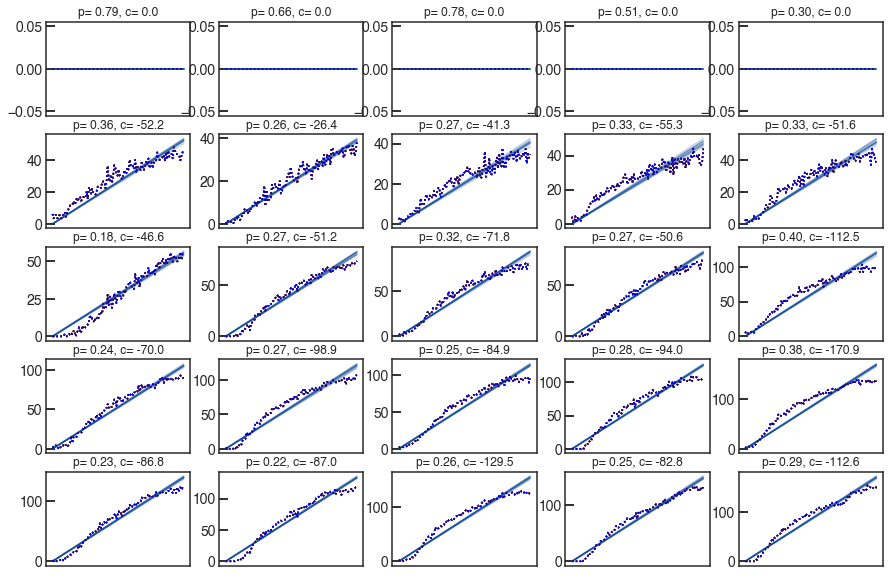

In [11]:
from bioscrape.types import Model
from bioscrape.inference import py_inference
from bioscrape.simulator import py_simulate_model

int_conditions = [0.0,0.25,0.5,0.75,1.]
rep_conditions = [0.0,0.25,0.5,0.75,1.]
# int_conditions = [0.25,1.]
# rep_conditions = [0.25,1.]
num_integrase_conditions = len(int_conditions)
num_reporter_conditions = len(rep_conditions)
e_df = {'time':[], 'int_nm':[], 'rep_nm':[], 'Int':[], 'YFP':[]}
for int_ind, int_nm in zip(range(num_integrase_conditions), int_conditions):
    for rep_ind, rep_nm in zip(range(num_reporter_conditions),rep_conditions):
        length = len(timepoints)
        e_df['time'].extend(timepoints)
        e_df['int_nm'].extend([int_nm]*length)
        e_df['rep_nm'].extend([rep_nm]*length)
        e_df['Int'].extend(expdata_dict[(int_nm,rep_nm,'CFP')])
        e_df['YFP'].extend(expdata_dict[(int_nm,rep_nm,'YFP')])

e_df = pd.DataFrame(e_df)
initial_conditions = []
all_data = []

fig, ax = plt.subplots(nrows = len(int_conditions), ncols = len(rep_conditions), figsize = (15,10))
for rep_nm in rep_conditions:
    for int_nm in int_conditions:
        m = Model(sbml_filename = 'integrase_sbml_reduced.xml')
#         m.set_params({'k_i': 0.24, 'k_int': 0.05, 'K_I': 3335.0, 'n': 2.0, 'k': 0.05})
        axc = ax[int_conditions.index(int_nm)][rep_conditions.index(rep_nm)]
        initial_conditions = {"G_I": int_nm, "G_tot": rep_nm}
        init_values = np.array([0.23])
        exp_data = e_df.loc[(e_df['int_nm'].eq(int_nm)) & (e_df['rep_nm'].eq(rep_nm))]
#         print(exp_data['Int'])
        prior = {'k_i' : ['uniform', 0.03, 1, 'positive']}
        nwalkers = 10
        nsteps = 1000
        sampler, pid = py_inference(Model = m, exp_data = exp_data, measurements = ['Int'], time_column = ['time'],
                                    nwalkers = nwalkers, nsteps = nsteps, sim_type = 'deterministic', 
                                    initial_conditions = initial_conditions, 
                                    init_seed = init_values,
                                    params_to_estimate = [p for p in prior],
                                    prior = prior, convergence_check = False, 
                                    plot_show = False, debug = True)
        flat_samples = sampler.get_chain(discard=int(.5*nsteps), thin = int(0.5*nwalkers), flat=True)
        inds = np.arange(0, len(flat_samples), 1)
        np.random.shuffle(inds)
        inds = inds[:10]
        timepoints = np.array(pid.timepoints)
        for s_ind in inds:
            s = flat_samples[s_ind]
            m = Model(sbml_filename = 'integrase_sbml_reduced.xml')
            m.set_species({"G_I":int_nm, "G_tot":rep_nm})
            p_array = []
            for pi, pi_val in zip(pid.params_to_estimate, s):
                p_array.append(pi_val)
                m.set_parameter(pi, pi_val)
#                 m.set_parameter(pi, 0.13)
                results = py_simulate_model(Model = m, timepoints = timepoints);
                axc.plot(timepoints, results["Int"], color = colorc[int_ind], alpha = .25)
                axc.plot(timepoints, expdata_dict[(int_nm ,rep_nm,'CFP')],ls = 'dotted')
            axc.set_title('p= {:.2f}, c= {:0.1f}'.format(np.mean(p_array), np.max(pid.cost_progress)), fontsize = 12)
#             axc.set_xlabel('Time (min)')
            axc.set_xticks([])
#             axc.set_ylabel('CFP (nM)')

Text(0.5, 1.0, 'Cost Progress')

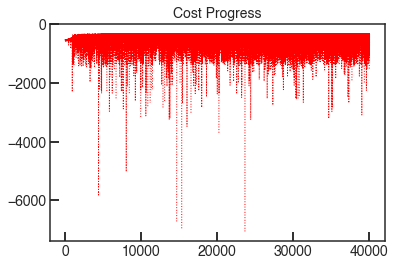

In [57]:
plt.plot(pid.cost_progress, 'r', ls = 'dotted', lw = 1)
plt.title('Cost Progress')

In [58]:
 np.max(pid.cost_progress)

-320.57877857326474

## Model simulation with data

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get qu

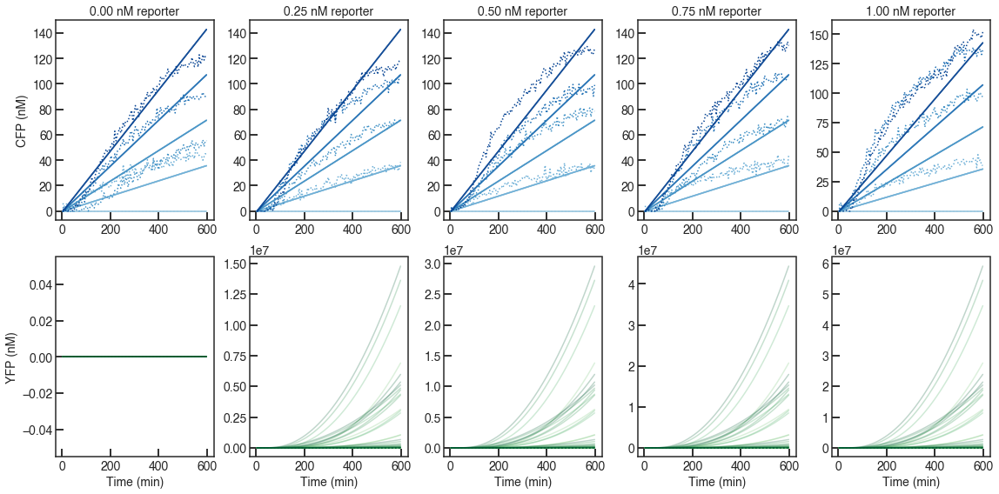

In [28]:
m = Model(sbml_filename = 'integrase_sbml_reduced.xml')

flat_samples = sampler.get_chain(discard=int(.4*nsteps), thin = int(0.5*nwalkers), flat=True)
inds = np.arange(0, len(flat_samples), 1)
np.random.shuffle(inds)
inds = inds[:10]
tol = 0.1
timepoints = np.array(pid.timepoints[0])
# timepoints = np.array(pid.timepoints)
figsize = (16,8)
# figsize = (6,8)
fig = plt.figure(figsize=figsize)
index = 1
int_levels = [0.0,0.25,0.5,0.75,1.]
rep_levels = [0.0,0.25,0.5,0.75,1.]
# int_levels = [0.5]
# rep_levels = [0]
for rep_ind in range(len(int_levels)):
    axc = fig.add_subplot(2,len(int_levels),index)
    axy = fig.add_subplot(2,len(int_levels),index+len(int_levels))
    
    for int_ind in range(len(int_levels)):
        
        for s_ind in inds:
            s = flat_samples[s_ind]
            m.set_species({"G_I":int_levels[int_ind], "G_tot":rep_levels[rep_ind]})
            for pi, pi_val in zip(pid.params_to_estimate, s):
                m.set_parameter(pi, pi_val)
#                 m.set_parameter(pi, 0.13)

            results = py_simulate_model(Model = m, timepoints = timepoints);
            axc.plot(timepoints, results["Int"], color = colorc[int_ind], alpha = .25)
            axy.plot(timepoints, results["YFP"], color = colory[int_ind], alpha = .25)
          
        axc.plot(timepoints, expdata_dict[(int_levels[int_ind] ,rep_levels[rep_ind],'CFP')],
                 color=colorc[int_ind], ls = 'dotted')
        axy.plot(timepoints, expdata_dict[(int_levels[int_ind] ,rep_levels[rep_ind],'YFP')]
                 ,color=colory[int_ind], ls = 'dotted')
    
    axc.set_title('%1.2f nM reporter' % (rep_levels[rep_ind]))
#     axc.set_xlim(time_lim)
#     axy.set_xlim(time_lim)
#     axc.set_ylim(cfp_lim)
#     axy.set_ylim((0,40))

    axy.set_xlabel('Time (min)')
    
    if index == 1:
        axc.set_ylabel('CFP (nM)')
        axy.set_ylabel('YFP (nM)')
#         axc.legend(['0 nM int. plasmid', '0.25 nM int. plasmid',
#                     '0.50 nM int. plasmid', '0.75 nM int. plasmid',
#                     '1.00 nM int. plasmid'],
#                    loc='best')
#     else:
#         axc.set_yticks([])
#         axy.set_yticks([])
#     axc.set_xticks([])

    index += 1

fig.tight_layout()

In [52]:
timepoints

array(3.19999998)

In [33]:
m.get_parameter_dictionary()

{'k_i': 0.24,
 'k_int': 1.9575966744280429,
 'K_I': 4243.783629570022,
 'n': 3.2538277353799976,
 'k': 28.977719027065362}

In [ ]:
flat_samples[2129]

In [167]:
np.shape(fc)

(48000, 5)

In [63]:
# Generate a dataframe with simulated trajectories from the MCMC results
# chain = pickle.load(open('data/mcmc/exp_sigma_2.0.b','rb'))
# fc = np.exp(chain[:,-1,:])
# fc = chain[:,-1,:]
fc = sampler.get_chain(discard=int(0.5*nsteps), thin=int(0.5*nwalkers), flat = True)
df = {}
df['param_index'] = []
df['Int'] = []
df['YFP'] = []
df['time'] = []
df['rep_nm'] = []
df['int_nm'] = []

# Perform simulations
num_iterations = 5
param_indices = np.random.permutation(np.arange(fc.shape[0]))[:num_iterations]
for param_index in param_indices:
    for rep_nm in [0,0.25,0.5,0.75,1.0]:
        for int_nm in [0,0.25,0.5,0.75,1.0]:  
            m = Model(sbml_filename = 'integrase_sbml_reduced.xml')
            csim = ModelCSimInterface(m)
            c_ind = m.get_species_index('Int')
            y_ind = m.get_species_index('YFP')

#             timepoints = np.linspace(0,time_lim[1],241)
            timepoints = pid.timepoints[0]
            csim.py_prep_deterministic_simulation()

            propagator = DeterministicSimulator()
            m.set_species({"G_I": int_nm, "G_tot": rep_nm})
            params = fc[param_index,:]
#             m.set_params({'k_i':params[0], 'k_int':params[1], 'K_I':params[2], 'n':params[3], 'k': params[4]})
            m.set_params({'k_int':params[0], 'K_I':params[1], 'n':params[2], 'k': params[3]})
#             m.set_params({'k_int':0.05, 'K_I':params[1], 'n':params[2], 'k': params[3]})
#             m.set_params({'k_i':params[0]})
#             m.set_params({'k_i':0.23})
#             0.24,0.05,3335,0.05
#             m.set_params({'k_i':0.268 (is good), 'k_int':0.05, 'K_I':3335, 'n':1, 'k': 1.1})

#             m.set_params({'k_i':params[0], 'k_int':params[1], 'K_I':params[2], 'k': params[3]})
#             print('current parameters', m.get_parameter_dictionary())
            deterministic = propagator.py_simulate(csim, timepoints)
            
            df['param_index'].extend([param_index]*len(timepoints))
            df['Int'].extend(deterministic.py_get_result()[:,c_ind])
            df['YFP'].extend(deterministic.py_get_result()[:,y_ind])
            df['time'].extend(timepoints)
            df['rep_nm'].extend([rep_nm]*len(timepoints))
            df['int_nm'].extend([int_nm]*len(timepoints))

simdf = pd.DataFrame(df)

C:\Users\apand\AppData\Roaming\Python\Python37\site-packages\scipy\integrate\odepack.py:247: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


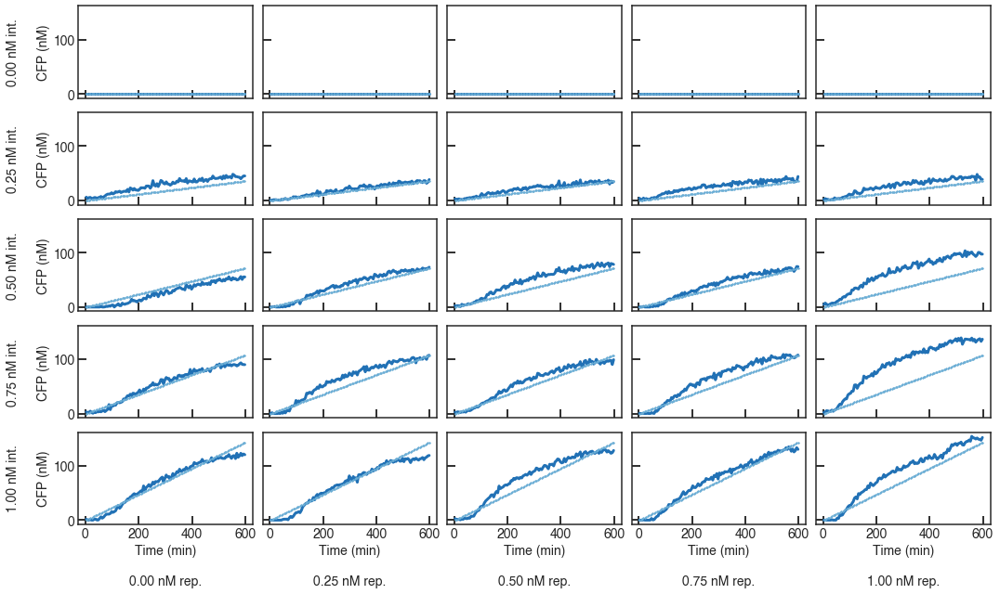

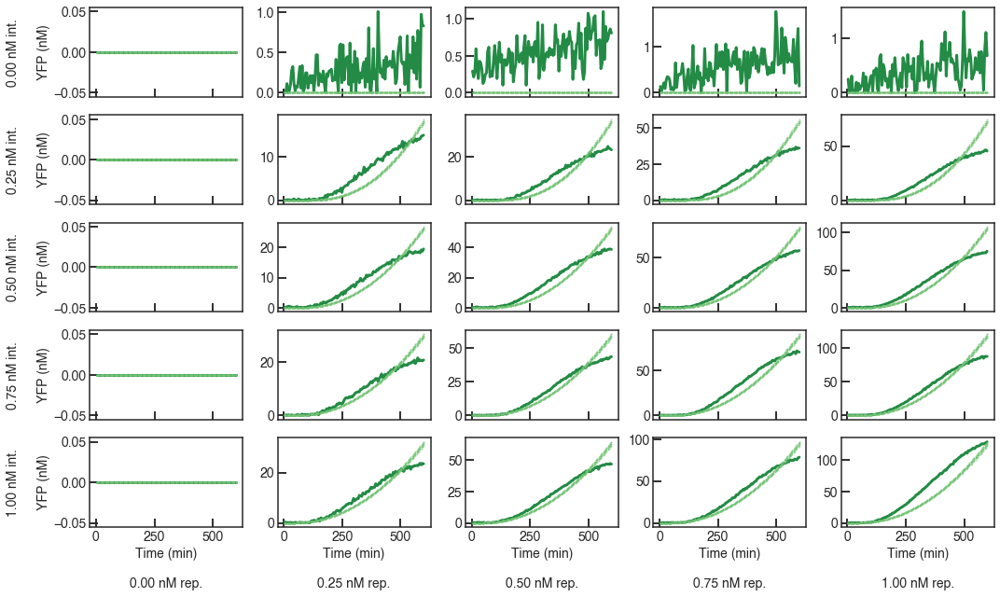

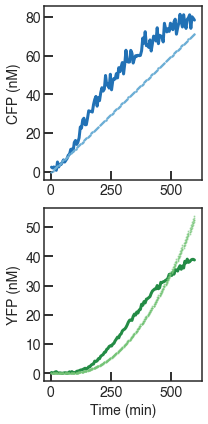

In [64]:
    # Plot the real data

    a = np.array([[1,2],[5,5]])
    np.maximum(a,7)
    colorc = ['#9ecae1','#6baed6','#4292c6', '#2171b5','#084594']
    colory = ['#a1d99b','#74c476','#41ab5d','#238b45','#005a32']

    infile = open('trace_data_frame.b','rb')
    df = pickle.load(infile)
    infile.close()
    edf = df[df.type == 'exp']

    figsize = (15,9)
    fig, axes = plt.subplots(5,5,figsize=figsize, sharey = True)
    fig2, axes2 = plt.subplots(5,5,figsize=figsize)

    for int_nm in range(5):
        for rep_nm in range(5):
            ax = axes[int_nm,rep_nm]
            ax2 = axes2[int_nm,rep_nm]
            etemp = edf[(edf.int_nm == int_nm/4) & (edf.rep_nm == rep_nm/4)]

            ax.plot(etemp.time,etemp.Int,'-',linewidth=3, color=colorc[3])
#             ax.set_xlim((0,180))
#             ax.set_ylim((0,200))

            ax2.plot(etemp.time,etemp.YFP,'-',linewidth=3,color=colory[3])
#             ax2.set_xlim((0,180))
#             ax2.set_ylim((0,60))

            stemp = simdf[(simdf.int_nm == int_nm/4) & (simdf.rep_nm == rep_nm/4)]
            ax.plot(stemp.time, stemp.Int, '.',color = colorc[1], markersize = 2, alpha= 0.5)
            ax2.plot(stemp.time, stemp.YFP, '.',color = colory[1], markersize = 2, alpha= 0.5)

            if int_nm == 4:
                ax.set_xlabel('Time (min)\n\n%.2f nM rep.' % (rep_nm/4))
                ax2.set_xlabel('Time (min)\n\n%.2f nM rep.' % (rep_nm/4))
            else:
                ax.set_xticklabels([])
                ax2.set_xticklabels([])
            if rep_nm == 0:
                ax.set_ylabel('%.2f nM int.\n\nCFP (nM)' % (int_nm/4))
                ax2.set_ylabel('%.2f nM int.\n\nYFP (nM)' % (int_nm/4))
#             else:
#                 ax.set_yticklabels([])
#                 ax2.set_yticklabels([])

    fig.tight_layout()
#     fig.savefig('model-data-cfp.svg')
    fig2.tight_layout()
    fig2.savefig('model-data-yfp.svg')
#     fig.savefig('../tex/fig/supp_full_fit_c.png', dpi=300)
#     fig2.savefig('../tex/fig/supp_full_fit_y.png', dpi=300)

    # Plot of matches.
    figsize = (3, 6)
    fig, axes = plt.subplots(2,1,figsize=figsize)

    ax = axes[0]
    ax2 = axes[1]
    etemp = edf[(edf.int_nm == .5) & (edf.rep_nm == .5)]

    ax.plot(etemp.time,etemp.Int,'-',linewidth=3, color=colorc[3])
#     ax.set_xlim((0,180))
#     ax.set_ylim((0,200))

    ax2.plot(etemp.time,etemp.YFP,'-',linewidth=3,color=colory[3])
#     ax2.set_xlim((0,180))
#     ax2.set_ylim((0,60))

    stemp = simdf[(simdf.int_nm == .5) & (simdf.rep_nm == .5)]
    ax.plot(stemp.time, stemp.Int, '.',color = colorc[1], markersize = 2, alpha= 0.5)
    ax2.plot(stemp.time, stemp.YFP, '.',color = colory[1], markersize = 2, alpha= 0.5)

    ax2.set_xlabel('Time (min)')
    ax2.set_ylabel('YFP (nM)')
    ax.set_ylabel('CFP (nM)')
    fig.tight_layout()
